In [1]:
import tensorflow as tf
import numpy as np
import matplotlib.pyplot as plt

In [2]:
def coth(a):
    if a>0: return (1+tf.math.exp(-2*a))/(1-tf.math.exp(-2*a))
    if a<0: return (tf.math.exp(2*a)+1)/(tf.math.exp(2*a)-1)
    if a==0: return 0

def tanh(a):
    if a>0: return (1-tf.math.exp(-2*a))/(1+tf.math.exp(-2*a))
    if a<0: return (tf.math.exp(2*a)-1)/(tf.math.exp(2*a)+1)
    if a==0: return 0

In [3]:
data=100
layer=10
n_ini=1.0
n_fin=0.1
dn=-0.1
m2=-1
lam=1
c_reg1=0.03
c_reg2=0

<tf.Variable 'Variable:0' shape=(10,) dtype=float64, numpy=
array([2.17728855, 0.80740266, 0.95488448, 1.63338352, 3.50191268,
       2.10864983, 2.71808316, 2.02058444, 4.80642693, 9.71030751])>
tf.Tensor(
[ 3.01490951  3.02722263  3.04978824  3.09134316  3.16854751  3.31437385
  3.59861219  4.18820179  5.58607614 10.29821491], shape=(10,), dtype=float64)


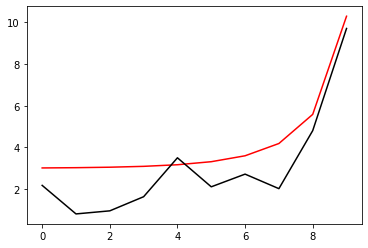

In [50]:
h=tf.zeros(layer)
h_in=[]
#h_in=[3.0205426, 3.022307 , 3.0291433, 3.04402  , 3.0732646, 3.131582 ,
# 3.2585216, 3.5762587, 4.59116  , 9.752249]
for i in range (layer):
#   midd=np.float64(10.0)
#    h_in.append(midd)
#    midd=3*coth(3*((i-layer)*dn)).numpy()
#    h_in.append(midd)
    mu=1/(1-i/10)
    h_inn=np.float64(np.random.normal(mu, 1))
    h_in.append(h_inn)
h=tf.Variable(h_in)
print(h)

h_real=tf.zeros(layer)
middd=[]
for i in range (layer):
    midd=3*coth(3*((i-layer)*dn)).numpy()
    middd.append(midd)
h_real=tf.constant(middd)
print(h_real)
plt.plot(h_real, 'r-')
plt.plot(h.numpy(), 'k-')
plt.show()

In [51]:
m2=tf.constant(np.float64(-1.0))
m2_2=tf.Variable(np.float64(np.random.uniform(-1.5, -0.5)))
print(m2_2)

<tf.Variable 'Variable:0' shape=() dtype=float64, numpy=-0.8358435913362623>


In [6]:
def F_func(m, a,b):
    return 2*b/n_fin-m*a-lam*(a**3)

def t_func(a):
    return 0.5*(tf.math.tanh(100*(a-0.1))-tf.math.tanh(100*(a+0.1))+2)

In [52]:
def LP2(hh, m, phi, pi):
    for j in range (layer-1):
        phi1=phi+dn*pi
        pi1 =phi*m*dn+(1-dn*hh[j])*pi+dn*lam*(phi1**3)
        phi=phi1
        pi=pi1
    return phi, pi
def NN_func_p(hh, m):
    Positive=[]
    while len(Positive)<data:
        phi1=np.random.uniform(0.0, 1.5, 10000)
        pi1=np.random.uniform(-0.2, 0.2, 10000)
        phi_1, pi_1=LP2(hh, m, phi1, pi1)
        F=np.array(tf.math.abs(F_func(m, phi_1, pi_1)))
        for i in range (len(phi1[F<0.1])):
            Positive.append([phi1[F<0.1][i], pi1[F<0.1][i]])
            if len(Positive)>=data: break
    print(len(Positive))
    return Positive
def NN_func_n(hh, m):
    Positive=[]
    while len(Positive)<data:
        phi1=np.random.uniform(0.0, 1.5, 10000)
        pi1=np.random.uniform(-0.2, 0.2, 10000)
        phi_1, pi_1=LP2(hh, m, phi1, pi1)
        F=np.array(tf.math.abs(F_func(m, phi_1, pi_1)))
        for i in range (len(phi1[F>=0.1])):
            Positive.append([phi1[F>=0.1][i], pi1[F>=0.1][i]])
            if len(Positive)>=data: break
    print(len(Positive))
    return Positive
def NN_func_01(hh, m, list1):
    PP=[]
    NN=[]
    phi=np.array(list1)[:, 0]
    pi=np.array(list1)[:, 1]
    F=np.array(tf.math.abs(LP2(hh, m, phi, pi)[1]))
    for i in range (len(phi[F<0.1])):
        PP.append([phi[F<0.1][i], pi[F<0.1][i]])
    for i in range (len(phi[F>=0.1])):
        NN.append([phi[F>=0.1][i], pi[F>=0.1][i]])
    return PP, NN

In [53]:
Positive=NN_func_p(h_real, m2)

100


In [54]:
Negative=NN_func_n(h_real, m2)

100


In [55]:
[Positive0, Positive1]=NN_func_01(h, m2_2, Positive)
[Negative0, Negative1]=NN_func_01(h, m2_2, Negative)

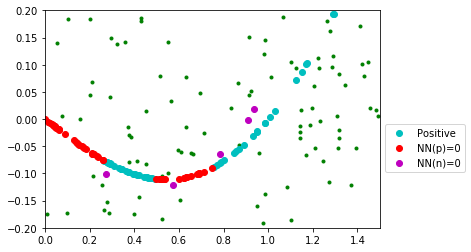

In [56]:
x_data1=[v[0] for v in Positive0]
y_data1=[v[1] for v in Positive0]
x_data2=[v[0] for v in Positive1]
y_data2=[v[1] for v in Positive1]
x_data3=[v[0] for v in Negative0]
y_data3=[v[1] for v in Negative0]
x_data4=[v[0] for v in Negative1]
y_data4=[v[1] for v in Negative1]
plt.plot(x_data4, y_data4, 'g.')
plt.plot(x_data2, y_data2, 'co', label='Positive')
plt.plot(x_data1, y_data1, 'ro', label='NN(p)=0')
plt.plot(x_data3, y_data3, 'mo', label='NN(n)=0')
plt.xlim(0.0, 1.5)
plt.ylim(-0.2, 0.2)
plt.legend(bbox_to_anchor=(1, 0.5))
plt.show()

# Error function

$E=\sum_{data} \left\vert y(\bar{x}^{(1)}) - \bar{y} \right\vert+E_{reg}(W)$
, $E_{reg}=c_{reg}^{(1)}\sum_{n=1}^{N-1}(\eta^{(n)})^{4}(h(\eta^{(n+1)})-h(\eta^{(n)}))^{2}+c_{reg}^{(2)}(h(\eta^{(N)})-1/\eta^{(N)})^{2}$

In [57]:
def Error_func(hh, m):
    phi0=np.array([v[0] for v in Positive])
    pi0=np.array([v[1] for v in Positive])
    phi1=np.array([v[0] for v in Negative])
    pi1=np.array([v[1] for v in Negative])
    phi_0, pi_0=LP2(hh, m, phi0, pi0)
    phi_1, pi_1=LP2(hh, m, phi1, pi1)
    PPlist=t_func(pi_0)
    NNlist=t_func(pi_1)
    sum_p=sum(PPlist)
    sum_n=data-sum(NNlist)

    inside=0
    for k in range (layer-1):
        second=((n_ini+k*dn)**4)*((hh[k+1]-hh[k])**2)
        inside=inside+second
    E_reg1=c_reg1*inside
    E_reg2=c_reg2*((hh[layer-1]-1/n_fin)**2)
    return E_reg1+E_reg2+sum_p+sum_n

In [58]:
print(Error_func(h_real, m2))
print(Error_func(h, m2_2))

tf.Tensor(0.8476178380951558, shape=(), dtype=float64)
tf.Tensor(52.20281412463065, shape=(), dtype=float64)


In [59]:
def run():
    with tf.GradientTape() as g:
        loss=Error_func(h, m2_2) #돌리기전에 Error함수 수정 잊지말것
        gradients=g.gradient(loss, [h, m2_2])
    optimizer.apply_gradients(zip(gradients, [h, m2_2]))

100 99.0861846193808 9.706832845826385
[2.5964576  1.33124933 1.29315672 1.85019067 3.56738234 2.17191516
 2.71252509 1.97856972 4.74097589 9.70983064]


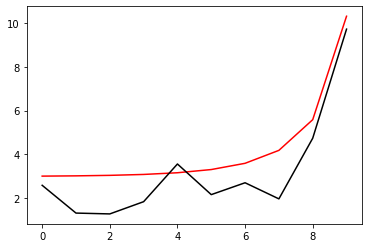

200 99.07453070054947 9.703797311260146
[2.52477133 1.3998676  1.30865121 1.86013071 3.53145984 2.18356541
 2.70834823 1.97978    4.73890574 9.70935356]


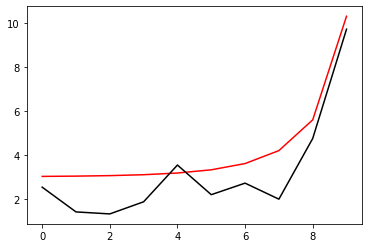

300 99.065225350126 9.700731688548824
[2.46096644 1.4587384  1.32583588 1.8695771  3.49654145 2.19478412
 2.70422763 1.98096864 4.73682571 9.70887632]


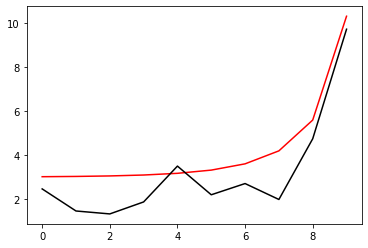

400 99.05770805278917 9.697642220258377
[2.40405788 1.50926074 1.34425229 1.87859947 3.46259711 2.20558617
 2.70016353 1.98213836 4.73473825 9.70839892]


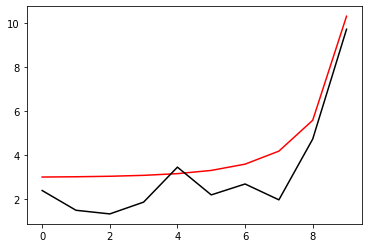

500 99.05156133805417 9.694534532819066
[2.3531935  1.55263313 1.36352114 1.88725413 3.42959825 2.21598581
 2.69615602 1.98329158 4.7326456  9.70792138]


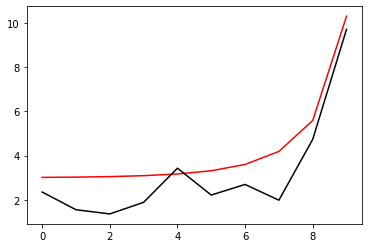

600 99.04647332177645 9.691413686441788
[2.30763545 1.58988237 1.38333006 1.89558638 3.39751763 2.22599671
 2.69220508 1.98443051 4.73054975 9.70744367]


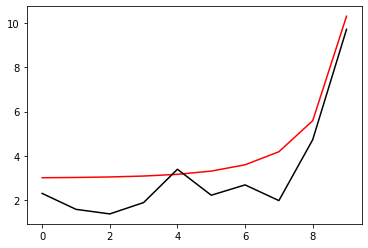

700 99.04221016010064 9.688284222742656
[2.26674428 1.62188812 1.40342313 1.90363242 3.36632913 2.23563203
 2.68831051 1.98555712 4.72845248 9.70696581]


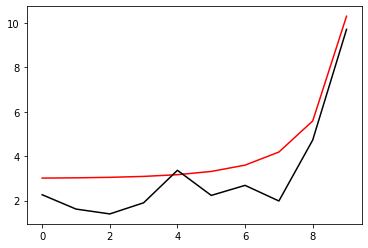

800 99.03859578063499 9.685150209744863
[2.22996525 1.64940407 1.42359204 1.91142101 3.33600766 2.24490439
 2.68447205 1.9866732  4.7263554  9.7064878 ]


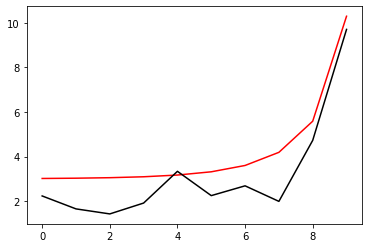

900 99.03549695773629 9.682015284069843
[2.19681663 1.67307591 1.44366849 1.91897481 3.306529   2.25382594
 2.6806893  1.98778035 4.72425994 9.70600963]


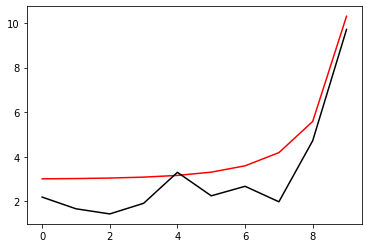

1000 99.03281231362921 9.678882690235039
[2.16687958 1.69345687 1.46351781 1.92631151 3.27786975 2.26240838
 2.6769618  1.98887999 4.72216736 9.70553131]


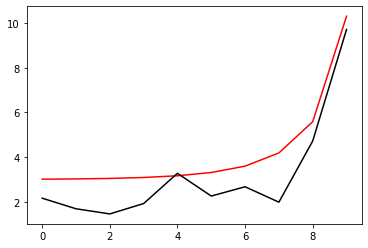

1100 99.03046420462994 9.67575531705425
[2.13978951 1.71102094 1.48303353 1.93344484 3.25000723 2.27066297
 2.67328901 1.98997341 4.7200788  9.70505283]


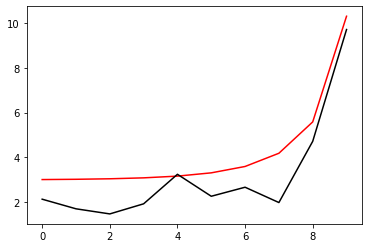

1200 99.02839272863683 9.672635731193944
[2.11522866 1.72617423 1.5021327  1.94038528 3.22291944 2.27860055
 2.66967031 1.99106176 4.71799527 9.70457419]


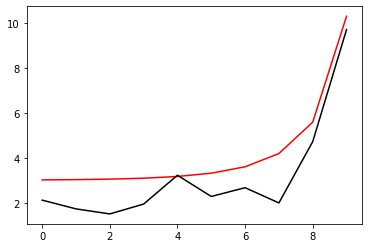

1300 99.02655129314286 9.669526207981498
[2.09291969 1.7392647  1.52075201 1.9471408  3.19658498 2.28623158
 2.66610503 1.99214606 4.71591766 9.7040954 ]


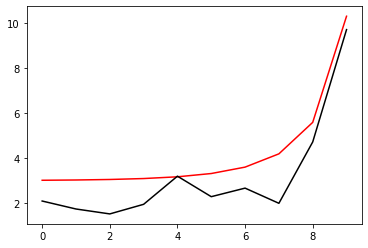

1400 99.02490333200619 9.666428759590788
[2.07262019 1.75059044 1.53884449 1.95371735 3.17098303 2.29356614
 2.66259246 1.99322722 4.71384675 9.70361646]


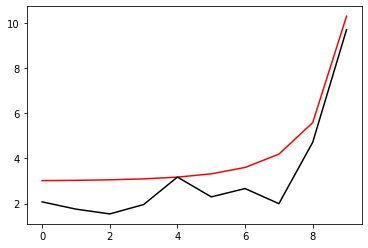

1500 99.02341986851673 9.663345160750401
[2.05411796 1.76040687 1.55637665 1.96011933 3.1460933  2.30061396
 2.65913185 1.99430604 4.71178323 9.70313737]


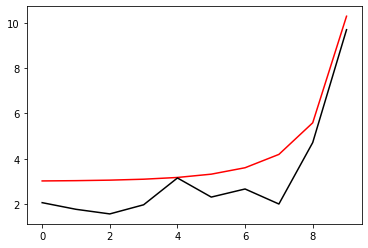

1600 99.02207770250058 9.660276972131488
[2.03722694 1.76893281 1.57332615 1.96634998 3.12189604 2.30738442
 2.65572241 1.99538325 4.70972771 9.70265813]


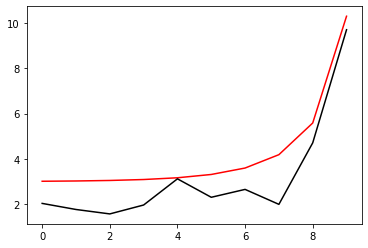

1700 99.02085805806846 9.657225561577988
[2.02178373 1.77635572 1.5896798  1.97241165 3.09837195 2.3138866
 2.65236331 1.99645949 4.70768073 9.70217873]


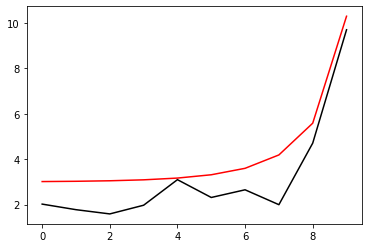

1800 99.0197455718246 9.65419212334286
[2.00764453 1.78283619 1.60543182 1.97830604 3.07550224 2.32012923
 2.64905372 1.99753532 4.70564273 9.70169918]


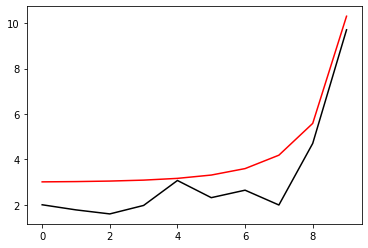

1900 99.0187275330826 9.651177695490846
[1.99468262 1.78851178 1.6205825  1.98403444 3.05326855 2.32612077
 2.64579278 1.99861123 4.70361412 9.70121949]


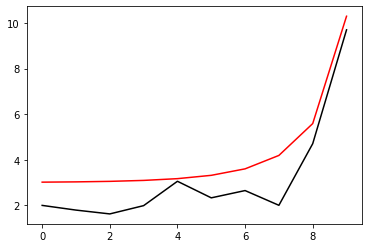

2000 99.01779331093982 9.648183175623123
[1.98278606 1.79350031 1.63513695 1.98959785 3.03165296 2.33186939
 2.64257963 1.99968766 4.70159525 9.70073965]


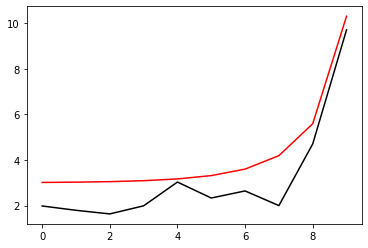

2100 99.01693392018618 9.645209335071387
[1.9718558  1.79790268 1.64910411 1.99499712 3.01063801 2.33738299
 2.6394134  2.000765   4.6995864  9.70025966]


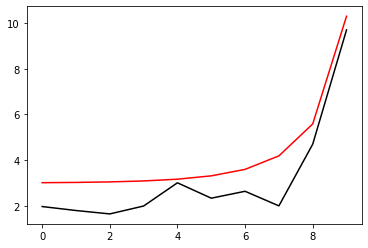

2200 99.01614169061138 9.64225683170083
[1.96180399 1.80180531 1.66249593 2.00023305 2.99020663 2.34266918
 2.63629318 2.00184357 4.69758784 9.69977952]


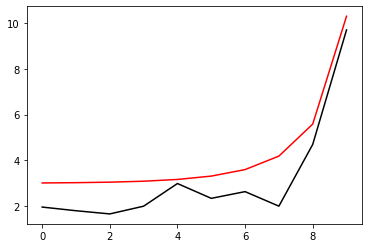

2300 99.01541001353205 9.639326221451704
[1.95255257 1.80528216 1.67532668 2.00530645 2.97034218 2.34773535
 2.63321812 2.00292367 4.69559975 9.69929924]


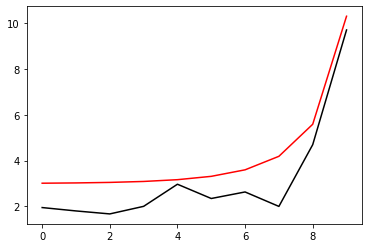

2400 99.0147331461731 9.636417968739694
[1.94403201 1.80839655 1.68761234 2.01021822 2.95102841 2.35258861
 2.63018731 2.00400555 4.69362233 9.69881881]


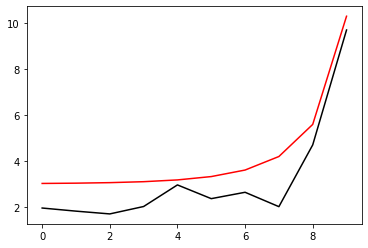

2500 99.01410605955475 9.633532455826018
[1.93618024 1.81120268 1.69937016 2.01496935 2.9322495  2.35723588
 2.62719988 2.00508943 4.69165571 9.69833824]


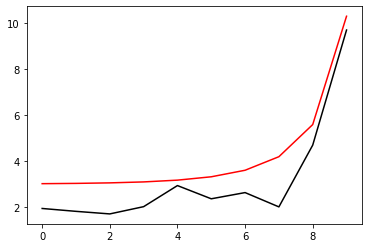

2600 99.01352431923357 9.630669991258175
[1.92894175 1.8137469  1.71061822 2.01956102 2.91398999 2.36168382
 2.62425495 2.00617548 4.6897     9.69785753]


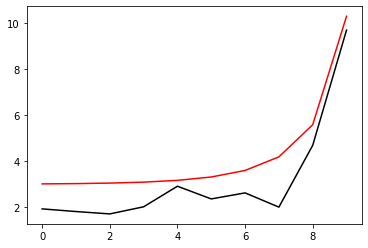

2700 99.01298399097348 9.62783081747382
[1.92226673 1.81606887 1.72137515 2.02399453 2.89623482 2.36593887
 2.62135165 2.00726386 4.68775529 9.69737668]


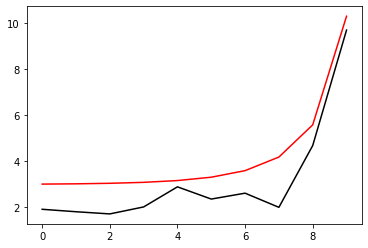

2800 99.01248156543714 9.625015117651394
[1.91611044 1.81820247 1.73165984 2.02827139 2.87896931 2.37000729
 2.61848912 2.0083547  4.68582164 9.69689568]


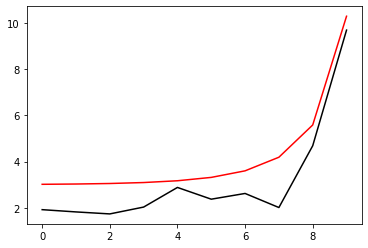

2900 99.01201389747692 9.622223021883316
[1.91043255 1.82017667 1.74149123 2.03239328 2.86217916 2.37389509
 2.6156665  2.00944811 4.68389908 9.69641455]


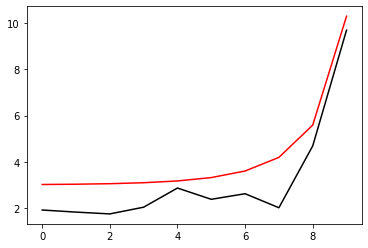

3000 99.01157815670842 9.619454612740014
[1.90519664 1.8220162  1.75088814 2.03636204 2.84585044 2.37760813
 2.61288296 2.01054416 4.68198765 9.69593328]


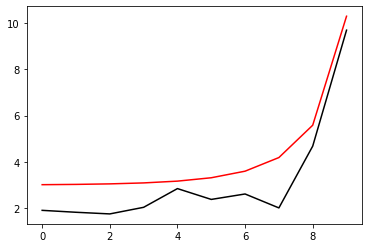

3100 99.01117178686691 9.616709930286426
[1.90036977 1.82374217 1.75986914 2.04017972 2.82996958 2.38115205
 2.61013765 2.01164294 4.68008734 9.69545188]


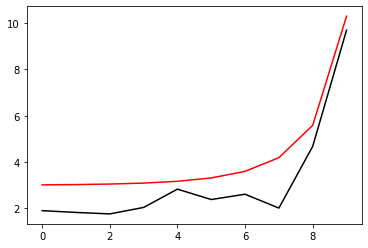

3200 99.0107924720559 9.613988976606365
[1.89592202 1.82537258 1.76845244 2.04384849 2.81452337 2.38453233
 2.60742976 2.01274448 4.67819816 9.69497033]


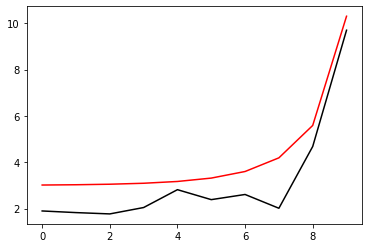

3300 99.01043810845005 9.611291719884283
[1.89182621 1.82692276 1.77665578 2.04737072 2.79949894 2.38775424
 2.60475849 2.01384881 4.67632007 9.69448866]


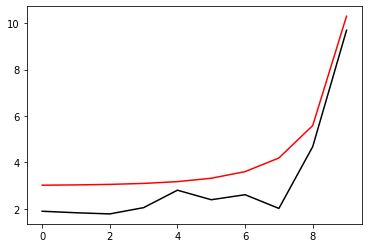

3400 99.01010678035297 9.608618098089119
[1.88805754 1.82840578 1.78449642 2.05074891 2.78488378 2.39082292
 2.60212303 2.01495597 4.67445304 9.69400685]


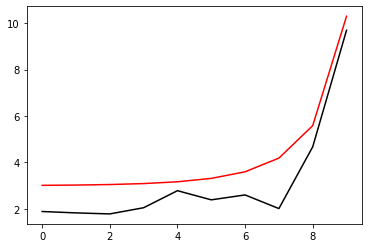

3500 99.0097967397646 9.60596802230022
[1.88459339 1.82983273 1.79199105 2.05398568 2.77066573 2.39374332
 2.59952261 2.01606595 4.67259704 9.6935249 ]


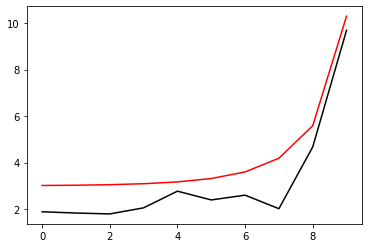

3600 99.00950638880329 9.60334137971102
[1.88141303 1.83121303 1.79915579 2.05708377 2.75683295 2.39652024
 2.59695646 2.01717876 4.67075199 9.69304283]


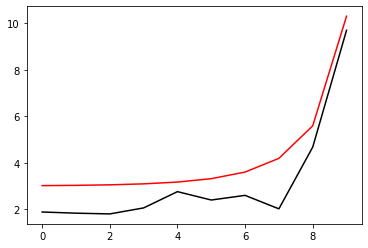

3700 99.00923426447183 9.600738036342658
[1.87849744 1.83255466 1.80600612 2.06004605 2.74337394 2.39915831
 2.59442384 2.01829439 4.66891785 9.69256063]


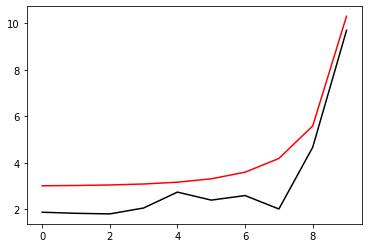

3800 99.00897902536641 9.598157839496091
[1.87582915 1.83386439 1.81255696 2.06287546 2.73027749 2.40166202
 2.59192399 2.0194128  4.66709454 9.69207829]


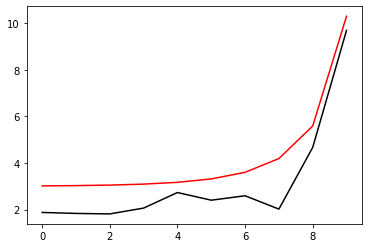

3900 99.00873944001006 9.595600619968677
[1.87339207 1.83514791 1.81882257 2.06557501 2.71753276 2.40403573
 2.5894562  2.02053398 4.66528198 9.69159583]


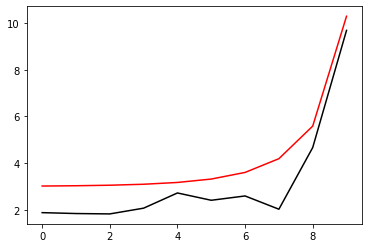

4000 99.00851437655649 9.593066194058027
[1.87117134 1.83641003 1.8248166  2.06814782 2.70512918 2.40628365
 2.58701976 2.02165789 4.6634801  9.69111324]


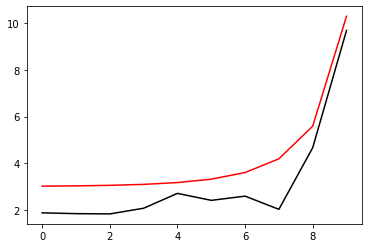

4100 99.00830279365931 9.590554365374054
[1.86915323 1.83765477 1.83055212 2.070597   2.69305649 2.40840985
 2.58461398 2.02278448 4.66168881 9.69063053]


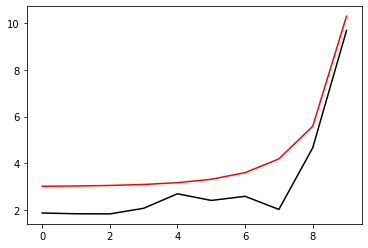

4200 99.00810373233996 9.588064926477495
[1.86732503 1.83888551 1.83604158 2.07292576 2.68130473 2.41041827
 2.58223818 2.02391372 4.65990802 9.69014769]


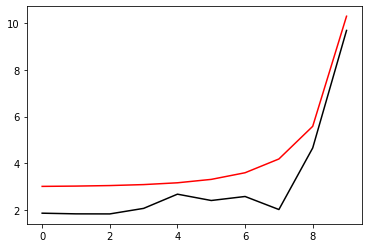

4300 99.00791630871738 9.585597660361808
[1.86567494 1.84010504 1.84129686 2.07513731 2.66986424 2.41231274
 2.5798917  2.02504554 4.65813763 9.68966472]


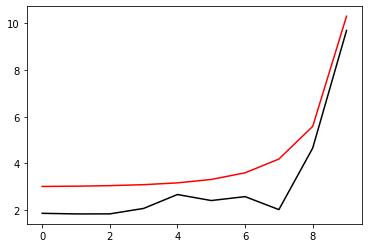

4400 99.00773970748618 9.583152341793141
[1.864192   1.84131569 1.84632927 2.07723488 2.65872563 2.41409694
 2.57757388 2.0261799  4.65637754 9.68918164]


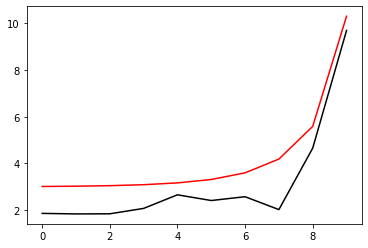

4500 99.00757317604868 9.580728738522144
[1.862866   1.84251937 1.85114959 2.07922172 2.64787979 2.41577446
 2.57528408 2.02731673 4.65462767 9.68869843]


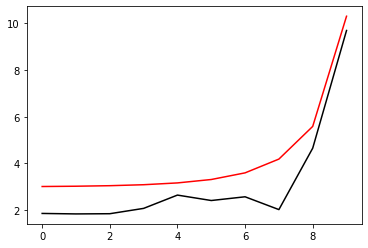

4600 99.00741601922127 9.578326612379293
[1.86168745 1.84371765 1.85576806 2.08110108 2.63731789 2.41734875
 2.5730217  2.02845598 4.65288789 9.6882151 ]


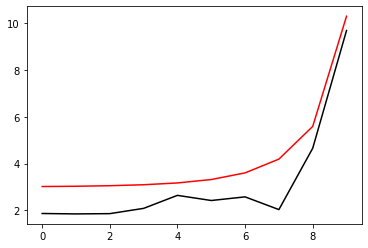

4700 99.00726759444753 9.575945720264995
[1.86064748 1.84491178 1.86019441 2.08287619 2.62703136 2.41882318
 2.57078612 2.02959757 4.65115812 9.68773164]


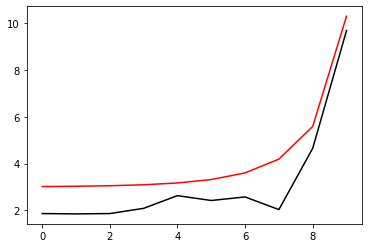

4800 99.00712730746048 9.573585815044034
[1.8597378  1.84610277 1.86443792 2.08455029 2.61701187 2.42020099
 2.56857676 2.03074144 4.64943824 9.68724807]


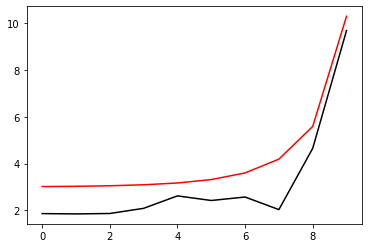

4900 99.00699460834426 9.571246646353337
[1.85895066 1.84729143 1.86850737 2.08612657 2.60725136 2.42148533
 2.56639302 2.03188753 4.64772815 9.68676439]


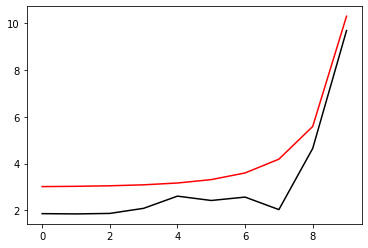

5000 99.0068689879525 9.568927961330992
[1.8582788  1.84847835 1.87241112 2.08760821 2.59774202 2.42267923
 2.56423436 2.03303575 4.64602774 9.68628058]


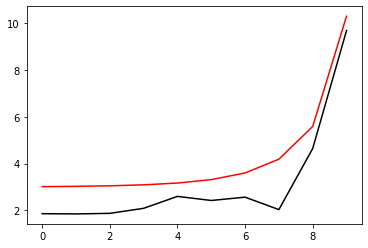

5100 99.00674997464608 9.566629505273717
[1.85771541 1.849664   1.87615709 2.08899834 2.58847626 2.42378565
 2.56210021 2.03418604 4.6443369  9.68579666]


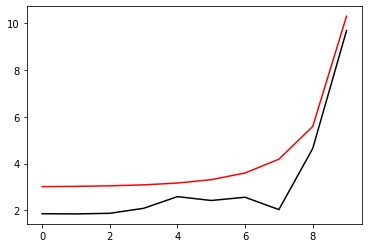

5200 99.00663713131733 9.564351022229378
[1.85725411 1.8508487  1.87975282 2.09030008 2.57944674 2.42480744
 2.55999003 2.03533833 4.64265553 9.68531262]


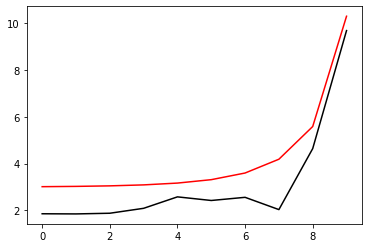

5300 99.00653005267263 9.562092255530425
[1.85688891 1.85203266 1.88320544 2.09151646 2.57064632 2.42574736
 2.55790332 2.03649254 4.64098351 9.68482847]


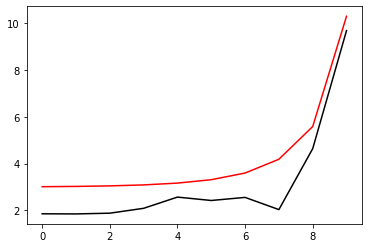

5400 99.0064283627474 9.559852948273528
[1.85661415 1.85321601 1.88652175 2.09265052 2.56206811 2.42660809
 2.55583954 2.03764859 4.63932074 9.68434421]


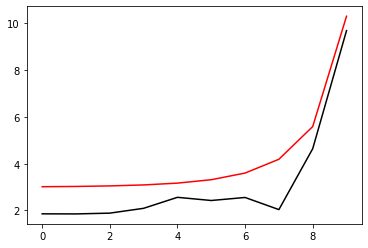

5500 99.00633171263179 9.557632843750376
[1.85642455 1.8543988  1.88970816 2.09370519 2.55370542 2.42739222
 2.5537982  2.03880642 4.6376671  9.68385983]


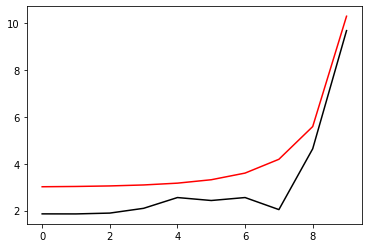

5600 99.00623977838679 9.555431685834028
[1.85631509 1.85558101 1.8927708  2.09468339 2.54555177 2.42810226
 2.55177882 2.03996594 4.6360225  9.68337534]


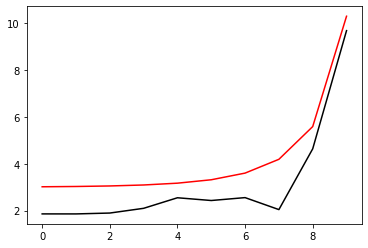

5700 99.00615225913317 9.553249219324693
[1.85628108 1.85676257 1.89571546 2.09558796 2.53760087 2.42874064
 2.54978091 2.04112708 4.63438682 9.68289074]


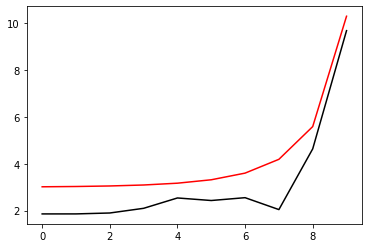

5800 99.00606887529743 9.551085190258735
[1.85631807 1.85794337 1.89854764 2.09642169 2.52984665 2.42930972
 2.54780402 2.04228976 4.63275995 9.68240603]


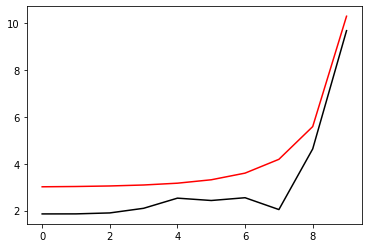

5900 99.00598936700068 9.548939346184081
[1.85642187 1.85912327 1.90127256 2.09718729 2.5222832  2.42981176
 2.5458477  2.04345391 4.6311418  9.68192121]


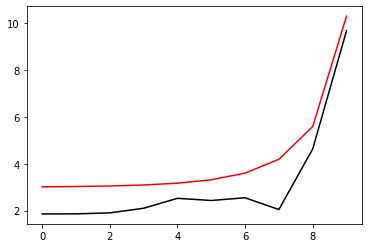

6000 99.00591349257752 9.546811436405113
[1.85658854 1.86030208 1.90389519 2.09788744 2.51490482 2.43024899
 2.54391149 2.04461946 4.62953224 9.68143628]


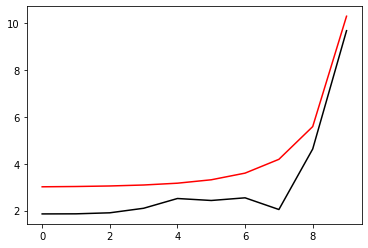

6100 99.00584102721378 9.544701212199742
[1.85681434 1.86147962 1.90642021 2.09852472 2.50770598 2.43062354
 2.54199497 2.04578633 4.62793119 9.68095124]


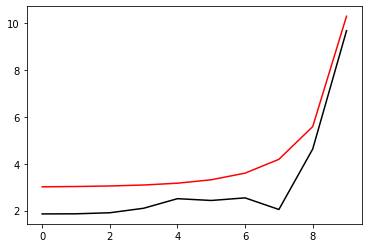

6200 99.00577176169249 9.54260842701113
[1.85709575 1.86265567 1.90885211 2.09910168 2.50068134 2.43093748
 2.54009773 2.04695444 4.62633853 9.6804661 ]


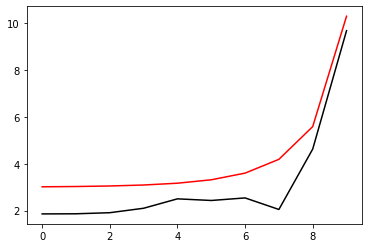

6300 99.00570550123892 9.540532836616434
[1.85742942 1.86383    1.91119512 2.09962078 2.49382569 2.43119281
 2.53821935 2.04812373 4.62475416 9.67998085]


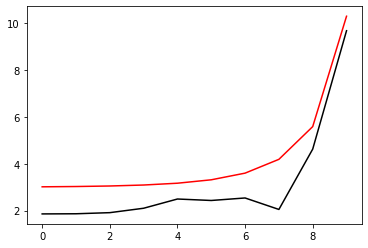

6400 99.00564206445635 9.538474199274537
[1.85781221 1.86500239 1.91345329 2.10008443 2.48713402 2.43139149
 2.53635944 2.04929411 4.62317799 9.6794955 ]


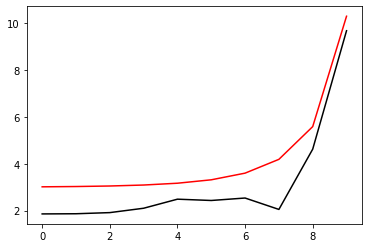

6500 99.00558128234478 9.536432275854686
[1.85824112 1.86617259 1.91563042 2.10049495 2.48060147 2.43153538
 2.5345176  2.05046552 4.6216099  9.67901004]


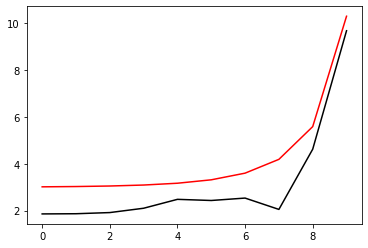

6600 99.00552299739563 9.534406829947788
[1.85871334 1.86734037 1.91773018 2.10085461 2.47422333 2.43162633
 2.53269346 2.05163788 4.62004981 9.67852448]


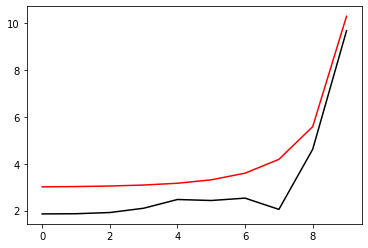

6700 99.00546706275631 9.532397627961915
[1.85922619 1.86850548 1.919756   2.10116563 2.46799504 2.43166609
 2.53088666 2.05281113 4.6184976  9.67803881]


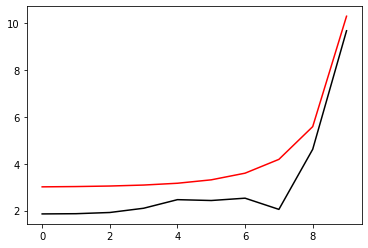

6800 99.00541334145879 9.530404439203487
[1.85977715 1.86966767 1.92171118 2.10143014 2.46191219 2.43165637
 2.52909682 2.05398519 4.6169532  9.67755305]


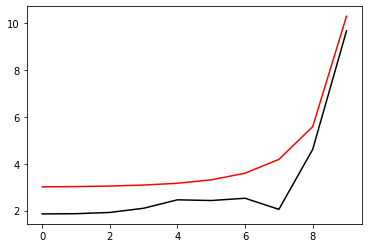

6900 99.0053617057071 9.528427035945375
[1.8603638  1.87082672 1.92359884 2.10165021 2.4559705  2.43159884
 2.52732361 2.05516    4.61541649 9.67706718]


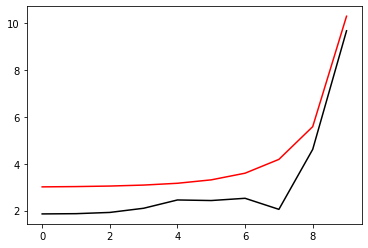

7000 99.00531203621871 9.526465193483226
[1.86098388 1.87198238 1.92542196 2.10182785 2.45016584 2.4314951
 2.52556667 2.05633548 4.61388739 9.67658121]


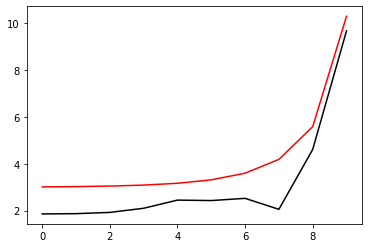

7100 99.00526422161579 9.524518690181
[1.86163523 1.87313442 1.92718336 2.101965   2.44449419 2.4313467
 2.52382568 2.05751157 4.6123658  9.67609514]


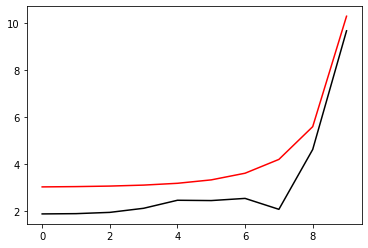

7200 99.0052181578623 9.522587307506864
[1.86231582 1.87428262 1.92888573 2.10206356 2.43895169 2.43115517
 2.52210032 2.05868821 4.61085163 9.67560898]


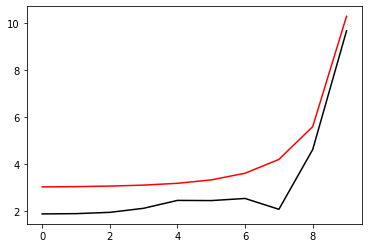

7300 99.00517374774307 9.520670830060142
[1.86302371 1.87542676 1.93053162 2.10212534 2.43353458 2.43092194
 2.52039026 2.05986532 4.60934479 9.67512271]


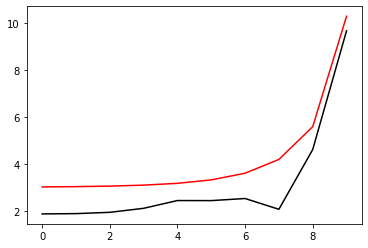

7400 99.00513090038177 9.518769045590458
[1.86375706 1.87656664 1.93212348 2.1021521  2.42823922 2.43064846
 2.5186952  2.06104285 4.60784519 9.67463635]


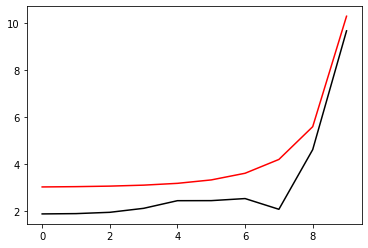

7500 99.00508953079478 9.516881745009512
[1.86451412 1.87770204 1.93366362 2.10214554 2.42306209 2.43033608
 2.51701484 2.06222073 4.60635274 9.67414989]


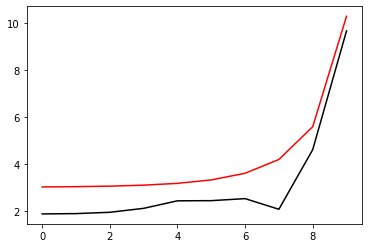

7600 99.0050495594779 9.515008722396496
[1.86529327 1.87883277 1.93515425 2.10210731 2.41799979 2.42998614
 2.51534889 2.0633989  4.60486736 9.67366333]


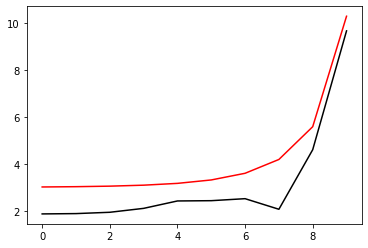

7700 99.00501091202358 9.513149774997522
[1.86609291 1.87995864 1.93659747 2.10203899 2.41304902 2.42959992
 2.51369706 2.06457729 4.60338897 9.67317668]


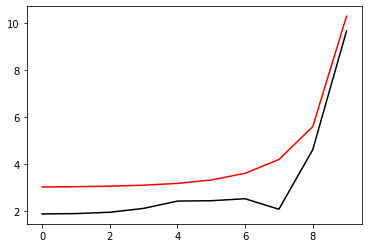

7800 99.00497351876632 9.51130470321987
[1.86691158 1.88107947 1.93799529 2.1019421  2.40820658 2.42917868
 2.51205908 2.06575585 4.60191746 9.67268994]


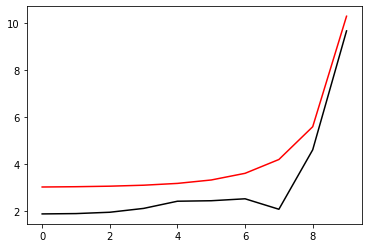

7900 99.0049373144539 9.509473310621493
[1.86774786 1.8821951  1.93934962 2.10181814 2.40346938 2.42872363
 2.51043467 2.06693452 4.60045278 9.67220309]


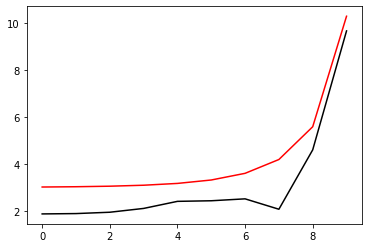

8000 99.00490223794269 9.507655403896202
[1.86860041 1.88330535 1.94066227 2.1016685  2.39883443 2.42823594
 2.50882357 2.06811324 4.59899482 9.67171616]


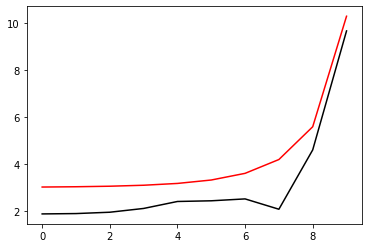

8100 99.00486823191497 9.505850792855158
[1.86946797 1.88441007 1.94193498 2.10149457 2.39429884 2.42771674
 2.50722552 2.06929195 4.59754352 9.67122913]


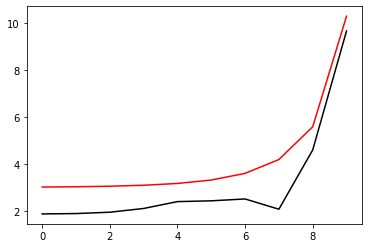

8200 99.00483524261683 9.504059290404909
[1.87034934 1.88550912 1.94316941 2.10129766 2.38985978 2.42716715
 2.50564028 2.07047059 4.59609879 9.67074201]


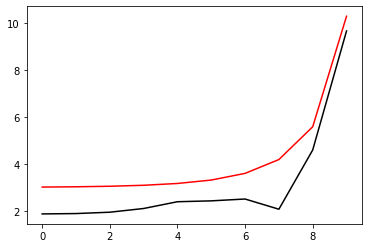

8300 99.004803219615 9.502280712522436
[1.87124337 1.88660235 1.94436713 2.10107904 2.38551456 2.42658823
 2.5040676  2.07164912 4.59466055 9.6702548 ]


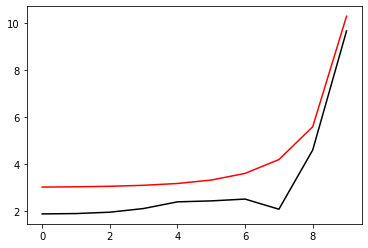

8400 99.00477211557107 9.50051487822754
[1.87214898 1.88768964 1.94552966 2.10083993 2.38126053 2.42598102
 2.50250724 2.07282747 4.59322874 9.6697675 ]


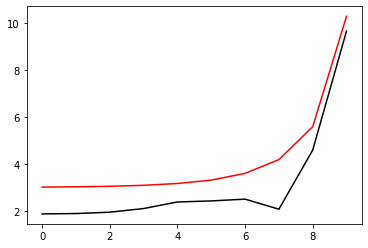

8500 99.00474188603204 9.498761609552885
[1.87306514 1.88877085 1.94665842 2.10058151 2.37709516 2.42534651
 2.50095897 2.0740056  4.59180327 9.66928011]


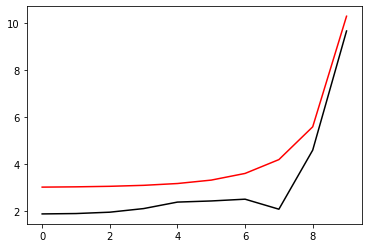

8600 99.0047124892357 9.497020731511945
[1.87399089 1.88984588 1.94775478 2.10030489 2.37301596 2.4246857
 2.49942256 2.07518345 4.59038407 9.66879263]


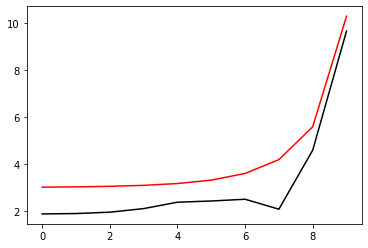

8700 99.0046838859301 9.49529207206519
[1.87492529 1.89091462 1.94882006 2.10001117 2.36902056 2.42399951
 2.4978978  2.07636098 4.58897107 9.66830506]


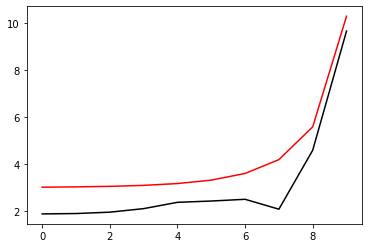

8800 99.00465603920557 9.493575462084644
[1.87586747 1.89197696 1.94985551 2.09970139 2.36510664 2.42328887
 2.49638447 2.07753812 4.5875642  9.6678174 ]


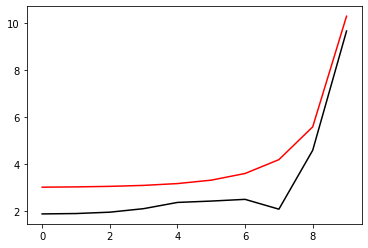

8900 99.00462891433892 9.491870735317125
[1.87681661 1.8930328  1.95086232 2.09937653 2.36127196 2.42255466
 2.49488237 2.07871484 4.58616338 9.66732965]


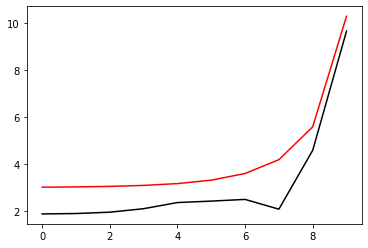

9000 99.00460247864847 9.49017772834637
[1.8777719  1.89408207 1.95184162 2.09903757 2.35751435 2.42179774
 2.49339128 2.07989107 4.58476855 9.66684181]


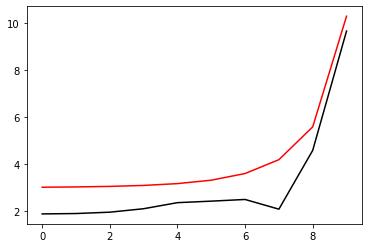

9100 99.0045767013593 9.488496280554143
[1.87873262 1.89512468 1.95279452 2.09868543 2.35383171 2.42101896
 2.491911   2.08106679 4.58337965 9.66635389]


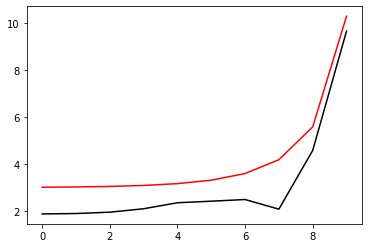

9200 99.0045515534781 9.48682623408053
[1.87969804 1.89616056 1.95372205 2.09832097 2.350222   2.42021911
 2.49044136 2.08224194 4.58199659 9.66586588]


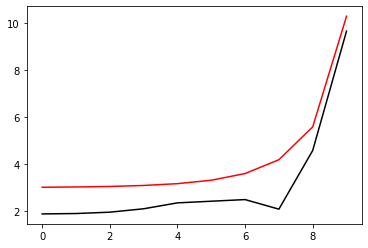

9300 99.00452700767661 9.485167433783591
[1.8806675  1.89718963 1.9546252  2.09794505 2.34668325 2.41939898
 2.48898215 2.08341647 4.58061932 9.66537779]


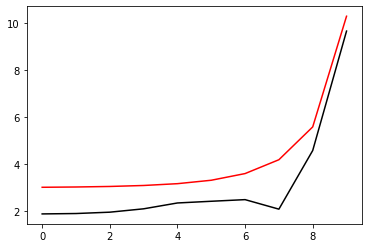

9400 99.00450303818333 9.483519727198486
[1.88164036 1.89821184 1.95550493 2.09755848 2.34321355 2.41855934
 2.4875332  2.08459034 4.57924777 9.66488961]


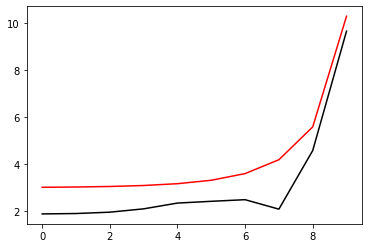

9500 99.00447962068262 9.481882964496222
[1.88261603 1.89922714 1.95636214 2.09716203 2.33981105 2.41770092
 2.48609432 2.08576351 4.57788188 9.66440135]


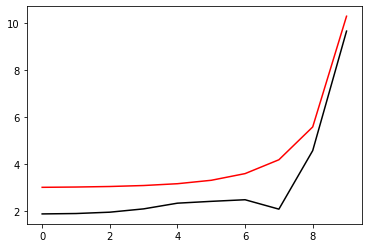

9600 99.00445673222099 9.480256998442087
[1.88359393 1.90023546 1.95719771 2.09675644 2.33647395 2.41682444
 2.48466533 2.08693594 4.57652159 9.663913  ]


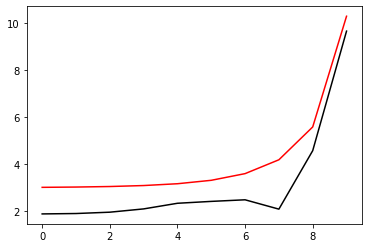

9700 99.00443435111968 9.478641684353882
[1.88457352 1.90123677 1.95801247 2.09634243 2.33320053 2.41593059
 2.48324608 2.08810758 4.57516683 9.66342457]


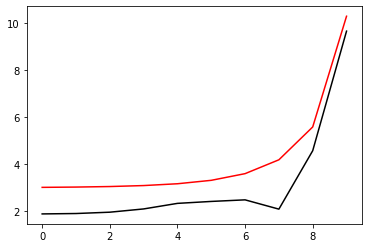

9800 99.0044124568934 9.477036880060107
[1.8855543  1.90223102 1.95880721 2.09592067 2.32998909 2.41502004
 2.48183639 2.08927839 4.57381755 9.66293605]


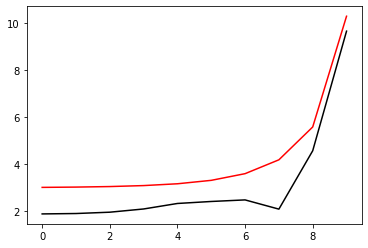

9900 99.00439103017455 9.475442445858105
[1.88653577 1.90321818 1.9595827  2.0954918  2.326838   2.41409345
 2.4804361  2.09044834 4.57247368 9.66244746]


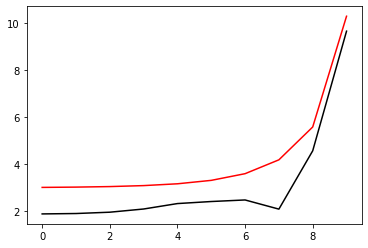

10000 99.0043700526427 9.47385824447224
[1.88751749 1.90419821 1.96033966 2.09505646 2.32374569 2.41315145
 2.47904506 2.09161738 4.57113517 9.66195878]


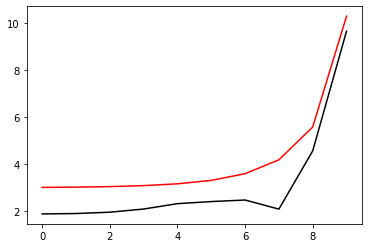

In [60]:
optimizer=tf.optimizers.SGD(learning_rate=0.01)
for i in range (1, 10001):
    run()
    if i%100==0: print(i, Error_func(h, m2_2).numpy(), m2_2.numpy()), print(h.numpy()), plt.plot(h_real, 'r-'), plt.plot(h.numpy(), 'k-'), plt.show()

100 99.00434950695886 9.472284141012247
[1.88849903 1.90517111 1.9610788  2.09461523 2.32071062 2.41219466
 2.4776631  2.09278547 4.56980196 9.66147002]


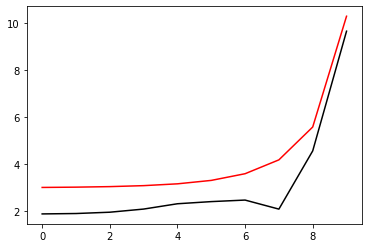

200 99.00432937670425 9.470720002931746
[1.88947996 1.90613683 1.96180077 2.09416868 2.31773131 2.41122367
 2.47629008 2.09395258 4.56847399 9.66098118]


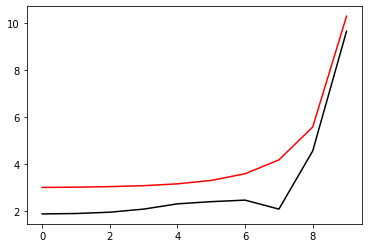

300 99.00430964632312 9.469165699986995
[1.89045992 1.90709537 1.96250622 2.09371734 2.31480632 2.41023906
 2.47492586 2.09511868 4.5671512  9.66049226]


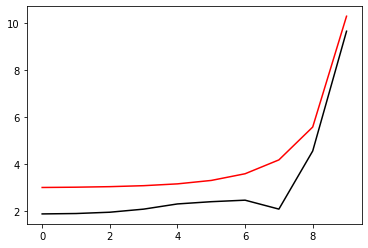

400 99.00429030106953 9.467621104196006
[1.89143854 1.90804671 1.96319576 2.09326174 2.31193425 2.40924139
 2.47357029 2.09628372 4.56583355 9.66000326]


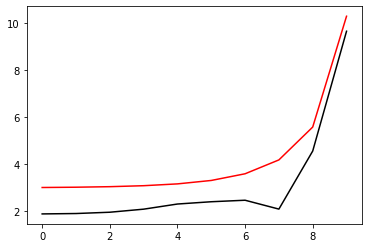

500 99.00427132695768 9.46608608979782
[1.89241547 1.90899084 1.96386998 2.09280235 2.30911375 2.4082312
 2.47222322 2.09744767 4.56452098 9.65951418]


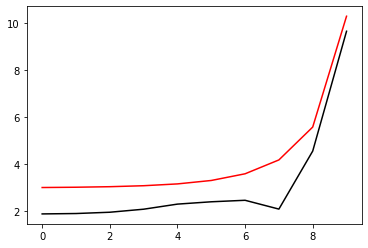

600 99.00425271071563 9.464560533212353
[1.89339039 1.90992776 1.96452944 2.09233966 2.3063435  2.40720902
 2.47088454 2.09861049 4.56321344 9.65902502]


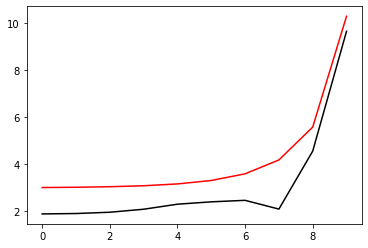

700 99.00423443974188 9.463044313000537
[1.89436299 1.91085747 1.96517468 2.0918741  2.30362225 2.40617537
 2.46955409 2.09977216 4.56191087 9.65853579]


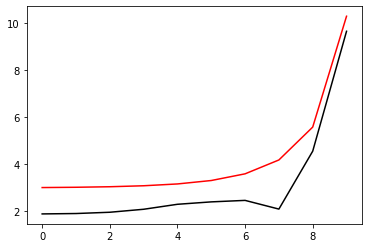

800 99.00421650206519 9.461537309824884
[1.895333   1.91177996 1.96580621 2.0914061  2.30094875 2.40513073
 2.46823176 2.10093264 4.56061322 9.65804647]


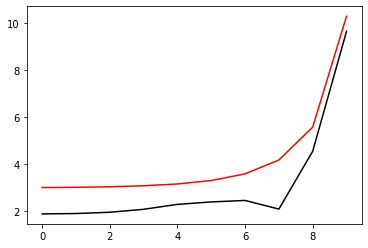

900 99.00419888630678 9.460039406410557
[1.89630013 1.91269524 1.96642453 2.09093606 2.29832181 2.4040756
 2.46691742 2.1020919  4.55932045 9.65755708]


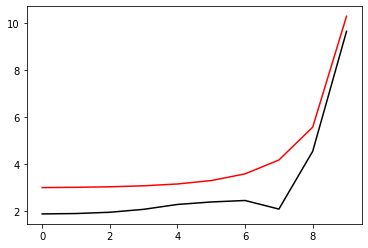

1000 99.00418158164516 9.458550487506903
[1.89726414 1.91360332 1.96703011 2.09046437 2.29574026 2.40301043
 2.46561095 2.1032499  4.5580325  9.65706761]


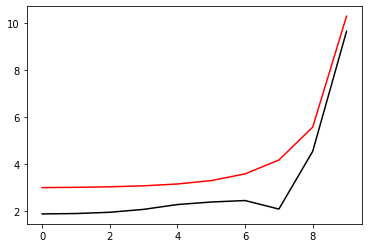

1100 99.0041645777832 9.457070439849511
[1.89822479 1.91450421 1.9676234  2.08999138 2.29320299 2.40193569
 2.46431222 2.10440662 4.55674933 9.65657807]


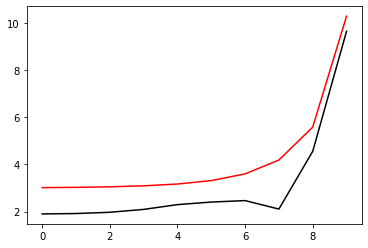

1200 99.00414786491743 9.455599152122755
[1.89918185 1.91539792 1.96820484 2.08951745 2.2907089  2.40085181
 2.46302111 2.10556202 4.55547088 9.65608845]


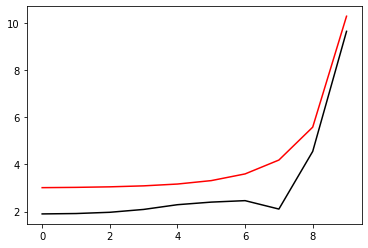

1300 99.00413143370925 9.454136514922864
[1.90013511 1.91628447 1.96877485 2.0890429  2.28825694 2.39975921
 2.46173753 2.10671608 4.55419711 9.65559875]


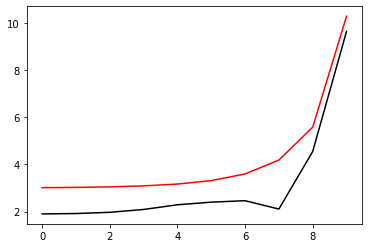

1400 99.00411527525816 9.452682420721592
[1.90108438 1.91716388 1.96933382 2.08856805 2.28584607 2.39865831
 2.46046135 2.10786877 4.55292798 9.65510898]


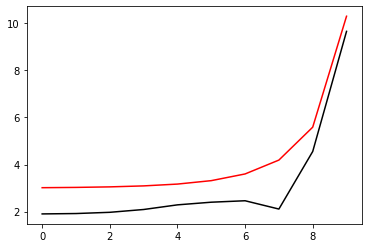

1500 99.00409938107646 9.451236763830366
[1.90202947 1.91803616 1.96988215 2.08809318 2.2834753  2.39754952
 2.45919246 2.10902006 4.55166344 9.65461913]


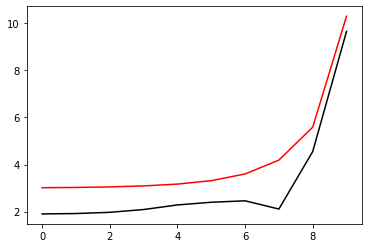

1600 99.00408374306588 9.449799440365071
[1.90297021 1.91890134 1.9704202  2.08761859 2.28114367 2.39643322
 2.45793076 2.11016992 4.55040344 9.65412921]


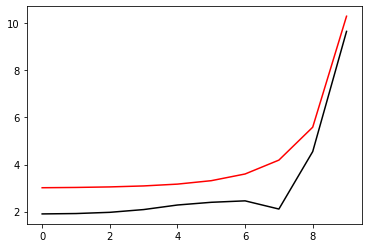

1700 99.00406835349548 9.448370348211347
[1.90390644 1.91975945 1.97094831 2.08714452 2.27885023 2.39530979
 2.45667615 2.11131832 4.54914794 9.65363922]


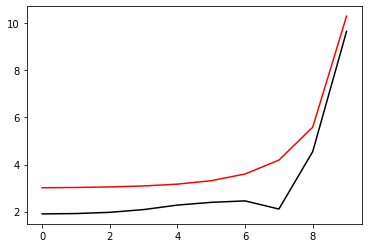

1800 99.00405320498109 9.446949386990486
[1.90483801 1.92061051 1.97146684 2.08667124 2.27659408 2.3941796
 2.45542853 2.11246524 4.54789689 9.65314915]


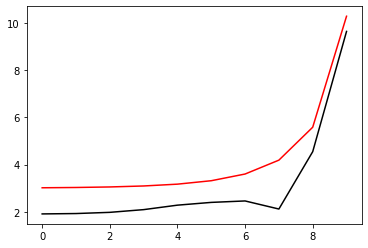

1900 99.0040382904659 9.44553645802589
[1.90576478 1.92145455 1.9719761  2.08619898 2.27437432 2.393043
 2.45418779 2.11361066 4.54665026 9.65265901]


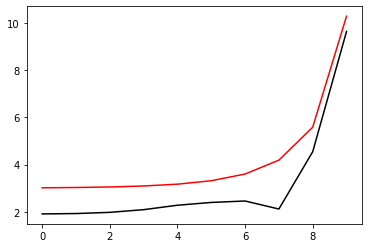

2000 99.0040236032025 9.444131464310122
[1.90668662 1.9222916  1.97247641 2.08572797 2.27219011 2.39190034
 2.45295384 2.11475455 4.545408   9.6521688 ]


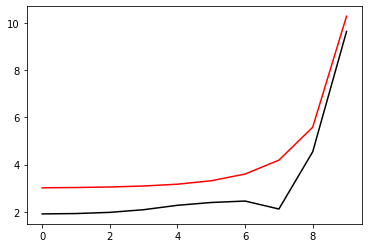

2100 99.00400913673582 9.442734310472497
[1.90760341 1.92312169 1.97296807 2.08525841 2.2700406  2.39075195
 2.45172659 2.11589688 4.54417008 9.65167851]


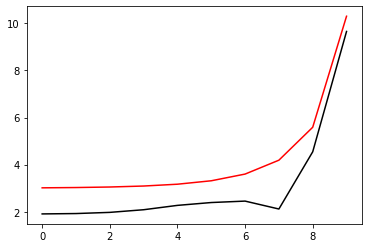

2200 99.00399488488726 9.441344902747312
[1.90851504 1.92394486 1.97345136 2.0847905  2.26792499 2.38959816
 2.45050595 2.11703763 4.54293644 9.65118816]


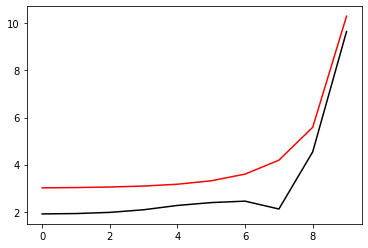

2300 99.00398084173987 9.439963148942576
[1.90942141 1.92476115 1.97392655 2.08432443 2.2658425  2.38843928
 2.44929183 2.11817678 4.54170705 9.65069773]


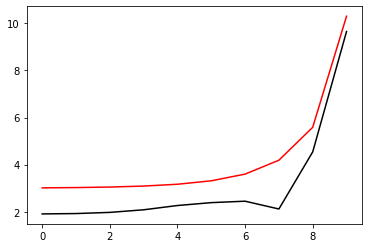

2400 99.00396700162419 9.438588958409376
[1.91032241 1.92557058 1.97439392 2.08386037 2.26379235 2.38727562
 2.44808413 2.1193143  4.54048188 9.65020723]


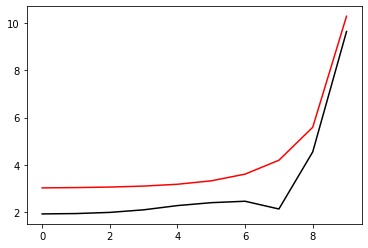

2500 99.00395335910527 9.437222242011796
[1.91121798 1.9263732  1.97485372 2.0833985  2.26177382 2.38610748
 2.44688279 2.12045018 4.53926087 9.64971666]


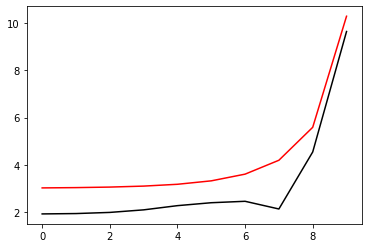

2600 99.0039399089702 9.43586291209736
[1.91210801 1.92716905 1.9753062  2.08293895 2.25978617 2.38493513
 2.4456877  2.12158438 4.538044   9.64922602]


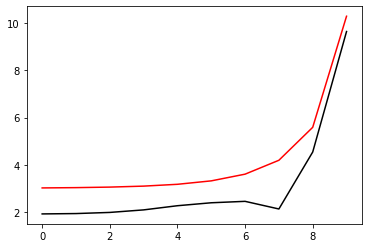

2700 99.00392664621663 9.434510882468071
[1.91299246 1.92795816 1.97575157 2.08248189 2.25782871 2.38375887
 2.4444988  2.1227169  4.53683123 9.64873532]


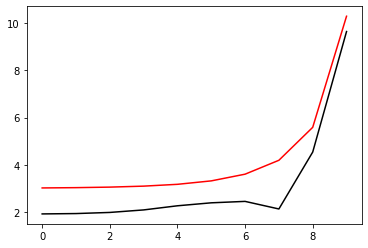

2800 99.00391356604193 9.433166068352039
[1.91387123 1.92874058 1.97619008 2.08202745 2.25590076 2.38257897
 2.443316   2.1238477  4.53562251 9.64824454]


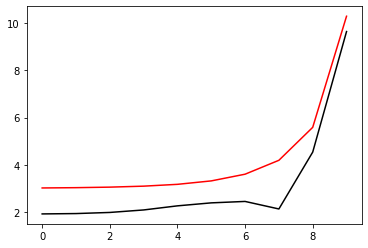

2900 99.00390066383278 9.431828386375562
[1.91474429 1.92951635 1.97662193 2.08157574 2.25400166 2.38139567
 2.44213922 2.12497677 4.53441782 9.64775369]


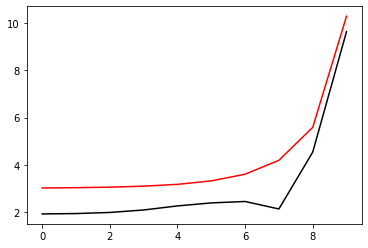

3000 99.00388793515572 9.430497754535853
[1.91561157 1.93028552 1.97704734 2.0811269  2.25213076 2.38020925
 2.4409684  2.1261041  4.53321712 9.64726278]


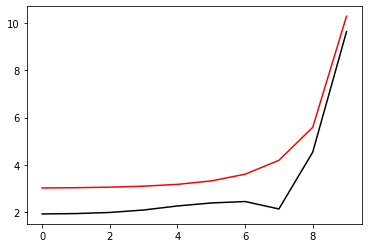

3100 99.00387537574798 9.429174092174232
[1.91647302 1.93104812 1.97746651 2.08068102 2.25028745 2.37901995
 2.43980345 2.12722965 4.53202036 9.6467718 ]


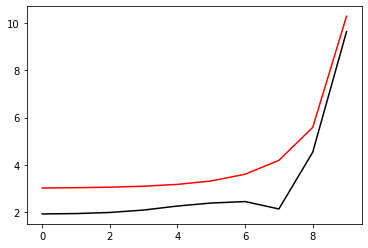

3200 99.00386298150906 9.427857319949888
[1.9173286  1.93180421 1.97787961 2.08023822 2.24847112 2.377828
 2.4386443  2.12835341 4.53082753 9.64628075]


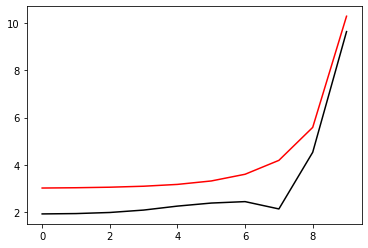

3300 99.00385074849262 9.426547359814151
[1.91817829 1.93255382 1.97828685 2.07979858 2.24668117 2.37663364
 2.4374909  2.12947536 4.52963858 9.64578963]


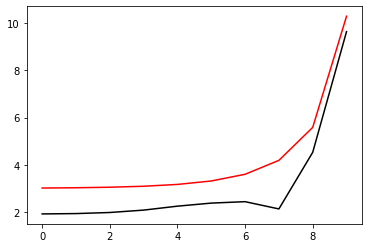

3400 99.00383867289901 9.42524413498527
[1.91902203 1.93329701 1.97868839 2.07936219 2.24491703 2.3754371
 2.43634315 2.13059549 4.52845347 9.64529845]


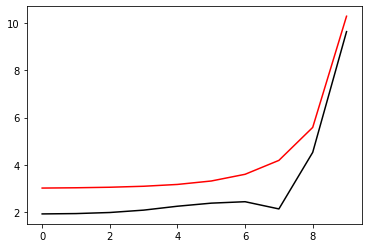

3500 99.00382675106805 9.423947569923742
[1.91985981 1.93403382 1.97908441 2.07892914 2.24317816 2.37423859
 2.43520101 2.13171378 4.52727219 9.6448072 ]


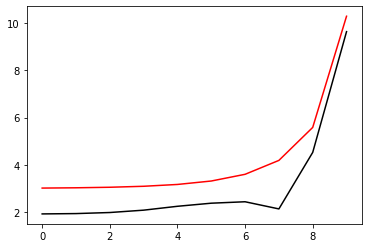

3600 99.00381497947241 9.422657590308058
[1.9206916  1.93476429 1.97947507 2.0784995  2.24146399 2.37303833
 2.4340644  2.13283021 4.52609468 9.64431588]


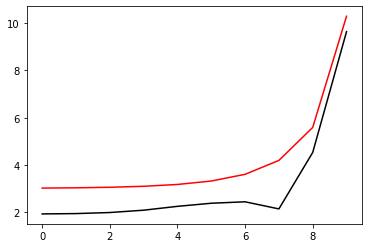

3700 99.00380335471121 9.42137412301104
[1.92151738 1.93548849 1.97986053 2.07807334 2.23977402 2.37183652
 2.43293327 2.13394476 4.52492093 9.6438245 ]


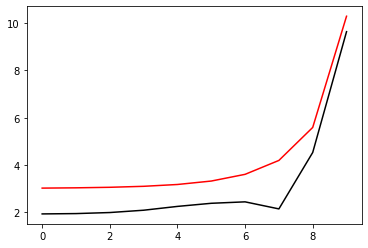

3800 99.00379187350413 9.420097096076574
[1.92233714 1.93620644 1.98024093 2.07765072 2.23810772 2.37063336
 2.43180754 2.13505742 4.5237509  9.64333305]


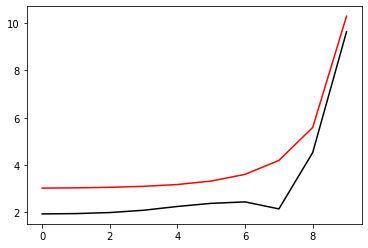

3900 99.00378053268567 9.418826438696934
[1.92315086 1.93691821 1.98061643 2.07723169 2.23646459 2.36942905
 2.43068716 2.13616817 4.52258456 9.64284154]


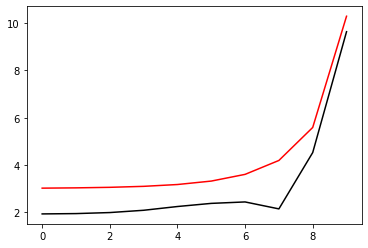

4000 99.00376932919993 9.417562081190406
[1.92395854 1.93762384 1.98098715 2.0768163  2.23484416 2.36822377
 2.42957206 2.137277   4.52142187 9.64234996]


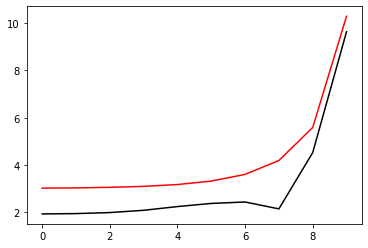

4100 99.00375826009548 9.416303954979533
[1.92476017 1.93832338 1.98135325 2.07640461 2.23324594 2.3670177
 2.4284622  2.13838389 4.52026281 9.64185832]


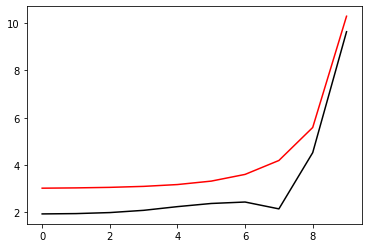

4200 99.0037473225207 9.41505199256975
[1.92555575 1.93901688 1.98171483 2.07599666 2.23166949 2.36581103
 2.42735751 2.13948883 4.51910735 9.64136662]


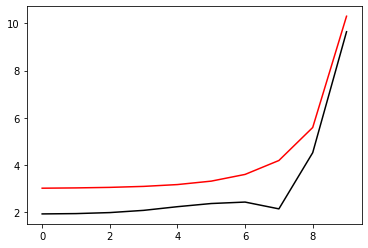

4300 99.00373651371922 9.413806127528414
[1.92634528 1.93970439 1.98207204 2.07559247 2.23011434 2.36460392
 2.42625794 2.1405918  4.51795546 9.64087485]


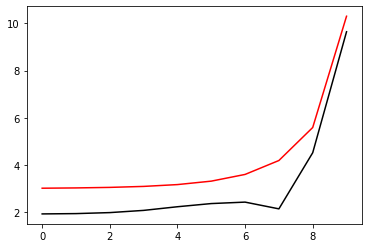

4400 99.00372583102575 9.412566294464384
[1.92712876 1.94038596 1.98242498 2.07519208 2.22858007 2.36339653
 2.42516343 2.1416928  4.51680711 9.64038302]


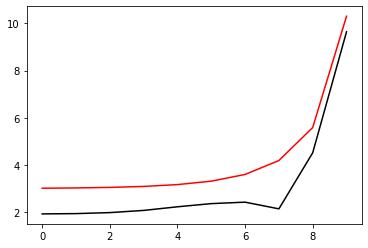

4500 99.00371527186192 9.411332429007917
[1.92790621 1.94106164 1.98277378 2.07479553 2.22706625 2.36218904
 2.42407393 2.14279179 4.51566226 9.63989113]


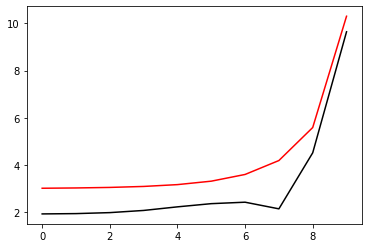

4600 99.00370483373264 9.410104467791035
[1.92867763 1.94173148 1.98311854 2.07440282 2.22557247 2.36098159
 2.42298939 2.14388878 4.5145209  9.63939917]


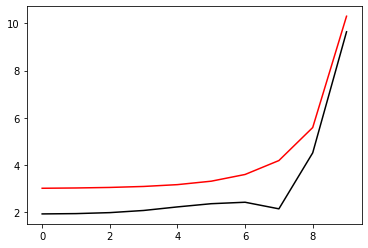

4700 99.00369451422233 9.408882348428321
[1.92944303 1.94239553 1.98345937 2.074014   2.22409833 2.35977434
 2.42190976 2.14498375 4.513383   9.63890715]


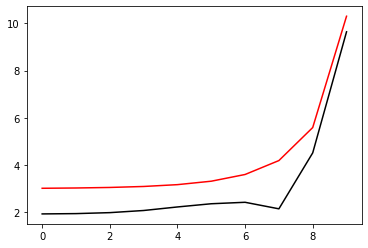

4800 99.00368431099164 9.407666009498103
[1.93020242 1.94305384 1.98379638 2.07362906 2.22264344 2.35856742
 2.42083498 2.14607669 4.51224852 9.63841507]


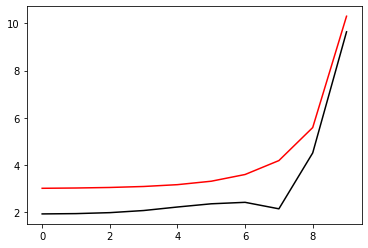

4900 99.00367422177416 9.406455390523963
[1.93095583 1.94370645 1.98412965 2.07324802 2.22120741 2.357361
 2.41976502 2.14716758 4.51111744 9.63792293]


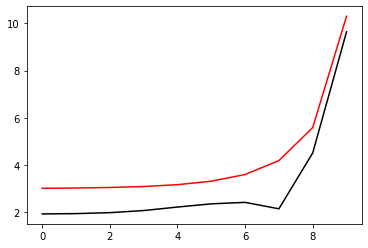

5000 99.0036642443733 9.40525043195679
[1.93170327 1.94435343 1.98445929 2.0728709  2.21978987 2.35615519
 2.41869982 2.14825642 4.50998973 9.63743072]


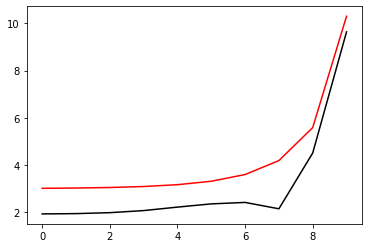

5100 99.00365437665944 9.404051075157053
[1.93244476 1.94499482 1.98478538 2.07249769 2.21839047 2.35495014
 2.41763934 2.14934319 4.50886537 9.63693846]


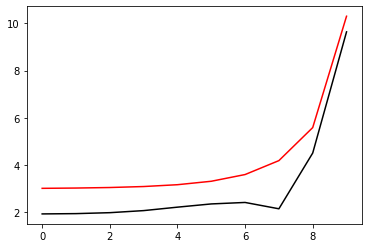

5200 99.00364461656712 9.40285726237757
[1.93318033 1.94563067 1.98510802 2.07212841 2.21700884 2.35374597
 2.41658353 2.15042788 4.50774433 9.63644613]


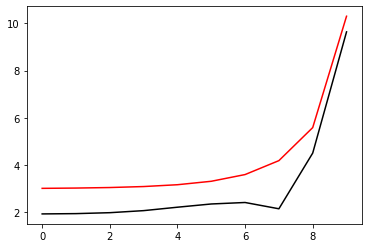

5300 99.00363496209245 9.401668936746518
[1.93390999 1.94626102 1.98542728 2.07176306 2.21564465 2.35254281
 2.41553235 2.15151049 4.50662659 9.63595375]


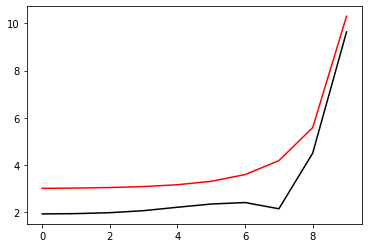

5400 99.00362541129061 9.400486042250954
[1.93463377 1.94688594 1.98574326 2.07140163 2.21429756 2.35134077
 2.41448575 2.15259099 4.50551212 9.6354613 ]


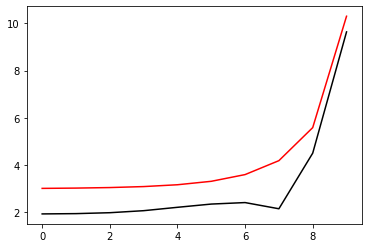

5500 99.00361596227343 9.399308523720531
[1.93535169 1.94750547 1.98605602 2.07104412 2.21296725 2.35013999
 2.4134437  2.15366938 4.50440089 9.6349688 ]


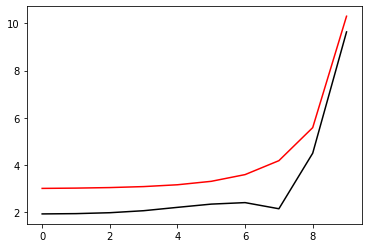

5600 99.0036066132072 9.398136326811676
[1.93606379 1.94811966 1.98636564 2.07069052 2.21165339 2.34894056
 2.41240614 2.15474565 4.50329289 9.63447623]


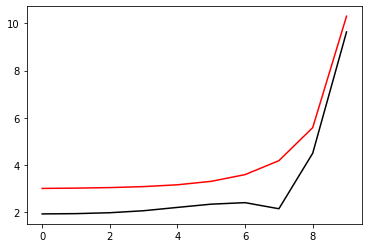

5700 99.00359736231047 9.396969397992024
[1.9367701  1.94872855 1.98667221 2.07034082 2.21035568 2.34774261
 2.41137305 2.1558198  4.50218808 9.63398361]


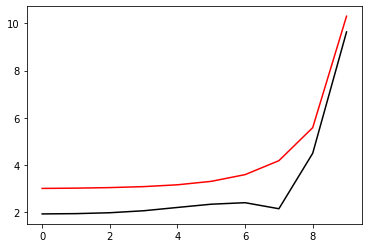

5800 99.00358820785205 9.395807684525225
[1.93747064 1.9493322  1.98697577 2.06999502 2.20907381 2.34654623
 2.41034438 2.1568918  4.50108645 9.63349093]


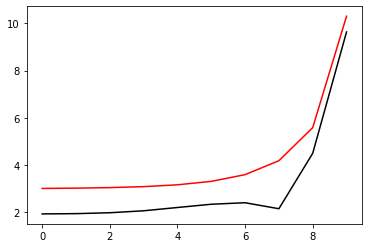

5900 99.00357914814902 9.394651134456067
[1.93816545 1.94993066 1.98727641 2.0696531  2.20780749 2.34535152
 2.40932009 2.15796166 4.49998796 9.63299819]


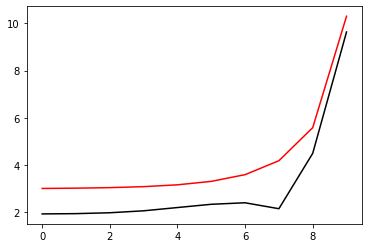

6000 99.00357018156495 9.393499696595878
[1.93885455 1.95052398 1.98757419 2.06931504 2.20655644 2.3441586
 2.40830015 2.15902936 4.49889261 9.63250539]


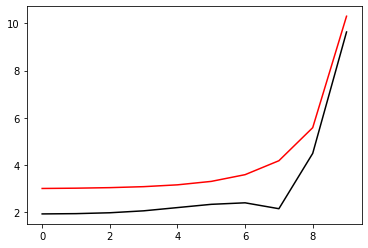

6100 99.00356130650808 9.392353320508308
[1.93953798 1.9511122  1.98786917 2.06898084 2.20532036 2.34296755
 2.40728451 2.16009489 4.49780035 9.63201254]


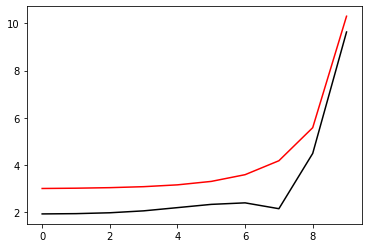

6200 99.00355252142961 9.391211956495319
[1.94021578 1.95169537 1.9881614  2.06865047 2.20409899 2.34177847
 2.40627314 2.16115826 4.49671118 9.63151963]


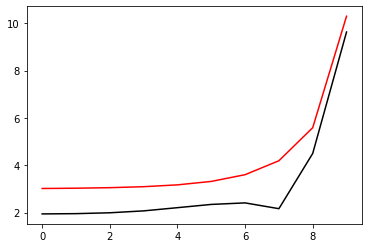

6300 99.00354382482224 9.39007555558355
[1.94088798 1.95227354 1.98845096 2.06832392 2.20289206 2.34059145
 2.40526602 2.16221943 4.49562507 9.63102666]


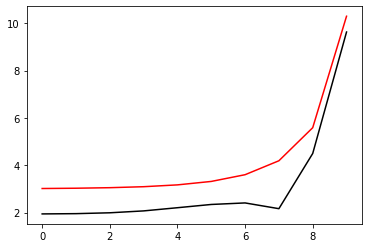

6400 99.0035352152184 9.388944069510933
[1.94155462 1.95284675 1.98873789 2.06800116 2.20169931 2.33940657
 2.40426309 2.16327843 4.49454199 9.63053363]


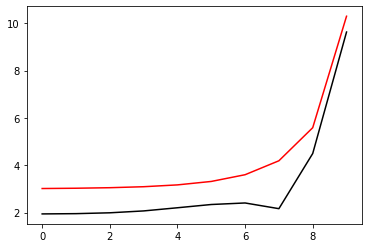

6500 99.00352669118907 9.387817450713582
[1.94221572 1.95341507 1.98902226 2.06768217 2.20052049 2.33822392
 2.40326433 2.16433522 4.49346193 9.63004055]


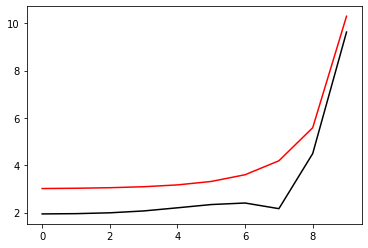

6600 99.00351825134214 9.38669565231299
[1.94287134 1.95397852 1.9893041  2.06736692 2.19935534 2.33704358
 2.4022697  2.16538981 4.49238486 9.62954741]


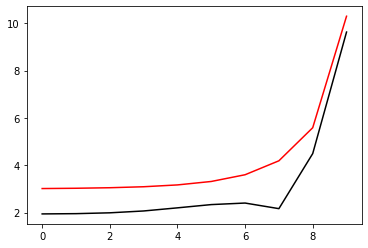

6700 99.00350989432128 9.38557862810347
[1.94352151 1.95453717 1.98958347 2.06705541 2.19820362 2.33586564
 2.40127918 2.16644219 4.49131076 9.62905421]


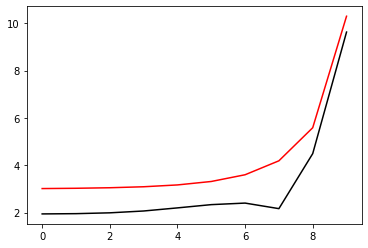

6800 99.00350161880452 9.384466332539851
[1.94416626 1.95509105 1.98986043 2.06674759 2.19706511 2.33469016
 2.40029273 2.16749235 4.49023962 9.62856096]


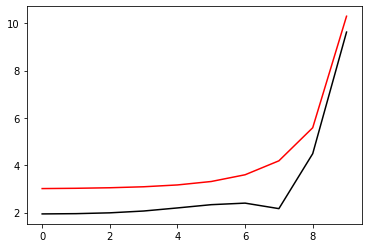

6900 99.00349342350309 9.383358720725473
[1.94480563 1.95564021 1.99013501 2.06644344 2.19593956 2.33351721
 2.39931031 2.16854029 4.48917141 9.62806765]


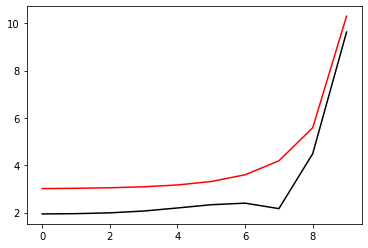

7000 99.0034853071603 9.38225574840042
[1.94543967 1.95618471 1.99040726 2.06614294 2.19482675 2.33234688
 2.39833191 2.16958599 4.4881061  9.62757429]


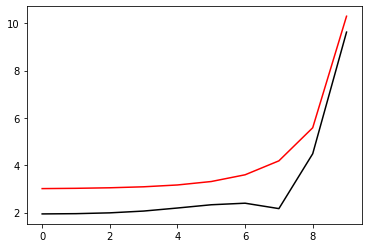

7100 99.00347726855034 9.381157371929953
[1.94606841 1.95672457 1.99067723 2.06584605 2.19372647 2.33117923
 2.39735748 2.17062946 4.48704369 9.62708088]


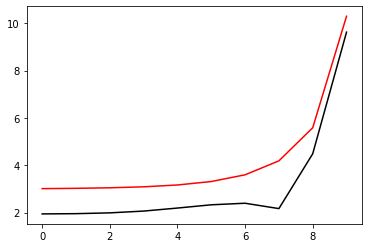

7200 99.00346930647733 9.380063548293244
[1.94669189 1.95725985 1.99094495 2.06555275 2.19263849 2.33001432
 2.396387   2.17167069 4.48598415 9.62658741]


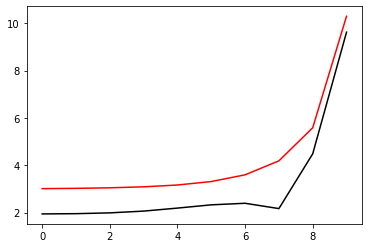

7300 99.00346141977414 9.37897423507231
[1.94731016 1.9577906  1.99121048 2.06526301 2.1915626  2.32885222
 2.39542045 2.17270967 4.48492746 9.62609388]


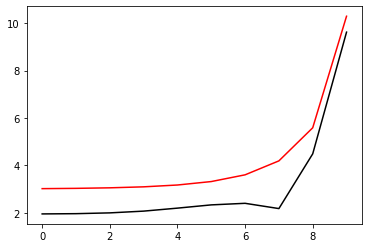

7400 99.00345360730164 9.377889390441204
[1.94792325 1.95831685 1.99147384 2.06497679 2.19049861 2.327693
 2.39445778 2.17374639 4.4838736  9.6256003 ]


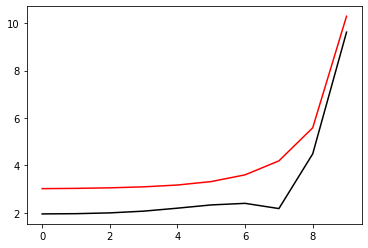

7500 99.00344586794753 9.376808973155404
[1.9485312  1.95883866 1.99173507 2.06469408 2.1894463  2.3265367
 2.39349898 2.17478085 4.48282256 9.62510667]


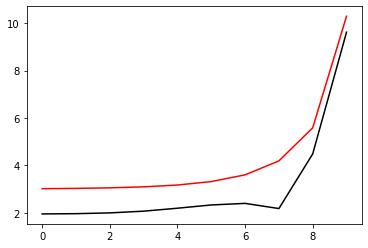

7600 99.0034382006256 9.375732942541456
[1.94913406 1.95935606 1.99199422 2.06441482 2.18840549 2.32538339
 2.39254402 2.17581305 4.48177431 9.62461299]


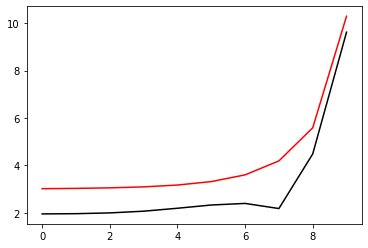

7700 99.00343060427485 9.374661258486785
[1.94973186 1.9598691  1.99225131 2.064139   2.18737598 2.32423312
 2.39159287 2.17684298 4.48072883 9.62411925]


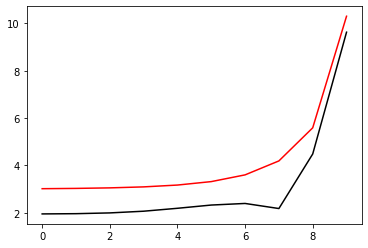

7800 99.00342307785863 9.373593881429768
[1.95032466 1.96037782 1.99250639 2.06386658 2.18635759 2.32308595
 2.39064551 2.17787064 4.47968611 9.62362546]


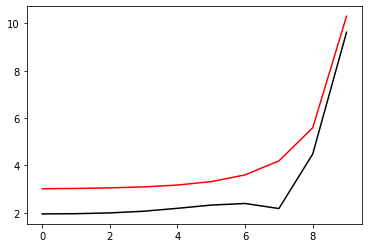

7900 99.00341562036385 9.37253077234999
[1.95091248 1.96088227 1.99275948 2.06359752 2.18535013 2.32194192
 2.3897019  2.17889602 4.47864613 9.62313161]


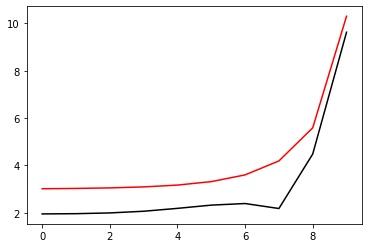

8000 99.00340823080023 9.371471892758667
[1.95149536 1.96138249 1.99301062 2.0633318  2.18435342 2.3208011
 2.38876203 2.17991912 4.47760888 9.62263771]


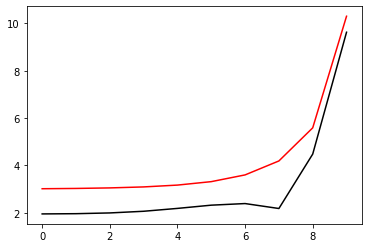

8100 99.00340090819965 9.370417204689357
[1.95207337 1.96187851 1.99325983 2.06306938 2.18336729 2.31966351
 2.38782588 2.18093992 4.47657432 9.62214377]


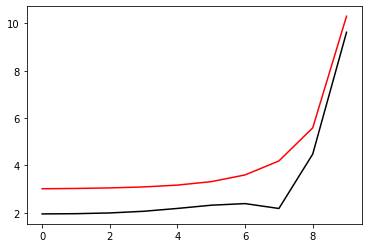

8200 99.00339365161534 9.369366670688752
[1.95264652 1.96237038 1.99350715 2.06281022 2.18239156 2.31852922
 2.38689341 2.18195844 4.47554245 9.62164977]


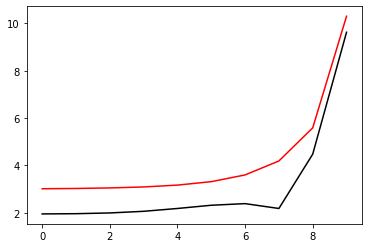

8300 99.00338646012123 9.368320253807752
[1.95321486 1.96285815 1.9937526  2.0625543  2.18142607 2.31739826
 2.3859646  2.18297466 4.47451325 9.62115571]


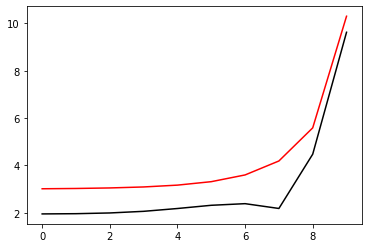

8400 99.00337933281142 9.367277917592634
[1.95377845 1.96334184 1.99399622 2.06230157 2.18047066 2.31627067
 2.38503943 2.18398859 4.4734867  9.62066161]


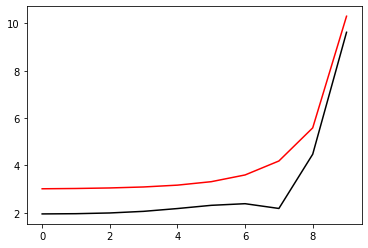

8500 99.00337226879941 9.366239626076528
[1.95433731 1.96382151 1.99423803 2.062052   2.17952516 2.3151465
 2.38411789 2.18500021 4.47246278 9.62016746]


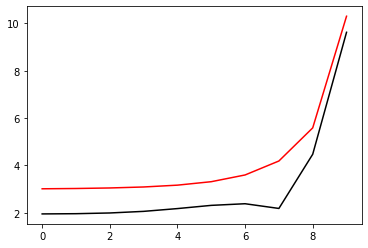

8600 99.00336526721757 9.365205343770917
[1.95489148 1.96429719 1.99447806 2.06180557 2.17858943 2.31402579
 2.38319993 2.18600953 4.47144148 9.61967325]


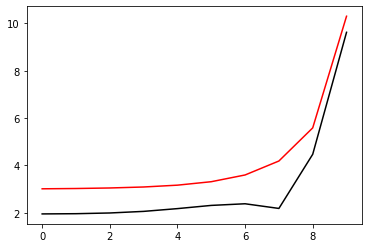

8700 99.00335832721663 9.36417503565741
[1.95544102 1.96476893 1.99471633 2.06156222 2.17766329 2.31290857
 2.38228556 2.18701653 4.47042278 9.619179  ]


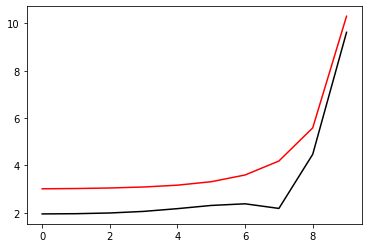

8800 99.00335144796499 9.363148667179683
[1.95598595 1.96523675 1.99495286 2.06132193 2.17674661 2.31179488
 2.38137473 2.18802123 4.46940667 9.61868469]


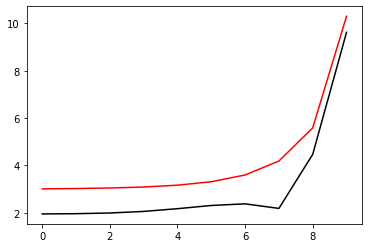

8900 99.00334462864836 9.362126204235508
[1.95652633 1.96570071 1.99518769 2.06108467 2.17583924 2.31068475
 2.38046744 2.18902361 4.46839312 9.61819034]


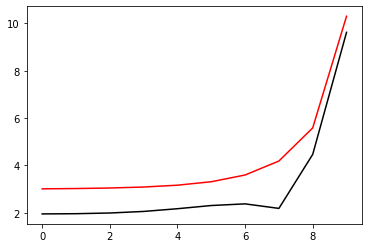

9000 99.0033378684691 9.36110761316905
[1.95706219 1.96616083 1.99542083 2.06085039 2.17494104 2.30957821
 2.37956366 2.19002368 4.46738213 9.61769593]


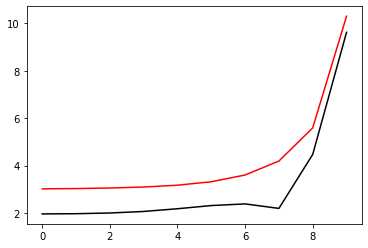

9100 99.00333116664581 9.360092860763205
[1.95759357 1.96661716 1.99565231 2.06061906 2.17405185 2.30847531
 2.37866337 2.19102143 4.46637367 9.61720148]


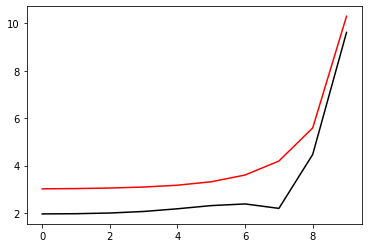

9200 99.00332452241287 9.359081914232197
[1.95812052 1.96706973 1.99588214 2.06039065 2.17317156 2.30737606
 2.37776656 2.19201685 4.46536774 9.61670697]


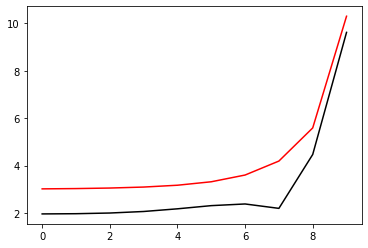

9300 99.00331793501991 9.358074741214232
[1.95864307 1.96751859 1.99611035 2.06016513 2.17230001 2.30628049
 2.37687319 2.19300995 4.46436431 9.61621242]


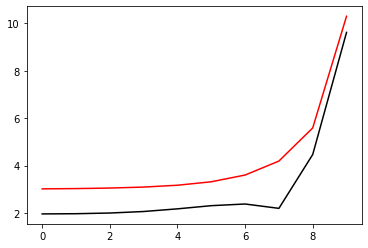

9400 99.00331140373144 9.357071309764416
[1.95916126 1.96796376 1.99633696 2.05994245 2.17143708 2.30518865
 2.37598326 2.19400072 4.46336337 9.61571782]


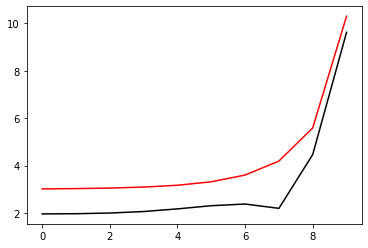

9500 99.00330492782646 9.35607158834766
[1.95967513 1.96840529 1.99656199 2.05972258 2.17058264 2.30410054
 2.37509674 2.19498917 4.46236491 9.61522317]


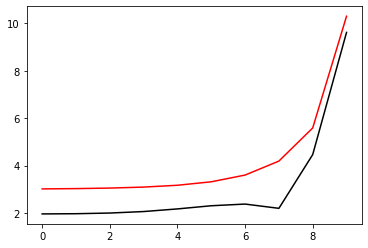

9600 99.00329850659791 9.355075545831872
[1.96018473 1.9688432  1.99678546 2.0595055  2.16973656 2.30301619
 2.37421362 2.19597529 4.46136891 9.61472847]


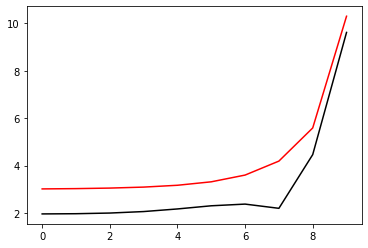

9700 99.00329213935242 9.354083151481191
[1.9606901  1.96927755 1.99700739 2.05929115 2.16889873 2.30193564
 2.37333388 2.19695907 4.46037535 9.61423372]


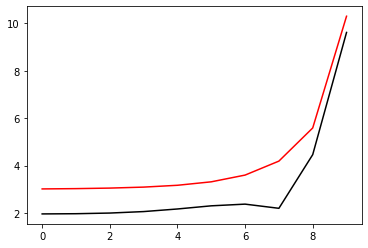

9800 99.00328582540992 9.353094374949407
[1.96119126 1.96970835 1.99722779 2.05907952 2.168069   2.30085889
 2.3724575  2.19794052 4.45938423 9.61373893]


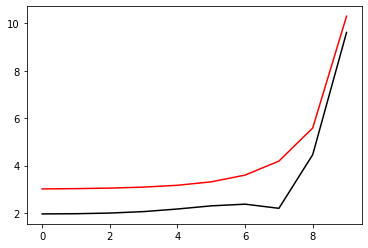

9900 99.00327956410314 9.352109186273514
[1.96168827 1.97013565 1.99744668 2.05887056 2.16724728 2.29978598
 2.37158446 2.19891964 4.45839552 9.61324409]


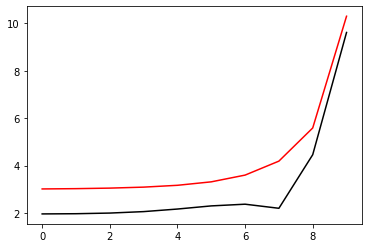

10000 99.00327335477743 9.351127555867317
[1.96218116 1.97055948 1.99766408 2.05866424 2.16643343 2.29871692
 2.37071475 2.19989642 4.45740921 9.6127492 ]


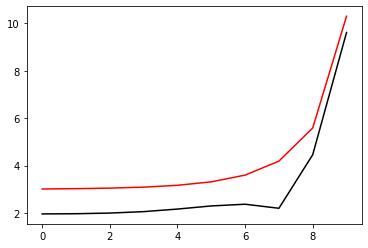

In [61]:
optimizer=tf.optimizers.SGD(learning_rate=0.01)
for i in range (1, 10001):
    run()
    if i%100==0: print(i, Error_func(h, m2_2).numpy(), m2_2.numpy()), print(h.numpy()), plt.plot(h_real, 'r-'), plt.plot(h.numpy(), 'k-'), plt.show()

100 99.00326719679032 9.35014945451527
[1.96266996 1.97097988 1.99788001 2.05846052 2.16562736 2.29765174
 2.36984834 2.20087087 4.45642529 9.61225426]


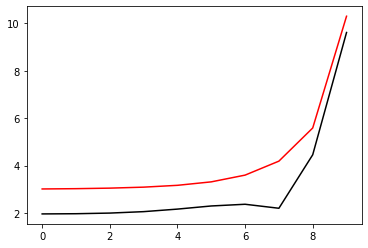

200 99.00326108951124 9.34917485336635
[1.96315472 1.97139688 1.99809448 2.05825938 2.16482893 2.29659044
 2.36898523 2.20184297 4.45544375 9.61175928]


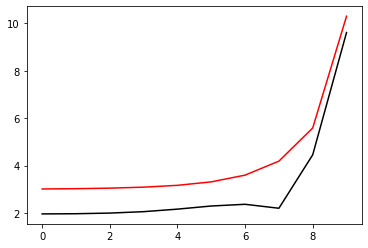

300 99.00325503232112 9.348203723928124
[1.96363548 1.9718105  1.9983075  2.05806078 2.16403805 2.29553306
 2.3681254  2.20281274 4.45446457 9.61126425]


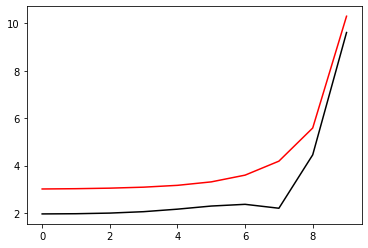

400 99.00324902461223 9.347236038060856
[1.96411227 1.9722208  1.99851911 2.05786468 2.16325461 2.2944796
 2.36726882 2.20378017 4.45348774 9.61076918]


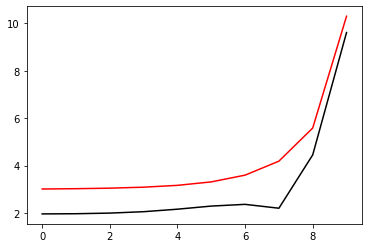

500 99.00324306578771 9.34627176797179
[1.96458513 1.97262779 1.99872929 2.05767105 2.1624785  2.29343008
 2.36641549 2.20474525 4.45251323 9.61027405]


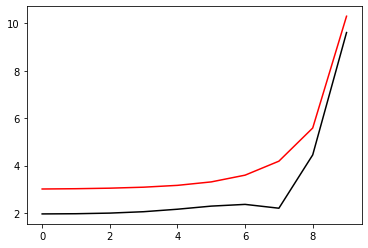

600 99.00323715526144 9.345310886209523
[1.9650541  1.97303151 1.99893809 2.05747987 2.16170962 2.29238451
 2.36556539 2.205708   4.45154105 9.60977889]


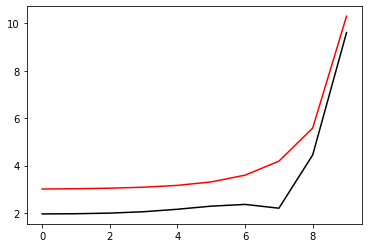

700 99.00323129245768 9.344353365658494
[1.96551921 1.973432   1.9991455  2.05729109 2.16094786 2.29134291
 2.36471851 2.2066684  4.45057118 9.60928367]


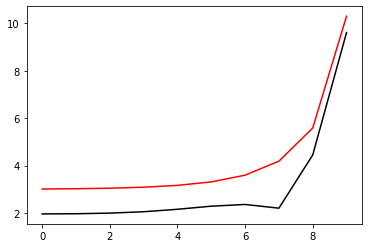

800 99.0032254768108 9.343399179533556
[1.96598051 1.97382928 1.99935153 2.05710468 2.16019312 2.29030529
 2.36387482 2.20762647 4.4496036  9.60878841]


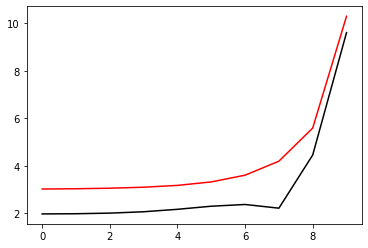

900 99.00321970776507 9.342448301374684
[1.96643802 1.97422338 1.99955622 2.05692062 2.15944532 2.28927166
 2.36303431 2.20858219 4.4486383  9.60829311]


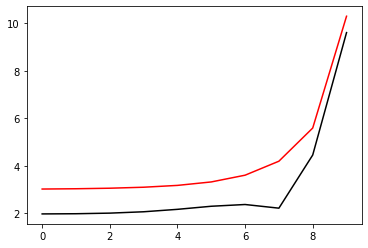

1000 99.00321398477439 9.341500705041776
[1.96689178 1.97461434 1.99975956 2.05673887 2.15870435 2.28824204
 2.36219698 2.20953556 4.44767527 9.60779776]


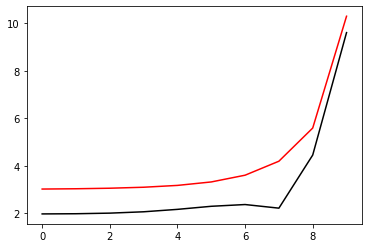

1100 99.00320830730197 9.340556364709537
[1.96734183 1.97500219 1.99996157 2.0565594  2.15797011 2.28721643
 2.3613628  2.2104866  4.4467145  9.60730237]


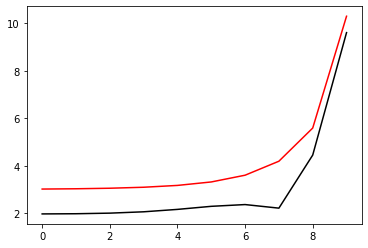

1200 99.00320267482026 9.339615254862508
[1.96778821 1.97538696 2.00016226 2.05638217 2.15724253 2.28619484
 2.36053176 2.21143529 4.44575596 9.60680693]


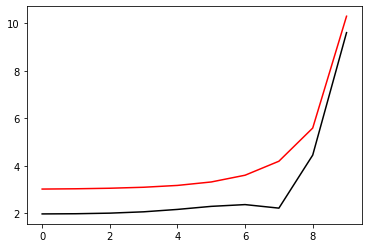

1300 99.0031970868106 9.338677350290142
[1.96823095 1.97576867 2.00036165 2.05620716 2.1565215  2.28517728
 2.35970385 2.21238164 4.44479966 9.60631145]


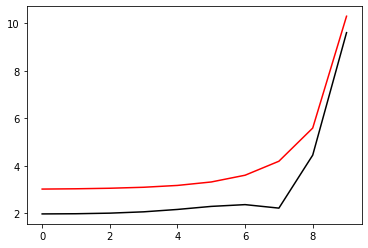

1400 99.00319154276303 9.337742626081946
[1.96867008 1.97614736 2.00055974 2.05603433 2.15580693 2.28416377
 2.35887905 2.21332565 4.44384558 9.60581592]


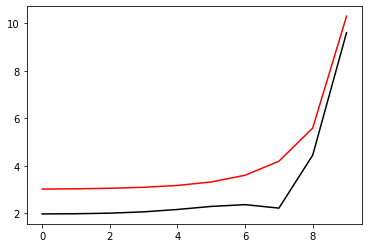

1500 99.00318604217605 9.336811057622832
[1.96910564 1.97652305 2.00075655 2.05586367 2.15509875 2.28315429
 2.35805735 2.21426732 4.4428937  9.60532035]


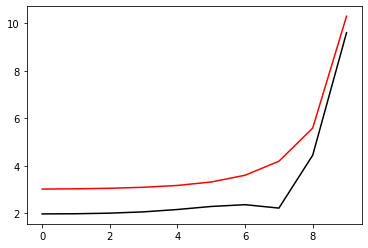

1600 99.00318058455653 9.335882620588471
[1.96953767 1.97689578 2.00095209 2.05569512 2.15439686 2.28214887
 2.35723874 2.21520665 4.44194402 9.60482473]


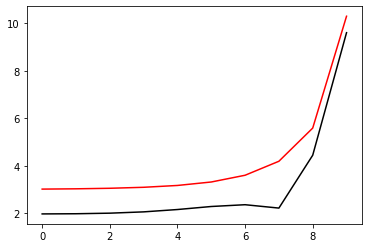

1700 99.00317516941934 9.334957290940695
[1.96996619 1.97726557 2.00114637 2.05552867 2.15370118 2.28114751
 2.35642321 2.21614363 4.44099652 9.60432908]


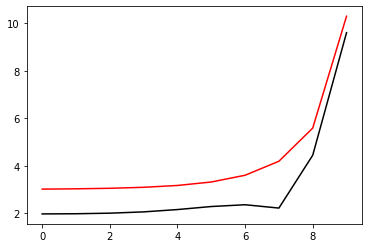

1800 99.00316979628731 9.334035044923102
[1.97039124 1.97763246 2.0013394  2.05536429 2.15301163 2.28015021
 2.35561073 2.21707828 4.44005119 9.60383337]


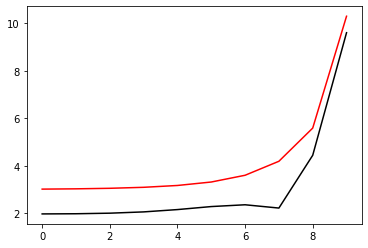

1900 99.00316446469094 9.333115859056656
[1.97081285 1.97799646 2.0015312  2.05520194 2.15232812 2.27915698
 2.35480131 2.21801058 4.43910801 9.60333763]


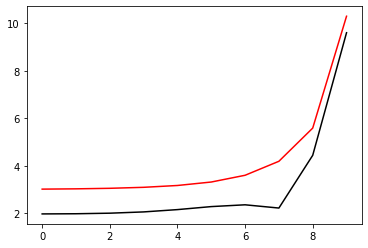

2000 99.00315917416827 9.332199710135402
[1.97123106 1.97835761 2.00172176 2.0550416  2.15165059 2.27816782
 2.35399491 2.21894055 4.43816699 9.60284184]


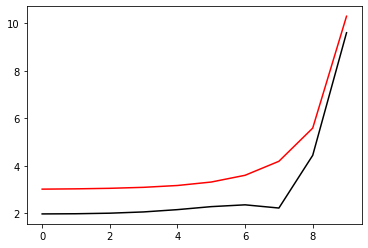

2100 99.00315392426475 9.331286575222268
[1.97164591 1.97871594 2.00191111 2.05488324 2.15097894 2.27718274
 2.35319155 2.21986818 4.4372281  9.60234601]


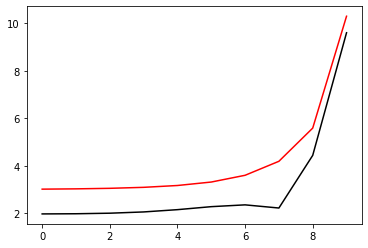

2200 99.00314871453291 9.3303764316449
[1.97205741 1.97907147 2.00209925 2.05472683 2.15031311 2.27620173
 2.35239119 2.22079348 4.43629134 9.60185014]


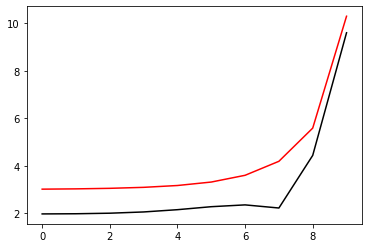

2300 99.00314354453239 9.32946925699164
[1.9724656  1.97942422 2.00228619 2.05457234 2.14965301 2.2752248
 2.35159383 2.22171644 4.43535668 9.60135423]


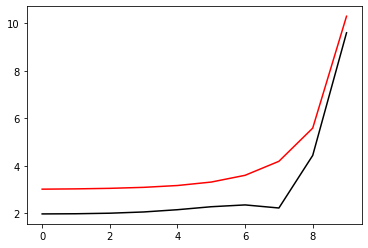

2400 99.00313841382966 9.328565029107553
[1.97287052 1.97977423 2.00247194 2.05441974 2.14899858 2.27425195
 2.35079947 2.22263706 4.43442413 9.60085827]


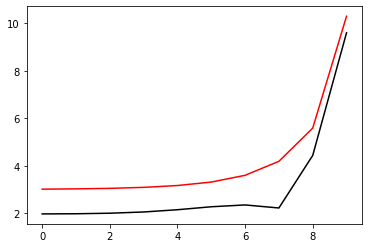

2500 99.00313332199786 9.327663726090497
[1.9732722  1.98012152 2.00265651 2.05426902 2.14834974 2.27328319
 2.35000807 2.22355535 4.43349367 9.60036227]


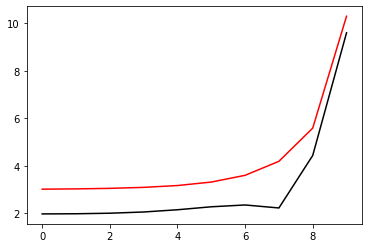

2600 99.00312826861678 9.326765326287296
[1.97367067 1.98046612 2.00283992 2.05412013 2.14770642 2.2723185
 2.34921964 2.22447131 4.43256529 9.59986623]


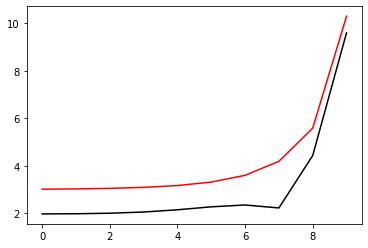

2700 99.00312325327253 9.32586980829
[1.97406595 1.98080804 2.00302216 2.05397306 2.14706855 2.2713579
 2.34843417 2.22538494 4.43163898 9.59937015]


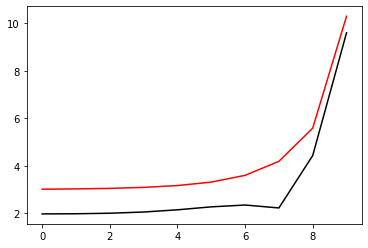

2800 99.00311827555754 9.324977150932176
[1.97445808 1.98114733 2.00320325 2.05382777 2.14643607 2.27040137
 2.34765163 2.22629624 4.43071473 9.59887403]


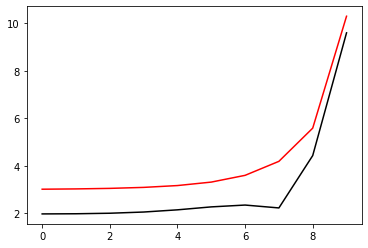

2900 99.00311333507032 9.324087333285288
[1.97484709 1.98148399 2.00338319 2.05368425 2.14580889 2.26944893
 2.34687203 2.22720521 4.42979253 9.59837786]


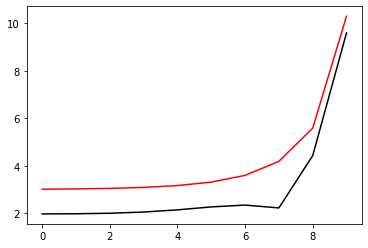

3000 99.00310843141547 9.32320033465516
[1.97523301 1.98181807 2.003562   2.05354246 2.14518697 2.26850057
 2.34609535 2.22811186 4.42887236 9.59788166]


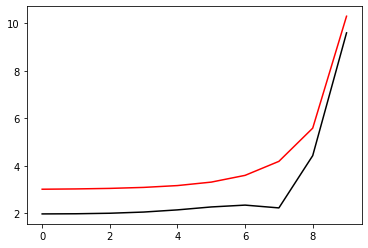

3100 99.00310356420334 9.322316134578427
[1.97561586 1.98214957 2.00373969 2.05340238 2.14457022 2.26755628
 2.34532157 2.22901618 4.42795422 9.59738542]


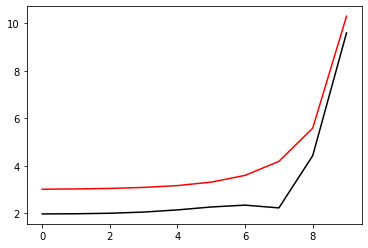

3200 99.00309873305014 9.321434712819185
[1.97599569 1.98247853 2.00391625 2.05326399 2.1439586  2.26661606
 2.34455069 2.22991818 4.4270381  9.59688913]


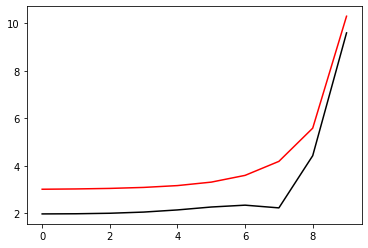

3300 99.0030939375776 9.320556049365571
[1.9763725  1.98280496 2.0040917  2.05312726 2.14335203 2.26567992
 2.3437827  2.23081786 4.42612399 9.5963928 ]


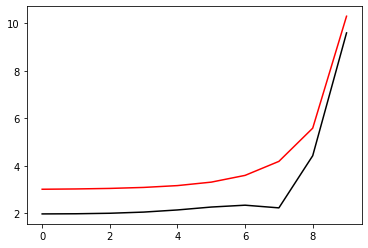

3400 99.00308917741306 9.319680124426474
[1.97674635 1.9831289  2.00426605 2.05299216 2.14275045 2.26474784
 2.34301759 2.23171522 4.42521187 9.59589644]


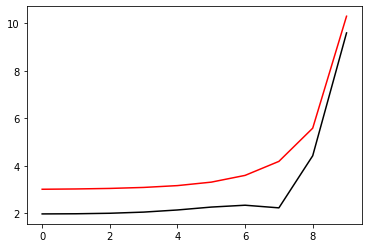

3500 99.00308445218914 9.318806918428283
[1.97711724 1.98345036 2.00443931 2.05285867 2.14215381 2.26381982
 2.34225535 2.23261026 4.42430173 9.59540003]


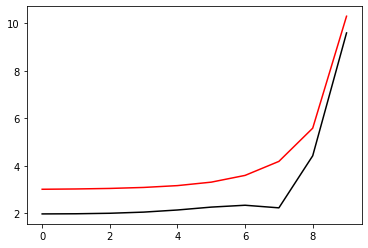

3600 99.00307976154382 9.317936412011715
[1.97748522 1.98376937 2.00461148 2.05272677 2.14156203 2.26289587
 2.34149596 2.23350299 4.42339358 9.59490359]


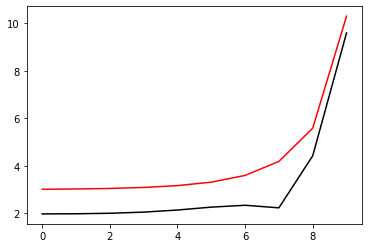

3700 99.00307510512019 9.317068586028691
[1.9778503  1.98408595 2.00478257 2.05259644 2.14097507 2.26197597
 2.34073942 2.23439341 4.42248738 9.5944071 ]


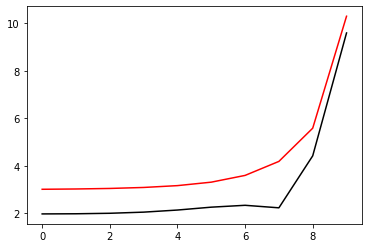

3800 99.00307048256643 9.316203421539209
[1.97821252 1.98440012 2.00495258 2.05246764 2.14039287 2.26106012
 2.33998571 2.23528151 4.42158315 9.59391058]


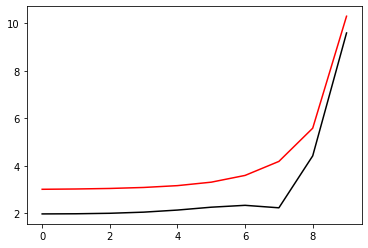

3900 99.00306589353568 9.315340899808414
[1.97857191 1.98471191 2.00512153 2.05234037 2.13981536 2.26014831
 2.33923484 2.23616731 4.42068086 9.59341402]


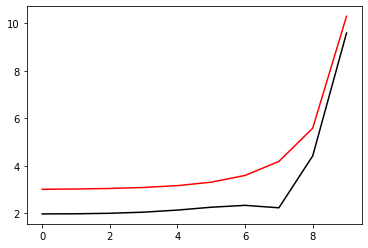

4000 99.00306133768592 9.314481002303554
[1.97892848 1.98502133 2.00528943 2.05221459 2.1392425  2.25924054
 2.33848677 2.2370508  4.41978052 9.59291742]


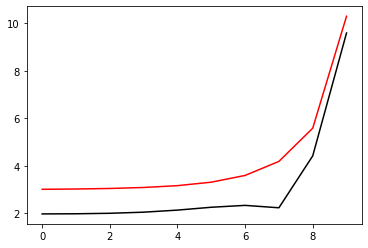

4100 99.00305681467992 9.31362371069112
[1.97928227 1.98532841 2.00545627 2.05209028 2.13867422 2.25833681
 2.33774152 2.23793199 4.41888209 9.59242078]


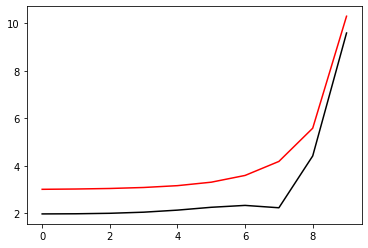

4200 99.00305232418506 9.312769006833967
[1.9796333  1.98563318 2.00562207 2.05196742 2.13811048 2.2574371
 2.33699906 2.23881087 4.41798559 9.5919241 ]


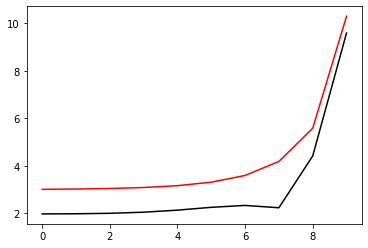

4300 99.00304786587336 9.31191687278848
[1.9799816  1.98593564 2.00578683 2.051846   2.13755122 2.25654141
 2.3362594  2.23968746 4.417091   9.59142738]


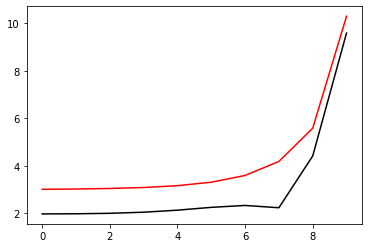

4400 99.00304343942129 9.311067290801875
[1.98032719 1.98623583 2.00595056 2.05172598 2.13699638 2.25564974
 2.33552251 2.24056175 4.41619831 9.59093062]


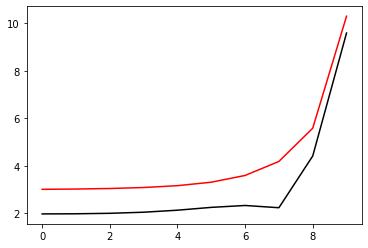

4500 99.0030390445097 9.31022024330943
[1.9806701  1.98653375 2.00611327 2.05160734 2.13644593 2.25476207
 2.33478839 2.24143374 4.4153075  9.59043383]


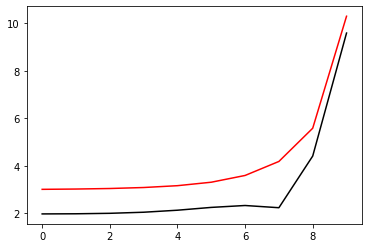

4600 99.00303468082382 9.309375712931836
[1.98101035 1.98682944 2.00627496 2.05149008 2.13589979 2.2538784
 2.33405703 2.24230344 4.41441858 9.589937  ]


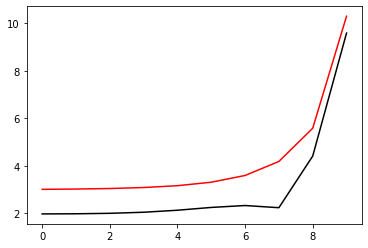

4700 99.003030348053 9.308533682472605
[1.98134798 1.98712292 2.00643564 2.05137416 2.13535793 2.25299872
 2.33332843 2.24317086 4.41353154 9.58944013]


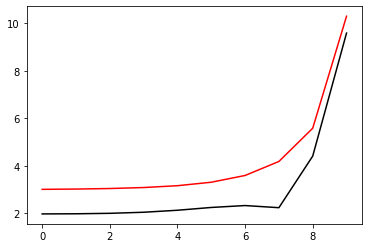

4800 99.00302604589083 9.307694134915472
[1.98168299 1.98741419 2.00659531 2.05125956 2.1348203  2.25212302
 2.33260256 2.24403599 4.41264635 9.58894323]


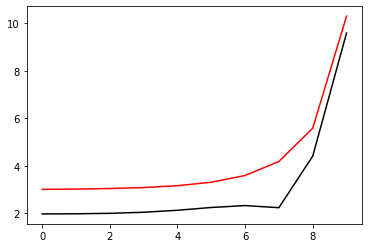

4900 99.00302177403493 9.30685705342187
[1.98201543 1.98770329 2.00675399 2.05114627 2.13428685 2.2512513
 2.33187943 2.24489883 4.41176303 9.58844628]


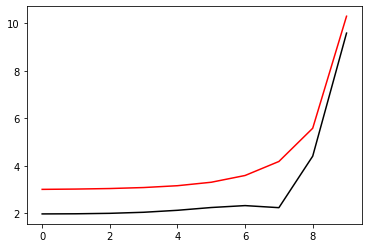

5000 99.00301753218695 9.30602242132846
[1.98234531 1.98799023 2.00691168 2.05103427 2.13375752 2.25038354
 2.33115902 2.2457594  4.41088154 9.5879493 ]


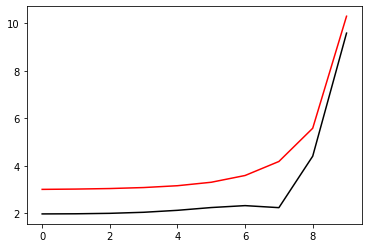

5100 99.00301332005237 9.305190222144677
[1.98267265 1.98827504 2.00706838 2.05092353 2.13323228 2.24951974
 2.33044134 2.24661768 4.4100019  9.58745229]


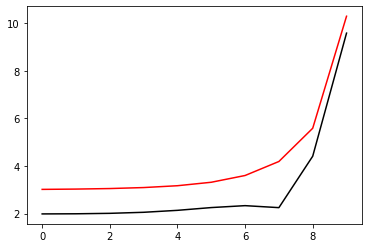

5200 99.00300913734064 9.304360439550347
[1.98299748 1.98855772 2.00722411 2.05081404 2.13271108 2.24865989
 2.32972635 2.2474737  4.40912408 9.58695523]


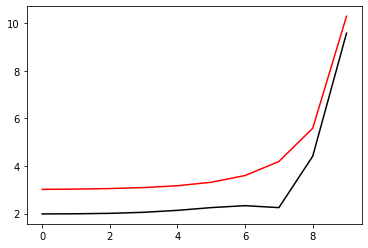

5300 99.00300498376487 9.303533057393317
[1.98331982 1.9888383  2.00737886 2.05070578 2.13219386 2.24780398
 2.32901407 2.24832744 4.40824809 9.58645814]


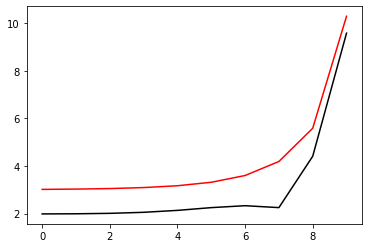

5400 99.00300085904192 9.302708059687141
[1.9836397  1.9891168  2.00753264 2.05059872 2.1316806  2.24695199
 2.32830447 2.24917891 4.40737391 9.58596102]


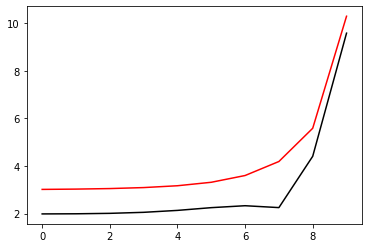

5500 99.00299676289234 9.301885430608804
[1.98395713 1.98939324 2.00768546 2.05049286 2.13117124 2.24610393
 2.32759756 2.25002811 4.40650153 9.58546386]


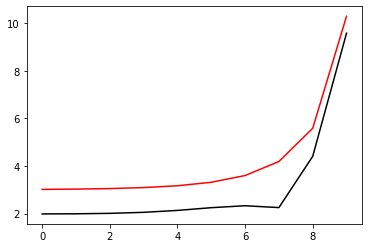

5600 99.00299269504018 9.301065154496477
[1.98427214 1.98966763 2.00783733 2.05038818 2.13066573 2.24525977
 2.32689332 2.25087505 4.40563094 9.58496666]


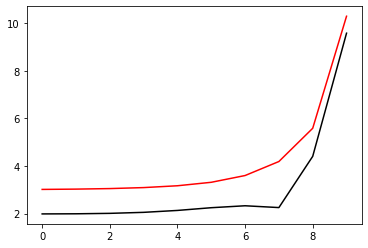

5700 99.00298865521303 9.30024721584733
[1.98458476 1.98994    2.00798825 2.05028464 2.13016405 2.24441952
 2.32619175 2.25171974 4.40476215 9.58446942]


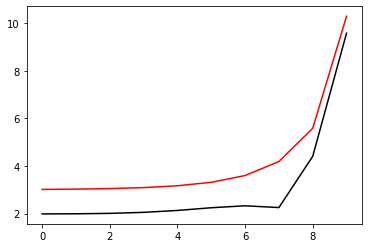

5800 99.00298464314189 9.299431599315362
[1.984895   1.99021035 2.00813822 2.05018225 2.12966614 2.24358315
 2.32549283 2.25256216 4.40389513 9.58397215]


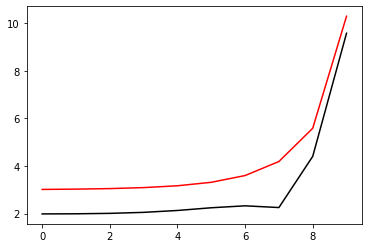

5900 99.00298065856121 9.298618289709266
[1.98520288 1.99047871 2.00828726 2.05008098 2.12917196 2.24275066
 2.32479656 2.25340234 4.40302988 9.58347485]


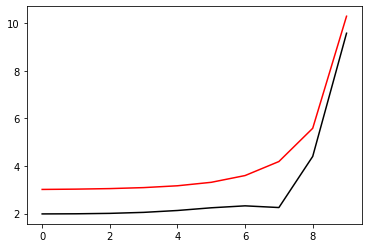

6000 99.00297670120874 9.297807271990337
[1.98550844 1.9907451  2.00843536 2.04998081 2.12868148 2.24192204
 2.32410293 2.25424026 4.40216639 9.58297751]


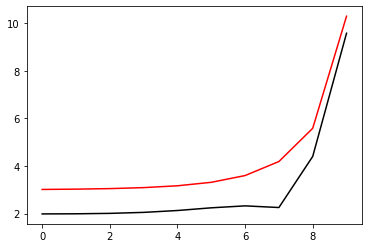

6100 99.00297277082547 9.29699853127047
[1.98581168 1.99100953 2.00858254 2.04988173 2.12819465 2.24109728
 2.32341194 2.25507593 4.40130466 9.58248013]


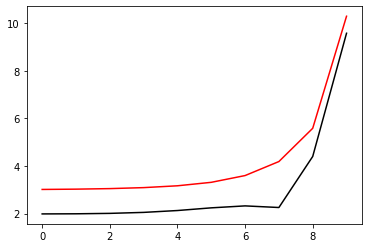

6200 99.0029688671556 9.296192052810035
[1.98611263 1.99127202 2.0087288  2.04978372 2.12771144 2.24027636
 2.32272357 2.25590936 4.40044468 9.58198272]


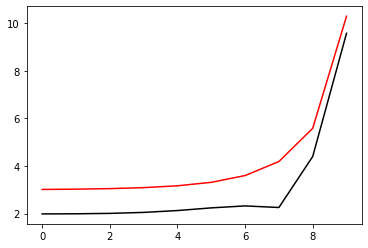

6300 99.00296498994655 9.295387822015988
[1.98641131 1.99153259 2.00887414 2.04968677 2.1272318  2.23945928
 2.32203781 2.25674056 4.39958643 9.58148528]


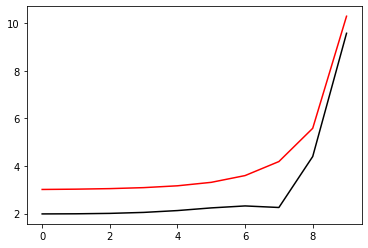

6400 99.00296113894876 9.294585824439846
[1.98670774 1.99179125 2.00901857 2.04959085 2.12675569 2.23864602
 2.32135466 2.25756951 4.39872992 9.5809878 ]


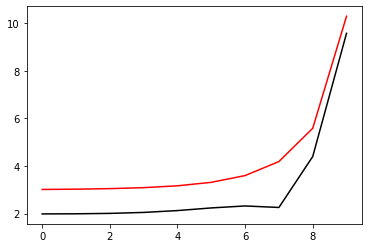

6500 99.00295731391579 9.293786045775825
[1.98700194 1.99204801 2.00916209 2.04949596 2.12628308 2.23783658
 2.32067411 2.25839623 4.39787513 9.58049029]


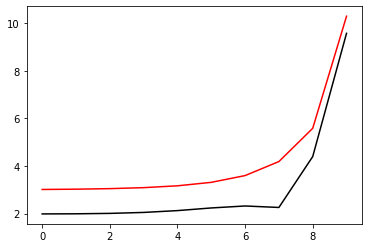

6600 99.00295351460416 9.292988471858909
[1.98729393 1.99230291 2.00930472 2.04940207 2.12581394 2.23703093
 2.31999616 2.25922072 4.39702205 9.57999274]


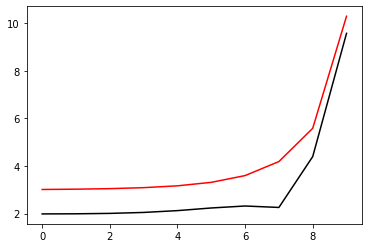

6700 99.0029497407733 9.29219308866299
[1.98758374 1.99255594 2.00944645 2.04930918 2.12534822 2.23622908
 2.31932079 2.26004299 4.39617069 9.57949516]


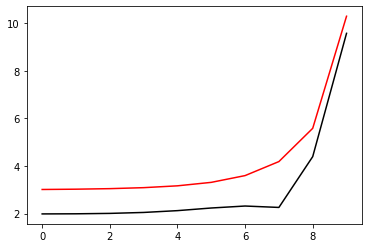

6800 99.00294599218564 9.291399882299045
[1.98787137 1.99280713 2.00958729 2.04921727 2.12488589 2.235431
 2.318648   2.26086303 4.39532102 9.57899754]


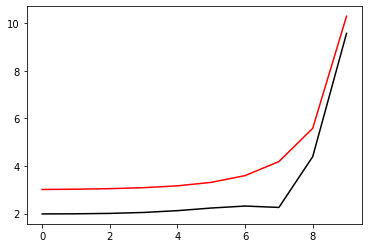

6900 99.00294226860639 9.290608839013366
[1.98815685 1.9930565  2.00972725 2.04912631 2.12442691 2.23463669
 2.31797777 2.26168085 4.39447305 9.57849989]


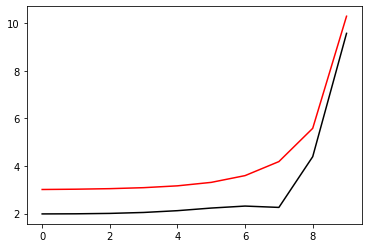

7000 99.00293856980355 9.289819945185753
[1.9884402  1.99330406 2.00986633 2.04903631 2.12397125 2.23384613
 2.31731011 2.26249646 4.39362676 9.57800221]


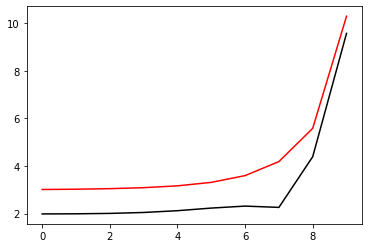

7100 99.0029348955479 9.289033187327776
[1.98872144 1.99354981 2.01000453 2.04894724 2.12351887 2.23305931
 2.31664501 2.26330986 4.39278215 9.57750449]


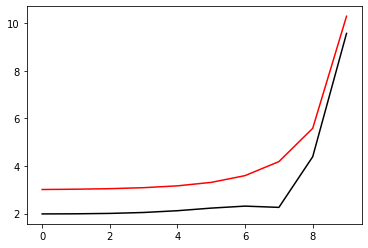

7200 99.00293124561296 9.288248552081086
[1.98900058 1.99379379 2.01014187 2.04885909 2.12306974 2.23227621
 2.31598245 2.26412104 4.39193921 9.57700674]


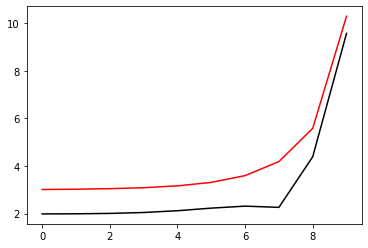

7300 99.00292761977487 9.28746602621572
[1.98927765 1.994036   2.01027834 2.04877184 2.12262383 2.23149684
 2.31532243 2.26493003 4.39109793 9.57650896]


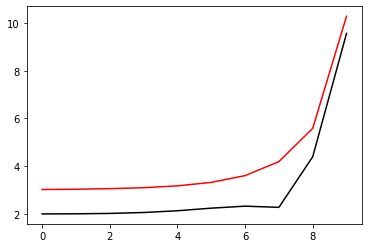

7400 99.00292401781243 9.286685596628418
[1.98955267 1.99427647 2.01041395 2.04868548 2.1221811  2.23072117
 2.31466494 2.26573681 4.39025831 9.57601114]


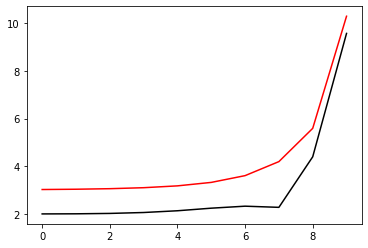

7500 99.00292043950702 9.285907250341047
[1.98982564 1.99451519 2.01054871 2.04860001 2.12174152 2.22994918
 2.31400998 2.26654139 4.38942034 9.57551329]


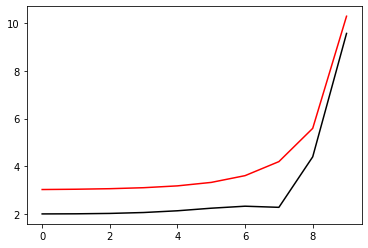

7600 99.00291688464254 9.285130974498971
[1.99009659 1.99475219 2.01068262 2.0485154  2.12130506 2.22918088
 2.31335753 2.26734378 4.38858401 9.57501541]


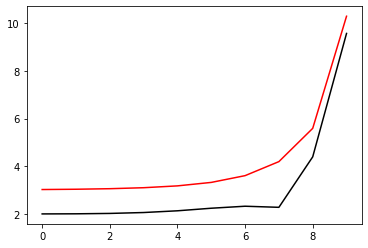

7700 99.00291335300545 9.284356756369403
[1.99036554 1.99498749 2.01081568 2.04843164 2.12087168 2.22841624
 2.31270759 2.26814398 4.38774932 9.5745175 ]


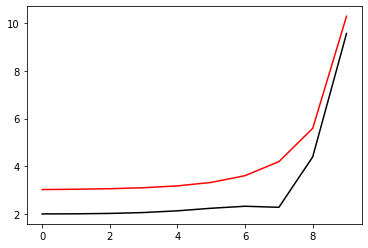

7800 99.00290984438459 9.283584583339996
[1.99063251 1.99522109 2.01094791 2.04834872 2.12044136 2.22765525
 2.31206016 2.268942   4.38691625 9.57401955]


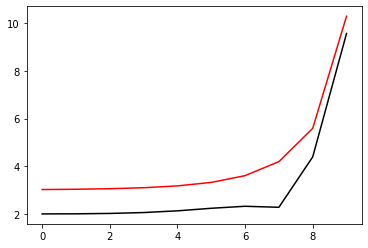

7900 99.00290635857128 9.28281444291717
[1.9908975  1.99545302 2.0110793  2.04826663 2.12001407 2.22689791
 2.31141522 2.26973783 4.38608481 9.57352158]


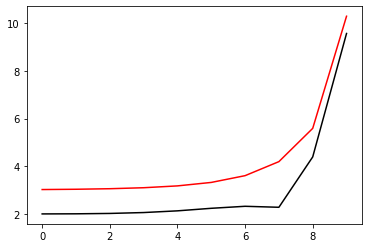

8000 99.00290289535923 9.282046322724696
[1.99116055 1.99568328 2.01120986 2.04818535 2.11958976 2.22614419
 2.31077277 2.27053148 4.38525498 9.57302357]


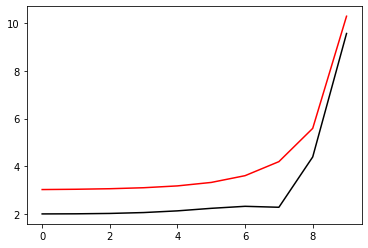

8100 99.00289945454446 9.281280210502171
[1.99142166 1.99591189 2.0113396  2.04810487 2.11916843 2.22539408
 2.3101328  2.27132297 4.38442675 9.57252553]


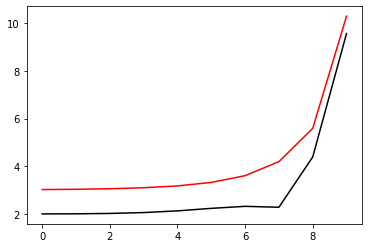

8200 99.00289603592537 9.280516094103607
[1.99168085 1.99613886 2.01146851 2.04802518 2.11875002 2.22464757
 2.30949531 2.27211228 4.38360013 9.57202745]


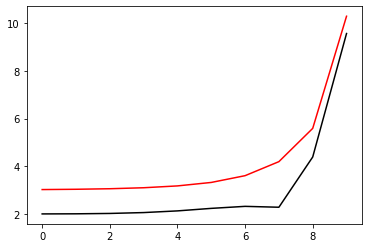

8300 99.0028926393026 9.279753961495938
[1.99193814 1.9963642  2.01159661 2.04794627 2.11833452 2.22390465
 2.30886028 2.27289942 4.3827751  9.57152935]


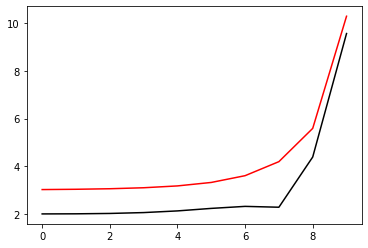

8400 99.00288926447901 9.278993800757654
[1.99219355 1.99658794 2.0117239  2.04786813 2.1179219  2.2231653
 2.30822771 2.2736844  4.38195166 9.57103121]


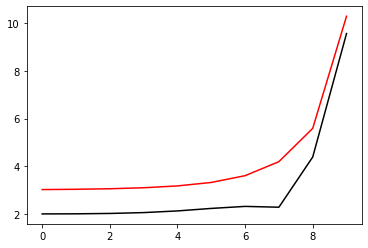

8500 99.00288591125972 9.278235600077387
[1.99244709 1.99681008 2.01185038 2.04779074 2.11751212 2.22242951
 2.3075976  2.27446723 4.3811298  9.57053305]


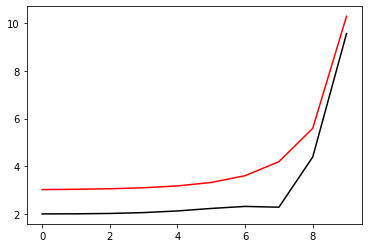

8600 99.00288257945202 9.277479347752534
[1.99269877 1.99703063 2.01197606 2.04771409 2.11710517 2.22169727
 2.30696993 2.2752479  4.38030951 9.57003485]


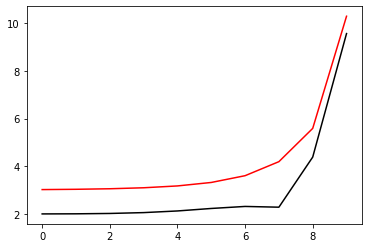

8700 99.00287926886531 9.276725032187954
[1.99294862 1.99724961 2.01210094 2.04763818 2.11670101 2.22096856
 2.30634469 2.27602642 4.37949079 9.56953662]


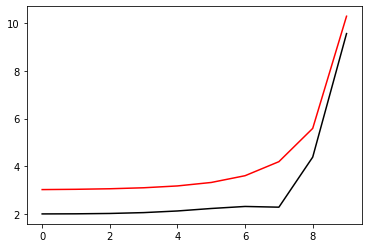

8800 99.00287597931116 9.275972641894588
[1.99319665 1.99746704 2.01222503 2.04756299 2.11629961 2.22024336
 2.3057219  2.27680279 4.37867363 9.56903836]


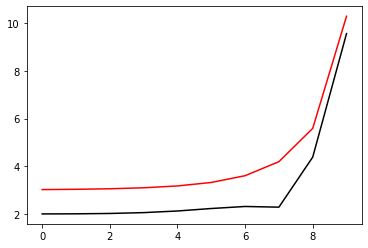

8900 99.00287271060317 9.275222165488195
[1.99344287 1.99768291 2.01234833 2.0474885  2.11590095 2.21952168
 2.30510152 2.27757703 4.37785803 9.56854007]


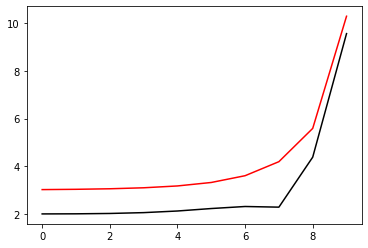

9000 99.00286946255703 9.27447359168803
[1.99368731 1.99789726 2.01247084 2.04741472 2.115505   2.21880348
 2.30448357 2.27834912 4.37704397 9.56804175]


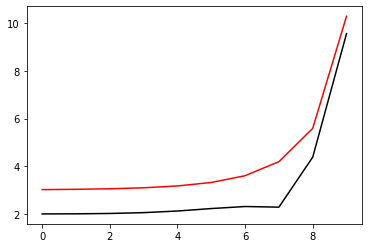

9100 99.00286623499045 9.27372690931562
[1.99392996 1.99811008 2.01259258 2.04734163 2.11511174 2.21808877
 2.30386802 2.27911908 4.37623146 9.5675434 ]


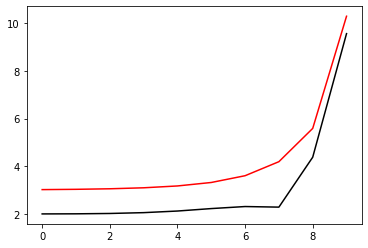

9200 99.00286302772308 9.272982107293467
[1.99417086 1.99832139 2.01271354 2.04726921 2.11472114 2.21737752
 2.30325488 2.27988691 4.37542048 9.56704502]


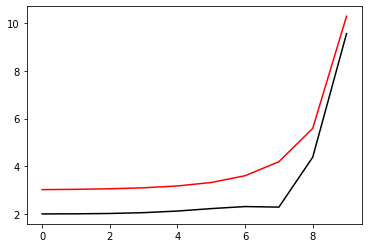

9300 99.00285984057663 9.272239174643866
[1.99441002 1.9985312  2.01283372 2.04719747 2.11433318 2.21666972
 2.30264414 2.28065262 4.37461103 9.56654661]


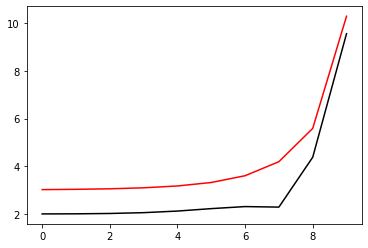

9400 99.00285667337467 9.27149810048769
[1.99464744 1.99873953 2.01295314 2.04712638 2.11394782 2.21596535
 2.30203579 2.28141621 4.3738031  9.56604817]


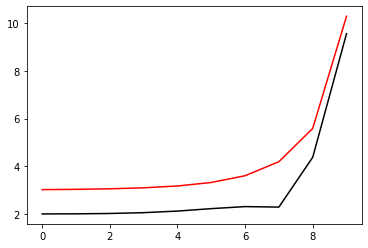

9500 99.0028535259427 9.27075887404315
[1.99488314 1.99894639 2.0130718  2.04705594 2.11356505 2.21526441
 2.30142982 2.28217768 4.37299669 9.5655497 ]


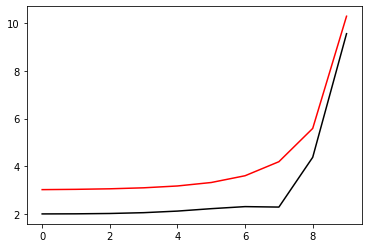

9600 99.00285039810814 9.270021484624678
[1.99511715 1.99915179 2.0131897  2.04698614 2.11318484 2.21456688
 2.30082623 2.28293703 4.37219179 9.5650512 ]


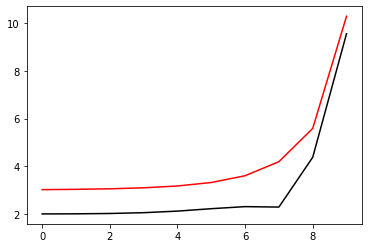

9700 99.0028472897002 9.269285921641753
[1.99534947 1.99935573 2.01330685 2.04691698 2.11280717 2.21387275
 2.30022501 2.28369428 4.3713884  9.56455267]


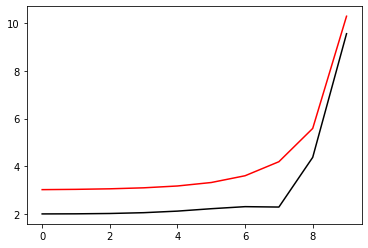

9800 99.00284420054996 9.268552174597776
[1.99558011 1.99955824 2.01342324 2.04684843 2.112432   2.21318199
 2.29962615 2.28444943 4.3705865  9.56405411]


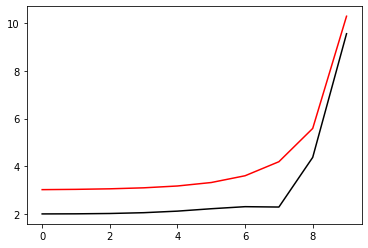

9900 99.00284113049031 9.267820233088925
[1.9958091  1.99975932 2.01353889 2.04678049 2.11205933 2.2124946
 2.29902965 2.28520247 4.3697861  9.56355552]


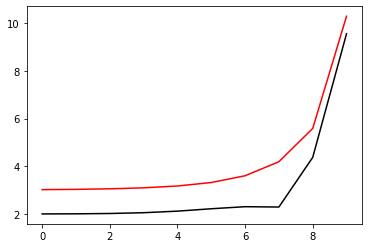

10000 99.00283807935591 9.267090086803055
[1.99603644 1.99995898 2.0136538  2.04671316 2.11168913 2.21181057
 2.29843551 2.28595342 4.36898718 9.5630569 ]


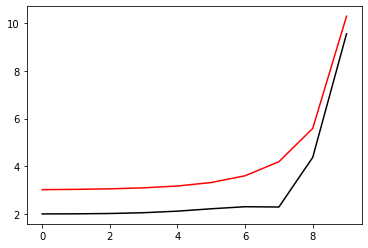

In [62]:
optimizer=tf.optimizers.SGD(learning_rate=0.01)
for i in range (1, 10001):
    run()
    if i%100==0: print(i, Error_func(h, m2_2).numpy(), m2_2.numpy()), print(h.numpy()), plt.plot(h_real, 'r-'), plt.plot(h.numpy(), 'k-'), plt.show()

100 99.00283504698314 9.266361725518633
[1.99626214 2.00015724 2.01376797 2.04664642 2.11132136 2.21112988
 2.2978437  2.28670228 4.36818975 9.56255826]


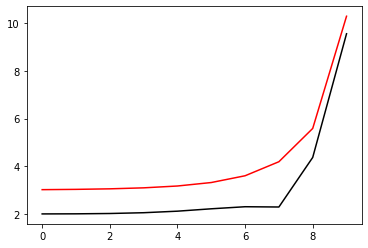

200 99.00283203321018 9.265635139103665
[1.99648623 2.00035411 2.01388141 2.04658026 2.11095602 2.21045251
 2.29725423 2.28744905 4.36739379 9.56205959]


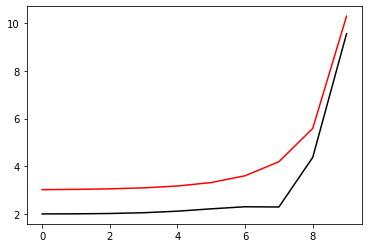

300 99.00282903787686 9.264910317514603
[1.99670872 2.00054959 2.01399411 2.04651468 2.11059308 2.20977845
 2.2966671  2.28819374 4.36659929 9.56156088]


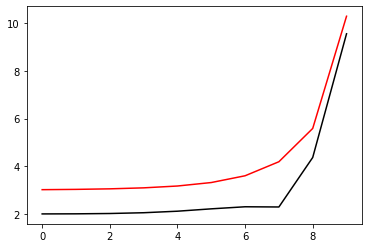

400 99.00282606082475 9.264187250795358
[1.99692961 2.0007437  2.0141061  2.04644967 2.11023251 2.20910769
 2.29608229 2.28893635 4.36580626 9.56106215]


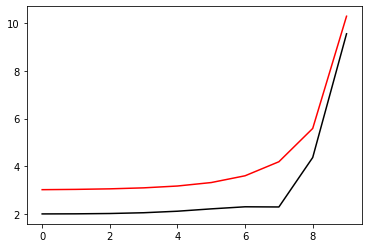

500 99.00282310189696 9.263465929076236
[1.99714892 2.00093645 2.01421736 2.04638521 2.10987429 2.20844022
 2.29549979 2.28967689 4.36501469 9.5605634 ]


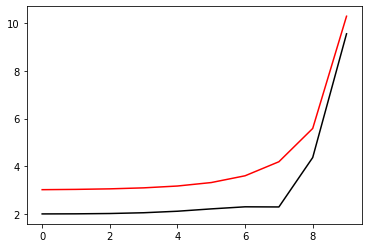

600 99.00282016093843 9.262746342572939
[1.99736667 2.00112785 2.0143279  2.04632131 2.10951841 2.20777601
 2.29491961 2.29041536 4.36422457 9.56006461]


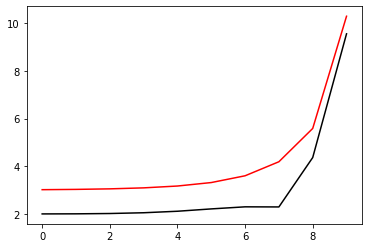

700 99.00281723779551 9.262028481585581
[1.99758286 2.00131791 2.01443773 2.04625795 2.10916485 2.20711506
 2.29434173 2.29115177 4.3634359  9.55956579]


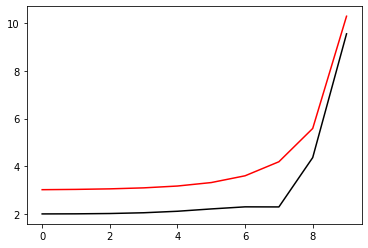

800 99.0028143323163 9.261312336497715
[1.99779751 2.00150664 2.01454685 2.04619512 2.10881357 2.20645736
 2.29376616 2.29188611 4.36264867 9.55906695]


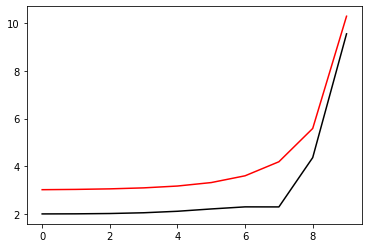

900 99.00281144435044 9.260597897775323
[1.99801063 2.00169405 2.01465527 2.04613283 2.10846456 2.20580288
 2.29319287 2.2926184  4.36186287 9.55856808]


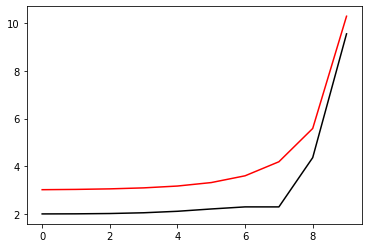

1000 99.00280857374905 9.259885155965927
[1.99822224 2.00188015 2.01476299 2.04607105 2.10811781 2.20515161
 2.29262187 2.29334864 4.3610785  9.55806919]


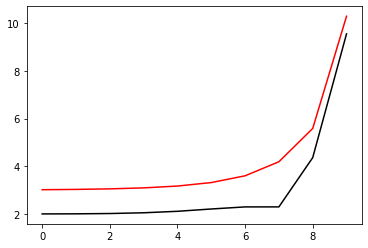

1100 99.00280572036485 9.2591741016976
[1.99843234 2.00206495 2.01487    2.04600978 2.10777328 2.20450355
 2.29205314 2.29407683 4.36029555 9.55757026]


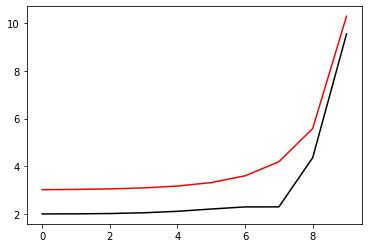

1200 99.00280288405206 9.258464725678063
[1.99864096 2.00224847 2.01497633 2.04594902 2.10743096 2.20385867
 2.29148669 2.29480298 4.35951403 9.55707131]


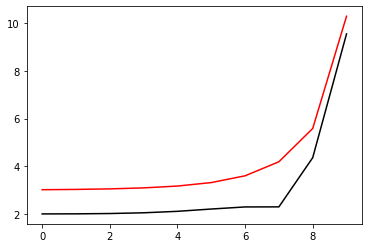

1300 99.00280006466639 9.257757018693802
[1.99884809 2.0024307  2.01508196 2.04588875 2.10709084 2.20321696
 2.29092251 2.29552709 4.35873391 9.55657233]


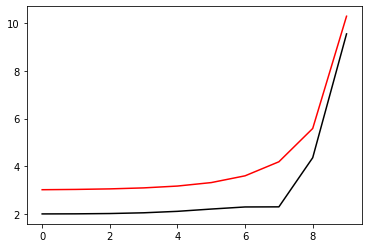

1400 99.00279726206502 9.257050971609091
[1.99905375 2.00261166 2.01518691 2.04582898 2.10675288 2.20257841
 2.29036058 2.29624916 4.3579552  9.55607332]


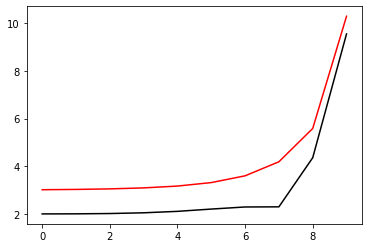

1500 99.00279447610657 9.256346575365203
[1.99925796 2.00279137 2.01529118 2.04576969 2.10641708 2.201943
 2.28980091 2.29696921 4.3571779  9.55557429]


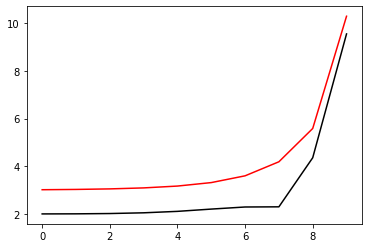

1600 99.00279170665115 9.25564382097947
[1.99946072 2.00296982 2.01539477 2.04571087 2.10608341 2.20131073
 2.28924349 2.29768724 4.35640199 9.55507523]


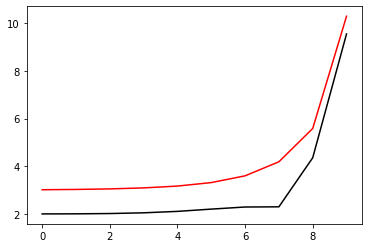

1700 99.00278895356023 9.254942699544438
[1.99966205 2.00314703 2.01549768 2.04565252 2.10575185 2.20068157
 2.2886883  2.29840324 4.35562748 9.55457615]


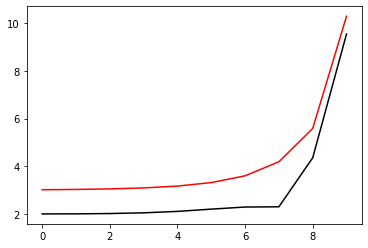

1800 99.00278621669669 9.25424320222706
[1.99986196 2.00332301 2.01559992 2.04559464 2.10542239 2.20005551
 2.28813535 2.29911723 4.35485434 9.55407704]


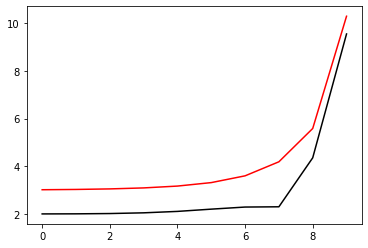

1900 99.00278349592482 9.253545320267788
[2.00006046 2.00349777 2.0157015  2.04553721 2.10509501 2.19943255
 2.28758463 2.29982921 4.3540826  9.5535779 ]


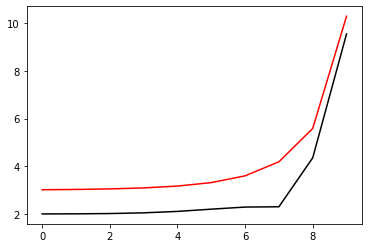

2000 99.00278079111023 9.25284904497981
[2.00025756 2.00367132 2.01580241 2.04548022 2.10476969 2.19881265
 2.28703613 2.30053918 4.35331222 9.55307873]


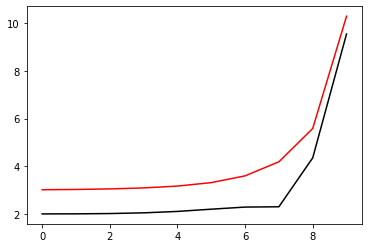

2100 99.0027781021199 9.25215436774822
[2.00045327 2.00384366 2.01590267 2.04542369 2.1044464  2.19819582
 2.28648984 2.30124715 4.35254322 9.55257954]


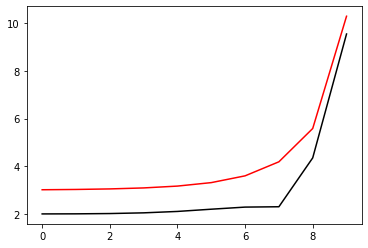

2200 99.00277542882216 9.251461280029202
[2.0006476  2.0040148  2.01600227 2.04536758 2.10412515 2.19758203
 2.28594577 2.30195312 4.35177558 9.55208033]


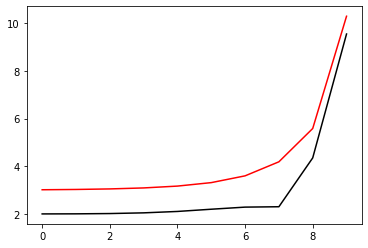

2300 99.00277277108663 9.250769773349266
[2.00084057 2.00418476 2.01610121 2.04531191 2.1038059  2.19697128
 2.2854039  2.3026571  4.3510093  9.55158108]


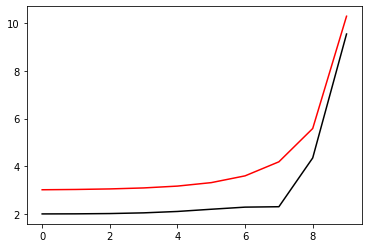

2400 99.00277012878422 9.250079839304428
[2.00103218 2.00435355 2.01619951 2.04525666 2.10348864 2.19636355
 2.28486422 2.30335909 4.35024438 9.55108182]


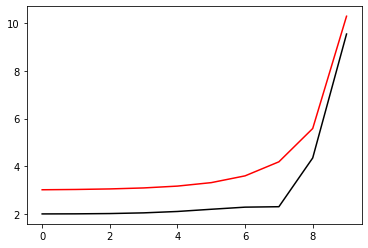

2500 99.00276750178713 9.249391469559505
[2.00122244 2.00452116 2.01629716 2.04520183 2.10317335 2.19575882
 2.28432673 2.3040591  4.34948081 9.55058252]


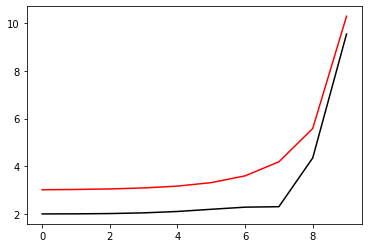

2600 99.00276488996883 9.248704655847293
[2.00141137 2.00468762 2.01639418 2.04514741 2.10286002 2.19515708
 2.28379143 2.30475714 4.34871858 9.5500832 ]


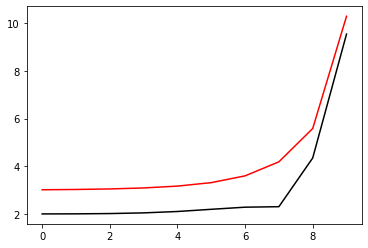

2700 99.00276229320404 9.248019389967869
[2.00159898 2.00485292 2.01649055 2.0450934  2.10254863 2.19455833
 2.28325831 2.30545319 4.3479577  9.54958386]


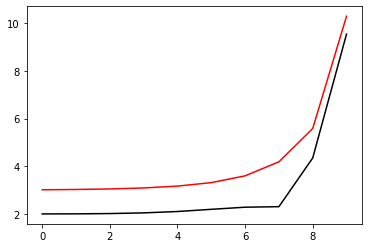

2800 99.0027597113687 9.247335663787824
[2.00178527 2.00501709 2.01658629 2.04503979 2.10223916 2.19396253
 2.28272736 2.30614728 4.34719814 9.54908449]


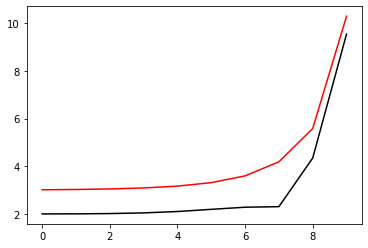

2900 99.00275714433997 9.246653469239556
[2.00197026 2.00518012 2.0166814  2.04498657 2.1019316  2.19336969
 2.28219857 2.3068394  4.34643992 9.5485851 ]


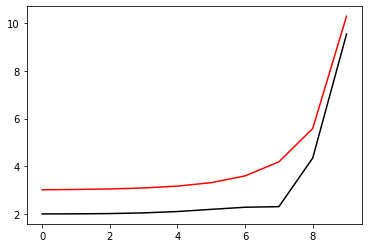

3000 99.00275459199624 9.245972798320535
[2.00215395 2.00534202 2.01677588 2.04493374 2.10162593 2.19277979
 2.28167194 2.30752957 4.34568303 9.54808568]


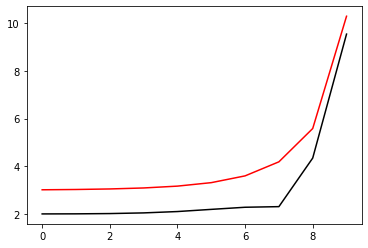

3100 99.00275205421704 9.24529364309263
[2.00233636 2.0055028  2.01686974 2.04488129 2.10132213 2.19219281
 2.28114747 2.30821777 4.34492745 9.54758624]


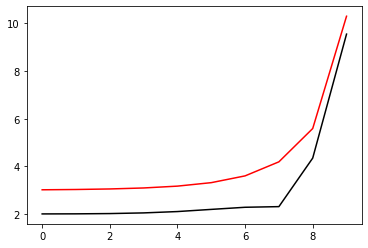

3200 99.00274953088315 9.244615995681372
[2.00251749 2.00566248 2.01696298 2.04482923 2.10102019 2.19160874
 2.28062514 2.30890403 4.34417319 9.54708677]


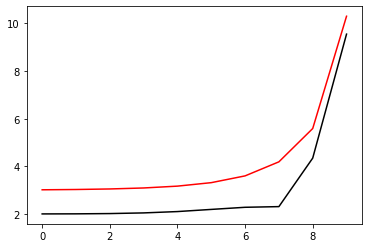

3300 99.00274702187644 9.243939848275307
[2.00269736 2.00582106 2.0170556  2.04477753 2.1007201  2.19102756
 2.28010496 2.30958834 4.34342025 9.54658728]


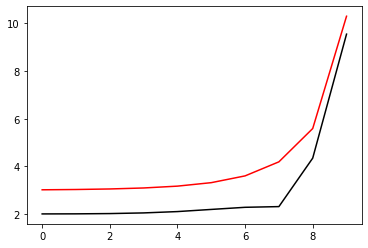

3400 99.00274452707995 9.243265193125266
[2.00287598 2.00597854 2.01714761 2.04472621 2.10042184 2.19044927
 2.27958691 2.31027071 4.34266861 9.54608776]


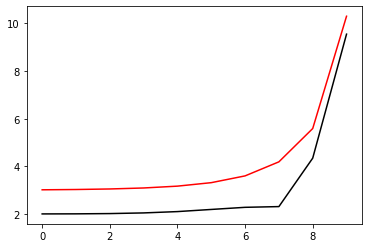

3500 99.00274204637789 9.24259202254374
[2.00305335 2.00613494 2.01723901 2.04467524 2.10012539 2.18987385
 2.27907099 2.31095114 4.34191827 9.54558822]


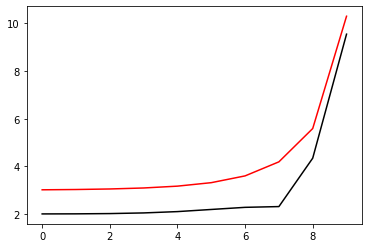

3600 99.00273957965551 9.241920328904223
[2.00322949 2.00629026 2.01732981 2.04462464 2.09983074 2.18930129
 2.27855719 2.31162964 4.34116922 9.54508866]


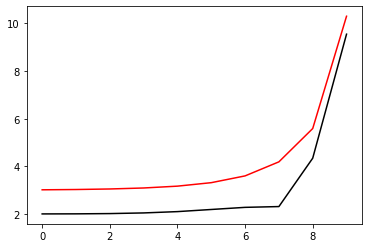

3700 99.00273712679925 9.241250104640526
[2.00340439 2.00644451 2.01742    2.04457439 2.09953787 2.18873157
 2.2780455  2.31230621 4.34042147 9.54458907]


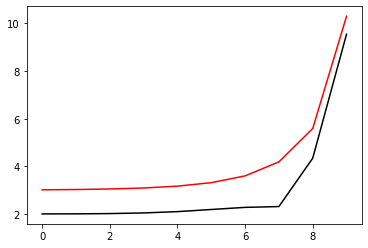

3800 99.00273468769659 9.240581342246172
[2.00357808 2.0065977  2.01750959 2.04452448 2.09924678 2.18816467
 2.27753593 2.31298086 4.33967501 9.54408946]


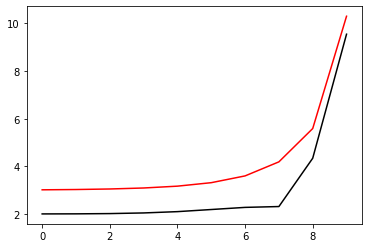

3900 99.00273226223612 9.239914034273715
[2.00375057 2.00674983 2.01759859 2.04447492 2.09895744 2.1876006
 2.27702846 2.31365359 4.33892983 9.54358982]


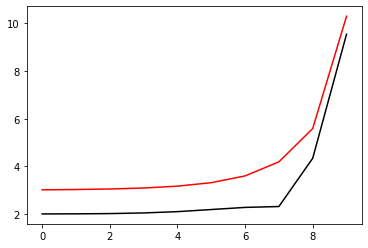

4000 99.00272985030747 9.239248173334172
[2.00392185 2.00690092 2.01768699 2.0444257  2.09866984 2.18703933
 2.27652309 2.31432441 4.33818593 9.54309016]


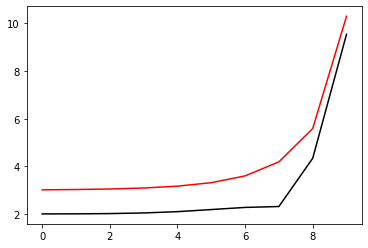

4100 99.00272745180135 9.23858375209637
[2.00409195 2.00705097 2.01777481 2.04437681 2.09838396 2.18648084
 2.27601981 2.31499332 4.3374433  9.54259048]


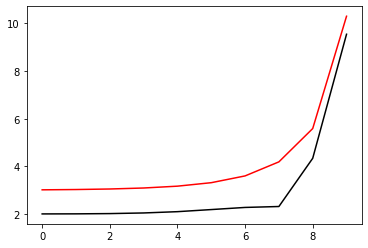

4200 99.00272506660951 9.237920763286358
[2.00426086 2.0072     2.01786203 2.04432824 2.0980998  2.18592514
 2.27551862 2.31566032 4.33670194 9.54209078]


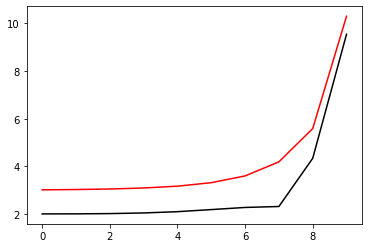

4300 99.00272269462475 9.237259199686772
[2.0044286  2.00734799 2.01794868 2.04428001 2.09781734 2.1853722
 2.27501951 2.31632543 4.33596184 9.54159105]


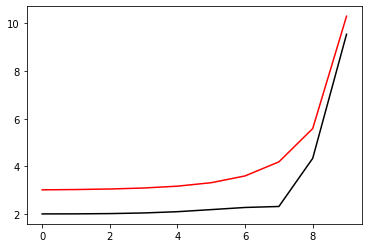

4400 99.0027203357408 9.236599054136287
[2.00459518 2.00749497 2.01803475 2.04423209 2.09753657 2.184822
 2.27452247 2.31698864 4.33522301 9.5410913 ]


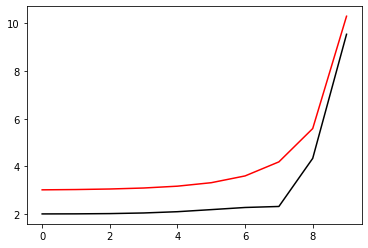

4500 99.00271798985253 9.235940319529004
[2.00476061 2.00764094 2.01812024 2.04418449 2.09725747 2.18427455
 2.2740275  2.31764996 4.33448543 9.54059152]


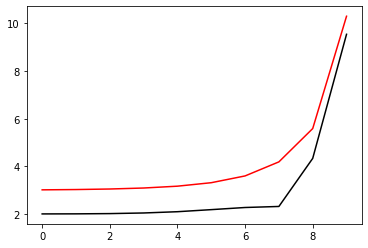

4600 99.00271565685571 9.235282988813891
[2.00492489 2.00778591 2.01820516 2.04413721 2.09698002 2.18372982
 2.2735346  2.31830939 4.33374911 9.54009172]


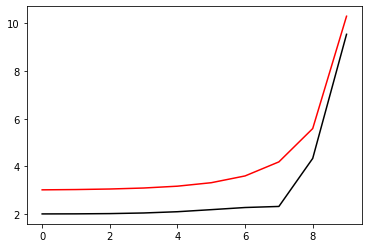

4700 99.00271333664712 9.234627054994178
[2.00508803 2.00792989 2.0182895  2.04409022 2.09670423 2.1831878
 2.27304374 2.31896695 4.33301403 9.5395919 ]


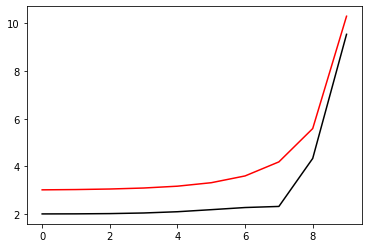

4800 99.00271102912451 9.233972511126845
[2.00525004 2.00807288 2.01837329 2.04404355 2.09643006 2.18264848
 2.27255494 2.31962262 4.33228019 9.53909206]


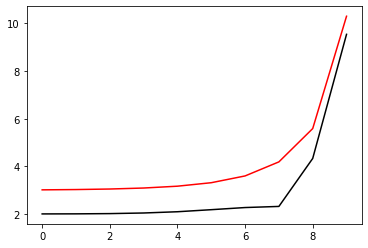

4900 99.00270873418663 9.233319350322036
[2.00541093 2.00821488 2.01845651 2.04399717 2.09615752 2.18211185
 2.27206818 2.32027643 4.33154759 9.5385922 ]


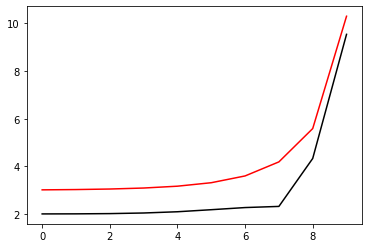

5000 99.00270645173312 9.232667565742517
[2.00557071 2.00835592 2.01853917 2.04395109 2.09588658 2.18157788
 2.27158346 2.32092837 4.33081623 9.53809231]


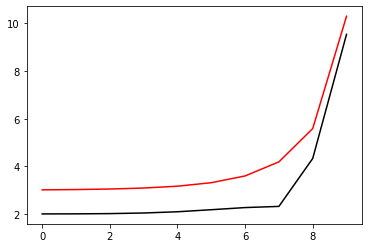

5100 99.0027041816646 9.232017150603124
[2.00572939 2.00849599 2.01862127 2.0439053  2.09561724 2.18104658
 2.27110078 2.32157845 4.33008609 9.5375924 ]


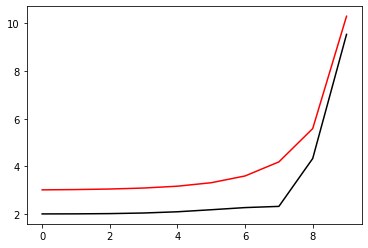

5200 99.00270192388261 9.231368098170272
[2.00588697 2.00863509 2.01870282 2.04385979 2.09534947 2.18051793
 2.27062012 2.32222667 4.32935718 9.53709247]


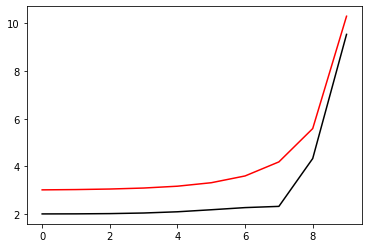

5300 99.00269967828962 9.23072040176137
[2.00604346 2.00877325 2.01878381 2.04381457 2.09508328 2.1799919
 2.27014147 2.32287304 4.32862949 9.53659252]


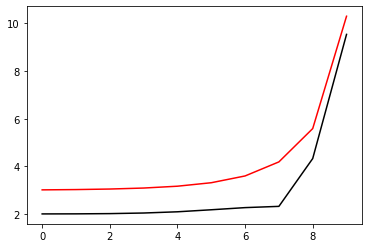

5400 99.00269744478898 9.230074054744351
[2.00619887 2.00891046 2.01886427 2.04376963 2.09481865 2.17946851
 2.26966485 2.32351756 4.32790302 9.53609254]


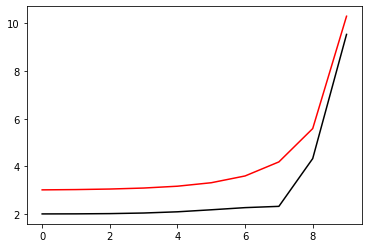

5500 99.00269522328497 9.229429050537128
[2.00635321 2.00904672 2.01894417 2.04372497 2.09455556 2.17894771
 2.26919023 2.32416023 4.32717776 9.53559254]


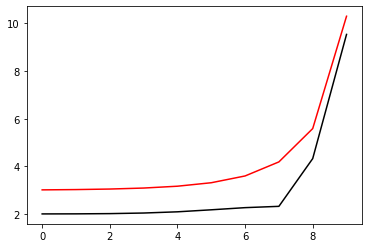

5600 99.00269301368276 9.228785382607082
[2.00650649 2.00918206 2.01902354 2.04368057 2.09429401 2.17842952
 2.26871761 2.32480107 4.32645371 9.53509252]


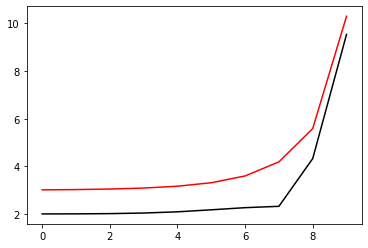

5700 99.00269081588836 9.228143044470615
[2.00665871 2.00931647 2.01910237 2.04363645 2.09403398 2.17791391
 2.26824699 2.32544008 4.32573087 9.53459248]


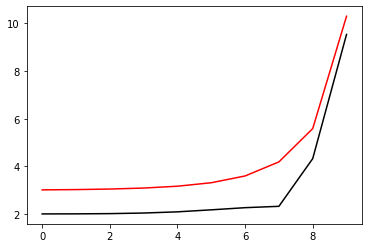

5800 99.00268862980867 9.227502029692602
[2.00680988 2.00944996 2.01918066 2.04359259 2.09377546 2.17740087
 2.26777836 2.32607725 4.32500922 9.53409242]


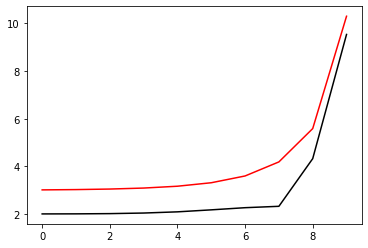

5900 99.0026864553515 9.22686233188591
[2.00696001 2.00958253 2.01925842 2.043549   2.09351843 2.17689039
 2.26731172 2.3267126  4.32428877 9.53359234]


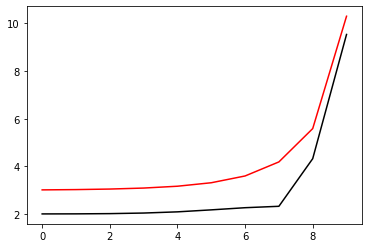

6000 99.0026842924254 9.226223944710927
[2.00710911 2.0097142  2.01933565 2.04350566 2.0932629  2.17638246
 2.26684705 2.32734614 4.32356952 9.53309224]


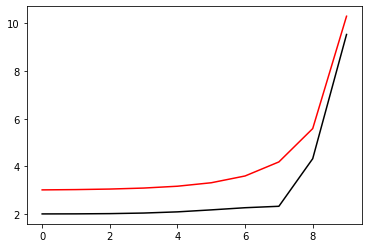

6100 99.00268214093988 9.22558686187511
[2.00725718 2.00984497 2.01941236 2.04346258 2.09300884 2.17587706
 2.26638436 2.32797785 4.32285145 9.53259211]


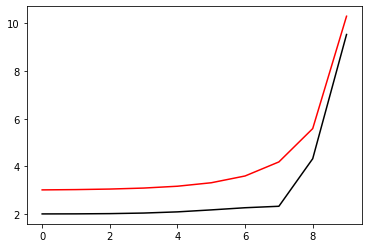

6200 99.00268000080521 9.224951077132488
[2.00740423 2.00997484 2.01948854 2.04341975 2.09275625 2.17537418
 2.26592363 2.32860776 4.32213456 9.53209197]


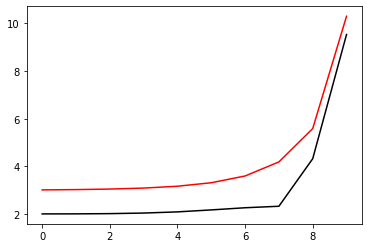

6300 99.0026778719325 9.224316584283171
[2.00755027 2.01010383 2.01956421 2.04337717 2.09250511 2.17487382
 2.26546486 2.32923586 4.32141886 9.5315918 ]


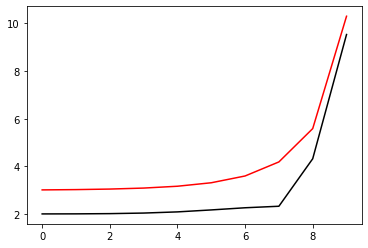

6400 99.00267575423366 9.223683377172977
[2.0076953  2.01023193 2.01963936 2.04333484 2.09225541 2.17437595
 2.26500805 2.32986216 4.32070433 9.53109161]


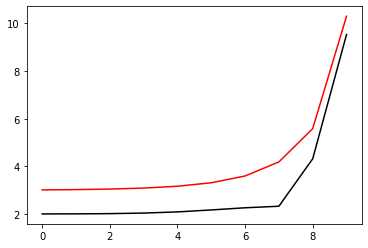

6500 99.00267364762146 9.22305144969289
[2.00783934 2.01035916 2.01971399 2.04329275 2.09200714 2.17388056
 2.26455319 2.33048666 4.31999097 9.53059141]


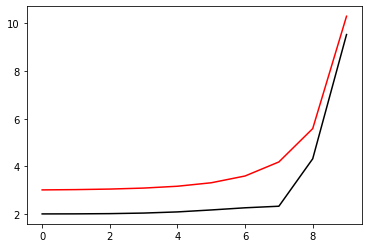

6600 99.00267155200939 9.222420795778678
[2.00798239 2.01048552 2.01978811 2.04325089 2.0917603  2.17338765
 2.26410028 2.33110938 4.31927878 9.53009118]


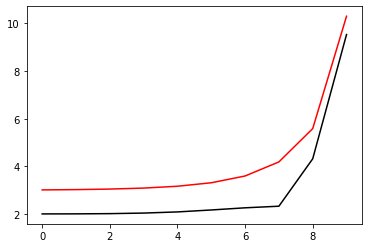

6700 99.00266946731178 9.221791409410422
[2.00812446 2.01061101 2.01986173 2.04320928 2.09151487 2.1728972
 2.2636493  2.3317303  4.31856776 9.52959093]


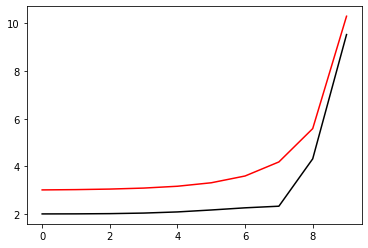

6800 99.00266739344369 9.221163284612057
[2.00826555 2.01073565 2.01993484 2.04316789 2.09127083 2.1724092
 2.26320025 2.33234945 4.3178579  9.52909066]


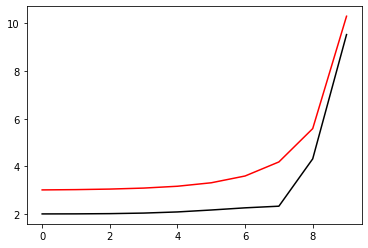

6900 99.00266533032102 9.220536415451004
[2.00840567 2.01085943 2.02000744 2.04312674 2.09102819 2.17192364
 2.26275313 2.33296681 4.31714919 9.52859037]


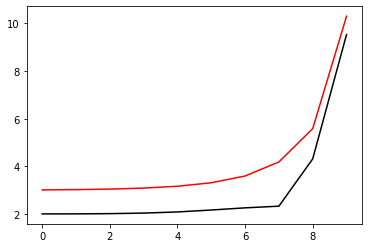

7000 99.00266327786038 9.21991079603771
[2.00854483 2.01098237 2.02007955 2.04308582 2.09078693 2.1714405
 2.26230793 2.33358241 4.31644163 9.52809007]


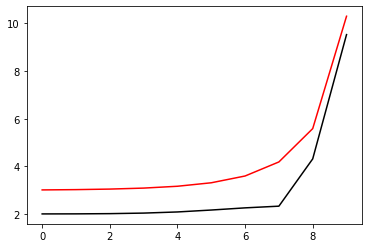

7100 99.00266123597913 9.219286420525211
[2.00868304 2.01110446 2.02015116 2.04304512 2.09054703 2.17095977
 2.26186464 2.33419623 4.31573523 9.52758974]


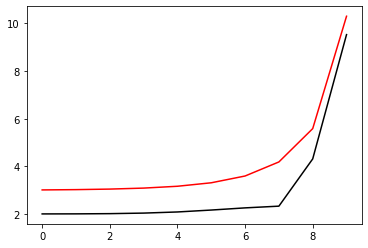

7200 99.00265920459545 9.218663283108771
[2.0088203  2.01122572 2.02022228 2.04300464 2.0903085  2.17048145
 2.26142326 2.33480829 4.31502997 9.52708939]


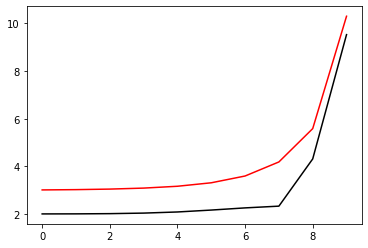

7300 99.00265718362814 9.218041378025408
[2.00895661 2.01134616 2.02029291 2.04296438 2.09007131 2.17000552
 2.26098379 2.3354186  4.31432585 9.52658902]


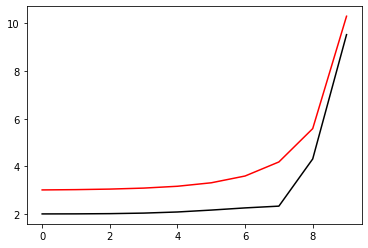

7400 99.00265517299682 9.217420699553553
[2.00909199 2.01146577 2.02036305 2.04292434 2.08983547 2.16953196
 2.26054621 2.33602714 4.31362286 9.52608864]


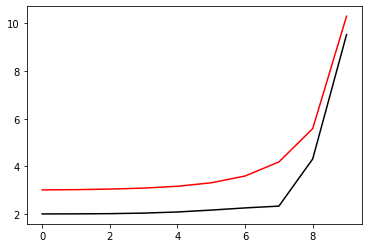

7500 99.00265317262183 9.216801242012615
[2.00922645 2.01158456 2.0204327  2.04288451 2.08960095 2.16906077
 2.26011052 2.33663394 4.31292102 9.52558823]


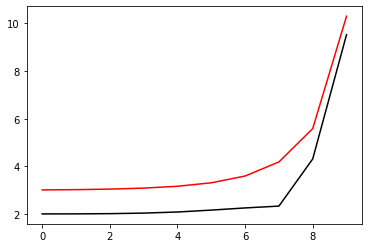

7600 99.00265118242417 9.216182999762568
[2.00935998 2.01170254 2.02050187 2.04284489 2.08936776 2.16859194
 2.25967672 2.337239   4.3122203  9.5250878 ]


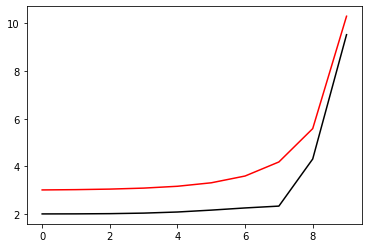

7700 99.00264920232561 9.215565967203595
[2.0094926  2.01181972 2.02057056 2.04280548 2.08913587 2.16812544
 2.2592448  2.33784231 4.31152071 9.52458736]


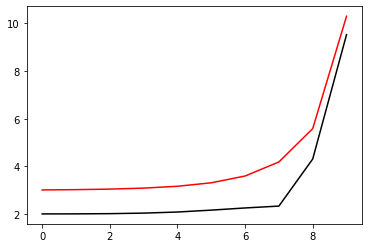

7800 99.00264723224858 9.214950138775714
[2.0096243  2.01193609 2.02063878 2.04276628 2.08890529 2.16766128
 2.25881475 2.33844389 4.31082224 9.5240869 ]


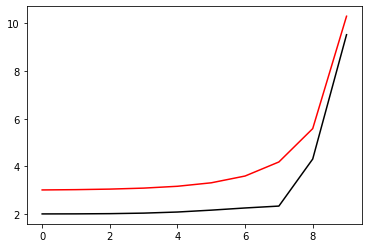

7900 99.00264527211617 9.214335508958369
[2.00975511 2.01205167 2.02070652 2.04272728 2.088676   2.16719945
 2.25838657 2.33904374 4.31012488 9.52358641]


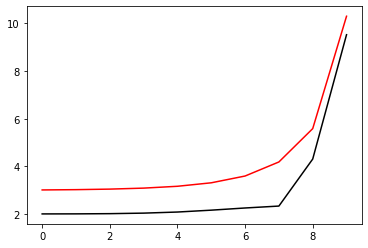

8000 99.00264332185225 9.213722072270054
[2.00988502 2.01216645 2.02077379 2.04268848 2.08844799 2.16673991
 2.25796025 2.33964186 4.30942865 9.52308591]


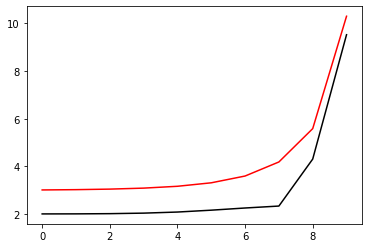

8100 99.00264138138131 9.213109823267958
[2.01001404 2.01228046 2.02084059 2.04264988 2.08822125 2.16628268
 2.25753579 2.34023827 4.30873353 9.52258539]


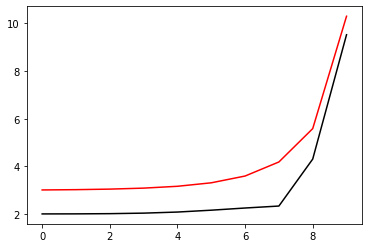

8200 99.0026394506285 9.21249875654759
[2.01014217 2.01239368 2.02090693 2.04261148 2.08799578 2.16582773
 2.25711318 2.34083295 4.30803951 9.52208485]


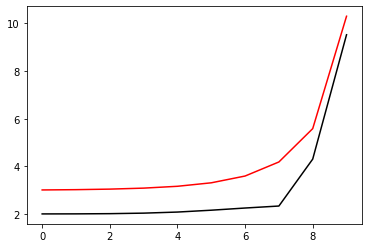

8300 99.00263752951966 9.211888866742411
[2.01026943 2.01250613 2.0209728  2.04257327 2.08777157 2.16537506
 2.25669242 2.34142592 4.3073466  9.5215843 ]


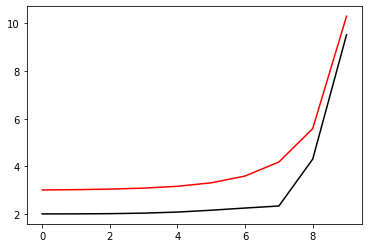

8400 99.00263561798128 9.211280148523517
[2.01039582 2.01261781 2.02103821 2.04253525 2.0875486  2.16492465
 2.2562735  2.34201719 4.30665479 9.52108372]


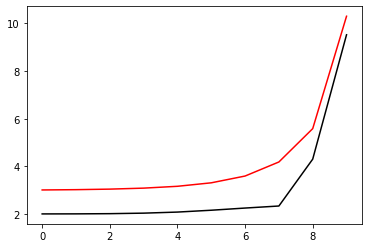

8500 99.0026337159405 9.210672596599217
[2.01052134 2.01272873 2.02110317 2.04249743 2.08732686 2.1644765
 2.25585641 2.34260675 4.30596407 9.52058313]


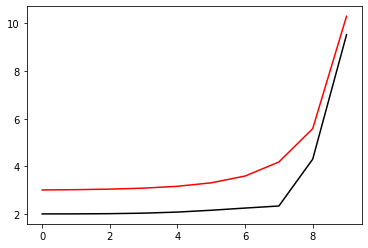

8600 99.00263182332512 9.210066205714726
[2.01064601 2.01283888 2.02116767 2.04245979 2.08710636 2.16403058
 2.25544115 2.34319461 4.30527445 9.52008251]


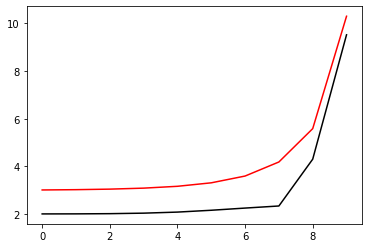

8700 99.00262994006356 9.20946097065183
[2.01076982 2.01294829 2.02123171 2.04242233 2.08688708 2.1635869
 2.25502771 2.34378078 4.30458593 9.51958188]


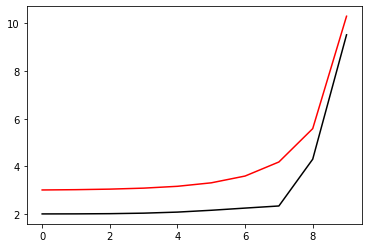

8800 99.00262806608485 9.208856886228501
[2.01089278 2.01305694 2.02129531 2.04238506 2.086669   2.16314543
 2.25461609 2.34436526 4.30389848 9.51908123]


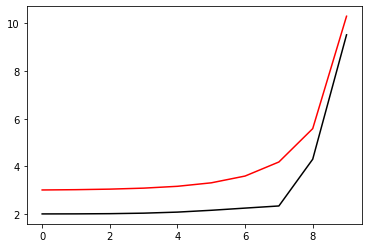

8900 99.00262620131868 9.20825394729861
[2.0110149  2.01316486 2.02135846 2.04234797 2.08645214 2.16270617
 2.25420628 2.34494806 4.30321212 9.51858057]


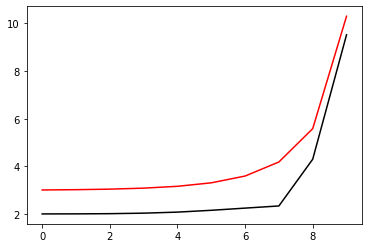

9000 99.00262434569537 9.207652148751555
[2.01113618 2.01327203 2.02142117 2.04231106 2.08623646 2.16226911
 2.25379827 2.34552917 4.30252684 9.51807988]


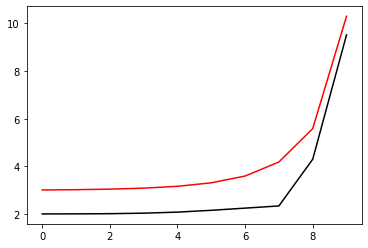

9100 99.00262249914579 9.20705148551194
[2.01125664 2.01337847 2.02148343 2.04227432 2.08602197 2.16183424
 2.25339207 2.34610861 4.30184264 9.51757918]


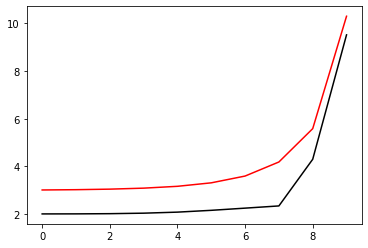

9200 99.00262066160148 9.206451952539268
[2.01137627 2.01348418 2.02154526 2.04223776 2.08580866 2.16140154
 2.25298766 2.34668639 4.30115951 9.51707846]


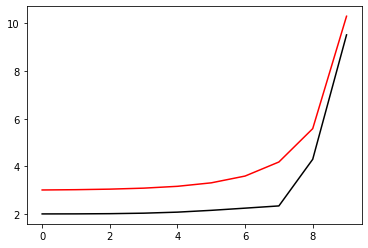

9300 99.00261883299454 9.205853544827603
[2.01149508 2.01358917 2.02160664 2.04220137 2.08559652 2.16097101
 2.25258504 2.34726249 4.30047745 9.51657773]


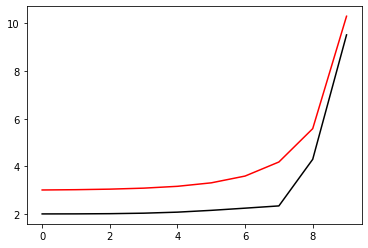

9400 99.00261701325769 9.205256257405262
[2.01161308 2.01369344 2.0216676  2.04216515 2.08538555 2.16054263
 2.2521842  2.34783693 4.29979646 9.51607697]


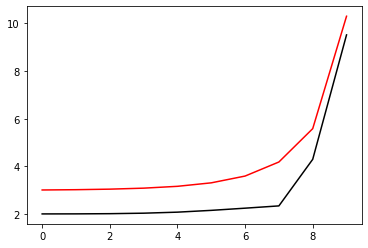

9500 99.00261520232422 9.204660085334485
[2.01173027 2.013797   2.02172812 2.0421291  2.08517572 2.1601164
 2.25178514 2.34840972 4.29911653 9.5155762 ]


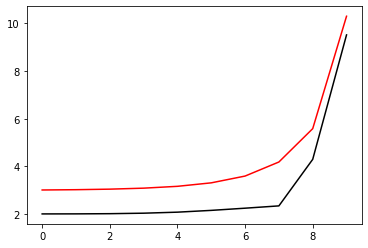

9600 99.00261340012798 9.204065023711129
[2.01184666 2.01389984 2.02178821 2.04209322 2.08496704 2.15969229
 2.25138785 2.34898085 4.29843766 9.51507541]


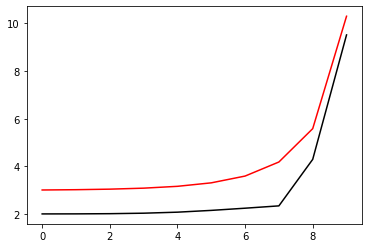

9700 99.00261160660348 9.203471067664376
[2.01196225 2.01400199 2.02184787 2.04205751 2.08475951 2.15927032
 2.25099233 2.34955034 4.29775984 9.51457461]


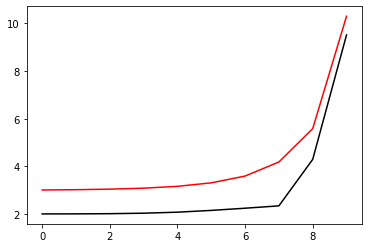

9800 99.00260982168567 9.202878212356426
[2.01207706 2.01410343 2.02190712 2.04202195 2.0845531  2.15885045
 2.25059857 2.35011818 4.29708308 9.51407378]


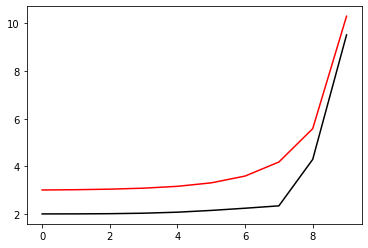

9900 99.00260804531018 9.202286452982172
[2.01219107 2.01420417 2.02196593 2.04198656 2.08434781 2.15843268
 2.25020656 2.35068438 4.29640736 9.51357294]


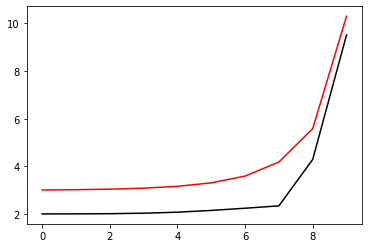

10000 99.00260627741314 9.201695784768914
[2.01230431 2.01430423 2.02202433 2.04195133 2.08414364 2.15801701
 2.24981631 2.35124895 4.2957327  9.51307209]


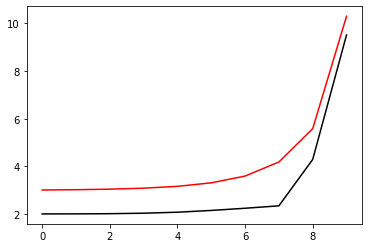

In [63]:
optimizer=tf.optimizers.SGD(learning_rate=0.01)
for i in range (1, 10001):
    run()
    if i%100==0: print(i, Error_func(h, m2_2).numpy(), m2_2.numpy()), print(h.numpy()), plt.plot(h_real, 'r-'), plt.plot(h.numpy(), 'k-'), plt.show()

100 99.00260451793126 9.201106202976096
[2.01241677 2.0144036  2.02208232 2.04191625 2.08394057 2.15760341
 2.24942779 2.35181189 4.29505907 9.51257121]


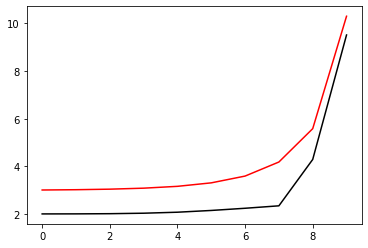

200 99.00260276680174 9.200517702894992
[2.01252846 2.01450229 2.02213989 2.04188134 2.08373861 2.15719189
 2.24904102 2.35237321 4.29438649 9.51207032]


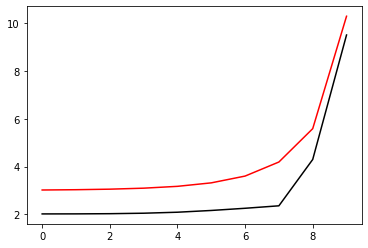

300 99.00260102396244 9.199930279848397
[2.01263939 2.0146003  2.02219704 2.04184657 2.08353774 2.15678243
 2.24865598 2.3529329  4.29371494 9.51156942]


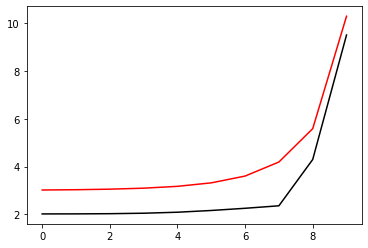

400 99.00259928935164 9.199343929190377
[2.01274956 2.01469764 2.02225379 2.04181196 2.08333795 2.15637501
 2.24827267 2.35349098 4.29304443 9.5110685 ]


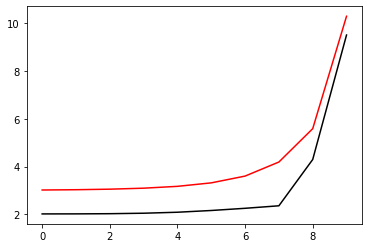

500 99.00259756290818 9.19875864630599
[2.01285897 2.01479431 2.02231013 2.0417775  2.08313924 2.15596964
 2.24789108 2.35404745 4.29237494 9.51056756]


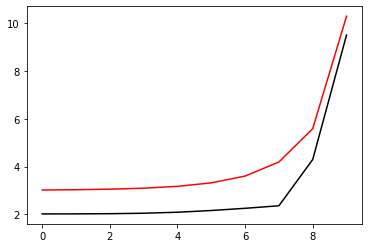

600 99.00259584457146 9.198174426610985
[2.01296763 2.01489032 2.02236607 2.04174319 2.0829416  2.15556629
 2.2475112  2.35460231 4.29170649 9.5100666 ]


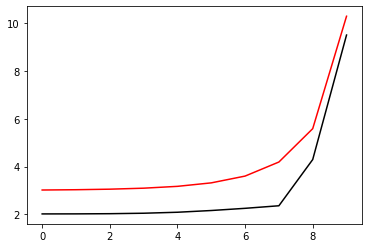

700 99.00259413428137 9.197591265551532
[2.01307555 2.01498566 2.0224216  2.04170903 2.08274503 2.15516497
 2.24713304 2.35515557 4.29103905 9.50956563]


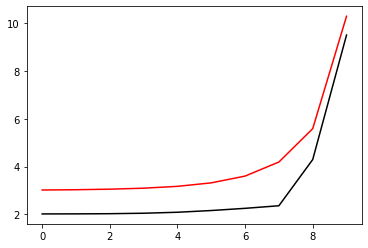

800 99.00259243197834 9.197009158603974
[2.01318274 2.01508036 2.02247673 2.04167502 2.08254951 2.15476565
 2.24675658 2.35570723 4.29037264 9.50906465]


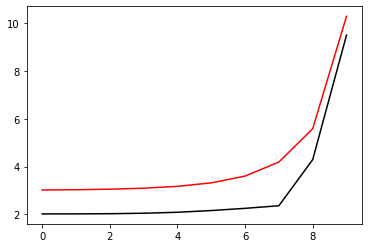

900 99.00259073760328 9.196428101274531
[2.01328918 2.0151744  2.02253147 2.04164115 2.08235504 2.15436834
 2.24638183 2.35625729 4.28970725 9.50856365]


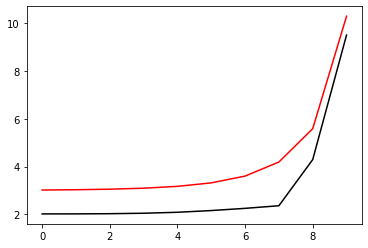

1000 99.00258905109766 9.19584808909906
[2.0133949  2.01526779 2.02258581 2.04160742 2.08216162 2.15397301
 2.24600876 2.35680577 4.28904287 9.50806263]


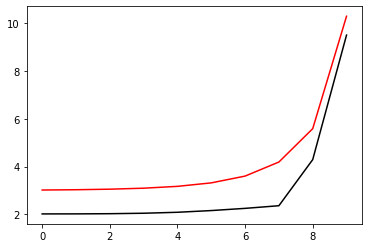

1100 99.00258737240337 9.195269117642802
[2.01349989 2.01536055 2.02263976 2.04157383 2.08196923 2.15357967
 2.24563739 2.35735266 4.2883795  9.50756159]


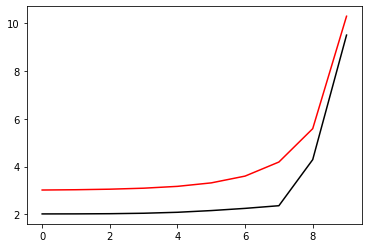

1200 99.00258570146285 9.194691182500058
[2.01360417 2.01545266 2.02269332 2.04154039 2.08177786 2.15318829
 2.2452677  2.35789798 4.28771713 9.50706054]


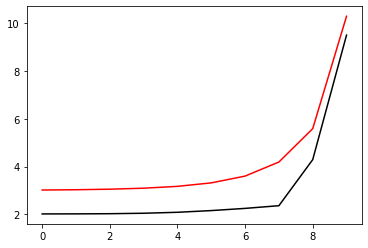

1300 99.00258403821904 9.194114279294004
[2.01370773 2.01554414 2.02274648 2.04150709 2.08158753 2.15279888
 2.24489969 2.35844171 4.28705578 9.50655948]


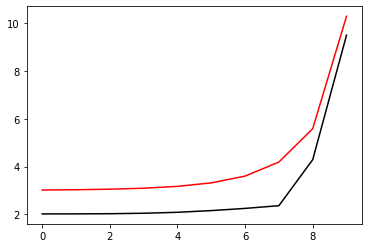

1400 99.00258238261534 9.193538403676403
[2.01381058 2.015635   2.02279927 2.04147392 2.0813982  2.15241141
 2.24453335 2.35898388 4.28639542 9.5060584 ]


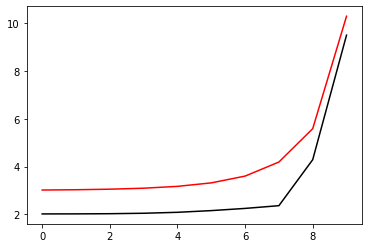

1500 99.00258073459564 9.192963551327347
[2.01391272 2.01572522 2.02285167 2.04144089 2.08120989 2.15202589
 2.24416867 2.35952448 4.28573607 9.5055573 ]


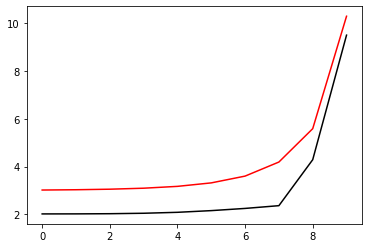

1600 99.00257909410428 9.192389717955056
[2.01401417 2.01581483 2.02290369 2.04140799 2.08102257 2.15164229
 2.24380566 2.36006352 4.28507771 9.50505619]


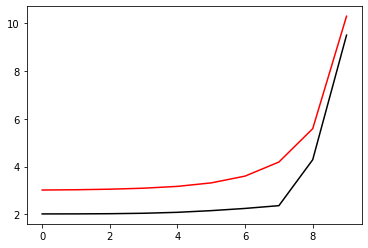

1700 99.00257746108613 9.191816899295581
[2.01411491 2.01590381 2.02295532 2.04137523 2.08083626 2.15126062
 2.24344431 2.360601   4.28442034 9.50455507]


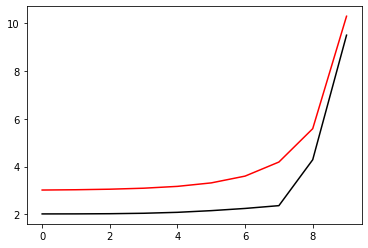

1800 99.00257583548647 9.191245091112602
[2.01421497 2.01599219 2.02300659 2.0413426  2.08065093 2.15088086
 2.24308461 2.36113692 4.28376397 9.50405393]


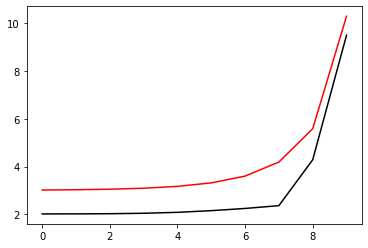

1900 99.0025742172511 9.190674289197137
[2.01431434 2.01607995 2.02305747 2.0413101  2.08046658 2.15050301
 2.24272655 2.3616713  4.28310858 9.50355277]


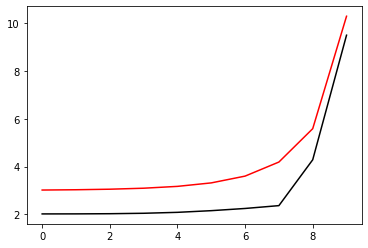

2000 99.00257260632623 9.190104489367366
[2.01441303 2.01616711 2.02310799 2.04127773 2.08028321 2.15012704
 2.24237013 2.36220413 4.28245417 9.5030516 ]


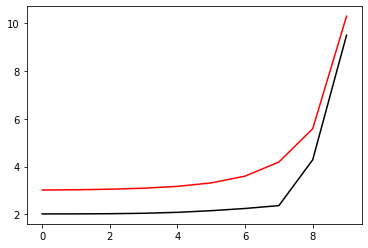

2100 99.00257100265851 9.189535687468346
[2.01451104 2.01625367 2.02315813 2.04124549 2.08010081 2.14975296
 2.24201535 2.36273543 4.28180075 9.50255042]


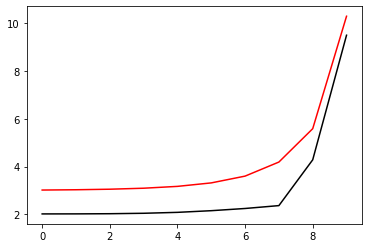

2200 99.00256940619512 9.188967879371821
[2.01460838 2.01633963 2.02320791 2.04121337 2.07991938 2.14938076
 2.2416622  2.36326518 4.2811483  9.50204922]


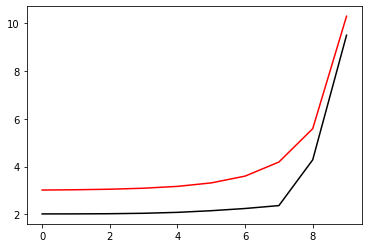

2300 99.00256781688363 9.188401060975961
[2.01470505 2.016425   2.02325732 2.04118139 2.0797389  2.14901042
 2.24131067 2.36379341 4.28049683 9.50154801]


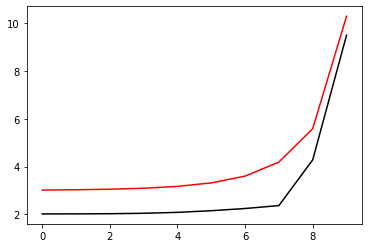

2400 99.00256623467203 9.187835228205136
[2.01480106 2.01650978 2.02330637 2.04114952 2.07955938 2.14864194
 2.24096076 2.36432011 4.27984633 9.50104678]


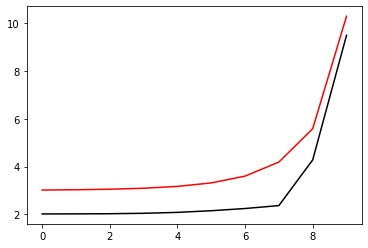

2500 99.0025646595088 9.187270377009721
[2.01489641 2.01659397 2.02335506 2.04111778 2.0793808  2.1482753
 2.24061246 2.36484529 4.2791968  9.50054554]


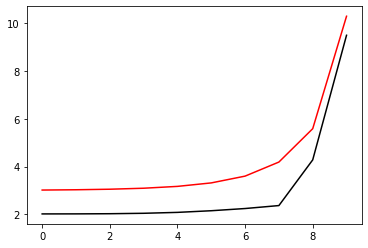

2600 99.00256309134282 9.18670650336583
[2.0149911  2.01667758 2.02340338 2.04108617 2.07920316 2.1479105
 2.24026578 2.36536894 4.27854824 9.50004428]


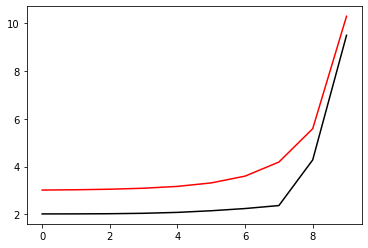

2700 99.00256153012343 9.186143603275145
[2.01508514 2.01676061 2.02345135 2.04105467 2.07902645 2.14754753
 2.23992069 2.36589109 4.27790064 9.49954301]


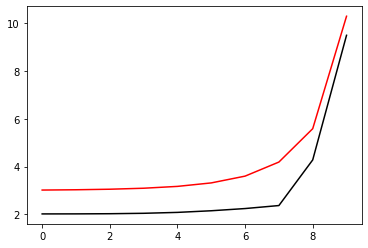

2800 99.00255997580032 9.185581672764647
[2.01517853 2.01684306 2.02349897 2.04102329 2.07885067 2.14718638
 2.2395772  2.36641172 4.277254   9.49904172]


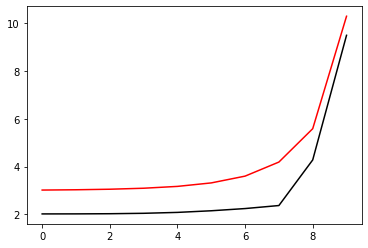

2900 99.00255842832371 9.185020707886471
[2.01527128 2.01692495 2.02354623 2.04099204 2.07867582 2.14682704
 2.23923531 2.36693085 4.27660832 9.49854043]


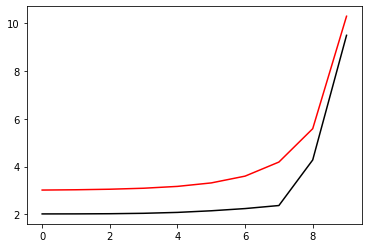

3000 99.00255688764415 9.184460704717608
[2.0153634  2.01700627 2.02359314 2.0409609  2.07850187 2.1464695
 2.238895   2.36744848 4.2759636  9.49803911]


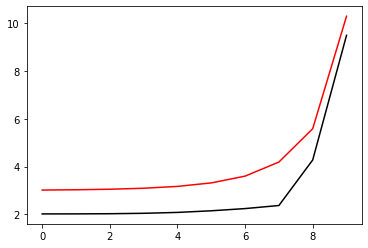

3100 99.00255535371264 9.183901659359748
[2.01545488 2.01708702 2.02363971 2.04092988 2.07832884 2.14611375
 2.23855627 2.36796462 4.27531982 9.49753779]


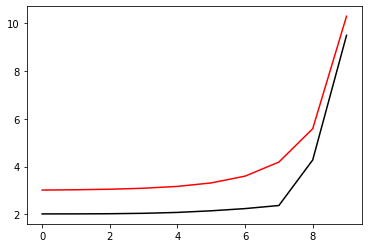

3200 99.00255382648058 9.183343567939062
[2.01554572 2.01716722 2.02368592 2.04089897 2.07815672 2.14575979
 2.23821912 2.36847926 4.274677   9.49703645]


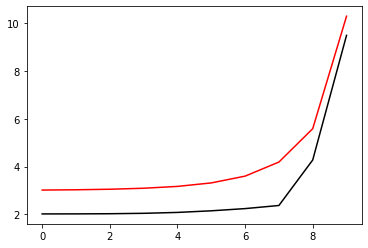

3300 99.00255230589975 9.182786426606025
[2.01563595 2.01724686 2.02373179 2.04086818 2.07798549 2.14540761
 2.23788354 2.36899241 4.27403512 9.49653509]


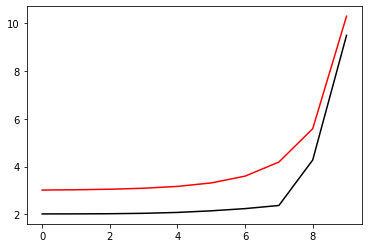

3400 99.00255079192243 9.182230231535128
[2.01572555 2.01732594 2.02377732 2.0408375  2.07781516 2.14505718
 2.23754953 2.36950408 4.27339419 9.49603373]


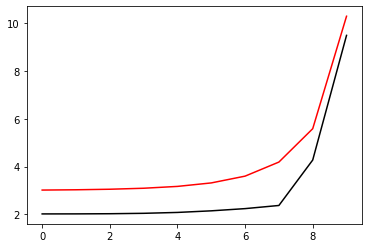

3500 99.00254928450116 9.181674978924754
[2.01581454 2.01740448 2.02382251 2.04080694 2.07764571 2.14470852
 2.23721708 2.37001427 4.2727542  9.49553235]


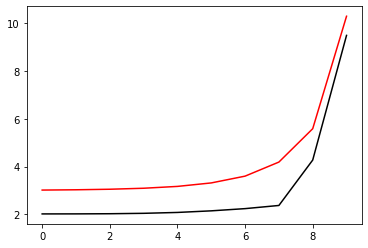

3600 99.00254778358897 9.18112066499698
[2.01590291 2.01748247 2.02386736 2.04077649 2.07747715 2.14436161
 2.23688618 2.37052299 4.27211514 9.49503096]


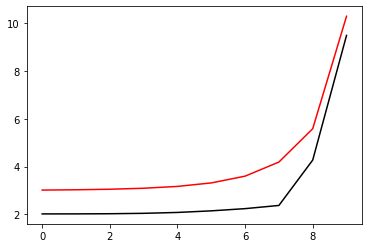

3700 99.00254628913926 9.18056728599731
[2.01599067 2.01755992 2.02391188 2.04074615 2.07730946 2.14401643
 2.23655683 2.37103023 4.27147703 9.49452955]


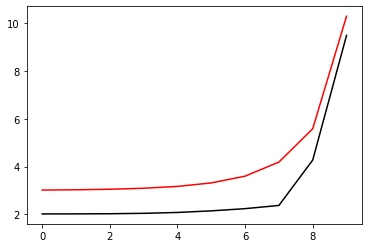

3800 99.00254480110576 9.180014838194545
[2.01607782 2.01763683 2.02395606 2.04071591 2.07714265 2.14367299
 2.23622903 2.37153601 4.27083984 9.49402813]


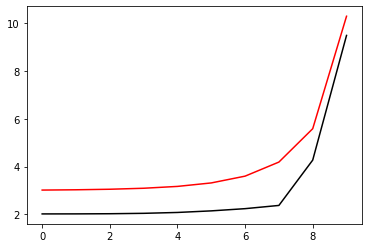

3900 99.00254331944268 9.17946331788058
[2.01616438 2.0177132  2.02399991 2.04068579 2.0769767  2.14333127
 2.23590277 2.37204033 4.27020359 9.4935267 ]


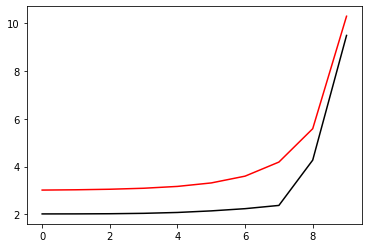

4000 99.00254184410454 9.178912721370187
[2.01625034 2.01778905 2.02404343 2.04065578 2.07681161 2.14299126
 2.23557804 2.37254319 4.26956826 9.49302525]


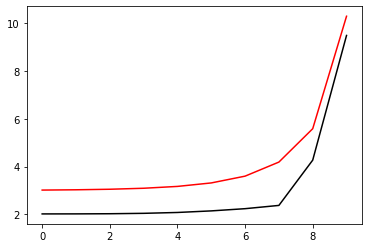

4100 99.00254037504622 9.17836304500083
[2.0163357  2.01786436 2.02408662 2.04062587 2.07664738 2.14265296
 2.23525484 2.37304459 4.26893386 9.49252379]


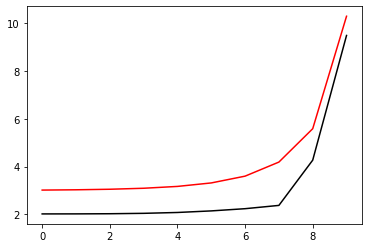

4200 99.00253891222307 9.177814285132513
[2.01642047 2.01793915 2.02412948 2.04059607 2.07648399 2.14231636
 2.23493317 2.37354455 4.26830038 9.49202232]


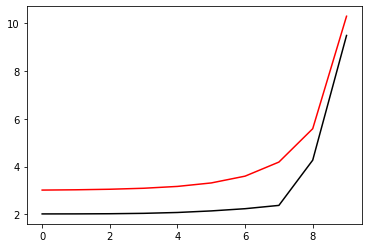

4300 99.00253745559073 9.177266438147555
[2.01650466 2.01801342 2.02417202 2.04056637 2.07632146 2.14198145
 2.23461301 2.37404306 4.26766782 9.49152084]


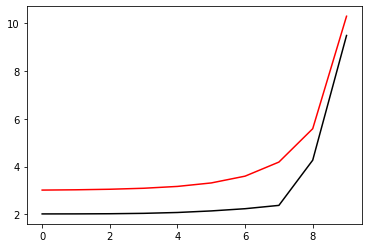

4400 99.00253600510518 9.176719500450409
[2.01658827 2.01808717 2.02421424 2.04053678 2.07615976 2.14164822
 2.23429437 2.37454013 4.26703617 9.49101934]


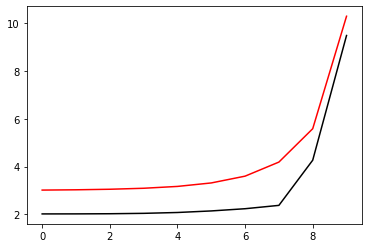

4500 99.00253456072285 9.176173468467503
[2.01667129 2.01816041 2.02425614 2.04050729 2.07599889 2.14131666
 2.23397724 2.37503576 4.26640545 9.49051783]


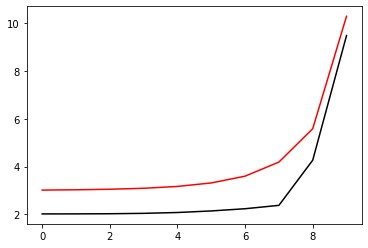

4600 99.00253312240044 9.17562833864705
[2.01675375 2.01823313 2.02429772 2.0404779  2.07583886 2.14098676
 2.23366161 2.37552996 4.26577563 9.49001631]


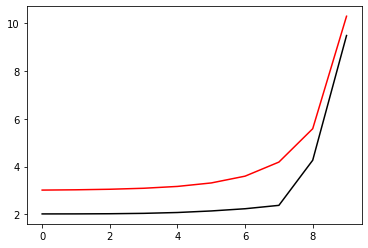

4700 99.00253169009508 9.17508410745887
[2.01683563 2.01830535 2.02433898 2.04044862 2.07567965 2.14065853
 2.23334748 2.37602273 4.26514672 9.48951478]


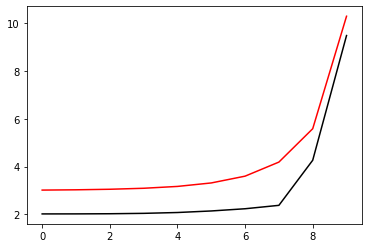

4800 99.00253026376421 9.174540771394208
[2.01691694 2.01837706 2.02437993 2.04041944 2.07552126 2.14033194
 2.23303484 2.37651408 4.26451872 9.48901323]


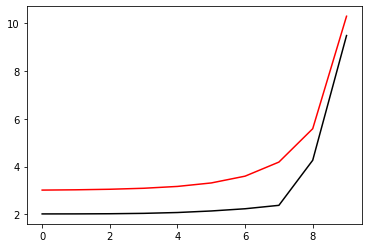

4900 99.00252884336562 9.173998326965565
[2.01699769 2.01844827 2.02442056 2.04039036 2.07536369 2.14000699
 2.23272369 2.37700401 4.26389162 9.48851168]


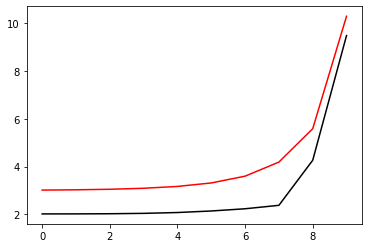

5000 99.00252742885748 9.173456770706528
[2.01707788 2.01851898 2.02446089 2.04036137 2.07520692 2.13968367
 2.23241402 2.37749252 4.26326542 9.48801011]


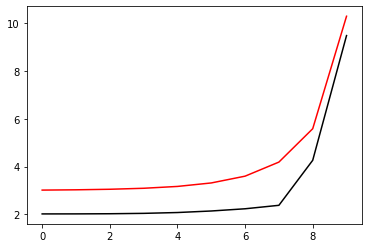

5100 99.00252602019823 9.172916099171585
[2.01715752 2.0185892  2.02450091 2.04033249 2.07505097 2.13936197
 2.23210584 2.37797962 4.26264012 9.48750853]


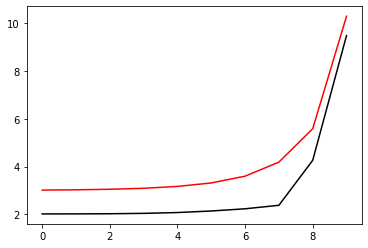

5200 99.00252461734677 9.172376308935986
[2.0172366  2.01865892 2.02454062 2.0403037  2.07489581 2.13904189
 2.23179912 2.37846532 4.26201572 9.48700693]


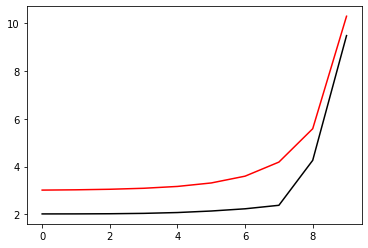

5300 99.00252322026219 9.17183739659553
[2.01731513 2.01872816 2.02458002 2.04027501 2.07474144 2.13872342
 2.23149387 2.37894961 4.26139221 9.48650533]


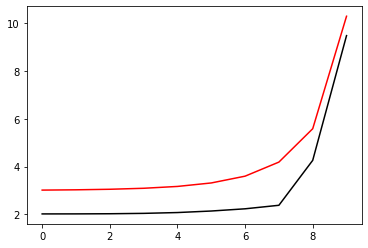

5400 99.00252182890401 9.171299358766463
[2.01739312 2.01879691 2.02461912 2.04024642 2.07458787 2.13840655
 2.23119009 2.3794325  4.2607696  9.48600371]


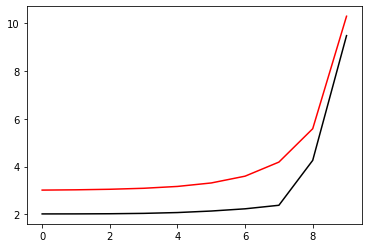

5500 99.00252044323204 9.170762192085247
[2.01747057 2.01886517 2.02465792 2.04021793 2.07443508 2.13809127
 2.23088776 2.37991399 4.26014787 9.48550208]


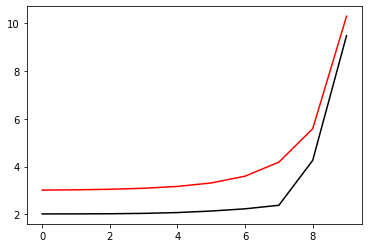

5600 99.00251906320649 9.170225893208439
[2.01754747 2.01893296 2.02469642 2.04018952 2.07428308 2.13777758
 2.23058689 2.3803941  4.25952702 9.48500044]


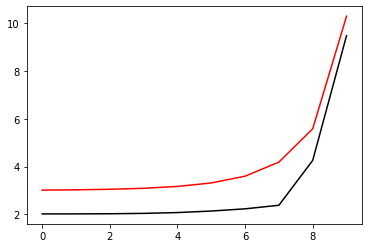

5700 99.00251768878779 9.169690458812523
[2.01762384 2.01900027 2.02473463 2.04016122 2.07413185 2.13746546
 2.23028746 2.38087282 4.25890707 9.48449879]


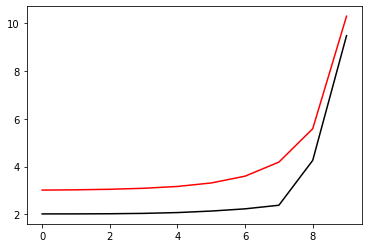

5800 99.00251631993673 9.169155885593735
[2.01769969 2.0190671  2.02477254 2.040133   2.07398139 2.13715491
 2.22998948 2.38135015 4.25828799 9.48399713]


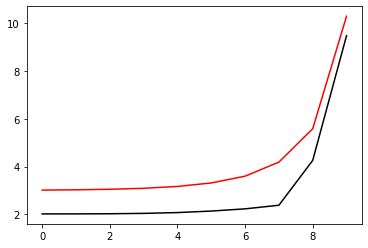

5900 99.00251495661446 9.16862217026793
[2.017775   2.01913347 2.02481015 2.04010488 2.0738317  2.13684592
 2.22969294 2.38182611 4.25766979 9.48349546]


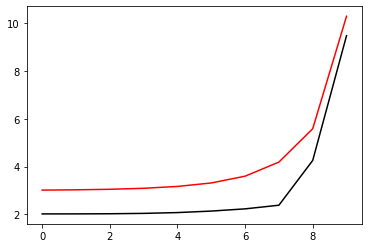

6000 99.00251359878239 9.168089309570412
[2.01784978 2.01919937 2.02484747 2.04007686 2.07368278 2.13653849
 2.22939782 2.38230069 4.25705246 9.48299377]


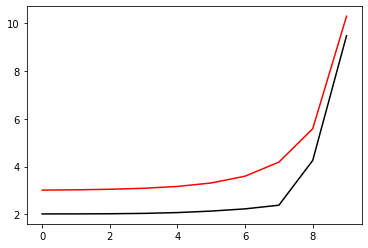

6100 99.00251224640229 9.167557300255774
[2.01792405 2.0192648  2.0248845  2.04004892 2.07353461 2.1362326
 2.22910414 2.38277391 4.25643602 9.48249208]


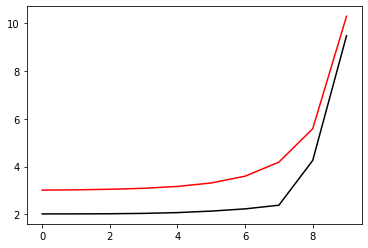

6200 99.00251089943617 9.167026139097763
[2.0179978  2.01932977 2.02492125 2.04002107 2.0733872  2.13592825
 2.22881188 2.38324575 4.25582044 9.48199037]


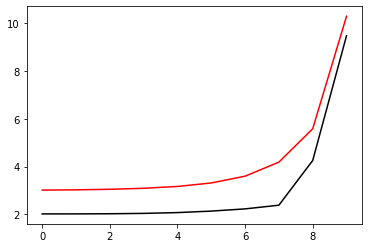

6300 99.00250955784644 9.166495822889118
[2.01807103 2.01939428 2.0249577  2.03999332 2.07324054 2.13562543
 2.22852103 2.38371623 4.25520573 9.48148865]


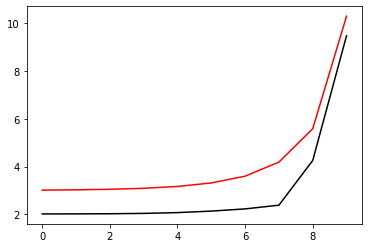

6400 99.00250822159573 9.16596634844141
[2.01814375 2.01945834 2.02499388 2.03996565 2.07309462 2.13532414
 2.2282316  2.38418536 4.25459188 9.48098692]


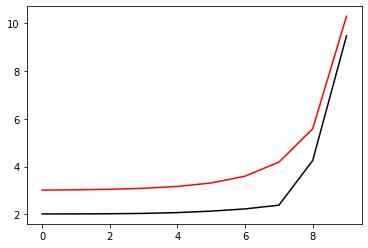

6500 99.00250689064701 9.1654377125849
[2.01821597 2.01952195 2.02502976 2.03993808 2.07294944 2.13502436
 2.22794358 2.38465313 4.25397891 9.48048518]


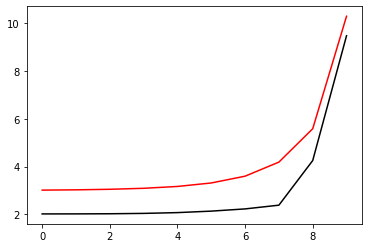

6600 99.0025055649636 9.164909912168417
[2.01828768 2.0195851  2.02506537 2.03991059 2.072805   2.13472608
 2.22765696 2.38511955 4.25336679 9.47998343]


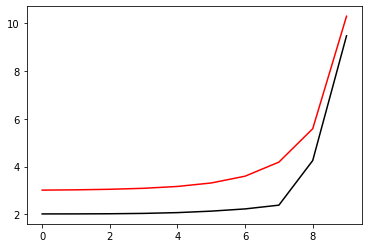

6700 99.00250424450898 9.164382944059179
[2.01835889 2.01964781 2.0251007  2.03988319 2.0726613  2.13442931
 2.22737174 2.38558462 4.25275553 9.47948167]


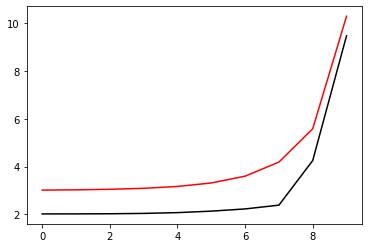

6800 99.00250292924706 9.163856805142677
[2.0184296  2.01971007 2.02513575 2.03985588 2.07251832 2.13413404
 2.22708791 2.38604836 4.25214513 9.4789799 ]


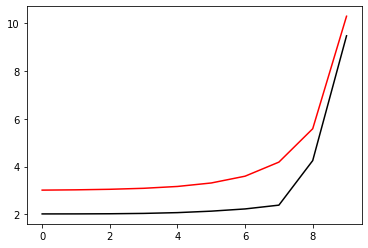

6900 99.00250161914198 9.163331492322492
[2.01849981 2.01977189 2.02517052 2.03982865 2.07237606 2.13384024
 2.22680547 2.38651075 4.25153558 9.47847812]


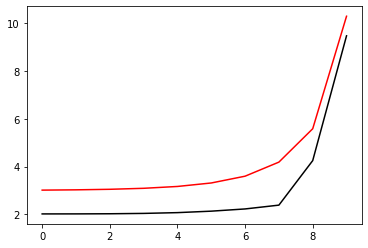

7000 99.00250031415814 9.162807002520195
[2.01856953 2.01983328 2.02520502 2.03980152 2.07223453 2.13354793
 2.22652442 2.38697181 4.25092689 9.47797633]


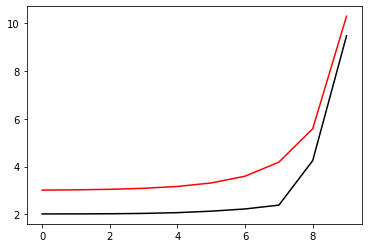

7100 99.00249901426032 9.1622833326752
[2.01863877 2.01989422 2.02523925 2.03977446 2.07209371 2.13325709
 2.22624474 2.38743154 4.25031904 9.47747453]


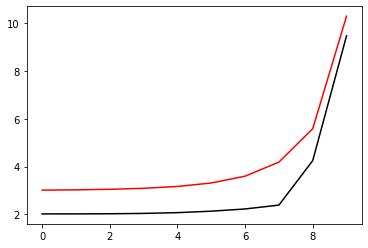

7200 99.00249771941347 9.161760479744602
[2.01870751 2.01995474 2.0252732  2.03974749 2.0719536  2.13296772
 2.22596644 2.38788994 4.24971204 9.47697272]


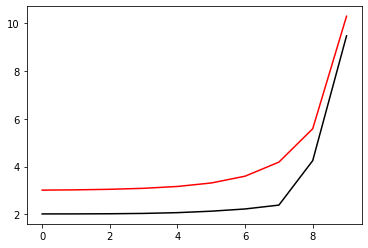

7300 99.00249642958289 9.161238440703066
[2.01877578 2.02001482 2.02530689 2.03972061 2.0718142  2.1326798
 2.2256895  2.38834702 4.24910589 9.47647089]


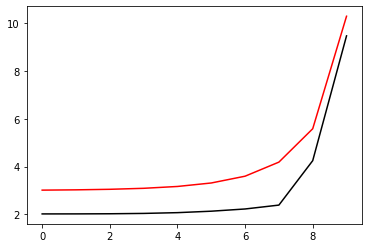

7400 99.00249514473416 9.16071721254267
[2.01884356 2.02007448 2.0253403  2.03969381 2.07167551 2.13239333
 2.22541393 2.38880279 4.24850058 9.47596906]


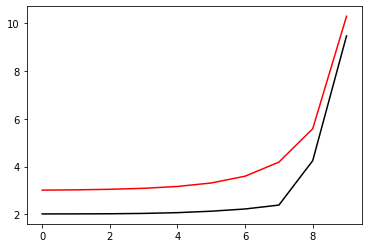

7500 99.0024938648331 9.160196792272775
[2.01891087 2.02013371 2.02537346 2.03966709 2.07153751 2.13210831
 2.22513972 2.38925723 4.24789611 9.47546722]


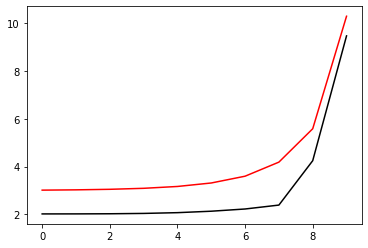

7600 99.0024925898458 9.159677176919923
[2.01897771 2.02019252 2.02540634 2.03964046 2.07140021 2.13182472
 2.22486687 2.38971037 4.24729248 9.47496537]


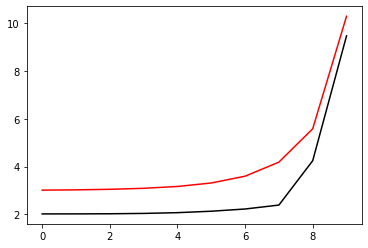

7700 99.00249131973871 9.15915836352766
[2.01904407 2.02025091 2.02543897 2.03961391 2.07126361 2.13154256
 2.22459536 2.3901622  4.24668969 9.47446351]


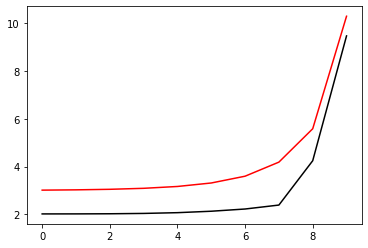

7800 99.0024900544784 9.158640349156455
[2.01910997 2.02030888 2.02547133 2.03958744 2.07112769 2.13126183
 2.2243252  2.39061273 4.24608773 9.47396164]


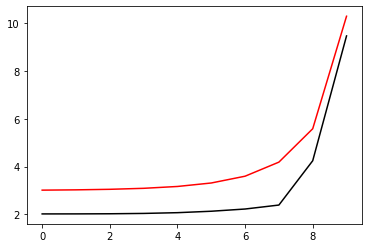

7900 99.00248879403183 9.158123130883503
[2.01917541 2.02036644 2.02550344 2.03956105 2.07099245 2.13098251
 2.22405637 2.39106196 4.2454866  9.47345976]


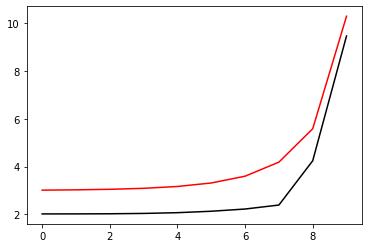

8000 99.00248753836618 9.15760670580264
[2.01924038 2.02042359 2.02553528 2.03953475 2.07085789 2.1307046
 2.22378889 2.39150989 4.2448863  9.47295787]


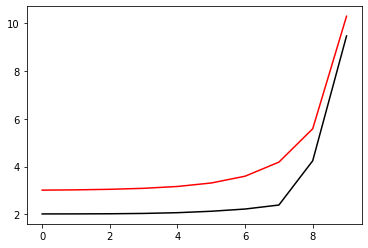

8100 99.00248628744887 9.157091071024224
[2.01930489 2.02048033 2.02556687 2.03950852 2.07072401 2.13042809
 2.22352273 2.39195654 4.24428682 9.47245597]


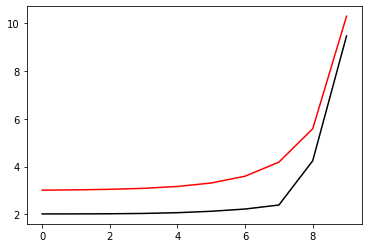

8200 99.00248504124762 9.156576223675012
[2.01936895 2.02053666 2.02559821 2.03948238 2.07059081 2.13015297
 2.2232579  2.39240189 4.24368817 9.47195406]


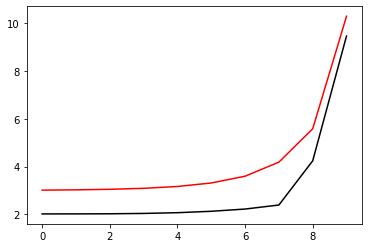

8300 99.00248379973038 9.156062160897994
[2.01943256 2.02059259 2.02562929 2.03945631 2.07045827 2.12987925
 2.22299439 2.39284596 4.24309035 9.47145214]


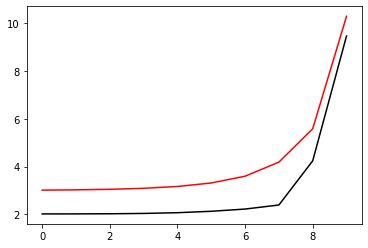

8400 99.00248256286535 9.155548879852308
[2.01949571 2.02064812 2.02566012 2.03943032 2.0703264  2.1296069
 2.2227322  2.39328876 4.24249334 9.47095021]


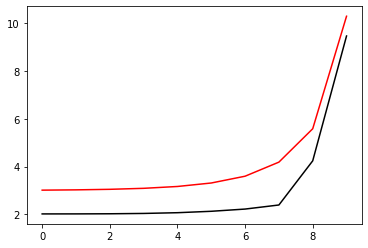

8500 99.00248133062101 9.155036377713104
[2.01955842 2.02070325 2.0256907  2.03940441 2.07019518 2.12933593
 2.22247132 2.39373028 4.24189715 9.47044828]


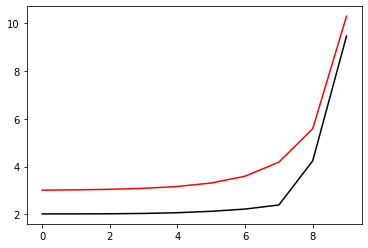

8600 99.00248010296605 9.154524651671414
[2.01962069 2.02075798 2.02572103 2.03937858 2.07006463 2.12906633
 2.22221175 2.39417052 4.24130178 9.46994633]


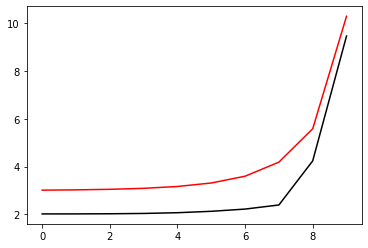

8700 99.00247887986946 9.15401369893406
[2.01968251 2.02081232 2.02575112 2.03935283 2.06993473 2.12879809
 2.22195347 2.3946095  4.24070722 9.46944438]


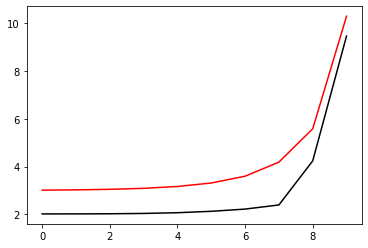

8800 99.00247766130042 9.153503516723529
[2.0197439  2.02086627 2.02578096 2.03932716 2.06980548 2.12853121
 2.2216965  2.39504721 4.24011347 9.46894241]


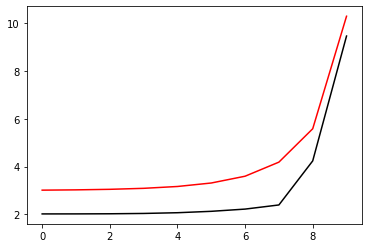

8900 99.00247644722837 9.152994102277802
[2.01980485 2.02091983 2.02581056 2.03930156 2.06967688 2.12826567
 2.22144082 2.39548367 4.23952053 9.46844044]


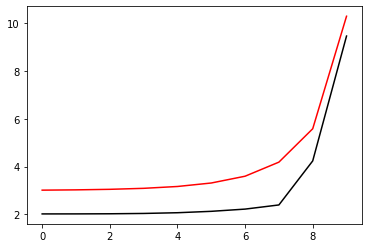

9000 99.00247523762305 9.152485452850323
[2.01986537 2.020973   2.02583992 2.03927604 2.06954892 2.12800148
 2.22118643 2.39591887 4.2389284  9.46793846]


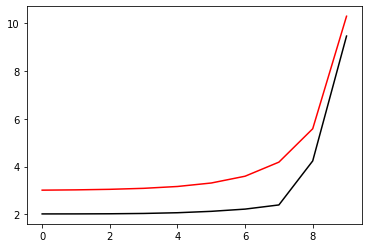

9100 99.00247403245436 9.151977565709823
[2.01992546 2.02102579 2.02586903 2.03925059 2.0694216  2.12773862
 2.22093332 2.39635281 4.23833708 9.46743647]


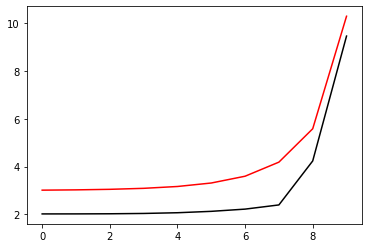

9200 99.00247283169246 9.151470438140223
[2.01998512 2.0210782  2.02589791 2.03922522 2.06929492 2.12747709
 2.22068149 2.39678551 4.23774655 9.46693447]


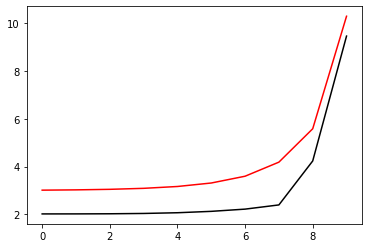

9300 99.00247163530774 9.150964067440517
[2.02004435 2.02113023 2.02592655 2.03919993 2.06916887 2.12721688
 2.22043093 2.39721696 4.23715683 9.46643247]


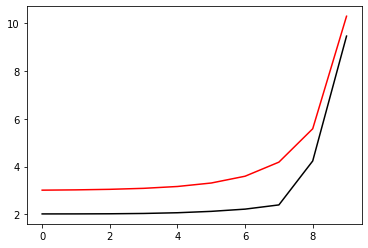

9400 99.00247044327088 9.15045845092469
[2.02010317 2.02118189 2.02595495 2.03917471 2.06904345 2.12695799
 2.22018164 2.39764717 4.23656791 9.46593045]


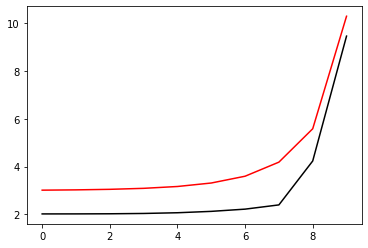

9500 99.00246925555274 9.149953585921562
[2.02016156 2.02123317 2.02598312 2.03914957 2.06891865 2.1267004
 2.21993362 2.39807614 4.23597978 9.46542843]


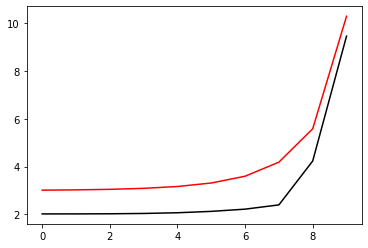

9600 99.00246807212437 9.149449469774687
[2.02021954 2.02128408 2.02601105 2.0391245  2.06879448 2.12644412
 2.21968686 2.39850388 4.23539245 9.4649264 ]


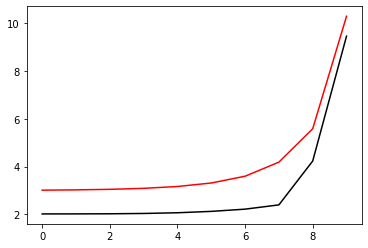

9700 99.00246689295713 9.148946099842277
[2.0202771  2.02133462 2.02603876 2.0390995  2.06867093 2.12618914
 2.21944136 2.39893038 4.23480591 9.46442436]


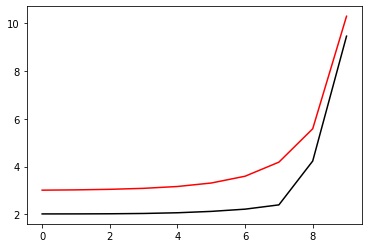

9800 99.00246571802256 9.148443473497068
[2.02033426 2.02138479 2.02606623 2.03907458 2.06854799 2.12593545
 2.21919711 2.39935567 4.23422016 9.46392231]


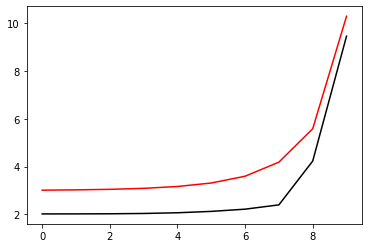

9900 99.00246454729242 9.147941588126194
[2.020391   2.0214346  2.02609348 2.03904973 2.06842566 2.12568305
 2.2189541  2.39977972 4.23363519 9.46342026]


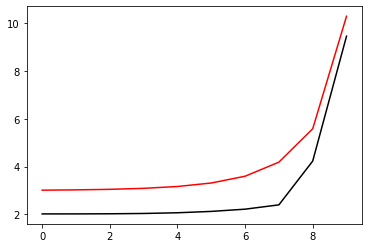

10000 99.00246338073873 9.147440441131133
[2.02044734 2.02148404 2.0261205  2.03902496 2.06830395 2.12543192
 2.21871234 2.40020256 4.23305102 9.46291819]


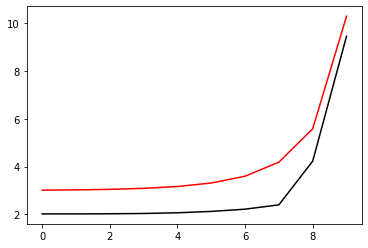

In [64]:
optimizer=tf.optimizers.SGD(learning_rate=0.01)
for i in range (1, 10001):
    run()
    if i%100==0: print(i, Error_func(h, m2_2).numpy(), m2_2.numpy()), print(h.numpy()), plt.plot(h_real, 'r-'), plt.plot(h.numpy(), 'k-'), plt.show()

100 99.00246221833366 9.146940029927558
[2.02050328 2.02153313 2.02614729 2.03900025 2.06818284 2.12518206
 2.21847181 2.40062419 4.23246763 9.46241612]


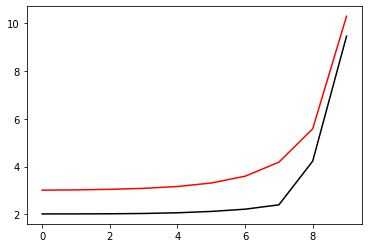

200 99.00246106004967 9.146440351945246
[2.02055881 2.02158186 2.02617386 2.03897562 2.06806233 2.12493347
 2.21823252 2.4010446  4.23188502 9.46191404]


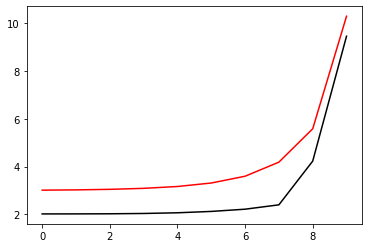

300 99.0024599058594 9.145941404627969
[2.02061395 2.02163023 2.02620021 2.03895106 2.06794242 2.12468614
 2.21799445 2.40146381 4.23130319 9.46141196]


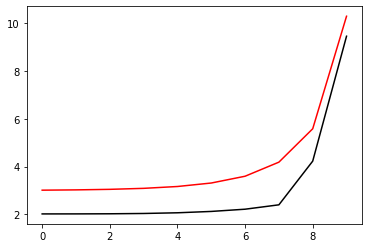

400 99.00245875573569 9.145443185433415
[2.02066869 2.02167825 2.02622633 2.03892657 2.06782311 2.12444007
 2.21775761 2.40188181 4.23072213 9.46090986]


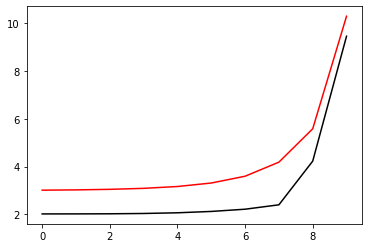

500 99.00245760965163 9.144945691833067
[2.02072304 2.02172592 2.02625224 2.03890216 2.06770439 2.12419524
 2.21752199 2.40229861 4.23014186 9.46040776]


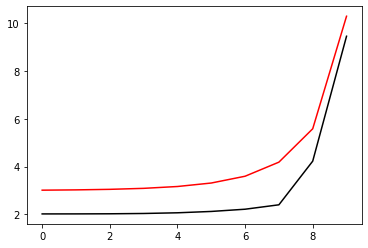

600 99.00245646758049 9.144448921312122
[2.020777   2.02177324 2.02627793 2.03887781 2.06758626 2.12395166
 2.21728759 2.40271421 4.22956235 9.45990565]


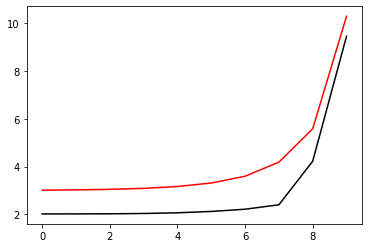

700 99.00245532949576 9.143952871369326
[2.02083056 2.02182021 2.0263034  2.03885354 2.06746872 2.12370931
 2.21705439 2.40312862 4.22898362 9.45940354]


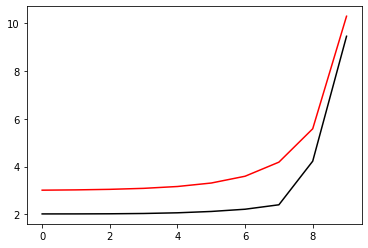

800 99.00245419537112 9.143457539516984
[2.02088375 2.02186684 2.02632865 2.03882933 2.06735176 2.12346819
 2.21682241 2.40354184 4.22840566 9.45890141]


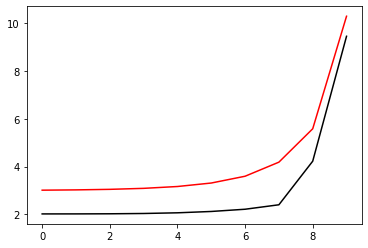

900 99.00245306518048 9.142962923280756
[2.02093655 2.02191313 2.02635369 2.0388052  2.06723538 2.1232283
 2.21659162 2.40395387 4.22782847 9.45839928]


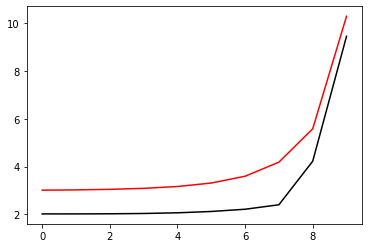

1000 99.00245193889793 9.142469020199643
[2.02098897 2.02195908 2.02637852 2.03878113 2.06711958 2.12298962
 2.21636203 2.40436472 4.22725204 9.45789714]


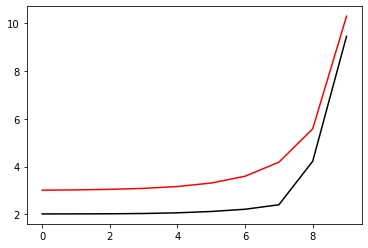

1100 99.00245081649781 9.14197582782583
[2.02104101 2.02200469 2.02640314 2.03875713 2.06700435 2.12275216
 2.21613364 2.40477439 4.22667638 9.457395  ]


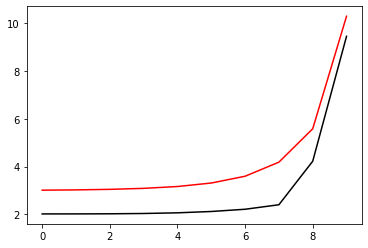

1200 99.0024496979546 9.141483343724627
[2.02109267 2.02204997 2.02642754 2.03873321 2.0668897  2.1225159
 2.21590643 2.40518289 4.22610147 9.45689284]


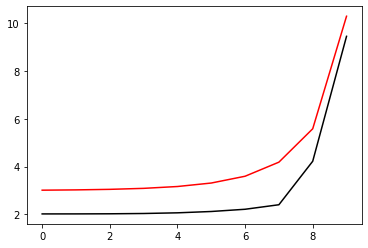

1300 99.00244858324298 9.140991565474373
[2.02114396 2.02209491 2.02645174 2.03870935 2.06677561 2.12228085
 2.21568041 2.40559022 4.22552733 9.45639068]


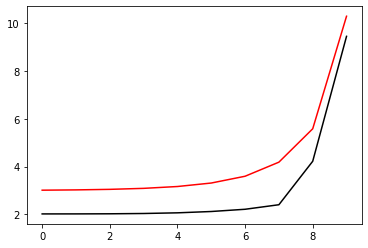

1400 99.00244747233785 9.140500490666334
[2.02119488 2.02213952 2.02647573 2.03868556 2.06666209 2.12204699
 2.21545557 2.40599637 4.22495395 9.45588852]


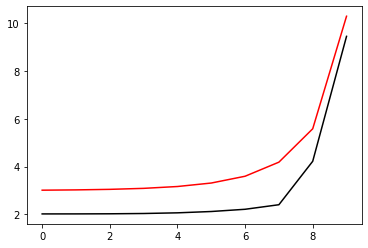

1500 99.00244636521433 9.14001011690459
[2.02124543 2.0221838  2.02649952 2.03866184 2.06654913 2.12181432
 2.2152319  2.40640137 4.22438132 9.45538635]


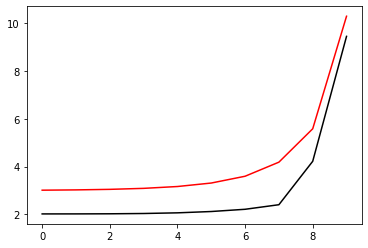

1600 99.00244526184765 9.139520441805992
[2.02129562 2.02222776 2.0265231  2.03863819 2.06643673 2.12158284
 2.21500941 2.4068052  4.22380944 9.45488417]


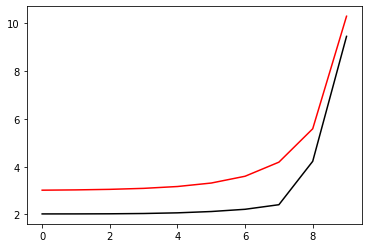

1700 99.00244416221334 9.139031463000029
[2.02134544 2.02227138 2.02654648 2.0386146  2.06632489 2.12135253
 2.21478808 2.40720787 4.22323832 9.45438198]


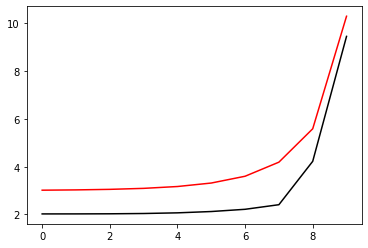

1800 99.00244306628703 9.138543178128751
[2.0213949  2.02231469 2.02656965 2.03859109 2.0662136  2.12112339
 2.21456791 2.40760939 4.22266795 9.45387979]


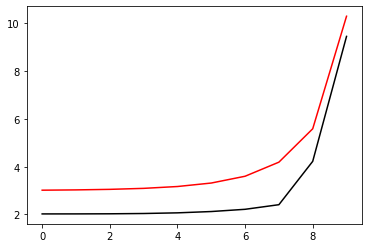

1900 99.00244197404457 9.138055584846677
[2.021444   2.02235768 2.02659263 2.03856763 2.06610286 2.12089543
 2.21434891 2.40800976 4.22209833 9.45337759]


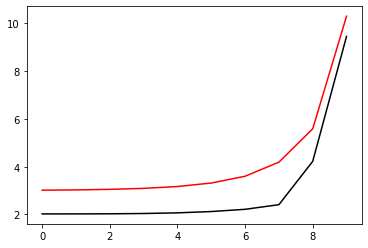

2000 99.00244088546204 9.137568680820742
[2.02149274 2.02240035 2.0266154  2.03854425 2.06599267 2.12066862
 2.21413105 2.40840898 4.22152945 9.45287538]


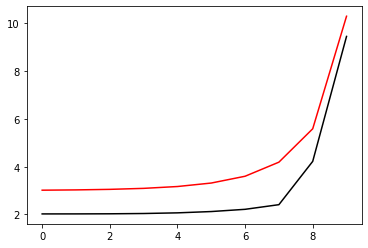

2100 99.00243980051557 9.137082463730145
[2.02154112 2.0224427  2.02663798 2.03852094 2.06588302 2.12044297
 2.21391435 2.40880706 4.22096132 9.45237317]


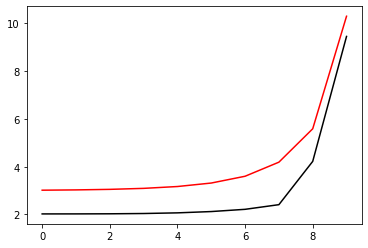

2200 99.00243871918168 9.1365969312663
[2.02158916 2.02248473 2.02666036 2.03849769 2.06577392 2.12021847
 2.21369879 2.409204   4.22039393 9.45187095]


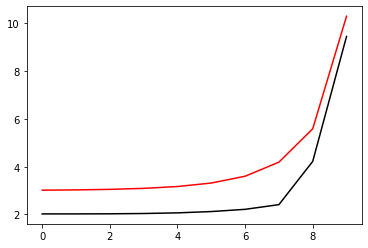

2300 99.00243764143687 9.136112081132751
[2.02163684 2.02252646 2.02668255 2.0384745  2.06566535 2.11999512
 2.21348437 2.4095998  4.21982728 9.45136872]


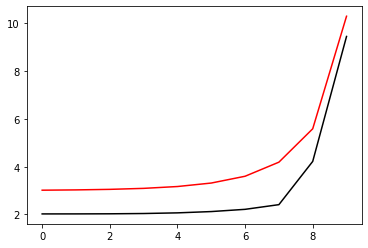

2400 99.00243656725794 9.13562791104508
[2.02168418 2.02256787 2.02670454 2.03845139 2.06555732 2.1197729
 2.21327109 2.40999447 4.21926137 9.45086649]


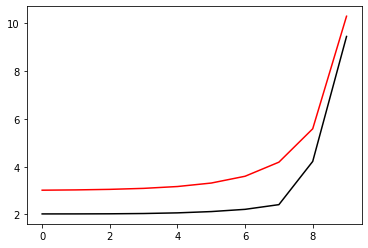

2500 99.00243549662183 9.135144418730826
[2.02173117 2.02260897 2.02672634 2.03842833 2.06544983 2.11955182
 2.21305894 2.41038801 4.21869619 9.45036426]


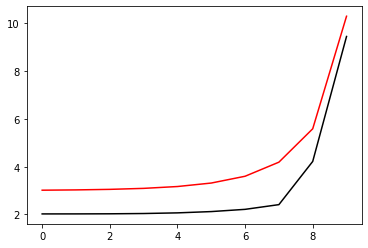

2600 99.00243442950566 9.134661601929405
[2.02177781 2.02264977 2.02674795 2.03840535 2.06534287 2.11933187
 2.21284792 2.41078043 4.21813176 9.44986201]


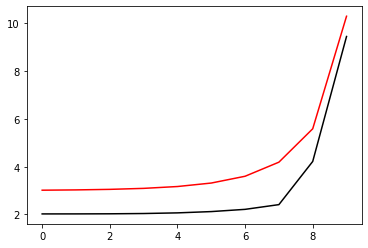

2700 99.00243336588672 9.134179458392001
[2.02182412 2.02269027 2.02676936 2.03838243 2.06523643 2.11911304
 2.21263802 2.41117172 4.21756805 9.44935976]


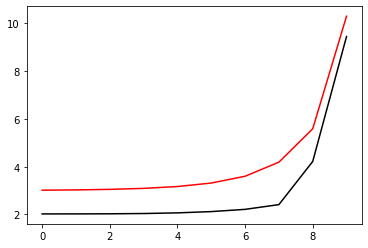

2800 99.00243230574249 9.133697985881533
[2.02187008 2.02273046 2.02679059 2.03835957 2.06513053 2.11889533
 2.21242925 2.41156189 4.21700508 9.44885751]


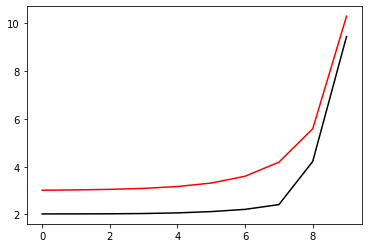

2900 99.00243124905062 9.133217182172507
[2.02191571 2.02277035 2.02681163 2.03833678 2.06502514 2.11867873
 2.21222158 2.41195095 4.21644283 9.44835525]


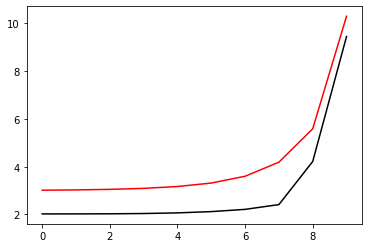

3000 99.0024301957889 9.132737045050991
[2.021961   2.02280994 2.02683249 2.03831406 2.06492028 2.11846325
 2.21201504 2.41233889 4.21588132 9.44785298]


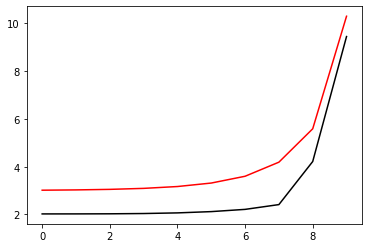

3100 99.00242914593532 9.13225757231451
[2.02200596 2.02284923 2.02685316 2.0382914  2.06481593 2.11824886
 2.21180959 2.41272572 4.21532052 9.44735071]


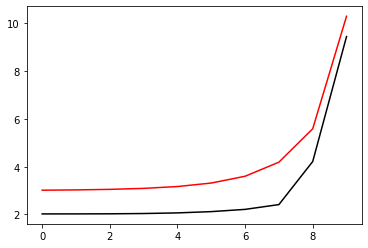

3200 99.00242809946809 9.131778761771985
[2.02205059 2.02288823 2.02687364 2.0382688  2.0647121  2.11803557
 2.21160525 2.41311145 4.21476046 9.44684843]


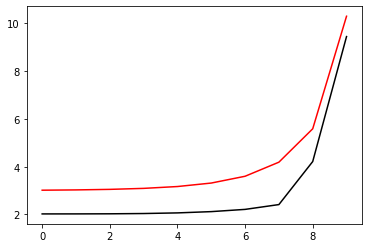

3300 99.00242705636545 9.131300611243615
[2.02209489 2.02292693 2.02689395 2.03824627 2.06460878 2.11782337
 2.21140201 2.41349608 4.21420111 9.44634615]


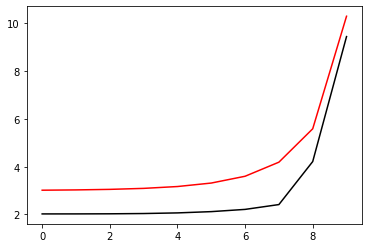

3400 99.00242601660591 9.130823118560848
[2.02213886 2.02296535 2.02691407 2.0382238  2.06450597 2.11761226
 2.21119987 2.41387961 4.21364249 9.44584386]


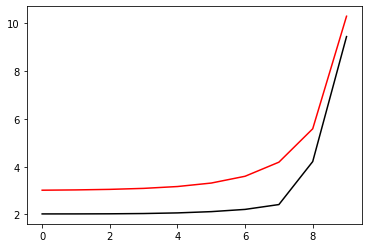

3500 99.00242498016812 9.130346281566268
[2.02218251 2.02300347 2.02693401 2.0382014  2.06440366 2.11740223
 2.21099881 2.41426204 4.21308458 9.44534157]


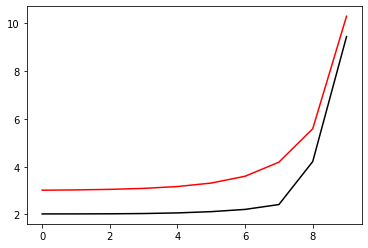

3600 99.0024239470309 9.129870098113544
[2.02222583 2.02304131 2.02695377 2.03817906 2.06430187 2.11719328
 2.21079884 2.41464338 4.2125274  9.44483927]


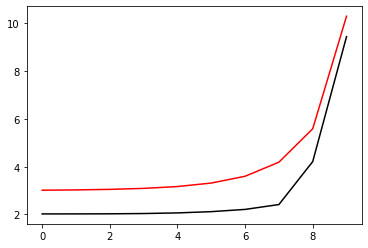

3700 99.00242291717325 9.129394566067326
[2.02226884 2.02307886 2.02697336 2.03815678 2.06420057 2.1169854
 2.21059996 2.41502364 4.21197092 9.44433696]


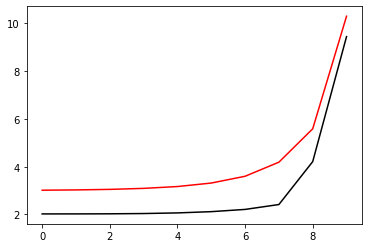

3800 99.00242189057424 9.128919683303193
[2.02231153 2.02311613 2.02699276 2.03813457 2.06409978 2.11677858
 2.21040215 2.4154028  4.21141516 9.44383465]


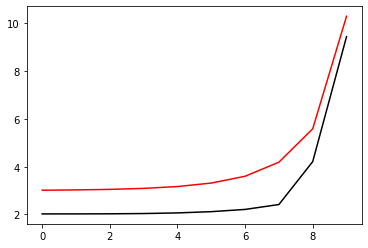

3900 99.00242086721319 9.128445447707554
[2.0223539  2.02315312 2.027012   2.03811242 2.06399948 2.11657283
 2.21020541 2.41578089 4.21086012 9.44333234]


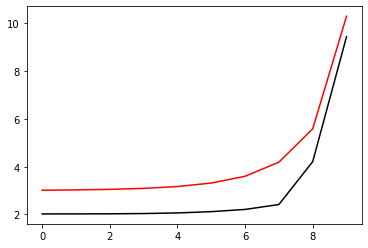

4000 99.00241984706956 9.127971857177597
[2.02239596 2.02318982 2.02703106 2.03809033 2.06389967 2.11636813
 2.21000975 2.41615789 4.21030578 9.44283002]


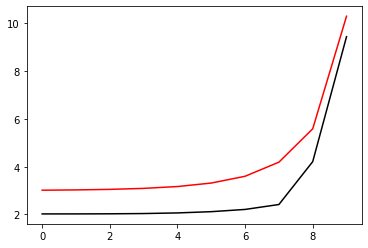

4100 99.00241883012293 9.127498909621217
[2.0224377  2.02322625 2.02704994 2.0380683  2.06380036 2.11616449
 2.20981515 2.41653382 4.20975215 9.44232769]


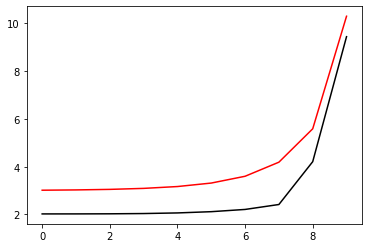

4200 99.00241781635307 9.127026602956914
[2.02247913 2.0232624  2.02706865 2.03804634 2.06370154 2.11596189
 2.20962161 2.41690868 4.20919922 9.44182536]


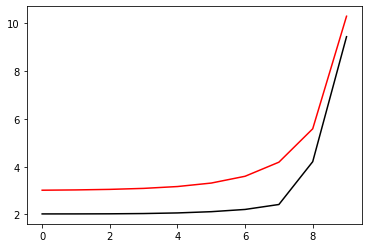

4300 99.0024168057399 9.12655493511376
[2.02252026 2.02329828 2.0270872  2.03802444 2.06360321 2.11576033
 2.20942914 2.41728247 4.208647   9.44132303]


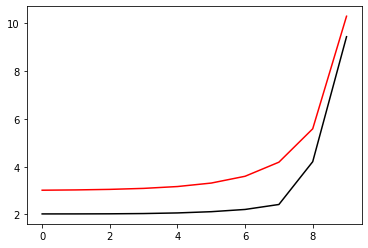

4400 99.00241579826348 9.126083904031285
[2.02256108 2.02333388 2.02710557 2.0380026  2.06350536 2.11555981
 2.20923771 2.4176552  4.20809549 9.44082069]


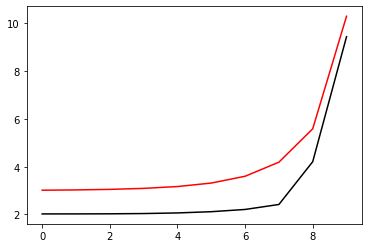

4500 99.00241479390402 9.125613507659445
[2.0226016  2.02336921 2.02712378 2.03798083 2.06340799 2.11536032
 2.20904734 2.41802686 4.20754467 9.44031835]


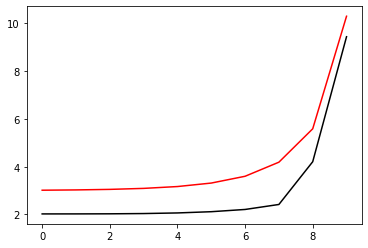

4600 99.00241379264189 9.125143743958525
[2.02264181 2.02340428 2.02714181 2.03795911 2.06331111 2.11516186
 2.20885801 2.41839746 4.20699455 9.439816  ]


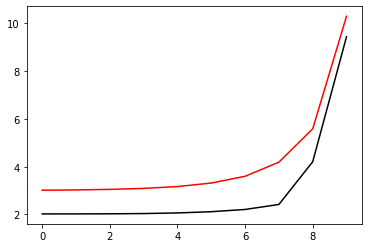

4700 99.00241279445758 9.124674610899069
[2.02268172 2.02343907 2.02715968 2.03793746 2.0632147  2.11496442
 2.20866972 2.41876701 4.20644513 9.43931365]


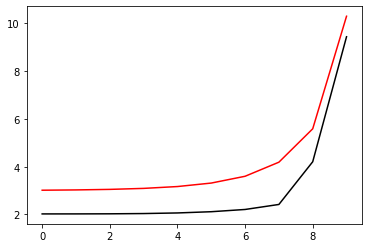

4800 99.0024117993318 9.124206106461854
[2.02272134 2.0234736  2.02717739 2.03791587 2.06311877 2.11476799
 2.20848247 2.4191355  4.20589641 9.43881129]


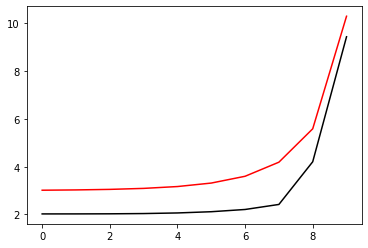

4900 99.0024108072453 9.123738228637746
[2.02276065 2.02350786 2.02719493 2.03789434 2.06302331 2.11457259
 2.20829626 2.41950295 4.20534838 9.43830893]


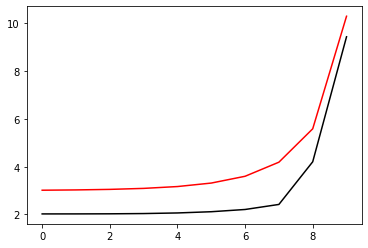

5000 99.00240981817907 9.123270975427701
[2.02279968 2.02354187 2.02721231 2.03787288 2.06292832 2.11437818
 2.20811107 2.41986935 4.20480105 9.43780656]


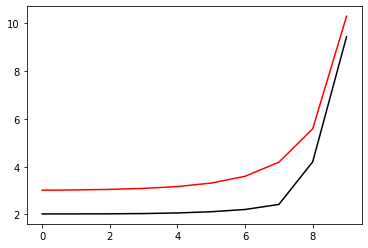

5100 99.0024088321142 9.122804344842647
[2.02283841 2.02357561 2.02722953 2.03785147 2.0628338  2.11418478
 2.20792691 2.42023471 4.2042544  9.43730419]


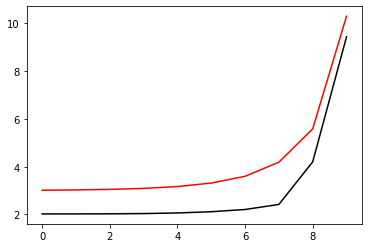

5200 99.00240784903191 9.122338334903478
[2.02287685 2.02360909 2.02724659 2.03783013 2.06273974 2.11399238
 2.20774377 2.42059902 4.20370845 9.43680181]


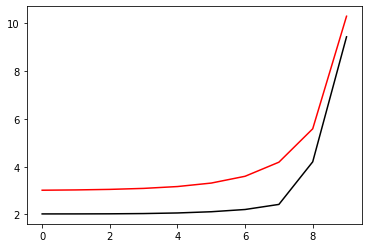

5300 99.00240686891357 9.121872943640897
[2.022915   2.02364231 2.02726349 2.03780884 2.06264615 2.11380098
 2.20756165 2.4209623  4.20316318 9.43629944]


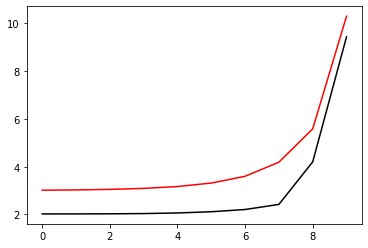

5400 99.00240589174074 9.121408169095444
[2.02295286 2.02367528 2.02728023 2.03778762 2.06255302 2.11361056
 2.20738055 2.42132455 4.20261859 9.43579705]


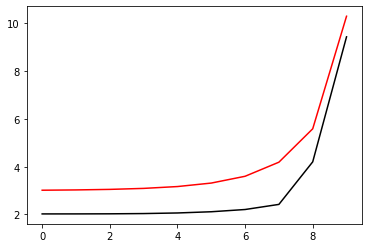

5500 99.00240491749501 9.12094400931736
[2.02299044 2.023708   2.02729681 2.03776646 2.06246035 2.11342113
 2.20720045 2.42168577 4.2020747  9.43529467]


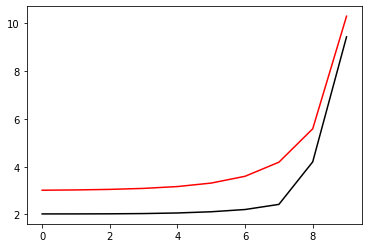

5600 99.00240394615824 9.120480462366572
[2.02302773 2.02374046 2.02731324 2.03774535 2.06236814 2.11323268
 2.20702136 2.42204596 4.20153148 9.43479227]


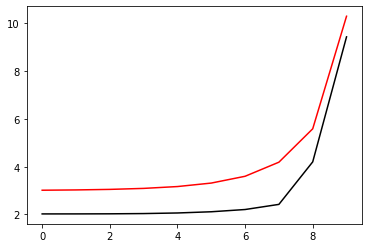

5700 99.00240297771231 9.120017526312603
[2.02306475 2.02377267 2.02732951 2.03772431 2.06227638 2.1130452
 2.20684328 2.42240513 4.20098895 9.43428988]


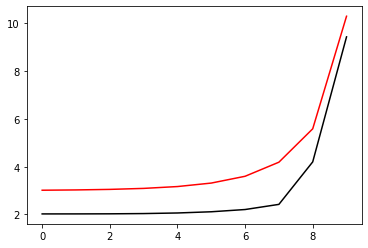

5800 99.00240201213933 9.119555199234501
[2.02310148 2.02380463 2.02734563 2.03770333 2.06218508 2.11285869
 2.20666619 2.42276327 4.20044709 9.43378748]


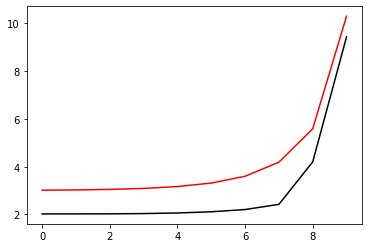

5900 99.00240104942145 9.1190934792208
[2.02313793 2.02383635 2.0273616  2.03768241 2.06209423 2.11267315
 2.2064901  2.4231204  4.19990591 9.43328508]


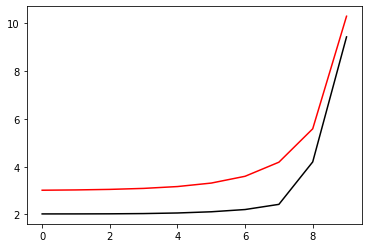

6000 99.00240008954104 9.118632364369441
[2.02317411 2.02386782 2.02737741 2.03766155 2.06200382 2.11248857
 2.206315   2.42347652 4.19936541 9.43278267]


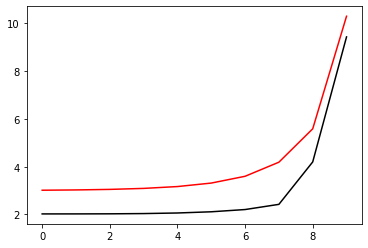

6100 99.00239913248055 9.118171852787714
[2.02321002 2.02389904 2.02739308 2.03764075 2.06191386 2.11230495
 2.20614088 2.42383162 4.19882558 9.43228026]


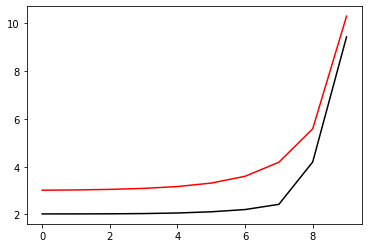

6200 99.00239817822259 9.117711942592189
[2.02324565 2.02393002 2.02740859 2.03762    2.06182435 2.11212228
 2.20596775 2.42418572 4.19828642 9.43177785]


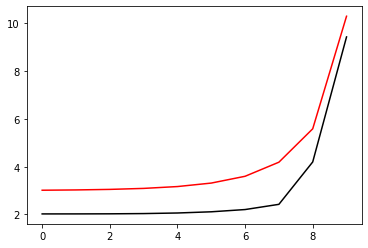

6300 99.00239722674988 9.117252631908666
[2.02328101 2.02396076 2.02742396 2.03759932 2.06173528 2.11194057
 2.2057956  2.42453881 4.19774794 9.43127543]


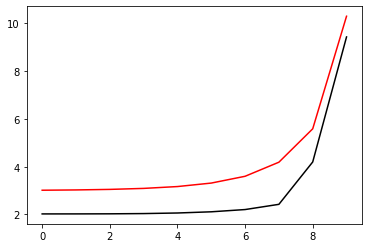

6400 99.00239627804525 9.116793918872121
[2.0233161  2.02399126 2.02743918 2.0375787  2.06164664 2.11175979
 2.20562442 2.4248909  4.19721013 9.43077301]


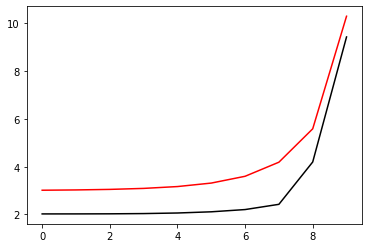

6500 99.00239533209172 9.116335801626619
[2.02335093 2.02402153 2.02745425 2.03755814 2.06155845 2.11157995
 2.20545422 2.42524199 4.19667298 9.43027059]


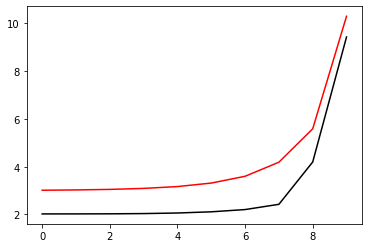

6600 99.00239438887237 9.115878278325273
[2.02338549 2.02405155 2.02746917 2.03753764 2.06147069 2.11140105
 2.20528498 2.42559208 4.1961365  9.42976816]


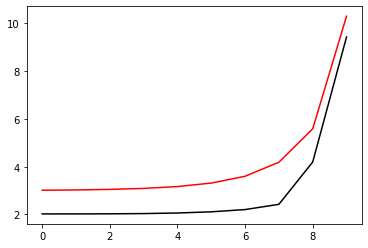

6700 99.00239344837047 9.115421347130193
[2.02341978 2.02408134 2.02748396 2.03751719 2.06138336 2.11122308
 2.20511671 2.42594118 4.19560068 9.42926573]


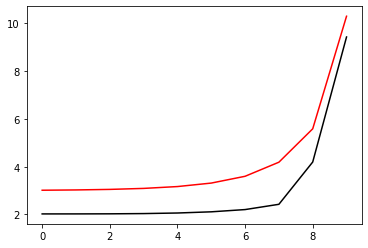

6800 99.00239251056935 9.114965006212419
[2.02345381 2.0241109  2.02749859 2.03749681 2.06129647 2.11104604
 2.20494939 2.4262893  4.19506553 9.4287633 ]


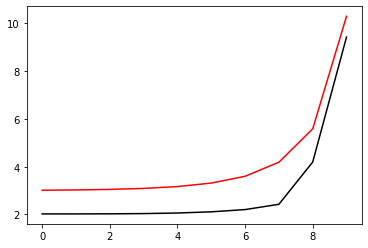

6900 99.00239157545249 9.114509253751837
[2.02348759 2.02414023 2.02751309 2.03747648 2.06121    2.11086992
 2.20478304 2.42663642 4.19453104 9.42826086]


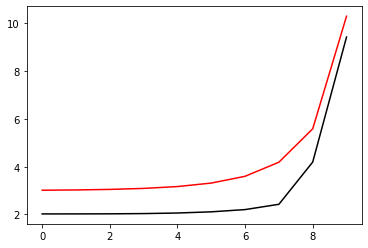

7000 99.00239064300352 9.114054087937179
[2.0235211  2.02416933 2.02752745 2.03745621 2.06112396 2.11069472
 2.20461764 2.42698257 4.1939972  9.42775842]


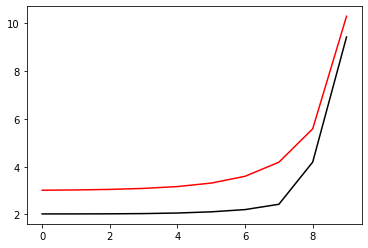

7100 99.00238971320616 9.113599506965889
[2.02355436 2.02419819 2.02754166 2.03743601 2.06103835 2.11052043
 2.20445318 2.42732773 4.19346403 9.42725598]


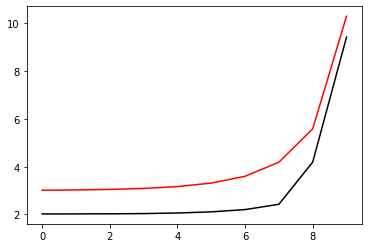

7200 99.00238878604422 9.113145509044147
[2.02358736 2.02422683 2.02755574 2.03741586 2.06095316 2.11034705
 2.20428968 2.42767191 4.19293152 9.42675353]


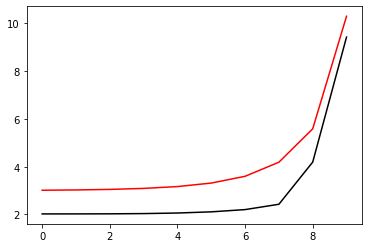

7300 99.00238786150175 9.112692092386759
[2.0236201  2.02425525 2.02756967 2.03739577 2.0608684  2.11017458
 2.20412711 2.42801513 4.19239965 9.42625108]


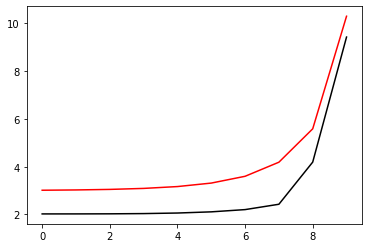

7400 99.00238693956274 9.112239255217109
[2.0236526  2.02428344 2.02758347 2.03737573 2.06078405 2.11000301
 2.20396548 2.42835737 4.19186845 9.42574863]


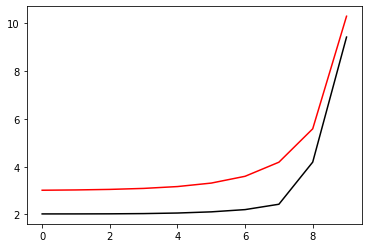

7500 99.00238602021147 9.111786995767119
[2.02368484 2.02431141 2.02759714 2.03735576 2.06070012 2.10983233
 2.20380479 2.42869864 4.19133789 9.42524618]


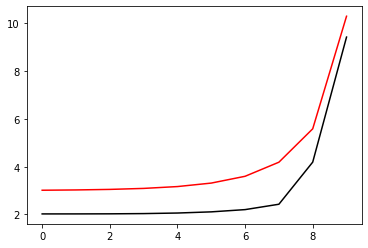

7600 99.00238510343225 9.111335312277186
[2.02371684 2.02433915 2.02761067 2.03733584 2.0606166  2.10966255
 2.20364503 2.42903894 4.19080799 9.42474372]


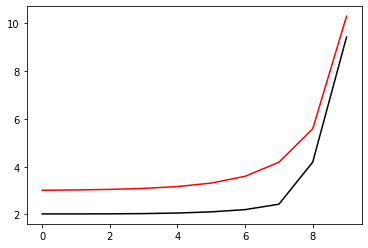

7700 99.00238418920948 9.11088420299612
[2.02374859 2.02436668 2.02762406 2.03731599 2.0605335  2.10949365
 2.2034862  2.42937829 4.19027873 9.42424126]


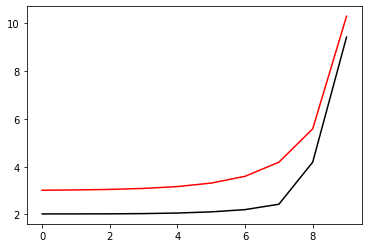

7800 99.00238327752773 9.110433666181114
[2.02378009 2.02439399 2.02763732 2.03729619 2.06045081 2.10932565
 2.20332829 2.42971667 4.18975012 9.4237388 ]


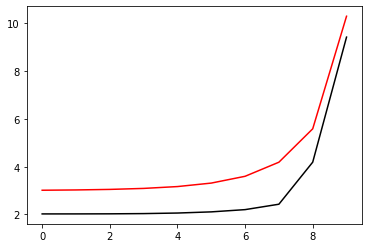

7900 99.00238236837167 9.109983700097652
[2.02381135 2.02442108 2.02765045 2.03727645 2.06036853 2.10915852
 2.20317129 2.4300541  4.18922216 9.42323634]


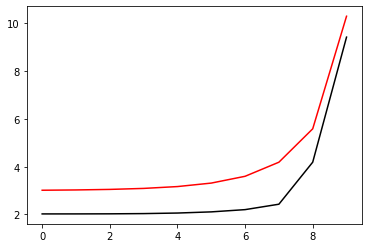

8000 99.00238146172607 9.109534303019494
[2.02384237 2.02444795 2.02766344 2.03725677 2.06028666 2.10899227
 2.20301522 2.43039057 4.18869484 9.42273387]


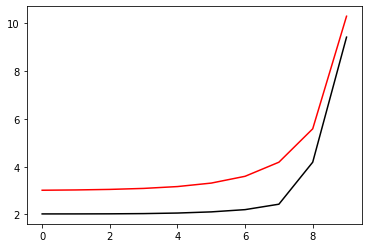

8100 99.00238055757585 9.109085473228603
[2.02387314 2.02447461 2.02767631 2.03723714 2.06020519 2.10882689
 2.20286006 2.4307261  4.18816817 9.4222314 ]


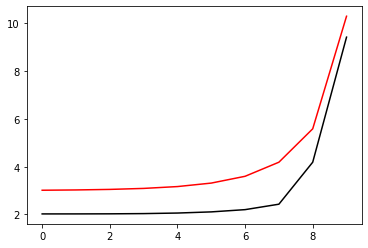

8200 99.00237965590597 9.108637209015091
[2.02390368 2.02450106 2.02768905 2.03721758 2.06012413 2.10866238
 2.20270581 2.43106067 4.18764214 9.42172893]


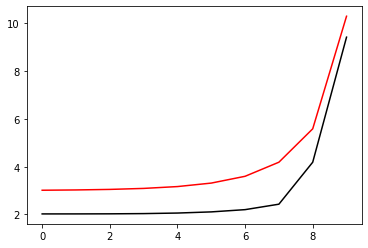

8300 99.00237875670159 9.108189508677178
[2.02393398 2.0245273  2.02770166 2.03719807 2.06004347 2.10849873
 2.20255246 2.43139431 4.18711674 9.42122646]


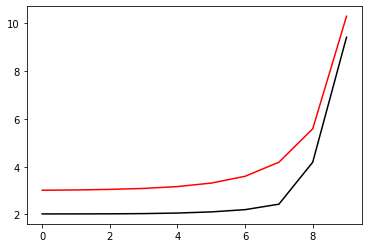

8400 99.00237785994788 9.107742370521125
[2.02396404 2.02455333 2.02771414 2.03717862 2.05996321 2.10833595
 2.20240001 2.431727   4.18659199 9.42072398]


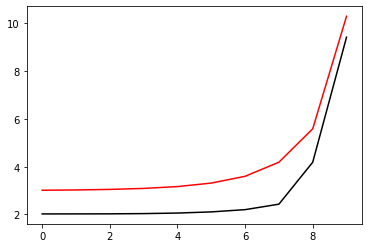

8500 99.0023769656302 9.107295792861208
[2.02399387 2.02457915 2.02772649 2.03715922 2.05988335 2.10817402
 2.20224847 2.43205875 4.18606787 9.42022151]


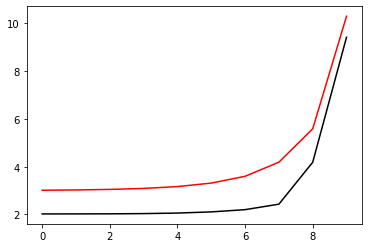

8600 99.00237607373401 9.10684977401963
[2.02402347 2.02460476 2.02773872 2.03713989 2.05980388 2.10801294
 2.20209781 2.43238956 4.18554439 9.41971903]


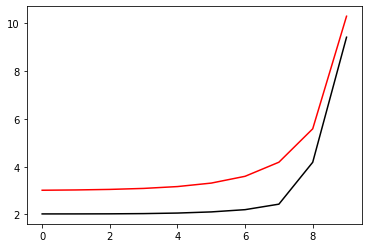

8700 99.0023751842448 9.106404312326513
[2.02405283 2.02463017 2.02775082 2.03712061 2.05972481 2.10785272
 2.20194805 2.43271945 4.18502154 9.41921654]


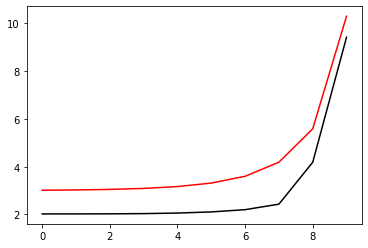

8800 99.00237429714826 9.10595940611982
[2.02408197 2.02465537 2.0277628  2.03710139 2.05964614 2.10769333
 2.20179918 2.4330484  4.18449933 9.41871406]


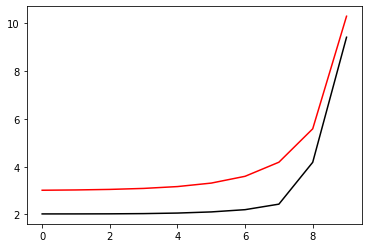

8900 99.00237341243015 9.105515053745316
[2.02411087 2.02468037 2.02777466 2.03708222 2.05956785 2.10753479
 2.20165119 2.43337642 4.18397775 9.41821157]


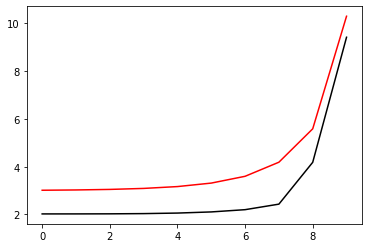

9000 99.0023725300763 9.10507125355652
[2.02413955 2.02470517 2.02778639 2.03706312 2.05948995 2.10737709
 2.20150408 2.43370352 4.18345679 9.41770909]


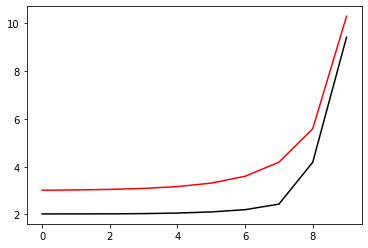

9100 99.00237165007269 9.104628003914613
[2.024168   2.02472977 2.02779801 2.03704407 2.05941244 2.10722022
 2.20135785 2.4340297  4.18293647 9.4172066 ]


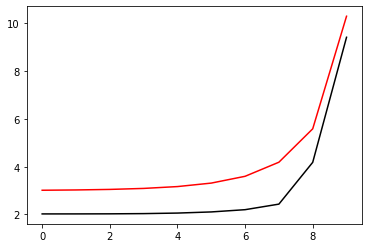

9200 99.0023707724054 9.104185303188482
[2.02419623 2.02475417 2.0278095  2.03702508 2.05933532 2.10706418
 2.2012125  2.43435496 4.18241677 9.41670411]


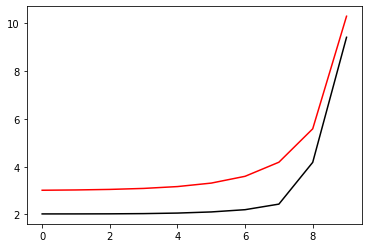

9300 99.00236989706057 9.103743149754589
[2.02422424 2.02477837 2.02782087 2.03700614 2.05925858 2.10690896
 2.20106801 2.43467931 4.18189769 9.41620161]


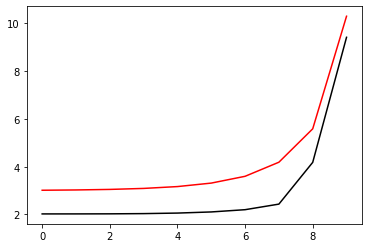

9400 99.00236902402447 9.103301541996975
[2.02425203 2.02480238 2.02783213 2.03698726 2.05918222 2.10675457
 2.20092439 2.43500274 4.18137924 9.41569912]


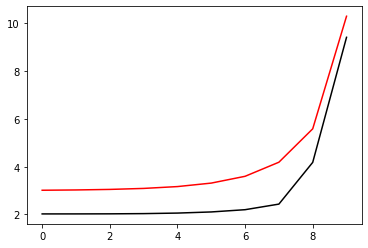

9500 99.00236815328351 9.10286047830715
[2.02427959 2.02482619 2.02784327 2.03696844 2.05910625 2.10660099
 2.20078163 2.43532526 4.18086142 9.41519663]


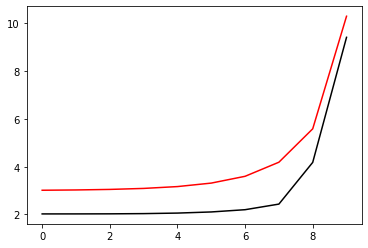

9600 99.00236728482413 9.102419957084129
[2.02430694 2.02484981 2.02785429 2.03694968 2.05903065 2.10644823
 2.20063974 2.43564688 4.18034421 9.41469413]


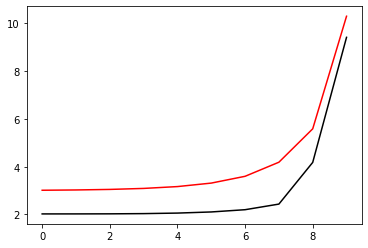

9700 99.00236641863286 9.101979976734324
[2.02433408 2.02487323 2.02786519 2.03693097 2.05895543 2.10629628
 2.2004987  2.43596759 4.17982762 9.41419163]


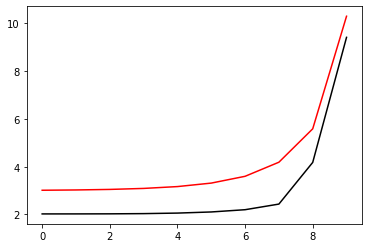

9800 99.00236555469644 9.101540535671514
[2.02436099 2.02489647 2.02787598 2.03691232 2.05888058 2.10614514
 2.20035851 2.43628739 4.17931165 9.41368913]


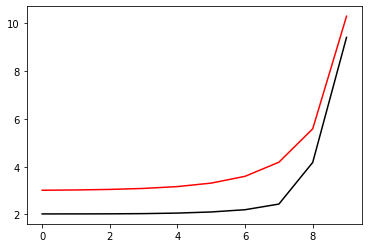

9900 99.00236469300157 9.101101632316803
[2.0243877  2.02491951 2.02788666 2.03689373 2.05880611 2.1059948
 2.20021918 2.4366063  4.1787963  9.41318663]


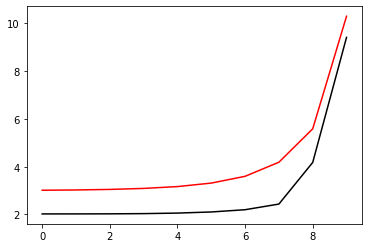

10000 99.00236383353513 9.10066326509859
[2.02441419 2.02494237 2.02789722 2.03687519 2.05873201 2.10584526
 2.20008068 2.43692432 4.17828157 9.41268413]


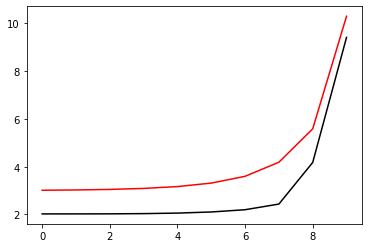

In [65]:
optimizer=tf.optimizers.SGD(learning_rate=0.01)
for i in range (1, 10001):
    run()
    if i%100==0: print(i, Error_func(h, m2_2).numpy(), m2_2.numpy()), print(h.numpy()), plt.plot(h_real, 'r-'), plt.plot(h.numpy(), 'k-'), plt.show()

100 99.00236297628409 9.100225432452492
[2.02444047 2.02496504 2.02790767 2.03685672 2.05865828 2.10569652
 2.19994304 2.43724143 4.17776744 9.41218162]


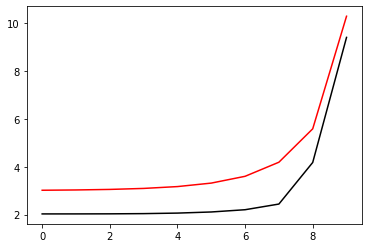

200 99.00236212123548 9.099788132821322
[2.02446654 2.02498752 2.02791801 2.03683829 2.05858492 2.10554857
 2.19980623 2.43755766 4.17725393 9.41167912]


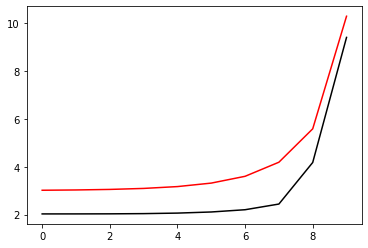

300 99.00236126837642 9.099351364655014
[2.0244924  2.02500982 2.02792824 2.03681993 2.05851193 2.1054014
 2.19967026 2.437873   4.17674104 9.41117662]


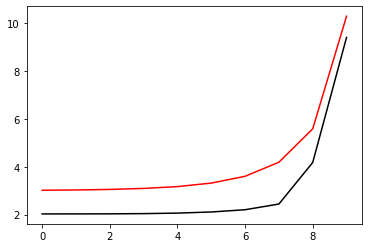

400 99.00236041769416 9.098915126410631
[2.02451806 2.02503194 2.02793836 2.03680162 2.0584393  2.10525503
 2.19953512 2.43818746 4.17622875 9.41067411]


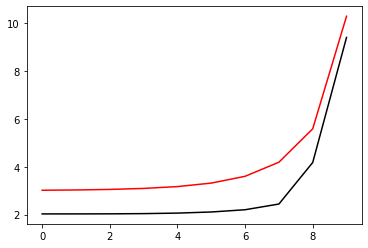

500 99.00235956917605 9.098479416552292
[2.02454351 2.02505388 2.02794837 2.03678336 2.05836703 2.10510943
 2.19940081 2.43850103 4.17571707 9.4101716 ]


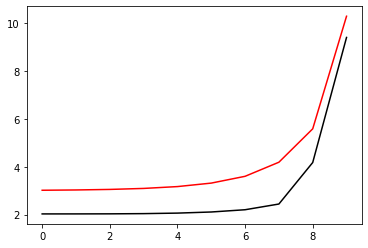

600 99.00235872280948 9.09804423355111
[2.02456876 2.02507563 2.02795827 2.03676516 2.05829513 2.10496462
 2.19926732 2.43881373 4.17520599 9.40966909]


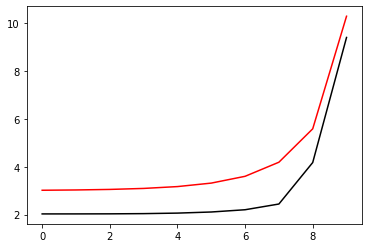

700 99.00235787858198 9.097609575885182
[2.0245938  2.02509721 2.02796807 2.03674702 2.05822359 2.10482057
 2.19913466 2.43912554 4.17469553 9.40916658]


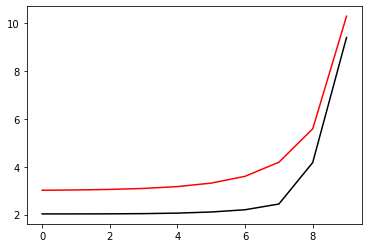

800 99.00235703648113 9.097175442039532
[2.02461864 2.0251186  2.02797776 2.03672894 2.0581524  2.1046773
 2.19900282 2.43943649 4.17418566 9.40866408]


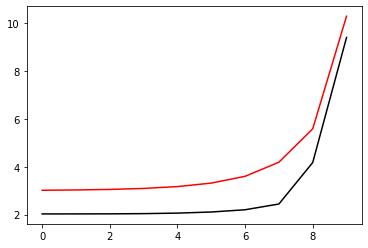

900 99.00235619649463 9.096741830506065
[2.02464329 2.02513982 2.02798734 2.03671091 2.05808158 2.1045348
 2.1988718  2.43974656 4.1736764  9.40816157]


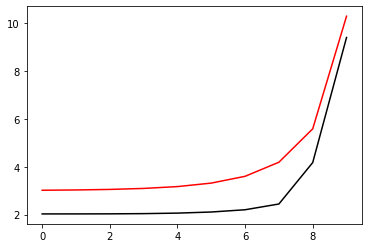

1000 99.00235535861026 9.096308739783526
[2.02466773 2.02516086 2.02799682 2.03669294 2.05801111 2.10439306
 2.19874158 2.44005576 4.17316774 9.40765905]


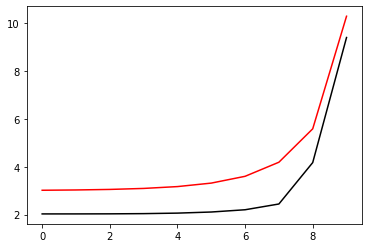

1100 99.00235452281589 9.095876168377476
[2.02469198 2.02518173 2.02800619 2.03667502 2.05794099 2.10425208
 2.19861218 2.4403641  4.17265968 9.40715654]


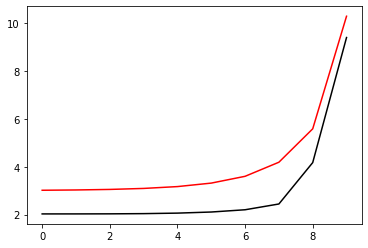

1200 99.00235368909944 9.0954441148002
[2.02471603 2.02520243 2.02801547 2.03665716 2.05787123 2.10411186
 2.19848359 2.44067157 4.17215222 9.40665403]


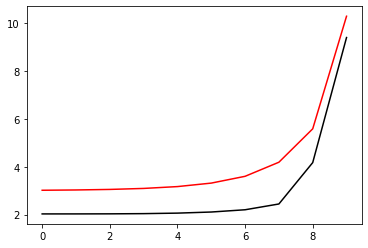

1300 99.00235285744898 9.095012577570754
[2.02473989 2.02522295 2.02802464 2.03663936 2.05780181 2.10397239
 2.19835579 2.44097818 4.17164536 9.40615152]


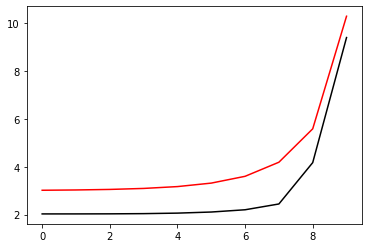

1400 99.00235202785264 9.094581555214832
[2.02476355 2.02524331 2.0280337  2.03662161 2.05773275 2.10383367
 2.1982288  2.44128393 4.17113909 9.40564901]


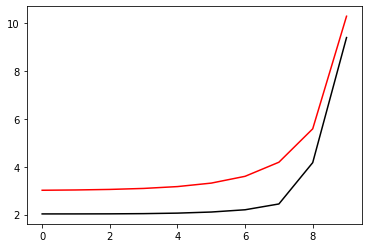

1500 99.00235120029862 9.094151046264772
[2.02478703 2.02526349 2.02804267 2.03660392 2.05766404 2.1036957
 2.1981026  2.44158883 4.17063342 9.40514649]


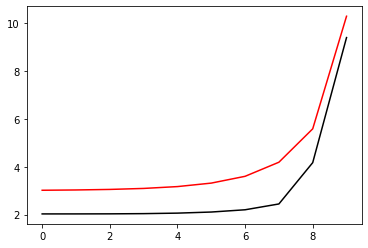

1600 99.0023503747752 9.093721049259527
[2.02481031 2.0252835  2.02805154 2.03658629 2.05759567 2.10355848
 2.1979772  2.44189288 4.17012834 9.40464398]


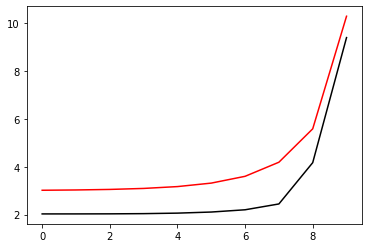

1700 99.00234955127078 9.093291562744586
[2.0248334  2.02530335 2.02806031 2.03656871 2.05752764 2.10342199
 2.19785259 2.44219607 4.16962386 9.40414147]


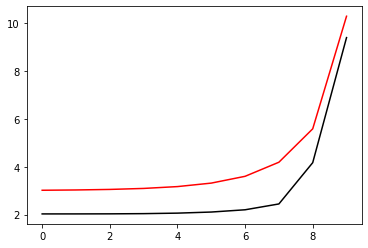

1800 99.00234872977384 9.092862585271963
[2.02485631 2.02532303 2.02806898 2.03655118 2.05745996 2.10328624
 2.19772876 2.44249842 4.16911996 9.40363895]


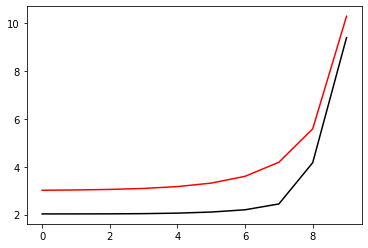

1900 99.00234791027289 9.092434115400163
[2.02487903 2.02534255 2.02807755 2.03653371 2.05739262 2.10315122
 2.19760572 2.44279992 4.16861666 9.40313644]


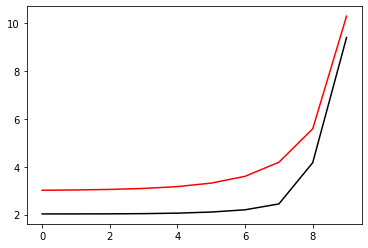

2000 99.00234709275657 9.092006151694095
[2.02490156 2.0253619  2.02808602 2.0365163  2.05732562 2.10301694
 2.19748346 2.44310058 4.16811394 9.40263392]


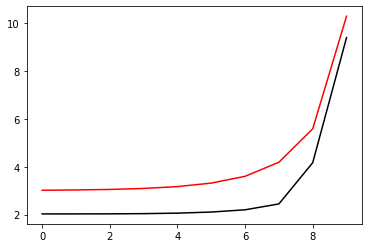

2100 99.00234627721358 9.09157869272511
[2.02492391 2.02538109 2.0280944  2.03649895 2.05725896 2.10288338
 2.19736197 2.4434004  4.16761181 9.40213141]


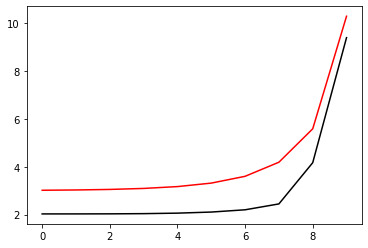

2200 99.00234546363272 9.091151737070888
[2.02494607 2.02540011 2.02810269 2.03648165 2.05719264 2.10275054
 2.19724126 2.44369939 4.16711027 9.4016289 ]


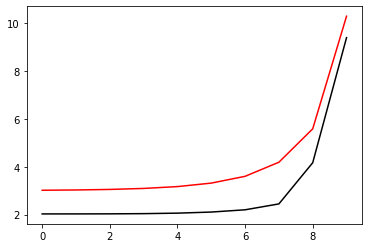

2300 99.00234465200286 9.09072528331546
[2.02496806 2.02541898 2.02811088 2.0364644  2.05712665 2.10261843
 2.19712133 2.44399753 4.16660931 9.40112638]


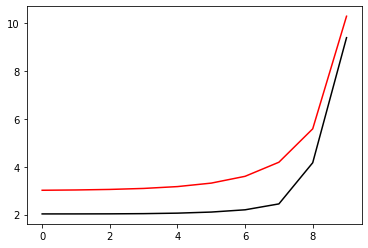

2400 99.00234384231294 9.090299330049143
[2.02498986 2.02543769 2.02811898 2.03644721 2.057061   2.10248703
 2.19700215 2.44429485 4.16610893 9.40062387]


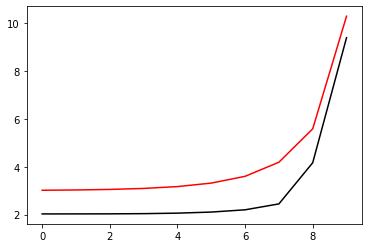

2500 99.00234303455201 9.089873875868472
[2.02501149 2.02545624 2.02812698 2.03643008 2.05699568 2.10235635
 2.19688375 2.44459134 4.16560913 9.40012136]


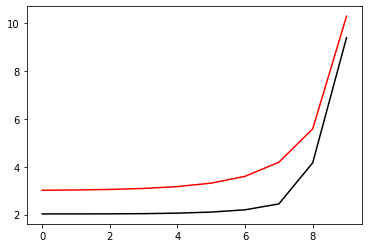

2600 99.00234222870914 9.08944891937622
[2.02503293 2.02547463 2.02813489 2.036413   2.05693069 2.10222638
 2.19676611 2.444887   4.16510992 9.39961884]


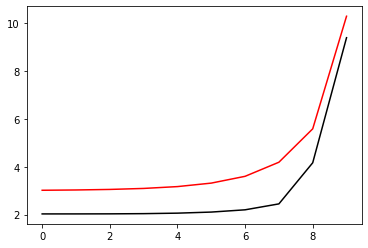

2700 99.00234142477355 9.089024459181317
[2.0250542  2.02549286 2.02814271 2.03639598 2.05686604 2.10209711
 2.19664922 2.44518184 4.16461128 9.39911633]


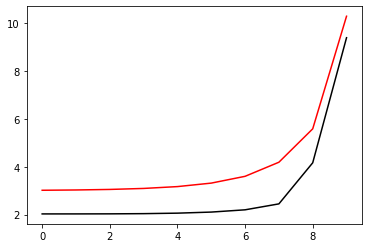

2800 99.00234062273445 9.08860049389885
[2.0250753  2.02551094 2.02815044 2.03637901 2.05680171 2.10196855
 2.19653309 2.44547585 4.16411322 9.39861382]


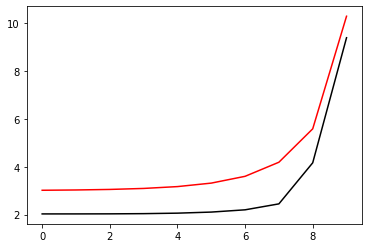

2900 99.00233982258125 9.088177022150003
[2.02509622 2.02552887 2.02815808 2.0363621  2.05673771 2.10184069
 2.19641771 2.44576905 4.16361574 9.39811131]


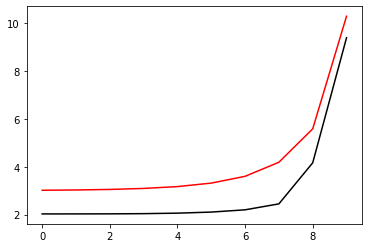

3000 99.0023390243033 9.087754042562013
[2.02511697 2.02554664 2.02816563 2.03634525 2.05667403 2.10171353
 2.19630309 2.44606142 4.16311883 9.39760879]


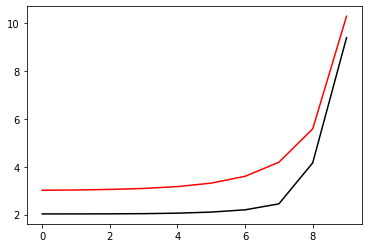

3100 99.00233822789009 9.087331553768141
[2.02513754 2.02556427 2.02817309 2.03632845 2.05661068 2.10158707
 2.1961892  2.44635299 4.1626225  9.39710628]


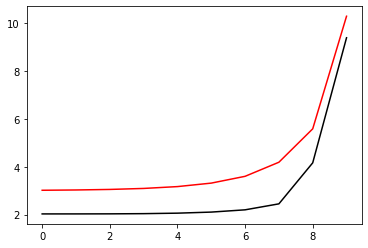

3200 99.0023374333312 9.086909554407667
[2.02515795 2.02558174 2.02818047 2.0363117  2.05654765 2.10146129
 2.19607607 2.44664374 4.16212674 9.39660377]


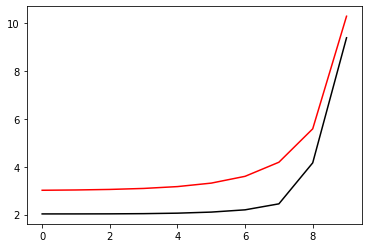

3300 99.00233664061629 9.086488043125808
[2.02517818 2.02559906 2.02818776 2.03629501 2.05648494 2.10133621
 2.19596367 2.44693369 4.16163155 9.39610126]


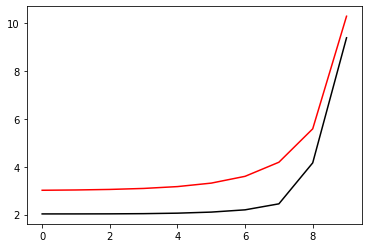

3400 99.00233584973503 9.086067018573694
[2.02519825 2.02561623 2.02819496 2.03627838 2.05642256 2.10121181
 2.19585201 2.44722282 4.16113693 9.39559876]


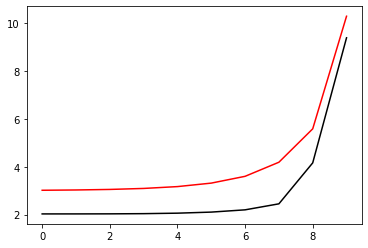

3500 99.00233506067721 9.085646479408387
[2.02521815 2.02563326 2.02820208 2.0362618  2.05636049 2.10108809
 2.19574108 2.44751116 4.16064289 9.39509625]


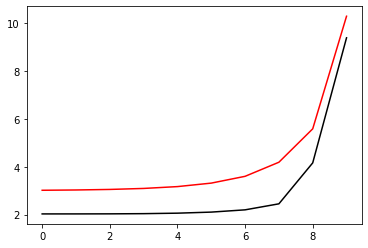

3600 99.0023342734327 9.085226424292758
[2.02523788 2.02565014 2.02820911 2.03624528 2.05629874 2.10096505
 2.19563089 2.44779869 4.1601494  9.39459374]


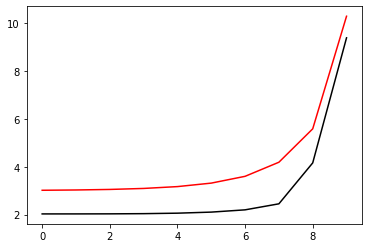

3700 99.0023334879914 9.084806851895516
[2.02525745 2.02566687 2.02821605 2.03622881 2.0562373  2.10084269
 2.19552142 2.44808542 4.15965649 9.39409123]


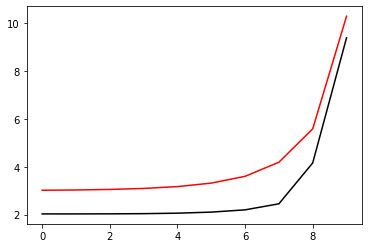

3800 99.00233270434332 9.08438776089116
[2.02527686 2.02568346 2.02822292 2.0362124  2.05617618 2.100721
 2.19541268 2.44837136 4.15916414 9.39358873]


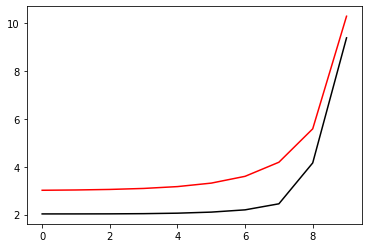

3900 99.00233192247853 9.083969149959911
[2.0252961  2.02569991 2.0282297  2.03619604 2.05611538 2.10059999
 2.19530466 2.4486565  4.15867236 9.39308623]


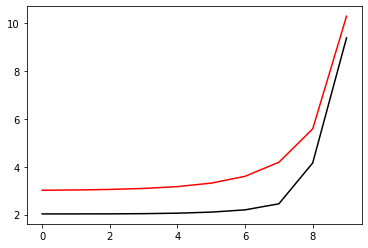

4000 99.00233114238718 9.083551017787755
[2.02531518 2.02571622 2.0282364  2.03617974 2.05605489 2.10047964
 2.19519736 2.44894085 4.15818113 9.39258372]


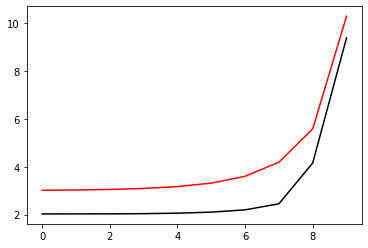

4100 99.00233036405943 9.08313336306632
[2.02533411 2.02573238 2.02824302 2.03616349 2.0559947  2.10035995
 2.19509078 2.44922441 4.15769047 9.39208122]


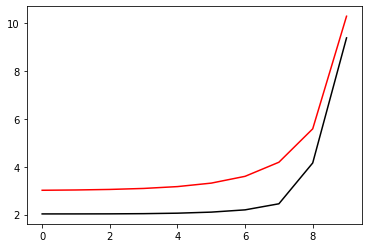

4200 99.0023295874856 9.0827161844929
[2.02535287 2.0257484  2.02824956 2.0361473  2.05593483 2.10024093
 2.1949849  2.44950718 4.15720037 9.39157872]


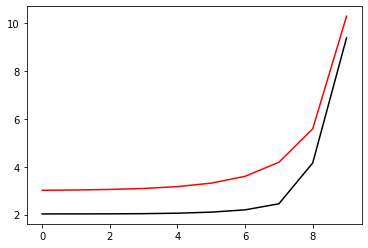

4300 99.00232881265602 9.082299480770399
[2.02537147 2.02576429 2.02825602 2.03613117 2.05587527 2.10012257
 2.19487974 2.44978917 4.15671083 9.39107622]


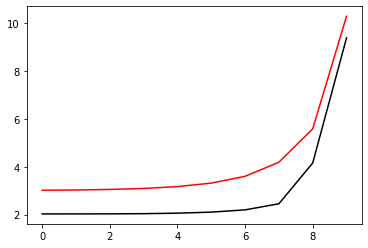

4400 99.00232803956109 9.08188325060733
[2.02538992 2.02578003 2.0282624  2.03611509 2.05581601 2.10000486
 2.19477529 2.45007038 4.15622185 9.39057372]


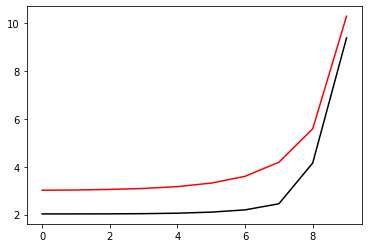

4500 99.00232726819132 9.08146749271774
[2.02540821 2.02579564 2.0282687  2.03609906 2.05575706 2.0998878
 2.19467154 2.45035081 4.15573342 9.39007122]


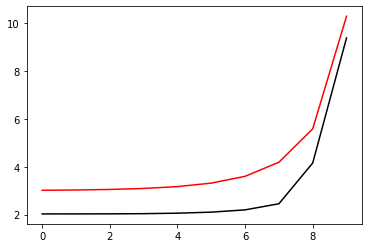

4600 99.00232649853723 9.081052205821194
[2.02542635 2.02581112 2.02827492 2.03608309 2.05569841 2.09977139
 2.1945685  2.45063046 4.15524555 9.38956873]


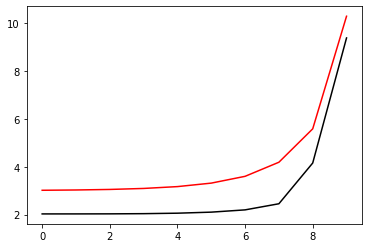

4700 99.00232573058943 9.080637388642753
[2.02544433 2.02582645 2.02828107 2.03606718 2.05564006 2.09965563
 2.19446615 2.45090934 4.15475824 9.38906623]


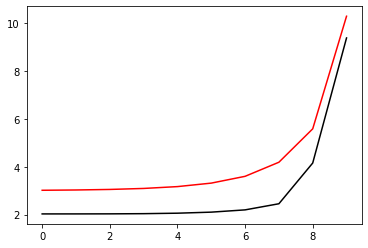

4800 99.00232496433861 9.080223039912935
[2.02546216 2.02584166 2.02828714 2.03605132 2.05558202 2.09954052
 2.1943645  2.45118744 4.15427147 9.38856374]


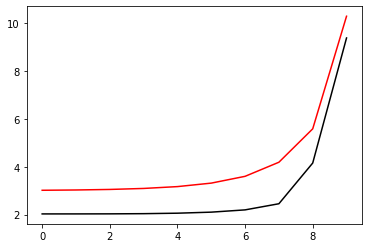

4900 99.0023241997755 9.079809158367684
[2.02547984 2.02585673 2.02829313 2.03603551 2.05552428 2.09942605
 2.19426354 2.45146477 4.15378526 9.38806125]


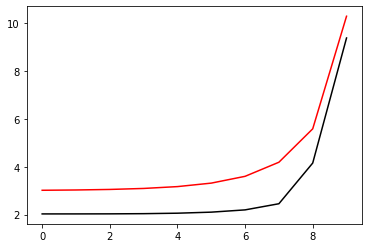

5000 99.00232343689093 9.079395742748329
[2.02549737 2.02587167 2.02829905 2.03601976 2.05546684 2.09931221
 2.19416327 2.45174134 4.1532996  9.38755876]


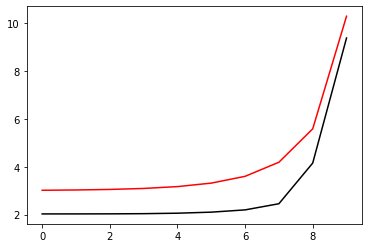

5100 99.00232267567573 9.078982791801572
[2.02551475 2.02588647 2.02830489 2.03600407 2.05540969 2.09919901
 2.19406369 2.45201714 4.15281449 9.38705627]


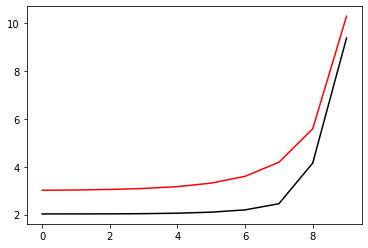

5200 99.00232191612088 9.078570304279438
[2.02553198 2.02590115 2.02831066 2.03598843 2.05535284 2.09908644
 2.19396479 2.45229218 4.15232993 9.38655379]


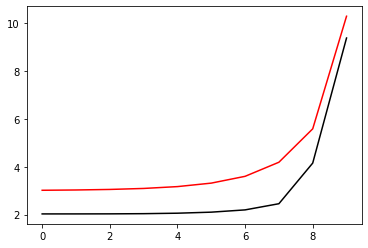

5300 99.00232115821737 9.078158278939277
[2.02554907 2.0259157  2.02831636 2.03597284 2.05529629 2.0989745
 2.19386657 2.45256645 4.15184591 9.3860513 ]


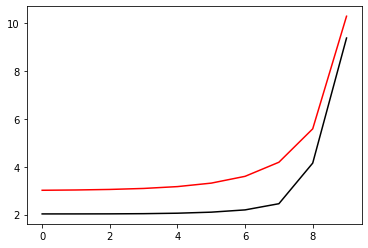

5400 99.00232040195623 9.077746714543684
[2.02556601 2.02593012 2.02832199 2.03595731 2.05524003 2.09886319
 2.19376904 2.45283997 4.15136244 9.38554882]


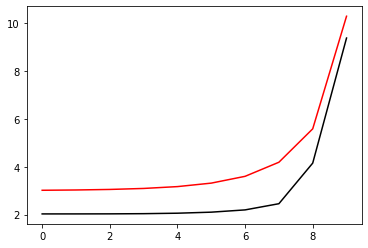

5500 99.0023196473286 9.077335609860517
[2.0255828  2.02594441 2.02832754 2.03594184 2.05518407 2.09875251
 2.19367217 2.45311274 4.15087952 9.38504634]


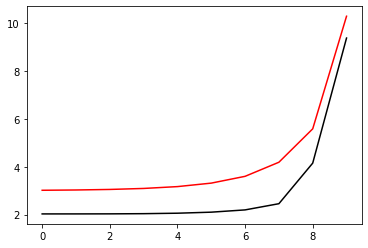

5600 99.0023188943257 9.07692496366282
[2.02559945 2.02595858 2.02833302 2.03592642 2.05512839 2.09864244
 2.19357599 2.45338474 4.15039714 9.38454386]


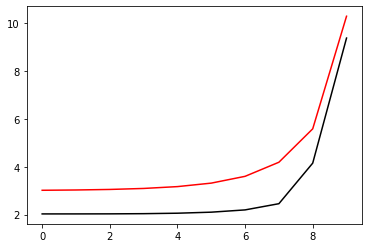

5700 99.00231814293872 9.076514774728846
[2.02561595 2.02597262 2.02833844 2.03591105 2.05507301 2.098533
 2.19348047 2.453656   4.1499153  9.38404138]


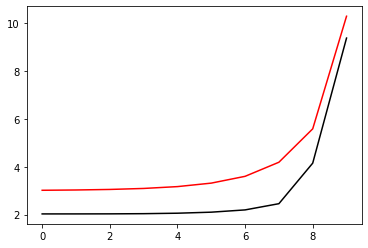

5800 99.00231739315899 9.076105041841974
[2.02563232 2.02598653 2.02834378 2.03589574 2.05501792 2.09842417
 2.19338562 2.45392651 4.14943401 9.38353891]


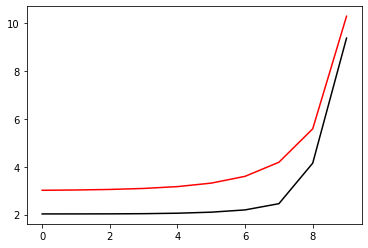

5900 99.0023166449779 9.075695763790733
[2.02564854 2.02600032 2.02834905 2.03588049 2.05496311 2.09831595
 2.19329143 2.45419627 4.14895325 9.38303643]


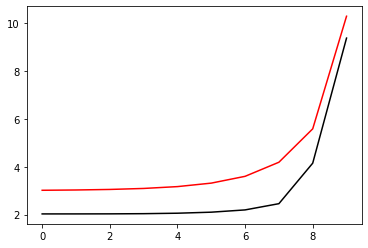

6000 99.00231589838684 9.07528693936872
[2.02566463 2.02601399 2.02835426 2.03586529 2.0549086  2.09820835
 2.19319791 2.45446529 4.14847303 9.38253396]


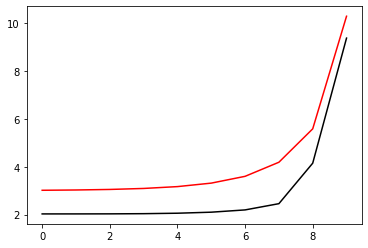

6100 99.00231515337732 9.074878567374606
[2.02568057 2.02602754 2.02835939 2.03585014 2.05485436 2.09810135
 2.19310504 2.45473357 4.14799336 9.38203149]


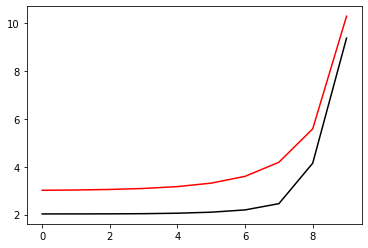

6200 99.0023144099409 9.074470646612108
[2.02569638 2.02604097 2.02836446 2.03583505 2.05480042 2.09799496
 2.19301283 2.45500111 4.14751421 9.38152903]


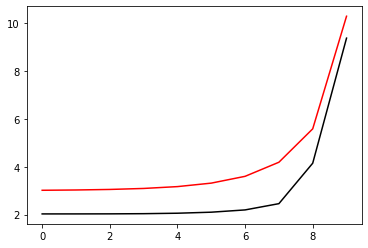

6300 99.00231366806914 9.074063175889934
[2.02571205 2.02605427 2.02836947 2.03582002 2.05474675 2.09788917
 2.19292128 2.45526791 4.14703561 9.38102656]


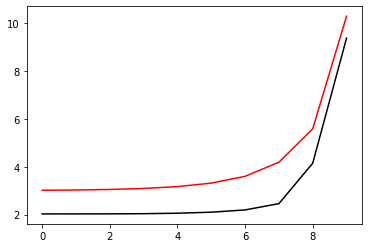

6400 99.00231292775374 9.073656154021783
[2.02572758 2.02606746 2.0283744  2.03580504 2.05469337 2.09778398
 2.19283037 2.45553397 4.14655754 9.3805241 ]


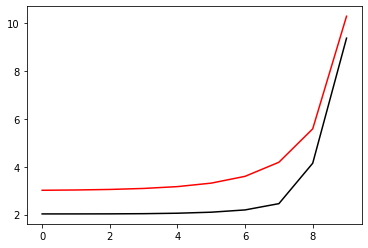

6500 99.0023121889864 9.073249579826305
[2.02574298 2.02608053 2.02837927 2.03579011 2.05464027 2.09767938
 2.19274012 2.4557993  4.14608    9.38002164]


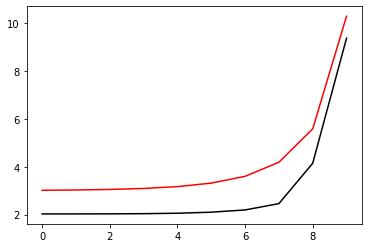

6600 99.00231145175891 9.072843452127078
[2.02575825 2.02609348 2.02838408 2.03577524 2.05458745 2.09757539
 2.19265051 2.4560639  4.14560299 9.37951918]


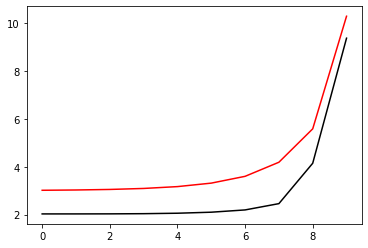

6700 99.00231071606308 9.072437769752566
[2.02577338 2.02610632 2.02838882 2.03576043 2.05453491 2.09747198
 2.19256154 2.45632778 4.14512652 9.37901673]


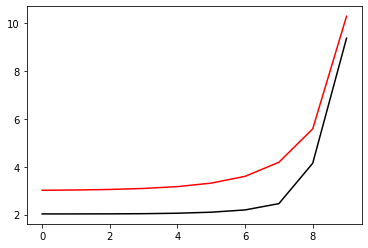

6800 99.00230998189085 9.072032531536092
[2.02578838 2.02611904 2.0283935  2.03574567 2.05448265 2.09736916
 2.19247321 2.45659092 4.14465058 9.37851428]


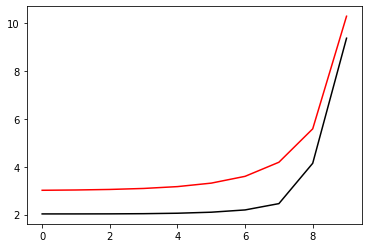

6900 99.0023092492341 9.07162773631584
[2.02580325 2.02613164 2.02839812 2.03573096 2.05443066 2.09726693
 2.19238552 2.45685334 4.14417516 9.37801183]


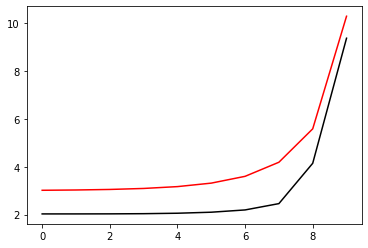

7000 99.00230851808486 9.071223382934798
[2.02581799 2.02614414 2.02840267 2.03571631 2.05437895 2.09716529
 2.19229847 2.45711504 4.14370027 9.37750938]


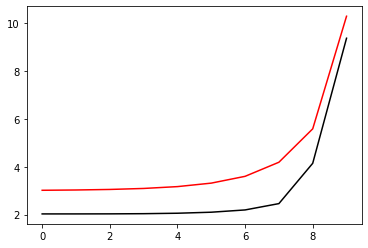

7100 99.0023077884352 9.070819470240735
[2.0258326  2.02615652 2.02840716 2.03570171 2.05432752 2.09706422
 2.19221204 2.45737603 4.14322591 9.37700694]


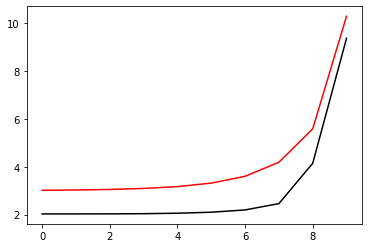

7200 99.00230706027723 9.070415997086204
[2.02584708 2.02616878 2.02841159 2.03568717 2.05427635 2.09696374
 2.19212625 2.45763629 4.14275208 9.37650449]


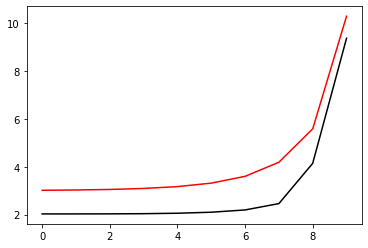

7300 99.0023063336031 9.070012962328452
[2.02586144 2.02618094 2.02841596 2.03567269 2.05422546 2.09686383
 2.19204108 2.45789584 4.14227877 9.37600206]


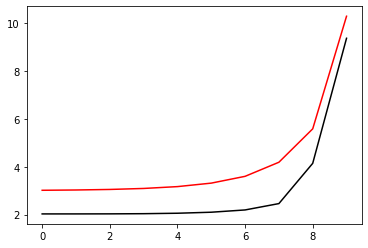

7400 99.00230560840502 9.069610364829478
[2.02587567 2.02619298 2.02842027 2.03565825 2.05417484 2.0967645
 2.19195654 2.45815468 4.14180598 9.37549962]


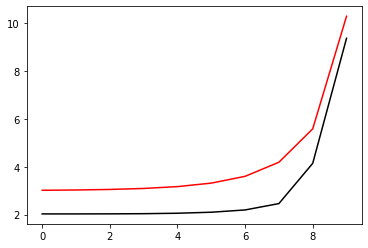

7500 99.00230488467528 9.069208203455926
[2.02588977 2.02620492 2.02842452 2.03564388 2.05412449 2.09666573
 2.19187262 2.4584128  4.14133372 9.37499719]


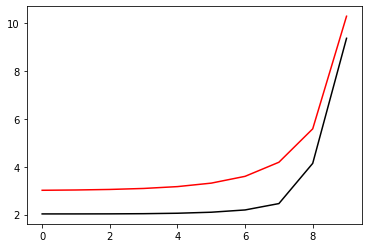

7600 99.0023041624062 9.068806477079107
[2.02590375 2.02621675 2.02842872 2.03562955 2.05407441 2.09656754
 2.19178932 2.45867022 4.14086198 9.37449476]


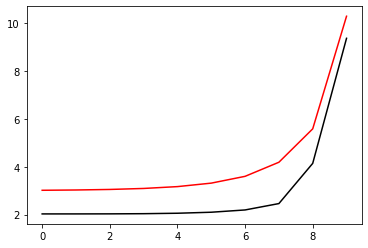

7700 99.00230344159017 9.06840518457498
[2.02591761 2.02622847 2.02843285 2.03561529 2.0540246  2.09646991
 2.19170663 2.45892693 4.14039075 9.37399233]


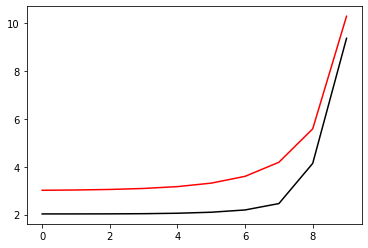

7800 99.00230272221958 9.068004324824079
[2.02593134 2.02624008 2.02843693 2.03560107 2.05397505 2.09637285
 2.19162456 2.45918294 4.13992005 9.3734899 ]


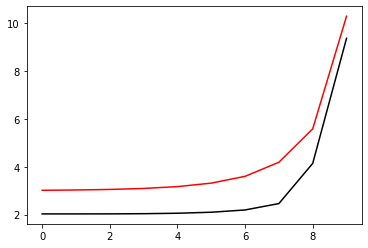

7900 99.00230200428696 9.067603896711526
[2.02594495 2.02625159 2.02844094 2.03558692 2.05392577 2.09627635
 2.1915431  2.45943824 4.13944986 9.37298748]


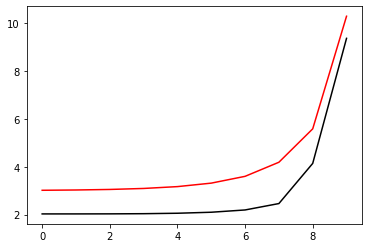

8000 99.00230128778479 9.067203899127001
[2.02595844 2.02626299 2.02844491 2.03557281 2.05387676 2.09618041
 2.19146224 2.45969285 4.1389802  9.37248507]


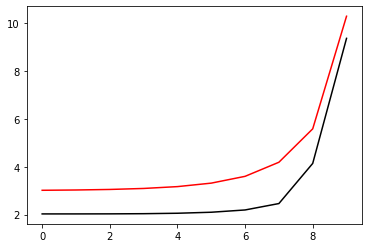

8100 99.00230057270569 9.066804330964706
[2.02597182 2.02627429 2.02844881 2.03555876 2.05382801 2.09608502
 2.191382   2.45994675 4.13851104 9.37198265]


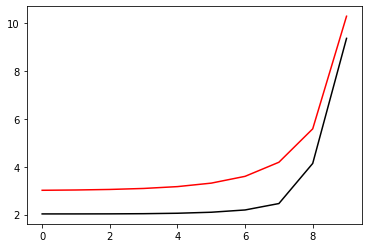

8200 99.00229985904228 9.066405191123344
[2.02598507 2.02628548 2.02845266 2.03554477 2.05377952 2.09599019
 2.19130235 2.46019997 4.13804241 9.37148024]


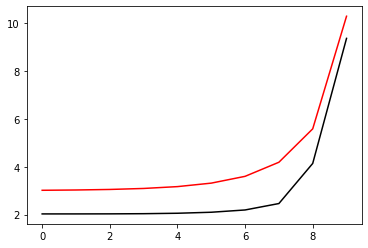

8300 99.00229914678727 9.066006478506111
[2.02599821 2.02629658 2.02845646 2.03553083 2.05373129 2.09589591
 2.19122331 2.46045249 4.13757428 9.37097783]


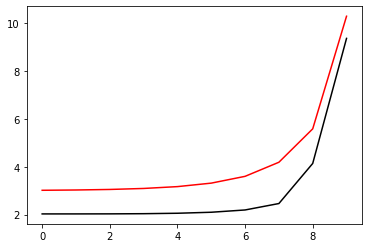

8400 99.00229843593335 9.065608192020639
[2.02601122 2.02630756 2.0284602  2.03551695 2.05368332 2.09580218
 2.19114486 2.46070431 4.13710667 9.37047543]


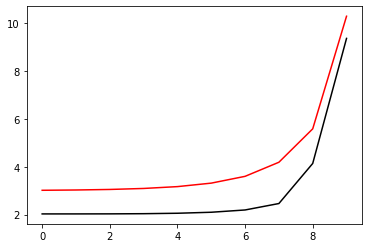

8500 99.00229772647332 9.065210330578987
[2.02602413 2.02631845 2.02846389 2.03550312 2.05363561 2.09570899
 2.19106702 2.46095545 4.13663957 9.36997302]


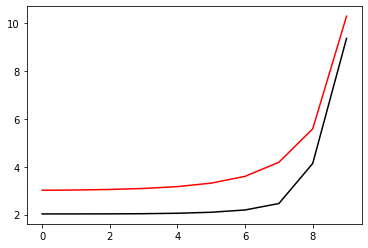

8600 99.00229701840001 9.064812893097642
[2.02603691 2.02632924 2.02846752 2.03548934 2.05358816 2.09561635
 2.19098976 2.4612059  4.13617298 9.36947063]


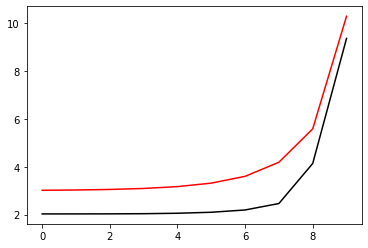

8700 99.0022963117063 9.06441587849745
[2.02604959 2.02633993 2.02847111 2.03547562 2.05354097 2.09552425
 2.19091309 2.46145567 4.1357069  9.36896823]


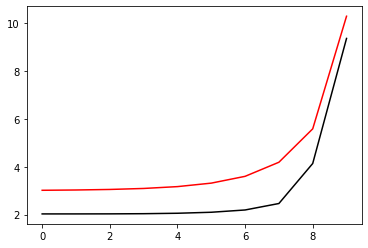

8800 99.00229560638515 9.064019285703603
[2.02606214 2.02635052 2.02847464 2.03546196 2.05349404 2.0954327
 2.19083702 2.46170475 4.13524133 9.36846584]


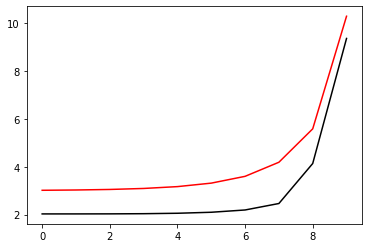

8900 99.00229490242948 9.06362311364566
[2.02607459 2.02636101 2.02847812 2.03544835 2.05344736 2.09534168
 2.19076153 2.46195316 4.13477627 9.36796345]


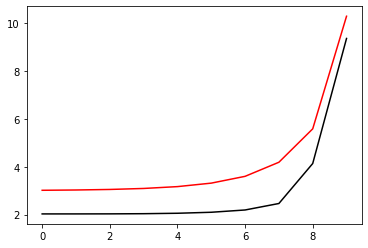

9000 99.00229419983235 9.063227361257464
[2.02608693 2.02637141 2.02848154 2.03543479 2.05340093 2.09525119
 2.19068662 2.46220088 4.13431171 9.36746107]


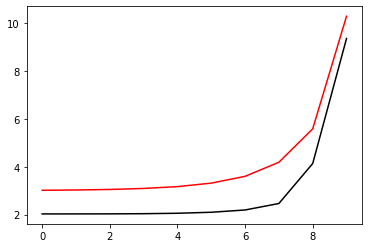

9100 99.00229349858682 9.062832027477159
[2.02609915 2.0263817  2.02848492 2.03542129 2.05335476 2.09516124
 2.19061229 2.46244793 4.13384766 9.36695869]


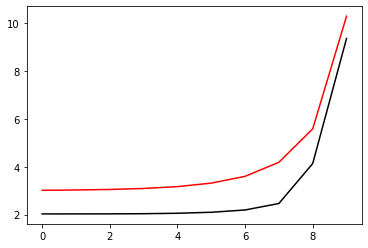

9200 99.002292798686 9.062437111247133
[2.02611126 2.02639191 2.02848825 2.03540784 2.05330884 2.09507182
 2.19053854 2.4626943  4.13338411 9.36645631]


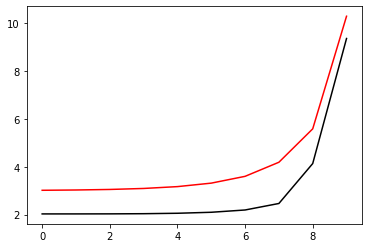

9300 99.0022921001231 9.06204261151403
[2.02612327 2.02640202 2.02849153 2.03539445 2.05326317 2.09498292
 2.19046537 2.46294001 4.13292107 9.36595394]


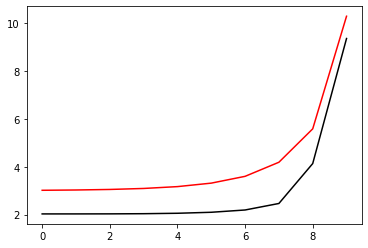

9400 99.00229140289125 9.061648527228707
[2.02613516 2.02641203 2.02849476 2.03538111 2.05321775 2.09489456
 2.19039277 2.46318504 4.13245853 9.36545157]


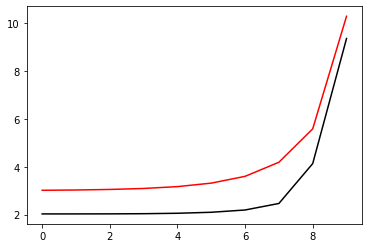

9500 99.00229070698379 9.061254857346205
[2.02614695 2.02642195 2.02849794 2.03536783 2.05317258 2.09480671
 2.19032074 2.4634294  4.13199649 9.3649492 ]


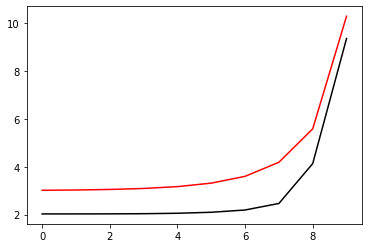

9600 99.00229001239396 9.060861600825751
[2.02615863 2.02643178 2.02850107 2.0353546  2.05312766 2.09471939
 2.19024928 2.4636731  4.13153495 9.36444684]


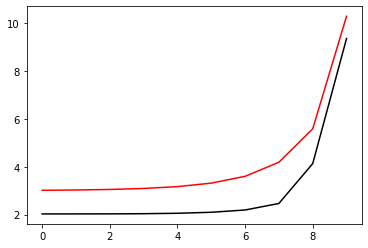

9700 99.0022893191151 9.060468756630698
[2.02617021 2.02644151 2.02850416 2.03534143 2.05308298 2.09463258
 2.19017838 2.46391613 4.13107391 9.36394448]


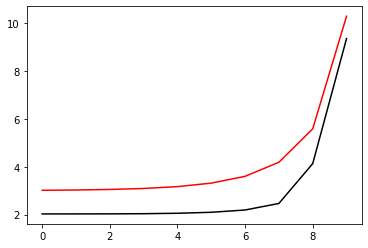

9800 99.00228862714066 9.060076323728559
[2.02618168 2.02645116 2.0285072  2.03532831 2.05303855 2.0945463
 2.19010805 2.4641585  4.13061337 9.36344213]


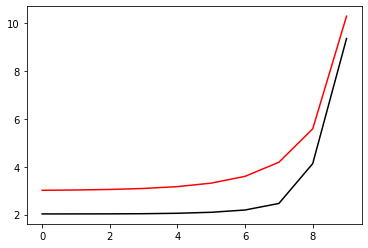

9900 99.00228793646403 9.059684301090918
[2.02619305 2.02646071 2.02851019 2.03531524 2.05299437 2.09446052
 2.19003828 2.46440021 4.13015332 9.36293978]


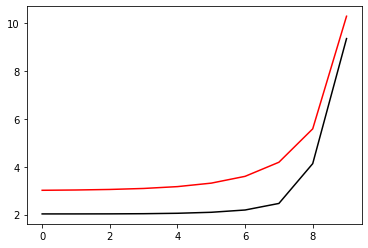

10000 99.0022872470787 9.05929268769345
[2.02620431 2.02647018 2.02851314 2.03530224 2.05295043 2.09437526
 2.18996907 2.46464126 4.12969377 9.36243743]


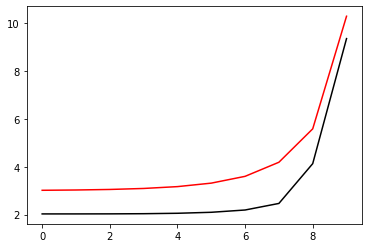

In [66]:
optimizer=tf.optimizers.SGD(learning_rate=0.01)
for i in range (1, 10001):
    run()
    if i%100==0: print(i, Error_func(h, m2_2).numpy(), m2_2.numpy()), print(h.numpy()), plt.plot(h_real, 'r-'), plt.plot(h.numpy(), 'k-'), plt.show()

100 99.00228655897818 9.058901482515898
[2.02621547 2.02647956 2.02851604 2.03528928 2.05290674 2.09429051
 2.18990042 2.46488166 4.12923472 9.36193509]


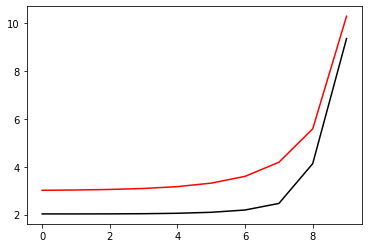

200 99.00228587215607 9.05851068454203
[2.02622653 2.02648885 2.0285189  2.03527638 2.05286329 2.09420627
 2.18983231 2.4651214  4.12877616 9.36143276]


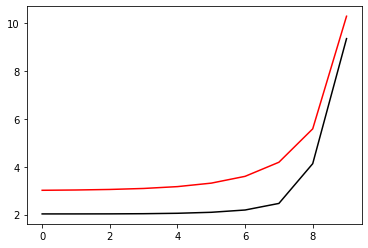

300 99.00228518660596 9.058120292759655
[2.02623749 2.02649805 2.02852171 2.03526353 2.05282008 2.09412253
 2.18976476 2.4653605  4.12831809 9.36093042]


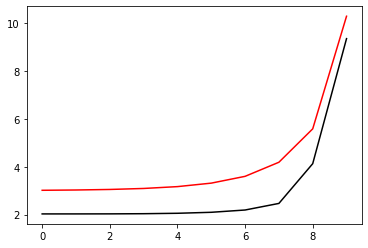

400 99.0022845023215 9.057730306160545
[2.02624835 2.02650716 2.02852448 2.03525074 2.05277711 2.0940393
 2.18969776 2.46559894 4.12786052 9.36042809]


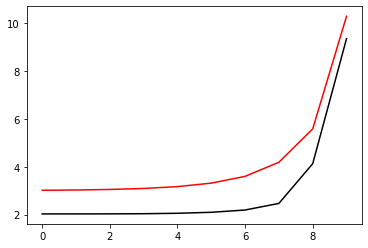

500 99.00228381929635 9.057340723740456
[2.02625911 2.02651619 2.02852721 2.03523801 2.05273438 2.09395656
 2.18963131 2.46583673 4.12740343 9.35992577]


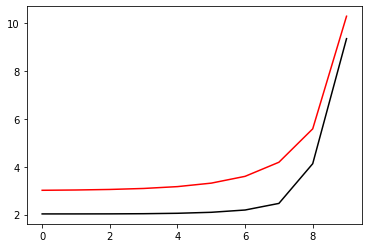

600 99.00228313752433 9.056951544499114
[2.02626977 2.02652514 2.02852989 2.03522532 2.05269189 2.09387433
 2.1895654  2.46607388 4.12694684 9.35942345]


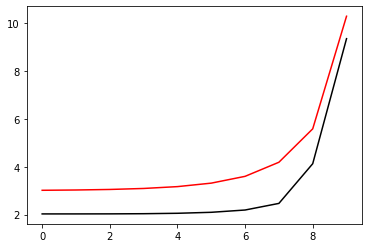

700 99.00228245699914 9.056562767440159
[2.02628033 2.026534   2.02853253 2.0352127  2.05264964 2.09379259
 2.18950004 2.46631038 4.12649074 9.35892113]


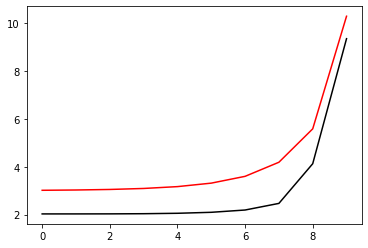

800 99.00228177771463 9.056174391571147
[2.0262908  2.02654277 2.02853513 2.03520012 2.05260762 2.09371135
 2.18943521 2.46654624 4.12603512 9.35841882]


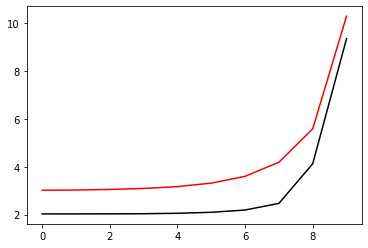

900 99.00228109966467 9.055786415903519
[2.02630117 2.02655146 2.02853769 2.03518761 2.05256584 2.0936306
 2.18937092 2.46678146 4.12557999 9.35791652]


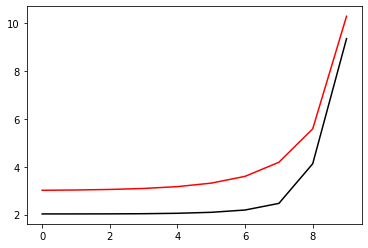

1000 99.00228042284314 9.055398839452588
[2.02631144 2.02656007 2.02854021 2.03517514 2.0525243  2.09355034
 2.18930717 2.46701604 4.12512535 9.35741421]


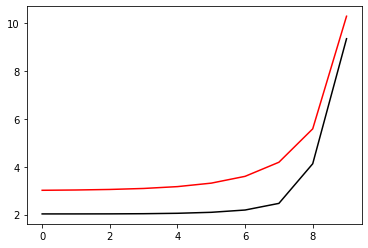

1100 99.00227974724397 9.05501166123751
[2.02632162 2.0265686  2.02854269 2.03516273 2.05248298 2.09347057
 2.18924395 2.46724999 4.12467119 9.35691192]


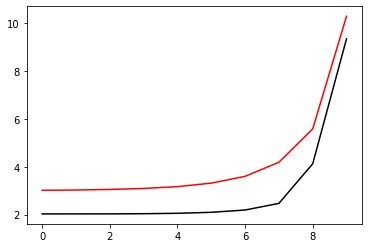

1200 99.00227907286119 9.054624880281281
[2.02633171 2.02657705 2.02854513 2.03515038 2.05244191 2.09339128
 2.18918126 2.4674833  4.12421752 9.35640962]


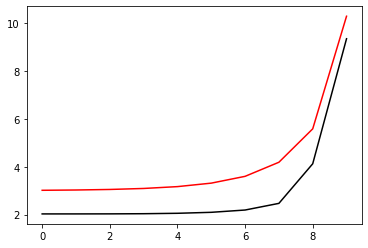

1300 99.00227839968879 9.054238495610694
[2.0263417  2.02658542 2.02854753 2.03513808 2.05240106 2.09331248
 2.18911909 2.46771598 4.12376433 9.35590734]


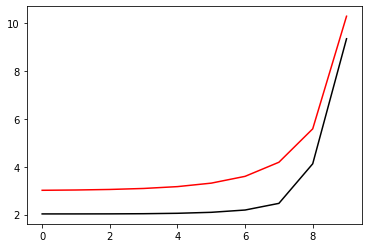

1400 99.00227772772081 9.053852506256343
[2.0263516  2.02659371 2.02854989 2.03512583 2.05236045 2.09323416
 2.18905746 2.46794803 4.12331163 9.35540505]


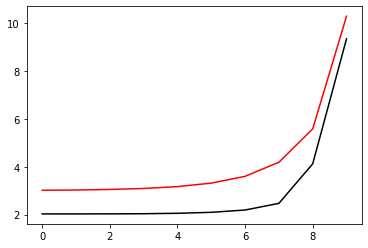

1500 99.00227705695141 9.05346691125258
[2.02636141 2.02660192 2.02855221 2.03511364 2.05232007 2.09315632
 2.18899635 2.46817945 4.1228594  9.35490277]


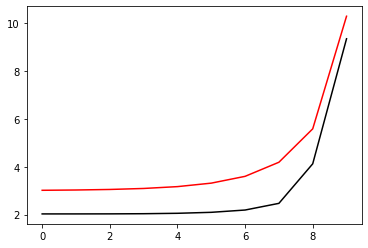

1600 99.00227638737468 9.05308170963749
[2.02637113 2.02661005 2.02855449 2.03510151 2.05227992 2.09307896
 2.18893576 2.46841024 4.12240766 9.3544005 ]


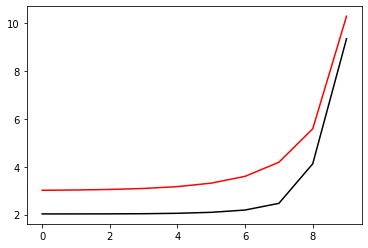

1700 99.0022757189848 9.052696900452906
[2.02638076 2.0266181  2.02855674 2.03508943 2.05223999 2.09300208
 2.18887569 2.46864041 4.12195639 9.35389823]


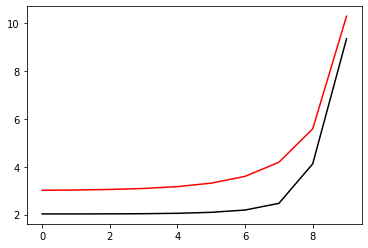

1800 99.00227505177601 9.052312482744378
[2.0263903  2.02662608 2.02855895 2.0350774  2.0522003  2.09292566
 2.18881613 2.46886996 4.1215056  9.35339597]


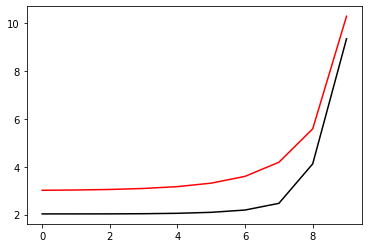

1900 99.00227438574257 9.051928455561132
[2.02639975 2.02663398 2.02856112 2.03506543 2.05216083 2.09284972
 2.18875709 2.46909888 4.1210553  9.35289371]


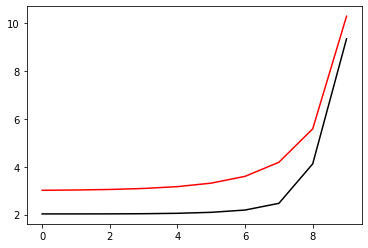

2000 99.00227372087873 9.051544817956055
[2.02640911 2.02664181 2.02856326 2.03505351 2.05212159 2.09277425
 2.18869857 2.46932719 4.12060546 9.35239145]


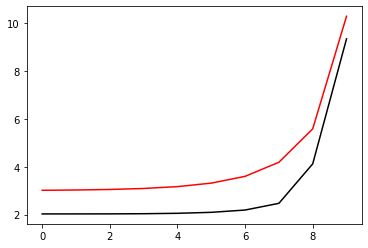

2100 99.00227305717887 9.051161568985696
[2.02641839 2.02664956 2.02856536 2.03504165 2.05208257 2.09269925
 2.18864055 2.46955488 4.12015611 9.35188921]


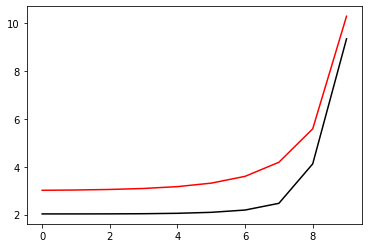

2200 99.00227239463732 9.050778707710233
[2.02642757 2.02665724 2.02856743 2.03502984 2.05204378 2.09262471
 2.18858304 2.46978196 4.11970723 9.35138696]


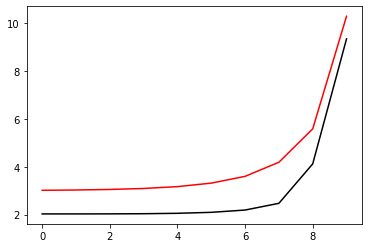

2300 99.00227173324849 9.050396233193469
[2.02643668 2.02666484 2.02856946 2.03501808 2.05200521 2.09255064
 2.18852604 2.47000842 4.11925882 9.35088472]


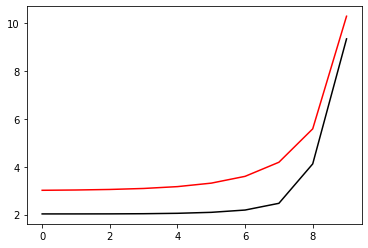

2400 99.00227107300684 9.05001414450278
[2.0264457  2.02667237 2.02857146 2.03500638 2.05196687 2.09247702
 2.18846954 2.47023427 4.11881088 9.35038249]


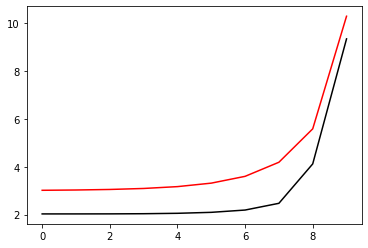

2500 99.00227041390683 9.049632440709123
[2.02645463 2.02667983 2.02857342 2.03499474 2.05192874 2.09240387
 2.18841354 2.47045951 4.11836342 9.34988026]


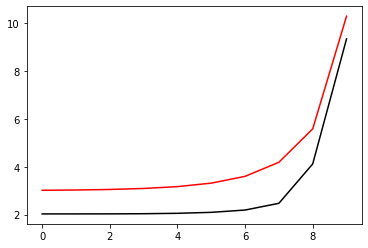

2600 99.00226975594298 9.049251120887018
[2.02646348 2.02668722 2.02857535 2.03498315 2.05189084 2.09233118
 2.18835805 2.47068414 4.11791643 9.34937804]


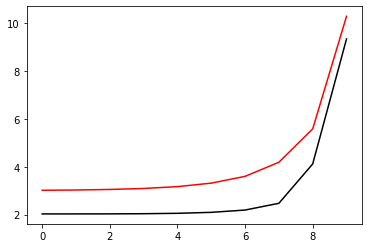

2700 99.00226909910982 9.04887018411452
[2.02647225 2.02669454 2.02857725 2.03497161 2.05185316 2.09225894
 2.18830305 2.47090817 4.11746991 9.34887582]


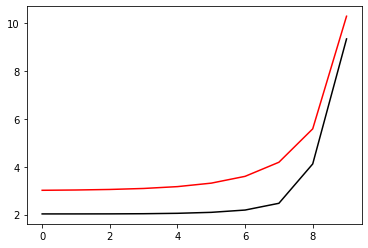

2800 99.00226844340197 9.048489629473206
[2.02648093 2.02670178 2.02857912 2.03496013 2.0518157  2.09218715
 2.18824854 2.47113159 4.11702385 9.34837361]


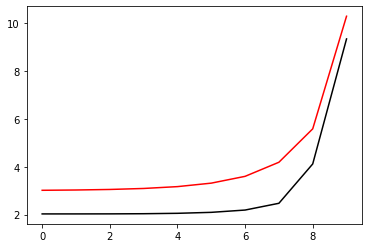

2900 99.00226778881404 9.048109456048149
[2.02648954 2.02670896 2.02858095 2.0349487  2.05177845 2.09211582
 2.18819453 2.47135441 4.11657827 9.3478714 ]


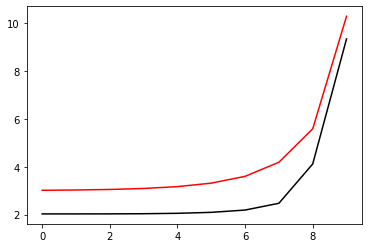

3000 99.00226713534067 9.047729662927916
[2.02649806 2.02671607 2.02858275 2.03493733 2.05174143 2.09204493
 2.18814101 2.47157663 4.11613315 9.3473692 ]


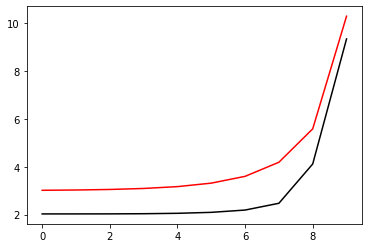

3100 99.00226648297657 9.047350249204525
[2.02650651 2.02672311 2.02858453 2.03492601 2.05170462 2.09197449
 2.18808797 2.47179825 4.1156885  9.346867  ]


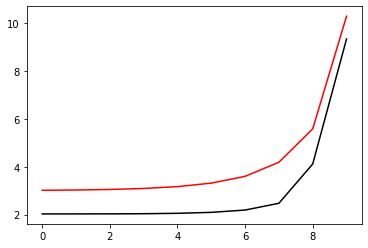

3200 99.00226583171644 9.046971213973455
[2.02651487 2.02673008 2.02858627 2.03491475 2.05166803 2.0919045
 2.18803543 2.47201928 4.11524431 9.34636481]


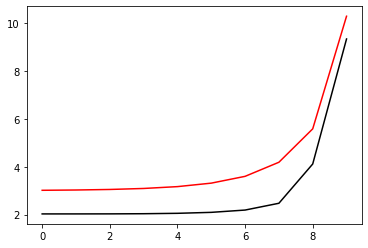

3300 99.00226518155506 9.0465925563336
[2.02652316 2.02673698 2.02858798 2.03490354 2.05163165 2.09183496
 2.18798337 2.47223971 4.11480059 9.34586263]


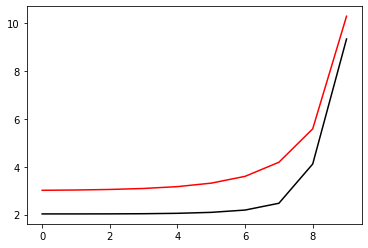

3400 99.0022645324872 9.046214275387284
[2.02653136 2.02674382 2.02858966 2.03489239 2.05159549 2.09176585
 2.18793179 2.47245954 4.11435734 9.34536045]


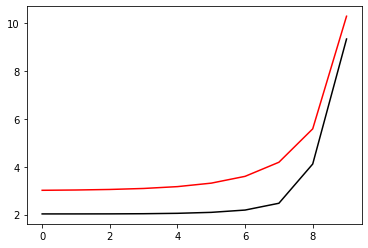

3500 99.00226388450773 9.045836370240215
[2.0265395  2.02675059 2.02859131 2.03488129 2.05155954 2.09169719
 2.18788069 2.47267879 4.11391454 9.34485828]


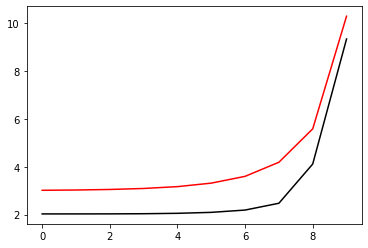

3600 99.00226323761146 9.045458840001476
[2.02654755 2.0267573  2.02859293 2.03487024 2.05152381 2.09162896
 2.18783006 2.47289745 4.11347221 9.34435611]


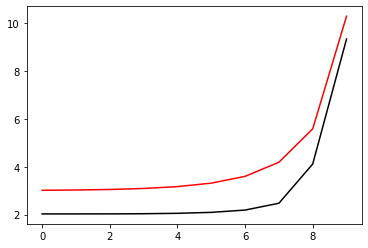

3700 99.0022625917933 9.045081683783517
[2.02655553 2.02676394 2.02859453 2.03485925 2.05148829 2.09156117
 2.18777992 2.47311552 4.11303034 9.34385395]


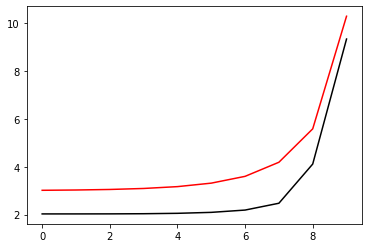

3800 99.0022619470482 9.044704900702124
[2.02656343 2.02677052 2.02859609 2.03484832 2.05145298 2.09149382
 2.18773025 2.473333   4.11258893 9.34335179]


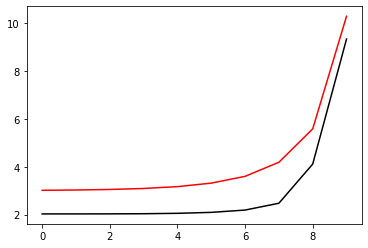

3900 99.00226130337111 9.044328489876419
[2.02657126 2.02677704 2.02859763 2.03483743 2.05141788 2.09142689
 2.18768104 2.4735499  4.11214798 9.34284964]


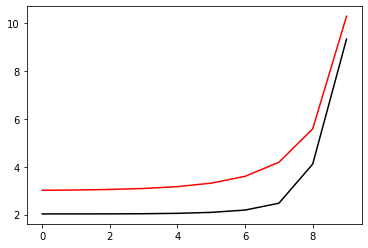

4000 99.00226066075699 9.04395245042881
[2.02657901 2.02678349 2.02859914 2.03482661 2.05138298 2.0913604
 2.18763231 2.47376621 4.11170748 9.3423475 ]


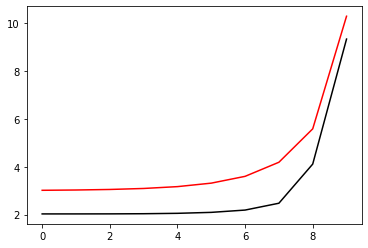

4100 99.0022600192009 9.043576781485031
[2.02658669 2.02678988 2.02860063 2.03481583 2.0513483  2.09129434
 2.18758405 2.47398195 4.11126745 9.34184536]


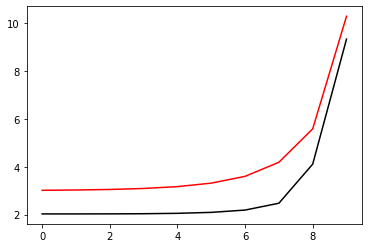

4200 99.00225937869787 9.043201482174062
[2.0265943  2.02679621 2.02860209 2.03480512 2.05131383 2.0912287
 2.18753625 2.47419711 4.11082787 9.34134323]


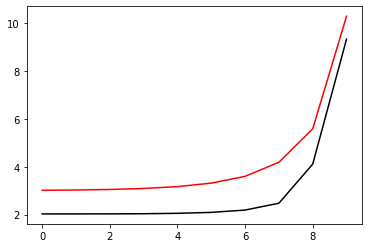

4300 99.00225873924303 9.04282655162816
[2.02660184 2.02680248 2.02860352 2.03479445 2.05127957 2.09116349
 2.18748892 2.47441169 4.11038874 9.3408411 ]


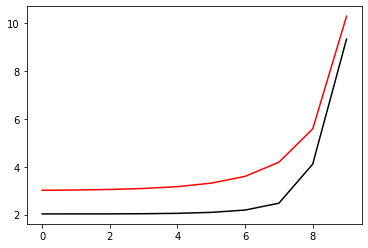

4400 99.00225810083145 9.04245198898281
[2.0266093  2.02680869 2.02860492 2.03478384 2.05124551 2.0910987
 2.18744205 2.47462569 4.10995007 9.34033898]


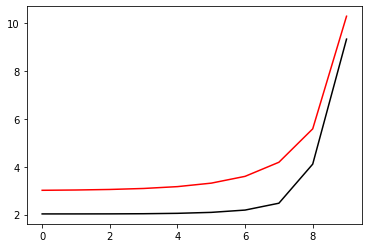

4500 99.00225746345832 9.042077793376729
[2.0266167  2.02681484 2.02860631 2.03477329 2.05121165 2.09103434
 2.18739563 2.47483912 4.10951186 9.33983686]


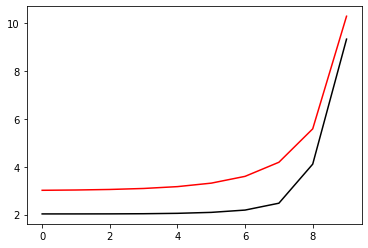

4600 99.0022568271188 9.041703963951855
[2.02662402 2.02682093 2.02860766 2.03476279 2.05117801 2.09097039
 2.18734968 2.47505198 4.1090741  9.33933476]


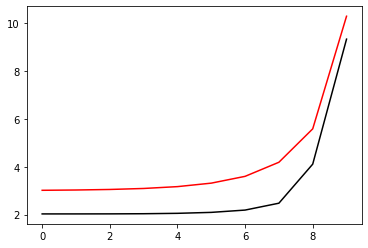

4700 99.00225619180812 9.041330499853288
[2.02663128 2.02682696 2.02860899 2.03475234 2.05114456 2.09090687
 2.18730418 2.47526427 4.10863678 9.33883265]


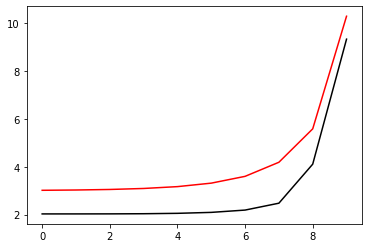

4800 99.0022555575215 9.040957400229345
[2.02663846 2.02683293 2.0286103  2.03474195 2.05111133 2.09084376
 2.18725913 2.47547599 4.10819993 9.33833056]


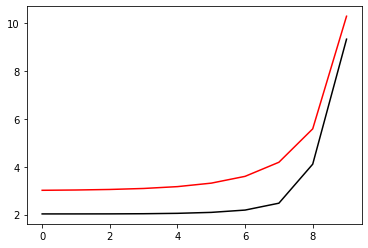

4900 99.00225492425423 9.040584664231456
[2.02664558 2.02683884 2.02861159 2.03473161 2.05107829 2.09078106
 2.18721454 2.47568715 4.10776352 9.33782847]


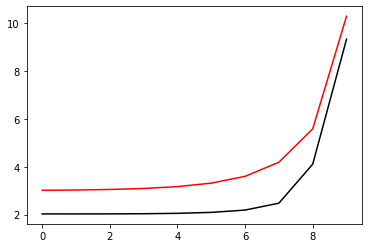

5000 99.00225429200162 9.040212291014234
[2.02665263 2.0268447  2.02861285 2.03472133 2.05104546 2.09071878
 2.18717039 2.47589774 4.10732756 9.33732639]


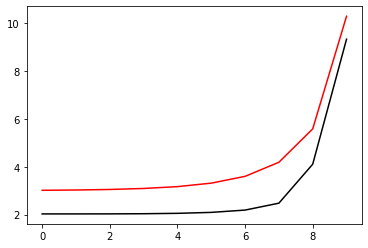

5100 99.00225366075897 9.039840279735401
[2.02665962 2.0268505  2.02861409 2.0347111  2.05101283 2.0906569
 2.18712669 2.47610776 4.10689205 9.33682431]


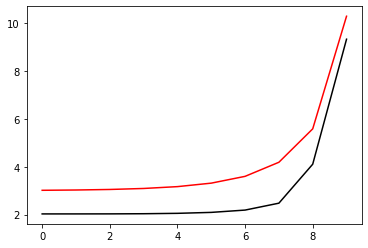

5200 99.00225303052171 9.039468629555808
[2.02666653 2.02685625 2.0286153  2.03470093 2.05098039 2.09059544
 2.18708344 2.47631723 4.10645698 9.33632224]


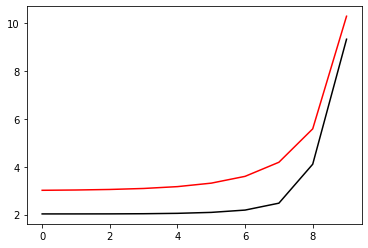

5300 99.00225240128516 9.039097339639397
[2.02667339 2.02686194 2.0286165  2.03469081 2.05094816 2.09053438
 2.18704063 2.47652613 4.10602237 9.33582017]


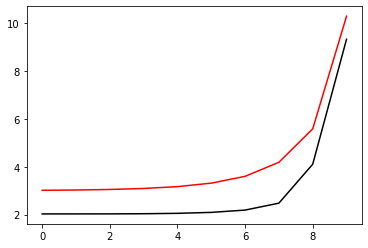

5400 99.0022517730448 9.038726409153188
[2.02668017 2.02686757 2.02861767 2.03468075 2.05091613 2.09047373
 2.18699826 2.47673448 4.1055882  9.33531812]


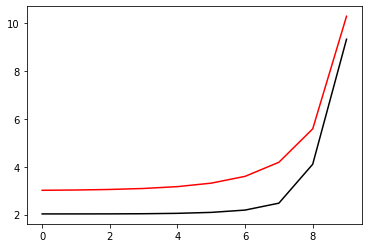

5500 99.00225114579605 9.038355837267261
[2.0266869  2.02687316 2.02861882 2.03467074 2.0508843  2.09041349
 2.18695634 2.47694227 4.10515447 9.33481607]


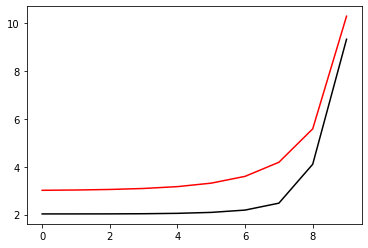

5600 99.00225051953443 9.03798562315477
[2.02669355 2.02687868 2.02861995 2.03466078 2.05085266 2.09035364
 2.18691485 2.4771495  4.10472119 9.33431402]


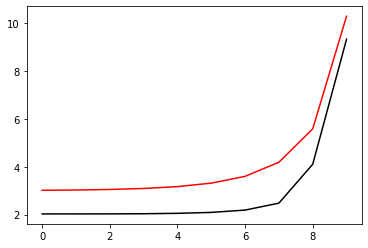

5700 99.00224989425539 9.037615765991895
[2.02670015 2.02688416 2.02862106 2.03465088 2.05082123 2.0902942
 2.18687379 2.47735619 4.10428836 9.33381198]


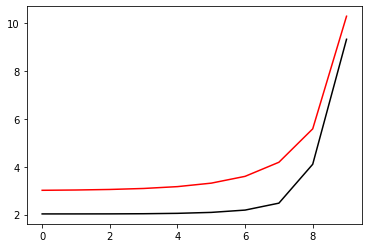

5800 99.0022492699545 9.03724626495781
[2.02670668 2.02688958 2.02862215 2.03464103 2.05078998 2.09023515
 2.18683317 2.47756232 4.10385596 9.33330995]


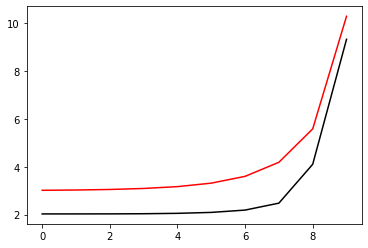

5900 99.00224864662735 9.036877119234733
[2.02671315 2.02689495 2.02862322 2.03463124 2.05075894 2.09017651
 2.18679298 2.4777679  4.10342401 9.33280793]


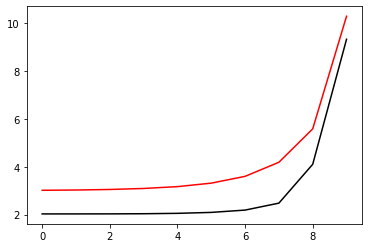

6000 99.0022480242695 9.036508328007864
[2.02671956 2.02690027 2.02862427 2.0346215  2.05072809 2.09011825
 2.18675322 2.47797293 4.1029925  9.33230591]


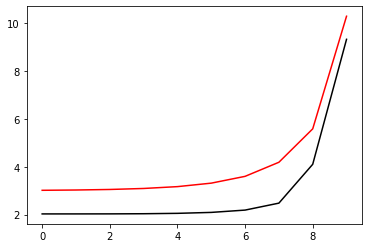

6100 99.00224740287658 9.036139890465366
[2.02672591 2.02690554 2.02862531 2.03461182 2.05069743 2.0900604
 2.18671389 2.47817742 4.10256143 9.3318039 ]


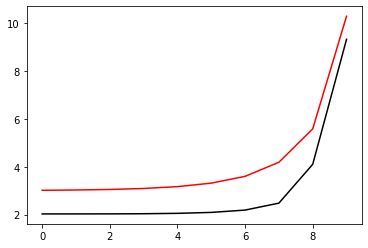

6200 99.00224678244425 9.035771805798353
[2.0267322  2.02691076 2.02862632 2.03460219 2.05066697 2.09000293
 2.18667499 2.47838136 4.1021308  9.3313019 ]


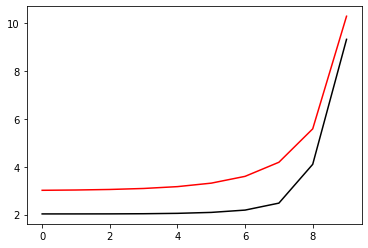

6300 99.00224616296818 9.035404073200924
[2.02673843 2.02691593 2.02862731 2.03459261 2.0506367  2.08994585
 2.18663651 2.47858476 4.1017006  9.3307999 ]


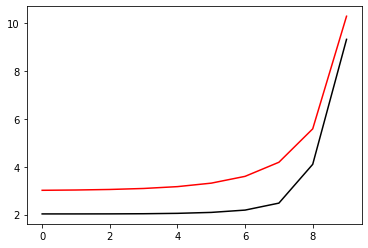

6400 99.00224554444408 9.035036691870085
[2.0267446  2.02692104 2.02862829 2.03458309 2.05060662 2.08988917
 2.18659845 2.47878762 4.10127085 9.33029791]


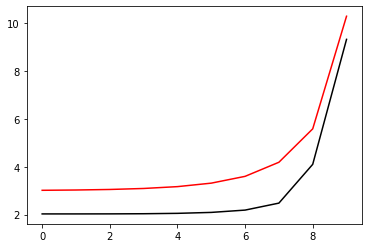

6500 99.00224492686766 9.034669661005749
[2.02675071 2.02692612 2.02862925 2.03457363 2.05057674 2.08983287
 2.18656081 2.47898993 4.10084153 9.32979593]


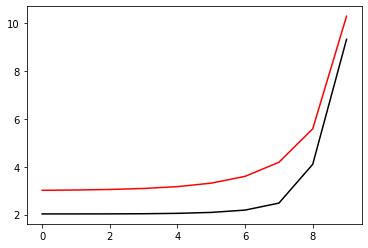

6600 99.00224431023473 9.034302979810757
[2.02675676 2.02693114 2.02863019 2.03456421 2.05054704 2.08977695
 2.18652359 2.47919171 4.10041265 9.32929395]


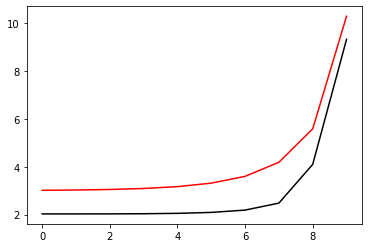

6700 99.00224369454102 9.033936647490828
[2.02676276 2.02693611 2.02863112 2.03455486 2.05051754 2.08972142
 2.18648679 2.47939296 4.0999842  9.32879198]


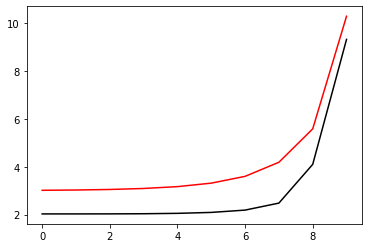

6800 99.00224307978239 9.033570663254563
[2.0267687  2.02694104 2.02863203 2.03454555 2.05048822 2.08966627
 2.1864504  2.47959366 4.09955619 9.32829002]


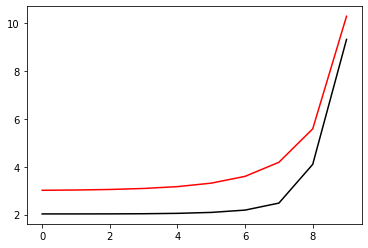

6900 99.00224246595464 9.033205026313397
[2.02677458 2.02694592 2.02863292 2.03453631 2.05045909 2.08961151
 2.18641443 2.47979384 4.09912861 9.32778807]


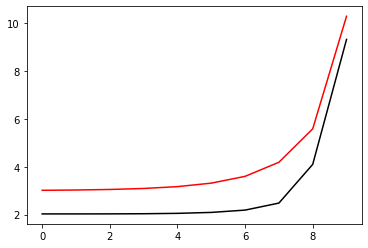

7000 99.00224185305363 9.032839735881636
[2.02678041 2.02695075 2.0286338  2.03452711 2.05043016 2.08955712
 2.18637886 2.47999348 4.09870146 9.32728612]


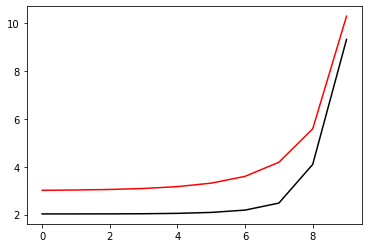

7100 99.00224124107528 9.032474791176428
[2.02678618 2.02695554 2.02863466 2.03451797 2.05040141 2.08950311
 2.18634371 2.48019259 4.09827475 9.32678418]


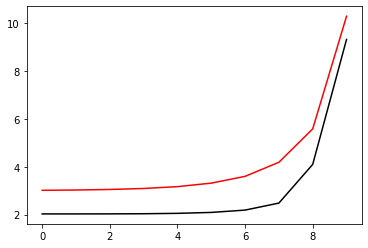

7200 99.0022406300155 9.0321101914177
[2.0267919  2.02696029 2.02863551 2.03450889 2.05037284 2.08944947
 2.18630896 2.48039118 4.09784846 9.32628224]


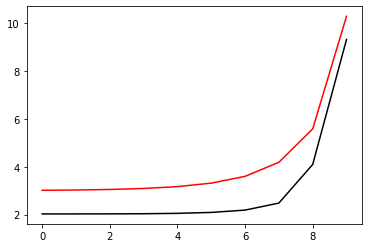

7300 99.00224001987023 9.031745935828216
[2.02679756 2.02696499 2.02863634 2.03449985 2.05034446 2.08939621
 2.18627462 2.48058924 4.09742261 9.32578032]


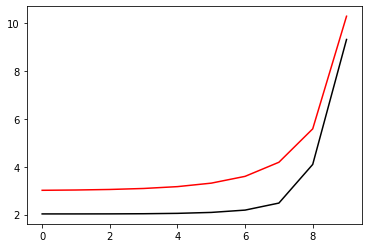

7400 99.00223941063544 9.03138202363352
[2.02680317 2.02696964 2.02863715 2.03449088 2.05031627 2.08934332
 2.18624069 2.48078677 4.09699718 9.3252784 ]


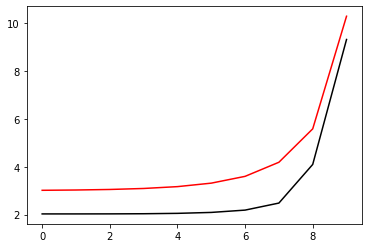

7500 99.00223880230709 9.031018454061917
[2.02680873 2.02697425 2.02863796 2.03448196 2.05028826 2.0892908
 2.18620715 2.48098378 4.09657219 9.32477649]


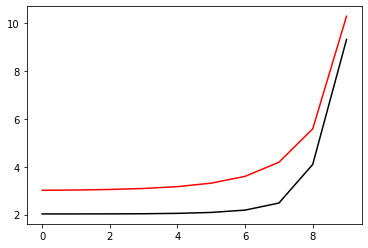

7600 99.00223819488124 9.03065522634452
[2.02681423 2.02697882 2.02863875 2.03447309 2.05026044 2.08923865
 2.18617402 2.48118026 4.09614762 9.32427458]


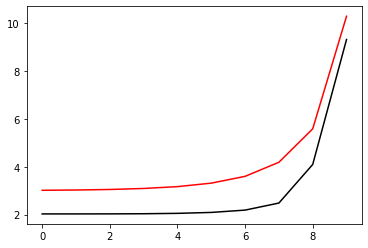

7700 99.0022375883539 9.030292339715155
[2.02681969 2.02698335 2.02863952 2.03446427 2.0502328  2.08918687
 2.18614128 2.48137623 4.09572348 9.32377269]


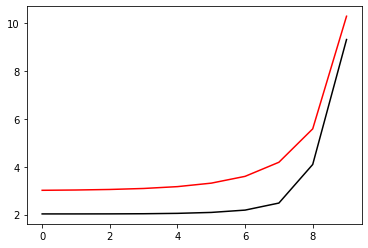

7800 99.00223698272116 9.029929793410393
[2.02682509 2.02698783 2.02864029 2.03445551 2.05020534 2.08913546
 2.18610894 2.48157167 4.09529977 9.3232708 ]


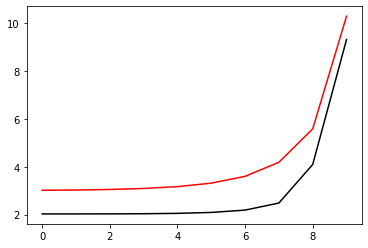

7900 99.00223637797912 9.029567586669526
[2.02683044 2.02699227 2.02864104 2.03444681 2.05017807 2.08908441
 2.186077   2.4817666  4.09487648 9.32276892]


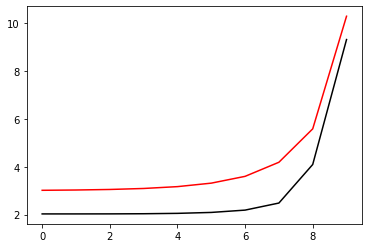

8000 99.00223577412385 9.029205718734563
[2.02683574 2.02699667 2.02864178 2.03443816 2.05015097 2.08903372
 2.18604545 2.48196101 4.09445361 9.32226704]


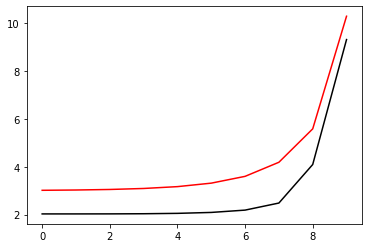

8100 99.0022351711515 9.028844188850224
[2.02684099 2.02700103 2.0286425  2.03442956 2.05012406 2.0889834
 2.18601429 2.48215491 4.09403117 9.32176518]


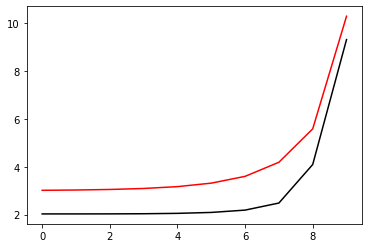

8200 99.00223456905826 9.028482996263875
[2.0268462  2.02700535 2.02864322 2.03442102 2.05009733 2.08893343
 2.18598352 2.48234829 4.09360916 9.32126332]


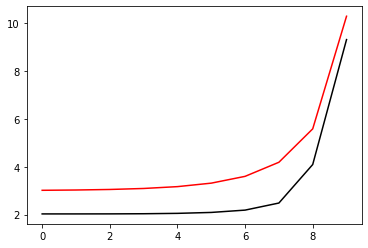

8300 99.00223396784031 9.028122140225584
[2.02685135 2.02700963 2.02864392 2.03441253 2.05007078 2.08888383
 2.18595313 2.48254117 4.09318756 9.32076147]


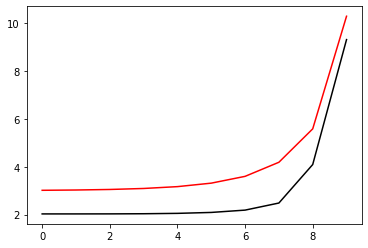

8400 99.00223336749384 9.02776161998807
[2.02685645 2.02701387 2.02864462 2.0344041  2.0500444  2.08883458
 2.18592314 2.48273353 4.09276639 9.32025962]


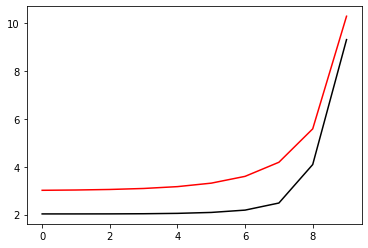

8500 99.0022327680151 9.027401434806693
[2.02686151 2.02701807 2.0286453  2.03439572 2.05001821 2.08878568
 2.18589353 2.48292539 4.09234564 9.31975779]


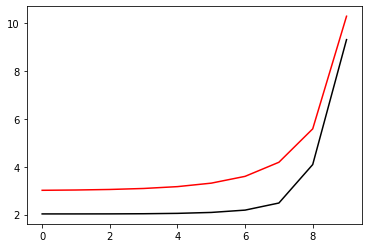

8600 99.00223216940037 9.027041583939434
[2.02686652 2.02702224 2.02864597 2.03438739 2.04999219 2.08873714
 2.1858643  2.48311674 4.09192531 9.31925596]


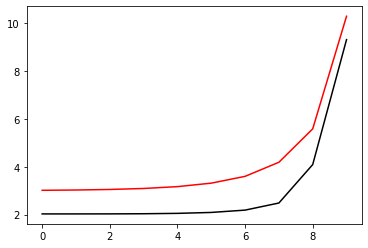

8700 99.00223157164588 9.026682066646934
[2.02687149 2.02702636 2.02864663 2.03437912 2.04996635 2.08868896
 2.18583545 2.48330758 4.09150539 9.31875414]


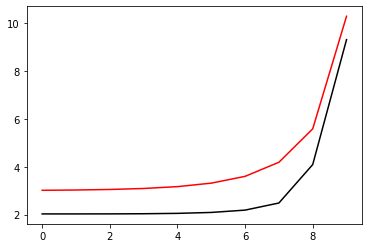

8800 99.00223097474795 9.026322882192394
[2.02687641 2.02703045 2.02864728 2.0343709  2.04994068 2.08864112
 2.18580698 2.48349792 4.0910859  9.31825233]


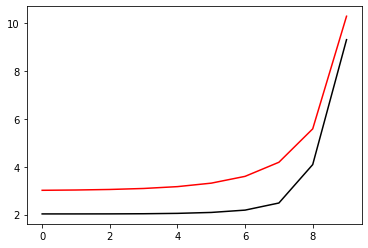

8900 99.00223037870292 9.025964029841639
[2.02688128 2.0270345  2.02864793 2.03436274 2.0499152  2.08859364
 2.18577889 2.48368776 4.09066682 9.31775052]


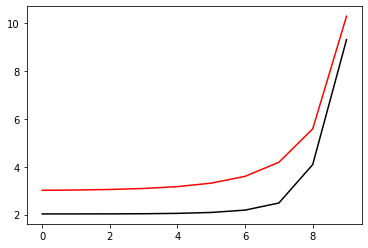

9000 99.00222978350713 9.025605508863073
[2.02688611 2.02703852 2.02864856 2.03435463 2.04988988 2.0885465
 2.18575117 2.48387709 4.09024816 9.31724873]


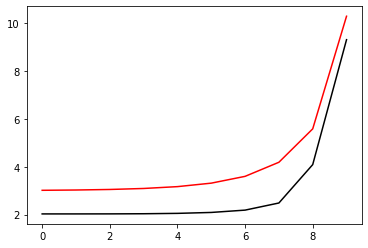

9100 99.00222918915695 9.025247318527654
[2.02689089 2.0270425  2.02864918 2.03434658 2.04986475 2.08849971
 2.18572383 2.48406593 4.08982992 9.31674694]


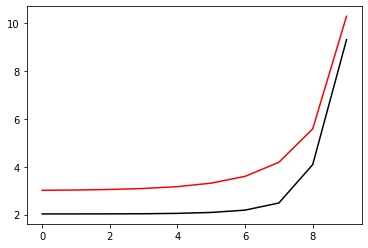

9200 99.00222859564876 9.024889458108905
[2.02689563 2.02704644 2.0286498  2.03433858 2.04983978 2.08845326
 2.18569686 2.48425427 4.08941209 9.31624516]


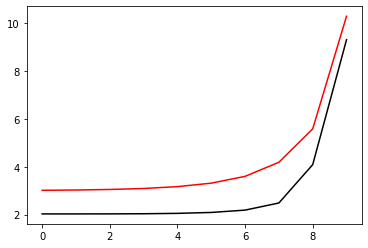

9300 99.002228002979 9.024531926882913
[2.02690033 2.02705035 2.02865041 2.03433063 2.04981499 2.08840716
 2.18567026 2.48444211 4.08899467 9.31574339]


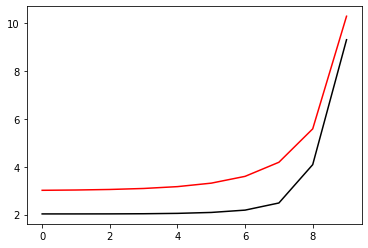

9400 99.00222741114408 9.024174724128269
[2.02690498 2.02705422 2.02865101 2.03432274 2.04979037 2.0883614
 2.18564403 2.48462946 4.08857767 9.31524162]


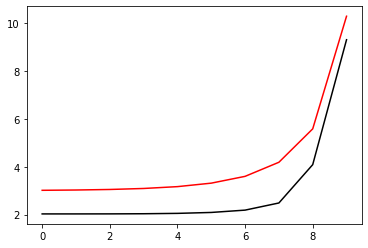

9500 99.00222682014048 9.023817849126104
[2.02690959 2.02705806 2.0286516  2.0343149  2.04976593 2.08831598
 2.18561817 2.48481632 4.08816109 9.31473987]


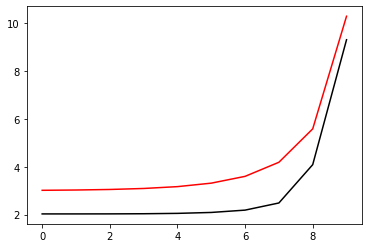

9600 99.00222622996466 9.023461301160062
[2.02691416 2.02706187 2.02865218 2.03430712 2.04974165 2.0882709
 2.18559267 2.48500268 4.08774491 9.31423812]


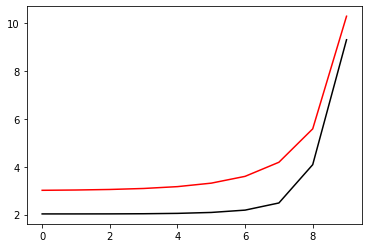

9700 99.00222564061315 9.023105079516258
[2.02691868 2.02706564 2.02865276 2.03429939 2.04971755 2.08822616
 2.18556754 2.48518855 4.08732915 9.31373638]


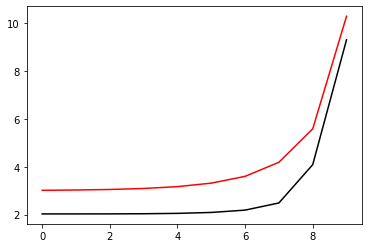

9800 99.00222505208242 9.022749183483322
[2.02692317 2.02706938 2.02865334 2.03429172 2.04969362 2.08818175
 2.18554277 2.48537394 4.08691379 9.31323465]


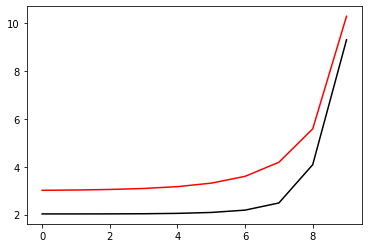

9900 99.00222446436908 9.022393612352337
[2.02692761 2.02707309 2.0286539  2.0342841  2.04966985 2.08813768
 2.18551836 2.48555884 4.08649885 9.31273293]


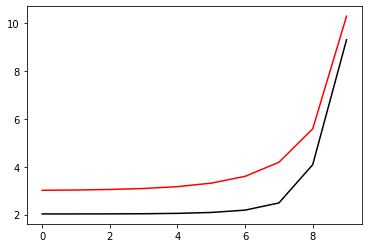

10000 99.00222387746963 9.022038365416867
[2.02693202 2.02707676 2.02865446 2.03427653 2.04964626 2.08809395
 2.18549431 2.48574325 4.08608432 9.31223121]


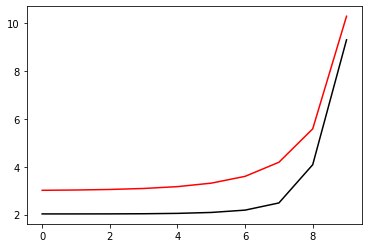

In [67]:
optimizer=tf.optimizers.SGD(learning_rate=0.01)
for i in range (1, 10001):
    run()
    if i%100==0: print(i, Error_func(h, m2_2).numpy(), m2_2.numpy()), print(h.numpy()), plt.plot(h_real, 'r-'), plt.plot(h.numpy(), 'k-'), plt.show()

100 99.00222329138072 9.021683441972904
[2.02693638 2.02708041 2.02865501 2.03426902 2.04962283 2.08805054
 2.18547062 2.48592717 4.08567019 9.31172951]


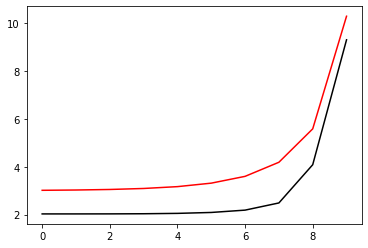

200 99.0022227060989 9.0213288413189
[2.02694071 2.02708402 2.02865556 2.03426156 2.04959958 2.08800747
 2.18544728 2.48611062 4.08525648 9.31122781]


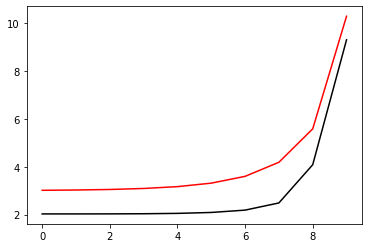

300 99.00222212162082 9.020974562755713
[2.026945   2.0270876  2.02865611 2.03425416 2.04957649 2.08796473
 2.1854243  2.48629358 4.08484317 9.31072612]


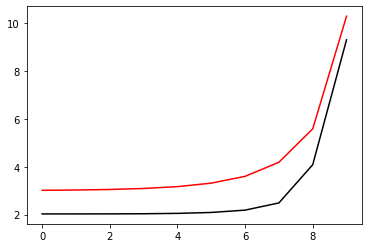

400 99.00222153794313 9.02062060558664
[2.02694925 2.02709115 2.02865664 2.03424681 2.04955357 2.08792231
 2.18540167 2.48647606 4.08443026 9.31022444]


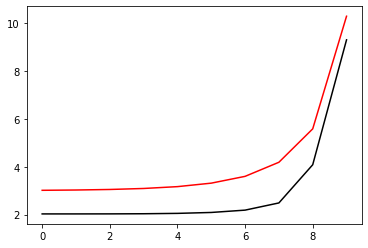

500 99.0022209550625 9.020266969117355
[2.02695346 2.02709467 2.02865718 2.03423951 2.04953081 2.08788022
 2.18537939 2.48665806 4.08401776 9.30972277]


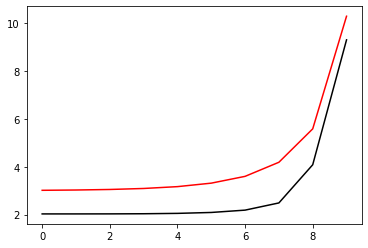

600 99.0022203729756 9.019913652655939
[2.02695763 2.02709816 2.02865771 2.03423227 2.04950822 2.08783846
 2.18535746 2.48683959 4.08360567 9.30922111]


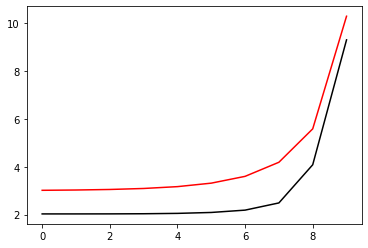

700 99.00221979167915 9.01956065551286
[2.02696177 2.02710163 2.02865823 2.03422508 2.04948579 2.08779702
 2.18533588 2.48702064 4.08319398 9.30871945]


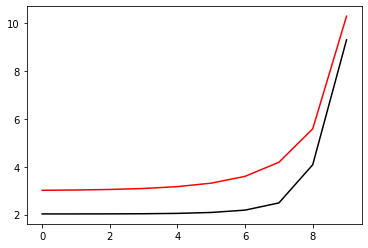

800 99.00221921116986 9.019207977000955
[2.02696587 2.02710506 2.02865875 2.03421795 2.04946353 2.08775591
 2.18531464 2.48720121 4.0827827  9.3082178 ]


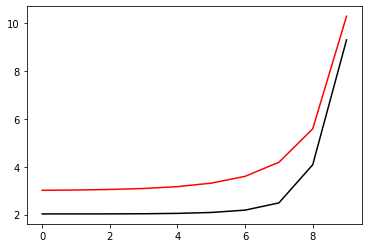

900 99.00221863144452 9.01885561643541
[2.02696994 2.02710847 2.02865927 2.03421087 2.04944144 2.08771511
 2.18529375 2.48738131 4.08237181 9.30771617]


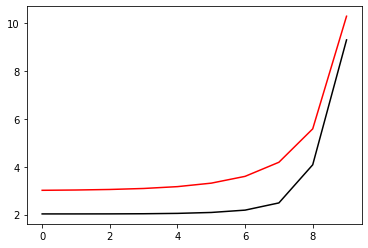

1000 99.00221805249984 9.018503573133769
[2.02697396 2.02711184 2.02865979 2.03420384 2.0494195  2.08767464
 2.1852732  2.48756094 4.08196133 9.30721454]


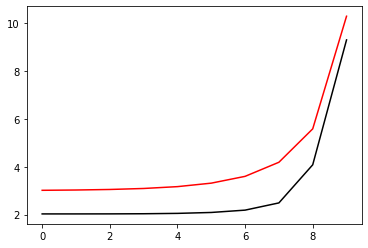

1100 99.00221747433264 9.018151846415908
[2.02697796 2.0271152  2.0286603  2.03419687 2.04939773 2.08763448
 2.185253   2.4877401  4.08155125 9.30671292]


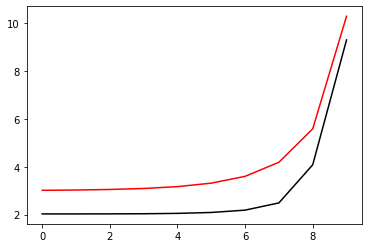

1200 99.00221689693973 9.017800435604043
[2.02698192 2.02711852 2.02866081 2.03418995 2.04937613 2.08759464
 2.18523313 2.48791879 4.08114157 9.30621131]


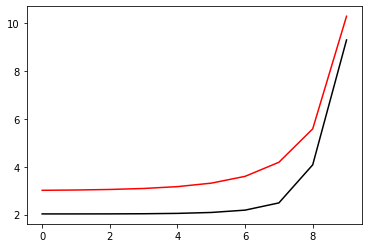

1300 99.0022163203179 9.017449340022678
[2.02698584 2.02712182 2.02866132 2.03418309 2.04935468 2.08755512
 2.1852136  2.48809702 4.08073229 9.30570971]


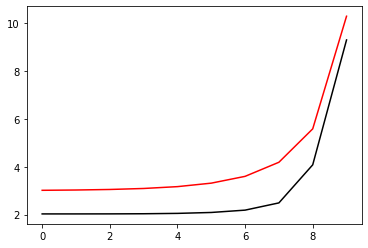

1400 99.00221574446402 9.017098558998633
[2.02698974 2.02712509 2.02866182 2.03417628 2.04933339 2.08751591
 2.18519441 2.48827477 4.08032341 9.30520811]


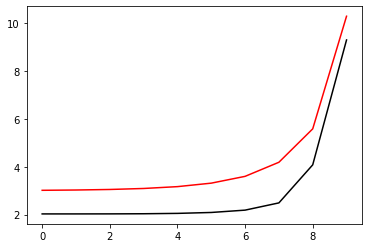

1500 99.00221516937495 9.016748091861034
[2.0269936  2.02712833 2.02866233 2.03416953 2.04931227 2.08747701
 2.18517555 2.48845207 4.07991493 9.30470653]


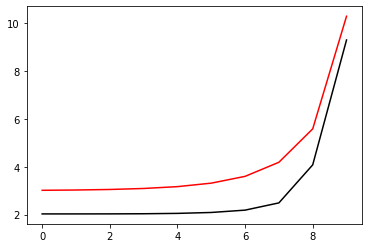

1600 99.00221459504756 9.01639793794129
[2.02699742 2.02713155 2.02866283 2.03416283 2.04929131 2.08743843
 2.18515703 2.4886289  4.07950684 9.30420495]


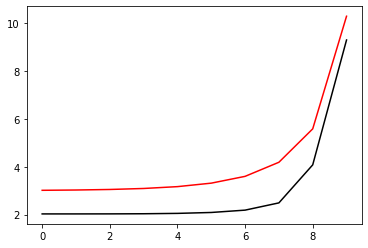

1700 99.00221402147874 9.016048096573078
[2.02700122 2.02713475 2.02866333 2.03415618 2.0492705  2.08740016
 2.18513884 2.48880526 4.07909915 9.30370339]


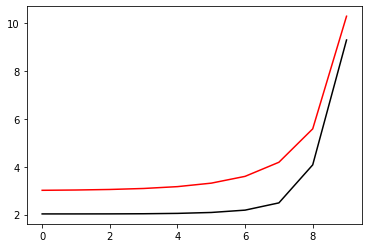

1800 99.00221344866544 9.01569856709232
[2.02700498 2.02713792 2.02866383 2.03414958 2.04924986 2.08736219
 2.18512098 2.48898117 4.07869186 9.30320183]


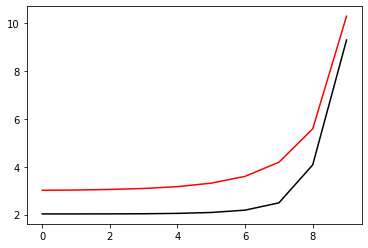

1900 99.00221287660457 9.01534934883719
[2.02700871 2.02714107 2.02866433 2.03414305 2.04922937 2.08732454
 2.18510345 2.48915662 4.07828496 9.30270028]


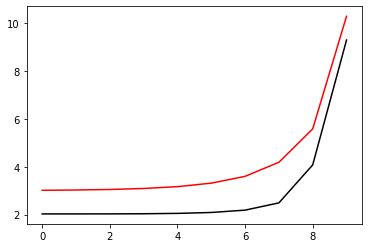

2000 99.00221230529309 9.015000441148159
[2.02701241 2.02714419 2.02866483 2.03413656 2.04920904 2.08728719
 2.18508625 2.48933161 4.07787846 9.30219874]


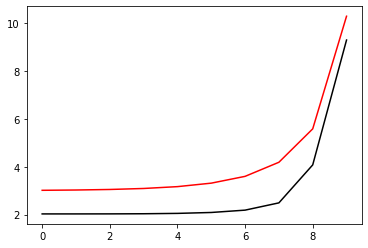

2100 99.00221173472796 9.014651843367858
[2.02701608 2.02714729 2.02866533 2.03413013 2.04918887 2.08725015
 2.18506937 2.48950614 4.07747235 9.30169721]


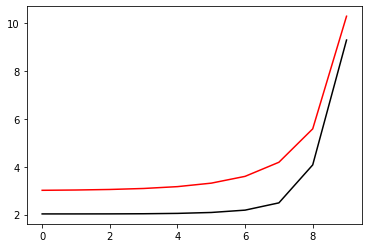

2200 99.0022111649062 9.014303554841172
[2.02701971 2.02715036 2.02866583 2.03412375 2.04916886 2.08721341
 2.18505282 2.48968022 4.07706664 9.30119569]


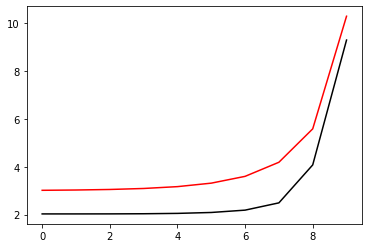

2300 99.00221059582479 9.013955574915194
[2.02702332 2.02715342 2.02866633 2.03411743 2.049149   2.08717697
 2.18503659 2.48985384 4.07666132 9.30069418]


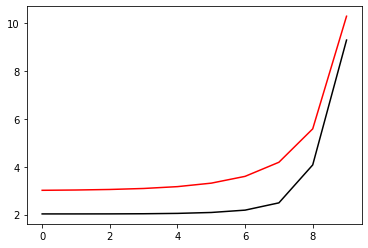

2400 99.00221002748077 9.01360790293921
[2.0270269  2.02715645 2.02866683 2.03411116 2.0491293  2.08714084
 2.18502068 2.49002701 4.07625639 9.30019267]


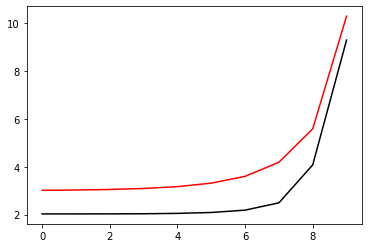

2500 99.00220945987115 9.013260538264694
[2.02703045 2.02715946 2.02866733 2.03410494 2.04910975 2.08710501
 2.1850051  2.49019973 4.07585185 9.29969118]


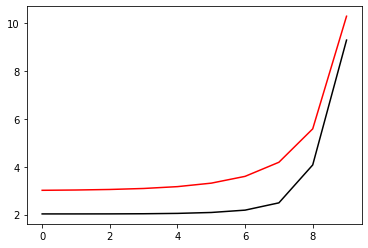

2600 99.00220889299305 9.012913480245327
[2.02703397 2.02716244 2.02866784 2.03409878 2.04909036 2.08706947
 2.18498983 2.490372   4.0754477  9.2991897 ]


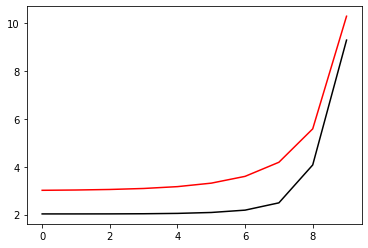

2700 99.00220832684349 9.012566728236926
[2.02703747 2.02716541 2.02866834 2.03409267 2.04907112 2.08703423
 2.18497487 2.49054382 4.07504394 9.29868822]


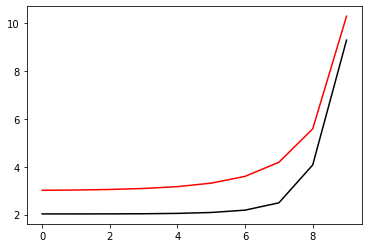

2800 99.0022077614196 9.012220281597473
[2.02704093 2.02716836 2.02866885 2.03408662 2.04905204 2.08699929
 2.18496024 2.4907152  4.07464057 9.29818676]


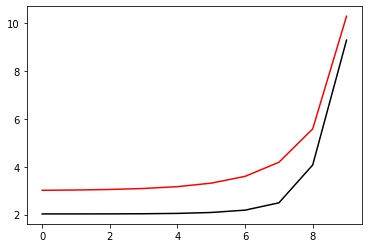

2900 99.00220719671849 9.011874139687125
[2.02704437 2.02717128 2.02866935 2.03408062 2.04903311 2.08696465
 2.18494592 2.49088613 4.07423759 9.2976853 ]


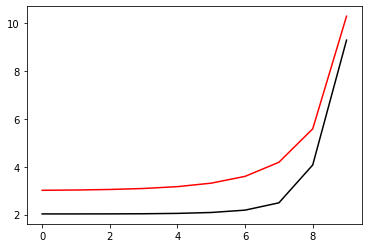

3000 99.00220663273724 9.011528301868156
[2.02704778 2.02717419 2.02866986 2.03407467 2.04901433 2.0869303
 2.18493191 2.49105661 4.073835   9.29718386]


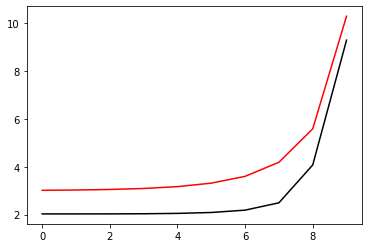

3100 99.00220606947308 9.01118276750497
[2.02705117 2.02717707 2.02867038 2.03406878 2.04899571 2.08689624
 2.18491821 2.49122665 4.07343279 9.29668242]


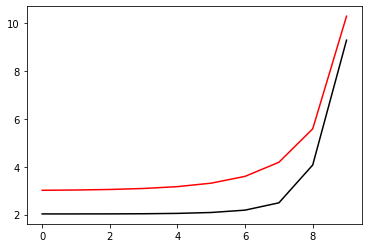

3200 99.0022055069231 9.010837535964091
[2.02705453 2.02717994 2.02867089 2.03406294 2.04897723 2.08686248
 2.18490482 2.49139625 4.07303097 9.29618099]


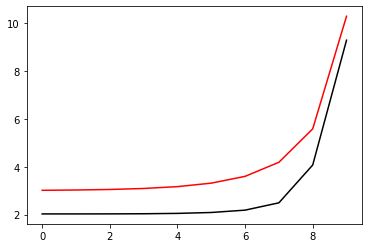

3300 99.0022049450845 9.010492606614179
[2.02705786 2.02718279 2.02867141 2.03405715 2.04895891 2.086829
 2.18489174 2.49156541 4.07262954 9.29567957]


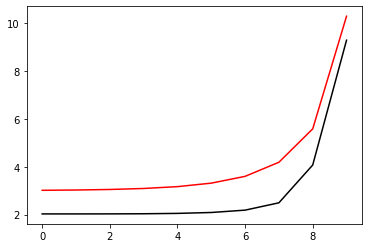

3400 99.0022043839545 9.010147978825978
[2.02706117 2.02718562 2.02867193 2.03405142 2.04894074 2.08679582
 2.18487897 2.49173413 4.07222849 9.29517817]


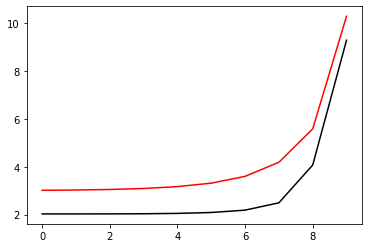

3500 99.00220382353028 9.009803651972303
[2.02706445 2.02718843 2.02867246 2.03404574 2.04892272 2.08676292
 2.18486651 2.49190241 4.07182782 9.29467677]


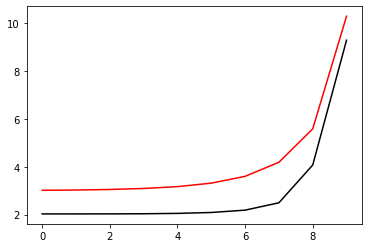

3600 99.00220326380905 9.0094596254281
[2.02706771 2.02719122 2.02867298 2.03404012 2.04890485 2.08673031
 2.18485434 2.49207026 4.07142754 9.29417538]


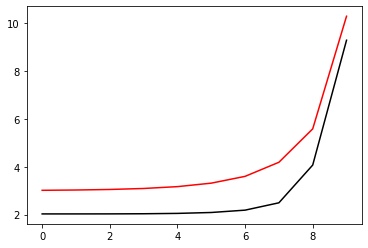

3700 99.00220270478812 9.009115898570347
[2.02707095 2.027194   2.02867352 2.03403455 2.04888713 2.08669798
 2.18484248 2.49223767 4.07102764 9.293674  ]


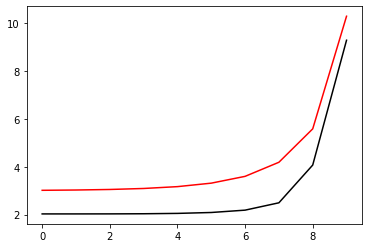

3800 99.0022021464647 9.008772470778089
[2.02707416 2.02719676 2.02867405 2.03402903 2.04886955 2.08666594
 2.18483093 2.49240464 4.07062813 9.29317263]


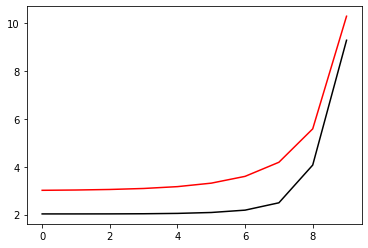

3900 99.00220158883606 9.008429341432434
[2.02707735 2.0271995  2.02867459 2.03402357 2.04885213 2.08663419
 2.18481967 2.49257118 4.07022899 9.29267127]


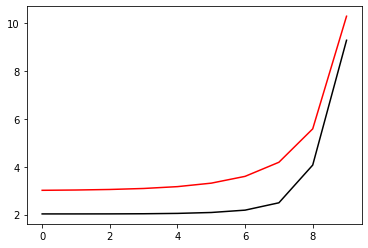

4000 99.00220103189952 9.008086509916545
[2.02708051 2.02720222 2.02867514 2.03401816 2.04883485 2.08660271
 2.18480871 2.49273729 4.06983024 9.29216992]


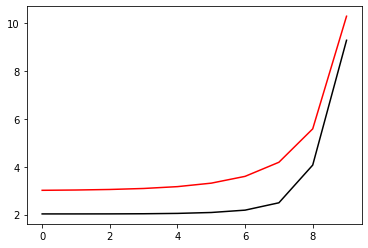

4100 99.00220047565237 9.007743975615595
[2.02708365 2.02720493 2.02867569 2.03401281 2.04881772 2.08657152
 2.18479805 2.49290297 4.06943187 9.29166858]


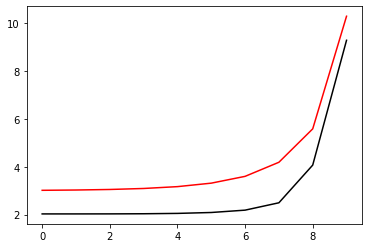

4200 99.00219992009195 9.00740173791681
[2.02708677 2.02720763 2.02867625 2.0340075  2.04880074 2.0865406
 2.18478768 2.49306823 4.06903387 9.29116725]


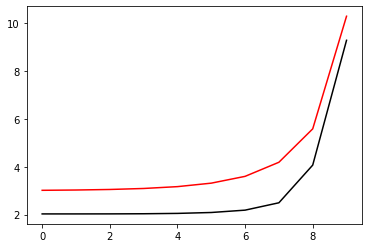

4300 99.00219936521559 9.007059796209411
[2.02708987 2.0272103  2.02867681 2.03400226 2.0487839  2.08650997
 2.18477761 2.49323305 4.06863626 9.29066593]


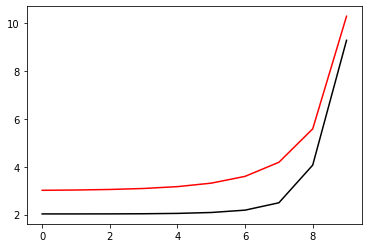

4400 99.0021988110206 9.006718149884643
[2.02709295 2.02721297 2.02867738 2.03399706 2.04876721 2.08647961
 2.18476783 2.49339745 4.06823902 9.29016462]


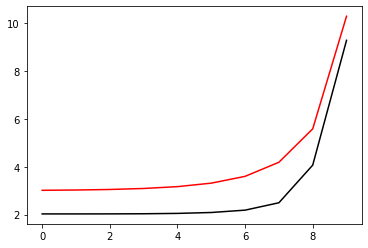

4500 99.00219825750443 9.00637679833576
[2.027096   2.02721561 2.02867795 2.03399192 2.04875066 2.08644953
 2.18475834 2.49356142 4.06784216 9.28966332]


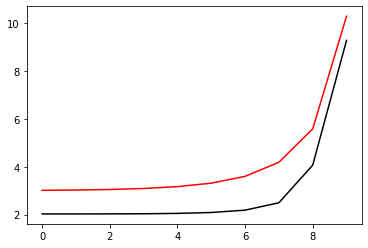

4600 99.0021977046644 9.00603574095797
[2.02709904 2.02721825 2.02867853 2.03398683 2.04873426 2.08641972
 2.18474914 2.49372496 4.06744568 9.28916203]


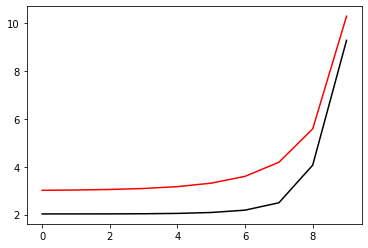

4700 99.00219715249793 9.005694977148474
[2.02710205 2.02722087 2.02867911 2.0339818  2.048718   2.08639019
 2.18474023 2.49388809 4.06704958 9.28866075]


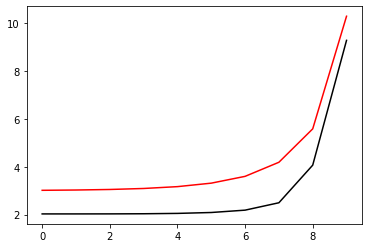

4800 99.00219660100242 9.005354506306476
[2.02710505 2.02722348 2.0286797  2.03397682 2.04870189 2.08636093
 2.18473161 2.49405079 4.06665385 9.28815948]


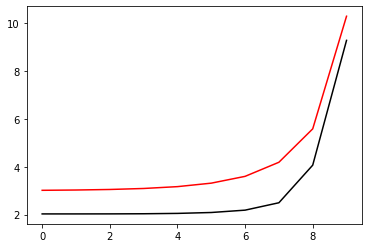

4900 99.00219605017533 9.0050143278331
[2.02710802 2.02722607 2.0286803  2.03397189 2.04868592 2.08633194
 2.18472328 2.49421307 4.06625849 9.28765822]


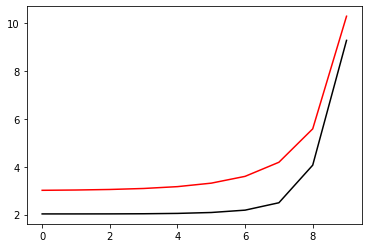

5000 99.0021955000141 9.004674441131478
[2.02711098 2.02722865 2.02868091 2.03396702 2.04867009 2.08630322
 2.18471523 2.49437494 4.06586351 9.28715697]


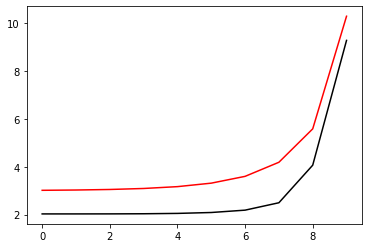

5100 99.00219495051614 9.004334845606634
[2.02711392 2.02723121 2.02868152 2.0339622  2.04865441 2.08627477
 2.18470746 2.49453638 4.0654689  9.28665573]


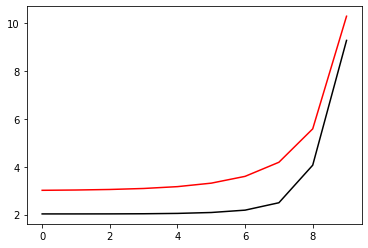

5200 99.00219440167896 9.003995540665553
[2.02711683 2.02723377 2.02868214 2.03395744 2.04863887 2.08624659
 2.18469998 2.49469741 4.06507467 9.28615451]


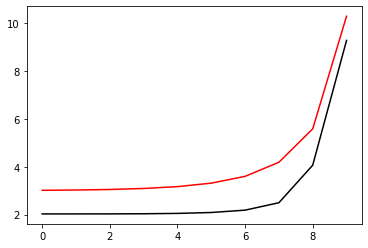

5300 99.00219385350006 9.00365652571715
[2.02711973 2.02723631 2.02868277 2.03395272 2.04862347 2.08621868
 2.18469277 2.49485803 4.06468081 9.28565329]


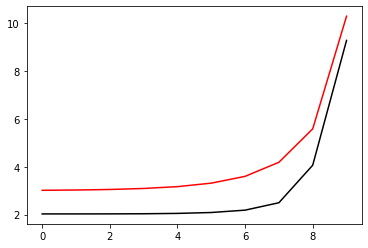

5400 99.0021933059769 9.003317800172265
[2.02712262 2.02723884 2.0286834  2.03394806 2.04860821 2.08619103
 2.18468585 2.49501823 4.06428732 9.28515208]


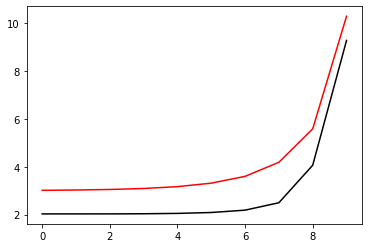

5500 99.00219275910703 9.002979363443615
[2.02712548 2.02724136 2.02868404 2.03394346 2.04859309 2.08616365
 2.18467921 2.49517801 4.0638942  9.28465088]


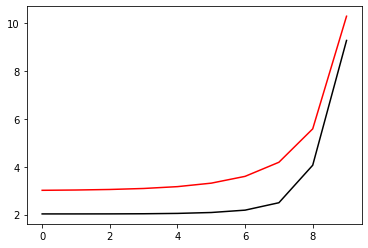

5600 99.00219221288796 9.002641214945866
[2.02712833 2.02724387 2.0286847  2.03393891 2.04857811 2.08613653
 2.18467284 2.49533739 4.06350145 9.28414969]


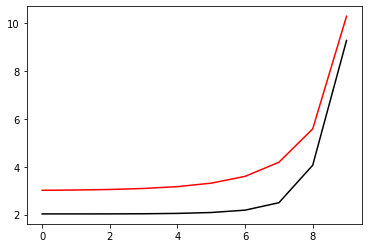

5700 99.00219166731725 9.002303354095545
[2.02713116 2.02724637 2.02868536 2.03393441 2.04856327 2.08610968
 2.18466674 2.49549635 4.06310907 9.28364852]


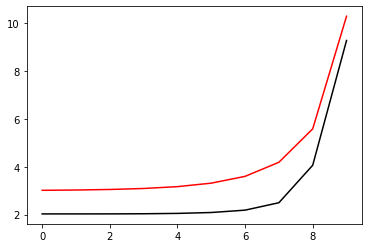

5800 99.00219112239243 9.001965780311087
[2.02713398 2.02724886 2.02868603 2.03392996 2.04854857 2.08608309
 2.18466093 2.49565491 4.06271706 9.28314735]


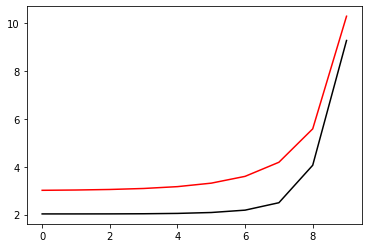

5900 99.0021905781111 9.001628493012799
[2.02713678 2.02725133 2.0286867  2.03392557 2.04853401 2.08605675
 2.18465538 2.49581305 4.06232542 9.28264619]


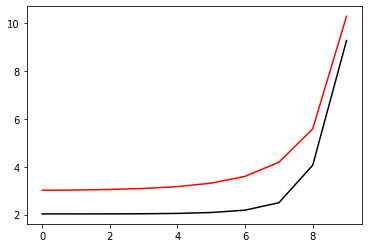

6000 99.00219003447081 9.001291491622855
[2.02713956 2.0272538  2.02868739 2.03392123 2.04851958 2.08603068
 2.18465011 2.49597079 4.06193415 9.28214505]


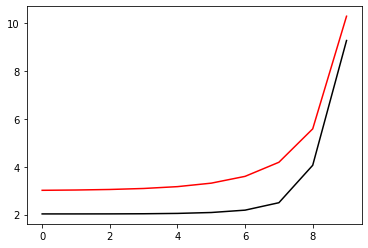

6100 99.00218949146921 9.00095477556528
[2.02714233 2.02725626 2.02868809 2.03391695 2.0485053  2.08600487
 2.1846451  2.49612813 4.06154324 9.28164391]


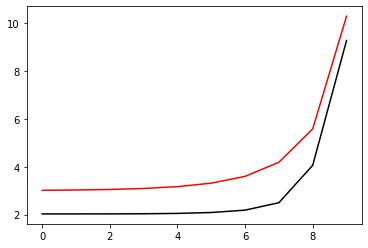

6200 99.00218894910387 9.000618344265964
[2.02714508 2.02725871 2.02868879 2.03391272 2.04849115 2.08597931
 2.18464037 2.49628505 4.0611527  9.28114279]


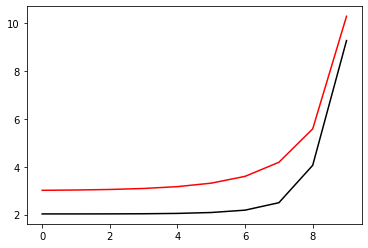

6300 99.00218840737243 9.000282197152648
[2.02714782 2.02726115 2.02868951 2.03390854 2.04847714 2.08595401
 2.1846359  2.49644158 4.06076253 9.28064168]


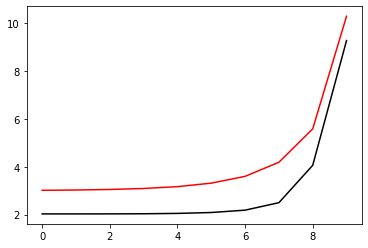

6400 99.00218786627252 8.999946333654888
[2.02715054 2.02726358 2.02869023 2.03390441 2.04846327 2.08592896
 2.1846317  2.4965977  4.06037272 9.28014057]


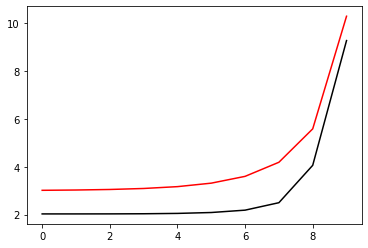

6500 99.0021873258018 8.999610753204093
[2.02715325 2.027266   2.02869097 2.03390034 2.04844953 2.08590417
 2.18462777 2.49675343 4.05998328 9.27963948]


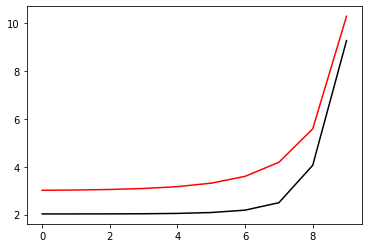

6600 99.00218678595793 8.999275455233468
[2.02715595 2.02726841 2.02869172 2.03389632 2.04843593 2.08587963
 2.1846241  2.49690875 4.0595942  9.2791384 ]


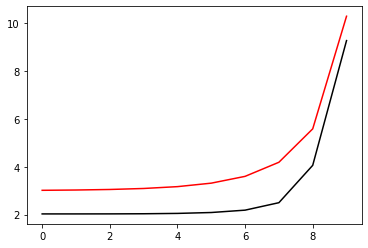

6700 99.0021862467386 8.998940439178051
[2.02715863 2.02727082 2.02869247 2.03389236 2.04842246 2.08585535
 2.18462069 2.49706367 4.05920549 9.27863733]


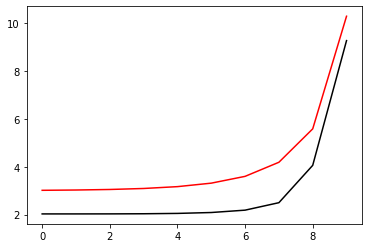

6800 99.00218570814148 8.998605704474683
[2.0271613  2.02727322 2.02869324 2.03388845 2.04840913 2.08583131
 2.18461755 2.4972182  4.05881713 9.27813627]


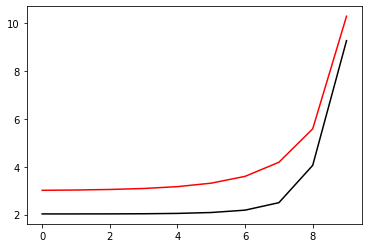

6900 99.0021851701643 8.998271250561993
[2.02716396 2.02727561 2.02869402 2.03388459 2.04839593 2.08580753
 2.18461466 2.49737233 4.05842914 9.27763522]


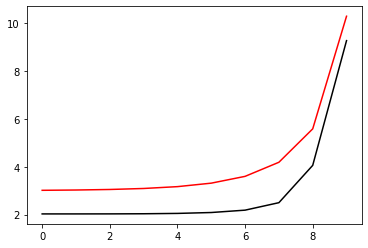

7000 99.00218463280474 8.997937076880401
[2.0271666  2.027278   2.02869481 2.03388078 2.04838286 2.08578399
 2.18461203 2.49752606 4.05804152 9.27713418]


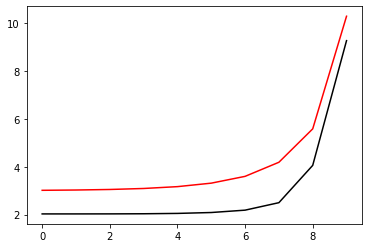

7100 99.00218409606056 8.99760318287209
[2.02716924 2.02728038 2.02869561 2.03387703 2.04836993 2.0857607
 2.18460966 2.4976794  4.05765425 9.27663315]


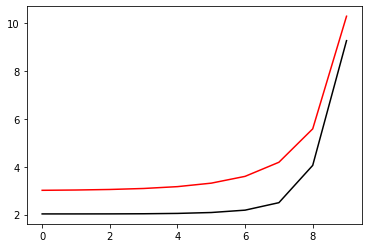

7200 99.0021835599295 8.997269567981062
[2.02717186 2.02728275 2.02869642 2.03387333 2.04835714 2.08573766
 2.18460755 2.49783235 4.05726734 9.27613214]


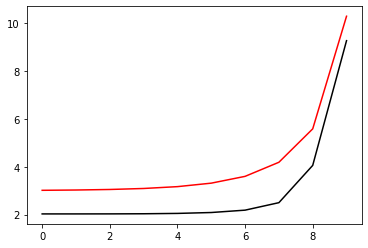

7300 99.00218302440932 8.996936231653066
[2.02717447 2.02728512 2.02869725 2.03386968 2.04834447 2.08571487
 2.1846057  2.4979849  4.05688079 9.27563113]


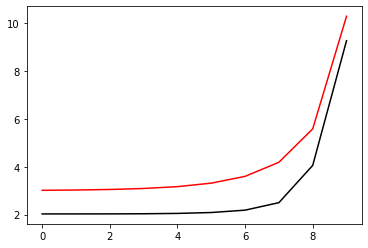

7400 99.00218248949777 8.996603173335567
[2.02717707 2.02728748 2.02869809 2.03386609 2.04833194 2.08569232
 2.18460409 2.49813707 4.0564946  9.27513014]


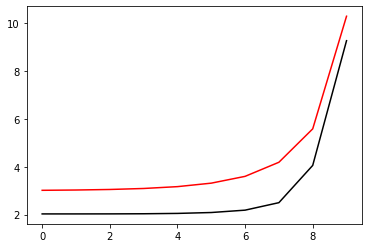

7500 99.00218195519264 8.996270392477824
[2.02717966 2.02728984 2.02869893 2.03386255 2.04831954 2.08567001
 2.18460275 2.49828884 4.05610877 9.27462915]


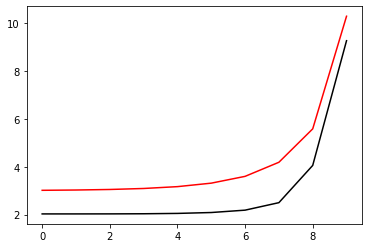

7600 99.0021814214917 8.995937888530829
[2.02718223 2.02729219 2.0286998  2.03385906 2.04830727 2.08564795
 2.18460165 2.49844023 4.0557233  9.27412818]


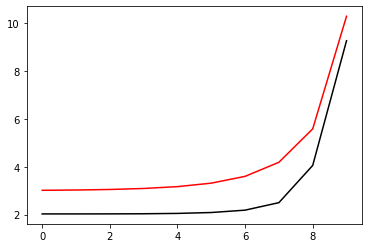

7700 99.00218088839277 8.99560566094731
[2.0271848  2.02729453 2.02870067 2.03385563 2.04829513 2.08562613
 2.1846008  2.49859123 4.05533819 9.27362722]


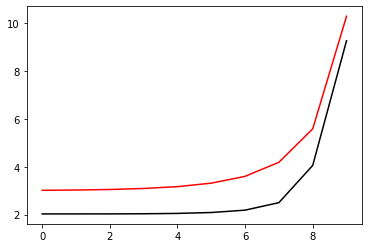

7800 99.00218035589369 8.995273709181715
[2.02718736 2.02729687 2.02870156 2.03385225 2.04828312 2.08560455
 2.1846002  2.49874184 4.05495343 9.27312627]


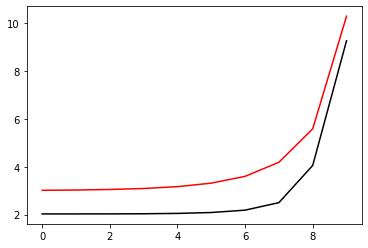

7900 99.00217982399225 8.99494203269022
[2.02718991 2.02729921 2.02870246 2.03384892 2.04827124 2.0855832
 2.18459985 2.49889207 4.05456903 9.27262533]


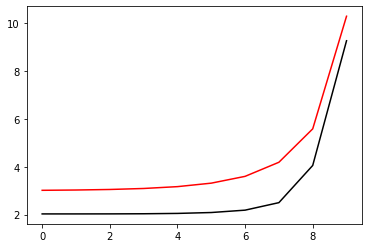

8000 99.00217929268632 8.99461063093072
[2.02719245 2.02730154 2.02870337 2.03384565 2.04825949 2.0855621
 2.18459975 2.49904191 4.05418498 9.2721244 ]


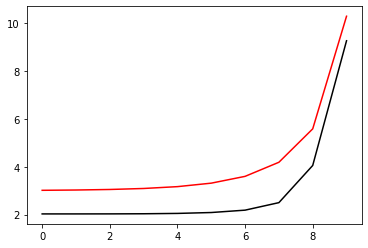

8100 99.00217876197372 8.994279503362796
[2.02719498 2.02730387 2.02870429 2.03384243 2.04824787 2.08554124
 2.1845999  2.49919137 4.05380129 9.27162348]


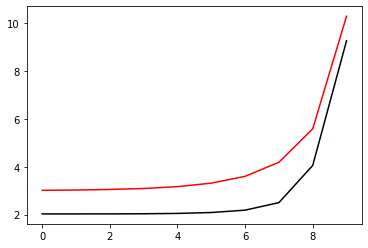

8200 99.00217823185233 8.993948649447747
[2.0271975  2.0273062  2.02870523 2.03383926 2.04823638 2.08552061
 2.18460028 2.49934045 4.05341795 9.27112258]


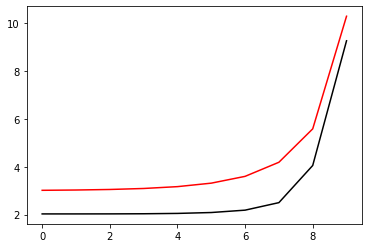

8300 99.00217770232003 8.993618068648528
[2.02720001 2.02730852 2.02870619 2.03383614 2.04822502 2.08550022
 2.18460092 2.49948915 4.05303497 9.27062169]


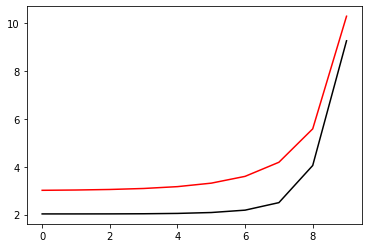

8400 99.0021771733747 8.993287760429828
[2.02720252 2.02731085 2.02870715 2.03383308 2.04821379 2.08548006
 2.18460179 2.49963747 4.05265234 9.2701208 ]


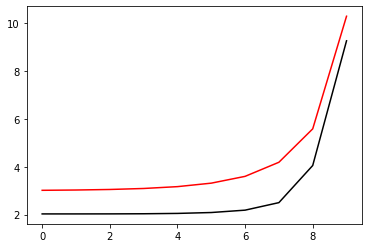

8500 99.00217664501426 8.992957724257973
[2.02720502 2.02731316 2.02870814 2.03383007 2.04820268 2.08546014
 2.1846029  2.49978541 4.05227006 9.26961993]


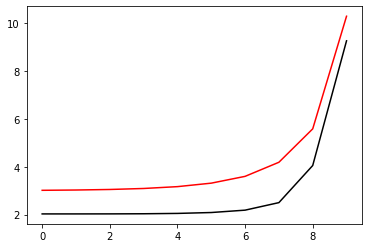

8600 99.00217611723659 8.992627959600958
[2.02720751 2.02731548 2.02870913 2.03382711 2.0481917  2.08544045
 2.18460426 2.49993297 4.05188813 9.26911907]


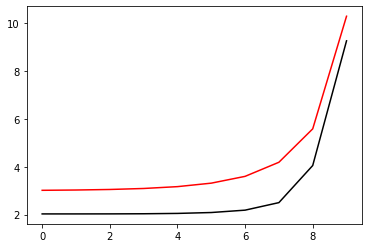

8700 99.00217559003963 8.992298465928469
[2.02720999 2.02731779 2.02871014 2.03382421 2.04818085 2.08542099
 2.18460585 2.50008016 4.05150656 9.26861822]


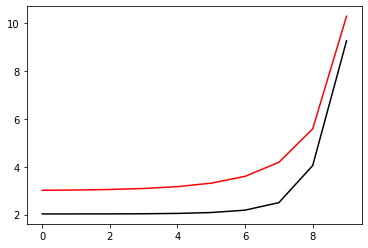

8800 99.00217506342129 8.99196924271182
[2.02721247 2.0273201  2.02871116 2.03382136 2.04817012 2.08540177
 2.18460768 2.50022697 4.05112534 9.26811739]


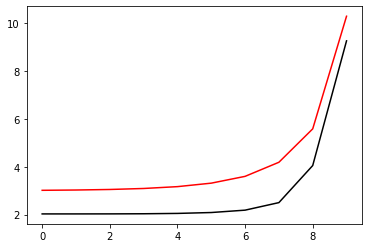

8900 99.00217453737955 8.991640289424002
[2.02721494 2.02732241 2.0287122  2.03381856 2.04815952 2.08538277
 2.18460975 2.50037341 4.05074446 9.26761656]


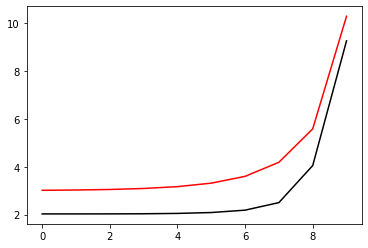

9000 99.00217401191233 8.991311605539593
[2.0272174  2.02732472 2.02871326 2.03381581 2.04814905 2.085364
 2.18461206 2.50051947 4.05036394 9.26711575]


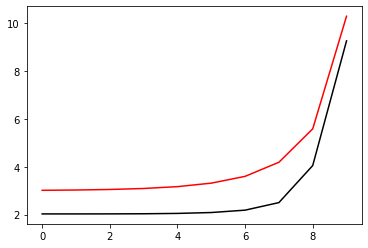

9100 99.00217348701761 8.990983190534854
[2.02721986 2.02732703 2.02871433 2.03381312 2.0481387  2.08534546
 2.18461459 2.50066517 4.04998376 9.26661494]


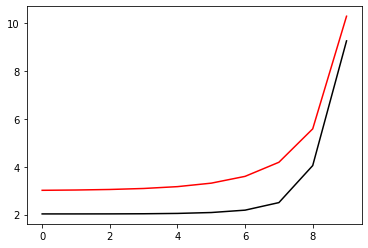

9200 99.0021729626934 8.990655043887648
[2.02722231 2.02732934 2.02871541 2.03381048 2.04812847 2.08532715
 2.18461736 2.50081049 4.04960394 9.26611415]


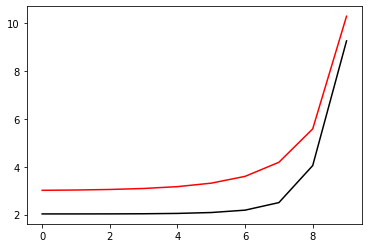

9300 99.00217243893763 8.990327165077463
[2.02722476 2.02733165 2.02871651 2.03380789 2.04811838 2.08530907
 2.18462037 2.50095544 4.04922446 9.26561337]


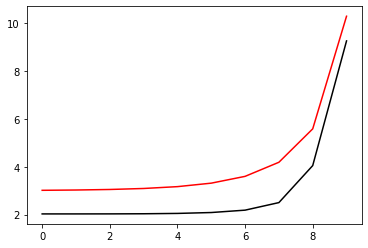

9400 99.00217191574833 8.98999955358541
[2.0272272  2.02733395 2.02871763 2.03380536 2.0481084  2.08529121
 2.1846236  2.50110002 4.04884532 9.26511261]


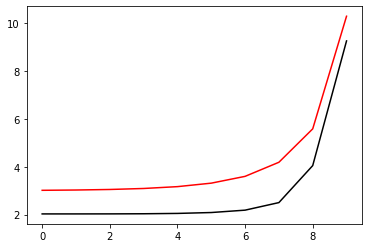

9500 99.00217139312352 8.989672208894183
[2.02722964 2.02733626 2.02871876 2.03380288 2.04809855 2.08527357
 2.18462706 2.50124424 4.04846654 9.26461185]


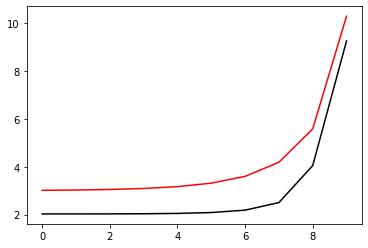

9600 99.0021708710612 8.989345130488108
[2.02723207 2.02733857 2.02871991 2.03380045 2.04808882 2.08525616
 2.18463076 2.50138809 4.0480881  9.26411111]


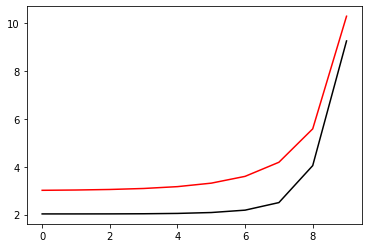

9700 99.0021703495594 8.989018317853066
[2.0272345  2.02734088 2.02872107 2.03379807 2.04807921 2.08523897
 2.18463467 2.50153157 4.04771001 9.26361037]


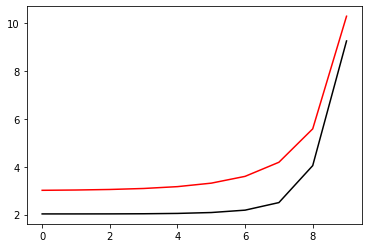

9800 99.00216982861618 8.988691770476544
[2.02723693 2.02734318 2.02872225 2.03379575 2.04806973 2.085222
 2.18463882 2.50167469 4.04733226 9.26310965]


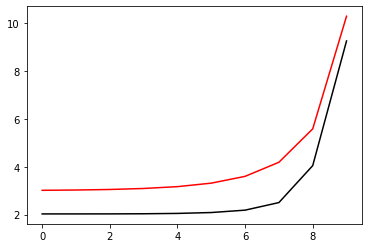

9900 99.0021693082296 8.98836548784761
[2.02723935 2.02734549 2.02872345 2.03379348 2.04806037 2.08520525
 2.18464319 2.50181744 4.04695485 9.26260894]


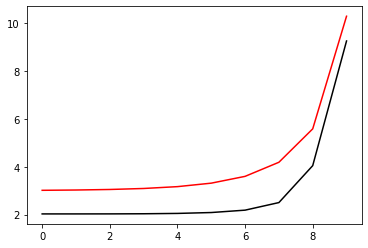

10000 99.00216878839768 8.988039469456892
[2.02724176 2.0273478  2.02872466 2.03379126 2.04805113 2.08518873
 2.18464779 2.50195984 4.04657779 9.26210825]


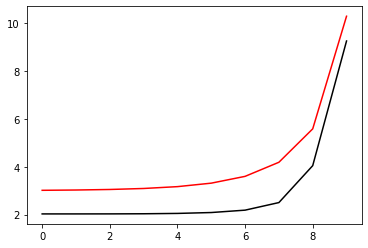

In [68]:
optimizer=tf.optimizers.SGD(learning_rate=0.01)
for i in range (1, 10001):
    run()
    if i%100==0: print(i, Error_func(h, m2_2).numpy(), m2_2.numpy()), print(h.numpy()), plt.plot(h_real, 'r-'), plt.plot(h.numpy(), 'k-'), plt.show()

100 99.00216826911853 8.987713714796582
[2.02724418 2.02735012 2.02872589 2.03378909 2.04804201 2.08517242
 2.18465261 2.50210187 4.04620107 9.26160756]


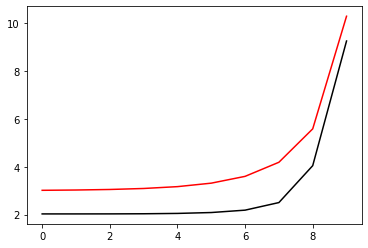

200 99.00216775039023 8.987388223360439
[2.02724659 2.02735243 2.02872714 2.03378698 2.04803301 2.08515633
 2.18465765 2.50224354 4.0458247  9.26110689]


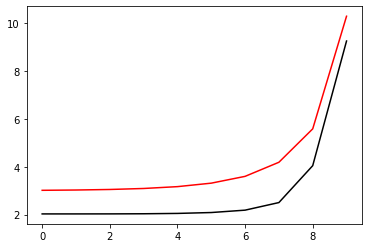

300 99.00216723221087 8.987062994643782
[2.027249   2.02735475 2.0287284  2.03378492 2.04802413 2.08514046
 2.18466291 2.50238485 4.04544867 9.26060623]


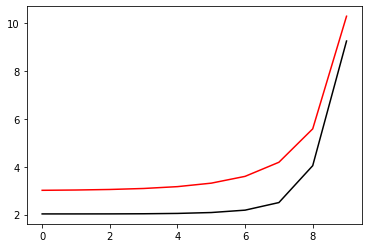

400 99.00216671457852 8.986738028143463
[2.02725141 2.02735707 2.02872968 2.03378291 2.04801538 2.0851248
 2.18466839 2.5025258  4.04507297 9.26010558]


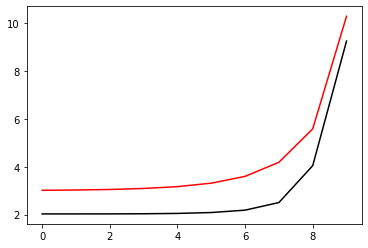

500 99.00216619749135 8.986413323357866
[2.02725381 2.02735939 2.02873098 2.03378095 2.04800674 2.08510936
 2.18467409 2.5026664  4.04469762 9.25960494]


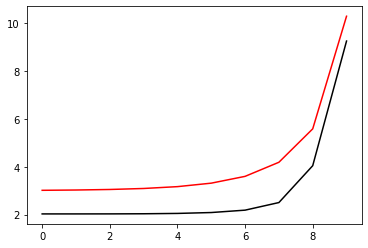

600 99.00216568094746 8.98608887978693
[2.02725622 2.02736171 2.0287323  2.03377905 2.04799822 2.08509413
 2.18468001 2.50280664 4.04432261 9.25910432]


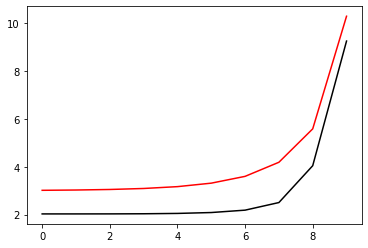

700 99.00216516494497 8.985764696932094
[2.02725862 2.02736404 2.02873363 2.0337772  2.04798982 2.08507912
 2.18468614 2.50294653 4.04394794 9.2586037 ]


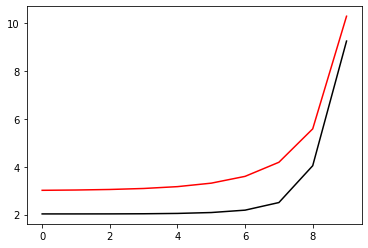

800 99.00216464948205 8.98544077429633
[2.02726102 2.02736637 2.02873499 2.0337754  2.04798154 2.08506432
 2.18469249 2.50308606 4.04357361 9.2581031 ]


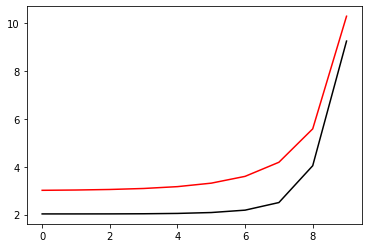

900 99.00216413455684 8.985117111384126
[2.02726342 2.0273687  2.02873636 2.03377365 2.04797338 2.08504973
 2.18469905 2.50322523 4.04319962 9.25760251]


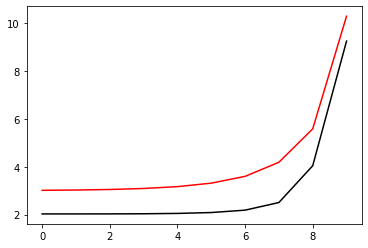

1000 99.0021636201675 8.984793707701481
[2.02726582 2.02737104 2.02873774 2.03377196 2.04796534 2.08503535
 2.18470583 2.50336406 4.04282596 9.25710194]


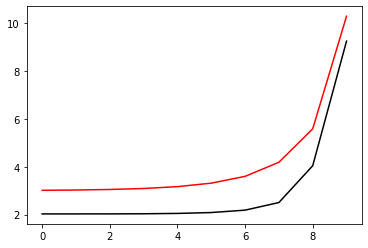

1100 99.0021631063122 8.984470562755877
[2.02726822 2.02737338 2.02873915 2.03377032 2.04795741 2.08502118
 2.18471282 2.50350253 4.04245265 9.25660137]


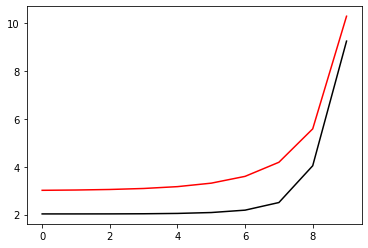

1200 99.00216259298912 8.984147676056297
[2.02727062 2.02737573 2.02874058 2.03376873 2.0479496  2.08500723
 2.18472003 2.50364066 4.04207967 9.25610082]


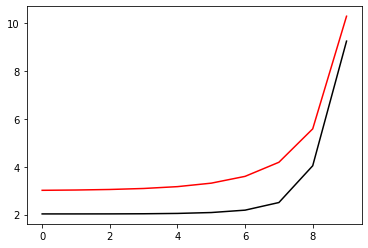

1300 99.00216208019648 8.983825047113225
[2.02727302 2.02737808 2.02874202 2.03376719 2.04794191 2.08499348
 2.18472744 2.50377843 4.04170702 9.25560028]


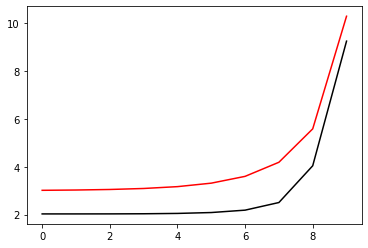

1400 99.00216156793246 8.983502675438615
[2.02727541 2.02738043 2.02874349 2.0337657  2.04793433 2.08497993
 2.18473506 2.50391586 4.04133471 9.25509975]


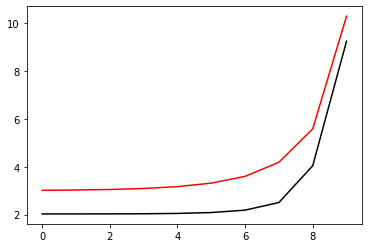

1500 99.00216105619529 8.983180560545902
[2.02727781 2.02738279 2.02874497 2.03376427 2.04792688 2.0849666
 2.18474289 2.50405294 4.04096274 9.25459924]


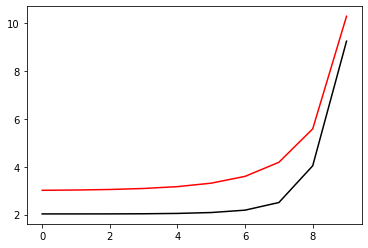

1600 99.00216054498317 8.982858701949969
[2.02728021 2.02738516 2.02874647 2.03376289 2.04791953 2.08495347
 2.18475093 2.50418967 4.0405911  9.25409873]


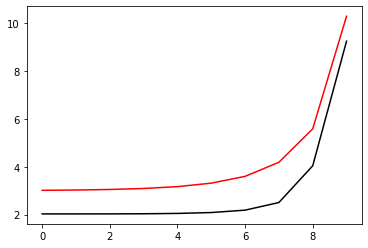

1700 99.00216003429433 8.982537099167196
[2.02728262 2.02738753 2.02874799 2.03376156 2.0479123  2.08494054
 2.18475917 2.50432606 4.0402198  9.25359824]


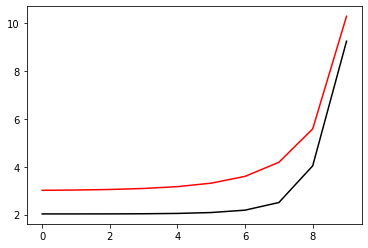

1800 99.002159524127 8.982215751715408
[2.02728502 2.02738991 2.02874953 2.03376029 2.04790519 2.08492782
 2.18476762 2.5044621  4.03984883 9.25309777]


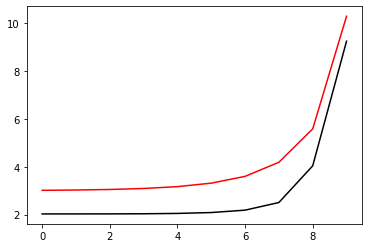

1900 99.00215901447947 8.981894659113866
[2.02728742 2.02739229 2.02875109 2.03375906 2.04789819 2.08491531
 2.18477627 2.5045978  4.03947819 9.2525973 ]


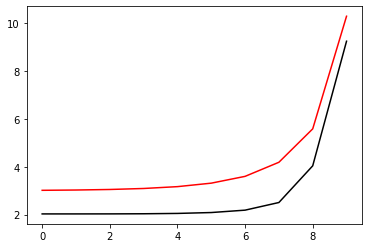

2000 99.00215850534997 8.981573820883296
[2.02728983 2.02739467 2.02875267 2.03375789 2.04789131 2.08490299
 2.18478513 2.50473316 4.03910789 9.25209685]


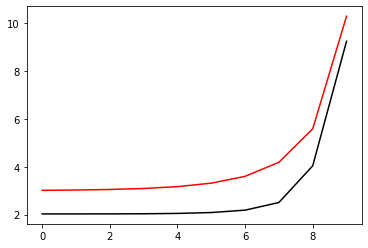

2100 99.00215799673674 8.981253236545856
[2.02729224 2.02739707 2.02875427 2.03375677 2.04788454 2.08489088
 2.18479419 2.50486818 4.03873791 9.25159641]


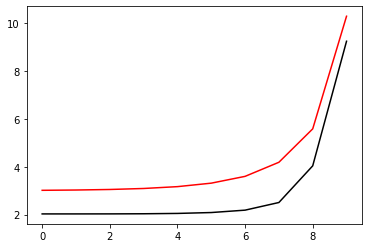

2200 99.00215748863812 8.980932905625144
[2.02729465 2.02739947 2.02875589 2.0337557  2.04787788 2.08487896
 2.18480345 2.50500286 4.03836827 9.25109598]


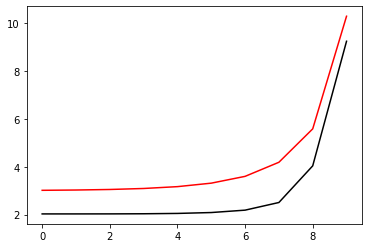

2300 99.00215698105235 8.980612827646175
[2.02729706 2.02740188 2.02875753 2.03375469 2.04787134 2.08486725
 2.18481291 2.50513719 4.03799896 9.25059556]


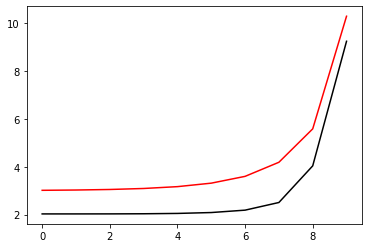

2400 99.00215647397772 8.980293002135385
[2.02729948 2.02740429 2.02875919 2.03375372 2.04786491 2.08485574
 2.18482256 2.50527119 4.03762998 9.25009516]


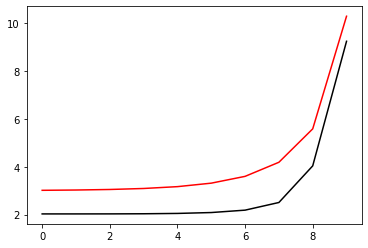

2500 99.00215596741256 8.979973428620628
[2.0273019  2.02740671 2.02876087 2.03375281 2.04785859 2.08484442
 2.18483242 2.50540485 4.03726133 9.24959477]


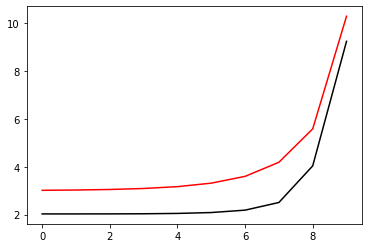

2600 99.00215546135516 8.979654106631171
[2.02730432 2.02740914 2.02876257 2.03375195 2.04785239 2.08483331
 2.18484248 2.50553818 4.03689301 9.24909439]


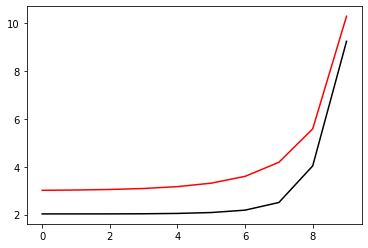

2700 99.00215495580383 8.979335035697698
[2.02730675 2.02741158 2.0287643  2.03375115 2.04784629 2.08482238
 2.18485273 2.50567117 4.03652502 9.24859403]


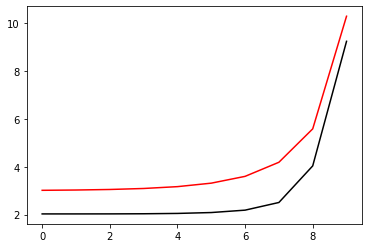

2800 99.00215445075693 8.97901621535226
[2.02730918 2.02741402 2.02876604 2.03375039 2.04784031 2.08481166
 2.18486317 2.50580382 4.03615736 9.24809367]


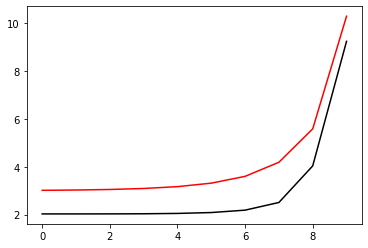

2900 99.00215394621279 8.97869764512833
[2.02731161 2.02741647 2.0287678  2.03374969 2.04783444 2.08480113
 2.18487381 2.50593614 4.03579002 9.24759333]


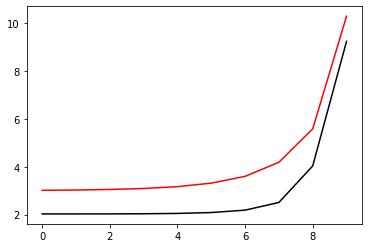

3000 99.00215344216974 8.978379324560747
[2.02731405 2.02741893 2.02876959 2.03374903 2.04782868 2.08479079
 2.18488465 2.50606813 4.03542301 9.24709301]


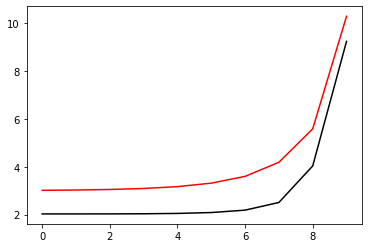

3100 99.00215293862614 8.978061253185732
[2.02731649 2.0274214  2.0287714  2.03374843 2.04782303 2.08478065
 2.18489567 2.50619979 4.03505633 9.24659269]


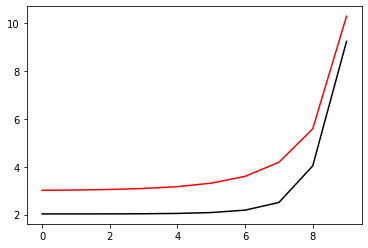

3200 99.00215243558034 8.97774343054091
[2.02731894 2.02742388 2.02877323 2.03374788 2.04781749 2.0847707
 2.18490689 2.50633112 4.03468998 9.24609239]


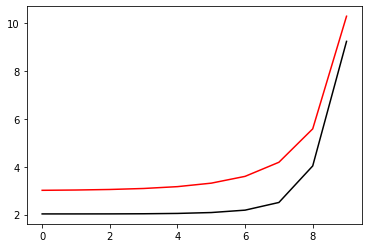

3300 99.00215193303075 8.97742585616524
[2.02732139 2.02742636 2.02877508 2.03374739 2.04781207 2.08476094
 2.1849183  2.50646211 4.03432395 9.2455921 ]


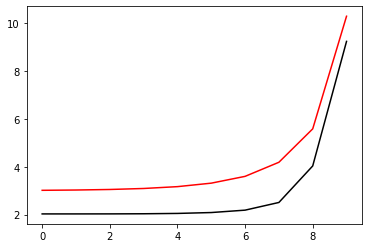

3400 99.00215143097572 8.977108529599072
[2.02732385 2.02742886 2.02877695 2.03374694 2.04780675 2.08475138
 2.1849299  2.50659278 4.03395824 9.24509183]


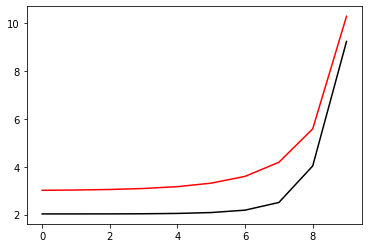

3500 99.00215092941363 8.97679145038409
[2.02732631 2.02743136 2.02877884 2.03374655 2.04780154 2.084742
 2.18494168 2.50672312 4.03359286 9.24459157]


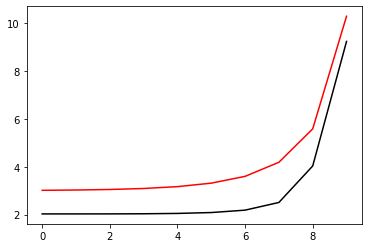

3600 99.00215042834289 8.97647461806336
[2.02732878 2.02743387 2.02878076 2.03374621 2.04779644 2.08473282
 2.18495366 2.50685313 4.0332278  9.24409132]


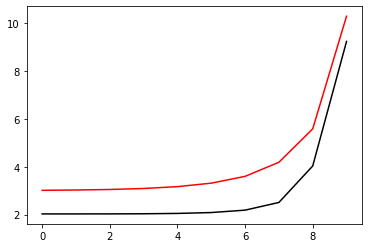

3700 99.0021499277619 8.976158032181267
[2.02733125 2.02743639 2.02878269 2.03374592 2.04779144 2.08472382
 2.18496582 2.50698282 4.03286307 9.24359108]


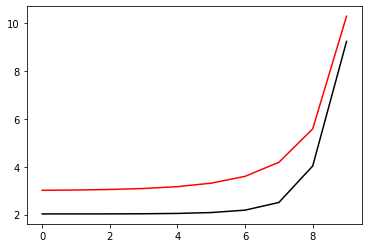

3800 99.0021494276691 8.975841692283561
[2.02733373 2.02743893 2.02878465 2.03374568 2.04778656 2.08471501
 2.18497816 2.50711218 4.03249866 9.24309086]


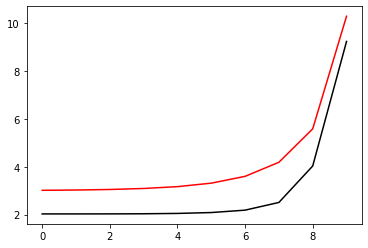

3900 99.00214892806287 8.975525597917306
[2.02733622 2.02744147 2.02878664 2.03374549 2.04778178 2.08470639
 2.1849907  2.50724122 4.03213457 9.24259065]


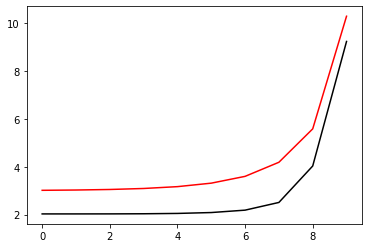

4000 99.00214842894165 8.97520974863092
[2.02733871 2.02744402 2.02878864 2.03374536 2.04777711 2.08469795
 2.18500341 2.50736993 4.03177081 9.24209045]


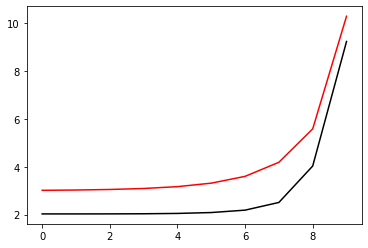

4100 99.00214793030386 8.974894143974124
[2.02734121 2.02744659 2.02879067 2.03374528 2.04777255 2.0846897
 2.18501631 2.50749832 4.03140736 9.24159027]


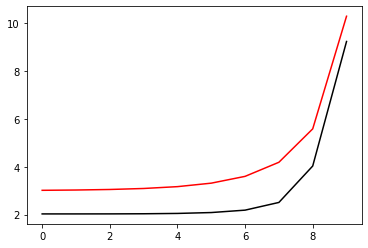

4200 99.00214743214799 8.974578783497993
[2.02734371 2.02744916 2.02879272 2.03374524 2.0477681  2.08468163
 2.18502939 2.50762639 4.03104424 9.24109009]


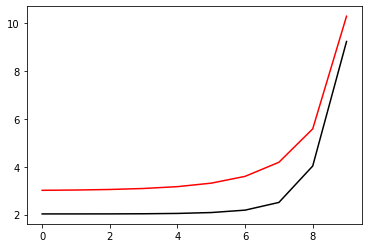

4300 99.00214693447246 8.974263666754874
[2.02734623 2.02745174 2.02879479 2.03374526 2.04776375 2.08467375
 2.18504265 2.50775414 4.03068143 9.24058994]


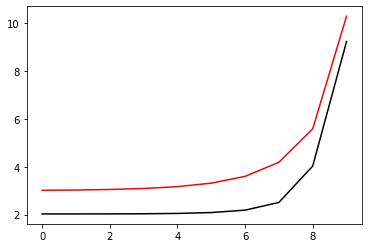

4400 99.00214643727574 8.97394879329847
[2.02734875 2.02745434 2.02879689 2.03374533 2.04775951 2.08466605
 2.18505609 2.50788157 4.03031895 9.24008979]


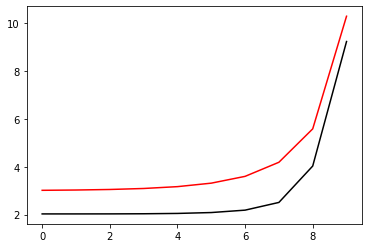

4500 99.00214594055629 8.973634162683753
[2.02735127 2.02745694 2.02879901 2.03374546 2.04775537 2.08465854
 2.18506971 2.50800868 4.02995679 9.23958966]


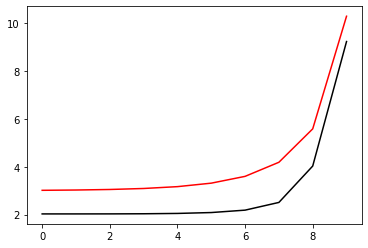

4600 99.00214544431257 8.973319774467022
[2.02735381 2.02745956 2.02880115 2.03374563 2.04775134 2.08465121
 2.18508351 2.50813548 4.02959494 9.23908954]


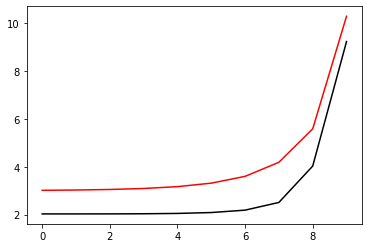

4700 99.0021449485431 8.973005628205845
[2.02735635 2.02746219 2.02880332 2.03374586 2.04774742 2.08464405
 2.18509749 2.50826195 4.02923341 9.23858944]


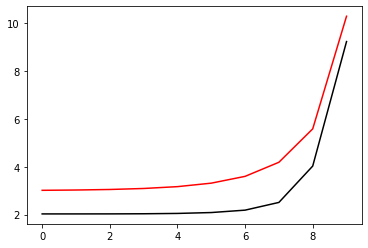

4800 99.00214445324636 8.972691723459077
[2.02735891 2.02746483 2.02880551 2.03374613 2.0477436  2.08463708
 2.18511164 2.50838811 4.02887221 9.23808935]


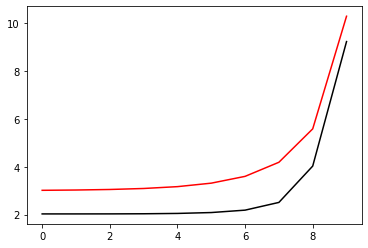

4900 99.00214395842082 8.97237805978687
[2.02736147 2.02746749 2.02880772 2.03374646 2.04773988 2.08463029
 2.18512597 2.50851396 4.02851131 9.23758927]


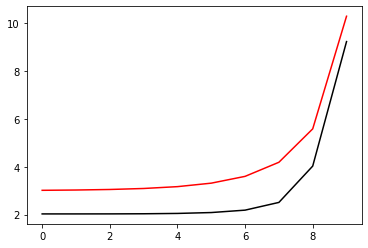

5000 99.002143464065 8.972064636750666
[2.02736404 2.02747015 2.02880996 2.03374684 2.04773627 2.08462368
 2.18514048 2.50863949 4.02815074 9.2370892 ]


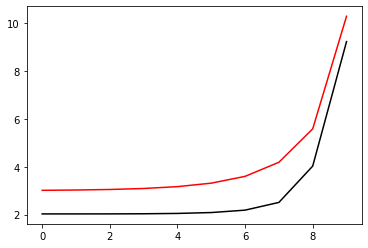

5100 99.00214297017745 8.971751453913166
[2.02736661 2.02747283 2.02881222 2.03374727 2.04773276 2.08461724
 2.18515515 2.5087647  4.02779048 9.23658915]


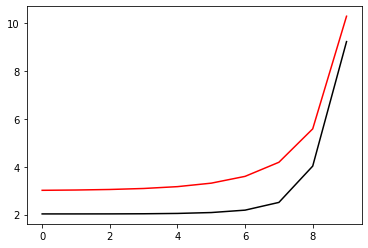

5200 99.00214247675662 8.971438510838333
[2.0273692  2.02747552 2.02881451 2.03374775 2.04772936 2.08461098
 2.18517001 2.50888961 4.02743054 9.23608911]


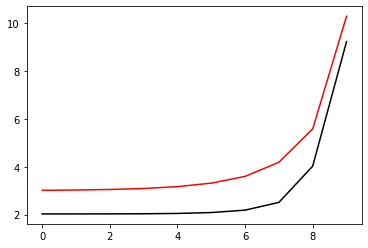

5300 99.0021419838011 8.971125807091406
[2.0273718  2.02747822 2.02881681 2.03374829 2.04772606 2.0846049
 2.18518503 2.5090142  4.02707091 9.23558909]


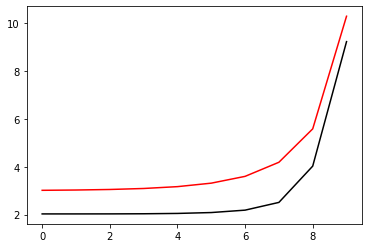

5400 99.00214149130939 8.970813342238888
[2.0273744  2.02748094 2.02881915 2.03374887 2.04772286 2.084599
 2.18520022 2.50913848 4.0267116  9.23508908]


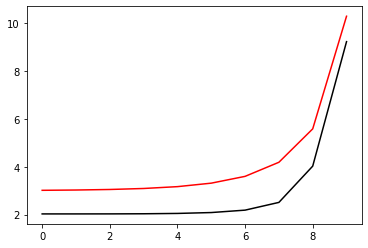

5500 99.00214099928006 8.97050111584851
[2.02737702 2.02748366 2.02882151 2.03374951 2.04771977 2.08459327
 2.18521559 2.50926245 4.0263526  9.23458908]


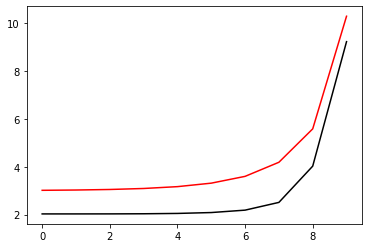

5600 99.00214050771163 8.970189127489272
[2.02737964 2.02748641 2.02882389 2.03375019 2.04771678 2.08458771
 2.18523112 2.50938611 4.02599391 9.2340891 ]


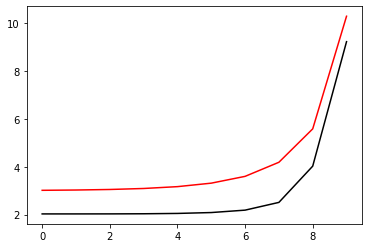

5700 99.00214001660267 8.969877376731398
[2.02738227 2.02748916 2.02882629 2.03375093 2.04771389 2.08458233
 2.18524683 2.50950947 4.02563554 9.23358913]


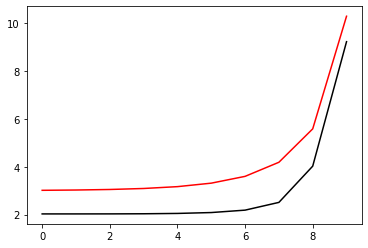

5800 99.00213952595173 8.969565863146391
[2.02738492 2.02749193 2.02882873 2.03375172 2.0477111  2.08457713
 2.1852627  2.50963252 4.02527748 9.23308917]


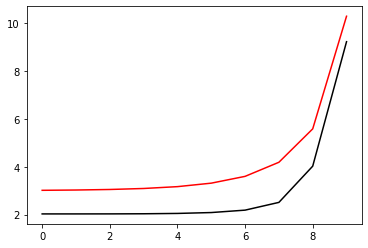

5900 99.00213903575742 8.969254586306935
[2.02738757 2.02749471 2.02883118 2.03375256 2.04770842 2.08457209
 2.18527874 2.50975526 4.02491974 9.23258923]


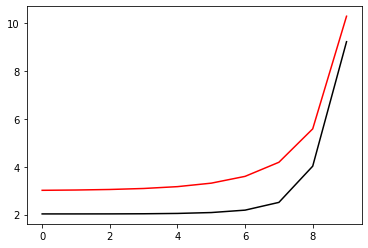

6000 99.00213854601829 8.968943545786978
[2.02739024 2.02749751 2.02883366 2.03375345 2.04770584 2.08456723
 2.18529494 2.50987769 4.0245623  9.2320893 ]


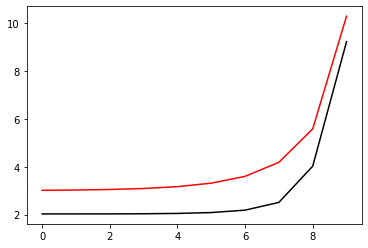

6100 99.0021380567329 8.96863274116169
[2.02739292 2.02750032 2.02883617 2.03375439 2.04770335 2.08456254
 2.18531131 2.50999982 4.02420518 9.23158938]


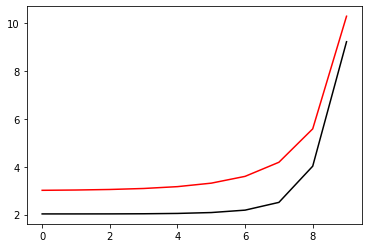

6200 99.0021375678999 8.968322172007426
[2.0273956  2.02750314 2.0288387  2.03375538 2.04770097 2.08455801
 2.18532785 2.51012165 4.02384837 9.23108948]


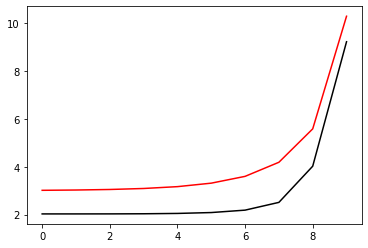

6300 99.00213707951785 8.968011837901797
[2.0273983  2.02750598 2.02884126 2.03375643 2.04769869 2.08455366
 2.18534454 2.51024317 4.02349186 9.23058959]


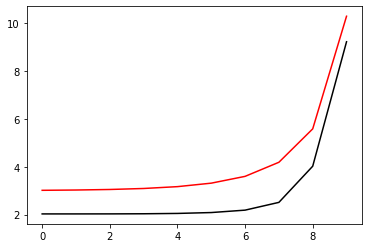

6400 99.00213659158538 8.967701738423594
[2.02740101 2.02750883 2.02884384 2.03375752 2.04769651 2.08454948
 2.1853614  2.51036439 4.02313567 9.23008972]


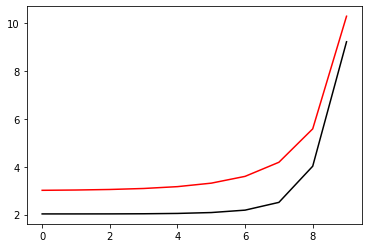

6500 99.00213610410107 8.967391873152842
[2.02740373 2.0275117  2.02884645 2.03375867 2.04769442 2.08454546
 2.18537843 2.51048531 4.02277979 9.22958985]


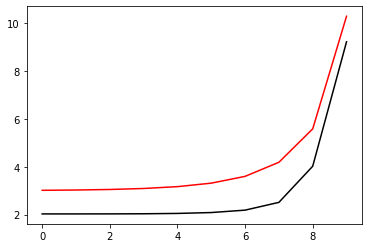

6600 99.00213561706356 8.967082241670726
[2.02740647 2.02751458 2.02884908 2.03375986 2.04769244 2.08454162
 2.18539561 2.51060593 4.02242421 9.22909001]


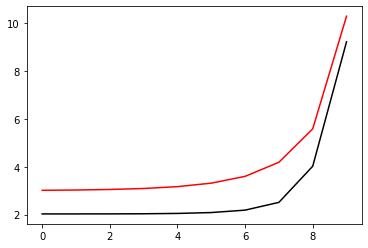

6700 99.00213513047146 8.966772843559664
[2.02740921 2.02751748 2.02885174 2.03376111 2.04769056 2.08453793
 2.18541295 2.51072625 4.02206895 9.22859017]


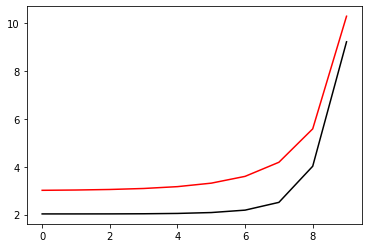

6800 99.00213464432343 8.966463678403228
[2.02741197 2.02752039 2.02885443 2.03376241 2.04768877 2.08453442
 2.18543046 2.51084627 4.02171399 9.22809036]


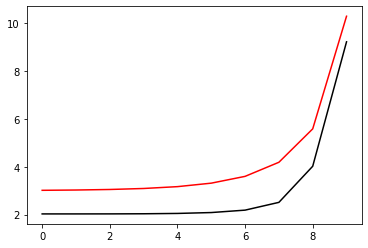

6900 99.00213415861809 8.96615474578622
[2.02741474 2.02752332 2.02885714 2.03376376 2.04768709 2.08453107
 2.18544812 2.51096599 4.02135934 9.22759055]


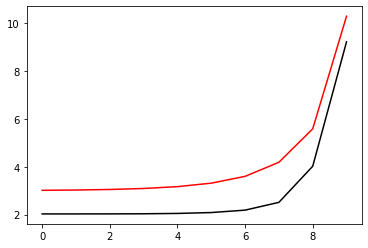

7000 99.0021336733541 8.96584604529458
[2.02741752 2.02752627 2.02885987 2.03376516 2.0476855  2.08452789
 2.18546594 2.51108541 4.021005   9.22709076]


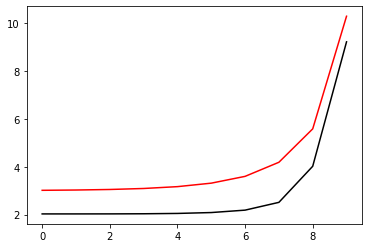

7100 99.00213318853008 8.96553757651544
[2.02742032 2.02752923 2.02886263 2.03376661 2.04768401 2.08452487
 2.18548392 2.51120454 4.02065096 9.22659098]


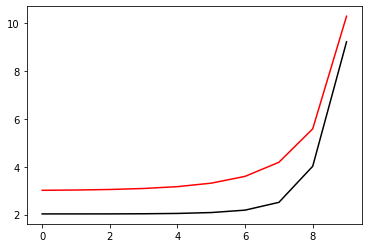

7200 99.00213270414474 8.965229339037107
[2.02742312 2.0275322  2.02886542 2.03376811 2.04768262 2.08452201
 2.18550205 2.51132337 4.02029723 9.22609122]


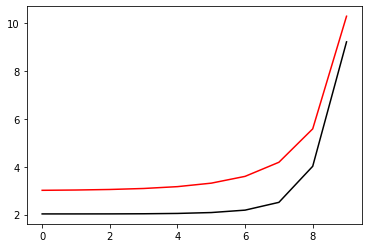

7300 99.00213222019671 8.964921332449059
[2.02742594 2.02753519 2.02886824 2.03376966 2.04768133 2.08451932
 2.18552034 2.51144191 4.0199438  9.22559147]


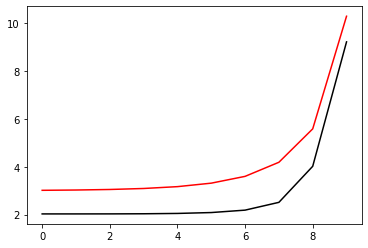

7400 99.00213173668466 8.964613556341922
[2.02742878 2.0275382  2.02887108 2.03377126 2.04768013 2.08451679
 2.18553878 2.51156015 4.01959068 9.22509173]


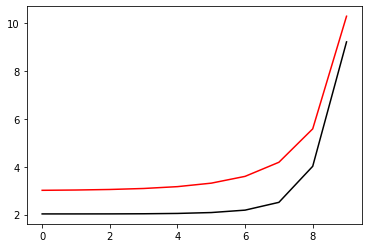

7500 99.00213125360729 8.964306010307492
[2.02743162 2.02754123 2.02887395 2.03377291 2.04767903 2.08451442
 2.18555738 2.51167811 4.01923786 9.22459201]


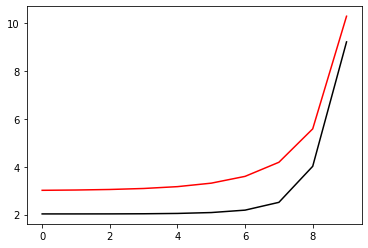

7600 99.00213077096328 8.963998693938722
[2.02743448 2.02754427 2.02887684 2.03377462 2.04767803 2.08451221
 2.18557613 2.51179576 4.01888535 9.22409231]


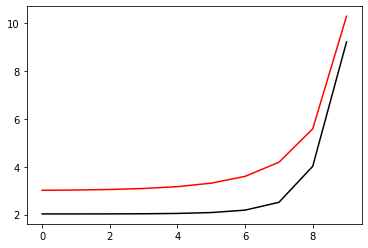

7700 99.00213028875129 8.963691606829686
[2.02743736 2.02754732 2.02887977 2.03377637 2.04767712 2.08451016
 2.18559503 2.51191313 4.01853314 9.22359261]


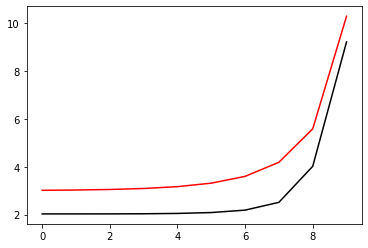

7800 99.00212980697006 8.963384748575635
[2.02744024 2.0275504  2.02888271 2.03377817 2.04767631 2.08450827
 2.18561408 2.51203021 4.01818124 9.22309293]


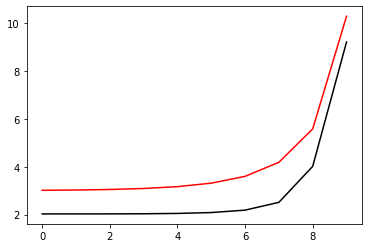

7900 99.00212932561827 8.963078118772955
[2.02744315 2.02755349 2.02888569 2.03378003 2.04767559 2.08450654
 2.18563329 2.51214699 4.01782963 9.22259327]


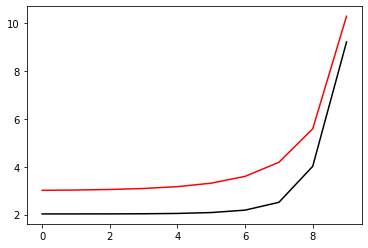

8000 99.00212884469464 8.96277171701915
[2.02744606 2.0275566  2.02888869 2.03378193 2.04767497 2.08450497
 2.18565264 2.51226349 4.01747833 9.22209362]


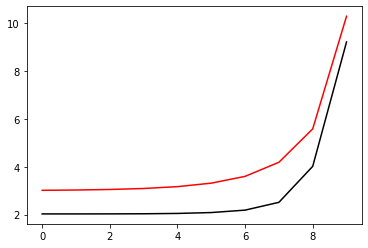

8100 99.0021283641979 8.962465542912858
[2.02744899 2.02755972 2.02889172 2.03378389 2.04767445 2.08450356
 2.18567215 2.5123797  4.01712733 9.22159398]


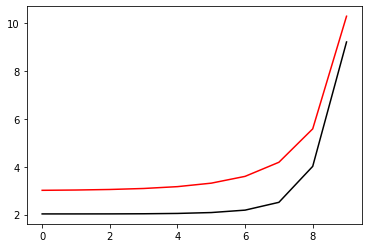

8200 99.00212788412672 8.962159596053866
[2.02745194 2.02756287 2.02889478 2.03378589 2.04767402 2.0845023
 2.1856918  2.51249562 4.01677664 9.22109436]


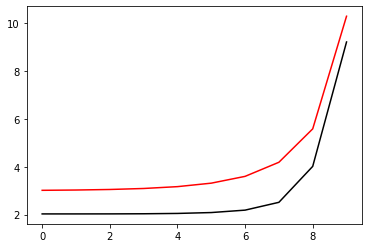

8300 99.00212740447988 8.961853876043051
[2.0274549  2.02756603 2.02889786 2.03378795 2.04767369 2.0845012
 2.1857116  2.51261126 4.01642624 9.22059475]


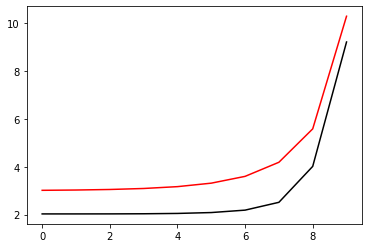

8400 99.00212692525609 8.961548382482428
[2.02745787 2.02756921 2.02890097 2.03379006 2.04767344 2.08450025
 2.18573154 2.51272661 4.01607614 9.22009516]


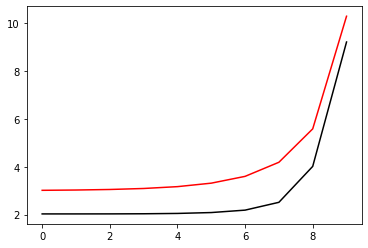

8500 99.0021264464541 8.961243114975115
[2.02746086 2.0275724  2.02890411 2.03379221 2.0476733  2.08449946
 2.18575163 2.51284167 4.01572634 9.21959558]


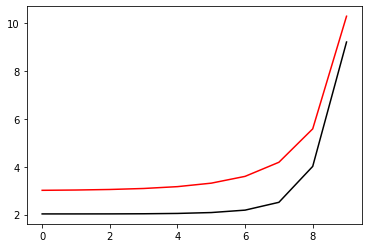

8600 99.00212596807265 8.960938073125359
[2.02746387 2.02757562 2.02890728 2.03379442 2.04767325 2.08449883
 2.18577187 2.51295645 4.01537685 9.21909602]


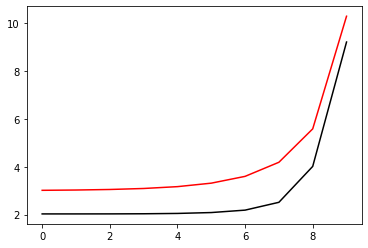

8700 99.00212549011052 8.960633256538491
[2.02746689 2.02757885 2.02891047 2.03379668 2.04767329 2.08449834
 2.18579225 2.51307095 4.01502765 9.21859647]


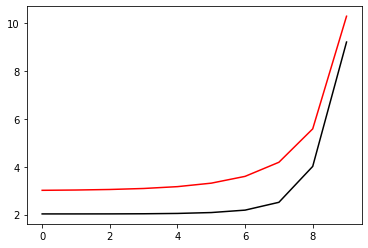

8800 99.00212501256641 8.960328664820942
[2.02746992 2.0275821  2.02891369 2.03379898 2.04767342 2.08449802
 2.18581278 2.51318516 4.01467875 9.21809693]


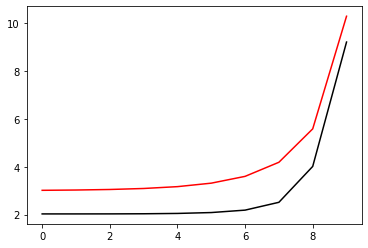

8900 99.00212453543912 8.960024297580265
[2.02747298 2.02758537 2.02891694 2.03380134 2.04767365 2.08449784
 2.18583344 2.51329909 4.01433014 9.21759741]


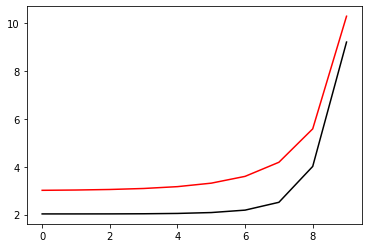

9000 99.00212405872743 8.959720154425082
[2.02747604 2.02758866 2.02892022 2.03380375 2.04767397 2.08449781
 2.18585425 2.51341274 4.01398184 9.21709791]


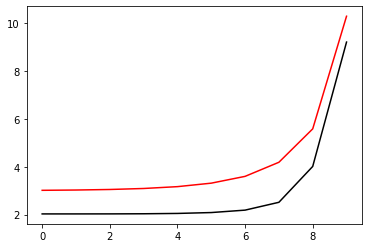

9100 99.0021235824301 8.9594162349651
[2.02747913 2.02759197 2.02892353 2.0338062  2.04767438 2.08449794
 2.1858752  2.51352611 4.01363383 9.21659841]


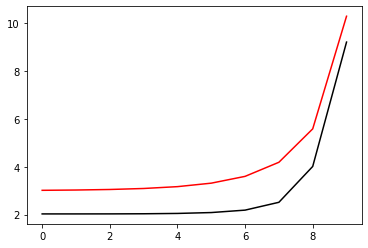

9200 99.00212310654592 8.959112538811139
[2.02748223 2.02759529 2.02892686 2.03380871 2.04767489 2.08449822
 2.1858963  2.5136392  4.01328612 9.21609894]


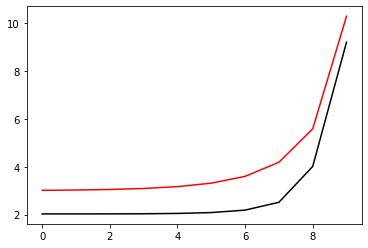

9300 99.00212263107366 8.958809065575048
[2.02748534 2.02759864 2.02893022 2.03381127 2.04767548 2.08449865
 2.18591753 2.51375201 4.0129387  9.21559947]


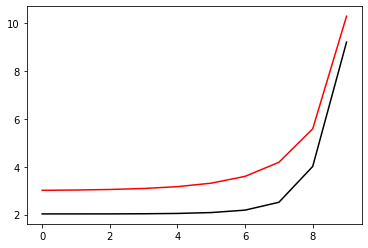

9400 99.00212215601213 8.958505814869802
[2.02748847 2.027602   2.02893361 2.03381388 2.04767617 2.08449922
 2.1859389  2.51386455 4.01259158 9.21510003]


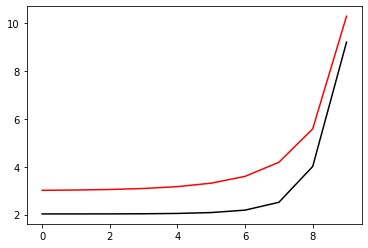

9500 99.00212168136015 8.95820278630942
[2.02749162 2.02760538 2.02893703 2.03381653 2.04767695 2.08449995
 2.18596041 2.5139768  4.01224476 9.21460059]


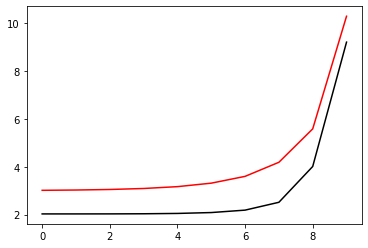

9600 99.00212120711646 8.957899979508989
[2.02749479 2.02760879 2.02894048 2.03381924 2.04767782 2.08450082
 2.18598206 2.51408878 4.01189823 9.21410117]


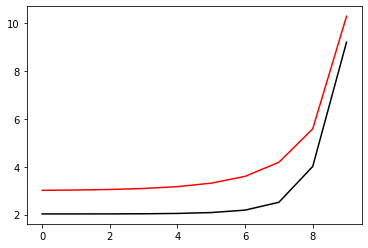

9700 99.00212073327991 8.957597394084681
[2.02749797 2.02761221 2.02894395 2.033822   2.04767878 2.08450185
 2.18600384 2.51420049 4.01155199 9.21360177]


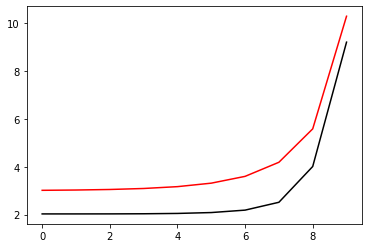

9800 99.00212025984932 8.957295029653697
[2.02750117 2.02761565 2.02894746 2.0338248  2.04767984 2.08450302
 2.18602576 2.51431192 4.01120605 9.21310238]


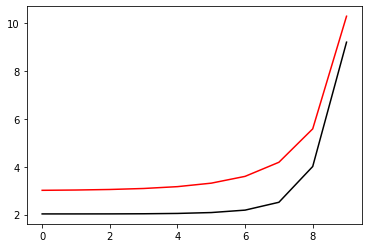

9900 99.0021197868235 8.956992885834305
[2.02750439 2.02761912 2.02895099 2.03382766 2.04768098 2.08450433
 2.18604782 2.51442307 4.0108604  9.212603  ]


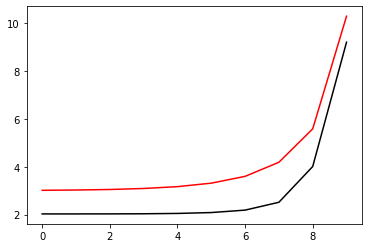

10000 99.00211931420128 8.956690962245837
[2.02750763 2.0276226  2.02895455 2.03383056 2.04768221 2.08450579
 2.18607001 2.51453395 4.01051505 9.21210364]


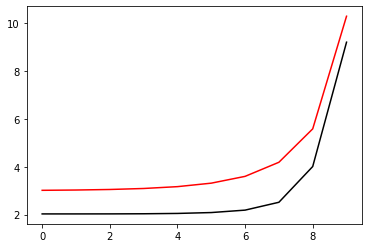

In [69]:
optimizer=tf.optimizers.SGD(learning_rate=0.01)
for i in range (1, 10001):
    run()
    if i%100==0: print(i, Error_func(h, m2_2).numpy(), m2_2.numpy()), print(h.numpy()), plt.plot(h_real, 'r-'), plt.plot(h.numpy(), 'k-'), plt.show()

100 99.00211884198148 8.956389258508658
[2.02751088 2.0276261  2.02895815 2.03383352 2.04768353 2.0845074
 2.18609233 2.51464456 4.01016998 9.2116043 ]


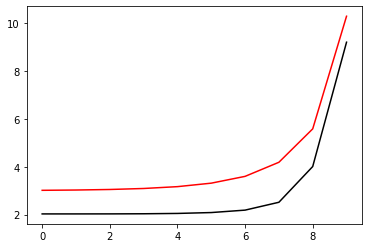

200 99.00211837016298 8.956087774244178
[2.02751415 2.02762962 2.02896177 2.03383653 2.04768495 2.08450915
 2.18611479 2.5147549  4.00982521 9.21110497]


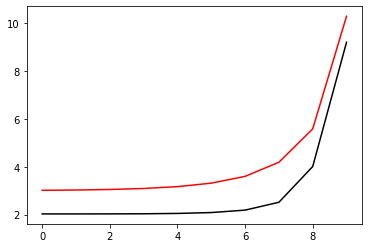

300 99.00211789874454 8.955786509074851
[2.02751744 2.02763317 2.02896541 2.03383958 2.04768645 2.08451104
 2.18613739 2.51486496 4.00948073 9.21060565]


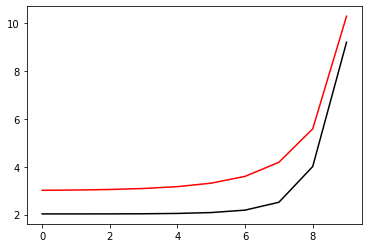

400 99.0021174277251 8.955485462624152
[2.02752074 2.02763673 2.02896909 2.03384268 2.04768804 2.08451308
 2.18616011 2.51497476 4.00913654 9.21010635]


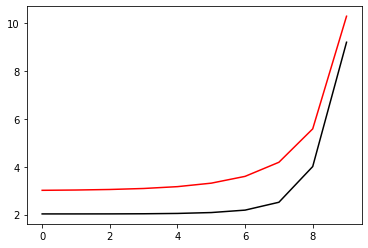

500 99.00211695710345 8.955184634516613
[2.02752407 2.02764031 2.0289728  2.03384584 2.04768972 2.08451526
 2.18618296 2.51508428 4.00879265 9.20960707]


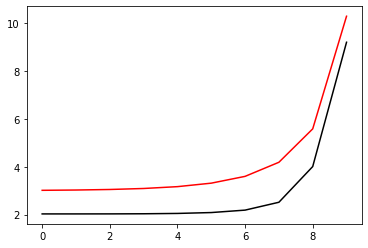

600 99.00211648687846 8.954884024377764
[2.02752741 2.02764392 2.02897654 2.03384904 2.04769149 2.08451759
 2.18620595 2.51519354 4.00844904 9.2091078 ]


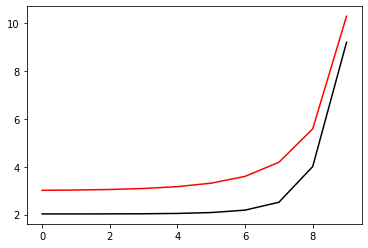

700 99.00211601704902 8.954583631834174
[2.02753077 2.02764755 2.0289803  2.0338523  2.04769334 2.08452005
 2.18622906 2.51530252 4.00810572 9.20860854]


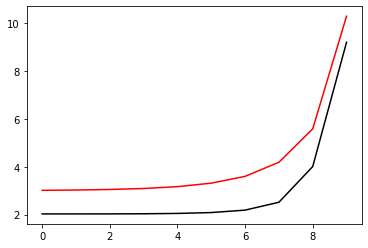

800 99.00211554761397 8.954283456513426
[2.02753415 2.02765119 2.0289841  2.0338556  2.04769529 2.08452266
 2.18625231 2.51541124 4.00776269 9.2081093 ]


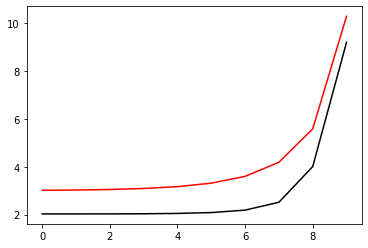

900 99.0021150785722 8.953983498044138
[2.02753755 2.02765486 2.02898792 2.03385895 2.04769732 2.08452541
 2.18627568 2.5155197  4.00741995 9.20761007]


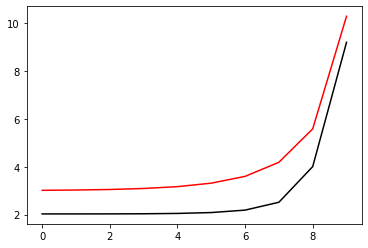

1000 99.00211460992259 8.953683756055918
[2.02754097 2.02765855 2.02899178 2.03386235 2.04769944 2.08452829
 2.18629918 2.51562788 4.0070775  9.20711086]


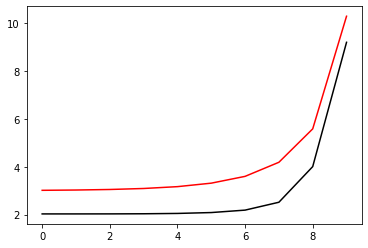

1100 99.00211414166402 8.953384230179381
[2.0275444  2.02766226 2.02899566 2.0338658  2.04770165 2.08453132
 2.18632281 2.5157358  4.00673534 9.20661167]


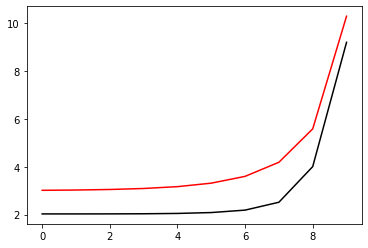

1200 99.00211367379536 8.953084920046166
[2.02754786 2.027666   2.02899958 2.0338693  2.04770394 2.08453449
 2.18634656 2.51584346 4.00639346 9.20611249]


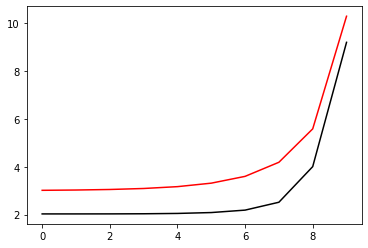

1300 99.00211320631553 8.952785825288883
[2.02755133 2.02766975 2.02900352 2.03387285 2.04770632 2.08453779
 2.18637044 2.51595085 4.00605188 9.20561332]


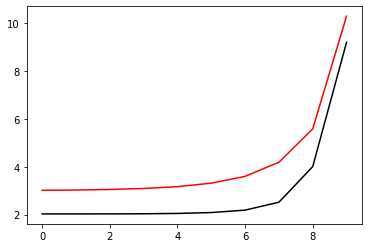

1400 99.00211273922342 8.952486945541171
[2.02755483 2.02767353 2.02900749 2.03387645 2.04770879 2.08454123
 2.18639445 2.51605798 4.00571057 9.20511417]


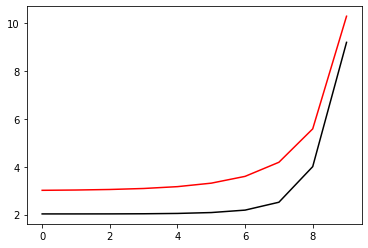

1500 99.00211227251796 8.952188280437632
[2.02755834 2.02767733 2.0290115  2.0338801  2.04771134 2.08454481
 2.18641858 2.51616485 4.00536956 9.20461504]


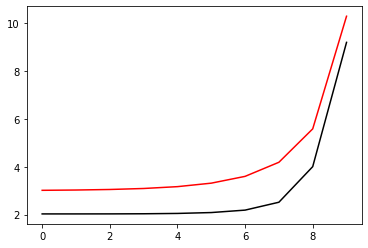

1600 99.002111806198 8.95188982961388
[2.02756187 2.02768115 2.02901553 2.0338838  2.04771398 2.08454853
 2.18644283 2.51627146 4.00502883 9.20411592]


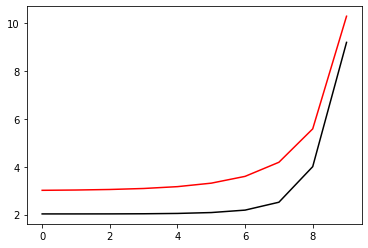

1700 99.0021113402625 8.9515915927065
[2.02756543 2.02768499 2.0290196  2.03388754 2.04771671 2.08455238
 2.18646721 2.5163778  4.00468839 9.20361681]


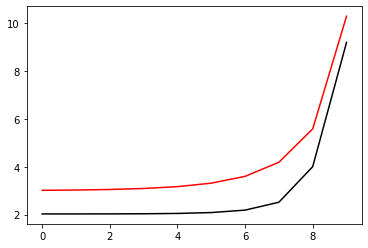

1800 99.00211087471038 8.951293569353064
[2.027569   2.02768885 2.02902369 2.03389134 2.04771952 2.08455636
 2.18649171 2.51648388 4.00434823 9.20311772]


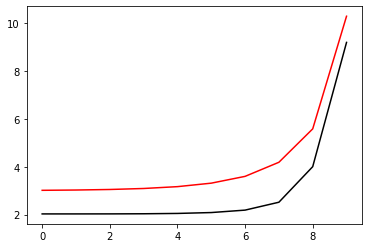

1900 99.00211040954056 8.950995759192127
[2.0275726  2.02769274 2.02902782 2.03389518 2.04772242 2.08456049
 2.18651633 2.51658971 4.00400835 9.20261865]


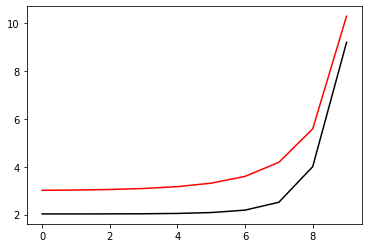

2000 99.00210994475195 8.95069816186322
[2.02757621 2.02769665 2.02903197 2.03389908 2.0477254  2.08456474
 2.18654107 2.51669527 4.00366876 9.20211959]


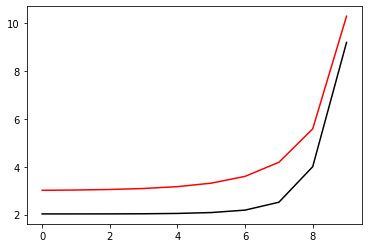

2100 99.0021094803435 8.95040077700683
[2.02757984 2.02770058 2.02903616 2.03390302 2.04772847 2.08456913
 2.18656593 2.51680058 4.00332946 9.20162054]


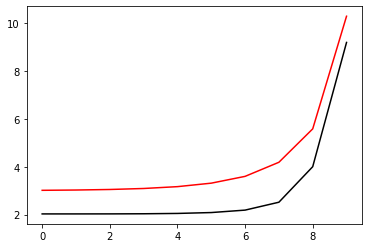

2200 99.00210901631412 8.950103604264417
[2.0275835  2.02770454 2.02904037 2.03390701 2.04773162 2.08457366
 2.18659092 2.51690563 4.00299043 9.20112152]


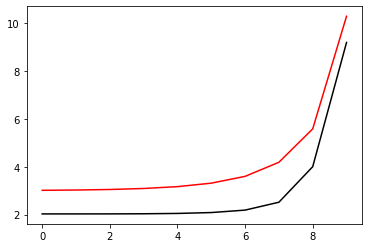

2300 99.00210855266282 8.949806643278416
[2.02758717 2.02770852 2.02904462 2.03391105 2.04773485 2.08457831
 2.18661602 2.51701042 4.00265169 9.2006225 ]


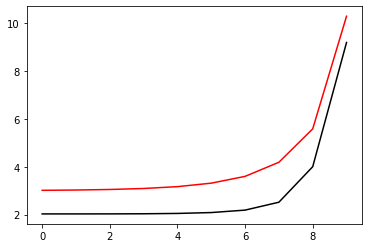

2400 99.00210808938849 8.949509893692206
[2.02759087 2.02771252 2.0290489  2.03391514 2.04773817 2.0845831
 2.18664124 2.51711496 4.00231323 9.20012351]


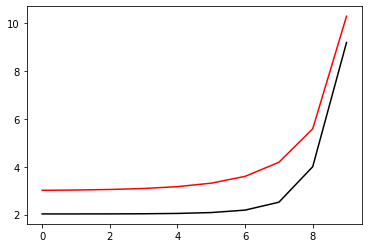

2500 99.00210762649009 8.949213355150137
[2.02759459 2.02771654 2.02905321 2.03391928 2.04774157 2.08458802
 2.18666657 2.51721924 4.00197506 9.19962452]


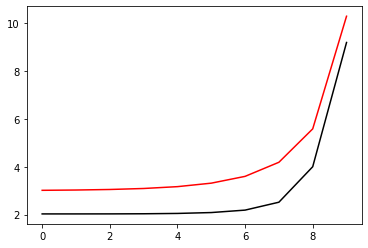

2600 99.0021071639666 8.9489170272975
[2.02759833 2.02772059 2.02905754 2.03392347 2.04774506 2.08459307
 2.18669203 2.51732327 4.00163716 9.19912556]


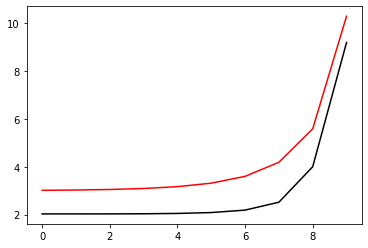

2700 99.00210670181694 8.948620909780544
[2.02760209 2.02772466 2.02906191 2.0339277  2.04774863 2.08459825
 2.1867176  2.51742704 4.00129955 9.19862661]


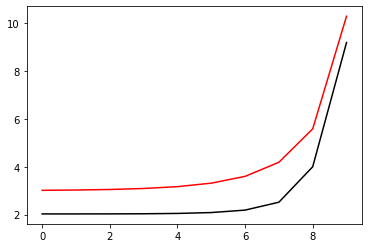

2800 99.00210624004013 8.948325002246452
[2.02760587 2.02772876 2.02906631 2.03393199 2.04775229 2.08460357
 2.18674329 2.51753056 4.00096222 9.19812767]


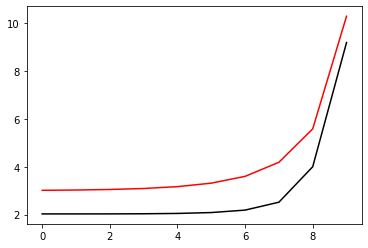

2900 99.00210577863511 8.948029304343363
[2.02760967 2.02773288 2.02907075 2.03393632 2.04775602 2.08460901
 2.18676909 2.51763382 4.00062517 9.19762875]


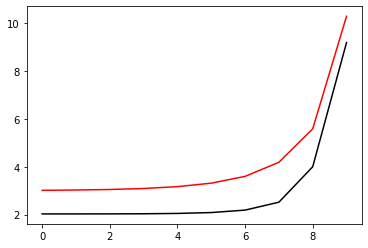

3000 99.00210531760088 8.947733815720351
[2.02761349 2.02773702 2.02907521 2.0339407  2.04775984 2.08461458
 2.18679501 2.51773684 4.00028839 9.19712985]


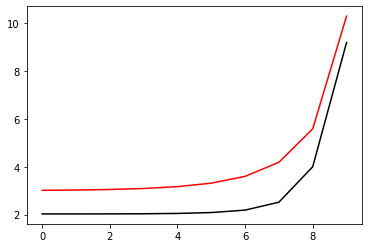

3100 99.0021048569364 8.947438536027418
[2.02761734 2.02774118 2.0290797  2.03394514 2.04776374 2.08462028
 2.18682104 2.5178396  3.9999519  9.19663096]


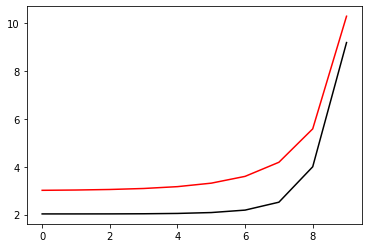

3200 99.00210439664063 8.947143464915499
[2.02762121 2.02774537 2.02908423 2.03394961 2.04776773 2.08462611
 2.18684718 2.51794211 3.99961569 9.19613208]


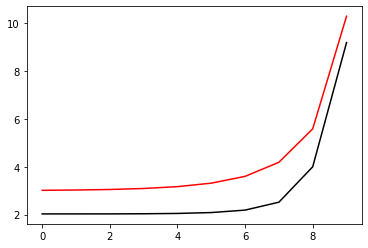

3300 99.00210393671261 8.946848602036463
[2.02762509 2.02774959 2.02908878 2.03395414 2.0477718  2.08463206
 2.18687344 2.51804438 3.99927975 9.19563322]


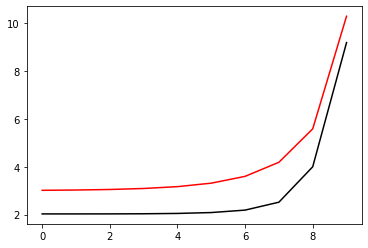

3400 99.0021034771513 8.946553947043112
[2.02762901 2.02775382 2.02909337 2.03395872 2.04777594 2.08463814
 2.18689981 2.51814639 3.99894409 9.19513438]


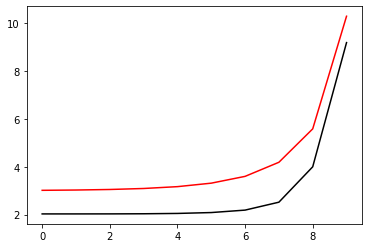

3500 99.00210301795572 8.946259499589157
[2.02763294 2.02775809 2.02909799 2.03396334 2.04778017 2.08464435
 2.18692629 2.51824815 3.99860871 9.19463556]


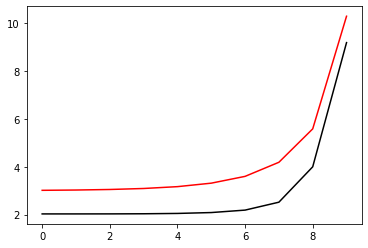

3600 99.00210255912488 8.945965259329222
[2.02763689 2.02776237 2.02910264 2.03396802 2.04778448 2.08465068
 2.18695288 2.51834967 3.99827361 9.19413675]


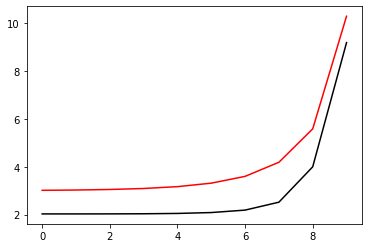

3700 99.00210210065775 8.945671225918861
[2.02764087 2.02776668 2.02910732 2.03397274 2.04778888 2.08465714
 2.18697958 2.51845094 3.99793879 9.19363795]


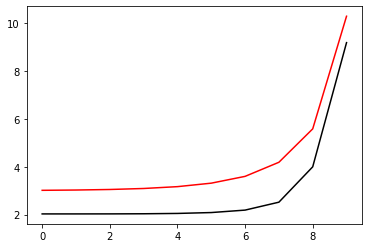

3800 99.00210164255337 8.945377399014536
[2.02764487 2.02777102 2.02911204 2.03397751 2.04779335 2.08466373
 2.1870064  2.51855196 3.99760424 9.19313917]


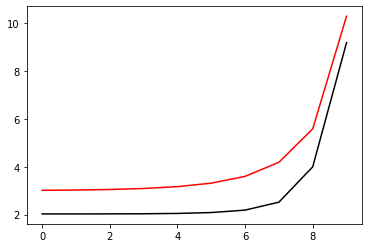

3900 99.00210118481074 8.945083778273602
[2.0276489  2.02777538 2.02911678 2.03398233 2.0477979  2.08467044
 2.18703332 2.51865274 3.99726997 9.19264041]


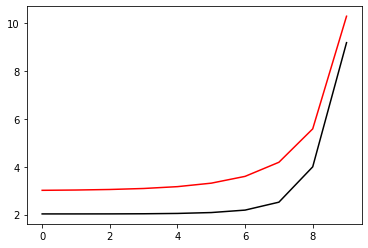

4000 99.0021007274289 8.944790363354342
[2.02765294 2.02777976 2.02912156 2.0339872  2.04780254 2.08467727
 2.18706035 2.51875327 3.99693597 9.19214166]


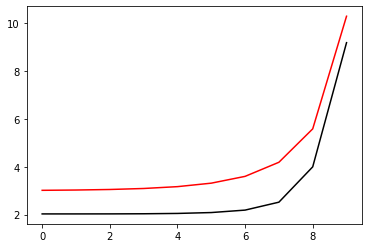

4100 99.00210027040683 8.944497153915911
[2.02765701 2.02778417 2.02912637 2.03399211 2.04780725 2.08468422
 2.18708748 2.51885356 3.99660225 9.19164293]


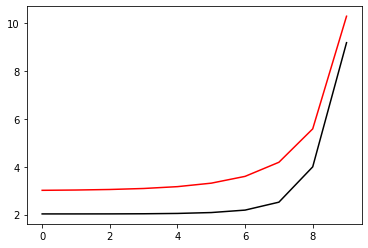

4200 99.00209981374363 8.944204149618391
[2.0276611  2.02778861 2.02913121 2.03399708 2.04781204 2.0846913
 2.18711473 2.5189536  3.9962688  9.19114421]


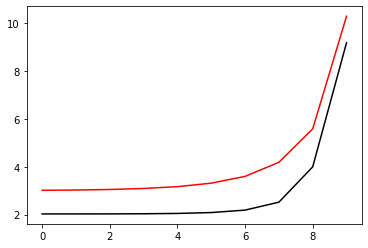

4300 99.00209935743827 8.943911350122754
[2.02766522 2.02779307 2.02913608 2.03400209 2.04781692 2.0846985
 2.18714208 2.5190534  3.99593563 9.19064551]


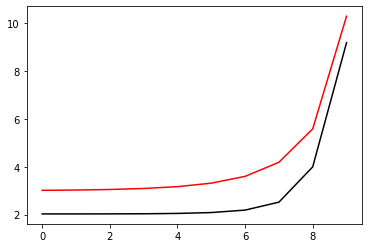

4400 99.00209890148982 8.943618755090844
[2.02766936 2.02779755 2.02914098 2.03400715 2.04782187 2.08470583
 2.18716954 2.51915296 3.99560273 9.19014683]


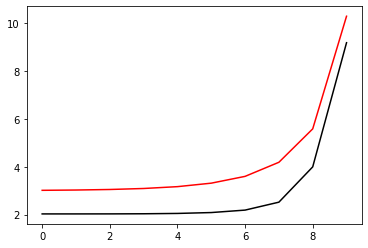

4500 99.0020984458973 8.9433263641854
[2.02767352 2.02780206 2.02914592 2.03401226 2.0478269  2.08471327
 2.1871971  2.51925227 3.99527011 9.18964816]


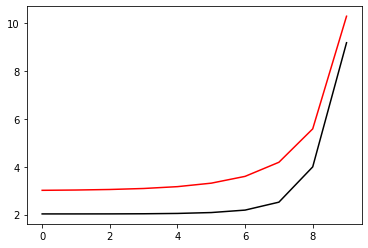

4600 99.0020979906598 8.943034177070082
[2.0276777  2.0278066  2.02915089 2.03401741 2.04783202 2.08472084
 2.18722477 2.51935135 3.99493776 9.18914951]


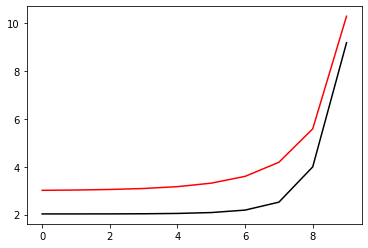

4700 99.00209753577631 8.942742193409384
[2.02768191 2.02781116 2.02915589 2.03402262 2.04783721 2.08472852
 2.18725254 2.51945018 3.99460568 9.18865087]


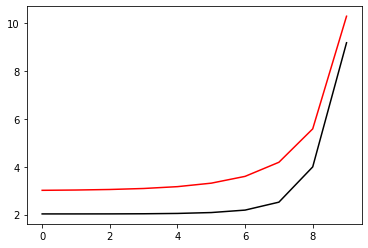

4800 99.00209708124592 8.942450412868691
[2.02768614 2.02781574 2.02916092 2.03402787 2.04784248 2.08473633
 2.18728042 2.51954877 3.99427388 9.18815225]


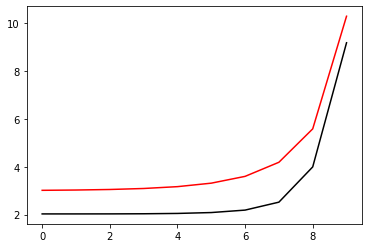

4900 99.00209662706769 8.942158835114286
[2.0276904  2.02782036 2.02916599 2.03403317 2.04784782 2.08474426
 2.18730839 2.51964713 3.99394234 9.18765365]


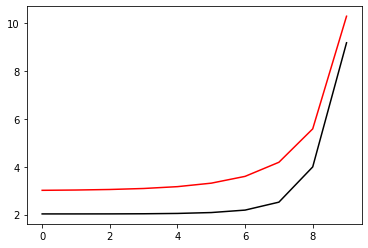

5000 99.00209617324067 8.94186745981328
[2.02769468 2.02782499 2.02917108 2.03403852 2.04785325 2.0847523
 2.18733648 2.51974524 3.99361108 9.18715506]


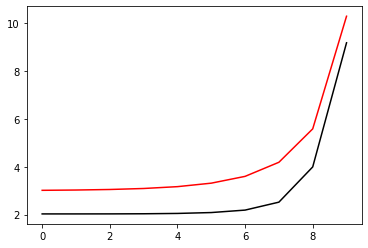

5100 99.00209571976391 8.941576286633705
[2.02769898 2.02782966 2.02917621 2.03404391 2.04785876 2.08476046
 2.18736466 2.51984312 3.99328009 9.18665648]


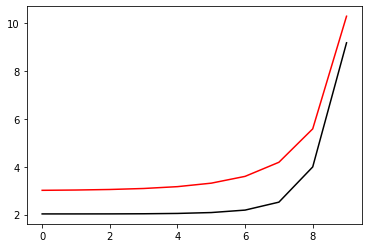

5200 99.0020952666365 8.94128531524443
[2.02770331 2.02783435 2.02918137 2.03404936 2.04786434 2.08476874
 2.18739294 2.51994076 3.99294937 9.18615793]


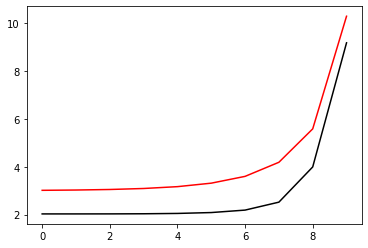

5300 99.00209481385752 8.940994545315192
[2.02770766 2.02783906 2.02918657 2.03405485 2.04787    2.08477714
 2.18742133 2.52003816 3.99261892 9.18565939]


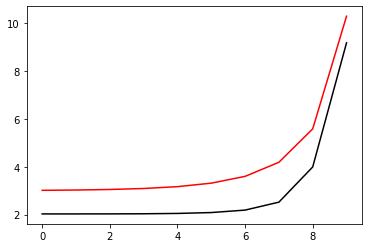

5400 99.00209436142603 8.940703976516586
[2.02771204 2.0278438  2.0291918  2.03406039 2.04787573 2.08478566
 2.18744982 2.52013532 3.99228874 9.18516086]


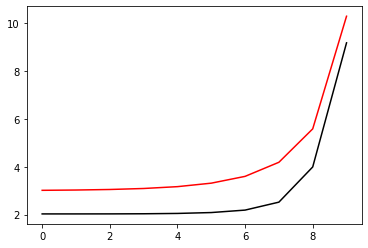

5500 99.00209390934114 8.94041360852006
[2.02771644 2.02784857 2.02919705 2.03406598 2.04788155 2.08479429
 2.1874784  2.52023226 3.99195883 9.18466236]


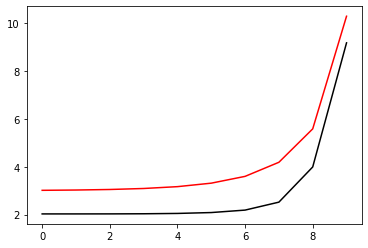

5600 99.0020934576019 8.940123440997928
[2.02772086 2.02785337 2.02920235 2.03407161 2.04788744 2.08480304
 2.18750709 2.52032895 3.99162919 9.18416387]


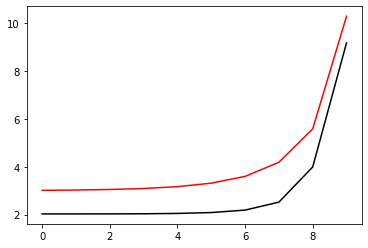

5700 99.00209300620742 8.939833473623334
[2.02772531 2.02785819 2.02920767 2.0340773  2.04789341 2.0848119
 2.18753587 2.52042541 3.99129982 9.18366539]


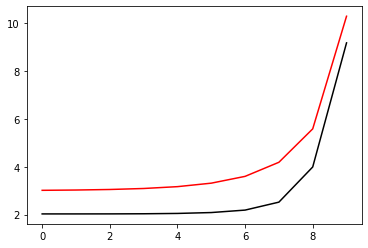

5800 99.00209255515679 8.939543706070312
[2.02772979 2.02786304 2.02921303 2.03408303 2.04789945 2.08482088
 2.18756475 2.52052164 3.99097072 9.18316693]


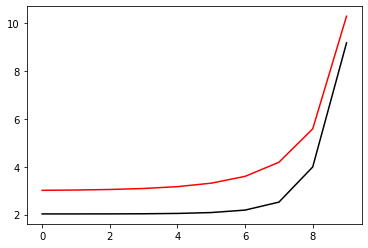

5900 99.0020921044491 8.939254138013675
[2.02773429 2.02786791 2.02921842 2.03408881 2.04790557 2.08482997
 2.18759373 2.52061763 3.99064188 9.18266849]


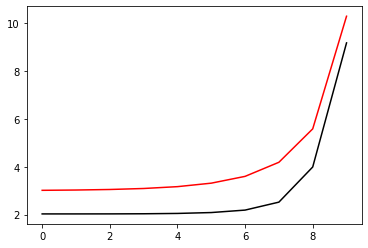

6000 99.00209165408347 8.938964769129127
[2.02773881 2.02787281 2.02922384 2.03409463 2.04791177 2.08483918
 2.18762281 2.5207134  3.99031332 9.18217006]


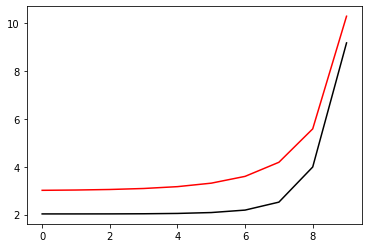

6100 99.002091204059 8.938675599093193
[2.02774336 2.02787774 2.0292293  2.03410051 2.04791804 2.0848485
 2.18765198 2.52080893 3.98998502 9.18167165]


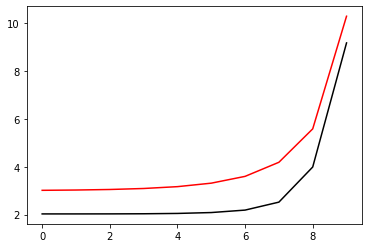

6200 99.00209075437476 8.938386627583244
[2.02774794 2.02788269 2.02923478 2.03410643 2.04792439 2.08485793
 2.18768125 2.52090423 3.98965698 9.18117326]


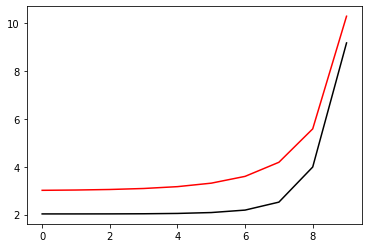

6300 99.00209030502992 8.938097854277476
[2.02775254 2.02788767 2.02924031 2.03411239 2.04793081 2.08486748
 2.18771061 2.5209993  3.98932922 9.18067488]


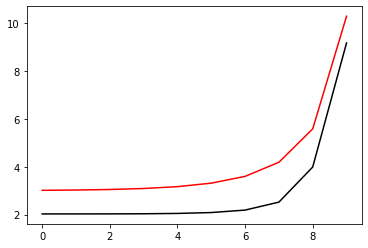

6400 99.00208985602359 8.937809278854912
[2.02775716 2.02789268 2.02924586 2.03411841 2.04793731 2.08487714
 2.18774007 2.52109413 3.98900172 9.18017652]


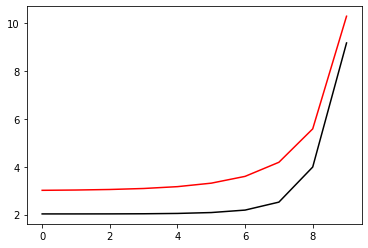

6500 99.00208940735484 8.9375209009954
[2.02776181 2.02789771 2.02925145 2.03412447 2.04794388 2.08488691
 2.18776962 2.52118874 3.98867448 9.17967818]


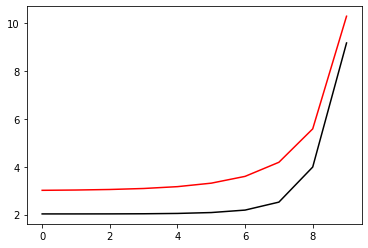

6600 99.00208895902284 8.937232720379605
[2.02776649 2.02790278 2.02925707 2.03413058 2.04795053 2.0848968
 2.18779927 2.52128312 3.98834751 9.17917985]


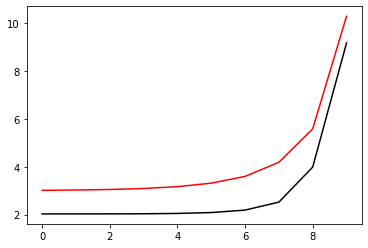

6700 99.0020885110267 8.936944736689044
[2.02777119 2.02790787 2.02926272 2.03413674 2.04795726 2.08490679
 2.18782901 2.52137728 3.98802081 9.17868154]


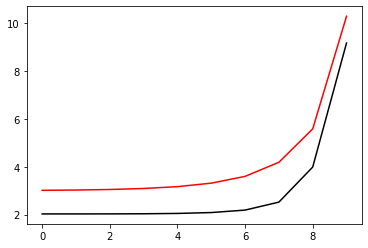

6800 99.00208806336555 8.936656949606014
[2.02777592 2.02791298 2.02926841 2.03414295 2.04796405 2.0849169
 2.18785884 2.5214712  3.98769437 9.17818324]


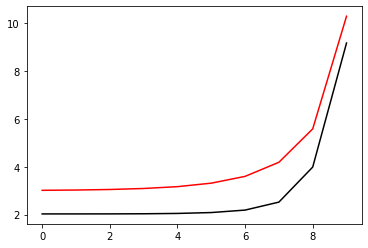

6900 99.00208761603852 8.93636935881363
[2.02778067 2.02791813 2.02927413 2.0341492  2.04797093 2.08492711
 2.18788876 2.5215649  3.98736819 9.17768496]


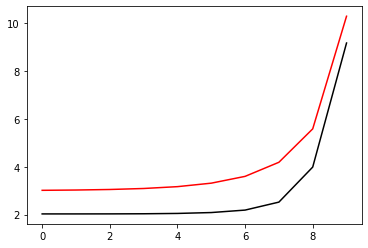

7000 99.00208716904477 8.93608196399586
[2.02778545 2.0279233  2.02927988 2.0341555  2.04797787 2.08493743
 2.18791878 2.52165837 3.98704228 9.1771867 ]


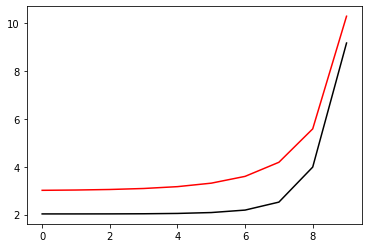

7100 99.00208672238342 8.935794764837427
[2.02779025 2.0279285  2.02928567 2.03416185 2.04798489 2.08494787
 2.18794888 2.52175162 3.98671663 9.17668845]


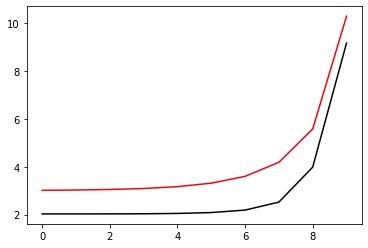

7200 99.00208627605365 8.935507761023887
[2.02779509 2.02793373 2.02929149 2.03416824 2.04799198 2.08495841
 2.18797908 2.52184464 3.98639125 9.17619022]


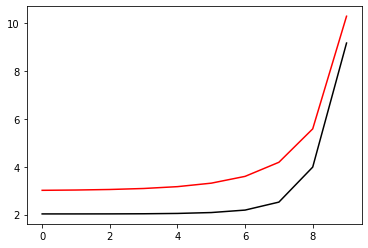

7300 99.00208583005455 8.935220952241613
[2.02779994 2.02793898 2.02929734 2.03417468 2.04799915 2.08496906
 2.18800937 2.52193743 3.98606613 9.17569201]


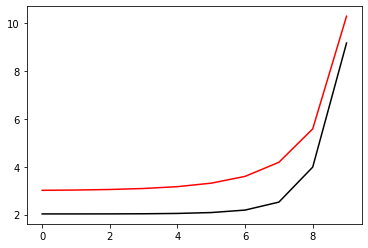

7400 99.00208538438532 8.934934338177744
[2.02780483 2.02794426 2.02930323 2.03418117 2.04800639 2.08497982
 2.18803974 2.52203001 3.98574126 9.17519382]


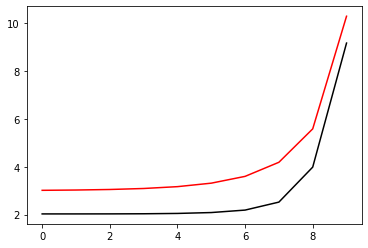

7500 99.00208493904512 8.93464791852024
[2.02780974 2.02794958 2.02930915 2.0341877  2.04801371 2.08499069
 2.18807021 2.52212236 3.98541667 9.17469564]


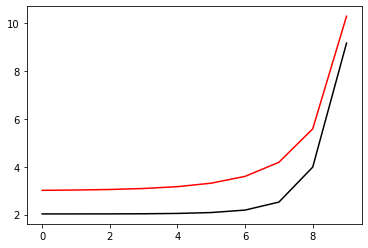

7600 99.00208449403307 8.934361692957852
[2.02781467 2.02795491 2.0293151  2.03419429 2.04802109 2.08500166
 2.18810076 2.52221448 3.98509233 9.17419747]


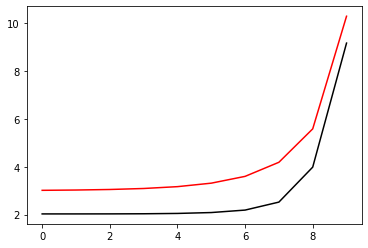

7700 99.00208404934835 8.934075661180113
[2.02781964 2.02796028 2.02932109 2.03420091 2.04802855 2.08501274
 2.1881314  2.52230639 3.98476825 9.17369933]


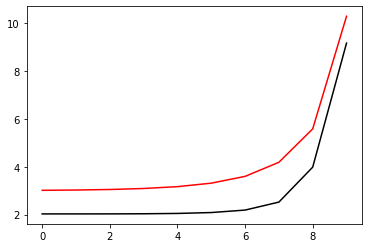

7800 99.00208360499015 8.933789822877353
[2.02782462 2.02796568 2.02932711 2.03420759 2.04803608 2.08502393
 2.18816213 2.52239807 3.98444444 9.1732012 ]


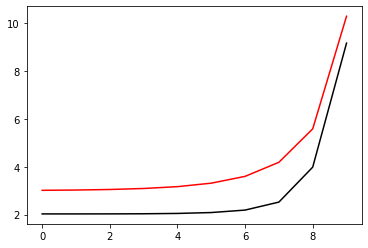

7900 99.00208316095761 8.933504177740692
[2.02782964 2.0279711  2.02933317 2.03421431 2.04804368 2.08503522
 2.18819294 2.52248953 3.98412088 9.17270309]


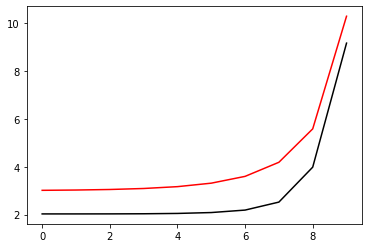

8000 99.00208271724993 8.933218725462014
[2.02783468 2.02797655 2.02933925 2.03422108 2.04805136 2.08504661
 2.18822384 2.52258077 3.98379759 9.17220499]


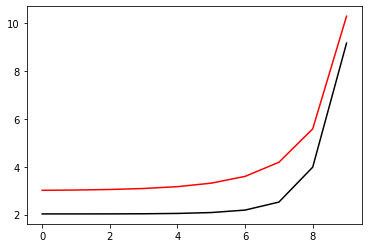

8100 99.00208227386626 8.932933465734019
[2.02783975 2.02798203 2.02934538 2.0342279  2.04805911 2.08505812
 2.18825483 2.52267179 3.98347455 9.17170691]


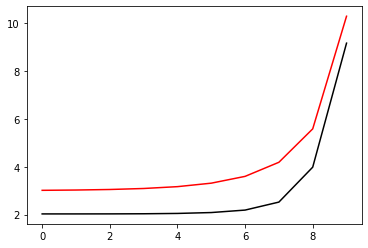

8200 99.00208183080579 8.932648398250151
[2.02784485 2.02798754 2.02935153 2.03423476 2.04806693 2.08506972
 2.1882859  2.5227626  3.98315178 9.17120885]


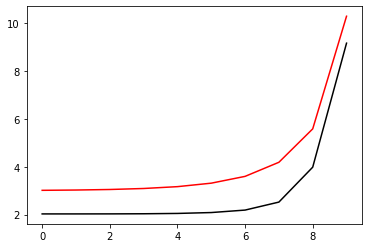

8300 99.00208138806771 8.93236352270463
[2.02784997 2.02799308 2.02935772 2.03424167 2.04807482 2.08508143
 2.18831706 2.52285318 3.98282926 9.17071081]


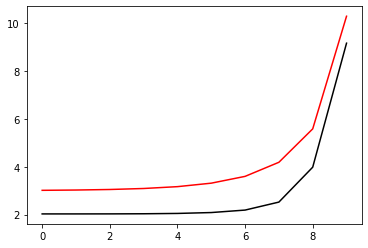

8400 99.0020809456512 8.93207883879248
[2.02785513 2.02799864 2.02936395 2.03424863 2.04808278 2.08509325
 2.1883483  2.52294354 3.982507   9.17021278]


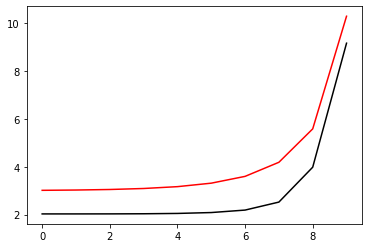

8500 99.00208050355548 8.931794346209463
[2.0278603  2.02800424 2.0293702  2.03425563 2.04809081 2.08510516
 2.18837963 2.52303369 3.982185   9.16971477]


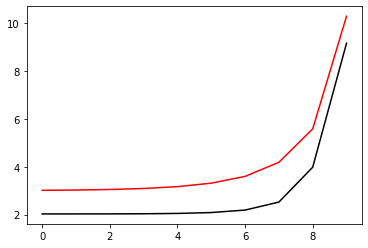

8600 99.0020800617797 8.931510044652132
[2.02786551 2.02800986 2.0293765  2.03426268 2.04809891 2.08511718
 2.18841104 2.52312362 3.98186326 9.16921677]


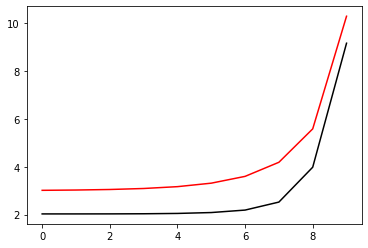

8700 99.00207962032306 8.931225933817789
[2.02787074 2.02801551 2.02938282 2.03426977 2.04810709 2.08512931
 2.18844253 2.52321334 3.98154177 9.16871879]


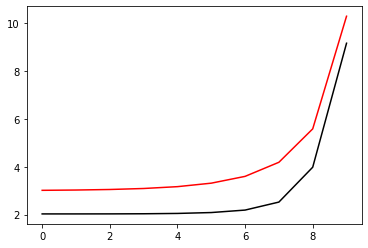

8800 99.00207917918478 8.930942013404497
[2.027876   2.02802119 2.02938918 2.03427692 2.04811533 2.08514153
 2.1884741  2.52330284 3.98122054 9.16822083]


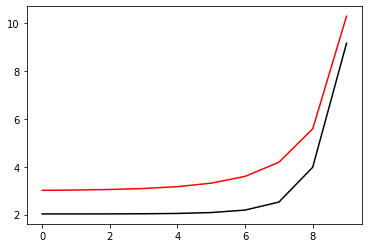

8900 99.00207873836405 8.93065828311107
[2.02788129 2.0280269  2.02939558 2.03428411 2.04812365 2.08515386
 2.18850576 2.52339212 3.98089957 9.16772289]


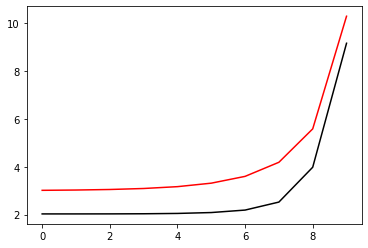

9000 99.0020782978601 8.930374742637106
[2.02788661 2.02803264 2.029402   2.03429134 2.04813203 2.08516628
 2.1885375  2.52348119 3.98057886 9.16722496]


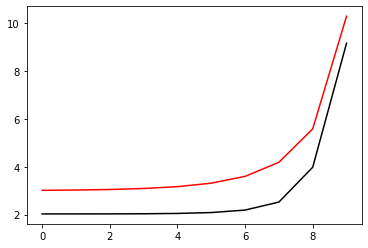

9100 99.00207785767212 8.930091391682918
[2.02789195 2.02803841 2.02940846 2.03429862 2.04814049 2.08517881
 2.18856931 2.52357005 3.9802584  9.16672705]


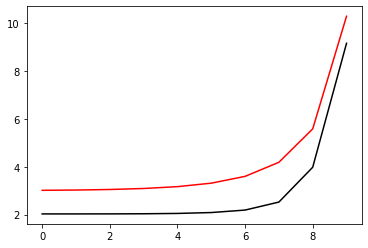

9200 99.00207741779933 8.929808229949623
[2.02789732 2.02804421 2.02941496 2.03430595 2.04814901 2.08519144
 2.18860121 2.52365869 3.97993819 9.16622916]


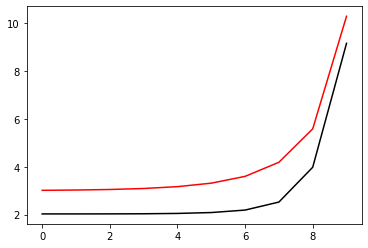

9300 99.00207697824094 8.929525257139032
[2.02790272 2.02805003 2.02942149 2.03431332 2.04815761 2.08520417
 2.18863319 2.52374712 3.97961824 9.16573129]


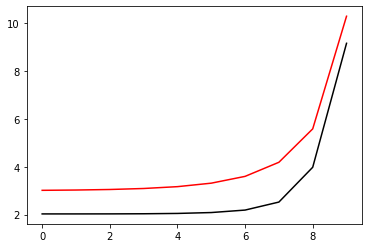

9400 99.00207653899616 8.929242472953732
[2.02790815 2.02805589 2.02942806 2.03432074 2.04816627 2.08521699
 2.18866525 2.52383533 3.97929855 9.16523343]


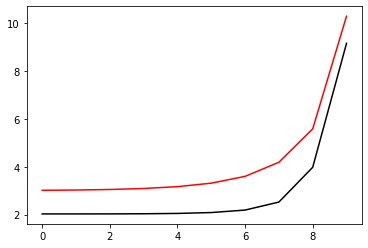

9500 99.00207610006426 8.928959877097048
[2.0279136  2.02806177 2.02943465 2.03432821 2.048175   2.08522992
 2.18869739 2.52392334 3.97897911 9.16473559]


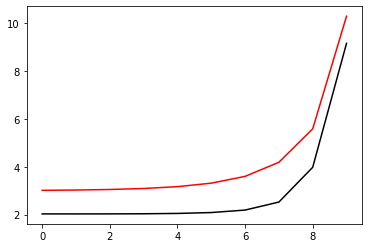

9600 99.00207566144438 8.928677469273042
[2.02791909 2.02806769 2.02944129 2.03433572 2.04818381 2.08524295
 2.1887296  2.52401113 3.97865992 9.16423776]


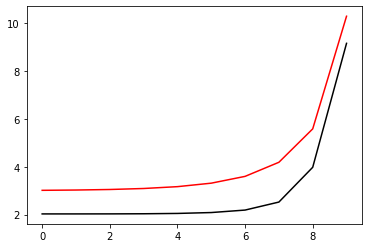

9700 99.00207522313585 8.928395249186506
[2.0279246  2.02807363 2.02944796 2.03434328 2.04819268 2.08525607
 2.1887619  2.52409871 3.97834099 9.16373995]


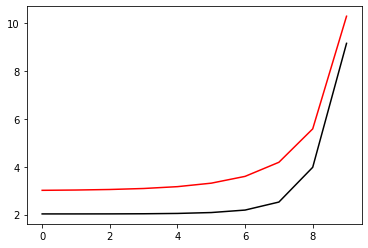

9800 99.00207478513782 8.928113216543002
[2.02793014 2.02807961 2.02945466 2.03435089 2.04820162 2.08526929
 2.18879427 2.52418608 3.97802231 9.16324216]


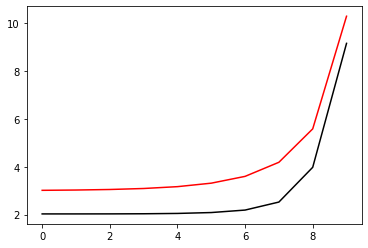

9900 99.00207434744958 8.92783137104878
[2.02793571 2.02808561 2.02946139 2.03435854 2.04821062 2.08528261
 2.18882671 2.52427325 3.97770389 9.16274439]


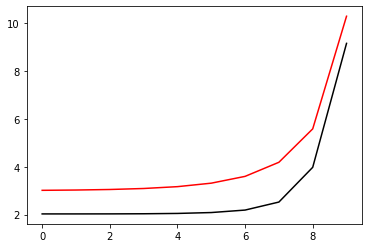

10000 99.00207391007031 8.927549712410853
[2.0279413  2.02809164 2.02946816 2.03436623 2.0482197  2.08529602
 2.18885924 2.5243602  3.97738572 9.16224664]


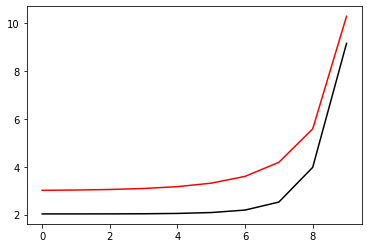

In [70]:
optimizer=tf.optimizers.SGD(learning_rate=0.01)
for i in range (1, 10001):
    run()
    if i%100==0: print(i, Error_func(h, m2_2).numpy(), m2_2.numpy()), print(h.numpy()), plt.plot(h_real, 'r-'), plt.plot(h.numpy(), 'k-'), plt.show()

100 99.00207347299931 8.927268240336941
[2.02794693 2.02809771 2.02947497 2.03437398 2.04822884 2.08530954
 2.18889184 2.52444694 3.97706779 9.1617489 ]


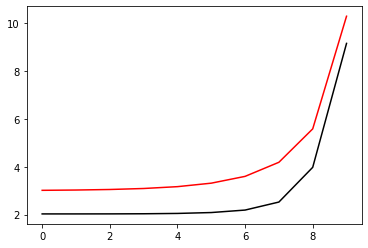

200 99.0020730362358 8.926986954535487
[2.02795258 2.0281038  2.02948181 2.03438177 2.04823806 2.08532314
 2.18892452 2.52453348 3.97675013 9.16125118]


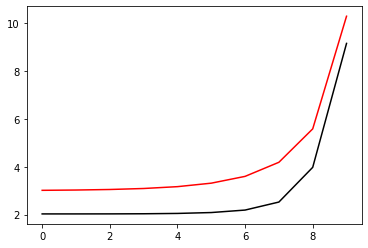

300 99.00207259977903 8.926705854715685
[2.02795826 2.02810992 2.02948868 2.0343896  2.04824734 2.08533685
 2.18895727 2.52461981 3.97643271 9.16075347]


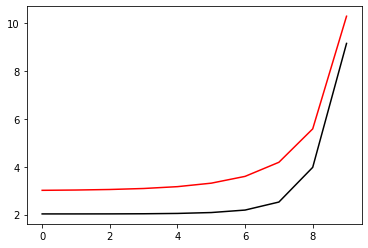

400 99.00207216362824 8.926424940587427
[2.02796397 2.02811608 2.02949559 2.03439748 2.04825668 2.08535065
 2.18899009 2.52470593 3.97611554 9.16025579]


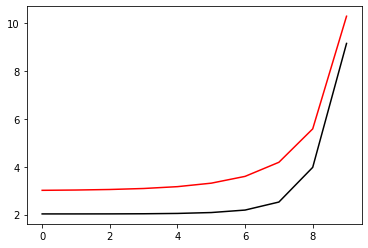

500 99.00207172778268 8.926144211861322
[2.02796971 2.02812226 2.02950254 2.03440541 2.0482661  2.08536455
 2.189023   2.52479185 3.97579863 9.15975812]


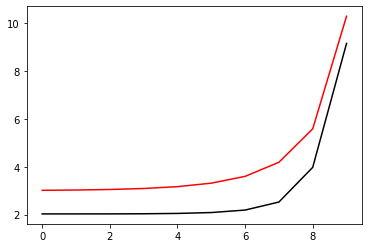

600 99.00207129224162 8.925863668248724
[2.02797548 2.02812847 2.02950952 2.03441338 2.04827558 2.08537854
 2.18905597 2.52487756 3.97548196 9.15926047]


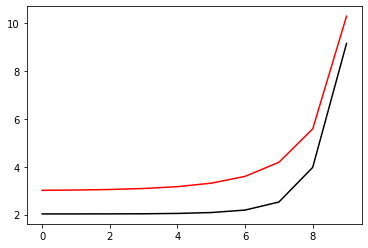

700 99.00207085700431 8.925583309461649
[2.02798128 2.02813471 2.02951653 2.0344214  2.04828513 2.08539262
 2.18908902 2.52496307 3.97516555 9.15876283]


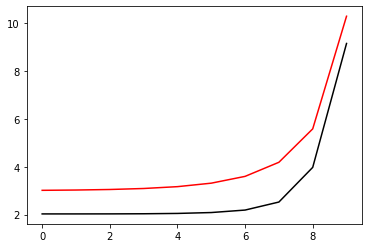

800 99.00207042207005 8.925303135212861
[2.02798711 2.02814099 2.02952358 2.03442946 2.04829475 2.0854068
 2.18912214 2.52504837 3.97484938 9.15826522]


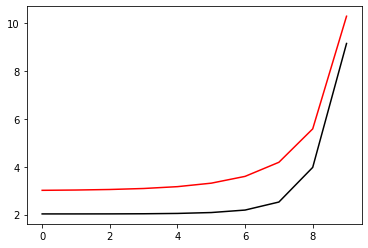

900 99.00206998743805 8.925023145215818
[2.02799296 2.02814729 2.02953066 2.03443757 2.04830443 2.08542107
 2.18915533 2.52513346 3.97453347 9.15776762]


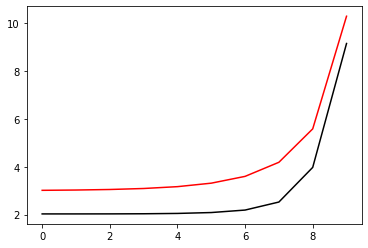

1000 99.00206955310759 8.924743339184689
[2.02799885 2.02815363 2.02953778 2.03444573 2.04831418 2.08543544
 2.1891886  2.52521835 3.9742178  9.15727004]


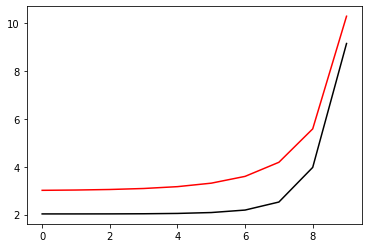

1100 99.00206911907796 8.924463716834337
[2.02800476 2.02815999 2.02954493 2.03445393 2.04832399 2.08544989
 2.18922194 2.52530304 3.97390238 9.15677247]


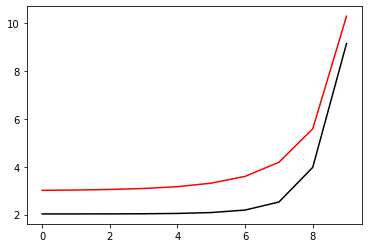

1200 99.00206868534843 8.92418427788035
[2.0280107  2.02816638 2.02955211 2.03446217 2.04833387 2.08546444
 2.18925535 2.52538753 3.97358721 9.15627492]


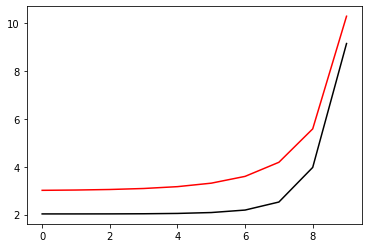

1300 99.00206825191825 8.92390502203899
[2.02801668 2.02817281 2.02955934 2.03447046 2.04834382 2.08547909
 2.18928882 2.52547182 3.97327229 9.1557774 ]


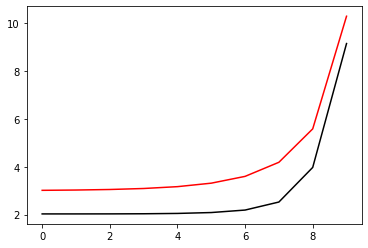

1400 99.00206781878674 8.92362594902721
[2.02802268 2.02817927 2.02956659 2.0344788  2.04835383 2.08549382
 2.18932237 2.5255559  3.97295762 9.15527988]


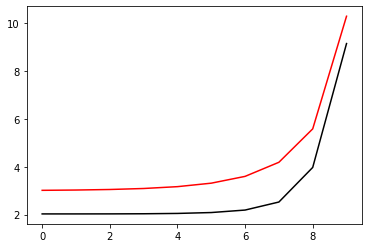

1500 99.00206738595315 8.923347058562678
[2.02802871 2.02818575 2.02957388 2.03448718 2.04836391 2.08550865
 2.18935599 2.52563978 3.97264319 9.15478239]


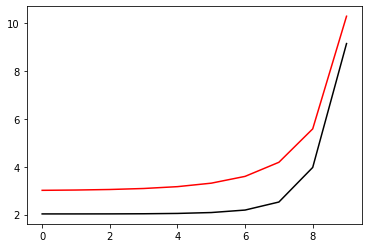

1600 99.00206695341679 8.923068350363755
[2.02803477 2.02819227 2.02958121 2.03449561 2.04837406 2.08552356
 2.18938968 2.52572346 3.97232901 9.15428491]


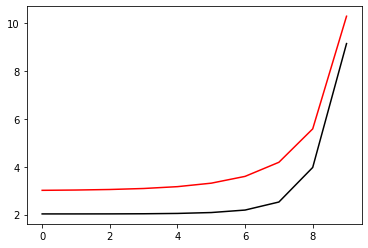

1700 99.00206652117691 8.922789824149461
[2.02804086 2.02819882 2.02958857 2.03450408 2.04838427 2.08553857
 2.18942344 2.52580694 3.97201508 9.15378745]


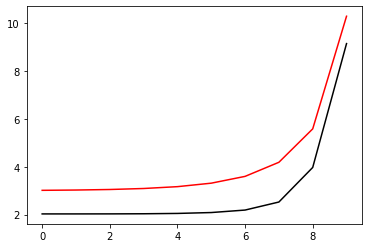

1800 99.00206608923284 8.922511479639539
[2.02804698 2.0282054  2.02959597 2.0345126  2.04839454 2.08555367
 2.18945727 2.52589023 3.97170139 9.15329001]


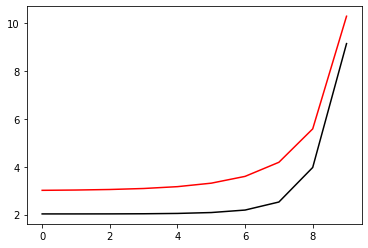

1900 99.00206565758384 8.92223331655439
[2.02805313 2.02821201 2.0296034  2.03452116 2.04840488 2.08556886
 2.18949116 2.52597331 3.97138795 9.15279259]


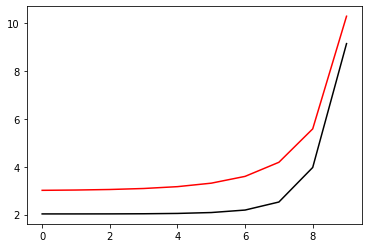

2000 99.00206522622926 8.921955334615093
[2.02805931 2.02821865 2.02961086 2.03452977 2.04841528 2.08558413
 2.18952513 2.52605619 3.97107475 9.15229518]


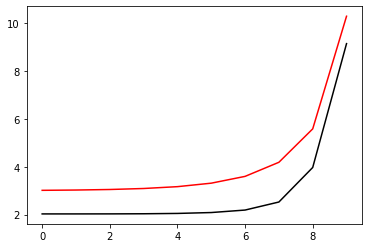

2100 99.00206479516832 8.921677533543432
[2.02806552 2.02822532 2.02961837 2.03453842 2.04842575 2.0855995
 2.18955916 2.52613888 3.9707618  9.15179779]


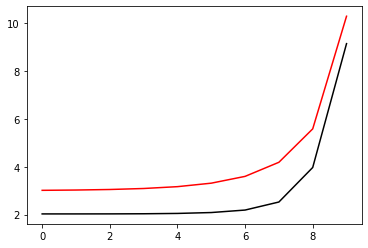

2200 99.0020643644004 8.921399913061851
[2.02807176 2.02823202 2.0296259  2.03454712 2.04843628 2.08561496
 2.18959325 2.52622137 3.9704491  9.15130042]


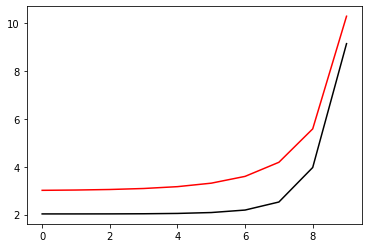

2300 99.00206393392473 8.921122472893483
[2.02807803 2.02823876 2.02963347 2.03455587 2.04844688 2.0856305
 2.18962742 2.52630366 3.97013664 9.15080307]


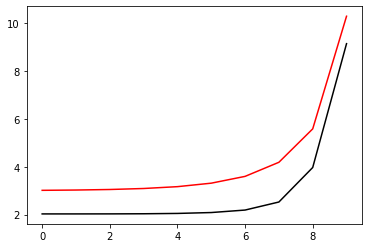

2400 99.00206350374067 8.920845212762131
[2.02808433 2.02824552 2.02964108 2.03456466 2.04845754 2.08564613
 2.18966165 2.52638576 3.96982442 9.15030574]


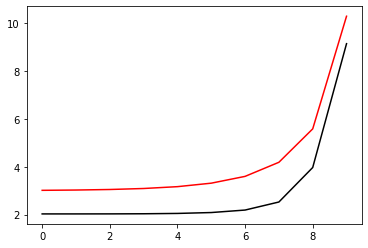

2500 99.00206307384752 8.920568132392232
[2.02809066 2.02825232 2.02964872 2.03457349 2.04846827 2.08566185
 2.18969594 2.52646766 3.96951245 9.14980842]


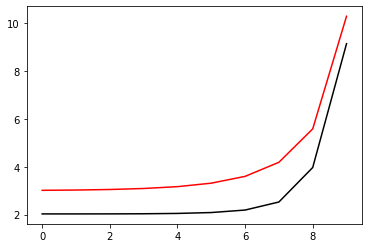

2600 99.00206264424456 8.920291231508932
[2.02809702 2.02825914 2.0296564  2.03458237 2.04847906 2.08567766
 2.1897303  2.52654936 3.96920072 9.14931112]


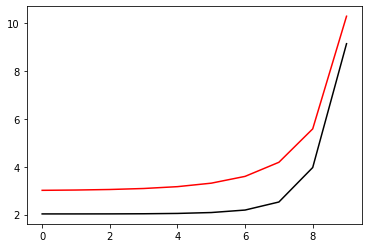

2700 99.00206221493117 8.920014509838044
[2.02810341 2.028266   2.02966411 2.03459129 2.04848991 2.08569355
 2.18976473 2.52663087 3.96888923 9.14881384]


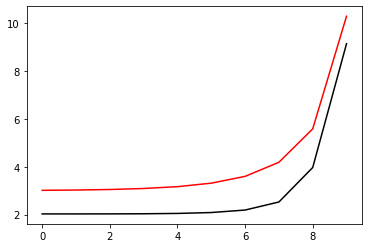

2800 99.00206178590659 8.919737967106023
[2.02810983 2.02827289 2.02967186 2.03460026 2.04850082 2.08570953
 2.18979922 2.52671219 3.96857799 9.14831657]


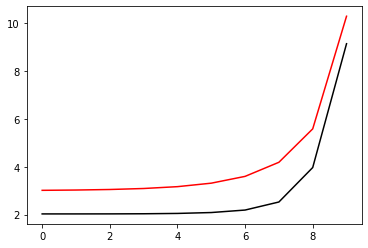

2900 99.0020613571702 8.919461603039997
[2.02811628 2.02827981 2.02967964 2.03460927 2.0485118  2.0857256
 2.18983377 2.52679331 3.96826699 9.14781933]


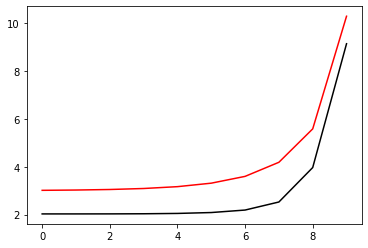

3000 99.00206092872129 8.919185417367741
[2.02812276 2.02828677 2.02968746 2.03461833 2.04852285 2.08574175
 2.18986839 2.52687424 3.96795623 9.1473221 ]


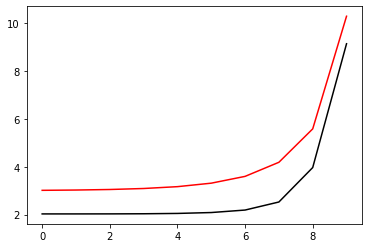

3100 99.00206050055918 8.918909409817706
[2.02812927 2.02829375 2.02969531 2.03462743 2.04853395 2.08575799
 2.18990307 2.52695498 3.96764571 9.14682489]


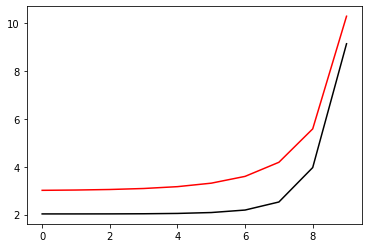

3200 99.00206007268325 8.918633580118989
[2.02813582 2.02830077 2.0297032  2.03463658 2.04854512 2.08577431
 2.18993781 2.52703552 3.96733543 9.1463277 ]


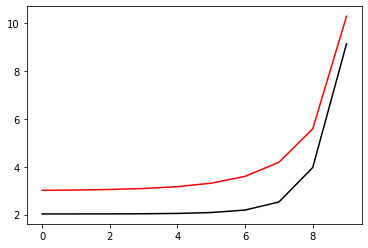

3300 99.00205964509276 8.91835792800134
[2.02814239 2.02830781 2.02971113 2.03464577 2.04855635 2.08579072
 2.18997262 2.52711587 3.9670254  9.14583052]


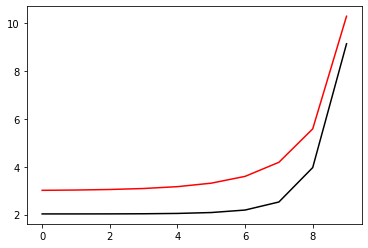

3400 99.00205921778709 8.918082453195144
[2.02814899 2.02831489 2.02971909 2.03465501 2.04856764 2.08580721
 2.19000749 2.52719603 3.96671561 9.14533337]


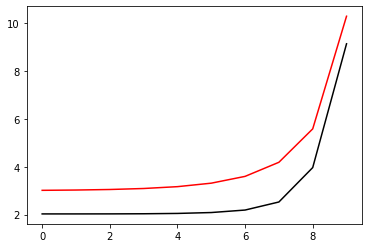

3500 99.00205879076556 8.917807155431461
[2.02815563 2.028322   2.02972708 2.03466429 2.048579   2.08582379
 2.19004242 2.527276   3.96640605 9.14483623]


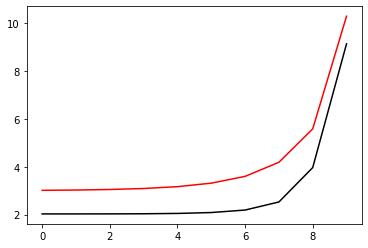

3600 99.00205836402749 8.91753203444198
[2.02816229 2.02832915 2.02973511 2.03467362 2.04859041 2.08584045
 2.19007741 2.52735578 3.96609674 9.14433911]


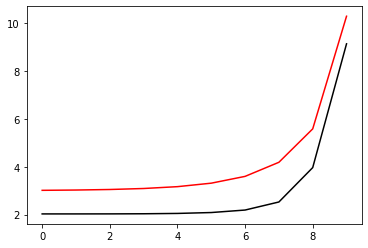

3700 99.00205793757226 8.91725708995904
[2.02816899 2.02833632 2.02974318 2.03468299 2.04860189 2.0858572
 2.19011246 2.52743537 3.96578767 9.143842  ]


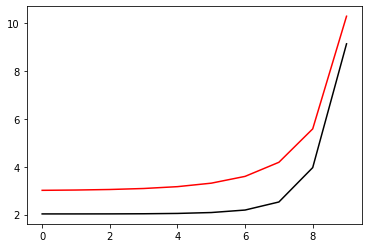

3800 99.00205751139919 8.916982321715611
[2.02817572 2.02834353 2.02975128 2.0346924  2.04861343 2.08587403
 2.19014757 2.52751477 3.96547883 9.14334492]


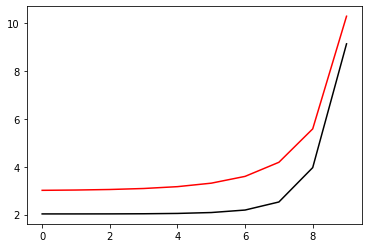

3900 99.00205708550762 8.916707729445314
[2.02818247 2.02835076 2.02975941 2.03470186 2.04862504 2.08589094
 2.19018274 2.52759398 3.96517024 9.14284785]


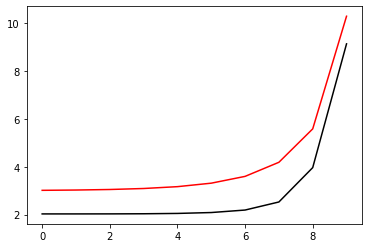

4000 99.0020566598969 8.916433312882416
[2.02818926 2.02835803 2.02976759 2.03471136 2.0486367  2.08590793
 2.19021797 2.527673   3.96486188 9.14235081]


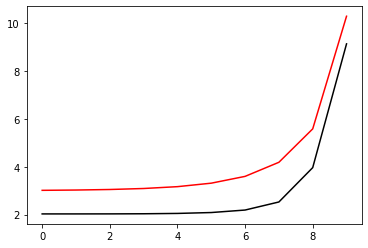

4100 99.00205623456638 8.916159071761799
[2.02819608 2.02836534 2.02977579 2.03472091 2.04864842 2.08592501
 2.19025326 2.52775183 3.96455376 9.14185378]


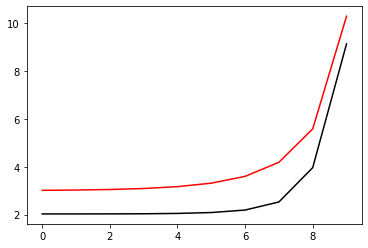

4200 99.00205580951544 8.91588500581899
[2.02820293 2.02837267 2.02978404 2.0347305  2.04866021 2.08594216
 2.19028861 2.52783048 3.96424588 9.14135676]


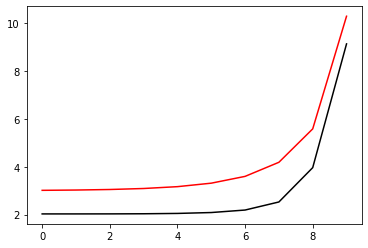

4300 99.0020553847434 8.91561111479014
[2.02820981 2.02838003 2.02979231 2.03474014 2.04867206 2.0859594
 2.19032402 2.52790894 3.96393824 9.14085977]


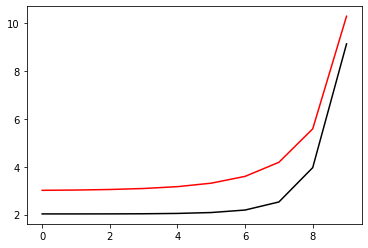

4400 99.00205496024962 8.915337398412026
[2.02821673 2.02838743 2.02980063 2.03474982 2.04868396 2.08597672
 2.19035949 2.52798721 3.96363084 9.14036279]


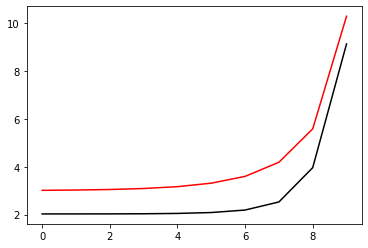

4500 99.0020545360335 8.915063856422073
[2.02822367 2.02839486 2.02980898 2.03475954 2.04869593 2.08599412
 2.19039501 2.5280653  3.96332367 9.13986584]


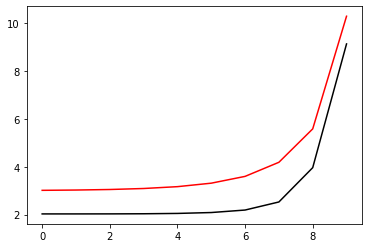

4600 99.00205411209434 8.914790488558308
[2.02823065 2.02840233 2.02981736 2.03476931 2.04870796 2.08601161
 2.19043059 2.5281432  3.96301674 9.1393689 ]


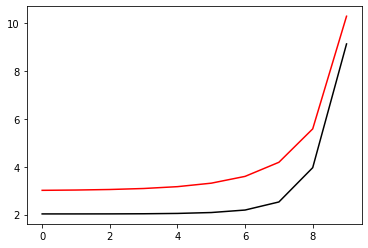

4700 99.00205368843156 8.914517294559388
[2.02823765 2.02840982 2.02982578 2.03477912 2.04872005 2.08602917
 2.19046623 2.52822092 3.96271004 9.13887198]


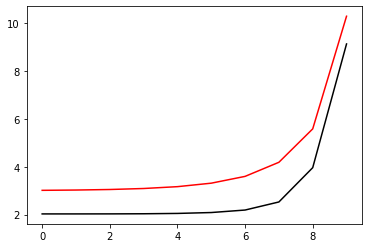

4800 99.00205326504451 8.9142442741646
[2.02824469 2.02841735 2.02983424 2.03478898 2.0487322  2.08604681
 2.19050193 2.52829845 3.96240359 9.13837508]


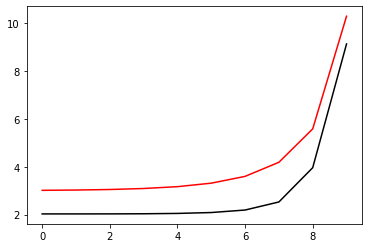

4900 99.00205284193254 8.91397142711383
[2.02825176 2.02842491 2.02984273 2.03479888 2.04874441 2.08606453
 2.19053768 2.5283758  3.96209736 9.13787819]


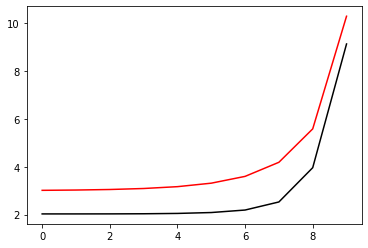

5000 99.00205241909504 8.913698753147608
[2.02825886 2.0284325  2.02985126 2.03480883 2.04875668 2.08608233
 2.19057349 2.52845296 3.96179138 9.13738133]


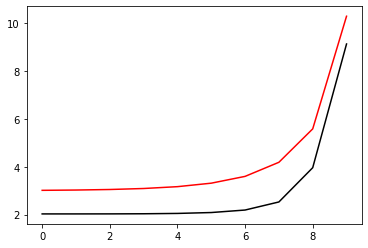

5100 99.00205199653138 8.913426252007044
[2.02826599 2.02844012 2.02985982 2.03481881 2.04876901 2.08610021
 2.19060935 2.52852994 3.96148563 9.13688448]


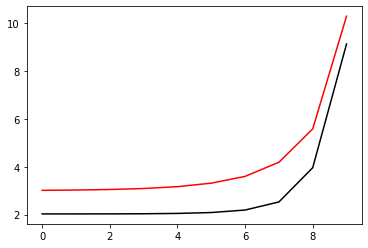

5200 99.00205157424094 8.91315392343389
[2.02827316 2.02844778 2.02986842 2.03482885 2.0487814  2.08611817
 2.19064527 2.52860674 3.96118011 9.13638765]


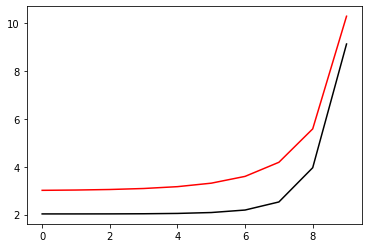

5300 99.0020511522231 8.912881767170504
[2.02828035 2.02845547 2.02987706 2.03483892 2.04879384 2.08613621
 2.19068124 2.52868335 3.96087483 9.13589084]


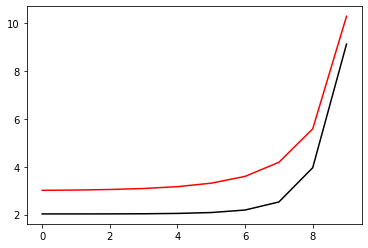

5400 99.00205073047722 8.912609782959827
[2.02828758 2.02846319 2.02988573 2.03484904 2.04880635 2.08615432
 2.19071727 2.52875979 3.96056978 9.13539405]


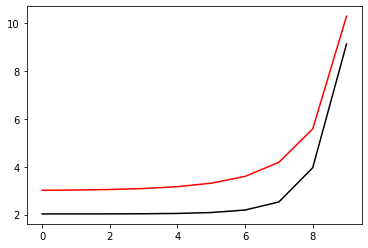

5500 99.00205030900271 8.912337970545444
[2.02829484 2.02847094 2.02989444 2.0348592  2.04881892 2.08617252
 2.19075335 2.52883604 3.96026496 9.13489727]


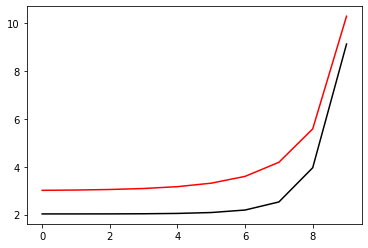

5600 99.00204988779895 8.912066329671509
[2.02830213 2.02847873 2.02990318 2.03486941 2.04883154 2.08619079
 2.19078948 2.52891211 3.95996038 9.13440052]


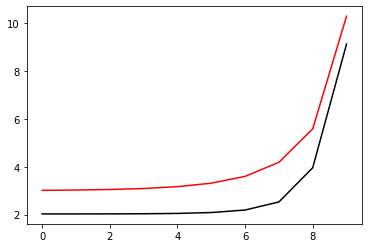

5700 99.00204946686532 8.911794860082805
[2.02830946 2.02848655 2.02991195 2.03487966 2.04884423 2.08620913
 2.19082567 2.528988   3.95965604 9.13390378]


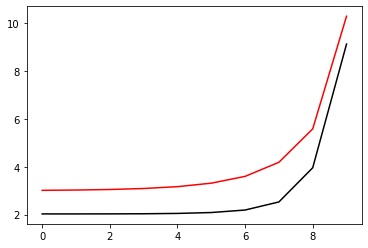

5800 99.00204904620122 8.91152356152471
[2.02831681 2.0284944  2.02992077 2.03488996 2.04885697 2.08622756
 2.19086191 2.52906371 3.95935192 9.13340706]


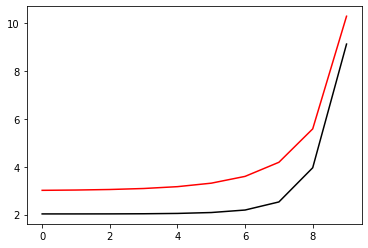

5900 99.00204862580603 8.911252433743185
[2.0283242  2.02850228 2.02992962 2.03490029 2.04886977 2.08624606
 2.1908982  2.52913925 3.95904804 9.13291036]


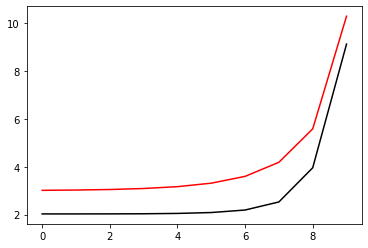

6000 99.00204820567916 8.910981476484809
[2.02833161 2.0285102  2.0299385  2.03491068 2.04888263 2.08626463
 2.19093455 2.5292146  3.95874439 9.13241368]


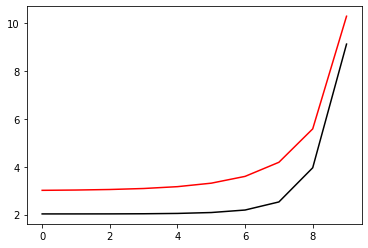

6100 99.00204778581998 8.910710689496737
[2.02833907 2.02851815 2.02994742 2.0349211  2.04889555 2.08628329
 2.19097095 2.52928977 3.95844097 9.13191702]


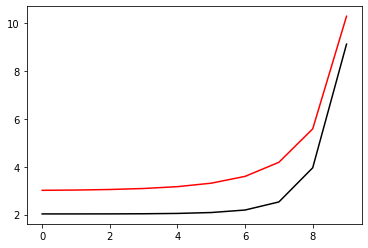

6200 99.00204736622793 8.91044007252672
[2.02834655 2.02852613 2.02995638 2.03493157 2.04890852 2.08630201
 2.1910074  2.52936477 3.95813779 9.13142037]


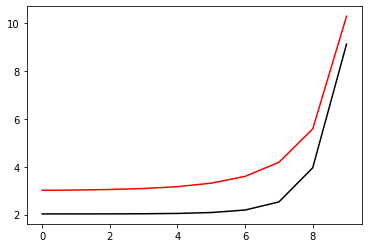

6300 99.00204694690237 8.910169625323114
[2.02835406 2.02853415 2.02996537 2.03494208 2.04892156 2.08632082
 2.1910439  2.52943959 3.95783483 9.13092374]


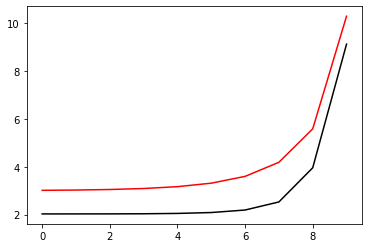

6400 99.00204652784274 8.90989934763485
[2.02836161 2.02854219 2.0299744  2.03495264 2.04893465 2.08633969
 2.19108045 2.52951423 3.95753211 9.13042714]


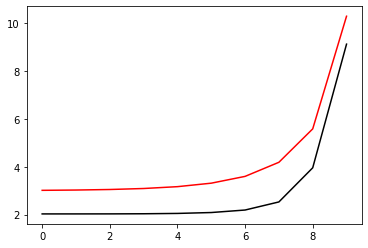

6500 99.00204610904841 8.909629239211451
[2.02836919 2.02855027 2.02998347 2.03496323 2.0489478  2.08635865
 2.19111705 2.52958869 3.95722961 9.12993055]


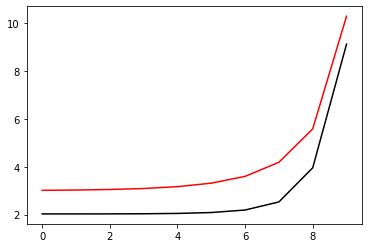

6600 99.00204569051881 8.90935929980303
[2.0283768  2.02855839 2.02999257 2.03497388 2.048961   2.08637767
 2.1911537  2.52966298 3.95692735 9.12943398]


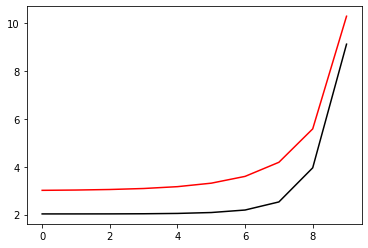

6700 99.00204527225335 8.909089529160267
[2.02838444 2.02856654 2.0300017  2.03498456 2.04897427 2.08639677
 2.1911904  2.52973709 3.95662532 9.12893743]


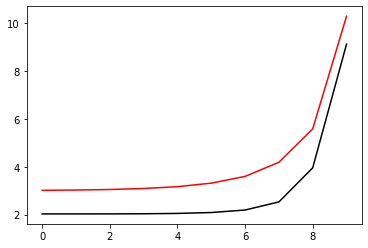

6800 99.00204485425144 8.908819927034445
[2.02839212 2.02857472 2.03001087 2.03499529 2.04898759 2.08641595
 2.19122716 2.52981103 3.95632352 9.12844089]


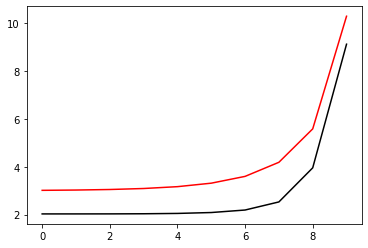

6900 99.00204443651249 8.908550493177419
[2.02839983 2.02858293 2.03002008 2.03500606 2.04900097 2.0864352
 2.19126396 2.52988479 3.95602194 9.12794438]


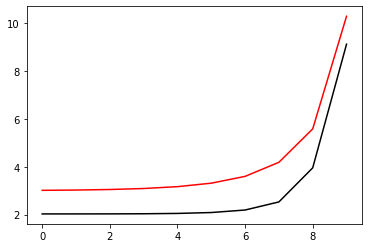

7000 99.0020440190359 8.908281227341588
[2.02840757 2.02859118 2.03002933 2.03501687 2.0490144  2.08645452
 2.1913008  2.52995838 3.9557206  9.12744789]


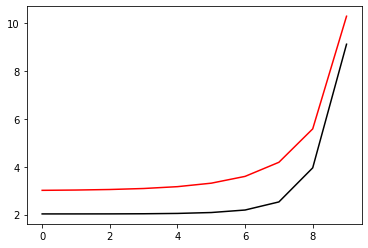

7100 99.00204360182113 8.908012129279975
[2.02841534 2.02859945 2.03003861 2.03502773 2.04902789 2.08647391
 2.1913377  2.53003179 3.95541948 9.12695141]


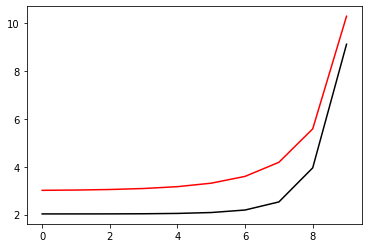

7200 99.00204318486756 8.90774319874617
[2.02842314 2.02860777 2.03004792 2.03503863 2.04904144 2.08649338
 2.19137465 2.53010503 3.95511859 9.12645495]


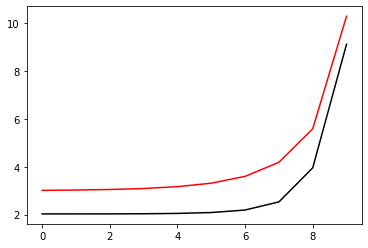

7300 99.00204276817463 8.9074744354943
[2.02843098 2.02861611 2.03005727 2.03504957 2.04905505 2.08651292
 2.19141164 2.5301781  3.95481794 9.12595851]


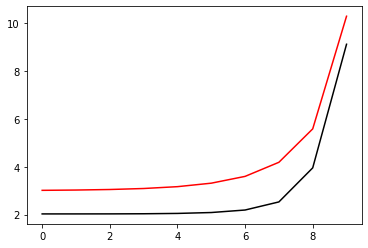

7400 99.00204235174179 8.907205839279088
[2.02843885 2.02862449 2.03006666 2.03506056 2.04906871 2.08653253
 2.19144868 2.53025099 3.9545175  9.12546209]


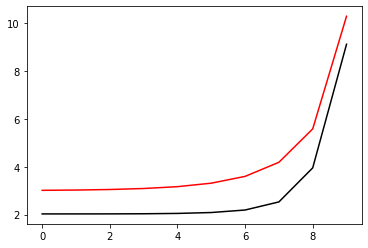

7500 99.00204193556843 8.906937409855827
[2.02844675 2.0286329  2.03007608 2.03507159 2.04908242 2.08655221
 2.19148577 2.53032371 3.9542173  9.12496569]


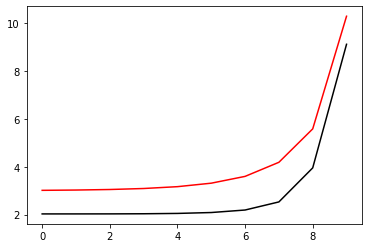

7600 99.00204151965397 8.906669146980374
[2.02845469 2.02864135 2.03008554 2.03508266 2.0490962  2.08657196
 2.19152291 2.53039626 3.95391732 9.12446931]


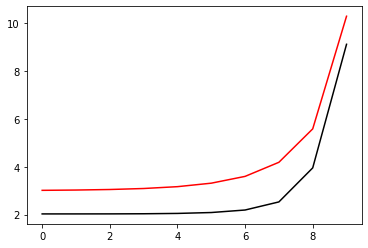

7700 99.00204110399788 8.906401050409139
[2.02846266 2.02864983 2.03009504 2.03509377 2.04911003 2.08659179
 2.19156009 2.53046864 3.95361757 9.12397294]


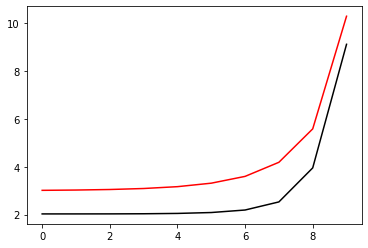

7800 99.00204068859956 8.906133119899103
[2.02847066 2.02865834 2.03010457 2.03510493 2.04912391 2.08661168
 2.19159731 2.53054085 3.95331805 9.1234766 ]


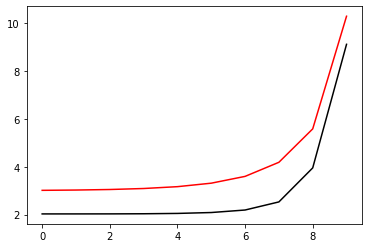

7900 99.00204027345846 8.905865355207801
[2.02847869 2.02866689 2.03011414 2.03511613 2.04913785 2.08663165
 2.19163459 2.53061288 3.95301876 9.12298027]


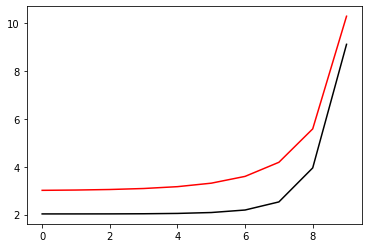

8000 99.00203985857404 8.905597756093346
[2.02848676 2.02867546 2.03012374 2.03512737 2.04915185 2.08665168
 2.19167191 2.53068475 3.95271968 9.12248397]


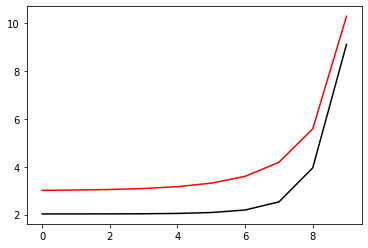

8100 99.00203944394569 8.905330322314386
[2.02849486 2.02868408 2.03013338 2.03513866 2.0491659  2.08667179
 2.19170927 2.53075644 3.95242084 9.12198768]


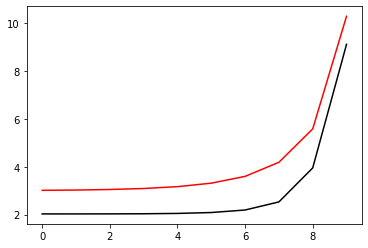

8200 99.00203902957288 8.905063053630133
[2.02850299 2.02869272 2.03014305 2.03514999 2.04918    2.08669196
 2.19174668 2.53082797 3.95212222 9.12149141]


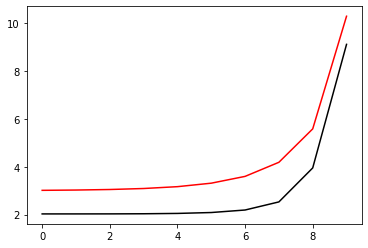

8300 99.00203861545505 8.904795949800354
[2.02851115 2.0287014  2.03015277 2.03516136 2.04919416 2.08671221
 2.19178413 2.53089933 3.95182383 9.12099516]


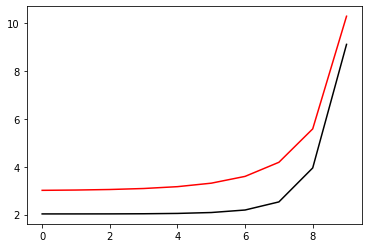

8400 99.00203820159165 8.904529010585374
[2.02851935 2.02871011 2.03016251 2.03517277 2.04920838 2.08673252
 2.19182163 2.53097052 3.95152566 9.12049893]


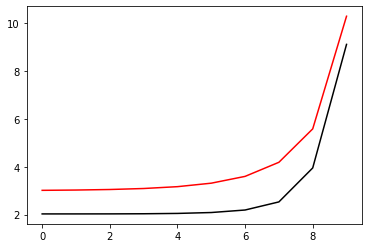

8500 99.00203778798212 8.90426223574606
[2.02852758 2.02871886 2.0301723  2.03518422 2.04922265 2.08675291
 2.19185917 2.53104154 3.95122771 9.12000272]


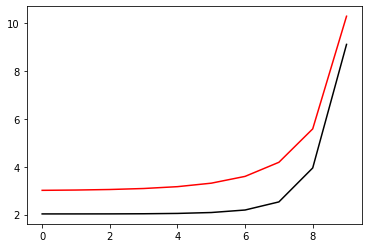

8600 99.0020373746259 8.903995625043828
[2.02853584 2.02872764 2.03018212 2.03519572 2.04923698 2.08677336
 2.19189676 2.53111239 3.95092999 9.11950652]


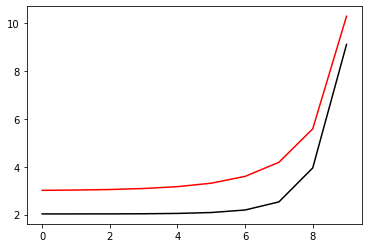

8700 99.00203696152245 8.903729178240619
[2.02854414 2.02873645 2.03019197 2.03520726 2.04925136 2.08679388
 2.19193439 2.53118308 3.95063249 9.11901035]


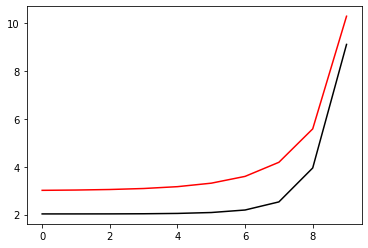

8800 99.00203654867123 8.903462895098974
[2.02855247 2.0287453  2.03020186 2.03521884 2.04926579 2.08681446
 2.19197206 2.5312536  3.95033522 9.1185142 ]


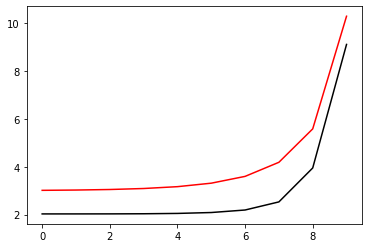

8900 99.00203613607168 8.903196775381927
[2.02856083 2.02875418 2.03021179 2.03523047 2.04928028 2.08683512
 2.19200977 2.53132395 3.95003817 9.11801806]


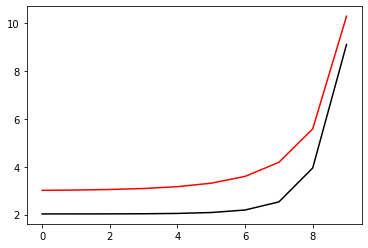

9000 99.00203572372327 8.90293081885307
[2.02856923 2.02876309 2.03022175 2.03524213 2.04929482 2.08685584
 2.19204753 2.53139414 3.94974134 9.11752194]


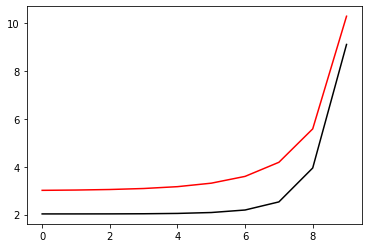

9100 99.00203531162546 8.902665025276539
[2.02857766 2.02877204 2.03023175 2.03525384 2.04930942 2.08687663
 2.19208533 2.53146416 3.94944474 9.11702585]


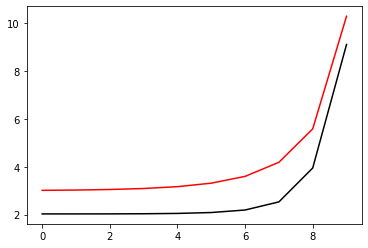

9200 99.00203489977768 8.902399394417
[2.02858612 2.02878102 2.03024179 2.03526559 2.04932407 2.08689749
 2.19212317 2.53153402 3.94914835 9.11652977]


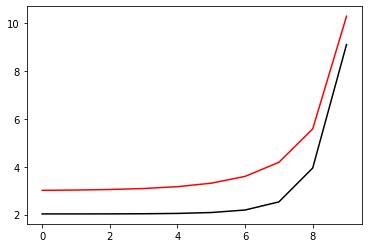

9300 99.00203448817943 8.902133926039669
[2.02859461 2.02879004 2.03025186 2.03527739 2.04933877 2.08691841
 2.19216105 2.53160371 3.94885219 9.11603371]


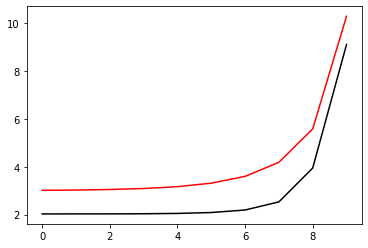

9400 99.00203407683016 8.901868619910271
[2.02860314 2.02879909 2.03026197 2.03528922 2.04935353 2.0869394
 2.19219897 2.53167324 3.94855626 9.11553767]


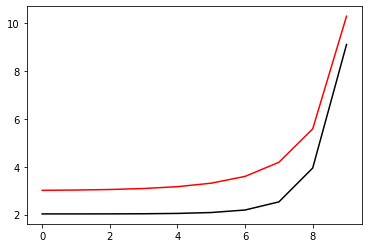

9500 99.00203366572933 8.901603475795094
[2.0286117  2.02880817 2.03027211 2.0353011  2.04936834 2.08696046
 2.19223693 2.5317426  3.94826054 9.11504165]


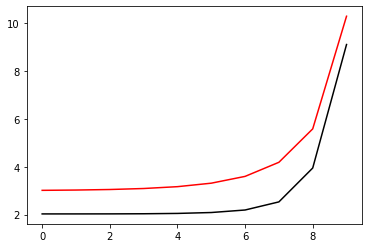

9600 99.00203325487641 8.901338493460923
[2.02862029 2.02881729 2.03028229 2.03531302 2.0493832  2.08698158
 2.19227494 2.5318118  3.94796504 9.11454565]


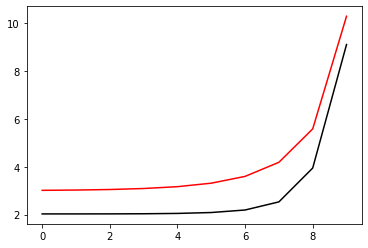

9700 99.00203284427089 8.901073672675107
[2.02862892 2.02882644 2.03029251 2.03532498 2.04939812 2.08700277
 2.19231298 2.53188084 3.94766977 9.11404966]


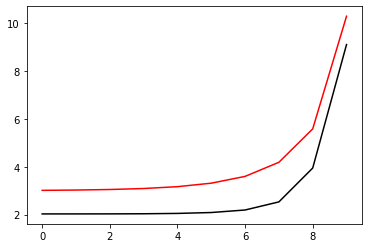

9800 99.0020324339122 8.9008090132055
[2.02863758 2.02883562 2.03030276 2.03533698 2.04941309 2.08702402
 2.19235107 2.53194971 3.94737471 9.1135537 ]


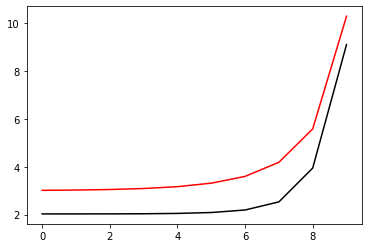

9900 99.00203202379987 8.900544514820483
[2.02864628 2.02884484 2.03031305 2.03534903 2.04942811 2.08704534
 2.19238919 2.53201842 3.94707988 9.11305776]


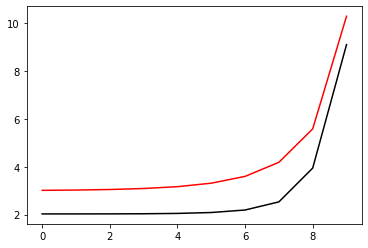

10000 99.00203161393333 8.900280177288986
[2.02865501 2.02885409 2.03032337 2.03536111 2.04944319 2.08706672
 2.19242735 2.53208697 3.94678527 9.11256183]


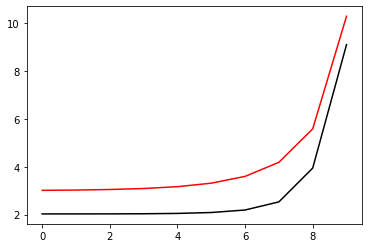

In [71]:
optimizer=tf.optimizers.SGD(learning_rate=0.01)
for i in range (1, 10001):
    run()
    if i%100==0: print(i, Error_func(h, m2_2).numpy(), m2_2.numpy()), print(h.numpy()), plt.plot(h_real, 'r-'), plt.plot(h.numpy(), 'k-'), plt.show()

100 99.00203120431206 8.900016000380433
[2.02866377 2.02886338 2.03033374 2.03537324 2.04945832 2.08708817
 2.19246555 2.53215536 3.94649087 9.11206593]


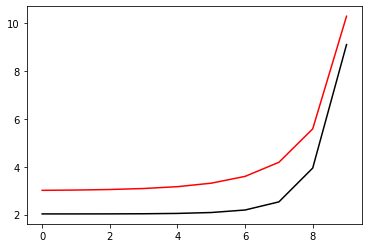

200 99.00203079493555 8.899751983864778
[2.02867256 2.0288727  2.03034413 2.03538541 2.0494735  2.08710968
 2.1925038  2.53222359 3.9461967  9.11157004]


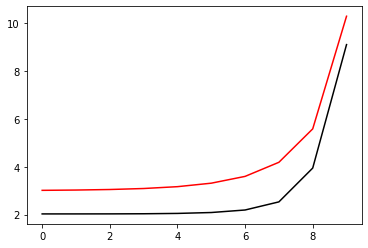

300 99.0020303858033 8.8994881275125
[2.02868139 2.02888205 2.03035456 2.03539762 2.04948873 2.08713125
 2.19254207 2.53229166 3.94590274 9.11107418]


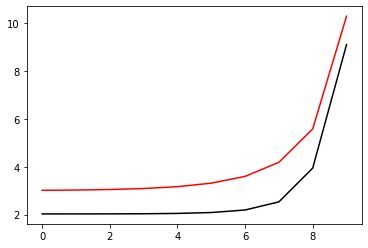

400 99.00202997691474 8.899224431094588
[2.02869025 2.02889144 2.03036503 2.03540987 2.04950401 2.08715289
 2.19258039 2.53235956 3.945609   9.11057833]


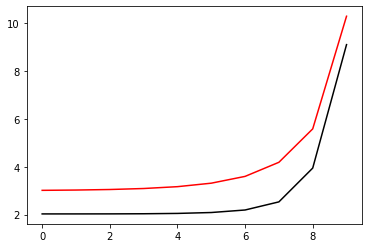

500 99.0020295682694 8.898960894382554
[2.02869915 2.02890086 2.03037554 2.03542217 2.04951935 2.08717459
 2.19261875 2.53242731 3.94531549 9.1100825 ]


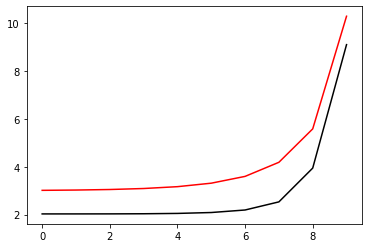

600 99.00202915986678 8.898697517148422
[2.02870808 2.02891031 2.03038608 2.03543451 2.04953474 2.08719636
 2.19265714 2.5324949  3.94502219 9.10958669]


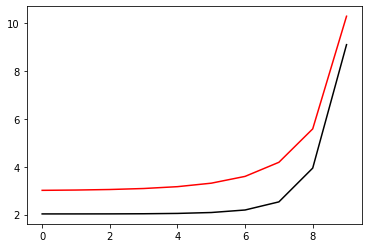

700 99.00202875170632 8.898434299164729
[2.02871704 2.0289198  2.03039666 2.03544688 2.04955018 2.08721818
 2.19269557 2.53256233 3.9447291  9.10909091]


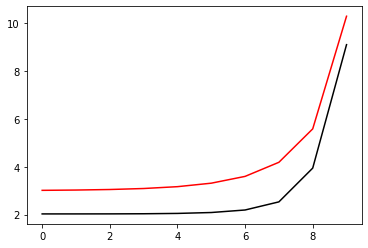

800 99.00202834378753 8.898171240204523
[2.02872603 2.02892933 2.03040727 2.0354593  2.04956567 2.08724008
 2.19273404 2.5326296  3.94443624 9.10859514]


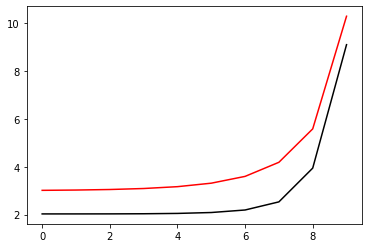

900 99.0020279361099 8.897908340041363
[2.02873506 2.02893889 2.03041792 2.03547176 2.04958122 2.08726203
 2.19277254 2.53269671 3.94414359 9.10809939]


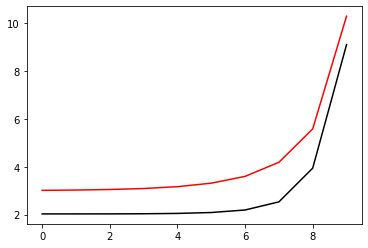

1000 99.00202752867291 8.897645598449312
[2.02874413 2.02894848 2.0304286  2.03548426 2.04959681 2.08728404
 2.19281108 2.53276366 3.94385116 9.10760366]


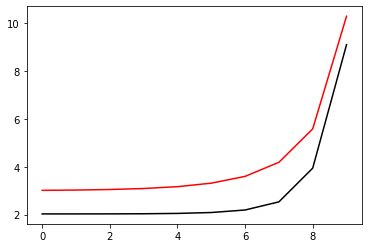

1100 99.0020271214761 8.897383015202935
[2.02875322 2.0289581  2.03043933 2.03549681 2.04961246 2.08730612
 2.19284966 2.53283046 3.94355895 9.10710795]


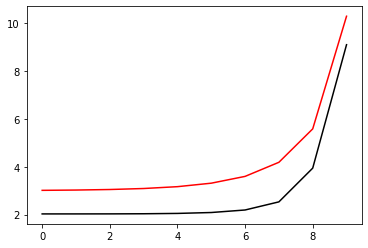

1200 99.00202671451892 8.897120590077323
[2.02876235 2.02896776 2.03045008 2.03550939 2.04962816 2.08732826
 2.19288827 2.5328971  3.94326695 9.10661226]


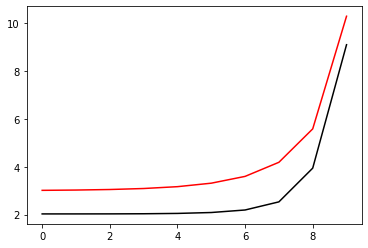

1300 99.00202630780089 8.896858322848047
[2.02877152 2.02897746 2.03046088 2.03552202 2.04964391 2.08735046
 2.19292692 2.53296358 3.94297517 9.10611658]


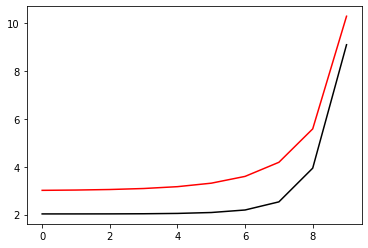

1400 99.0020259013215 8.896596213291186
[2.02878071 2.02898719 2.03047171 2.03553468 2.04965971 2.08737272
 2.1929656  2.53302991 3.94268361 9.10562093]


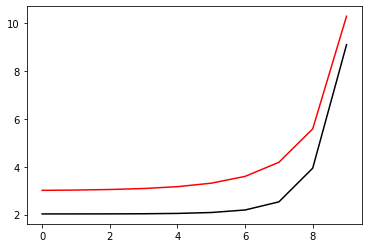

1500 99.00202549508025 8.896334261183334
[2.02878995 2.02899695 2.03048257 2.03554739 2.04967556 2.08739505
 2.19300432 2.53309608 3.94239226 9.1051253 ]


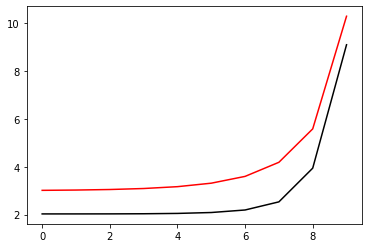

1600 99.00202508907665 8.896072466301568
[2.02879921 2.02900675 2.03049348 2.03556014 2.04969146 2.08741743
 2.19304308 2.53316209 3.94210112 9.10462969]


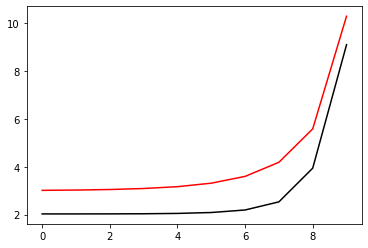

1700 99.00202468331022 8.895810828423464
[2.02880851 2.02901658 2.03050441 2.03557293 2.04970741 2.08743987
 2.19308186 2.53322795 3.9418102  9.10413409]


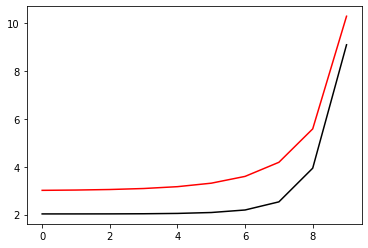

1800 99.00202427778045 8.895549347327092
[2.02881784 2.02902644 2.03051539 2.03558576 2.04972342 2.08746238
 2.19312069 2.53329366 3.9415195  9.10363852]


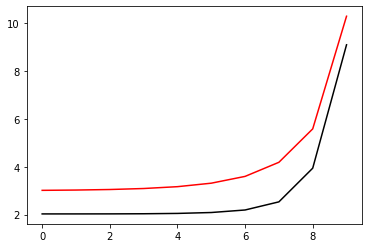

1900 99.00202387248683 8.895288022791028
[2.02882721 2.02903634 2.0305264  2.03559863 2.04973947 2.08748494
 2.19315954 2.53335921 3.94122901 9.10314297]


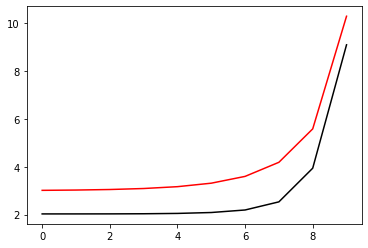

2000 99.00202346742891 8.89502685459432
[2.02883661 2.02904628 2.03053744 2.03561155 2.04975557 2.08750756
 2.19319843 2.5334246  3.94093874 9.10264743]


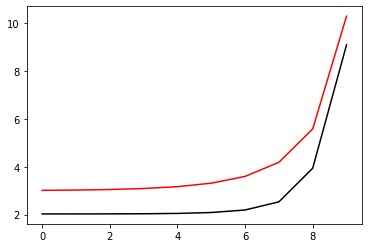

2100 99.00202306260617 8.894765842516543
[2.02884605 2.02905625 2.03054853 2.0356245  2.04977172 2.08753025
 2.19323736 2.53348985 3.94064867 9.10215192]


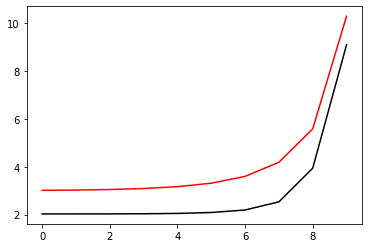

2200 99.00202265801815 8.894504986337722
[2.02885551 2.02906625 2.03055965 2.03563749 2.04978793 2.08755299
 2.19327631 2.53355494 3.94035883 9.10165642]


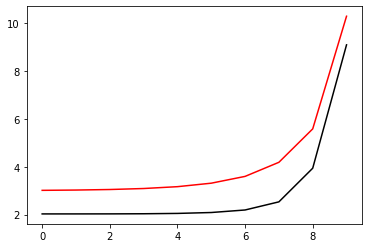

2300 99.00202225366434 8.894244285838388
[2.02886502 2.02907629 2.0305708  2.03565053 2.04980418 2.08757579
 2.1933153  2.53361987 3.94006919 9.10116095]


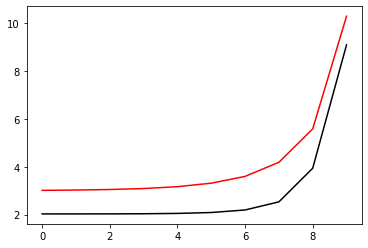

2400 99.00202184954426 8.893983740799552
[2.02887455 2.02908636 2.03058199 2.03566361 2.04982048 2.08759865
 2.19335433 2.53368466 3.93977977 9.10066549]


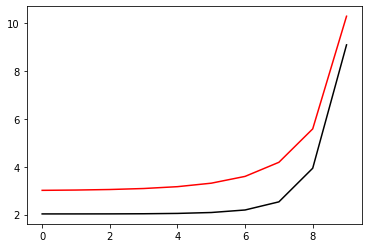

2500 99.00202144565743 8.893723351002718
[2.02888412 2.02909646 2.03059322 2.03567672 2.04983683 2.08762157
 2.19339338 2.53374929 3.93949056 9.10017006]


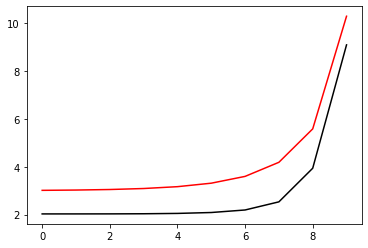

2600 99.00202104200339 8.893463116229865
[2.02889373 2.0291066  2.03060448 2.03568988 2.04985324 2.08764455
 2.19343247 2.53381377 3.93920157 9.09967464]


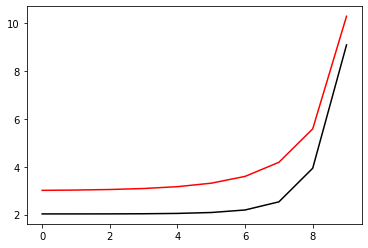

2700 99.00202063858166 8.893203036263463
[2.02890337 2.02911678 2.03061578 2.03570308 2.04986969 2.08766758
 2.19347159 2.5338781  3.93891278 9.09917925]


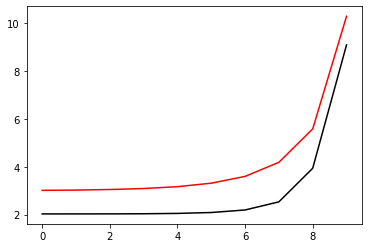

2800 99.00202023539171 8.892943110886462
[2.02891304 2.02912698 2.03062712 2.03571632 2.04988619 2.08769067
 2.19351074 2.53394228 3.93862421 9.09868387]


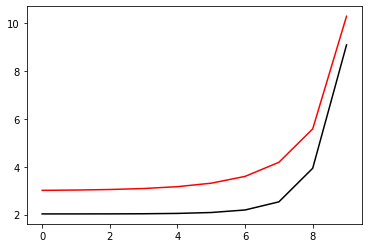

2900 99.00201983243313 8.89268333988228
[2.02892275 2.02913723 2.03063849 2.0357296  2.04990273 2.08771382
 2.19354992 2.5340063  3.93833585 9.09818852]


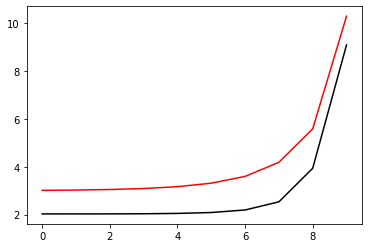

3000 99.00201942970541 8.892423723034826
[2.02893249 2.02914751 2.03064989 2.03574292 2.04991933 2.08773703
 2.19358913 2.53407018 3.9380477  9.09769318]


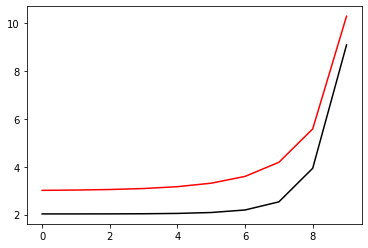

3100 99.0020190272081 8.892164260128462
[2.02894226 2.02915782 2.03066134 2.03575628 2.04993598 2.0877603
 2.19362837 2.53413391 3.93775977 9.09719786]


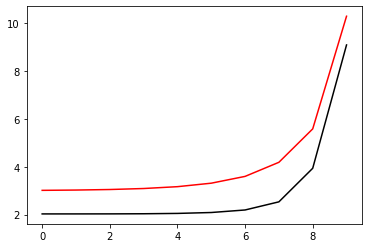

3200 99.0020186249407 8.891904950948065
[2.02895207 2.02916816 2.03067282 2.03576968 2.04995267 2.08778362
 2.19366765 2.53419749 3.93747204 9.09670257]


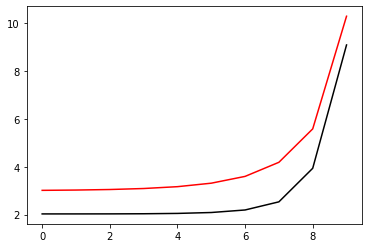

3300 99.00201822290278 8.891645795278935
[2.02896191 2.02917854 2.03068433 2.03578312 2.04996942 2.087807
 2.19370695 2.53426092 3.93718452 9.09620729]


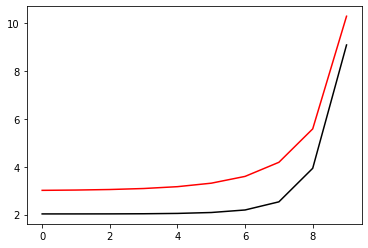

3400 99.00201782109384 8.891386792906875
[2.02897179 2.02918896 2.03069588 2.0357966  2.04998621 2.08783043
 2.19374629 2.5343242  3.93689722 9.09571204]


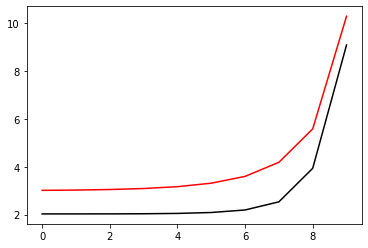

3500 99.00201741951345 8.891127943618166
[2.0289817  2.02919941 2.03070747 2.03581012 2.05000305 2.08785392
 2.19378565 2.53438733 3.93661012 9.0952168 ]


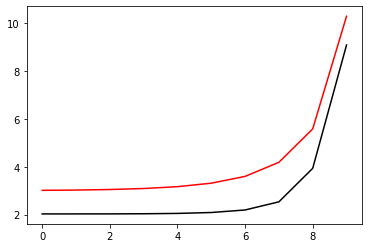

3600 99.00201701816108 8.890869247199536
[2.02899165 2.02920989 2.03071909 2.03582368 2.05001994 2.08787747
 2.19382505 2.53445031 3.93632324 9.09472158]


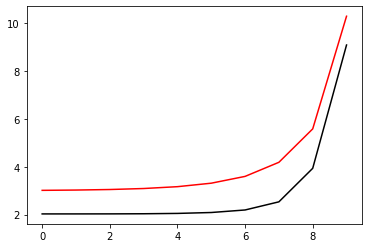

3700 99.00201661703633 8.890610703438194
[2.02900163 2.02922041 2.03073075 2.03583728 2.05003688 2.08790107
 2.19386447 2.53451315 3.93603656 9.09422639]


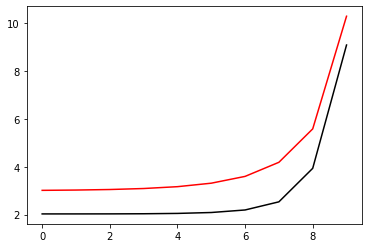

3800 99.00201621613871 8.89035231212181
[2.02901164 2.02923096 2.03074245 2.03585093 2.05005386 2.08792473
 2.19390392 2.53457583 3.93575009 9.09373121]


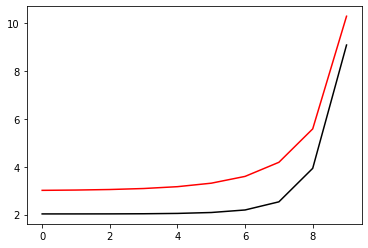

3900 99.00201581546777 8.890094073038517
[2.02902169 2.02924155 2.03075418 2.03586461 2.0500709  2.08794844
 2.19394341 2.53463838 3.93546384 9.09323605]


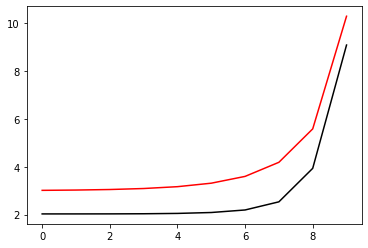

4000 99.00201541502305 8.88983598597691
[2.02903177 2.02925217 2.03076595 2.03587833 2.05008798 2.08797221
 2.19398292 2.53470077 3.93517779 9.09274092]


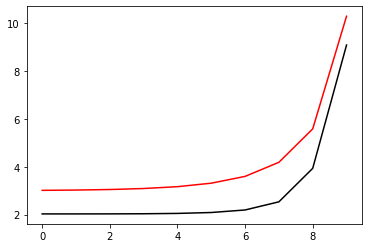

4100 99.0020150148041 8.889578050726053
[2.02904189 2.02926283 2.03077775 2.03589209 2.05010511 2.08799603
 2.19402245 2.53476302 3.93489194 9.0922458 ]


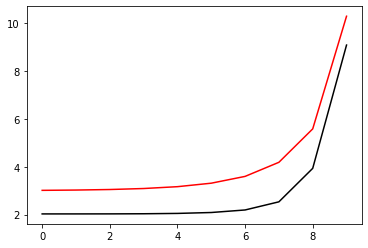

4200 99.00201461481045 8.88932026707546
[2.02905204 2.02927352 2.03078959 2.03590589 2.05012228 2.08801991
 2.19406202 2.53482512 3.93460631 9.09175071]


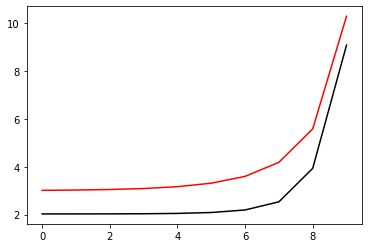

4300 99.00201421504165 8.889062634815108
[2.02906222 2.02928425 2.03080147 2.03591974 2.05013951 2.08804384
 2.19410162 2.53488708 3.93432089 9.09125563]


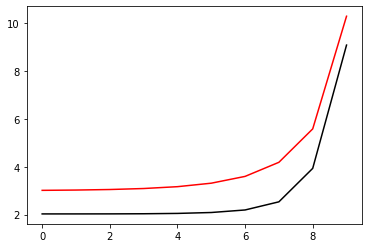

4400 99.00201381549726 8.888805153735436
[2.02907244 2.02929501 2.03081338 2.03593362 2.05015678 2.08806783
 2.19414124 2.53494889 3.93403567 9.09076057]


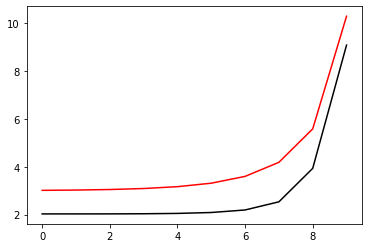

4500 99.00201341617681 8.888547823627333
[2.02908269 2.0293058  2.03082533 2.03594754 2.05017409 2.08809187
 2.19418089 2.53501056 3.93375066 9.09026554]


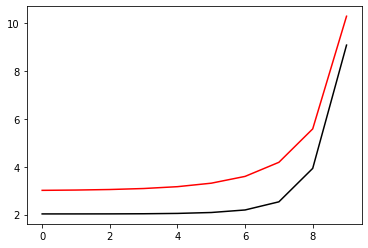

4600 99.00201301707986 8.888290644282133
[2.02909298 2.02931663 2.03083731 2.0359615  2.05019146 2.08811596
 2.19422056 2.53507208 3.93346586 9.08977052]


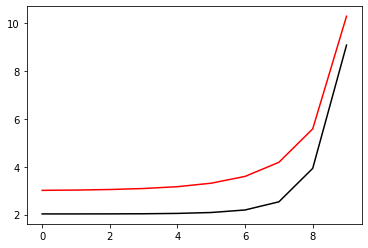

4700 99.00201261820598 8.888033615491649
[2.0291033  2.0293275  2.03084933 2.0359755  2.05020887 2.08814011
 2.19426027 2.53513346 3.93318126 9.08927553]


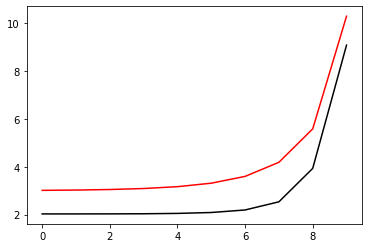

4800 99.0020122195547 8.887776737048137
[2.02911366 2.0293384  2.03086138 2.03598954 2.05022633 2.08816431
 2.1943     2.53519469 3.93289687 9.08878055]


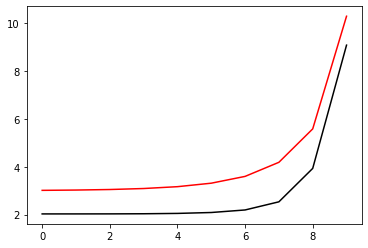

4900 99.00201182112558 8.887520008744282
[2.02912405 2.02934933 2.03087348 2.03600362 2.05024384 2.08818857
 2.19433976 2.53525579 3.93261268 9.0882856 ]


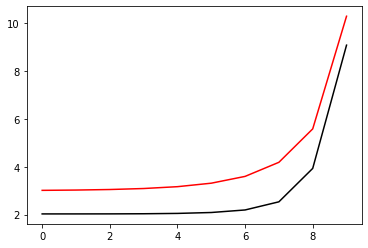

5000 99.00201142291817 8.887263430373238
[2.02913448 2.0293603  2.0308856  2.03601774 2.05026139 2.08821287
 2.19437954 2.53531673 3.93232871 9.08779066]


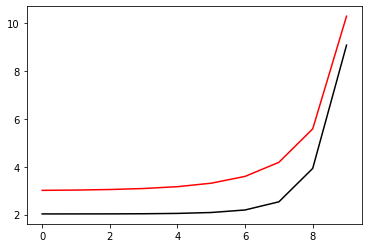

5100 99.00201102493205 8.887007001728618
[2.02914494 2.0293713  2.03089777 2.0360319  2.05027899 2.08823723
 2.19441935 2.53537754 3.93204493 9.08729575]


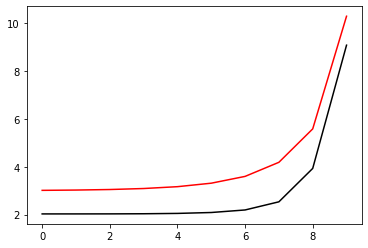

5200 99.00201062716675 8.886750722604464
[2.02915543 2.02938234 2.03090997 2.0360461  2.05029663 2.08826165
 2.19445918 2.5354382  3.93176137 9.08680086]


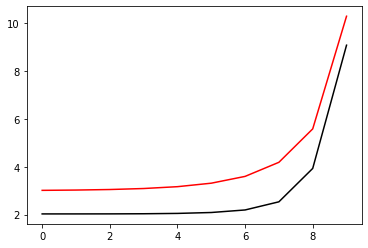

5300 99.00201022962187 8.886494592795243
[2.02916596 2.02939341 2.0309222  2.03606034 2.05031432 2.08828611
 2.19449904 2.53549872 3.93147801 9.08630598]


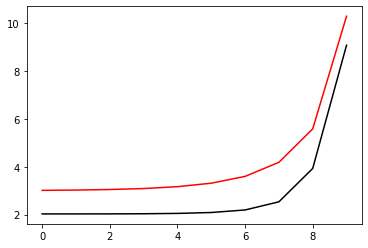

5400 99.00200983229693 8.886238612095918
[2.02917652 2.02940452 2.03093447 2.03607462 2.05033206 2.08831063
 2.19453893 2.5355591  3.93119485 9.08581113]


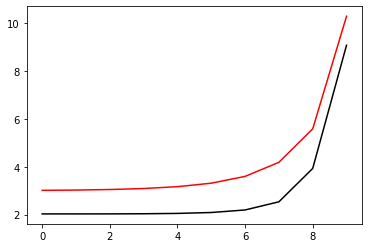

5500 99.00200943519152 8.88598278030186
[2.02918712 2.02941566 2.03094678 2.03608894 2.05034984 2.0883352
 2.19457884 2.53561934 3.9309119  9.08531629]


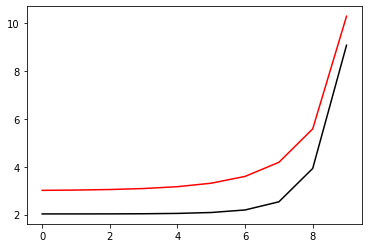

5600 99.00200903830519 8.885727097208877
[2.02919775 2.02942683 2.03095912 2.03610329 2.05036767 2.08835982
 2.19461878 2.53567944 3.93062915 9.08482148]


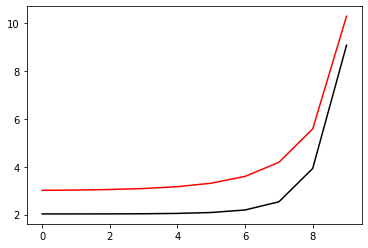

5700 99.00200864163754 8.885471562613223
[2.02920842 2.02943804 2.0309715  2.03611769 2.05038555 2.08838449
 2.19465874 2.5357394  3.9303466  9.08432669]


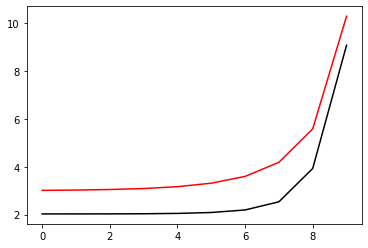

5800 99.00200824518808 8.8852161763116
[2.02921912 2.02944929 2.03098392 2.03613212 2.05040347 2.08840921
 2.19469872 2.53579921 3.93006426 9.08383192]


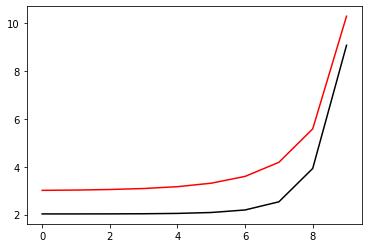

5900 99.00200784895642 8.88496093810114
[2.02922985 2.02946057 2.03099637 2.0361466  2.05042144 2.08843398
 2.19473873 2.53585889 3.92978213 9.08333717]


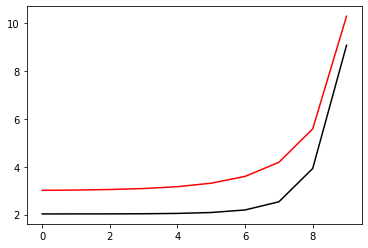

6000 99.00200745294215 8.884705847779415
[2.02924062 2.02947188 2.03100885 2.03616111 2.05043945 2.08845881
 2.19477876 2.53591843 3.9295002  9.08284244]


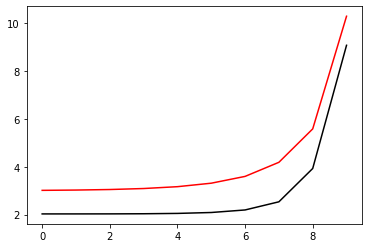

6100 99.0020070571448 8.884450905144428
[2.02925143 2.02948323 2.03102137 2.03617567 2.05045751 2.08848368
 2.19481882 2.53597782 3.92921846 9.08234772]


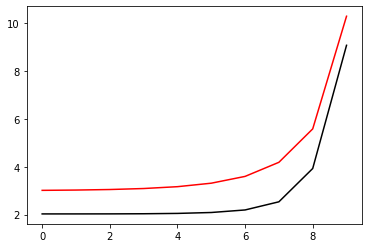

6200 99.00200666156394 8.884196109994598
[2.02926226 2.02949462 2.03103393 2.03619026 2.05047561 2.08850861
 2.1948589  2.53603708 3.92893694 9.08185303]


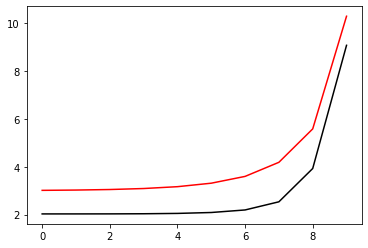

6300 99.00200626619917 8.883941462128822
[2.02927314 2.02950603 2.03104653 2.03620489 2.05049376 2.08853358
 2.19489901 2.5360962  3.92865561 9.08135836]


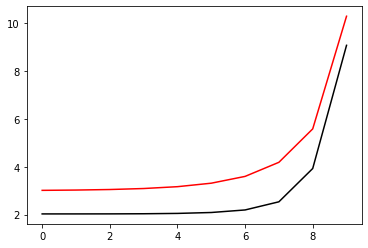

6400 99.00200587105009 8.883686961346385
[2.02928404 2.02951749 2.03105916 2.03621956 2.05051195 2.08855861
 2.19493913 2.53615518 3.92837449 9.08086371]


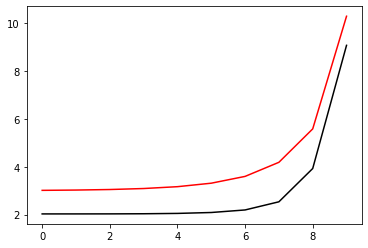

6500 99.00200547611621 8.883432607447011
[2.02929499 2.02952898 2.03107182 2.03623427 2.05053019 2.08858368
 2.19497928 2.53621403 3.92809357 9.08036909]


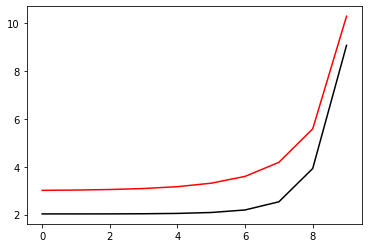

6600 99.00200508139716 8.883178400230856
[2.02930596 2.0295405  2.03108452 2.03624902 2.05054847 2.08860881
 2.19501946 2.53627273 3.92781285 9.07987448]


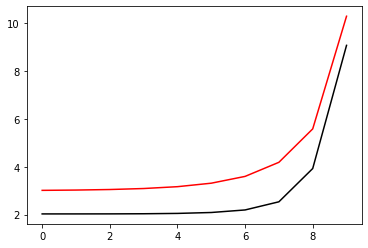

6700 99.0020046868925 8.882924339498503
[2.02931697 2.02955206 2.03109726 2.0362638  2.0505668  2.08863398
 2.19505965 2.5363313  3.92753233 9.07937989]


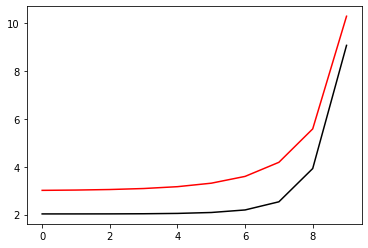

6800 99.00200429260182 8.882670425050964
[2.02932802 2.02956365 2.03111003 2.03627863 2.05058517 2.0886592
 2.19509987 2.53638973 3.92725202 9.07888532]


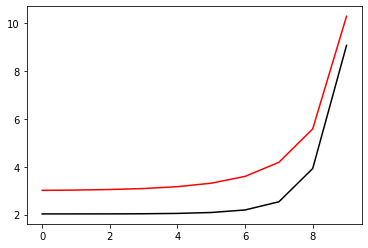

6900 99.0020038985247 8.882416656689664
[2.0293391  2.02957527 2.03112284 2.03629349 2.05060359 2.08868448
 2.19514011 2.53644803 3.9269719  9.07839078]


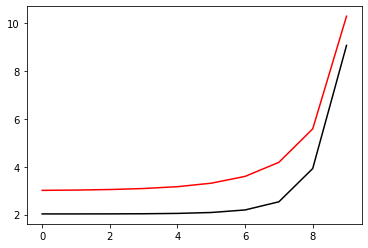

7000 99.00200350466072 8.88216303421647
[2.02935021 2.02958694 2.03113569 2.0363084  2.05062205 2.0887098
 2.19518037 2.53650619 3.92669199 9.07789625]


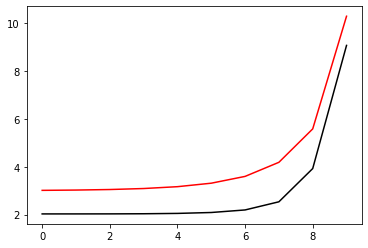

7100 99.00200311100949 8.88190955743365
[2.02936136 2.02959863 2.03114857 2.03632334 2.05064056 2.08873517
 2.19522065 2.53656421 3.92641227 9.07740174]


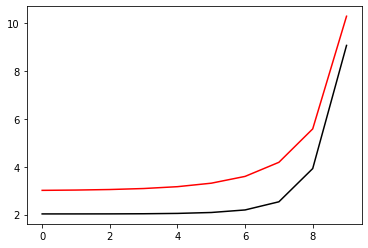

7200 99.00200271757056 8.881656226143914
[2.02937255 2.02961036 2.03116148 2.03633832 2.05065911 2.08876058
 2.19526095 2.5366221  3.92613276 9.07690726]


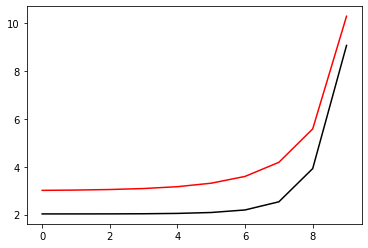

7300 99.00200232434354 8.881403040150369
[2.02938377 2.02962213 2.03117443 2.03635334 2.0506777  2.08878605
 2.19530128 2.53667985 3.92585345 9.0764128 ]


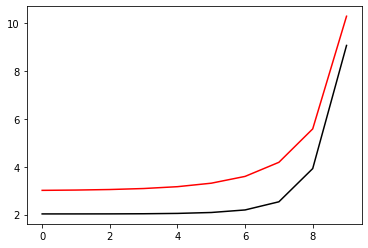

7400 99.00200193132801 8.88114999925654
[2.02939502 2.02963393 2.03118742 2.0363684  2.05069634 2.08881156
 2.19534163 2.53673747 3.92557433 9.07591835]


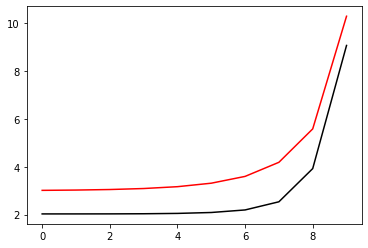

7500 99.00200153852356 8.880897103266388
[2.02940631 2.02964576 2.03120044 2.03638349 2.05071502 2.08883713
 2.19538199 2.53679495 3.92529542 9.07542393]


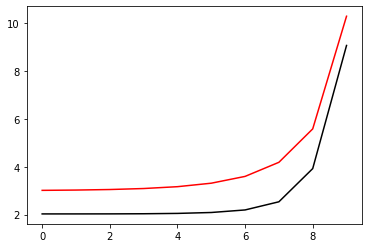

7600 99.0020011459298 8.880644351984282
[2.02941763 2.02965763 2.0312135  2.03639863 2.05073375 2.08886274
 2.19542238 2.5368523  3.9250167  9.07492953]


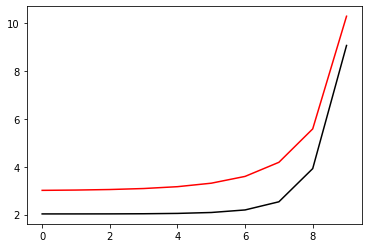

7700 99.0020007535463 8.880391745215011
[2.02942899 2.02966954 2.0312266  2.0364138  2.05075252 2.08888839
 2.19546279 2.53690951 3.92473818 9.07443515]


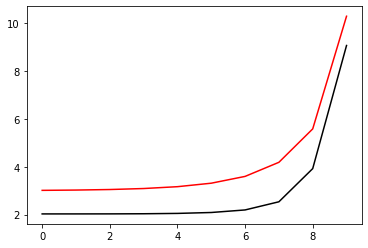

7800 99.00200036137268 8.880139282763754
[2.02944038 2.02968148 2.03123973 2.03642901 2.05077133 2.0889141
 2.19550322 2.5369666  3.92445987 9.07394079]


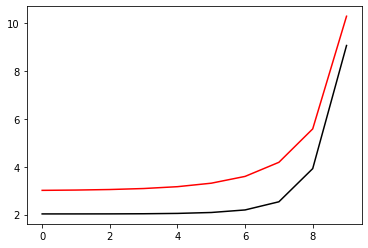

7900 99.0019999694085 8.879886964436121
[2.0294518  2.02969345 2.03125289 2.03644426 2.05079019 2.08893985
 2.19554367 2.53702354 3.92418175 9.07344645]


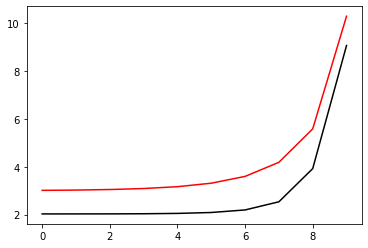

8000 99.0019995776534 8.87963479003814
[2.02946326 2.02970546 2.03126609 2.03645955 2.05080909 2.08896565
 2.19558413 2.53708036 3.92390382 9.07295213]


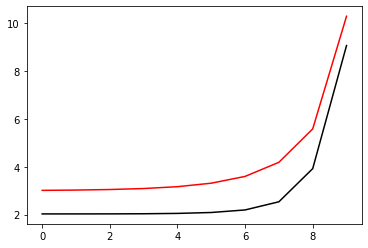

8100 99.00199918610694 8.879382759376222
[2.02947476 2.0297175  2.03127933 2.03647487 2.05082803 2.08899149
 2.19562462 2.53713704 3.9236261  9.07245783]


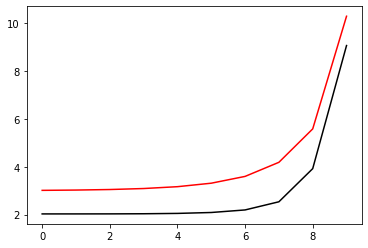

8200 99.00199879476875 8.879130872257205
[2.02948629 2.02972958 2.0312926  2.03649024 2.05084702 2.08901738
 2.19566513 2.53719359 3.92334857 9.07196355]


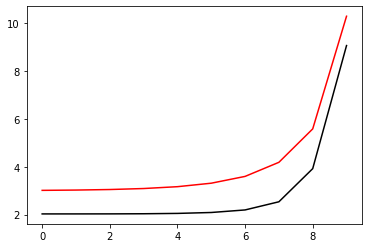

8300 99.00199840363842 8.87887912848834
[2.02949785 2.02974169 2.03130591 2.03650564 2.05086605 2.08904332
 2.19570565 2.53725    3.92307124 9.07146929]


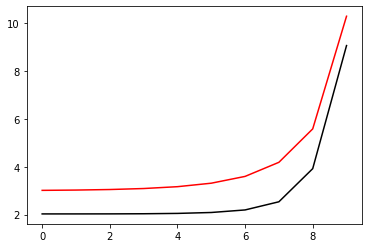

8400 99.00199801271553 8.878627527877267
[2.02950945 2.02975384 2.03131925 2.03652108 2.05088512 2.0890693
 2.1957462  2.53730629 3.92279411 9.07097506]


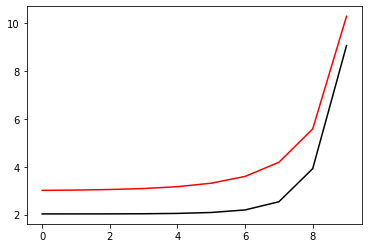

8500 99.00199762199973 8.87837607023204
[2.02952109 2.02976602 2.03133263 2.03653656 2.05090423 2.08909533
 2.19578676 2.53736244 3.92251718 9.07048084]


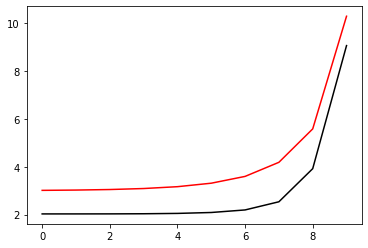

8600 99.00199723149058 8.878124755361108
[2.02953276 2.02977824 2.03134605 2.03655208 2.05092339 2.08912141
 2.19582735 2.53741847 3.92224044 9.06998665]


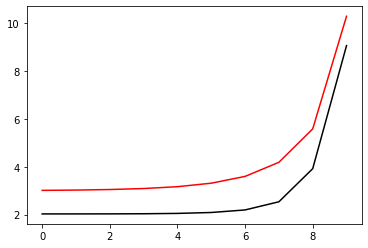

8700 99.0019968411877 8.877873583073336
[2.02954446 2.02979049 2.0313595  2.03656763 2.05094259 2.08914753
 2.19586795 2.53747436 3.9219639  9.06949248]


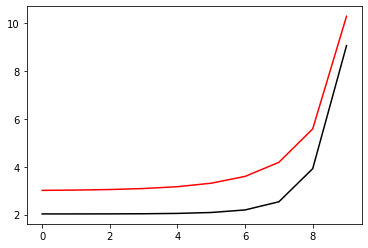

8800 99.00199645109072 8.877622553177973
[2.0295562  2.02980278 2.03137298 2.03658323 2.05096184 2.08917369
 2.19590857 2.53753012 3.92168755 9.06899832]


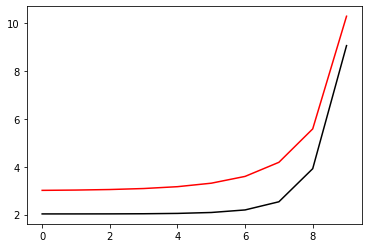

8900 99.00199606119922 8.877371665484672
[2.02956797 2.0298151  2.0313865  2.03659886 2.05098112 2.0891999
 2.1959492  2.53758575 3.9214114  9.06850419]


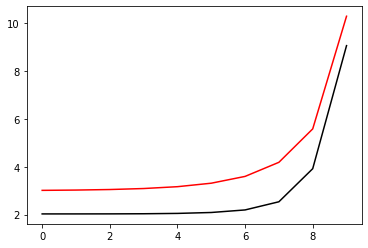

9000 99.00199567151282 8.87712091980351
[2.02957978 2.02982746 2.03140006 2.03661453 2.05100045 2.08922616
 2.19598986 2.53764125 3.92113545 9.06801008]


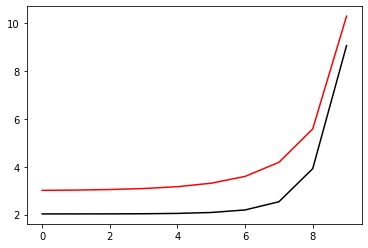

9100 99.00199528203113 8.876870315944922
[2.02959162 2.02983985 2.03141365 2.03663023 2.05101982 2.08925246
 2.19603053 2.53769662 3.92085969 9.06751599]


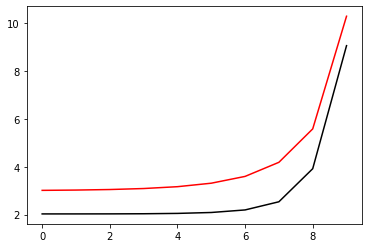

9200 99.00199489275376 8.876619853719768
[2.02960349 2.02985227 2.03142728 2.03664598 2.05103923 2.0892788
 2.19607122 2.53775187 3.92058413 9.06702192]


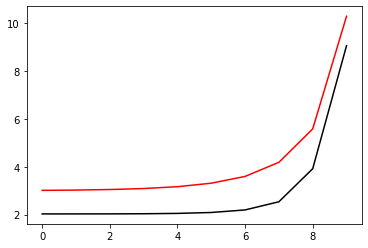

9300 99.00199450368032 8.876369532939297
[2.02961541 2.02986473 2.03144095 2.03666176 2.05105869 2.08930519
 2.19611193 2.53780698 3.92030876 9.06652788]


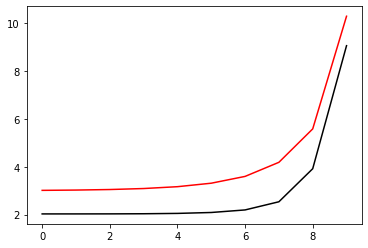

9400 99.00199411481043 8.87611935341515
[2.02962735 2.02987723 2.03145464 2.03667758 2.05107818 2.08933163
 2.19615265 2.53786197 3.92003358 9.06603385]


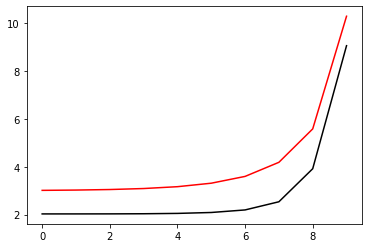

9500 99.00199372614372 8.875869314959346
[2.02963933 2.02988976 2.03146838 2.03669344 2.05109772 2.08935811
 2.19619339 2.53791682 3.9197586  9.06553984]


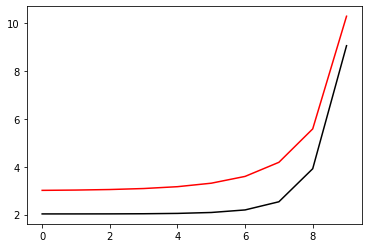

9600 99.00199333767979 8.875619417384323
[2.02965135 2.02990232 2.03148215 2.03670933 2.0511173  2.08938463
 2.19623415 2.53797155 3.91948382 9.06504586]


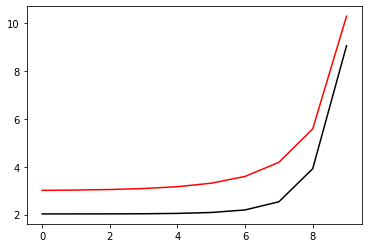

9700 99.00199294941824 8.875369660502901
[2.0296634  2.02991492 2.03149595 2.03672526 2.05113693 2.08941119
 2.19627492 2.53802615 3.91920923 9.0645519 ]


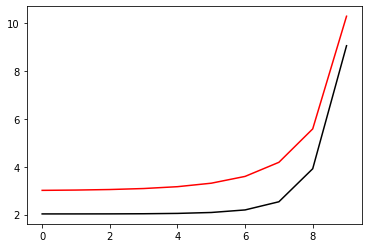

9800 99.00199256135873 8.875120044128263
[2.02967548 2.02992756 2.03150979 2.03674123 2.05115659 2.0894378
 2.19631572 2.53808063 3.91893483 9.06405795]


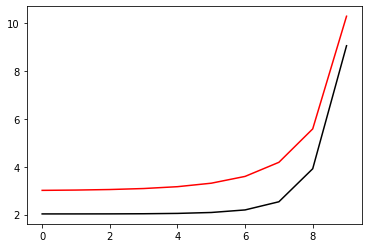

9900 99.00199217350085 8.874870568074018
[2.0296876  2.02994022 2.03152367 2.03675724 2.05117629 2.08946446
 2.19635652 2.53813497 3.91866062 9.06356403]


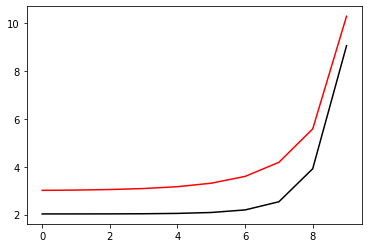

10000 99.00199178584423 8.874621232154142
[2.02969975 2.02995293 2.03153758 2.03677329 2.05119604 2.08949115
 2.19639734 2.53818919 3.91838661 9.06307013]


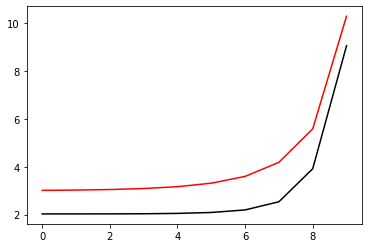

In [72]:
optimizer=tf.optimizers.SGD(learning_rate=0.01)
for i in range (1, 10001):
    run()
    if i%100==0: print(i, Error_func(h, m2_2).numpy(), m2_2.numpy()), print(h.numpy()), plt.plot(h_real, 'r-'), plt.plot(h.numpy(), 'k-'), plt.show()

100 99.00199139838848 8.874372036183013
[2.02971194 2.02996566 2.03155153 2.03678937 2.05121583 2.08951789
 2.19643818 2.53824329 3.91811279 9.06257625]


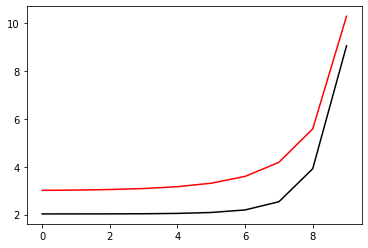

200 99.00199101113326 8.874122979975356
[2.02972416 2.02997844 2.03156551 2.03680549 2.05123566 2.08954467
 2.19647904 2.53829725 3.91783917 9.06208239]


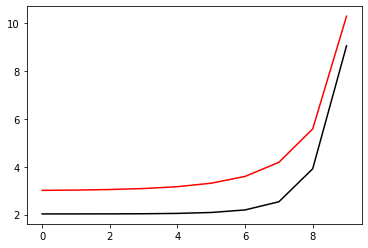

300 99.00199062407816 8.873874063346326
[2.02973642 2.02999124 2.03157952 2.03682165 2.05125553 2.0895715
 2.19651991 2.53835109 3.91756573 9.06158856]


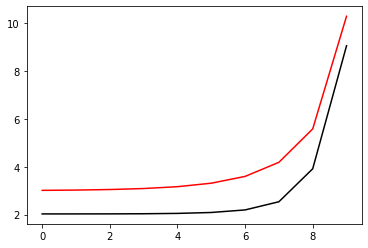

400 99.00199023722283 8.873625286111439
[2.02974871 2.03000409 2.03159358 2.03683784 2.05127544 2.08959836
 2.19656079 2.53840481 3.91729249 9.06109474]


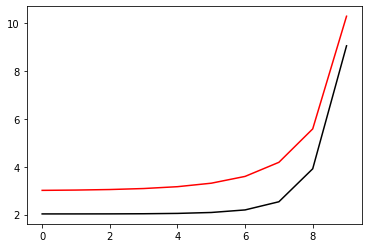

500 99.00198985056686 8.873376648086593
[2.02976104 2.03001696 2.03160766 2.03685407 2.05129539 2.08962527
 2.19660169 2.5384584  3.91701944 9.06060095]


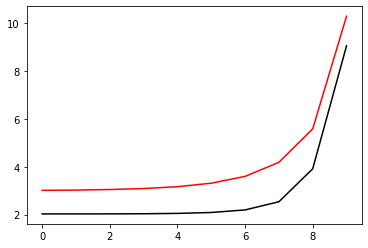

600 99.00198946410994 8.873128149088073
[2.0297734  2.03002987 2.03162179 2.03687034 2.05131538 2.08965222
 2.19664261 2.53851186 3.91674658 9.06010717]


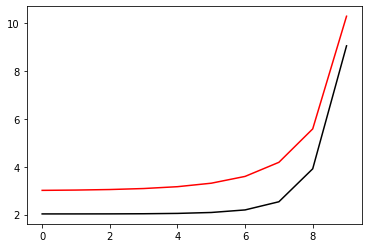

700 99.00198907785165 8.872879788932535
[2.0297858  2.03004282 2.03163595 2.03688665 2.05133542 2.08967922
 2.19668354 2.5385652  3.91647392 9.05961342]


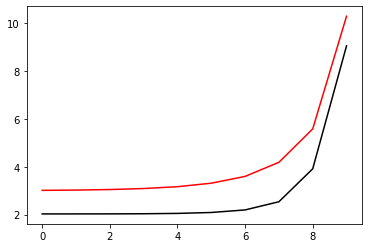

800 99.00198869179162 8.872631567437011
[2.02979823 2.0300558  2.03165014 2.03690299 2.05135549 2.08970625
 2.19672448 2.53861842 3.91620144 9.05911969]


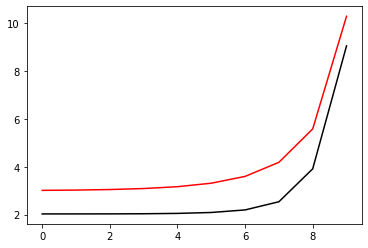

900 99.0019883059295 8.872383484418922
[2.0298107  2.03006882 2.03166437 2.03691937 2.0513756  2.08973333
 2.19676544 2.53867151 3.91592916 9.05862598]


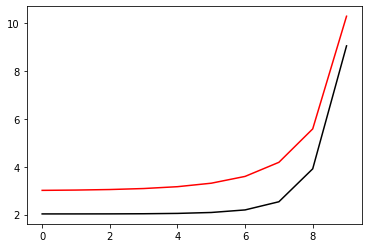

1000 99.00198792026494 8.872135539696044
[2.0298232  2.03008187 2.03167863 2.03693579 2.05139576 2.08976044
 2.19680641 2.53872448 3.91565707 9.05813229]


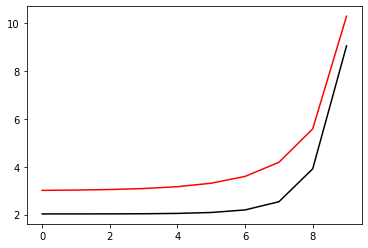

1100 99.00198753479752 8.871887733086579
[2.02983573 2.03009495 2.03169293 2.03695224 2.05141595 2.0897876
 2.1968474  2.53877732 3.91538516 9.05763863]


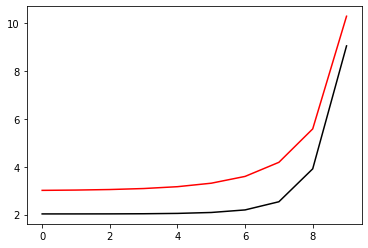

1200 99.00198714952693 8.871640064409045
[2.0298483  2.03010807 2.03170726 2.03696873 2.05143619 2.0898148
 2.1968884  2.53883005 3.91511345 9.05714498]


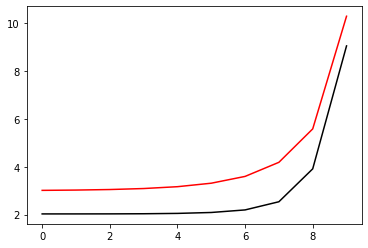

1300 99.00198676445278 8.871392533482345
[2.0298609  2.03012122 2.03172163 2.03698526 2.05145647 2.08984205
 2.19692941 2.53888264 3.91484193 9.05665136]


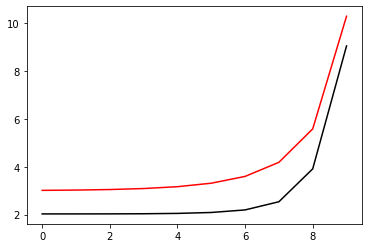

1400 99.0019863795747 8.871145140125785
[2.02987354 2.03013441 2.03173604 2.03700182 2.05147678 2.08986933
 2.19697044 2.53893512 3.91457059 9.05615775]


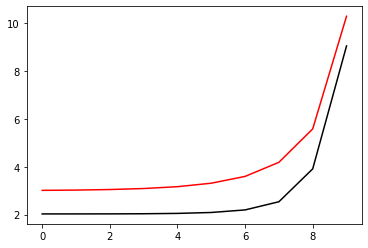

1500 99.00198599489235 8.870897884159017
[2.02988622 2.03014763 2.03175048 2.03701842 2.05149714 2.08989665
 2.19701148 2.53898747 3.91429945 9.05566417]


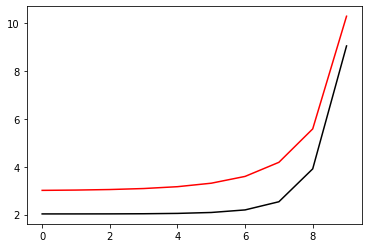

1600 99.00198561040537 8.870650765402054
[2.02989892 2.03016089 2.03176495 2.03703506 2.05151753 2.08992401
 2.19705253 2.5390397  3.9140285  9.05517061]


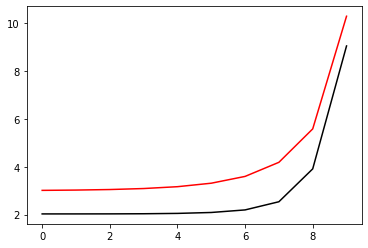

1700 99.00198522611336 8.870403783675311
[2.02991167 2.03017418 2.03177946 2.03705174 2.05153797 2.08995142
 2.1970936  2.53909181 3.91375773 9.05467707]


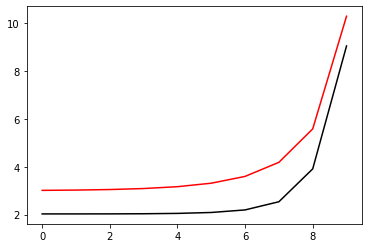

1800 99.00198484201603 8.870156938799537
[2.02992444 2.03018751 2.031794   2.03706845 2.05155844 2.08997886
 2.19713468 2.5391438  3.91348716 9.05418355]


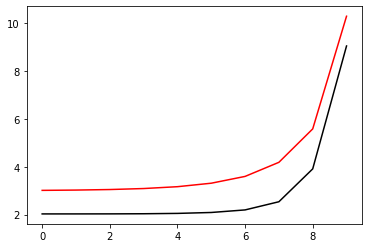

1900 99.00198445811294 8.869910230595858
[2.02993726 2.03020087 2.03180858 2.0370852  2.05157896 2.09000635
 2.19717577 2.53919567 3.91321677 9.05369006]


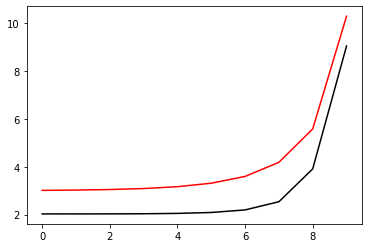

2000 99.00198407440382 8.86966365888577
[2.0299501  2.03021427 2.0318232  2.03710198 2.05159951 2.09003387
 2.19721688 2.53924741 3.91294657 9.05319658]


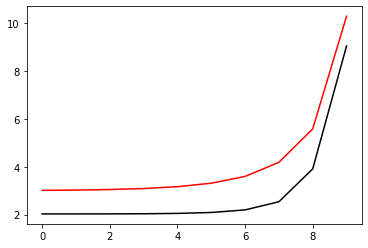

2100 99.00198369088824 8.86941722349114
[2.02996298 2.0302277  2.03183785 2.0371188  2.0516201  2.09006143
 2.19725799 2.53929904 3.91267656 9.05270313]


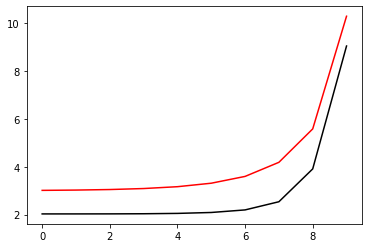

2200 99.0019833075659 8.869170924234188
[2.0299759  2.03024116 2.03185253 2.03713566 2.05164074 2.09008903
 2.19729912 2.53935054 3.91240674 9.0522097 ]


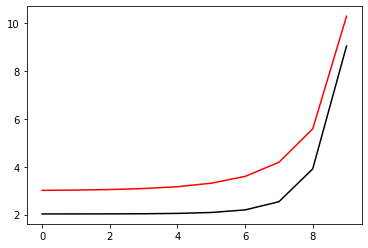

2300 99.00198292443642 8.868924760937489
[2.02998885 2.03025466 2.03186725 2.03715255 2.05166141 2.09011668
 2.19734027 2.53940193 3.9121371  9.05171629]


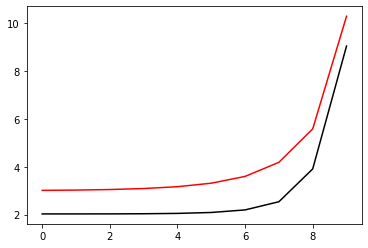

2400 99.00198254149944 8.868678733423994
[2.03000184 2.0302682  2.03188201 2.03716949 2.05168212 2.09014436
 2.19738142 2.53945319 3.91186765 9.0512229 ]


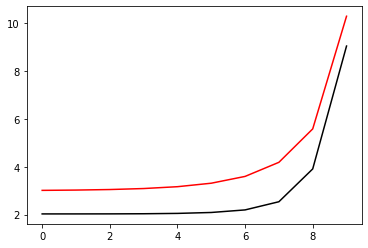

2500 99.00198215875464 8.868432841517038
[2.03001485 2.03028177 2.0318968  2.03718645 2.05170287 2.09017208
 2.19742258 2.53950434 3.91159839 9.05072953]


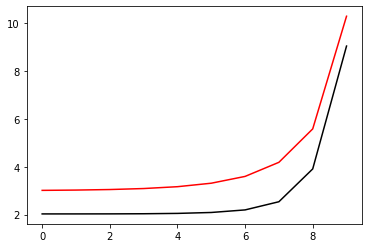

2600 99.00198177620165 8.868187085040251
[2.03002791 2.03029537 2.03191162 2.03720345 2.05172366 2.09019984
 2.19746376 2.53955537 3.91132932 9.05023618]


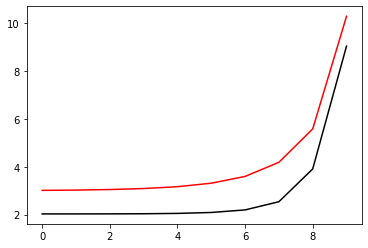

2700 99.00198139384013 8.867941463817663
[2.030041   2.03030901 2.03192648 2.03722049 2.05174449 2.09022764
 2.19750495 2.53960627 3.91106043 9.04974286]


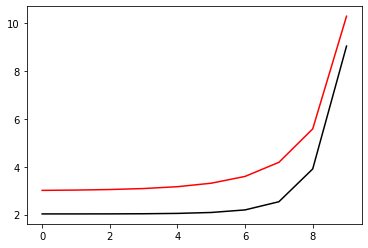

2800 99.00198101166971 8.86769597767366
[2.03005412 2.03032268 2.03194137 2.03723757 2.05176535 2.09025547
 2.19754615 2.53965706 3.91079173 9.04924956]


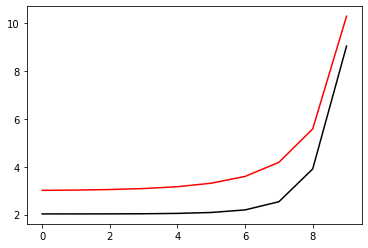

2900 99.00198062969007 8.867450626432985
[2.03006728 2.03033639 2.0319563  2.03725468 2.05178626 2.09028335
 2.19758736 2.53970773 3.91052322 9.04875628]


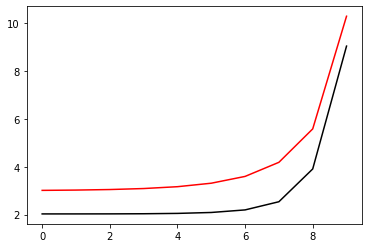

3000 99.00198024790086 8.867205409920738
[2.03008047 2.03035013 2.03197127 2.03727183 2.0518072  2.09031126
 2.19762858 2.53975828 3.91025489 9.04826302]


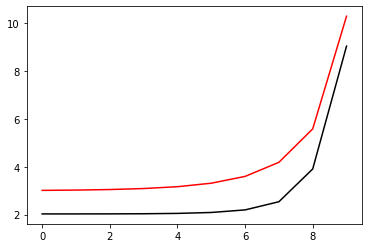

3100 99.00197986630171 8.866960327962351
[2.0300937  2.03036391 2.03198627 2.03728901 2.05182819 2.09033921
 2.19766981 2.53980872 3.90998674 9.04776978]


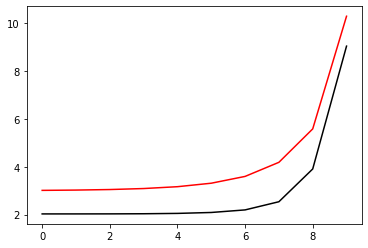

3200 99.00197948489232 8.86671538038363
[2.03010696 2.03037772 2.0320013  2.03730623 2.05184921 2.0903672
 2.19771105 2.53985904 3.90971879 9.04727656]


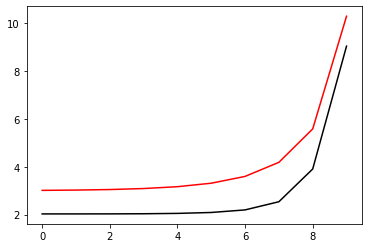

3300 99.0019791036723 8.86647056701073
[2.03012026 2.03039156 2.03201637 2.03732349 2.05187027 2.09039523
 2.1977523  2.53990924 3.90945102 9.04678337]


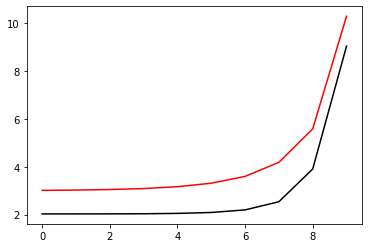

3400 99.00197872264137 8.86622588767015
[2.03013359 2.03040544 2.03203147 2.03734078 2.05189136 2.09042329
 2.19779357 2.53995932 3.90918343 9.04629019]


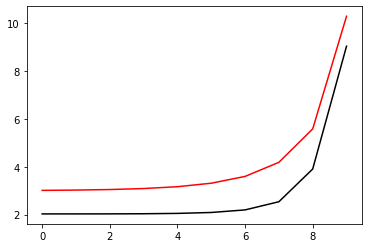

3500 99.00197834179912 8.86598134218876
[2.03014695 2.03041936 2.03204661 2.03735811 2.0519125  2.09045139
 2.19783484 2.54000928 3.90891603 9.04579704]


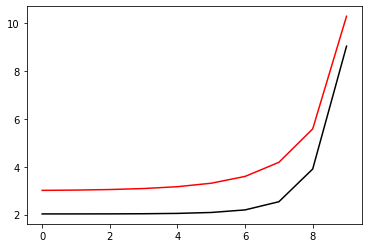

3600 99.00197796114523 8.865736930393748
[2.03016035 2.0304333  2.03206178 2.03737547 2.05193367 2.09047953
 2.19787612 2.54005913 3.90864881 9.04530391]


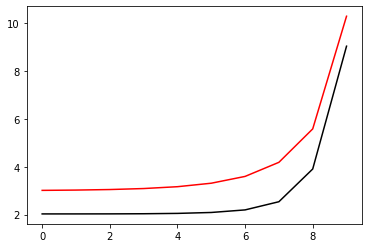

3700 99.0019775806794 8.865492652112678
[2.03017379 2.03044729 2.03207699 2.03739287 2.05195488 2.09050771
 2.19791742 2.54010887 3.90838178 9.0448108 ]


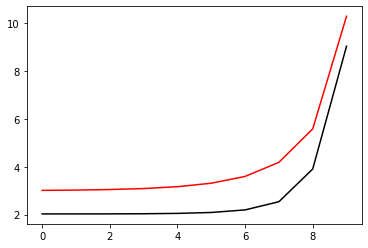

3800 99.00197720040124 8.865248507173431
[2.03018726 2.0304613  2.03209223 2.03741031 2.05197613 2.09053592
 2.19795872 2.54015848 3.90811493 9.04431772]


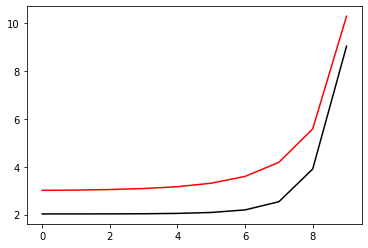

3900 99.00197682031046 8.865004495404262
[2.03020076 2.03047536 2.03210751 2.03742778 2.05199742 2.09056417
 2.19800003 2.54020799 3.90784826 9.04382465]


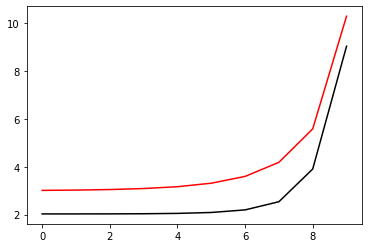

4000 99.0019764404067 8.864760616633772
[2.0302143  2.03048944 2.03212282 2.03744529 2.05201875 2.09059246
 2.19804135 2.54025737 3.90758178 9.04333161]


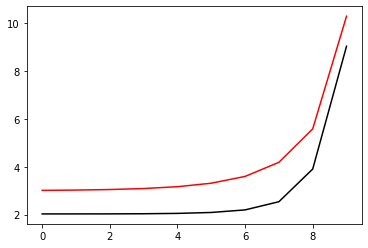

4100 99.00197606068963 8.864516870690899
[2.03022787 2.03050356 2.03213816 2.03746283 2.05204011 2.09062078
 2.19808268 2.54030664 3.90731549 9.04283859]


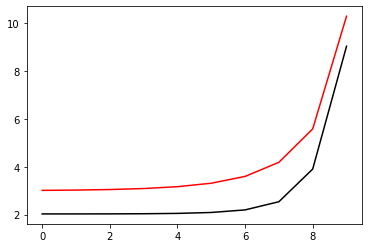

4200 99.00197568115891 8.864273257404907
[2.03024148 2.03051772 2.03215354 2.03748041 2.05206151 2.09064914
 2.19812402 2.5403558  3.90704937 9.04234559]


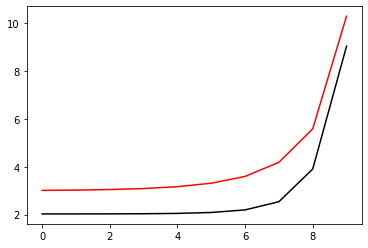

4300 99.00197530181421 8.864029776605431
[2.03025512 2.03053191 2.03216896 2.03749802 2.05208295 2.09067754
 2.19816537 2.54040484 3.90678344 9.04185261]


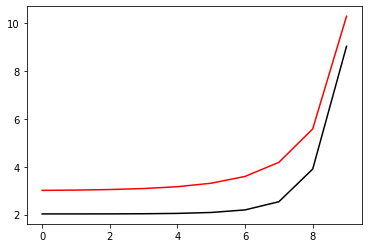

4400 99.00197492265521 8.863786428122426
[2.03026879 2.03054613 2.03218441 2.03751567 2.05210442 2.09070597
 2.19820673 2.54045377 3.90651769 9.04135966]


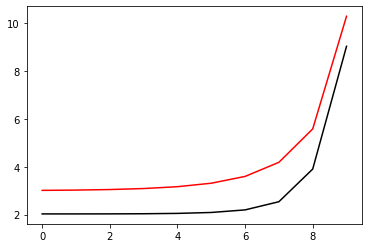

4500 99.00197454368157 8.863543211786183
[2.0302825  2.03056039 2.03219989 2.03753336 2.05212593 2.09073444
 2.1982481  2.54050258 3.90625213 9.04086672]


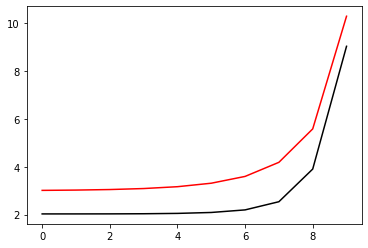

4600 99.00197416489294 8.863300127427365
[2.03029625 2.03057468 2.03221541 2.03755108 2.05214748 2.09076294
 2.19828947 2.54055128 3.90598674 9.04037381]


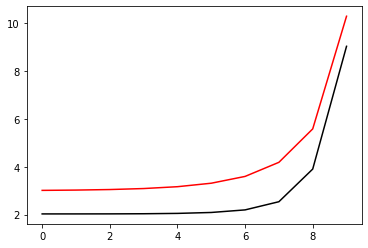

4700 99.00197378628904 8.863057174876971
[2.03031003 2.03058901 2.03223096 2.03756883 2.05216907 2.09079148
 2.19833085 2.54059987 3.90572154 9.03988092]


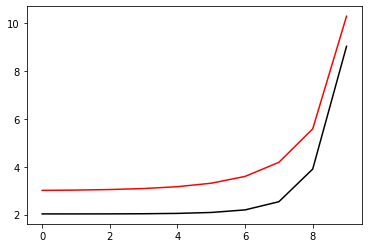

4800 99.00197340786947 8.862814353966296
[2.03032384 2.03060337 2.03224655 2.03758662 2.05219069 2.09082006
 2.19837224 2.54064834 3.90545652 9.03938805]


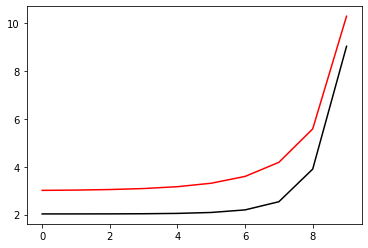

4900 99.00197302963399 8.862571664527003
[2.03033769 2.03061776 2.03226217 2.03760445 2.05221235 2.09084867
 2.19841364 2.5406967  3.90519169 9.0388952 ]


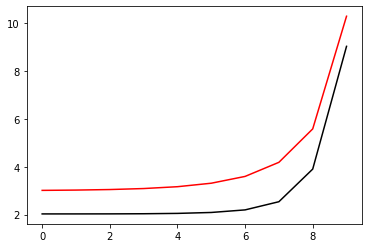

5000 99.00197265158221 8.862329106391082
[2.03035157 2.03063219 2.03227783 2.03762231 2.05223405 2.09087731
 2.19845505 2.54074495 3.90492703 9.03840238]


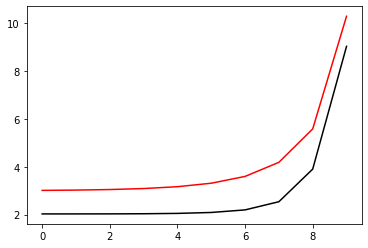

5100 99.00197227371385 8.862086679390863
[2.03036549 2.03064666 2.03229352 2.03764021 2.05225578 2.09090599
 2.19849647 2.54079308 3.90466256 9.03790958]


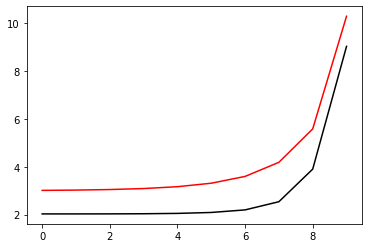

5200 99.00197189602852 8.861844383359012
[2.03037944 2.03066115 2.03230924 2.03765814 2.05227755 2.09093471
 2.19853789 2.54084111 3.90439826 9.0374168 ]


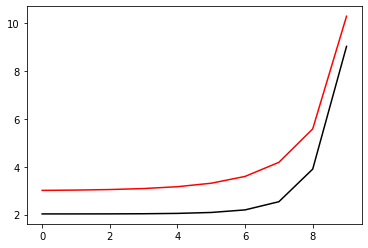

5300 99.00197151852596 8.861602218128521
[2.03039342 2.03067569 2.032325   2.03767611 2.05229936 2.09096346
 2.19857932 2.54088902 3.90413415 9.03692404]


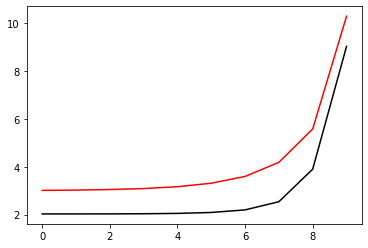

5400 99.00197114120586 8.861360183532717
[2.03040744 2.03069025 2.0323408  2.03769411 2.05232121 2.09099225
 2.19862076 2.54093682 3.90387022 9.0364313 ]


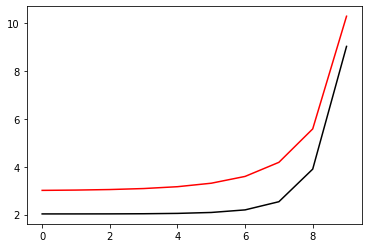

5500 99.00197076406782 8.861118279405247
[2.0304215  2.03070485 2.03235662 2.03771215 2.05234309 2.09102107
 2.1986622  2.5409845  3.90360647 9.03593859]


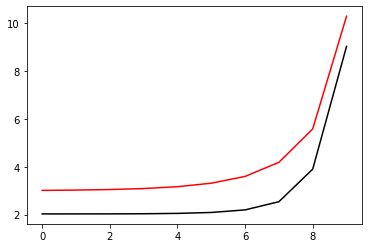

5600 99.00197038711158 8.860876505580114
[2.03043559 2.03071949 2.03237249 2.03773022 2.052365   2.09104992
 2.19870365 2.54103208 3.90334289 9.03544589]


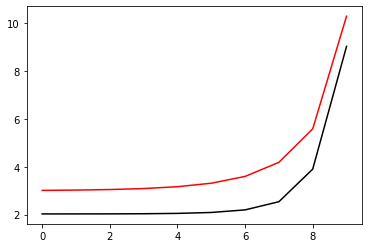

5700 99.0019700103368 8.860634861891628
[2.03044971 2.03073416 2.03238838 2.03774833 2.05238696 2.09107881
 2.19874511 2.54107955 3.9030795  9.03495322]


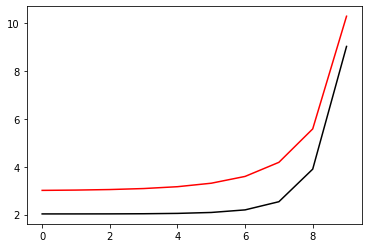

5800 99.00196963374319 8.860393348174444
[2.03046387 2.03074886 2.03240431 2.03776647 2.05240894 2.09110773
 2.19878658 2.5411269  3.90281629 9.03446057]


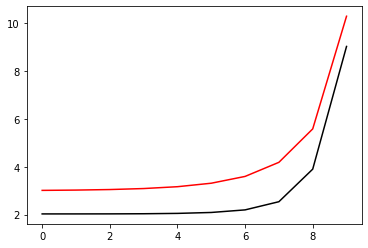

5900 99.00196925733039 8.860151964263531
[2.03047806 2.0307636  2.03242028 2.03778465 2.05243097 2.09113669
 2.19882805 2.54117415 3.90255326 9.03396795]


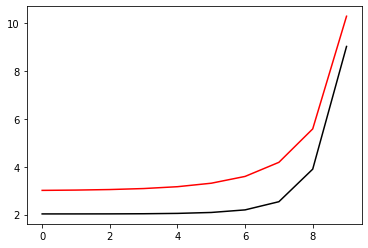

6000 99.0019688810981 8.859910709994193
[2.03049229 2.03077837 2.03243628 2.03780286 2.05245303 2.09116568
 2.19886953 2.54122128 3.9022904  9.03347534]


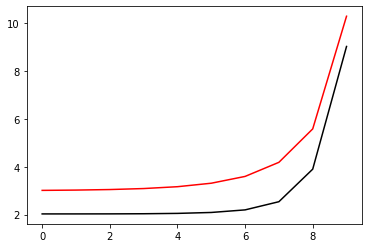

6100 99.00196850504602 8.859669585202049
[2.03050655 2.03079318 2.03245231 2.03782111 2.05247513 2.09119471
 2.19891101 2.54126831 3.90202773 9.03298276]


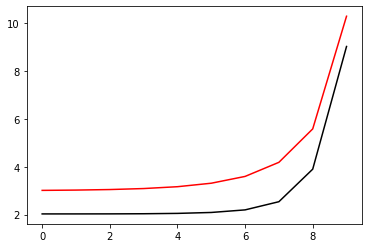

6200 99.0019681291738 8.859428589723054
[2.03052084 2.03080802 2.03246838 2.03783939 2.05249726 2.09122376
 2.1989525  2.54131522 3.90176523 9.0324902 ]


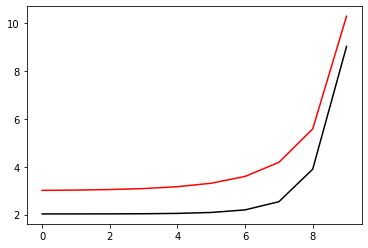

6300 99.0019677534812 8.859187723393488
[2.03053517 2.03082289 2.03248448 2.03785771 2.05251943 2.09125285
 2.198994   2.54136203 3.90150292 9.03199766]


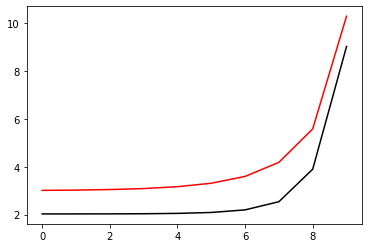

6400 99.0019673779678 8.858946986049949
[2.03054953 2.0308378  2.03250062 2.03787606 2.05254164 2.09128198
 2.19903551 2.54140872 3.90124078 9.03150514]


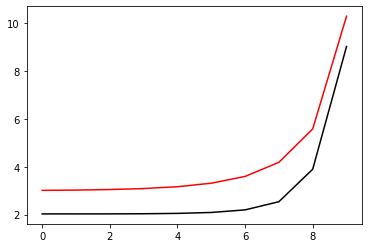

6500 99.00196700263338 8.858706377529348
[2.03056393 2.03085274 2.03251679 2.03789444 2.05256388 2.09131114
 2.19907702 2.54145531 3.90097882 9.03101265]


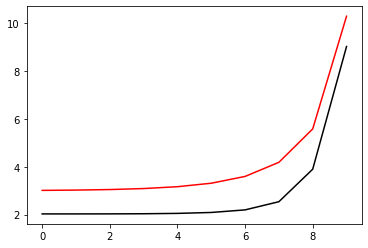

6600 99.00196662747757 8.85846589766894
[2.03057836 2.03086772 2.03253299 2.03791286 2.05258615 2.09134033
 2.19911853 2.54150179 3.90071704 9.03052017]


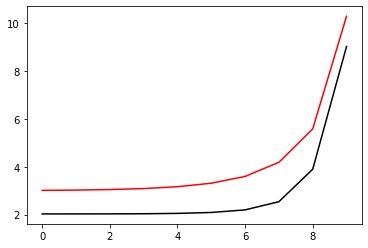

6700 99.00196625250011 8.858225546306276
[2.03059283 2.03088273 2.03254923 2.03793132 2.05260846 2.09136955
 2.19916005 2.54154816 3.90045543 9.03002772]


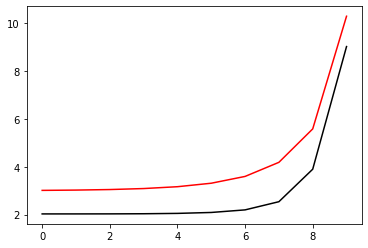

6800 99.00196587770063 8.857985323279241
[2.03060733 2.03089777 2.0325655  2.03794981 2.05263081 2.09139881
 2.19920158 2.54159443 3.900194   9.0295353 ]


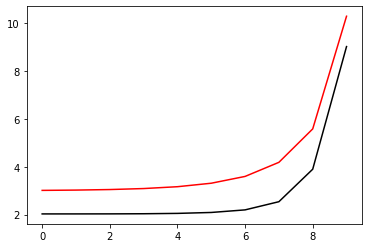

6900 99.00196550307888 8.857745228426042
[2.03062186 2.03091285 2.03258181 2.03796833 2.05265319 2.0914281
 2.19924311 2.54164058 3.89993275 9.02904289]


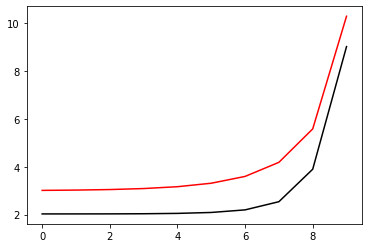

7000 99.00196512863451 8.857505261585189
[2.03063643 2.03092797 2.03259815 2.03798689 2.05267561 2.09145742
 2.19928465 2.54168663 3.89967168 9.02855051]


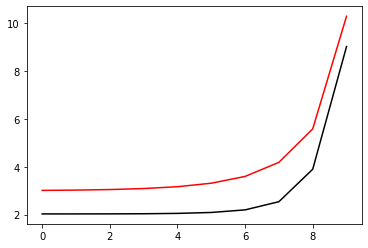

7100 99.00196475436725 8.857265422595521
[2.03065103 2.03094311 2.03261452 2.03800548 2.05269806 2.09148677
 2.19932619 2.54173257 3.89941078 9.02805815]


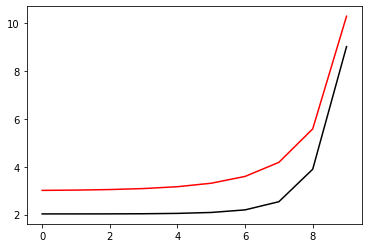

7200 99.00196438027676 8.857025711296197
[2.03066567 2.03095829 2.03263093 2.03802411 2.05272055 2.09151616
 2.19936774 2.5417784  3.89915006 9.02756581]


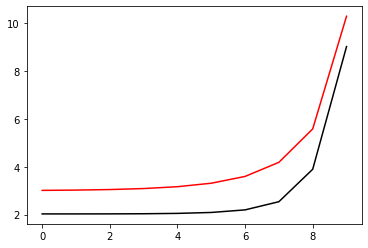

7300 99.00196400636275 8.856786127526668
[2.03068034 2.03097351 2.03264737 2.03804277 2.05274307 2.09154558
 2.19940929 2.54182413 3.89888952 9.02707349]


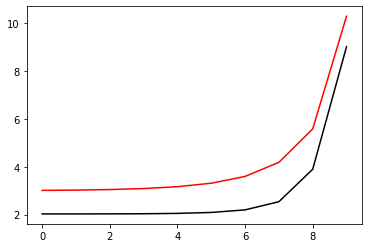

7400 99.00196363262492 8.856546671126718
[2.03069505 2.03098876 2.03266385 2.03806147 2.05276563 2.09157503
 2.19945084 2.54186975 3.89862915 9.0265812 ]


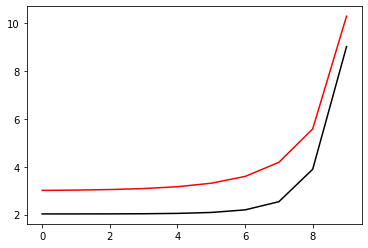

7500 99.00196325906295 8.856307341936446
[2.03070979 2.03100404 2.03268036 2.0380802  2.05278822 2.09160451
 2.19949241 2.54191526 3.89836896 9.02608892]


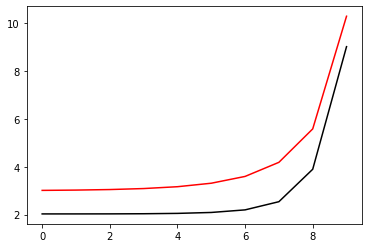

7600 99.00196288567656 8.856068139796275
[2.03072456 2.03101936 2.0326969  2.03809896 2.05281085 2.09163402
 2.19953397 2.54196067 3.89810895 9.02559667]


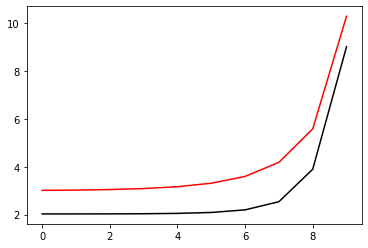

7700 99.00196251246545 8.8558290645469
[2.03073937 2.03103471 2.03271348 2.03811776 2.05283351 2.09166357
 2.19957554 2.54200597 3.89784911 9.02510445]


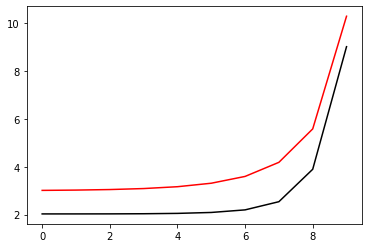

7800 99.0019621394293 8.855590116029356
[2.03075421 2.03105009 2.03273009 2.03813659 2.0528562  2.09169315
 2.19961712 2.54205117 3.89758945 9.02461224]


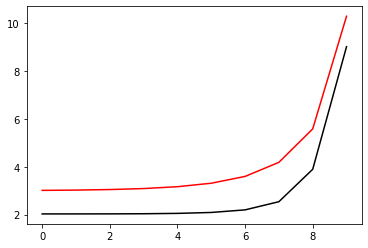

7900 99.0019617665678 8.855351294084995
[2.03076909 2.03106551 2.03274674 2.03815546 2.05287893 2.09172275
 2.1996587  2.54209626 3.89732996 9.02412006]


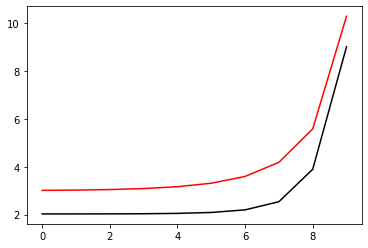

8000 99.00196139388068 8.855112598555447
[2.03078399 2.03108096 2.03276342 2.03817436 2.0529017  2.09175239
 2.19970028 2.54214124 3.89707064 9.0236279 ]


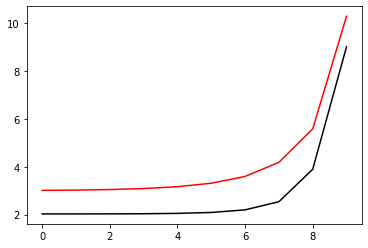

8100 99.00196102136763 8.854874029282682
[2.03079894 2.03109645 2.03278013 2.03819329 2.0529245  2.09178206
 2.19974186 2.54218612 3.8968115  9.02313576]


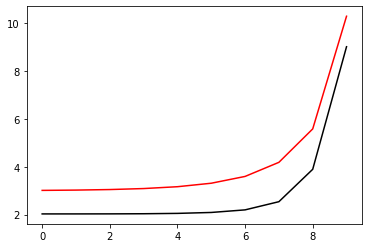

8200 99.00196064902838 8.854635586108962
[2.03081392 2.03111197 2.03279688 2.03821226 2.05294733 2.09181177
 2.19978345 2.5422309  3.89655254 9.02264364]


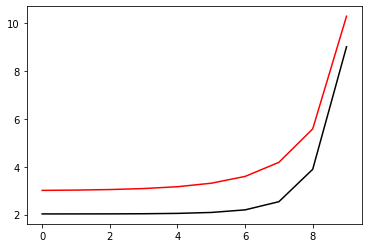

8300 99.00196027686259 8.854397268876848
[2.03082893 2.03112752 2.03281366 2.03823127 2.0529702  2.0918415
 2.19982505 2.54227557 3.89629375 9.02215155]


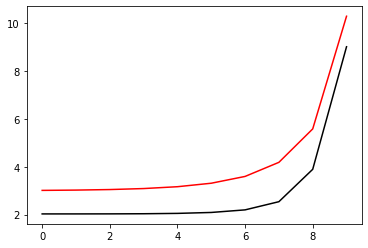

8400 99.00195990486996 8.854159077429234
[2.03084397 2.03114311 2.03283047 2.0382503  2.0529931  2.09187126
 2.19986665 2.54232014 3.89603513 9.02165948]


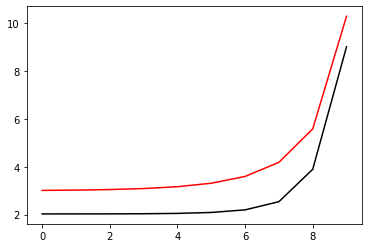

8500 99.00195953305023 8.853921011609287
[2.03085906 2.03115873 2.03284732 2.03826937 2.05301604 2.09190106
 2.19990825 2.5423646  3.89577669 9.02116743]


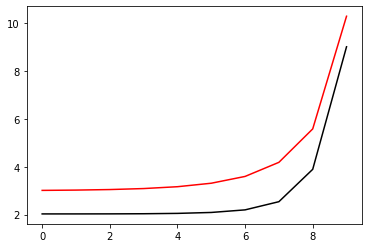

8600 99.0019591614031 8.85368307126051
[2.03087417 2.03117439 2.0328642  2.03828847 2.05303901 2.09193088
 2.19994985 2.54240896 3.89551842 9.0206754 ]


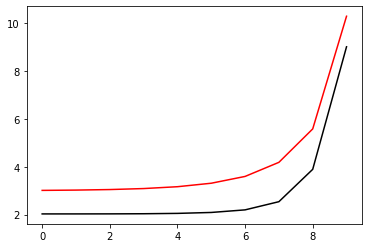

8700 99.00195878992827 8.853445256226687
[2.03088932 2.03119008 2.03288111 2.03830761 2.05306201 2.09196073
 2.19999146 2.54245322 3.89526033 9.0201834 ]


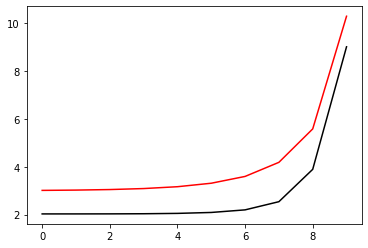

8800 99.00195841862542 8.853207566351905
[2.0309045  2.0312058  2.03289806 2.03832678 2.05308505 2.09199062
 2.20003307 2.54249737 3.8950024  9.01969142]


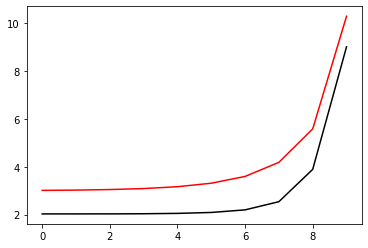

8900 99.00195804749431 8.852970001480566
[2.03091972 2.03122155 2.03291504 2.03834599 2.05310812 2.09202053
 2.20007468 2.54254142 3.89474465 9.01919946]


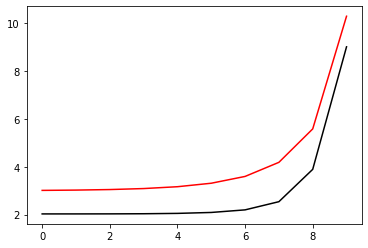

9000 99.00195767653463 8.852732561457366
[2.03093496 2.03123734 2.03293206 2.03836523 2.05313122 2.09205048
 2.2001163  2.54258537 3.89448708 9.01870752]


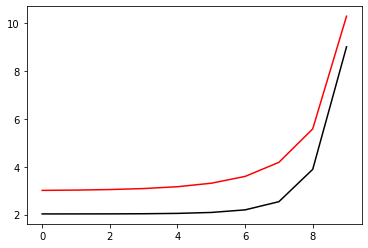

9100 99.00195730574607 8.852495246127292
[2.03095025 2.03125317 2.03294911 2.0383845  2.05315436 2.09208045
 2.20015792 2.54262921 3.89422967 9.01821561]


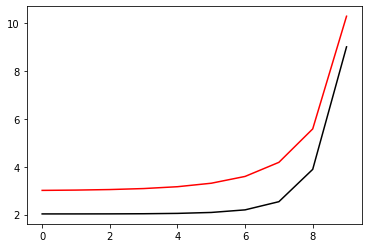

9200 99.00195693512838 8.852258055335646
[2.03096557 2.03126903 2.03296619 2.0384038  2.05317753 2.09211046
 2.20019954 2.54267296 3.89397244 9.01772372]


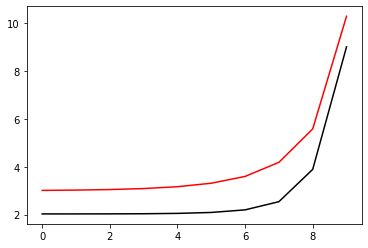

9300 99.00195656468121 8.852020988928025
[2.03098092 2.03128492 2.0329833  2.03842314 2.05320074 2.09214049
 2.20024116 2.5427166  3.89371538 9.01723185]


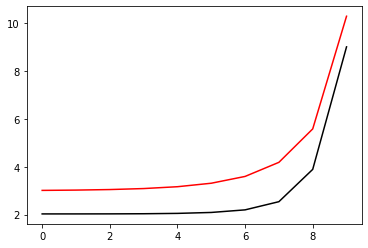

9400 99.00195619440433 8.851784046750314
[2.0309963  2.03130084 2.03300045 2.03844252 2.05322398 2.09217055
 2.20028279 2.54276014 3.8934585  9.01674   ]


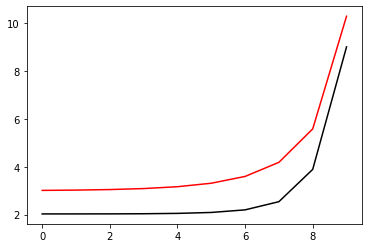

9500 99.00195582429743 8.851547228648702
[2.03101172 2.0313168  2.03301763 2.03846192 2.05324725 2.09220065
 2.20032442 2.54280357 3.89320178 9.01624818]


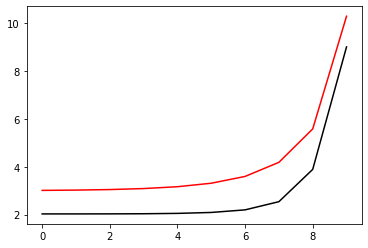

9600 99.00195545436023 8.851310534469672
[2.03102718 2.03133279 2.03303485 2.03848136 2.05327056 2.09223077
 2.20036605 2.54284691 3.89294524 9.01575637]


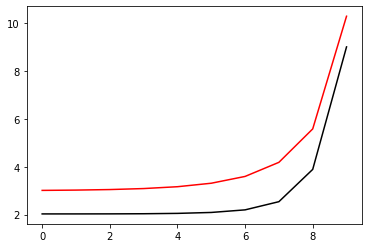

9700 99.00195508459244 8.851073964060005
[2.03104266 2.03134882 2.0330521  2.03850083 2.0532939  2.09226092
 2.20040768 2.54289014 3.89268887 9.0152646 ]


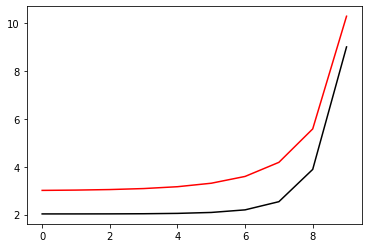

9800 99.0019547149938 8.85083751726677
[2.03105818 2.03136488 2.03306938 2.03852034 2.05331727 2.0922911
 2.20044932 2.54293328 3.89243267 9.01477284]


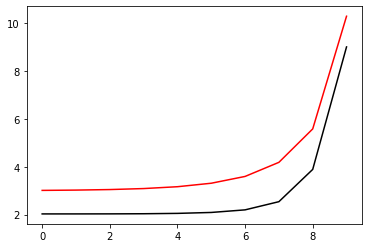

9900 99.00195434556397 8.850601193937349
[2.03107374 2.03138097 2.0330867  2.03853988 2.05334067 2.09232131
 2.20049095 2.54297631 3.89217664 9.01428111]


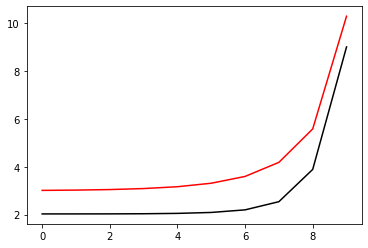

10000 99.00195397630273 8.8503649939194
[2.03108933 2.0313971  2.03310405 2.03855945 2.05336411 2.09235154
 2.20053259 2.54301924 3.89192078 9.0137894 ]


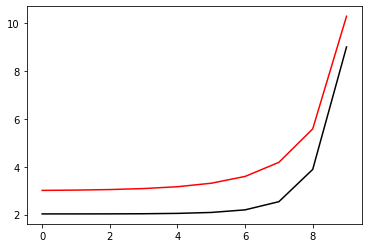

In [73]:
optimizer=tf.optimizers.SGD(learning_rate=0.01)
for i in range (1, 10001):
    run()
    if i%100==0: print(i, Error_func(h, m2_2).numpy(), m2_2.numpy()), print(h.numpy()), plt.plot(h_real, 'r-'), plt.plot(h.numpy(), 'k-'), plt.show()

100 99.00195360720976 8.85012891706087
[2.03110495 2.03141326 2.03312143 2.03857905 2.05338758 2.09238181
 2.20057423 2.54306208 3.89166509 9.01329771]


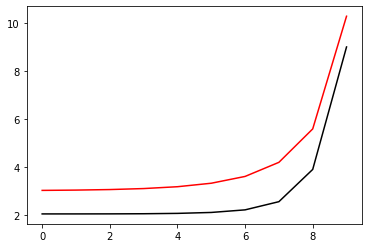

200 99.00195323828478 8.849892963210005
[2.0311206  2.03142945 2.03313884 2.03859869 2.05341108 2.0924121
 2.20061587 2.54310481 3.89140957 9.01280604]


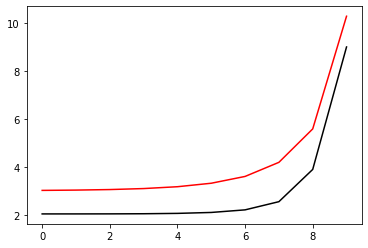

300 99.00195286952756 8.849657132215345
[2.03113629 2.03144568 2.03315629 2.03861836 2.05343462 2.09244243
 2.20065751 2.54314744 3.89115422 9.0123144 ]


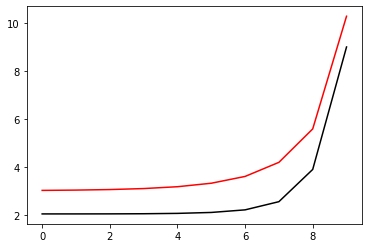

400 99.00195250093772 8.8494214239257
[2.03115202 2.03146194 2.03317377 2.03863807 2.05345819 2.09247278
 2.20069916 2.54318998 3.89089904 9.01182278]


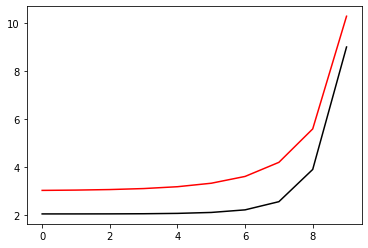

500 99.00195213251507 8.849185838190191
[2.03116777 2.03147823 2.03319129 2.0386578  2.05348179 2.09250316
 2.2007408  2.54323241 3.89064403 9.01133118]


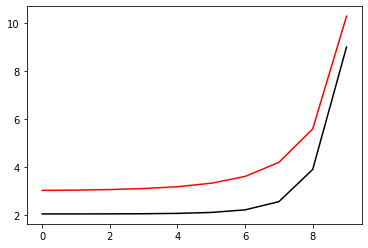

600 99.0019517642593 8.848950374858234
[2.03118356 2.03149456 2.03320884 2.03867758 2.05350542 2.09253357
 2.20078245 2.54327475 3.8903892  9.01083961]


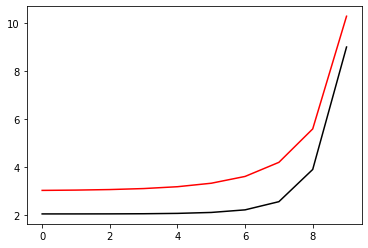

700 99.00195139617014 8.848715033779502
[2.03119939 2.03151092 2.03322642 2.03869738 2.05352909 2.092564
 2.2008241  2.54331698 3.89013453 9.01034805]


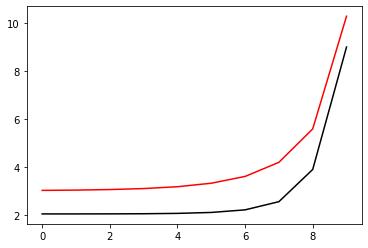

800 99.00195102824732 8.848479814803978
[2.03121525 2.03152731 2.03324403 2.03871721 2.05355279 2.09259447
 2.20086575 2.54335912 3.88988003 9.00985653]


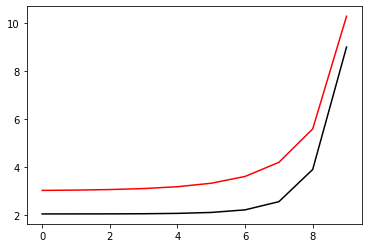

900 99.00195066049054 8.84824471778193
[2.03123114 2.03154374 2.03326168 2.03873708 2.05357652 2.09262496
 2.2009074  2.54340116 3.88962569 9.00936502]


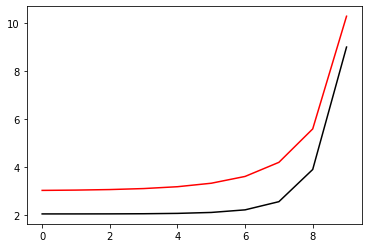

1000 99.00195029289955 8.848009742563898
[2.03124706 2.0315602  2.03327936 2.03875698 2.05360028 2.09265548
 2.20094904 2.5434431  3.88937153 9.00887354]


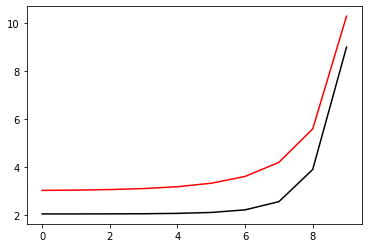

1100 99.00194992547404 8.847774889000716
[2.03126302 2.03157669 2.03329707 2.03877692 2.05362408 2.09268602
 2.2009907  2.54348494 3.88911754 9.00838207]


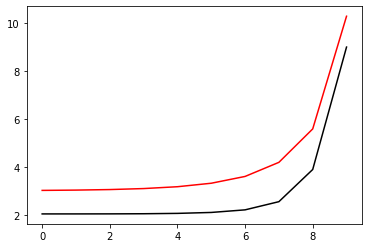

1200 99.00194955821377 8.8475401569435
[2.03127901 2.03159322 2.03331482 2.03879689 2.0536479  2.09271659
 2.20103235 2.54352669 3.88886371 9.00789064]


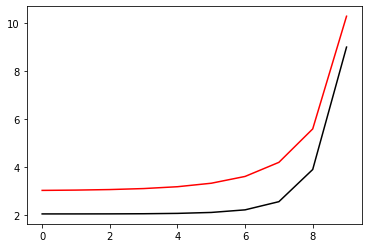

1300 99.00194919111846 8.847305546243652
[2.03129504 2.03160978 2.0333326  2.03881689 2.05367176 2.0927472
 2.201074   2.54356834 3.88861005 9.00739922]


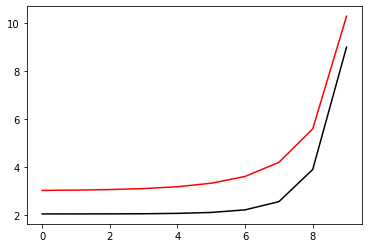

1400 99.00194882418783 8.847071056752828
[2.0313111  2.03162637 2.03335041 2.03883692 2.05369565 2.09277782
 2.20111565 2.54360989 3.88835656 9.00690783]


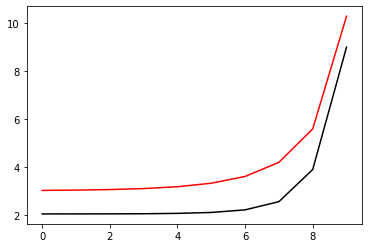

1500 99.00194845742163 8.846836688323048
[2.03132719 2.031643   2.03336825 2.03885698 2.05371958 2.09280848
 2.2011573  2.54365134 3.88810324 9.00641646]


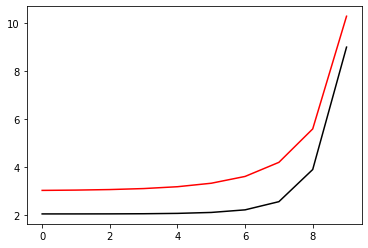

1600 99.00194809081957 8.846602440806517
[2.03134332 2.03165966 2.03338613 2.03887708 2.05374353 2.09283916
 2.20119895 2.5436927  3.88785009 9.00592511]


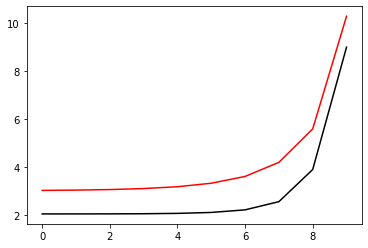

1700 99.00194772438138 8.846368314055772
[2.03135948 2.03167635 2.03340404 2.03889721 2.05376752 2.09286987
 2.2012406  2.54373396 3.8875971  9.00543379]


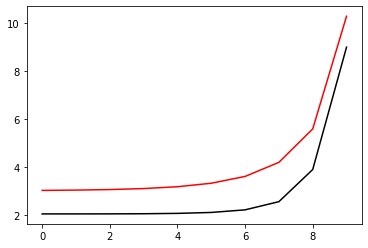

1800 99.00194735810679 8.846134307923597
[2.03137567 2.03169308 2.03342199 2.03891737 2.05379153 2.09290061
 2.20128225 2.54377513 3.88734428 9.00494249]


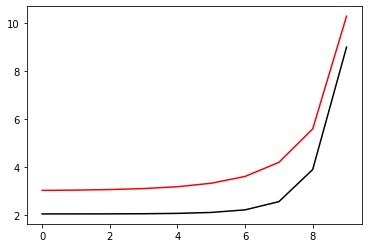

1900 99.00194699199555 8.845900422263092
[2.0313919  2.03170984 2.03343996 2.03893757 2.05381558 2.09293137
 2.20132391 2.54381619 3.88709162 9.00445121]


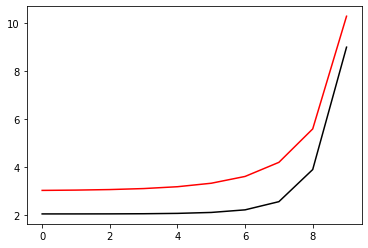

2000 99.00194662604738 8.845666656927614
[2.03140816 2.03172663 2.03345797 2.03895779 2.05383966 2.09296216
 2.20136556 2.54385717 3.88683914 9.00395995]


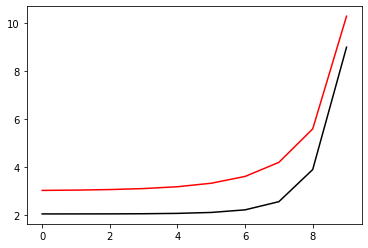

2100 99.00194626026202 8.845433011770803
[2.03142445 2.03174346 2.03347601 2.03897805 2.05386378 2.09299297
 2.20140721 2.54389804 3.88658682 9.00346872]


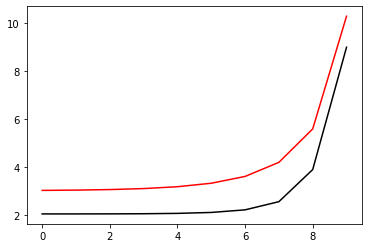

2200 99.00194589463918 8.84519948664656
[2.03144078 2.03176032 2.03349409 2.03899834 2.05388792 2.09302381
 2.20144886 2.54393882 3.88633466 9.00297751]


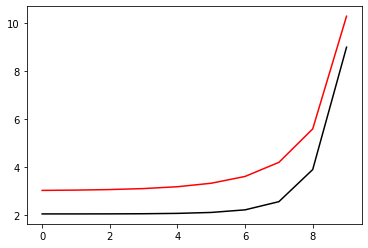

2300 99.00194552917863 8.844966081409073
[2.03145714 2.03177721 2.03351219 2.03901867 2.0539121  2.09305468
 2.20149051 2.54397951 3.88608268 9.00248633]


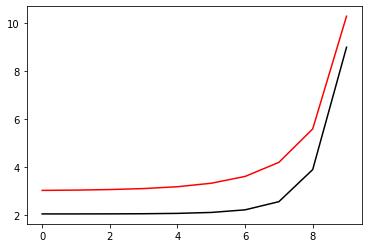

2400 99.00194516388007 8.844732795912801
[2.03147353 2.03179414 2.03353033 2.03903902 2.0539363  2.09308557
 2.20153215 2.5440201  3.88583085 9.00199516]


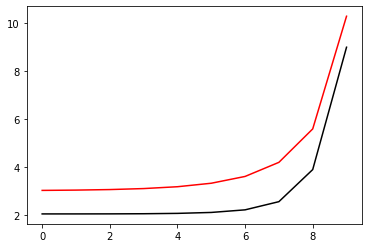

2500 99.00194479874325 8.84449963001249
[2.03148996 2.03181109 2.03354851 2.03905941 2.05396054 2.09311649
 2.2015738  2.5440606  3.8855792  9.00150402]


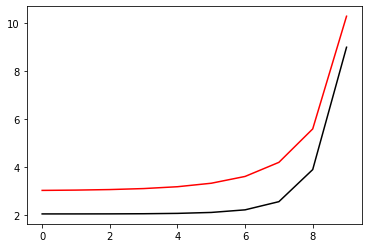

2600 99.00194443376793 8.84426658356316
[2.03150642 2.03182809 2.03356671 2.03907983 2.05398481 2.09314744
 2.20161545 2.544101   3.88532771 9.00101291]


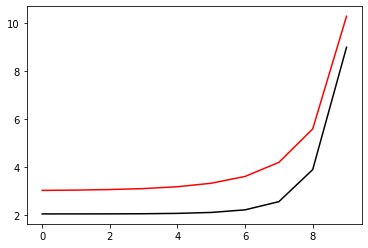

2700 99.0019440689538 8.844033656420097
[2.03152291 2.03184511 2.03358495 2.03910028 2.05400911 2.09317841
 2.20165709 2.5441413  3.88507638 9.00052181]


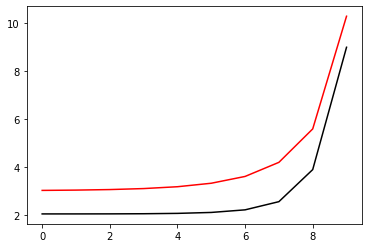

2800 99.00194370430066 8.843800848438837
[2.03153944 2.03186217 2.03360322 2.03912077 2.05403344 2.09320941
 2.20169874 2.54418152 3.88482522 9.00003074]


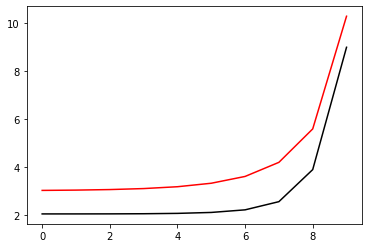

2900 99.0019433398082 8.843568159475215
[2.031556   2.03187926 2.03362152 2.03914128 2.0540578  2.09324043
 2.20174038 2.54422164 3.88457423 8.99953969]


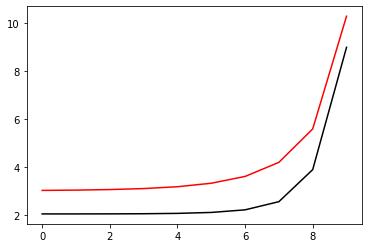

3000 99.00194297547617 8.843335589385331
[2.03157259 2.03189638 2.03363986 2.03916183 2.05408219 2.09327148
 2.20178202 2.54426166 3.8843234  8.99904867]


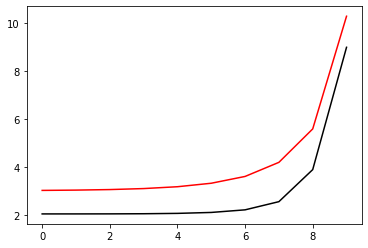

3100 99.00194261130432 8.843103138025555
[2.03158922 2.03191354 2.03365822 2.03918241 2.05410662 2.09330255
 2.20182367 2.54430159 3.88407273 8.99855766]


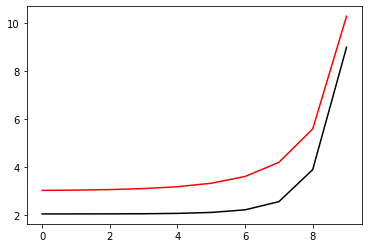

3200 99.00194224729238 8.842870805252517
[2.03160588 2.03193073 2.03367662 2.03920302 2.05413107 2.09333365
 2.2018653  2.54434143 3.88382223 8.99806668]


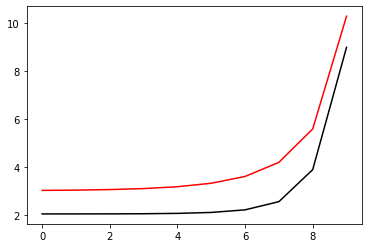

3300 99.00194188344011 8.842638590923118
[2.03162257 2.03194795 2.03369506 2.03922367 2.05415555 2.09336477
 2.20190694 2.54438117 3.88357189 8.99757573]


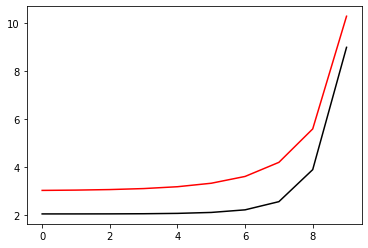

3400 99.00194151974722 8.842406494894547
[2.0316393  2.0319652  2.03371352 2.03924434 2.05418007 2.09339592
 2.20194858 2.54442083 3.88332172 8.9970848 ]


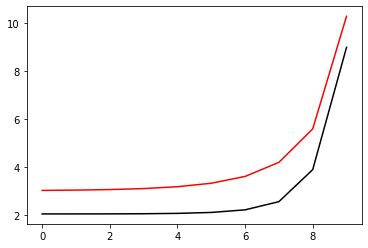

3500 99.00194115621349 8.842174517024235
[2.03165606 2.03198249 2.03373202 2.03926505 2.05420461 2.09342709
 2.20199021 2.54446038 3.88307171 8.99659389]


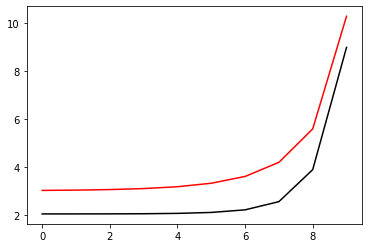

3600 99.00194079283865 8.841942657169886
[2.03167285 2.03199981 2.03375055 2.03928579 2.05422919 2.09345829
 2.20203185 2.54449985 3.88282187 8.996103  ]


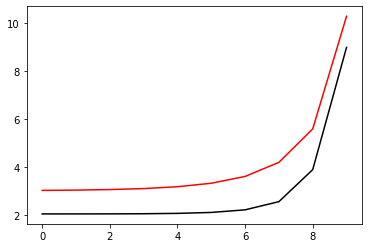

3700 99.00194042962242 8.841710915189479
[2.03168968 2.03201716 2.03376911 2.03930656 2.05425379 2.09348952
 2.20207348 2.54453923 3.88257218 8.99561214]


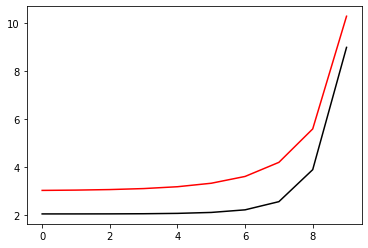

3800 99.00194006656459 8.841479290941257
[2.03170654 2.03203455 2.0337877  2.03932736 2.05427843 2.09352076
 2.20211511 2.54457851 3.88232266 8.9951213 ]


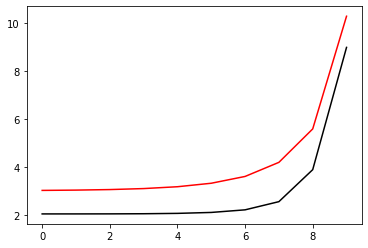

3900 99.00193970366489 8.841247784283704
[2.03172343 2.03205197 2.03380633 2.0393482  2.0543031  2.09355204
 2.20215673 2.5446177  3.88207331 8.99463048]


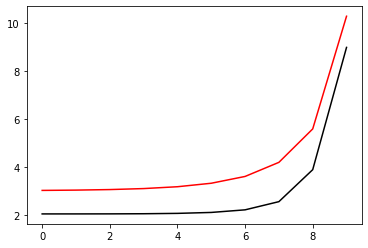

4000 99.00193934092304 8.8410163950756
[2.03174035 2.03206942 2.03382499 2.03936906 2.05432779 2.09358333
 2.20219836 2.5446568  3.88182411 8.99413968]


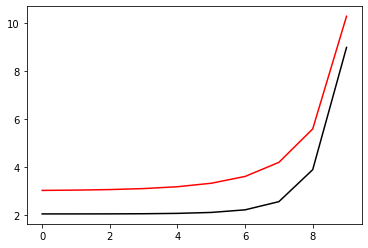

4100 99.0019389783388 8.840785123175968
[2.03175731 2.03208691 2.03384368 2.03938996 2.05435252 2.09361465
 2.20223998 2.5446958  3.88157508 8.99364891]


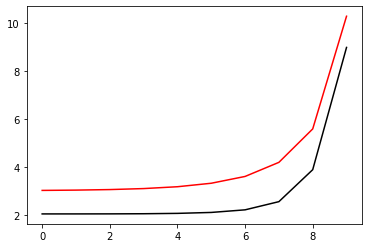

4200 99.00193861591194 8.84055396844409
[2.0317743  2.03210442 2.0338624  2.03941089 2.05437728 2.093646
 2.2022816  2.54473472 3.88132622 8.99315817]


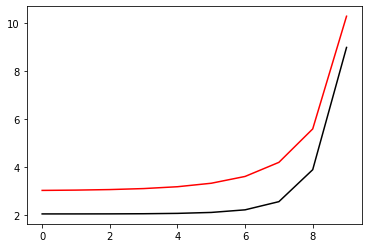

4300 99.0019382536422 8.840322930739527
[2.03179132 2.03212197 2.03388115 2.03943185 2.05440206 2.09367737
 2.20232322 2.54477354 3.88107751 8.99266744]


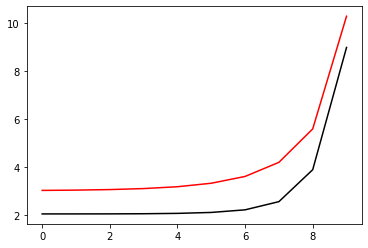

4400 99.00193789152931 8.840092009922094
[2.03180838 2.03213955 2.03389994 2.03945284 2.05442688 2.09370876
 2.20236483 2.54481228 3.88082897 8.99217674]


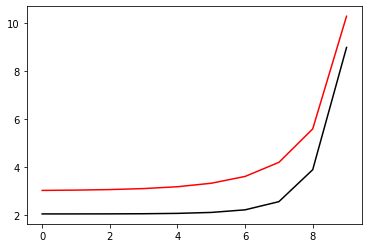

4500 99.00193752957303 8.839861205851857
[2.03182547 2.03215717 2.03391876 2.03947386 2.05445173 2.09374018
 2.20240644 2.54485092 3.88058058 8.99168606]


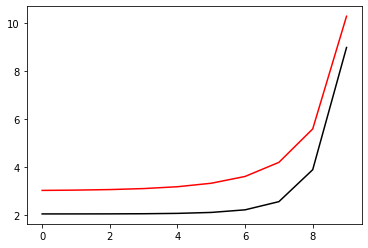

4600 99.00193716777314 8.839630518389141
[2.03184259 2.03217482 2.03393761 2.03949491 2.0544766  2.09377162
 2.20244805 2.54488947 3.88033236 8.99119541]


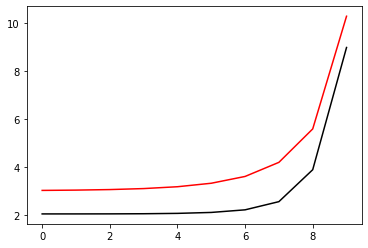

4700 99.00193680612934 8.839399947394556
[2.03185975 2.0321925  2.03395649 2.039516   2.05450151 2.09380308
 2.20248966 2.54492794 3.8800843  8.99070478]


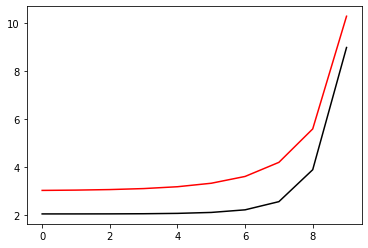

4800 99.00193644464142 8.839169492728944
[2.03187694 2.03221021 2.03397541 2.03953711 2.05452645 2.09383457
 2.20253126 2.54496631 3.87983641 8.99021417]


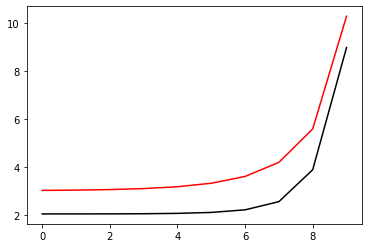

4900 99.0019360833091 8.838939154253412
[2.03189416 2.03222795 2.03399436 2.03955826 2.05455141 2.09386609
 2.20257287 2.54500459 3.87958867 8.98972358]


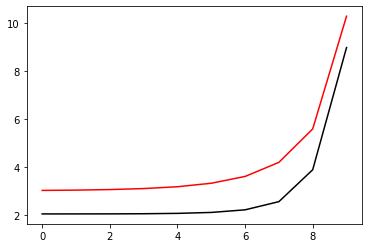

5000 99.00193572213216 8.838708931829323
[2.03191141 2.03224573 2.03401333 2.03957944 2.05457641 2.09389762
 2.20261446 2.54504278 3.87934109 8.98923302]


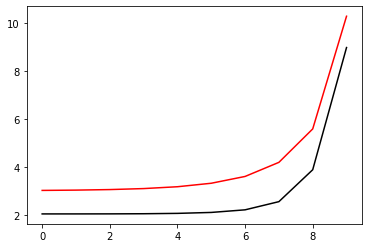

5100 99.00193536111036 8.838478825318301
[2.0319287  2.03226354 2.03403235 2.03960065 2.05460143 2.09392918
 2.20265606 2.54508089 3.87909368 8.98874248]


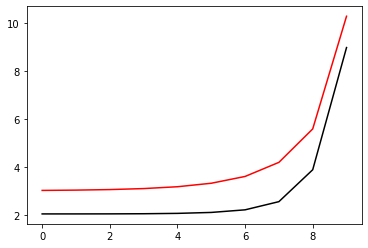

5200 99.00193500024344 8.838248834582227
[2.03194602 2.03228138 2.03405139 2.03962189 2.05462648 2.09396076
 2.20269765 2.5451189  3.87884642 8.98825197]


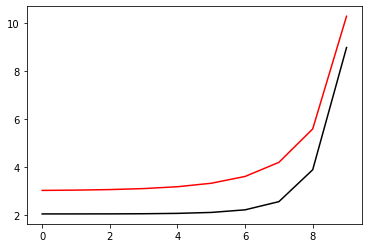

5300 99.00193463953113 8.838018959483216
[2.03196337 2.03229926 2.03407046 2.03964316 2.05465157 2.09399237
 2.20273924 2.54515683 3.87859933 8.98776148]


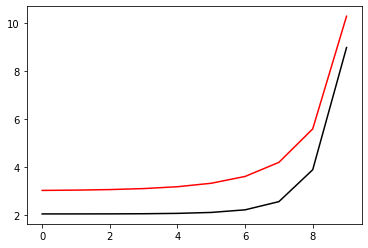

5400 99.00193427897324 8.837789199883662
[2.03198075 2.03231717 2.03408957 2.03966446 2.05467668 2.094024
 2.20278082 2.54519466 3.8783524  8.98727101]


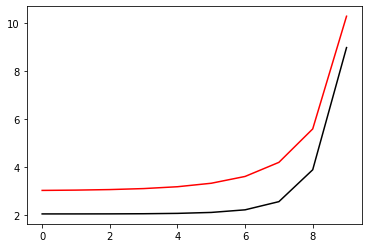

5500 99.00193391856949 8.83755955564621
[2.03199817 2.03233511 2.03410871 2.0396858  2.05470182 2.09405565
 2.20282241 2.54523241 3.87810562 8.98678057]


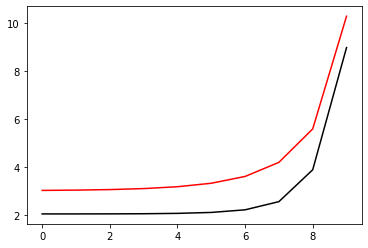

5600 99.00193355831965 8.837330026633737
[2.03201562 2.03235308 2.03412788 2.03970716 2.05472699 2.09408732
 2.20286398 2.54527007 3.87785901 8.98629014]


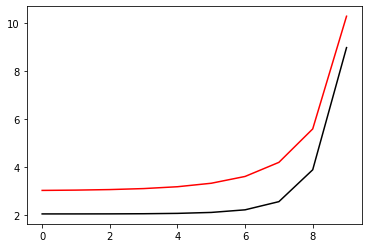

5700 99.00193319822347 8.837100612709401
[2.0320331  2.03237108 2.03414708 2.03972856 2.05475219 2.09411902
 2.20290556 2.54530764 3.87761255 8.98579975]


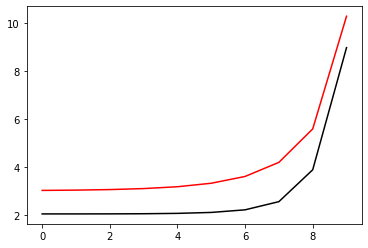

5800 99.00193283828071 8.836871313736598
[2.03205062 2.03238912 2.03416631 2.03974998 2.05477742 2.09415074
 2.20294713 2.54534512 3.87736626 8.98530937]


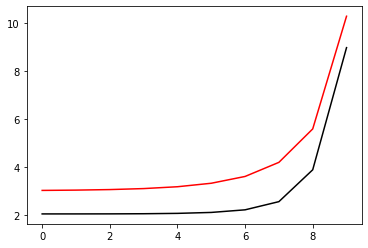

5900 99.00193247849114 8.836642129578971
[2.03206817 2.03240719 2.03418558 2.03977144 2.05480267 2.09418248
 2.2029887  2.54538252 3.87712012 8.98481902]


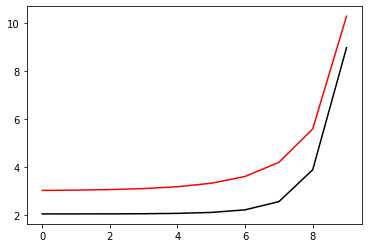

6000 99.0019321188545 8.836413060100416
[2.03208575 2.03242529 2.03420487 2.03979293 2.05482796 2.09421424
 2.20303026 2.54541982 3.87687415 8.98432869]


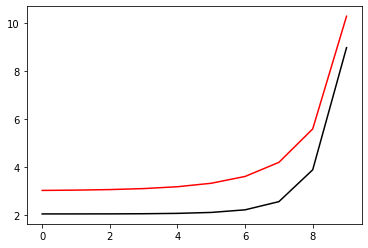

6100 99.00193175937056 8.836184105165078
[2.03210336 2.03244342 2.0342242  2.03981445 2.05485328 2.09424603
 2.20307182 2.54545704 3.87662833 8.98383839]


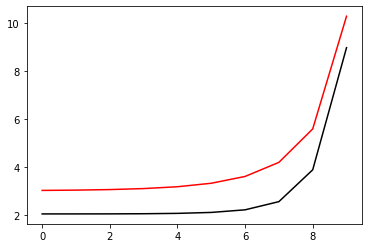

6200 99.0019314000391 8.835955264637354
[2.03212101 2.03246159 2.03424356 2.039836   2.05487862 2.09427784
 2.20311338 2.54549418 3.87638267 8.98334811]


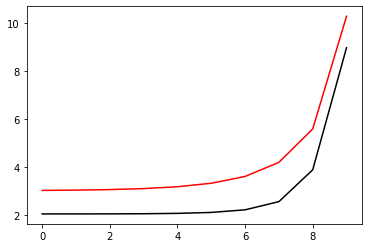

6300 99.00193104085986 8.835726538381898
[2.03213869 2.03247979 2.03426295 2.03985758 2.05490399 2.09430967
 2.20315493 2.54553122 3.87613717 8.98285785]


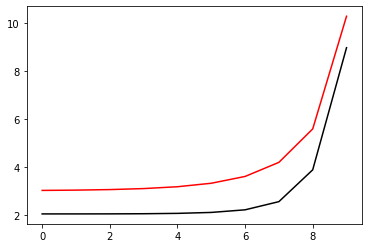

6400 99.0019306818326 8.835497926263592
[2.0321564  2.03249802 2.03428238 2.03987919 2.05492939 2.09434153
 2.20319648 2.54556818 3.87589183 8.98236762]


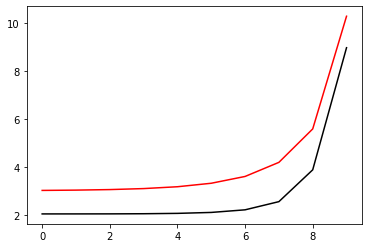

6500 99.00193032295708 8.835269428147571
[2.03217414 2.03251628 2.03430183 2.03990083 2.05495482 2.0943734
 2.20323802 2.54560505 3.87564664 8.98187741]


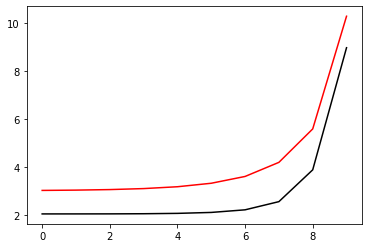

6600 99.00192996423309 8.835041043899247
[2.03219192 2.03253457 2.03432132 2.0399225  2.05498028 2.0944053
 2.20327956 2.54564184 3.87540162 8.98138722]


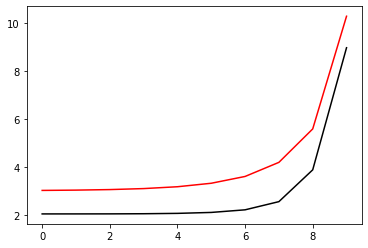

6700 99.00192960566037 8.834812773384224
[2.03220973 2.0325529  2.03434083 2.0399442  2.05500577 2.09443722
 2.20332109 2.54567854 3.87515675 8.98089706]


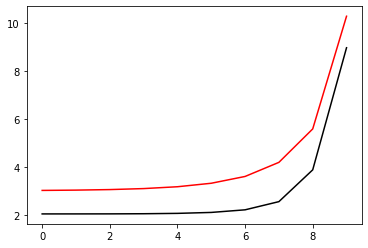

6800 99.0019292472387 8.834584616468387
[2.03222757 2.03257126 2.03436038 2.03996593 2.05503128 2.09446916
 2.20336262 2.54571515 3.87491204 8.98040692]


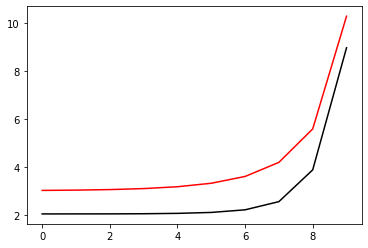

6900 99.00192888896783 8.83435657301787
[2.03224544 2.03258965 2.03437996 2.03998769 2.05505682 2.09450112
 2.20340415 2.54575168 3.87466748 8.9799168 ]


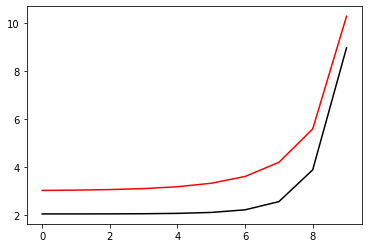

7000 99.00192853084752 8.83412864289903
[2.03226335 2.03260807 2.03439958 2.04000949 2.0550824  2.09453311
 2.20344567 2.54578812 3.87442309 8.97942671]


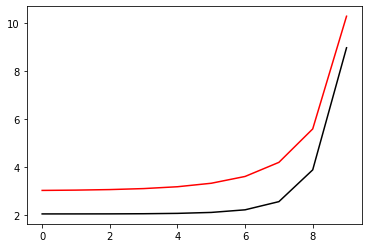

7100 99.00192817287757 8.833900825978478
[2.03228129 2.03262653 2.03441922 2.04003131 2.055108   2.09456511
 2.20348719 2.54582447 3.87417885 8.97893664]


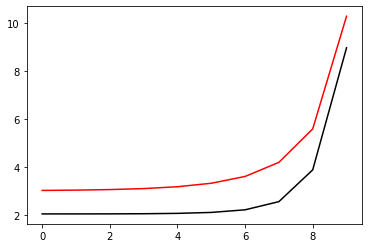

7200 99.00192781505773 8.833673122123072
[2.03229926 2.03264501 2.03443889 2.04005316 2.05513362 2.09459714
 2.2035287  2.54586074 3.87393476 8.9784466 ]


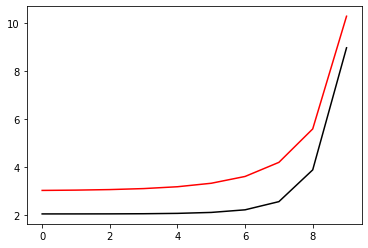

7300 99.00192745738775 8.833445531199892
[2.03231726 2.03266353 2.0344586  2.04007505 2.05515928 2.09462919
 2.20357021 2.54589693 3.87369084 8.97795658]


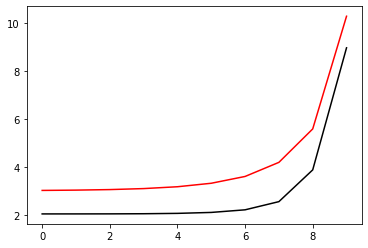

7400 99.00192709986742 8.833218053076298
[2.0323353  2.03268208 2.03447834 2.04009696 2.05518496 2.09466126
 2.20361171 2.54593303 3.87344707 8.97746658]


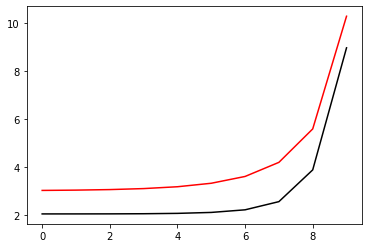

7500 99.0019267424965 8.832990687619839
[2.03235336 2.03270066 2.0344981  2.0401189  2.05521067 2.09469335
 2.20365321 2.54596904 3.87320346 8.9769766 ]


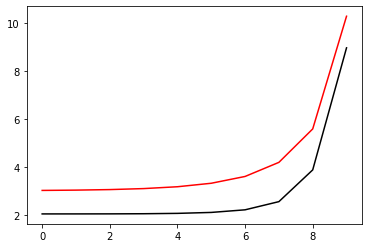

7600 99.00192638527476 8.832763434698352
[2.03237146 2.03271928 2.0345179  2.04014088 2.05523641 2.09472547
 2.2036947  2.54600498 3.87296    8.97648665]


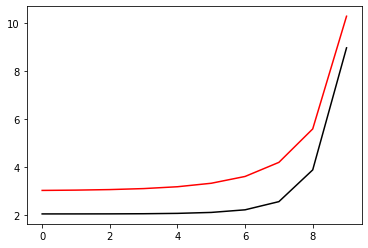

7700 99.00192602820199 8.832536294179889
[2.03238959 2.03273792 2.03453773 2.04016288 2.05526218 2.0947576
 2.20373619 2.54604082 3.8727167  8.97599673]


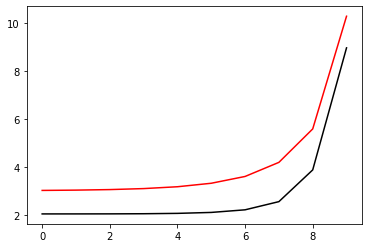

7800 99.00192567127792 8.83230926593275
[2.03240776 2.0327566  2.03455759 2.04018492 2.05528798 2.09478975
 2.20377767 2.54607658 3.87247355 8.97550682]


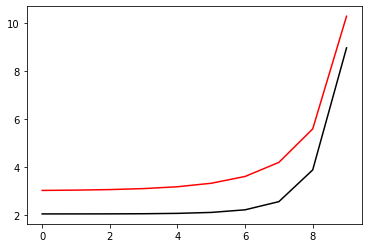

7900 99.00192531450234 8.832082349825475
[2.03242595 2.03277531 2.03457749 2.04020698 2.0553138  2.09482193
 2.20381915 2.54611226 3.87223056 8.97501694]


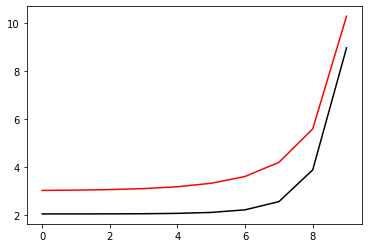

8000 99.00192495787505 8.831855545726832
[2.03244418 2.03279405 2.03459741 2.04022907 2.05533965 2.09485412
 2.20386062 2.54614786 3.87198773 8.97452709]


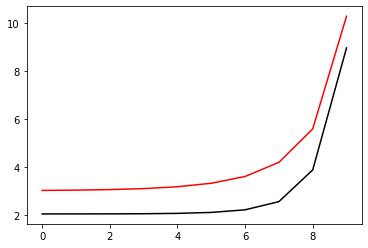

8100 99.0019246013958 8.831628853505837
[2.03246244 2.03281283 2.03461737 2.0402512  2.05536553 2.09488634
 2.20390209 2.54618337 3.87174505 8.97403726]


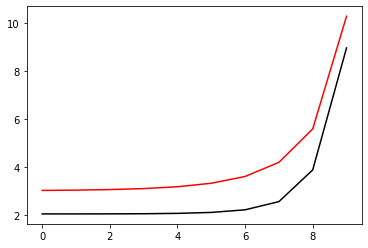

8200 99.00192424506436 8.83140227303173
[2.03248074 2.03283163 2.03463735 2.04027335 2.05539143 2.09491858
 2.20394355 2.54621879 3.87150252 8.97354745]


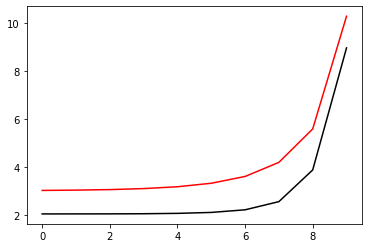

8300 99.0019238888805 8.831175804173999
[2.03249906 2.03285047 2.03465737 2.04029553 2.05541737 2.09495084
 2.203985   2.54625414 3.87126015 8.97305766]


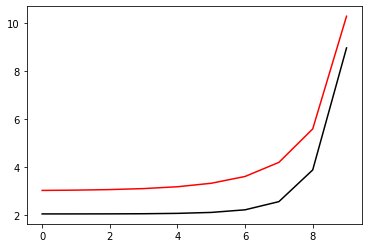

8400 99.00192353284399 8.830949446802371
[2.03251742 2.03286934 2.03467742 2.04031775 2.05544333 2.09498311
 2.20402645 2.5462894  3.87101794 8.9725679 ]


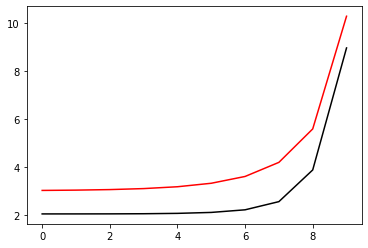

8500 99.0019231769546 8.83072320078679
[2.03253581 2.03288824 2.0346975  2.04033999 2.05546932 2.09501541
 2.2040679  2.54632458 3.87077588 8.97207817]


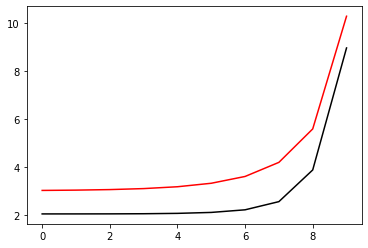

8600 99.00192282121216 8.830497065997434
[2.03255423 2.03290717 2.03471761 2.04036226 2.05549533 2.09504773
 2.20410934 2.54635967 3.87053397 8.97158845]


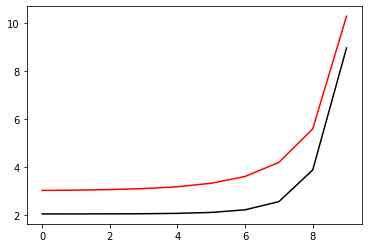

8700 99.00192246561639 8.830271042304746
[2.03257268 2.03292613 2.03473775 2.04038457 2.05552137 2.09508007
 2.20415077 2.54639469 3.87029222 8.97109876]


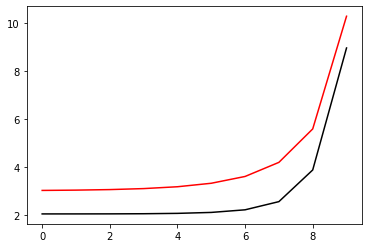

8800 99.0019221101671 8.830045129579386
[2.03259117 2.03294513 2.03475792 2.0404069  2.05554744 2.09511243
 2.2041922  2.54642962 3.87005062 8.9706091 ]


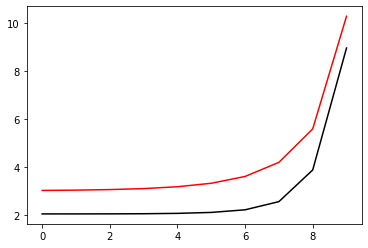

8900 99.00192175486403 8.82981932769223
[2.03260968 2.03296415 2.03477812 2.04042926 2.05557354 2.09514481
 2.20423362 2.54646446 3.86980918 8.97011946]


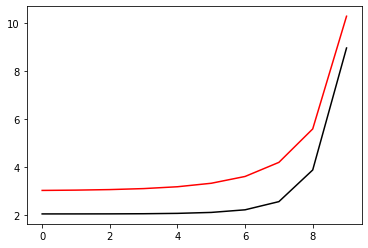

9000 99.00192139970697 8.829593636514396
[2.03262823 2.03298321 2.03479835 2.04045165 2.05559966 2.0951772
 2.20427503 2.54649923 3.86956789 8.96962984]


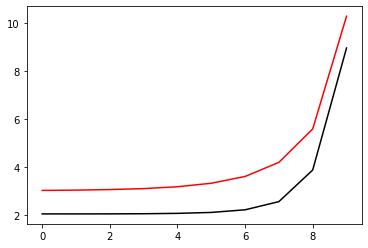

9100 99.00192104469575 8.82936805591725
[2.03264681 2.0330023  2.03481862 2.04047407 2.05562582 2.09520962
 2.20431644 2.54653391 3.86932675 8.96914024]


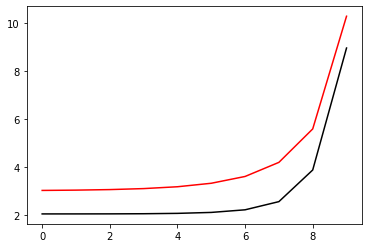

9200 99.00192068983009 8.829142585772363
[2.03266542 2.03302142 2.03483891 2.04049652 2.05565199 2.09524206
 2.20435785 2.54656852 3.86908577 8.96865067]


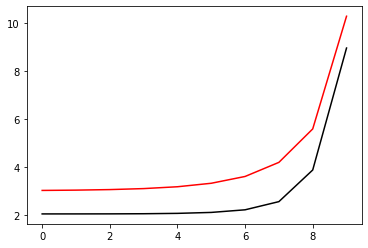

9300 99.00192033510977 8.828917225951558
[2.03268407 2.03304058 2.03485924 2.040519   2.0556782  2.09527452
 2.20439924 2.54660304 3.86884494 8.96816113]


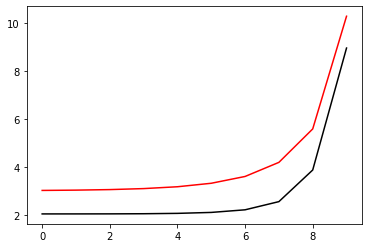

9400 99.0019199805346 8.828691976326875
[2.03270274 2.03305976 2.03487959 2.04054151 2.05570443 2.095307
 2.20444063 2.54663748 3.86860426 8.96767161]


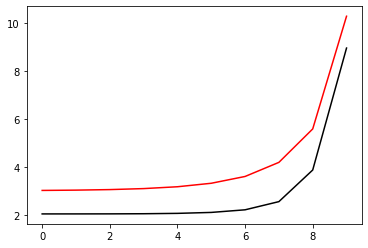

9500 99.00191962610432 8.828466836770591
[2.03272145 2.03307898 2.03489998 2.04056405 2.05573069 2.09533949
 2.20448202 2.54667184 3.86836373 8.96718211]


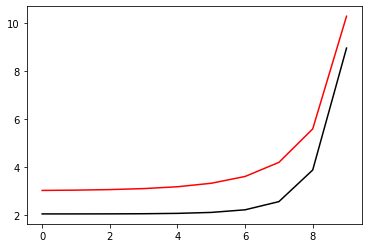

9600 99.00191927181876 8.828241807155191
[2.03274019 2.03309822 2.0349204  2.04058662 2.05575697 2.09537201
 2.2045234  2.54670611 3.86812336 8.96669263]


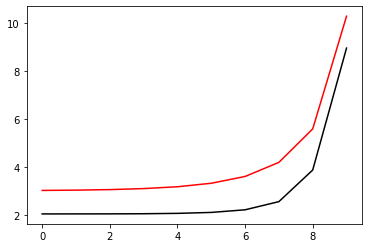

9700 99.00191891767768 8.82801688735343
[2.03275896 2.0331175  2.03494084 2.04060921 2.05578328 2.09540454
 2.20456477 2.54674031 3.86788314 8.96620318]


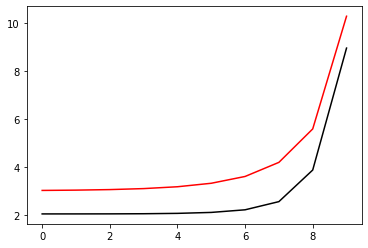

9800 99.00191856368087 8.827792077238245
[2.03277777 2.03313681 2.03496132 2.04063184 2.05580962 2.0954371
 2.20460614 2.54677443 3.86764307 8.96571375]


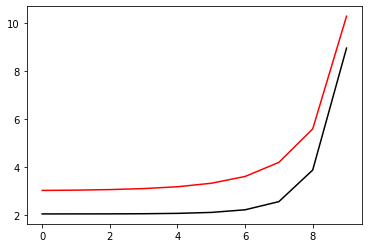

9900 99.0019182098281 8.82756737668283
[2.0327966  2.03315615 2.03498183 2.04065449 2.05583599 2.09546967
 2.20464749 2.54680846 3.86740316 8.96522435]


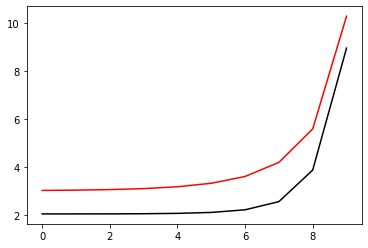

10000 99.00191785611915 8.827342785560598
[2.03281547 2.03317552 2.03500237 2.04067718 2.05586238 2.09550227
 2.20468885 2.54684242 3.86716339 8.96473497]


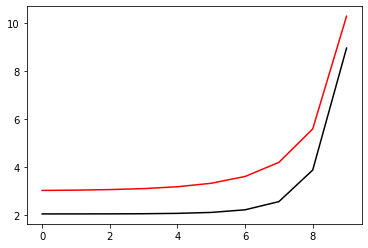

In [74]:
optimizer=tf.optimizers.SGD(learning_rate=0.01)
for i in range (1, 10001):
    run()
    if i%100==0: print(i, Error_func(h, m2_2).numpy(), m2_2.numpy()), print(h.numpy()), plt.plot(h_real, 'r-'), plt.plot(h.numpy(), 'k-'), plt.show()

100 99.00191750255382 8.82711830374518
[2.03283436 2.03319493 2.03502294 2.04069989 2.0558888  2.09553488
 2.20473019 2.5468763  3.86692378 8.96424562]


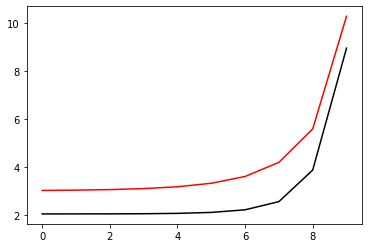

200 99.00191714913188 8.826893931110432
[2.03285329 2.03321436 2.03504354 2.04072263 2.05591524 2.09556751
 2.20477153 2.54691009 3.86668432 8.96375629]


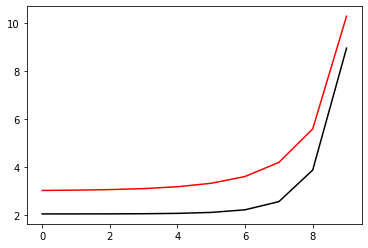

300 99.00191679585315 8.826669667530453
[2.03287226 2.03323383 2.03506417 2.04074541 2.05594171 2.09560016
 2.20481287 2.54694381 3.86644501 8.96326698]


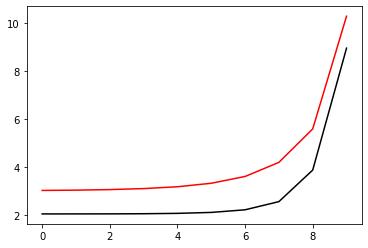

400 99.00191644271736 8.826445512879548
[2.03289125 2.03325332 2.03508483 2.04076821 2.05596821 2.09563283
 2.20485419 2.54697744 3.86620585 8.9627777 ]


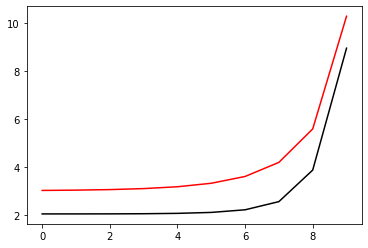

500 99.00191608972433 8.826221467032243
[2.03291027 2.03327285 2.03510552 2.04079104 2.05599473 2.09566551
 2.20489551 2.547011   3.86596685 8.96228844]


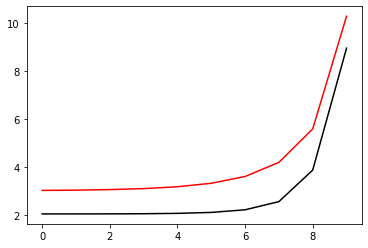

600 99.00191573687385 8.825997529863292
[2.03292933 2.03329241 2.03512624 2.0408139  2.05602128 2.09569822
 2.20493682 2.54704448 3.86572799 8.9617992 ]


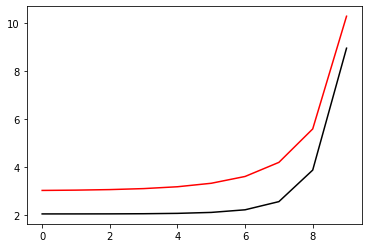

700 99.00191538416568 8.825773701247696
[2.03294842 2.033312   2.035147   2.04083678 2.05604786 2.09573094
 2.20497813 2.54707788 3.86548928 8.96130999]


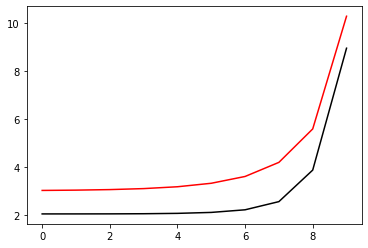

800 99.00191503159965 8.82554998106064
[2.03296754 2.03333162 2.03516778 2.0408597  2.05607446 2.09576369
 2.20501943 2.5471112  3.86525073 8.9608208 ]


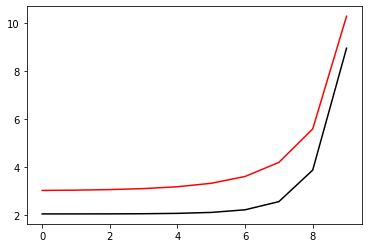

900 99.00191467917553 8.825326369177537
[2.03298669 2.03335127 2.03518859 2.04088264 2.05610109 2.09579645
 2.20506072 2.54714444 3.86501232 8.96033164]


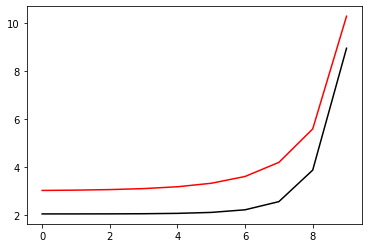

1000 99.00191432689307 8.825102865474049
[2.03300587 2.03337096 2.03520943 2.04090562 2.05612774 2.09582923
 2.205102   2.54717761 3.86477407 8.9598425 ]


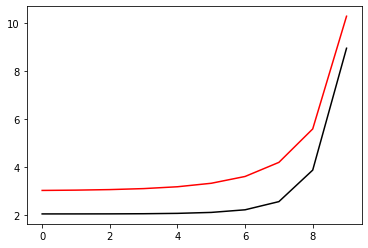

1100 99.00191397475213 8.824879469826037
[2.03302508 2.03339067 2.0352303  2.04092862 2.05615442 2.09586203
 2.20514328 2.54721069 3.86453596 8.95935339]


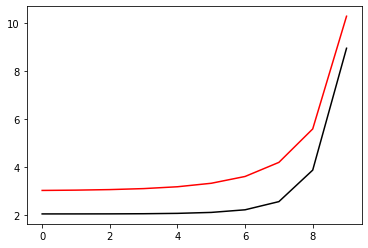

1200 99.00191362275244 8.824656182109589
[2.03304433 2.03341042 2.03525121 2.04095165 2.05618112 2.09589484
 2.20518455 2.5472437  3.86429801 8.9588643 ]


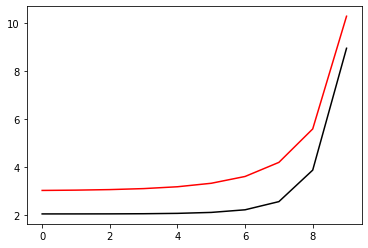

1300 99.00191327089382 8.824433002201003
[2.0330636  2.03343019 2.03527214 2.04097471 2.05620785 2.09592768
 2.20522581 2.54727663 3.8640602  8.95837523]


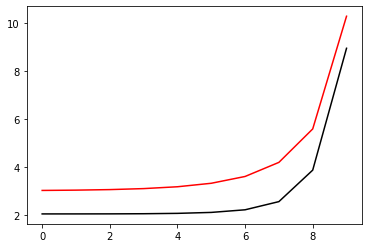

1400 99.00191291917605 8.82420992997679
[2.03308291 2.03345    2.0352931  2.0409978  2.05623461 2.09596053
 2.20526706 2.54730948 3.86382254 8.95788619]


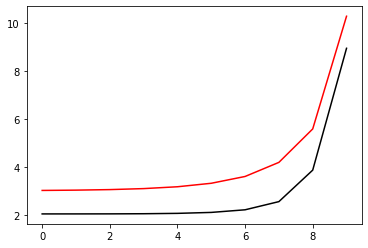

1500 99.00191256759894 8.823986965313702
[2.03310225 2.03346984 2.0353141  2.04102092 2.05626139 2.0959934
 2.20530831 2.54734225 3.86358504 8.95739717]


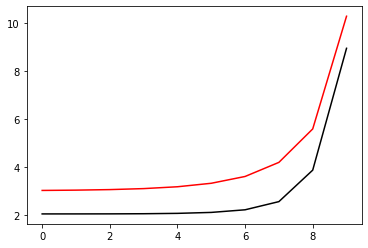

1600 99.00191221616227 8.823764108088694
[2.03312162 2.03348971 2.03533512 2.04104406 2.0562882  2.09602629
 2.20534955 2.54737495 3.86334768 8.95690818]


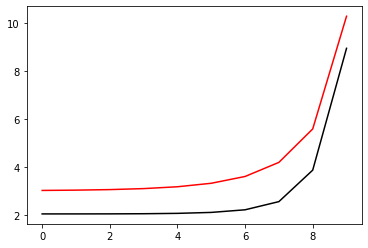

1700 99.00191186486582 8.823541358178947
[2.03314102 2.03350961 2.03535617 2.04106724 2.05631503 2.09605919
 2.20539078 2.54740757 3.86311047 8.95641921]


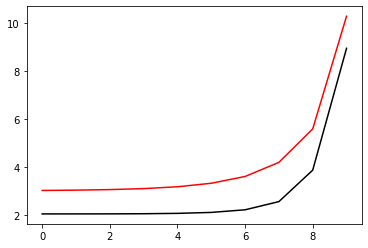

1800 99.00191151370942 8.82331871546184
[2.03316045 2.03352954 2.03537726 2.04109044 2.05634189 2.09609212
 2.20543201 2.54744011 3.86287341 8.95593026]


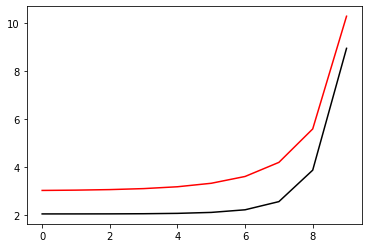

1900 99.00191116269282 8.823096179814991
[2.03317991 2.0335495  2.03539837 2.04111367 2.05636878 2.09612506
 2.20547322 2.54747257 3.8626365  8.95544134]


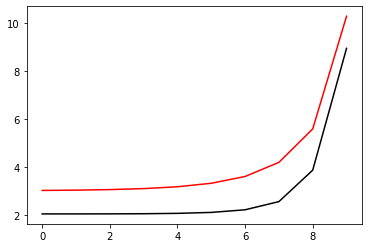

2000 99.0019108118158 8.822873751116207
[2.03319941 2.03356949 2.03541951 2.04113693 2.05639569 2.09615802
 2.20551443 2.54750496 3.86239973 8.95495244]


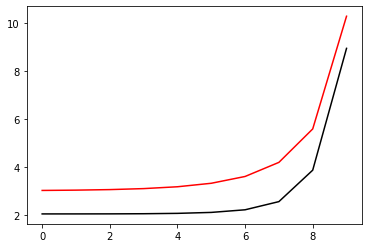

2100 99.00191046107825 8.822651429243555
[2.03321893 2.03358952 2.03544068 2.04116022 2.05642262 2.09619099
 2.20555563 2.54753727 3.86216312 8.95446357]


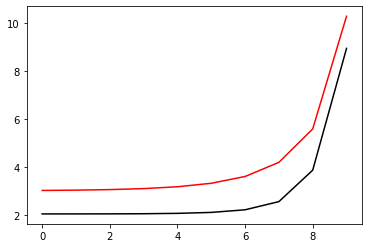

2200 99.00191011047986 8.822429214075257
[2.03323849 2.03360957 2.03546189 2.04118354 2.05644958 2.09622399
 2.20559683 2.54756951 3.86192665 8.95397472]


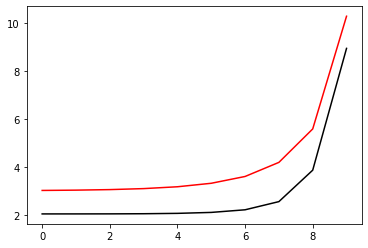

2300 99.00190976002048 8.822207105489792
[2.03325808 2.03362965 2.03548312 2.04120688 2.05647657 2.096257
 2.20563801 2.54760167 3.86169033 8.9534859 ]


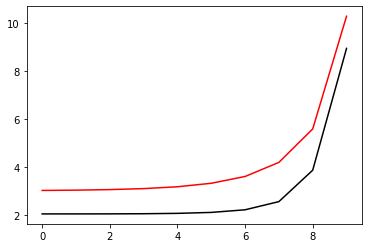

2400 99.0019094096999 8.82198510336584
[2.0332777  2.03364977 2.03550438 2.04123025 2.05650358 2.09629002
 2.20567919 2.54763375 3.86145416 8.9529971 ]


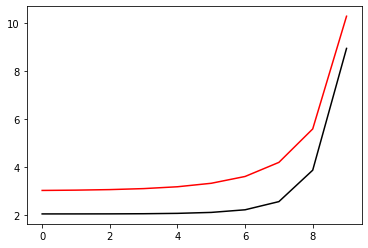

2500 99.00190905951791 8.821763207582295
[2.03329735 2.03366991 2.03552567 2.04125365 2.05653062 2.09632307
 2.20572036 2.54766576 3.86121814 8.95250832]


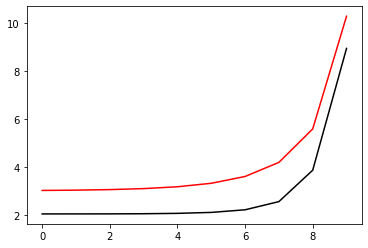

2600 99.00190870947432 8.821541418018251
[2.03331703 2.03369009 2.035547   2.04127708 2.05655768 2.09635613
 2.20576152 2.54769769 3.86098226 8.95201957]


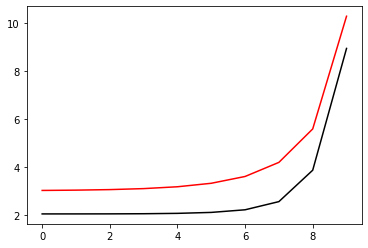

2700 99.00190835956889 8.82131973455302
[2.03333674 2.0337103  2.03556835 2.04130054 2.05658476 2.09638921
 2.20580268 2.54772954 3.86074653 8.95153084]


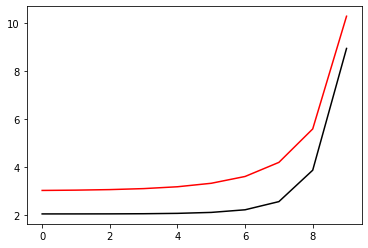

2800 99.00190800980148 8.821098157066148
[2.03335648 2.03373053 2.03558973 2.04132402 2.05661187 2.09642231
 2.20584382 2.54776132 3.86051095 8.95104214]


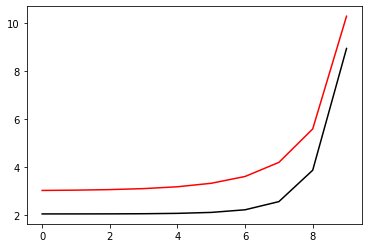

2900 99.00190766017184 8.820876685437378
[2.03337626 2.0337508  2.03561114 2.04134754 2.05663901 2.09645542
 2.20588496 2.54779303 3.86027551 8.95055346]


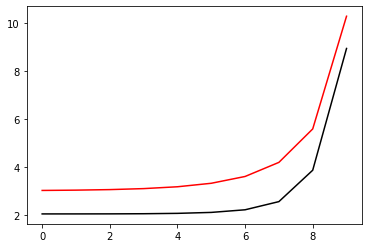

3000 99.00190731067977 8.820655319546649
[2.03339606 2.0337711  2.03563258 2.04137108 2.05666617 2.09648855
 2.20592609 2.54782466 3.86004023 8.9500648 ]


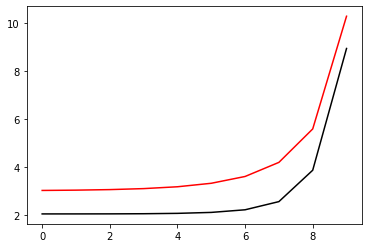

3100 99.0019069613251 8.820434059274117
[2.0334159  2.03379143 2.03565405 2.04139465 2.05669336 2.0965217
 2.20596721 2.54785621 3.85980508 8.94957617]


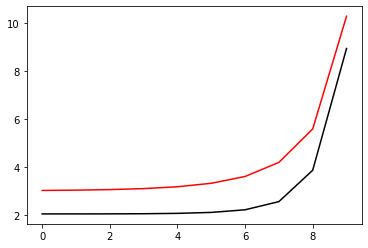

3200 99.00190661210762 8.820212904500146
[2.03343576 2.03381179 2.03567555 2.04141825 2.05672057 2.09655487
 2.20600832 2.54788769 3.85957009 8.94908757]


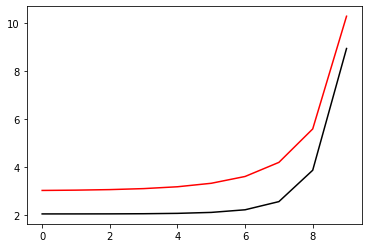

3300 99.0019062630271 8.819991855105325
[2.03345566 2.03383218 2.03569708 2.04144187 2.0567478  2.09658805
 2.20604943 2.5479191  3.85933524 8.94859899]


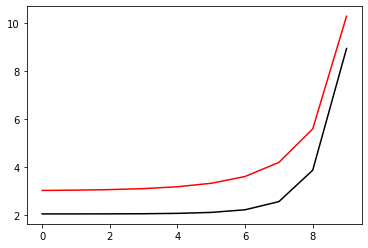

3400 99.0019059140834 8.819770910970428
[2.03347559 2.0338526  2.03571863 2.04146552 2.05677506 2.09662124
 2.20609052 2.54795043 3.85910054 8.94811043]


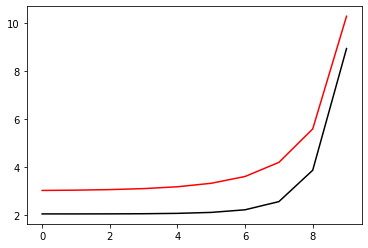

3500 99.00190556527626 8.819550071976451
[2.03349555 2.03387305 2.03574022 2.0414892  2.05680235 2.09665446
 2.20613161 2.54798169 3.85886598 8.9476219 ]


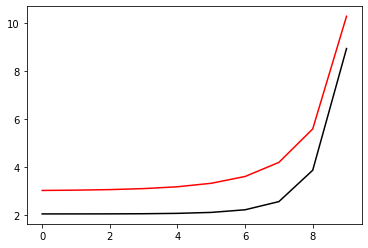

3600 99.00190521660551 8.819329338004602
[2.03351554 2.03389353 2.03576184 2.04151291 2.05682966 2.09668769
 2.20617269 2.54801287 3.85863157 8.94713339]


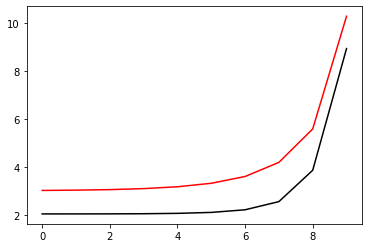

3700 99.00190486807098 8.81910870893628
[2.03353556 2.03391404 2.03578349 2.04153665 2.05685699 2.09672093
 2.20621376 2.54804398 3.8583973  8.9466449 ]


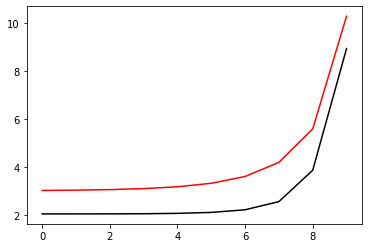

3800 99.00190451967242 8.818888184653101
[2.03355561 2.03393458 2.03580516 2.04156041 2.05688435 2.0967542
 2.20625482 2.54807501 3.85816318 8.94615644]


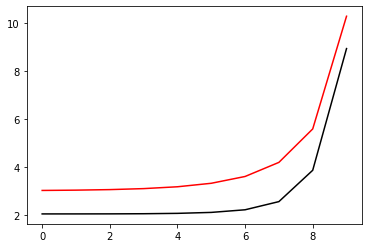

3900 99.00190417140966 8.818667765036878
[2.03357569 2.03395515 2.03582687 2.04158421 2.05691173 2.09678748
 2.20629587 2.54810597 3.85792921 8.94566801]


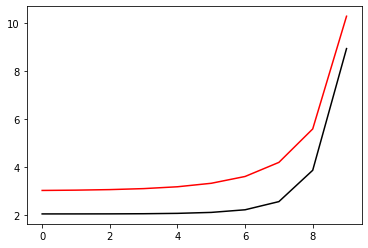

4000 99.00190382328253 8.818447449969652
[2.0335958  2.03397575 2.0358486  2.04160802 2.05693914 2.09682077
 2.20633692 2.54813686 3.85769537 8.9451796 ]


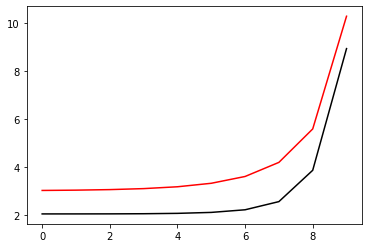

4100 99.00190347529079 8.818227239333636
[2.03361594 2.03399638 2.03587036 2.04163187 2.05696657 2.09685408
 2.20637795 2.54816767 3.85746169 8.94469121]


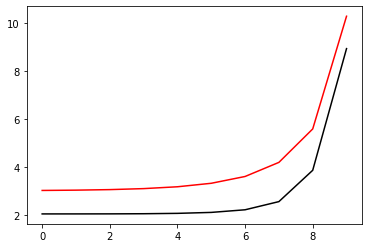

4200 99.00190312743428 8.818007133011264
[2.03363612 2.03401704 2.03589216 2.04165575 2.05699402 2.09688741
 2.20641898 2.54819842 3.85722815 8.94420285]


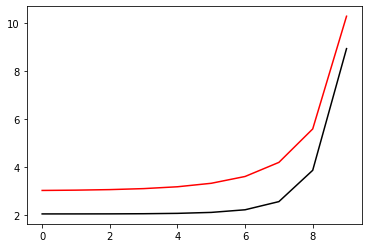

4300 99.00190277971276 8.817787130885183
[2.03365632 2.03403774 2.03591398 2.04167965 2.0570215  2.09692075
 2.20646    2.54822908 3.85699475 8.94371451]


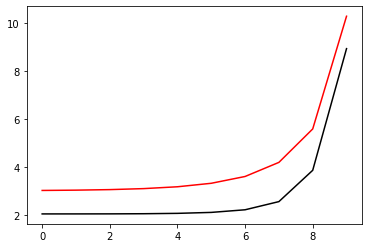

4400 99.0019024321261 8.817567232838224
[2.03367655 2.03405846 2.03593583 2.04170358 2.05704901 2.09695411
 2.20650101 2.54825968 3.8567615  8.9432262 ]


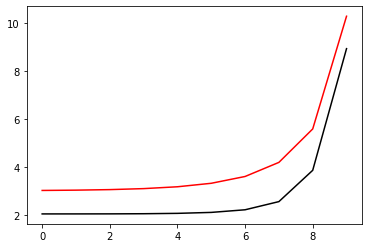

4500 99.00190208467407 8.817347438753425
[2.03369682 2.03407921 2.03595771 2.04172753 2.05707654 2.09698749
 2.20654201 2.5482902  3.85652839 8.94273791]


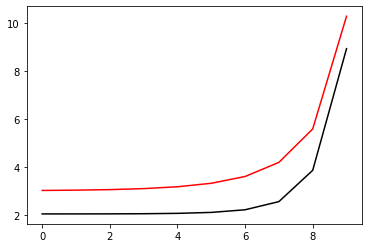

4600 99.00190173735646 8.817127748514041
[2.03371711 2.03409999 2.03597962 2.04175152 2.05710409 2.09702088
 2.206583   2.54832065 3.85629543 8.94224965]


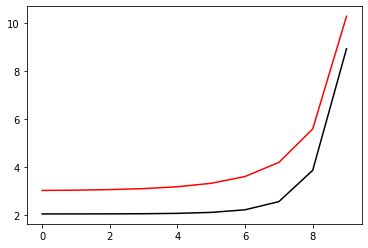

4700 99.00190139017313 8.816908162003523
[2.03373744 2.0341208  2.03600156 2.04177553 2.05713166 2.09705429
 2.20662398 2.54835103 3.85606261 8.94176141]


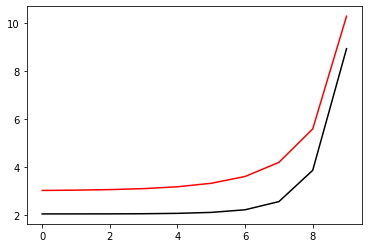

4800 99.00190104312384 8.816688679105509
[2.0337578  2.03414165 2.03602353 2.04179957 2.05715926 2.09708771
 2.20666495 2.54838134 3.85582994 8.94127319]


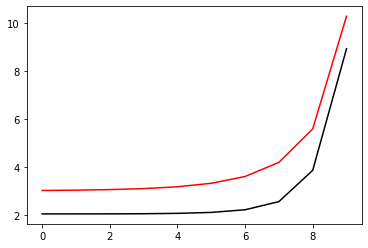

4900 99.00190069620842 8.816469299703865
[2.03377818 2.03416252 2.03604552 2.04182364 2.05718689 2.09712115
 2.20670592 2.54841157 3.85559741 8.940785  ]


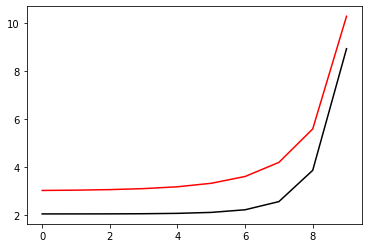

5000 99.00190034942668 8.816250023682631
[2.0337986  2.03418342 2.03606755 2.04184773 2.05721453 2.0971546
 2.20674687 2.54844173 3.85536502 8.94029684]


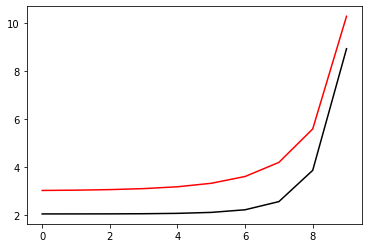

5100 99.0019000027784 8.81603085092606
[2.03381905 2.03420435 2.0360896  2.04187185 2.05724221 2.09718807
 2.20678782 2.54847182 3.85513277 8.93980869]


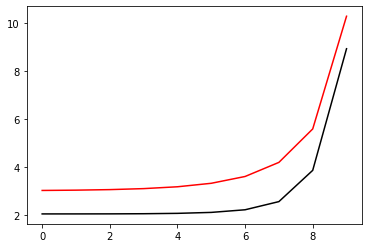

5200 99.00189965626343 8.815811781318603
[2.03383953 2.03422531 2.03611169 2.041896   2.0572699  2.09722155
 2.20682876 2.54850184 3.85490067 8.93932058]


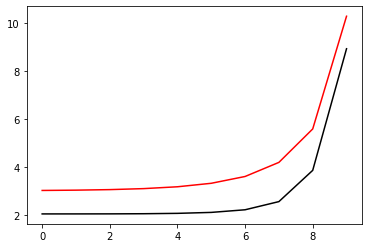

5300 99.00189930988157 8.815592814744901
[2.03386003 2.0342463  2.0361338  2.04192017 2.05729762 2.09725505
 2.20686968 2.54853179 3.85466871 8.93883249]


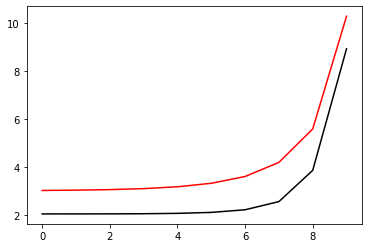

5400 99.00189896363263 8.815373951089803
[2.03388057 2.03426733 2.03615594 2.04194438 2.05732536 2.09728857
 2.2069106  2.54856166 3.8544369  8.93834442]


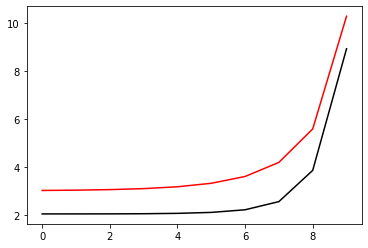

5500 99.0018986175164 8.815155190238352
[2.03390114 2.03428838 2.03617811 2.04196861 2.05735313 2.0973221
 2.20695151 2.54859147 3.85420522 8.93785637]


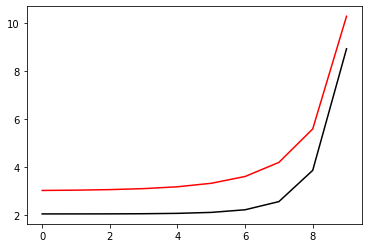

5600 99.00189827153272 8.814936532075794
[2.03392174 2.03430946 2.03620031 2.04199286 2.05738092 2.09735564
 2.20699241 2.5486212  3.85397369 8.93736836]


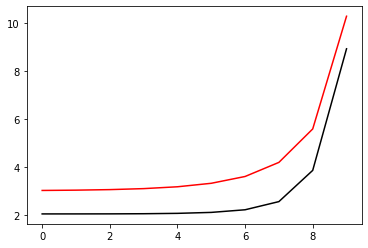

5700 99.00189792568139 8.814717976487573
[2.03394237 2.03433057 2.03622254 2.04201715 2.05740873 2.09738921
 2.2070333  2.54865086 3.8537423  8.93688036]


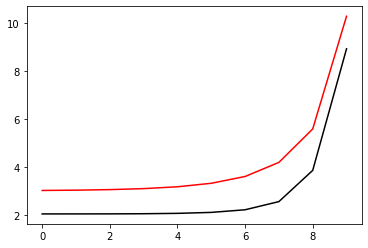

5800 99.00189757996223 8.814499523359327
[2.03396303 2.03435171 2.03624479 2.04204146 2.05743657 2.09742278
 2.20707418 2.54868045 3.85351106 8.93639239]


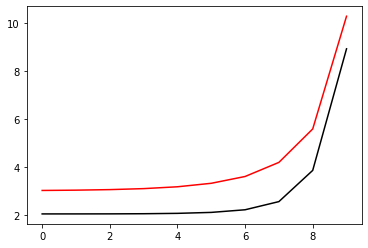

5900 99.00189723437505 8.814281172576877
[2.03398371 2.03437288 2.03626708 2.04206579 2.05746443 2.09745637
 2.20711505 2.54870998 3.85327995 8.93590445]


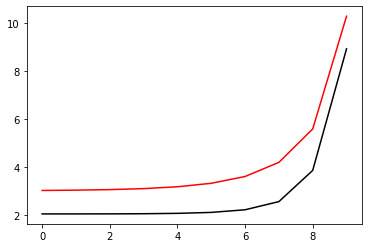

6000 99.00189688891966 8.814062924026256
[2.03400443 2.03439408 2.03628939 2.04209016 2.05749231 2.09748998
 2.20715591 2.54873943 3.85304899 8.93541653]


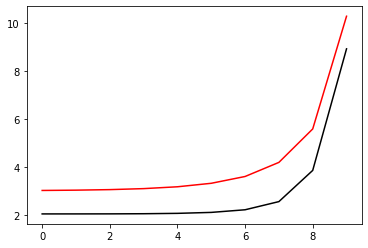

6100 99.00189654359588 8.813844777593694
[2.03402518 2.03441531 2.03631173 2.04211455 2.05752022 2.0975236
 2.20719676 2.54876881 3.85281817 8.93492863]


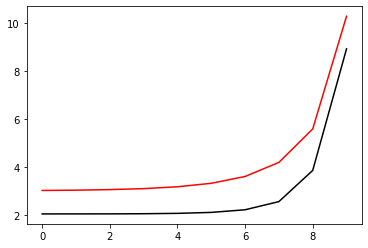

6200 99.0018961984035 8.813626733165611
[2.03404596 2.03443657 2.03633411 2.04213897 2.05754815 2.09755723
 2.2072376  2.54879812 3.85258749 8.93444076]


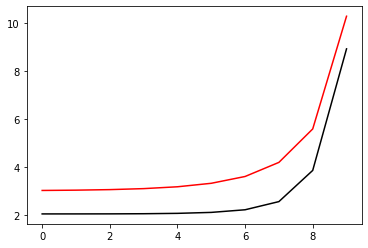

6300 99.00189585334236 8.81340879062861
[2.03406677 2.03445786 2.03635651 2.04216341 2.0575761  2.09759088
 2.20727843 2.54882736 3.85235695 8.93395292]


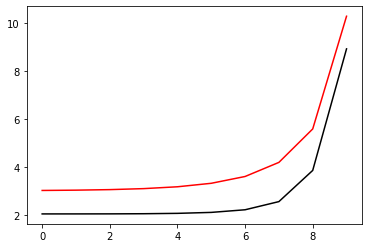

6400 99.0018955084123 8.813190949869503
[2.03408761 2.03447917 2.03637893 2.04218788 2.05760408 2.09762455
 2.20731925 2.54885653 3.85212656 8.9334651 ]


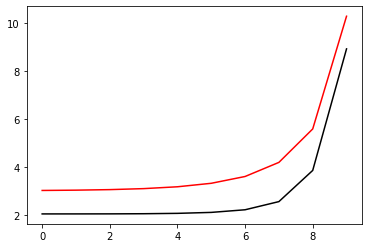

6500 99.00189516361309 8.81297321077529
[2.03410848 2.03450052 2.03640139 2.04221238 2.05763208 2.09765822
 2.20736007 2.54888563 3.8518963  8.9329773 ]


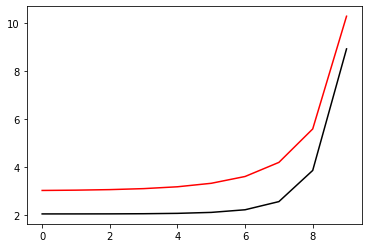

6600 99.00189481894456 8.812755573233154
[2.03412938 2.0345219  2.03642388 2.0422369  2.0576601  2.09769192
 2.20740087 2.54891467 3.85166619 8.93248953]


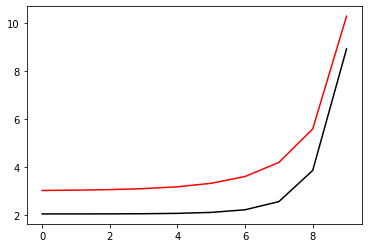

6700 99.00189447440651 8.812538037130471
[2.03415031 2.0345433  2.03644639 2.04226146 2.05768815 2.09772563
 2.20744166 2.54894363 3.85143621 8.93200178]


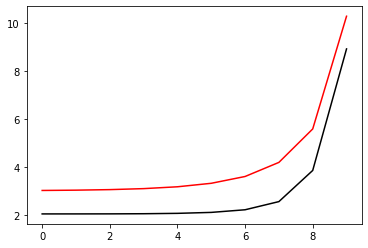

6800 99.00189412999882 8.81232060235485
[2.03417127 2.03456474 2.03646893 2.04228603 2.05771622 2.09775935
 2.20748244 2.54897252 3.85120638 8.93151406]


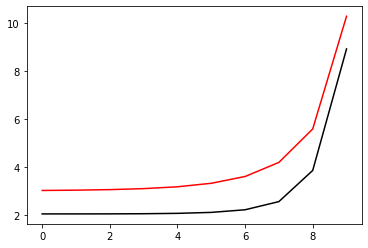

6900 99.00189378572125 8.81210326879404
[2.03419225 2.03458621 2.0364915  2.04231064 2.05774431 2.09779308
 2.20752322 2.54900135 3.85097669 8.93102636]


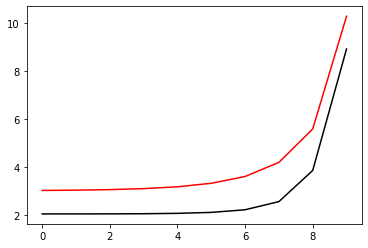

7000 99.00189344157363 8.811886036336
[2.03421327 2.0346077  2.0365141  2.04233527 2.05777242 2.09782683
 2.20756398 2.5490301  3.85074713 8.93053869]


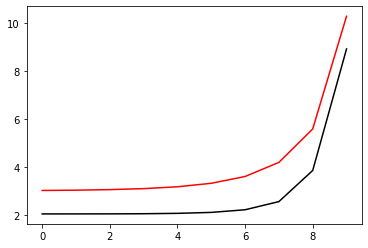

7100 99.0018930975558 8.811668904868888
[2.03423432 2.03462922 2.03653673 2.04235993 2.05780056 2.0978606
 2.20760473 2.54905879 3.85051772 8.93005104]


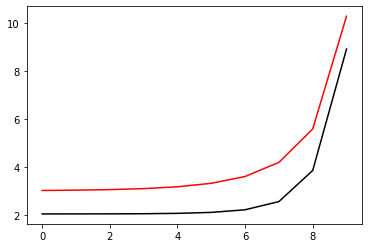

7200 99.00189275366753 8.811451874281026
[2.0342554  2.03465078 2.03655938 2.04238461 2.05782872 2.09789438
 2.20764547 2.54908741 3.85028845 8.92956342]


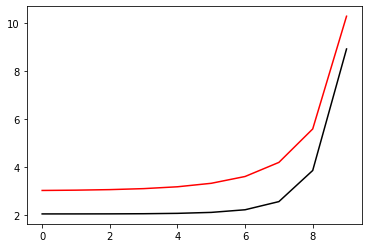

7300 99.0018924099087 8.811234944460962
[2.03427651 2.03467236 2.03658207 2.04240932 2.0578569  2.09792817
 2.20768621 2.54911596 3.85005932 8.92907582]


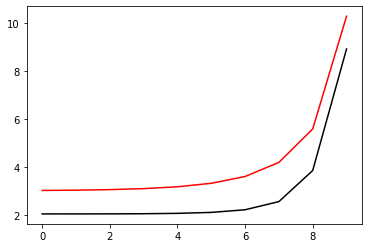

7400 99.0018920662791 8.81101811529742
[2.03429764 2.03469397 2.03660478 2.04243406 2.05788511 2.09796198
 2.20772693 2.54914444 3.84983032 8.92858825]


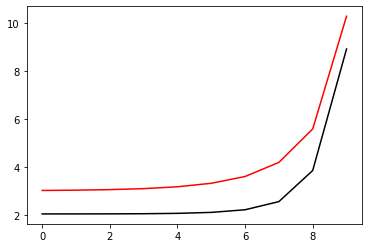

7500 99.00189172277854 8.810801386679298
[2.03431881 2.03471561 2.03662752 2.04245882 2.05791334 2.0979958
 2.20776764 2.54917286 3.84960147 8.9281007 ]


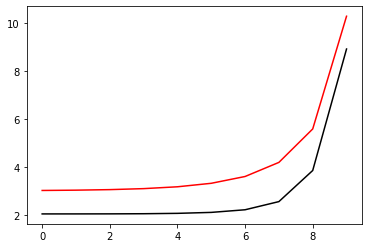

7600 99.00189137940687 8.810584758495702
[2.03434001 2.03473728 2.03665029 2.04248361 2.05794159 2.09802964
 2.20780834 2.5492012  3.84937276 8.92761318]


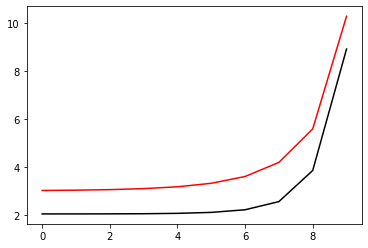

7700 99.00189103616388 8.810368230635905
[2.03436123 2.03475898 2.03667308 2.04250843 2.05796986 2.09806349
 2.20784903 2.54922948 3.84914418 8.92712568]


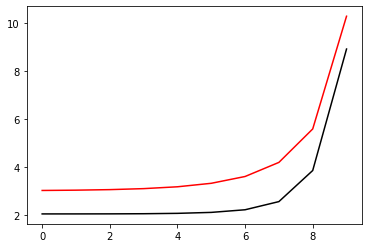

7800 99.00189069304942 8.81015180298939
[2.03438249 2.03478071 2.03669591 2.04253327 2.05799816 2.09809735
 2.20788972 2.54925769 3.84891575 8.9266382 ]


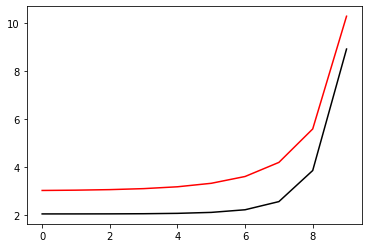

7900 99.00189035006329 8.809935475445814
[2.03440377 2.03480247 2.03671876 2.04255814 2.05802648 2.09813123
 2.20793039 2.54928583 3.84868745 8.92615076]


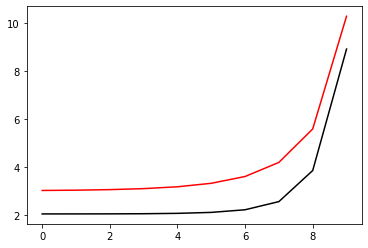

8000 99.00189000720533 8.80971924789502
[2.03442509 2.03482425 2.03674164 2.04258303 2.05805482 2.09816512
 2.20797105 2.54931391 3.84845929 8.92566333]


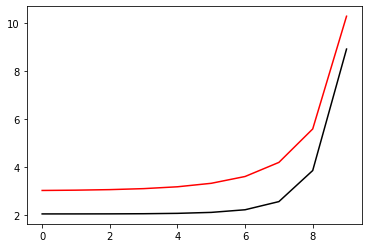

8100 99.00188966447534 8.809503120227035
[2.03444643 2.03484607 2.03676455 2.04260795 2.05808318 2.09819902
 2.2080117  2.54934192 3.84823127 8.92517593]


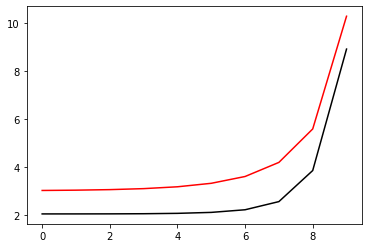

8200 99.00188932187318 8.80928709233208
[2.03446781 2.03486791 2.03678749 2.0426329  2.05811156 2.09823294
 2.20805234 2.54936986 3.84800339 8.92468856]


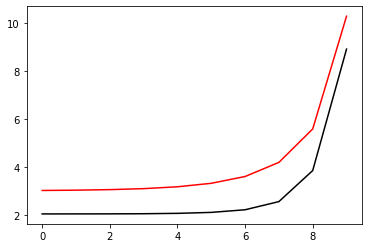

8300 99.00188897939864 8.809071164100567
[2.03448921 2.03488979 2.03681045 2.04265787 2.05813997 2.09826687
 2.20809297 2.54939773 3.84777565 8.92420121]


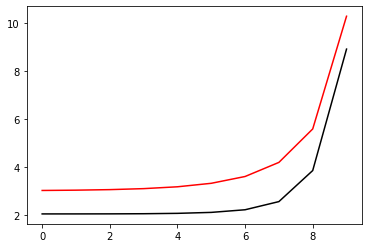

8400 99.00188863705156 8.808855335423083
[2.03451064 2.03491169 2.03683345 2.04268287 2.0581684  2.09830081
 2.20813359 2.54942554 3.84754804 8.92371388]


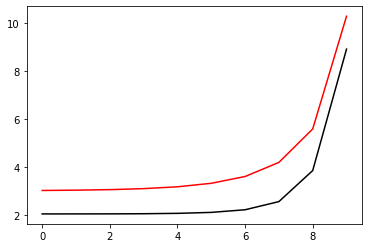

8500 99.00188829483177 8.808639606190404
[2.0345321  2.03493362 2.03685647 2.04270789 2.05819686 2.09833477
 2.20817419 2.54945328 3.84732058 8.92322658]


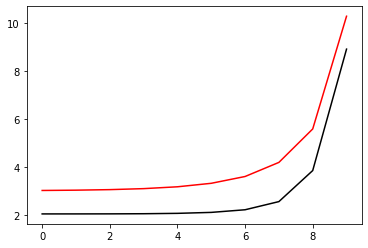

8600 99.00188795273907 8.808423976293481
[2.0345536  2.03495558 2.03687951 2.04273294 2.05822533 2.09836874
 2.20821479 2.54948096 3.84709325 8.92273931]


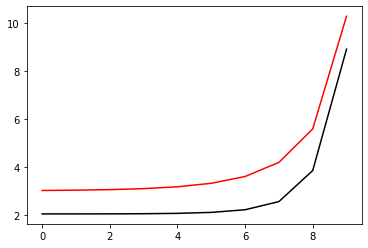

8700 99.00188761077331 8.808208445623446
[2.03457512 2.03497757 2.03690259 2.04275802 2.05825383 2.09840273
 2.20825538 2.54950856 3.84686606 8.92225206]


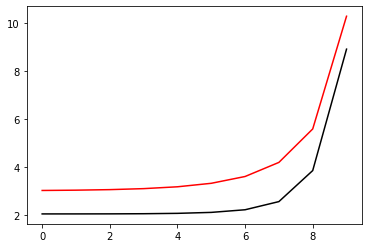

8800 99.00188726893431 8.807993014071643
[2.03459667 2.03499959 2.0369257  2.04278312 2.05828234 2.09843673
 2.20829596 2.54953611 3.846639   8.92176484]


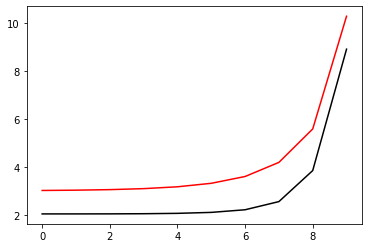

8900 99.0018869272219 8.807777681529565
[2.03461825 2.03502164 2.03694883 2.04280825 2.05831089 2.09847074
 2.20833652 2.54956358 3.84641209 8.92127764]


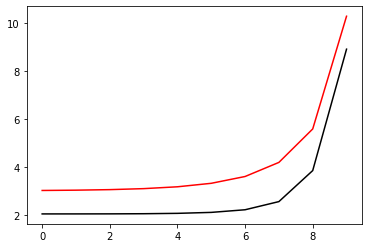

9000 99.0018865856359 8.807562447888895
[2.03463985 2.03504371 2.03697199 2.04283341 2.05833945 2.09850476
 2.20837708 2.54959099 3.84618531 8.92079046]


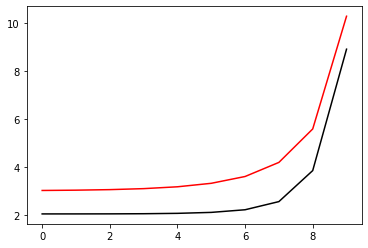

9100 99.00188624417613 8.807347313041522
[2.03466149 2.03506582 2.03699517 2.04285859 2.05836803 2.0985388
 2.20841762 2.54961834 3.84595867 8.92030331]


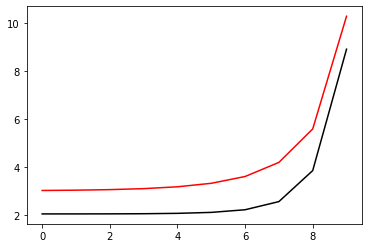

9200 99.00188590284243 8.807132276879482
[2.03468316 2.03508795 2.03701839 2.04288379 2.05839664 2.09857285
 2.20845816 2.54964561 3.84573216 8.91981619]


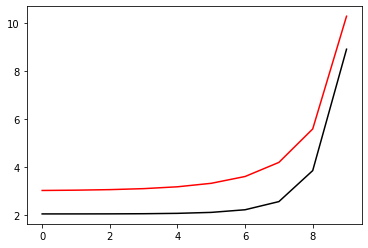

9300 99.00188556163462 8.806917339295017
[2.03470485 2.03511011 2.03704163 2.04290902 2.05842527 2.09860691
 2.20849868 2.54967283 3.84550579 8.91932909]


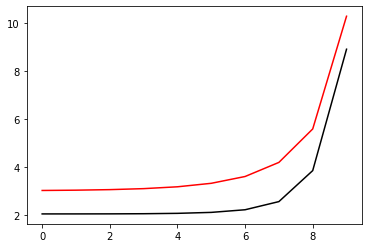

9400 99.00188522055254 8.806702500180545
[2.03472658 2.0351323  2.0370649  2.04293428 2.05845392 2.09864099
 2.20853919 2.54969997 3.84527956 8.91884201]


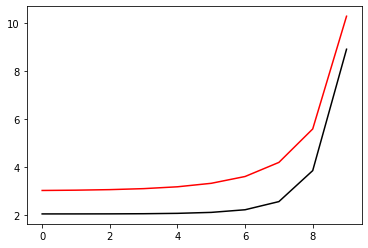

9500 99.00188487959602 8.806487759428652
[2.03474833 2.03515452 2.0370882  2.04295956 2.05848259 2.09867508
 2.20857969 2.54972706 3.84505347 8.91835496]


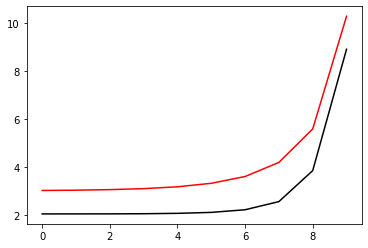

9600 99.00188453876488 8.80627311693212
[2.03477012 2.03517677 2.03711153 2.04298487 2.05851128 2.09870918
 2.20862018 2.54975407 3.84482751 8.91786794]


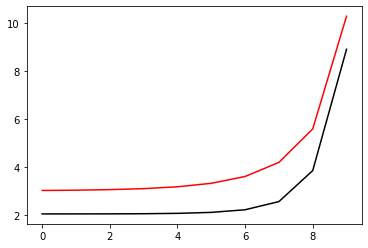

9700 99.00188419805896 8.806058572583904
[2.03479193 2.03519905 2.03713488 2.0430102  2.05854    2.09874329
 2.20866066 2.54978103 3.84460169 8.91738094]


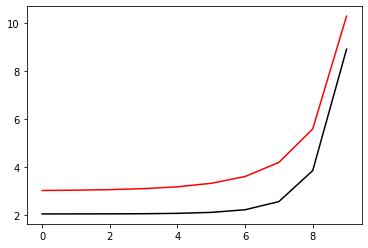

9800 99.00188385747806 8.805844126277126
[2.03481377 2.03522135 2.03715826 2.04303556 2.05856873 2.09877742
 2.20870113 2.54980791 3.844376   8.91689396]


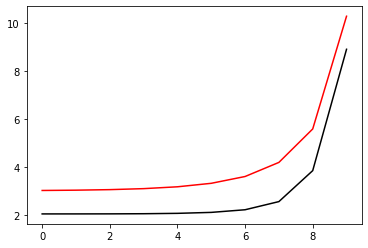

9900 99.00188351702205 8.805629777905102
[2.03483564 2.03524368 2.03718167 2.04306095 2.05859749 2.09881156
 2.20874159 2.54983474 3.84415045 8.91640701]


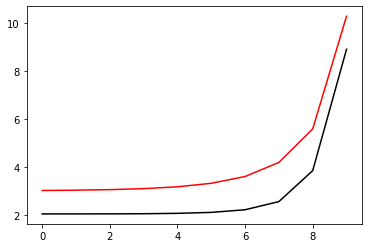

10000 99.00188317669073 8.805415527361323
[2.03485754 2.03526605 2.0372051  2.04308636 2.05862627 2.09884571
 2.20878203 2.54986149 3.84392503 8.91592009]


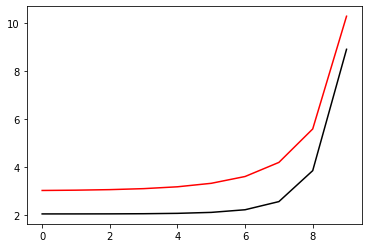

In [75]:
optimizer=tf.optimizers.SGD(learning_rate=0.01)
for i in range (1, 10001):
    run()
    if i%100==0: print(i, Error_func(h, m2_2).numpy(), m2_2.numpy()), print(h.numpy()), plt.plot(h_real, 'r-'), plt.plot(h.numpy(), 'k-'), plt.show()

100 99.00188283648396 8.80520137453946
[2.03487947 2.03528844 2.03722857 2.04311179 2.05865507 2.09887988
 2.20882247 2.54988819 3.84369975 8.91543319]


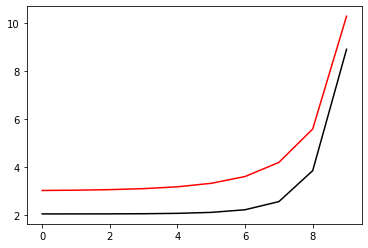

200 99.00188249640155 8.804987319333339
[2.03490143 2.03531085 2.03725206 2.04313725 2.0586839  2.09891406
 2.20886289 2.54991482 3.84347461 8.91494632]


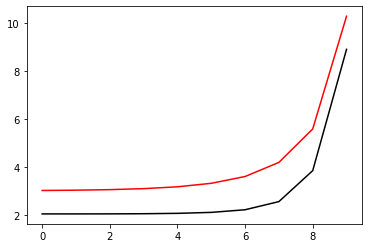

300 99.00188215644334 8.804773361637002
[2.03492341 2.0353333  2.03727557 2.04316274 2.05871274 2.09894825
 2.20890331 2.54994138 3.8432496  8.91445947]


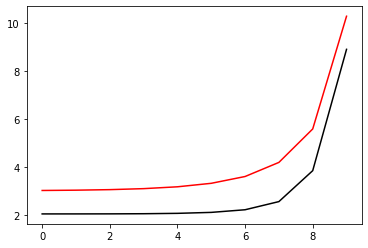

400 99.00188181660916 8.804559501344652
[2.03494543 2.03535578 2.03729912 2.04318825 2.05874161 2.09898245
 2.20894371 2.54996789 3.84302473 8.91397265]


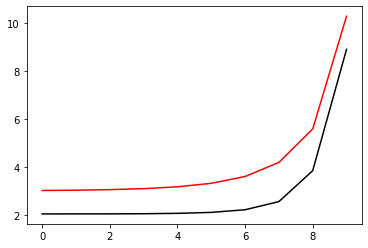

500 99.00188147689886 8.804345738350646
[2.03496747 2.03537828 2.03732269 2.04321379 2.05877049 2.09901666
 2.2089841  2.54999432 3.84279999 8.91348585]


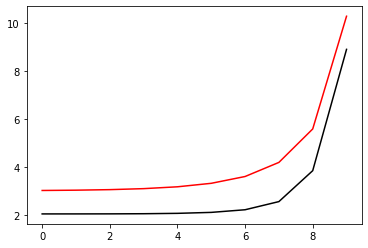

600 99.00188113731225 8.804132072549542
[2.03498954 2.03540081 2.03734629 2.04323935 2.0587994  2.09905089
 2.20902448 2.5500207  3.84257538 8.91299907]


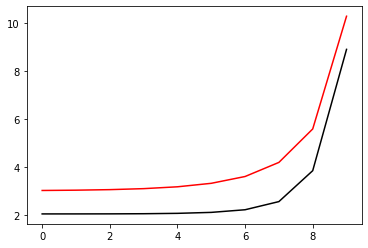

700 99.00188079784917 8.803918503836055
[2.03501164 2.03542337 2.03736992 2.04326494 2.05882833 2.09908513
 2.20906485 2.55004701 3.84235091 8.91251232]


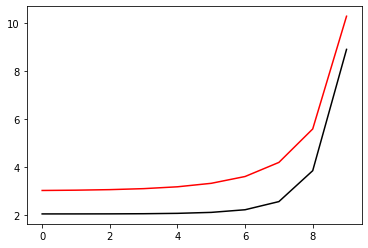

800 99.00188045850946 8.803705032105098
[2.03503377 2.03544596 2.03739357 2.04329055 2.05885728 2.09911938
 2.20910521 2.55007325 3.84212658 8.9120256 ]


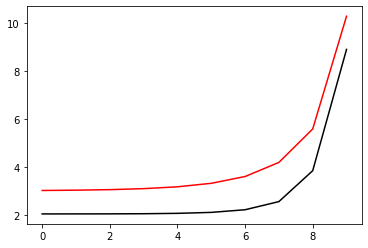

900 99.00188011929293 8.803491657251747
[2.03505593 2.03546858 2.03741725 2.04331619 2.05888625 2.09915365
 2.20914555 2.55009944 3.84190238 8.9115389 ]


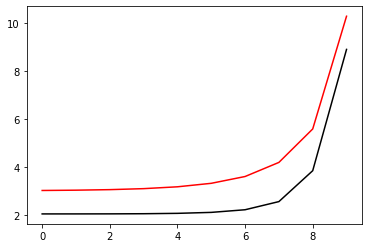

1000 99.00187978019946 8.803278379171239
[2.03507812 2.03549123 2.03744096 2.04334185 2.05891524 2.09918792
 2.20918589 2.55012556 3.84167831 8.91105223]


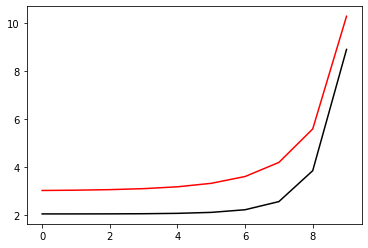

1100 99.00187944122885 8.803065197759015
[2.03510034 2.0355139  2.0374647  2.04336754 2.05894426 2.09922221
 2.20922621 2.55015161 3.84145438 8.91056558]


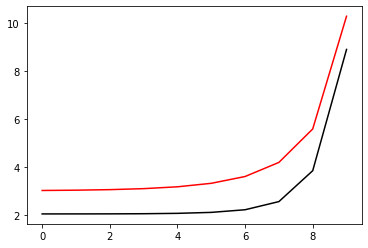

1200 99.00187910238097 8.802852112910651
[2.03512258 2.0355366  2.03748846 2.04339325 2.05897329 2.09925651
 2.20926652 2.55017761 3.84123058 8.91007896]


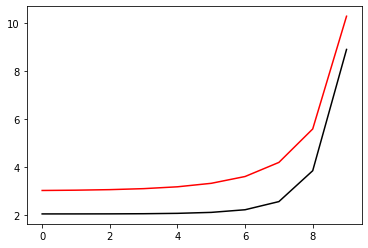

1300 99.00187876365561 8.802639124521926
[2.03514485 2.03555933 2.03751225 2.04341899 2.05900235 2.09929082
 2.20930682 2.55020354 3.84100692 8.90959237]


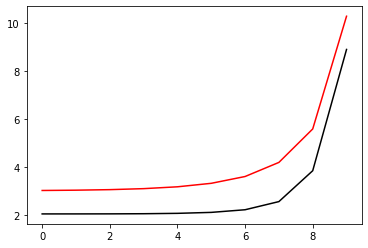

1400 99.00187842505264 8.802426232488786
[2.03516715 2.03558209 2.03753606 2.04344475 2.05903143 2.09932515
 2.20934711 2.55022941 3.84078339 8.90910579]


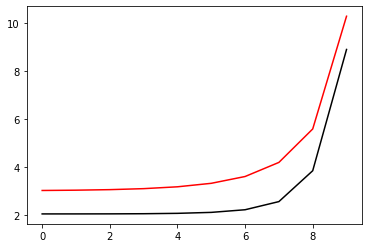

1500 99.00187808657188 8.802213436707333
[2.03518948 2.03560487 2.03755991 2.04347054 2.05906052 2.09935948
 2.20938739 2.55025522 3.84055999 8.90861925]


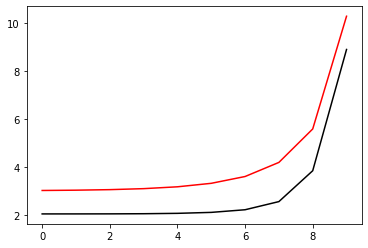

1600 99.00187774821319 8.802000737073854
[2.03521184 2.03562769 2.03758378 2.04349635 2.05908964 2.09939383
 2.20942766 2.55028096 3.84033672 8.90813273]


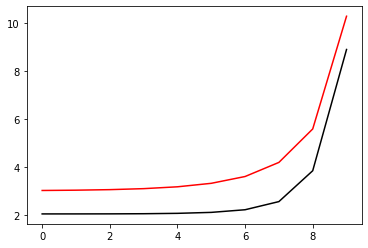

1700 99.00187740997637 8.801788133484807
[2.03523423 2.03565053 2.03760768 2.04352219 2.05911878 2.09942819
 2.20946791 2.55030664 3.84011359 8.90764623]


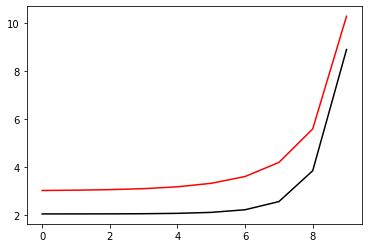

1800 99.0018770718613 8.801575625836826
[2.03525665 2.0356734  2.0376316  2.04354805 2.05914794 2.09946256
 2.20950816 2.55033226 3.8398906  8.90715976]


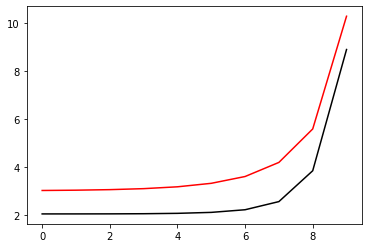

1900 99.00187673386779 8.801363214026715
[2.03527909 2.0356963  2.03765555 2.04357393 2.05917712 2.09949694
 2.20954839 2.55035782 3.83966773 8.90667331]


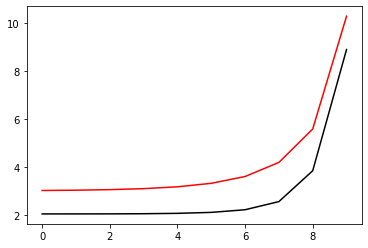

2000 99.0018763959957 8.801150897951436
[2.03530156 2.03571922 2.03767953 2.04359985 2.05920632 2.09953133
 2.20958861 2.55038332 3.839445   8.90618689]


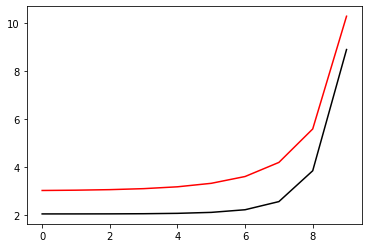

2100 99.00187605824483 8.800938677508116
[2.03532406 2.03574218 2.03770353 2.04362578 2.05923554 2.09956574
 2.20962882 2.55040875 3.8392224  8.9057005 ]


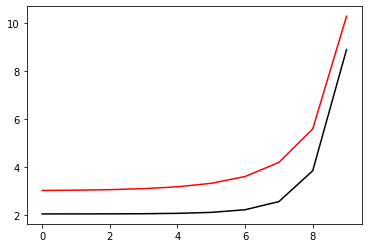

2200 99.00187572061508 8.800726552594076
[2.03534659 2.03576516 2.03772756 2.04365174 2.05926479 2.09960016
 2.20966901 2.55043412 3.83899993 8.90521413]


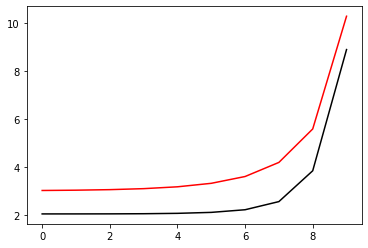

2300 99.00187538310625 8.800514523106784
[2.03536915 2.03578817 2.03775162 2.04367773 2.05929405 2.09963458
 2.2097092  2.55045944 3.8387776  8.90472779]


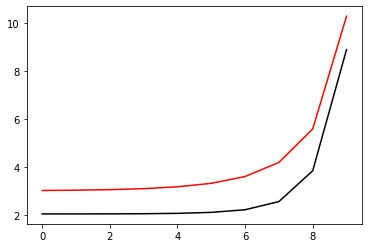

2400 99.00187504571817 8.80030258894388
[2.03539173 2.0358112  2.03777571 2.04370374 2.05932333 2.09966902
 2.20974937 2.55048469 3.8385554  8.90424147]


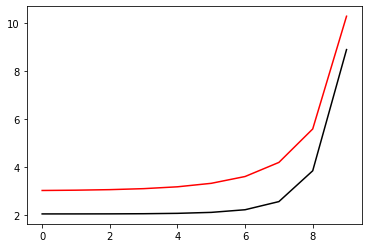

2500 99.00187470845071 8.800090750003188
[2.03541435 2.03583427 2.03779982 2.04372977 2.05935264 2.09970348
 2.20978953 2.55050987 3.83833333 8.90375517]


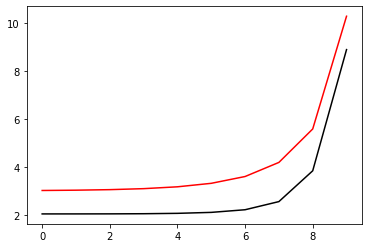

2600 99.0018743713037 8.799879006182687
[2.03543699 2.03585736 2.03782396 2.04375583 2.05938196 2.09973794
 2.20982968 2.550535   3.83811139 8.90326891]


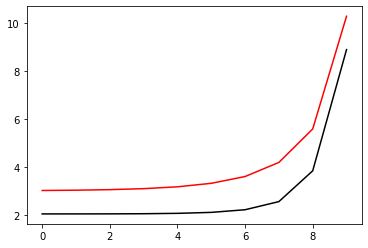

2700 99.00187403427698 8.799667357380526
[2.03545966 2.03588048 2.03784812 2.04378192 2.0594113  2.09977241
 2.20986982 2.55056007 3.83788958 8.90278266]


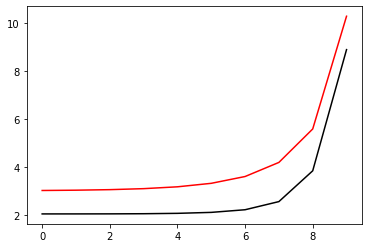

2800 99.00187369737039 8.799455803495015
[2.03548236 2.03590363 2.03787231 2.04380803 2.05944067 2.0998069
 2.20990995 2.55058508 3.8376679  8.90229645]


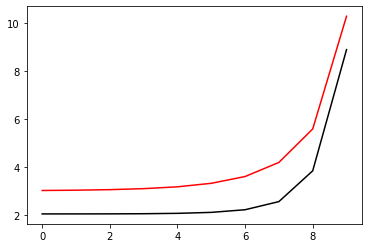

2900 99.00187336058377 8.799244344424643
[2.03550508 2.0359268  2.03789653 2.04383416 2.05947006 2.09984139
 2.20995006 2.55061002 3.83744636 8.90181025]


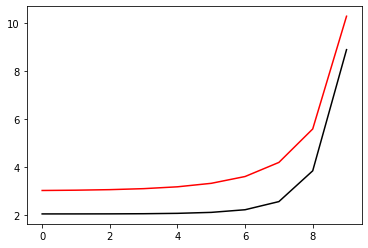

3000 99.00187302391699 8.799032980068048
[2.03552784 2.03595001 2.03792078 2.04386031 2.05949946 2.0998759
 2.20999017 2.55063491 3.83722495 8.90132409]


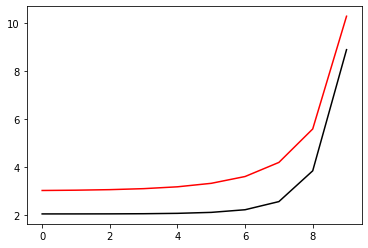

3100 99.00187268736985 8.798821710324066
[2.03555062 2.03597324 2.03794505 2.0438865  2.05952889 2.09991042
 2.21003026 2.55065973 3.83700367 8.90083795]


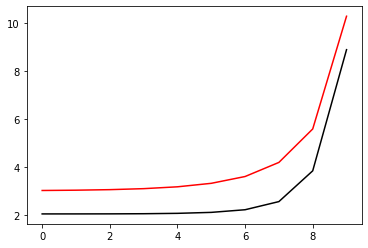

3200 99.00187235094222 8.798610535091665
[2.03557343 2.0359965  2.03796934 2.0439127  2.05955833 2.09994495
 2.21007034 2.55068449 3.83678252 8.90035183]


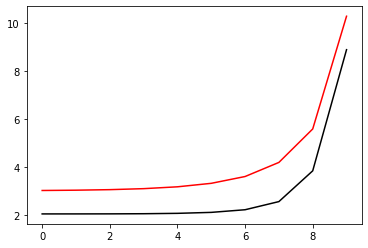

3300 99.00187201463395 8.798399454269983
[2.03559627 2.03601978 2.03799367 2.04393893 2.0595878  2.09997949
 2.2101104  2.5507092  3.8365615  8.89986574]


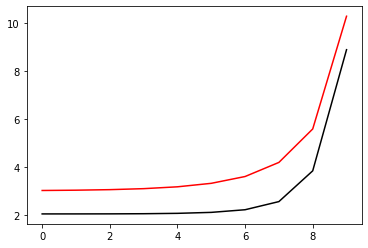

3400 99.00187167844484 8.798188467758347
[2.03561914 2.03604309 2.03801802 2.04396519 2.05961728 2.10001404
 2.21015046 2.55073384 3.83634061 8.89937968]


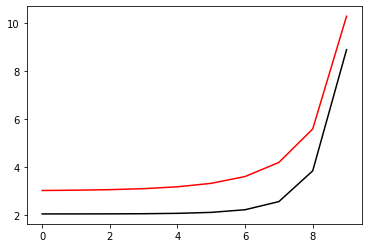

3500 99.0018713423748 8.797977575456217
[2.03564203 2.03606643 2.03804239 2.04399147 2.05964679 2.1000486
 2.2101905  2.55075843 3.83611985 8.89889364]


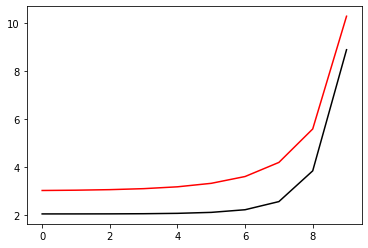

3600 99.00187100642363 8.797766777263242
[2.03566495 2.0360898  2.0380668  2.04401777 2.05967632 2.10008317
 2.21023054 2.55078295 3.83589922 8.89840762]


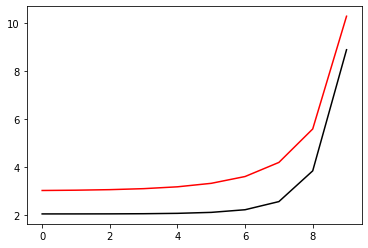

3700 99.0018706705912 8.797556073079232
[2.0356879  2.0361132  2.03809123 2.04404409 2.05970586 2.10011776
 2.21027055 2.55080742 3.83567873 8.89792164]


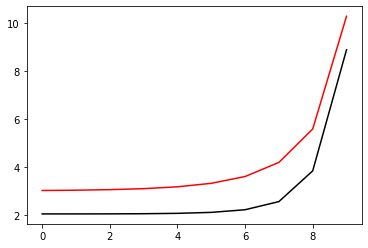

3800 99.00187033487731 8.797345462804133
[2.03571088 2.03613662 2.03811568 2.04407045 2.05973543 2.10015235
 2.21031056 2.55083182 3.83545836 8.89743567]


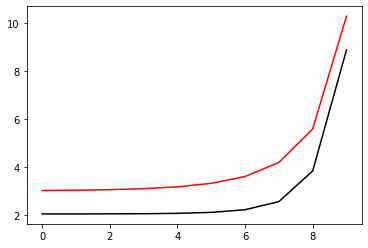

3900 99.00186999928187 8.797134946338101
[2.03573389 2.03616007 2.03814016 2.04409682 2.05976502 2.10018695
 2.21035056 2.55085617 3.83523812 8.89694974]


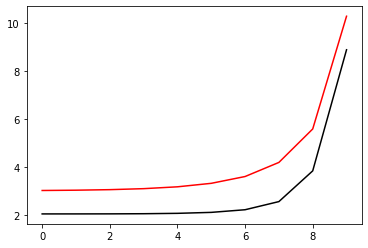

4000 99.00186966380467 8.796924523581417
[2.03575692 2.03618355 2.03816467 2.04412322 2.05979462 2.10022157
 2.21039054 2.55088045 3.83501802 8.89646382]


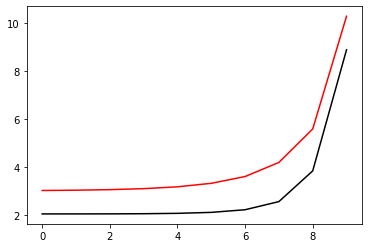

4100 99.00186932844561 8.796714194434522
[2.03577998 2.03620705 2.0381892  2.04414964 2.05982425 2.1002562
 2.21043051 2.55090468 3.83479804 8.89597794]


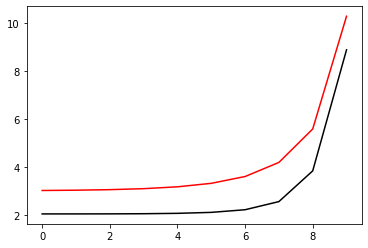

4200 99.0018689932045 8.796503958798045
[2.03580307 2.03623059 2.03821376 2.04417609 2.05985389 2.10029083
 2.21047047 2.55092885 3.83457819 8.89549208]


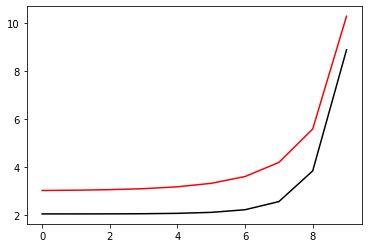

4300 99.00186865808118 8.796293816572764
[2.03582619 2.03625414 2.03823835 2.04420256 2.05988356 2.10032548
 2.21051042 2.55095296 3.83435847 8.89500624]


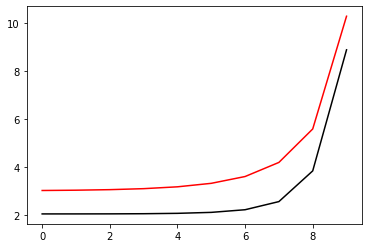

4400 99.00186832307551 8.796083767659615
[2.03584933 2.03627773 2.03826296 2.04422906 2.05991324 2.10036014
 2.21055035 2.55097701 3.83413889 8.89452043]


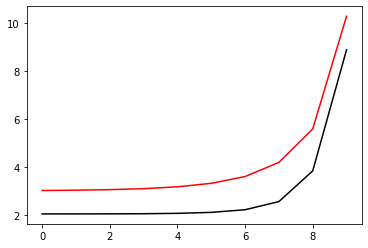

4500 99.00186798818736 8.7958738119597
[2.0358725  2.03630134 2.0382876  2.04425558 2.05994295 2.10039481
 2.21059028 2.551001   3.83391943 8.89403465]


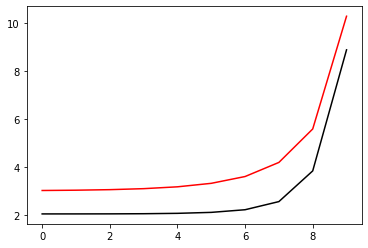

4600 99.00186765341655 8.795663949374278
[2.0358957  2.03632499 2.03831227 2.04428212 2.05997267 2.10042948
 2.21063019 2.55102494 3.8337001  8.89354889]


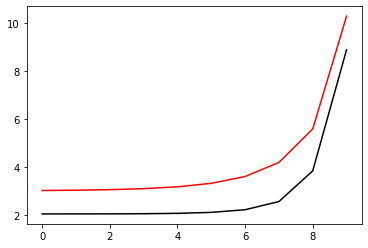

4700 99.00186731876296 8.795454179804764
[2.03591893 2.03634865 2.03833696 2.04430869 2.06000241 2.10046417
 2.21067009 2.55104881 3.83348089 8.89306316]


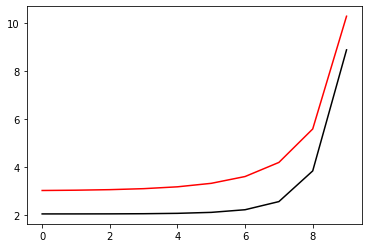

4800 99.0018669842264 8.795244503152738
[2.03594218 2.03637235 2.03836167 2.04433528 2.06003218 2.10049887
 2.21070997 2.55107263 3.83326182 8.89257745]


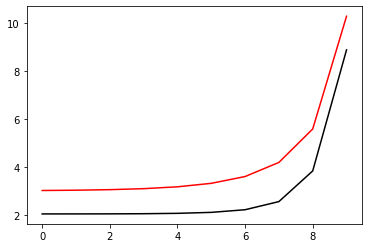

4900 99.00186664980673 8.795034919319953
[2.03596547 2.03639607 2.03838641 2.04436189 2.06006196 2.10053358
 2.21074985 2.55109639 3.83304288 8.89209177]


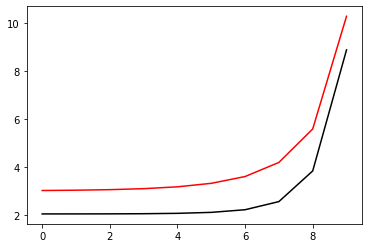

5000 99.00186631550383 8.794825428208302
[2.03598877 2.03641982 2.03841118 2.04438853 2.06009176 2.1005683
 2.21078971 2.55112009 3.83282406 8.89160611]


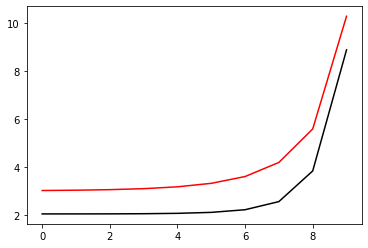

5100 99.00186598131751 8.794616029719833
[2.03601211 2.03644359 2.03843598 2.04441519 2.06012158 2.10060303
 2.21082956 2.55114373 3.83260538 8.89112048]


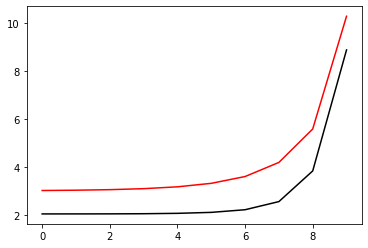

5200 99.00186564724764 8.79440672375677
[2.03603548 2.0364674  2.0384608  2.04444187 2.06015142 2.10063777
 2.21086939 2.55116732 3.83238682 8.89063488]


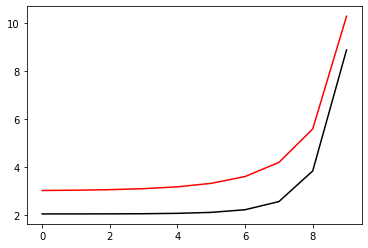

5300 99.00186531329409 8.794197510221487
[2.03605887 2.03649123 2.03848564 2.04446858 2.06018129 2.10067252
 2.21090922 2.55119085 3.83216839 8.8901493 ]


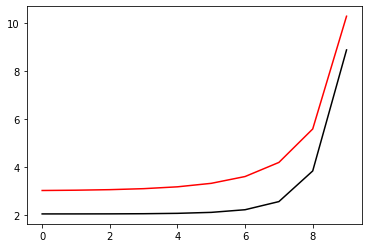

5400 99.00186497945667 8.79398838901652
[2.03608229 2.03651508 2.03851051 2.04449532 2.06021116 2.10070728
 2.21094903 2.55121432 3.83195008 8.88966375]


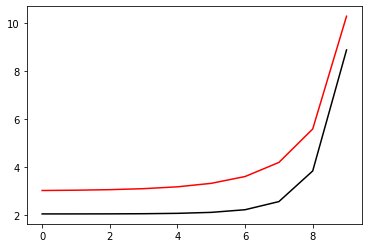

5500 99.00186464573525 8.793779360044544
[2.03610573 2.03653897 2.03853541 2.04452207 2.06024106 2.10074205
 2.21098883 2.55123773 3.83173191 8.88917822]


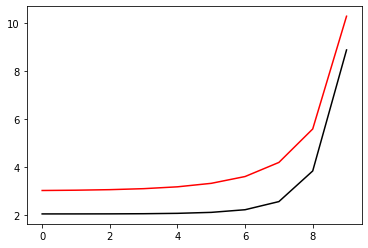

5600 99.0018643121297 8.79357042320843
[2.03612921 2.03656288 2.03856033 2.04454885 2.06027098 2.10077683
 2.21102862 2.55126109 3.83151386 8.88869272]


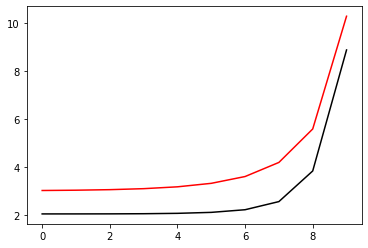

5700 99.00186397863985 8.793361578411162
[2.03615271 2.03658682 2.03858528 2.04457565 2.06030092 2.10081162
 2.21106839 2.55128438 3.83129594 8.88820724]


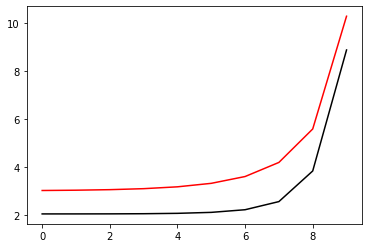

5800 99.00186364526554 8.793152825555886
[2.03617624 2.03661078 2.03861026 2.04460248 2.06033088 2.10084642
 2.21110816 2.55130763 3.83107815 8.88772179]


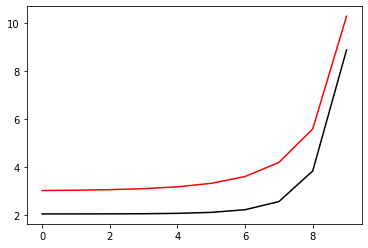

5900 99.00186331200666 8.792944164545926
[2.03619979 2.03663477 2.03863525 2.04462933 2.06036085 2.10088123
 2.21114791 2.55133081 3.83086048 8.88723636]


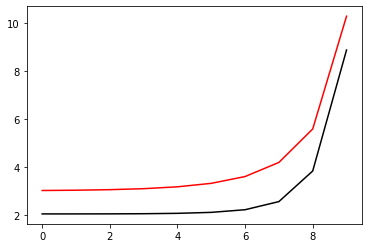

6000 99.00186297886304 8.792735595284766
[2.03622338 2.03665879 2.03866028 2.0446562  2.06039085 2.10091605
 2.21118765 2.55135394 3.83064295 8.88675096]


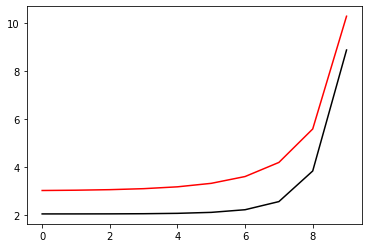

6100 99.00186264583455 8.792527117676023
[2.03624699 2.03668283 2.03868533 2.0446831  2.06042086 2.10095088
 2.21122737 2.55137701 3.83042553 8.88626559]


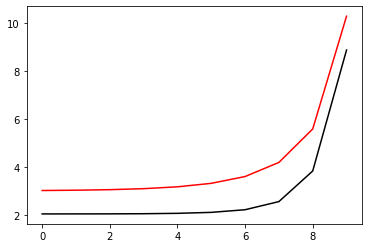

6200 99.00186231292103 8.792318731623464
[2.03627062 2.0367069  2.03871041 2.04471002 2.06045089 2.10098571
 2.21126708 2.55140002 3.83020825 8.88578024]


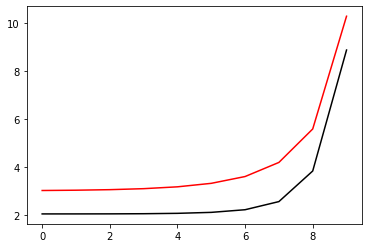

6300 99.00186198012234 8.79211043703103
[2.03629429 2.036731   2.03873551 2.04473696 2.06048094 2.10102056
 2.21130678 2.55142298 3.82999109 8.88529492]


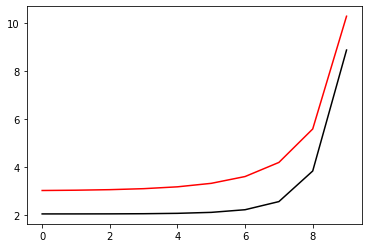

6400 99.00186164743833 8.791902233802826
[2.03631798 2.03675512 2.03876064 2.04476393 2.06051101 2.10105542
 2.21134647 2.55144588 3.82977406 8.88480962]


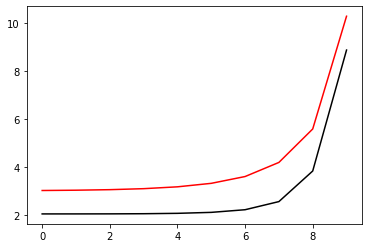

6500 99.00186131486885 8.791694121843081
[2.0363417  2.03677927 2.03878579 2.04479092 2.0605411  2.10109029
 2.21138615 2.55146873 3.82955716 8.88432435]


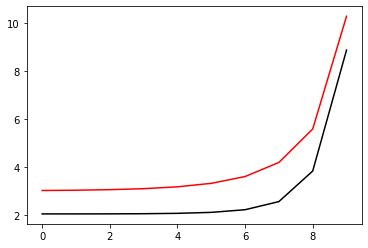

6600 99.00186098241376 8.791486101056183
[2.03636544 2.03680345 2.03881097 2.04481793 2.06057121 2.10112516
 2.21142581 2.55149152 3.82934038 8.88383911]


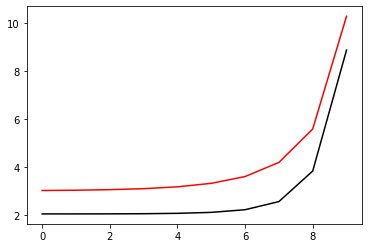

6700 99.00186065007293 8.791278171346686
[2.03638922 2.03682765 2.03883617 2.04484497 2.06060134 2.10116005
 2.21146546 2.55151425 3.82912373 8.88335389]


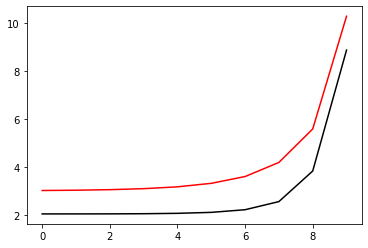

6800 99.00186031784621 8.791070332619299
[2.03641302 2.03685188 2.0388614  2.04487203 2.06063148 2.10119495
 2.2115051  2.55153693 3.8289072  8.8828687 ]


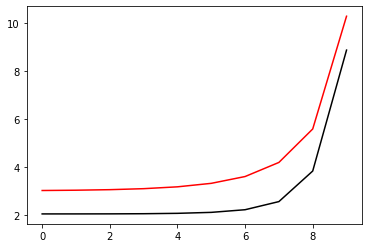

6900 99.00185998573342 8.79086258477887
[2.03643684 2.03687614 2.03888665 2.04489911 2.06066165 2.10122985
 2.21154472 2.55155955 3.8286908  8.88238353]


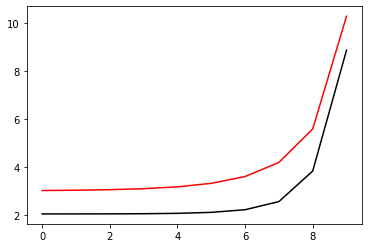

7000 99.00185965373447 8.790654927730404
[2.03646069 2.03690042 2.03891193 2.04492621 2.06069183 2.10126477
 2.21158434 2.55158212 3.82847453 8.88189839]


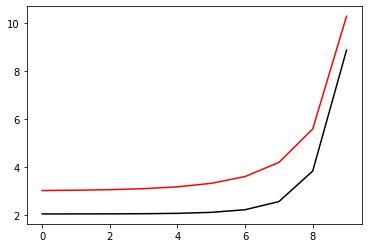

7100 99.0018593218492 8.790447361379067
[2.03648457 2.03692473 2.03893724 2.04495334 2.06072203 2.10129969
 2.21162394 2.55160463 3.82825838 8.88141327]


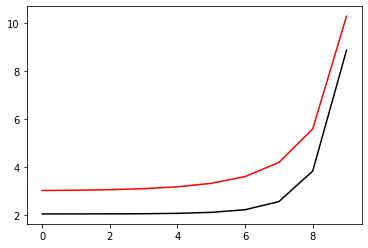

7200 99.00185899007744 8.79023988563017
[2.03650848 2.03694907 2.03896257 2.04498049 2.06075225 2.10133462
 2.21166352 2.55162708 3.82804236 8.88092818]


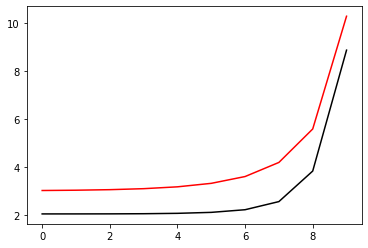

7300 99.0018586584191 8.790032500389163
[2.03653242 2.03697343 2.03898792 2.04500767 2.06078249 2.10136957
 2.2117031  2.55164948 3.82782646 8.88044312]


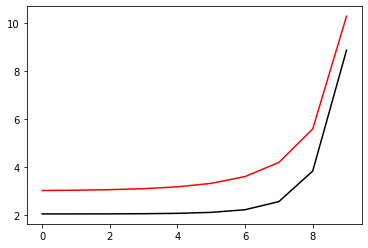

7400 99.00185832687397 8.789825205561659
[2.03655638 2.03699782 2.0390133  2.04503486 2.06081275 2.10140452
 2.21174266 2.55167183 3.82761069 8.87995808]


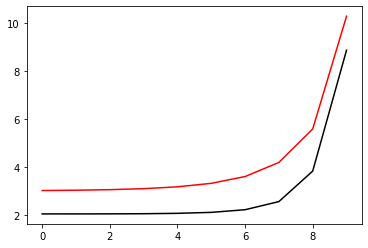

7500 99.00185799544197 8.789618001053432
[2.03658036 2.03702223 2.03903871 2.04506208 2.06084302 2.10143948
 2.21178221 2.55169412 3.82739504 8.87947307]


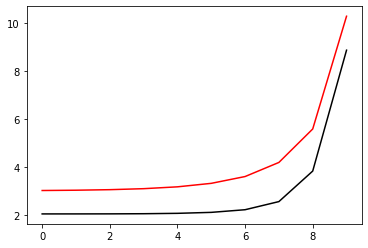

7600 99.00185766412292 8.789410886770382
[2.03660438 2.03704667 2.03906414 2.04508933 2.06087332 2.10147445
 2.21182174 2.55171636 3.82717952 8.87898808]


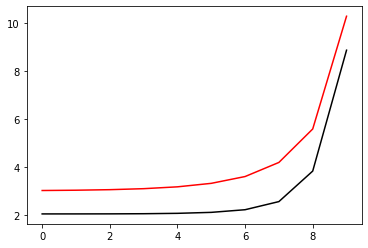

7700 99.0018573329167 8.789203862618578
[2.03662842 2.03707114 2.0390896  2.04511659 2.06090363 2.10150943
 2.21186127 2.55173854 3.82696412 8.87850312]


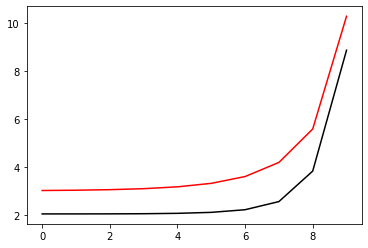

7800 99.00185700182317 8.788996928504233
[2.03665248 2.03709563 2.03911508 2.04514388 2.06093396 2.10154442
 2.21190078 2.55176066 3.82674885 8.87801818]


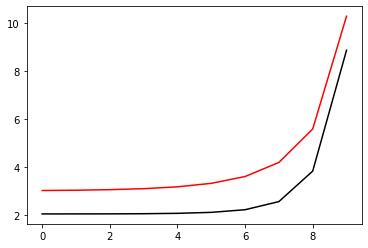

7900 99.00185667084217 8.788790084333701
[2.03667658 2.03712015 2.03914058 2.04517119 2.06096431 2.10157941
 2.21194028 2.55178273 3.8265337  8.87753327]


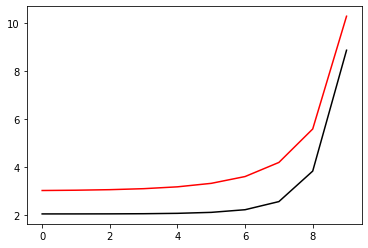

8000 99.00185633997357 8.788583330013491
[2.0367007  2.0371447  2.03916611 2.04519853 2.06099468 2.10161442
 2.21197976 2.55180475 3.82631868 8.87704839]


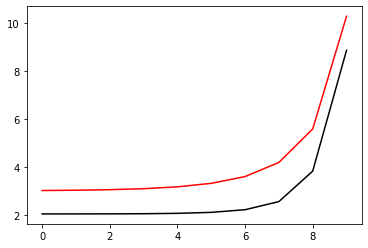

8100 99.00185600921725 8.788376665450263
[2.03672485 2.03716927 2.03919167 2.04522588 2.06102507 2.10164943
 2.21201923 2.55182671 3.82610378 8.87656353]


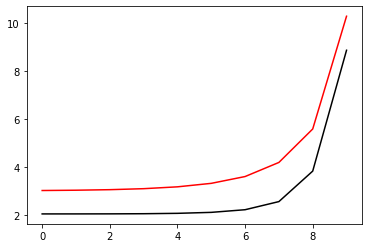

8200 99.00185567857305 8.78817009055082
[2.03674902 2.03719387 2.03921725 2.04525326 2.06105547 2.10168446
 2.21205869 2.55184862 3.825889   8.8760787 ]


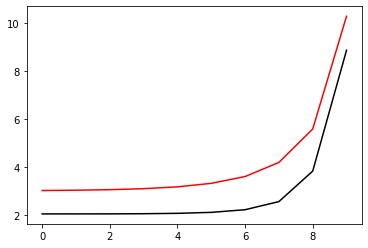

8300 99.0018553480408 8.787963605222131
[2.03677322 2.03721849 2.03924285 2.04528066 2.06108589 2.10171949
 2.21209814 2.55187048 3.82567435 8.8755939 ]


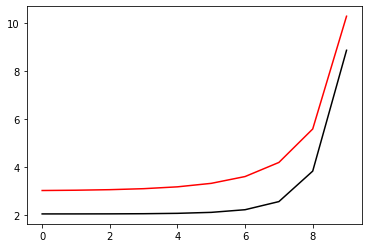

8400 99.00185501762044 8.787757209371284
[2.03679745 2.03724314 2.03926848 2.04530809 2.06111634 2.10175453
 2.21213757 2.55189228 3.82545982 8.87510912]


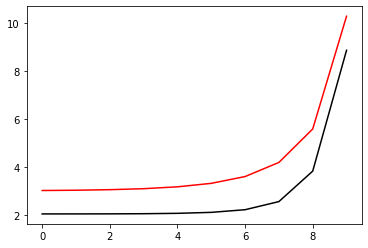

8500 99.00185468731176 8.787550902905526
[2.0368217  2.03726782 2.03929414 2.04533554 2.06114679 2.10178958
 2.212177   2.55191402 3.82524542 8.87462436]


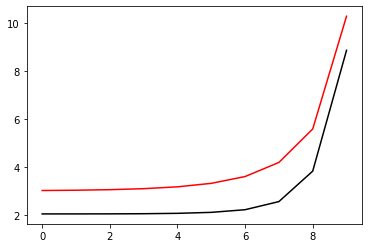

8600 99.00185435711465 8.787344685732272
[2.03684598 2.03729252 2.03931982 2.04536301 2.06117727 2.10182464
 2.2122164  2.55193571 3.82503114 8.87413964]


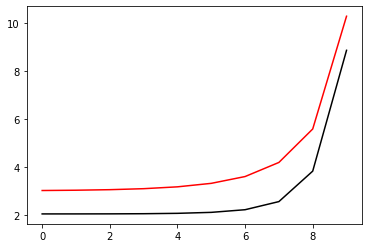

8700 99.00185402702898 8.787138557759048
[2.03687028 2.03731725 2.03934552 2.0453905  2.06120777 2.10185971
 2.2122558  2.55195735 3.82481698 8.87365494]


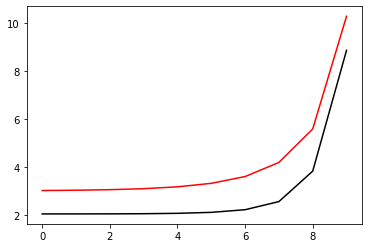

8800 99.0018536970546 8.786932518893543
[2.03689462 2.037342   2.03937125 2.04541801 2.06123828 2.10189479
 2.21229518 2.55197894 3.82460295 8.87317026]


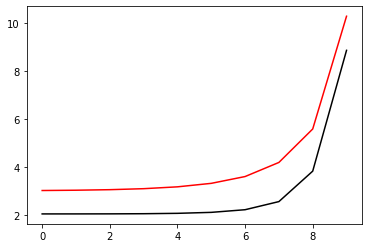

8900 99.00185336719137 8.786726569043594
[2.03691897 2.03736678 2.03939701 2.04544555 2.06126881 2.10192987
 2.21233455 2.55200047 3.82438904 8.87268561]


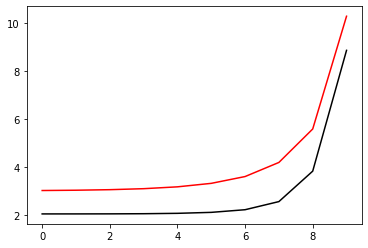

9000 99.00185303743916 8.786520708117186
[2.03694336 2.03739158 2.03942278 2.04547311 2.06129936 2.10196497
 2.21237391 2.55202195 3.82417525 8.87220099]


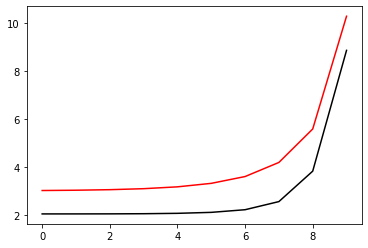

9100 99.00185270779784 8.786314936022428
[2.03696777 2.03741641 2.03944859 2.04550069 2.06132993 2.10200007
 2.21241325 2.55204338 3.82396159 8.87171639]


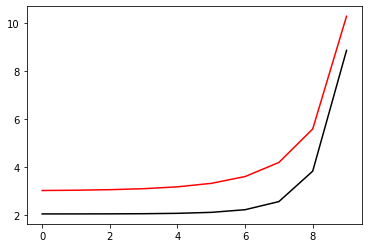

9200 99.00185237826726 8.786109252667611
[2.03699221 2.03744127 2.03947442 2.04552829 2.06136051 2.10203518
 2.21245258 2.55206475 3.82374805 8.87123182]


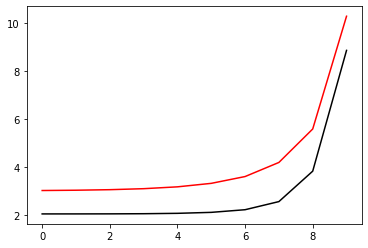

9300 99.00185204884728 8.785903657961143
[2.03701667 2.03746615 2.03950027 2.04555592 2.06139111 2.1020703
 2.2124919  2.55208607 3.82353463 8.87074727]


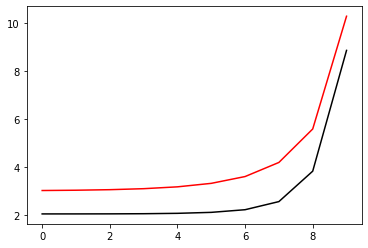

9400 99.0018517195378 8.785698151811577
[2.03704116 2.03749106 2.03952614 2.04558357 2.06142174 2.10210543
 2.2125312  2.55210733 3.82332134 8.87026275]


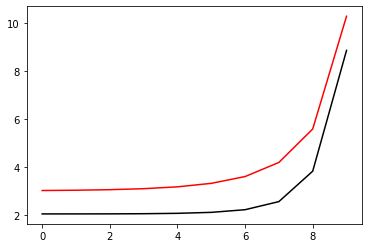

9500 99.00185139033864 8.785492734127624
[2.03706568 2.03751599 2.03955205 2.04561124 2.06145237 2.10214056
 2.2125705  2.55212855 3.82310816 8.86977826]


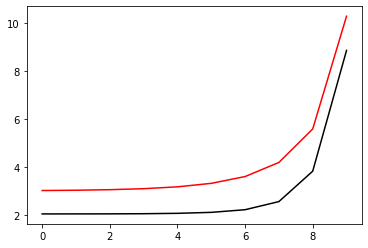

9600 99.00185106124968 8.785287404818126
[2.03709022 2.03754095 2.03957797 2.04563893 2.06148303 2.10217571
 2.21260977 2.55214971 3.82289511 8.86929379]


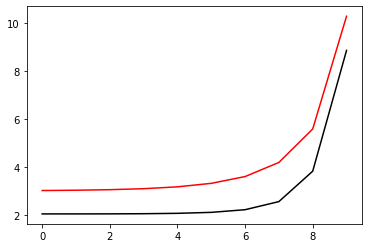

9700 99.00185073227078 8.785082163792087
[2.03711479 2.03756594 2.03960392 2.04566665 2.0615137  2.10221086
 2.21264904 2.55217082 3.82268218 8.86880935]


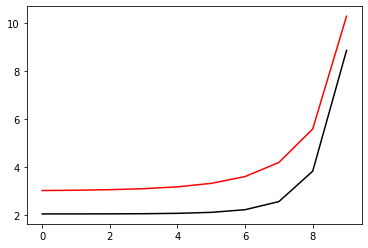

9800 99.00185040340186 8.78487701095862
[2.03713938 2.03759095 2.0396299  2.04569439 2.0615444  2.10224602
 2.21268829 2.55219187 3.82246938 8.86832493]


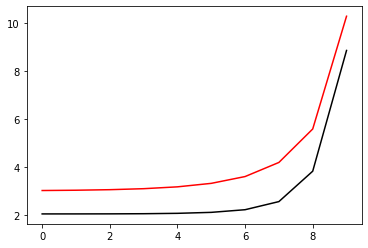

9900 99.00185007464269 8.784671946227013
[2.037164   2.03761598 2.0396559  2.04572214 2.0615751  2.10228119
 2.21272753 2.55221288 3.82225669 8.86784055]


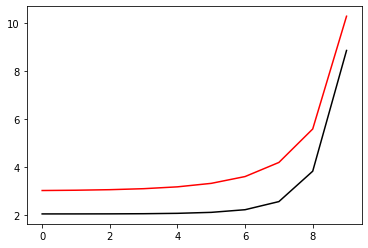

10000 99.00184974599321 8.784466969506688
[2.03718865 2.03764105 2.03968192 2.04574993 2.06160583 2.10231637
 2.21276676 2.55223383 3.82204413 8.86735618]


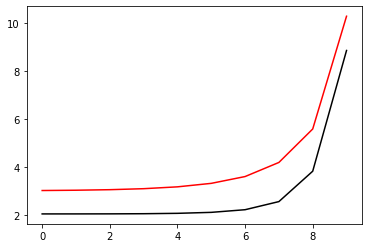

In [76]:
optimizer=tf.optimizers.SGD(learning_rate=0.01)
for i in range (1, 10001):
    run()
    if i%100==0: print(i, Error_func(h, m2_2).numpy(), m2_2.numpy()), print(h.numpy()), plt.plot(h_real, 'r-'), plt.plot(h.numpy(), 'k-'), plt.show()

100 99.00184941745326 8.784262080707197
[2.03721332 2.03766613 2.03970797 2.04577773 2.06163658 2.10235155
 2.21280597 2.55225473 3.82183169 8.86687185]


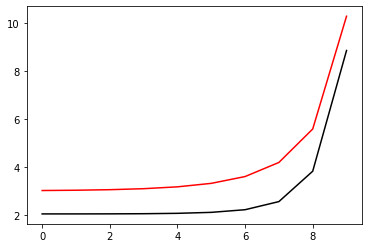

200 99.00184908902271 8.784057279738258
[2.03723802 2.03769125 2.03973404 2.04580556 2.06166734 2.10238675
 2.21284517 2.55227558 3.82161937 8.86638753]


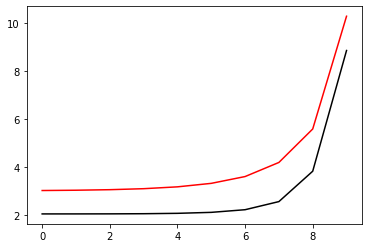

300 99.00184876070144 8.7838525665097
[2.03726274 2.03771638 2.03976014 2.0458334  2.06169812 2.10242195
 2.21288436 2.55229637 3.82140717 8.86590325]


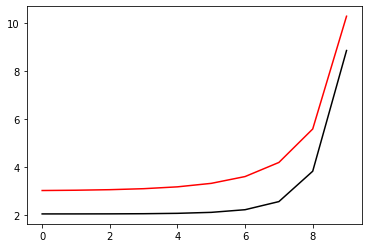

400 99.00184843248928 8.783647940931523
[2.03728749 2.03774155 2.03978626 2.04586127 2.06172891 2.10245716
 2.21292354 2.55231712 3.8211951  8.86541899]


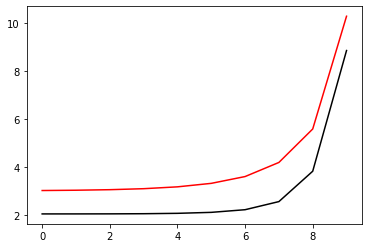

500 99.00184810438614 8.78344340291384
[2.03731227 2.03776673 2.0398124  2.04588916 2.06175973 2.10249238
 2.2129627  2.55233781 3.82098314 8.86493476]


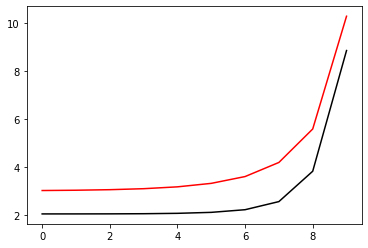

600 99.00184777639186 8.783238952366927
[2.03733707 2.03779195 2.03983857 2.04591708 2.06179056 2.1025276
 2.21300184 2.55235845 3.82077131 8.86445055]


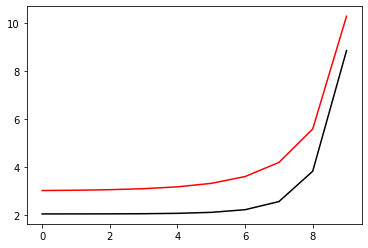

700 99.00184744850631 8.783034589201197
[2.03736189 2.03781719 2.03986476 2.04594501 2.06182141 2.10256284
 2.21304098 2.55237904 3.82055959 8.86396637]


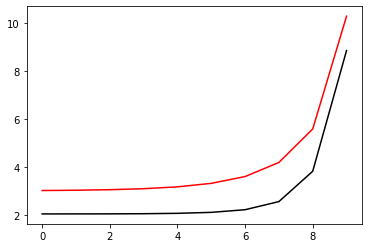

800 99.0018471207294 8.782830313327192
[2.03738675 2.03784245 2.03989098 2.04597297 2.06185227 2.10259808
 2.2130801  2.55239958 3.820348   8.86348222]


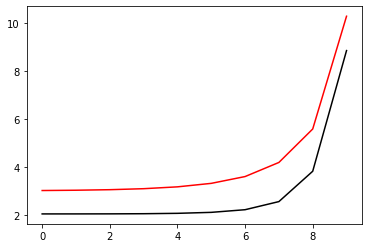

900 99.00184679306093 8.782626124655591
[2.03741163 2.03786774 2.03991722 2.04600095 2.06188316 2.10263333
 2.21311921 2.55242007 3.82013653 8.86299809]


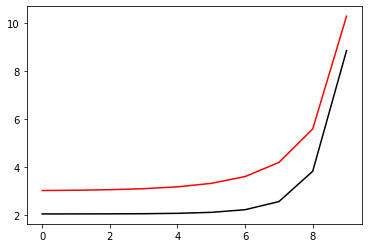

1000 99.0018464655008 8.782422023097228
[2.03743653 2.03789306 2.03994349 2.04602895 2.06191406 2.10266859
 2.21315831 2.5524405  3.81992518 8.86251399]


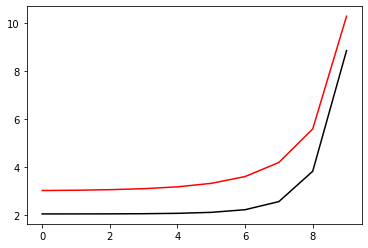

1100 99.00184613804892 8.782218008563083
[2.03746146 2.0379184  2.03996978 2.04605697 2.06194498 2.10270386
 2.21319739 2.55246089 3.81971395 8.86202991]


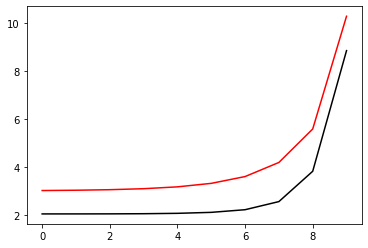

1200 99.0018458107051 8.782014080964222
[2.03748642 2.03794376 2.03999609 2.04608501 2.06197591 2.10273913
 2.21323646 2.55248122 3.81950284 8.86154586]


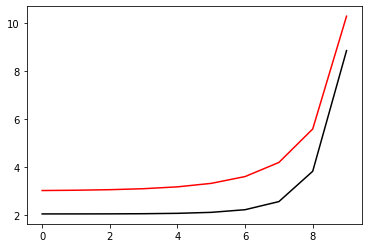

1300 99.00184548346925 8.781810240211929
[2.0375114  2.03796915 2.04002243 2.04611308 2.06200687 2.10277441
 2.21327551 2.55250151 3.81929185 8.86106184]


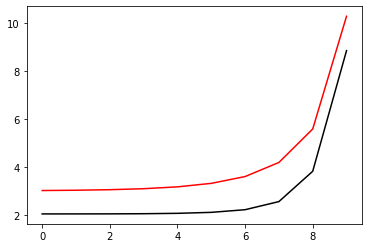

1400 99.0018451563412 8.781606486217584
[2.0375364  2.03799457 2.04004879 2.04614117 2.06203784 2.1028097
 2.21331456 2.55252174 3.81908098 8.86057784]


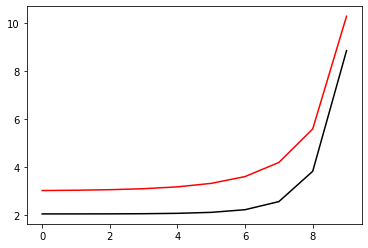

1500 99.00184482932087 8.781402818892687
[2.03756144 2.03802001 2.04007518 2.04616928 2.06206882 2.102845
 2.21335359 2.55254192 3.81887023 8.86009387]


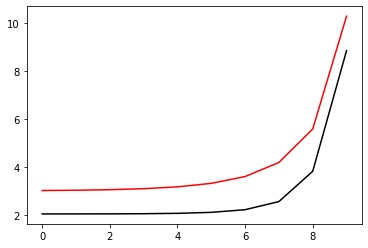

1600 99.00184450240809 8.78119923814892
[2.03758649 2.03804548 2.04010158 2.04619741 2.06209983 2.1028803
 2.2133926  2.55256205 3.8186596  8.85960993]


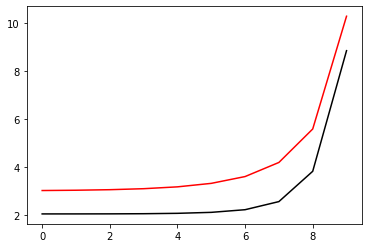

1700 99.00184417560276 8.780995743898064
[2.03761158 2.03807097 2.04012802 2.04622556 2.06213085 2.10291561
 2.2134316  2.55258213 3.81844908 8.85912601]


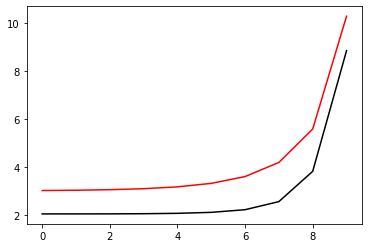

1800 99.00184384890471 8.780792336052043
[2.03763669 2.03809648 2.04015447 2.04625373 2.06216188 2.10295093
 2.21347059 2.55260216 3.81823869 8.85864212]


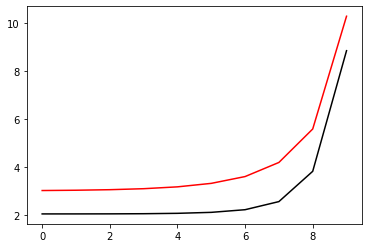

1900 99.00184352231386 8.780589014522933
[2.03766182 2.03812202 2.04018096 2.04628193 2.06219294 2.10298626
 2.21350957 2.55262215 3.81802842 8.85815825]


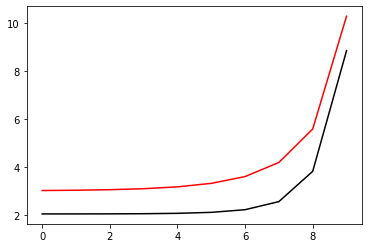

2000 99.00184319583008 8.780385779222955
[2.03768698 2.03814759 2.04020746 2.04631014 2.06222401 2.1030216
 2.21354853 2.55264208 3.81781827 8.85767441]


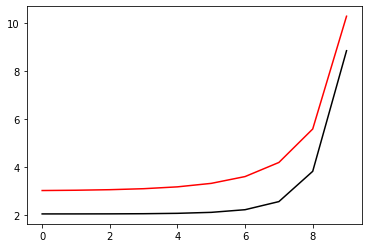

2100 99.00184286945321 8.780182630064438
[2.03771217 2.03817318 2.04023399 2.04633838 2.0622551  2.10305694
 2.21358748 2.55266196 3.81760823 8.8571906 ]


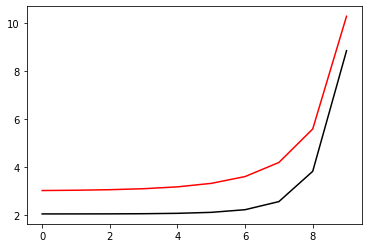

2200 99.00184254318314 8.779979566959858
[2.03773738 2.03819879 2.04026054 2.04636664 2.0622862  2.10309229
 2.21362642 2.55268179 3.81739832 8.85670681]


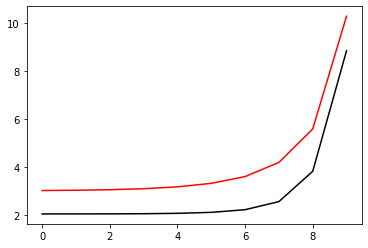

2300 99.00184221701973 8.77977658982183
[2.03776261 2.03822443 2.04028712 2.04639492 2.06231733 2.10312765
 2.21366535 2.55270157 3.81718852 8.85622305]


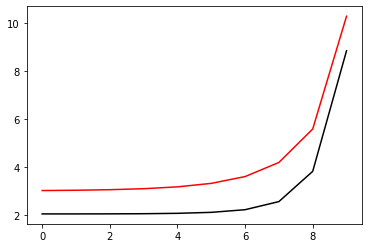

2400 99.00184189096288 8.779573698563105
[2.03778787 2.0382501  2.04031371 2.04642322 2.06234847 2.10316301
 2.21370426 2.5527213  3.81697885 8.85573932]


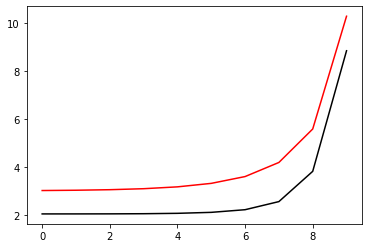

2500 99.00184156501244 8.779370893096566
[2.03781316 2.03827579 2.04034034 2.04645155 2.06237962 2.10319838
 2.21374315 2.55274098 3.81676929 8.85525561]


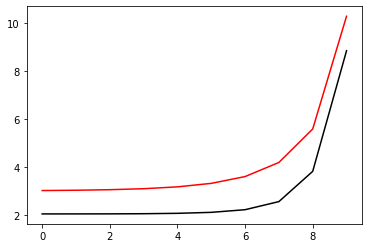

2600 99.00184123916827 8.779168173335227
[2.03783847 2.0383015  2.04036698 2.04647989 2.06241079 2.10323376
 2.21378204 2.55276062 3.81655985 8.85477193]


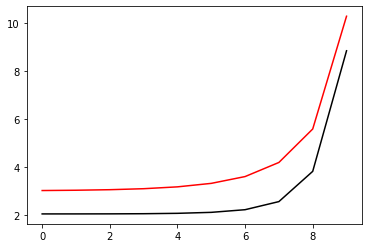

2700 99.00184091343029 8.778965539192248
[2.03786381 2.03832724 2.04039365 2.04650826 2.06244198 2.10326915
 2.21382091 2.5527802  3.81635053 8.85428827]


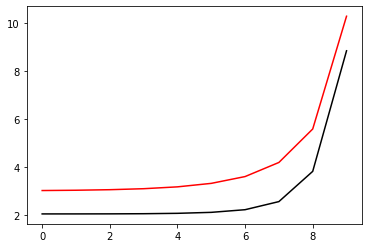

2800 99.00184058779836 8.778762990580907
[2.03788917 2.03835301 2.04042035 2.04653664 2.06247319 2.10330455
 2.21385976 2.55279973 3.81614133 8.85380464]


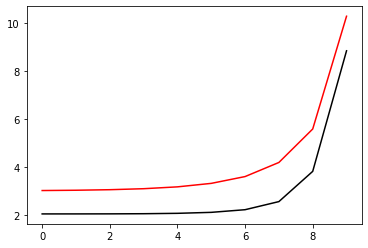

2900 99.00184026227231 8.778560527414637
[2.03791456 2.03837879 2.04044706 2.04656505 2.06250441 2.10333995
 2.21389861 2.55281922 3.81593224 8.85332104]


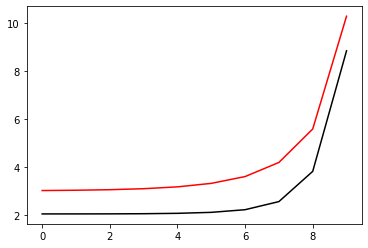

3000 99.00183993685205 8.778358149606982
[2.03793997 2.03840461 2.0404738  2.04659348 2.06253565 2.10337536
 2.21393744 2.55283866 3.81572327 8.85283746]


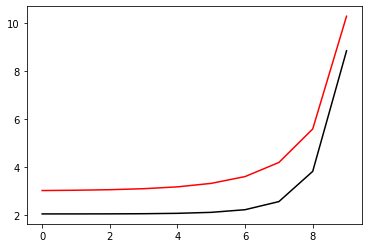

3100 99.00183961153748 8.77815585707165
[2.03796541 2.03843044 2.04050057 2.04662193 2.06256691 2.10341077
 2.21397625 2.55285804 3.81551442 8.85235391]


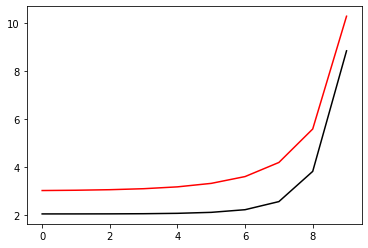

3200 99.00183928632845 8.777953649722445
[2.03799087 2.03845631 2.04052735 2.0466504  2.06259818 2.10344619
 2.21401506 2.55287738 3.81530569 8.85187039]


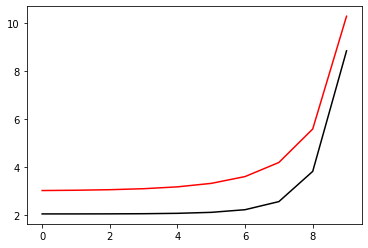

3300 99.00183896122482 8.77775152747332
[2.03801636 2.03848219 2.04055416 2.04667889 2.06262947 2.10348162
 2.21405385 2.55289667 3.81509708 8.85138689]


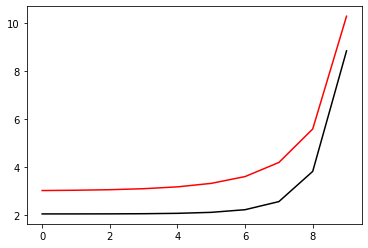

3400 99.00183863622648 8.777549490238364
[2.03804187 2.03850811 2.040581   2.04670741 2.06266077 2.10351706
 2.21409263 2.55291591 3.81488858 8.85090342]


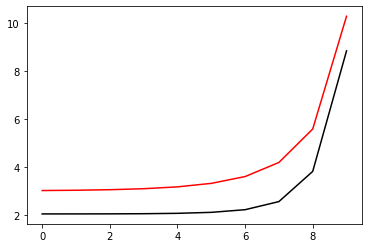

3500 99.0018383113333 8.777347537931792
[2.03806741 2.03853404 2.04060786 2.04673594 2.06269209 2.10355251
 2.21413139 2.55293511 3.81468021 8.85041998]


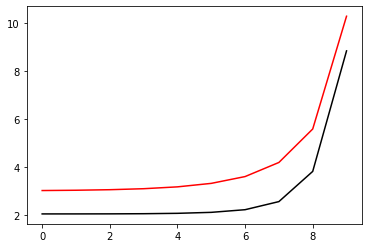

3600 99.00183798654518 8.777145670467977
[2.03809297 2.03856    2.04063474 2.0467645  2.06272343 2.10358796
 2.21417014 2.55295425 3.81447194 8.84993656]


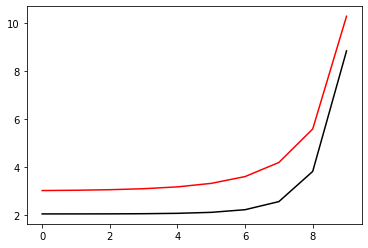

3700 99.00183766186198 8.776943887761377
[2.03811855 2.03858599 2.04066164 2.04679307 2.06275479 2.10362342
 2.21420888 2.55297335 3.8142638  8.84945317]


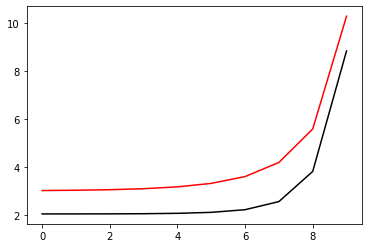

3800 99.00183733728359 8.776742189726615
[2.03814417 2.03861199 2.04068857 2.04682167 2.06278616 2.10365888
 2.2142476  2.55299239 3.81405577 8.8489698 ]


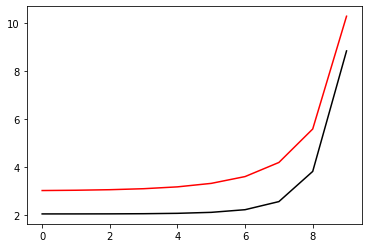

3900 99.00183701280984 8.776540576278432
[2.0381698  2.03863803 2.04071552 2.04685029 2.06281754 2.10369435
 2.21428631 2.55301139 3.81384786 8.84848647]


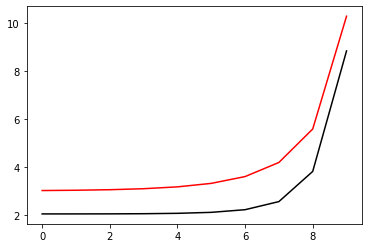

4000 99.00183668844068 8.776339047331707
[2.03819546 2.03866409 2.04074249 2.04687893 2.06284895 2.10372983
 2.21432501 2.55303035 3.81364007 8.84800315]


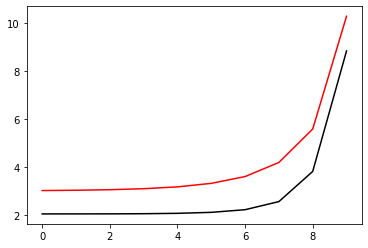

4100 99.00183636417593 8.776137602801445
[2.03822115 2.03869017 2.04076949 2.04690759 2.06288037 2.10376532
 2.21436369 2.55304925 3.81343239 8.84751987]


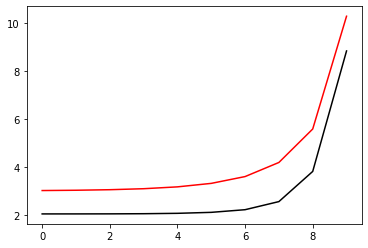

4200 99.00183604001548 8.775936242602786
[2.03824686 2.03871627 2.04079651 2.04693627 2.0629118  2.10380081
 2.21440236 2.55306811 3.81322483 8.84703661]


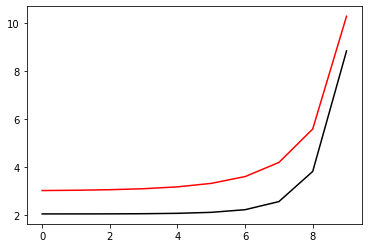

4300 99.00183571595923 8.775734966650992
[2.0382726  2.0387424  2.04082355 2.04696497 2.06294325 2.10383631
 2.21444102 2.55308691 3.81301739 8.84655338]


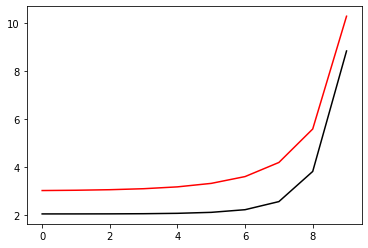

4400 99.00183539200705 8.775533774861465
[2.03829836 2.03876856 2.04085061 2.04699369 2.06297472 2.10387182
 2.21447966 2.55310568 3.81281006 8.84607017]


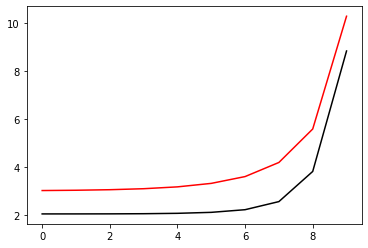

4500 99.00183506815881 8.775332667149724
[2.03832414 2.03879474 2.0408777  2.04702243 2.06300621 2.10390733
 2.21451829 2.55312439 3.81260285 8.84558699]


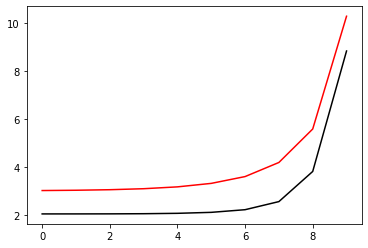

4600 99.00183474441441 8.775131643431427
[2.03834995 2.03882094 2.04090481 2.04705119 2.06303771 2.10394285
 2.2145569  2.55314305 3.81239576 8.84510384]


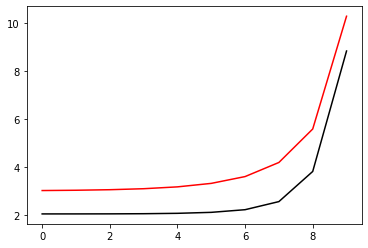

4700 99.0018344207737 8.774930703622363
[2.03837579 2.03884717 2.04093195 2.04707998 2.06306922 2.10397838
 2.21459551 2.55316167 3.81218878 8.84462071]


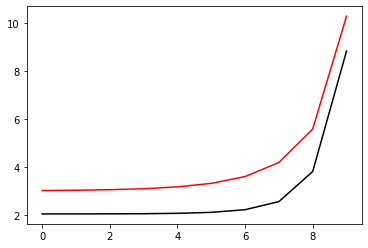

4800 99.00183409723657 8.774729847638437
[2.03840165 2.03887342 2.04095911 2.04710878 2.06310076 2.10401391
 2.2146341  2.55318024 3.81198191 8.84413761]


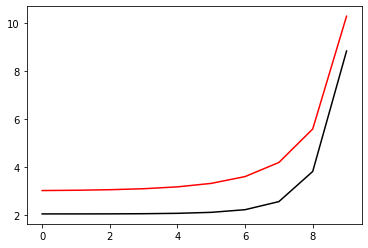

4900 99.00183377380291 8.774529075395709
[2.03842753 2.0388997  2.04098629 2.04713761 2.0631323  2.10404945
 2.21467267 2.55319877 3.81177517 8.84365454]


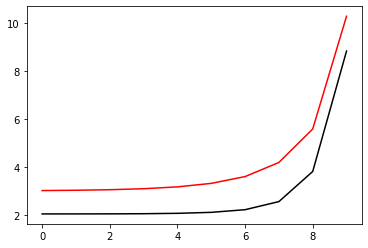

5000 99.00183345047259 8.774328386810318
[2.03845344 2.03892599 2.04101349 2.04716645 2.06316387 2.104085
 2.21471123 2.55321725 3.81156853 8.84317149]


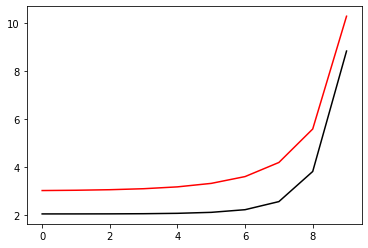

5100 99.0018331272455 8.774127781798578
[2.03847937 2.03895232 2.04104071 2.04719532 2.06319545 2.10412055
 2.21474978 2.55323568 3.81136202 8.84268847]


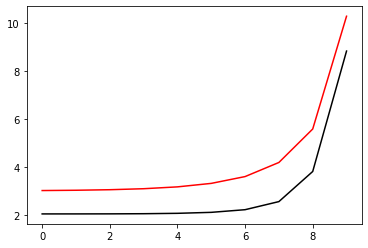

5200 99.00183280412152 8.773927260276919
[2.03850533 2.03897867 2.04106796 2.0472242  2.06322704 2.10415611
 2.21478832 2.55325406 3.81115562 8.84220547]


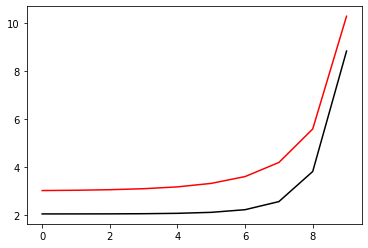

5300 99.00183248110052 8.773726822161887
[2.03853131 2.03900504 2.04109523 2.04725311 2.06325866 2.10419168
 2.21482684 2.5532724  3.81094933 8.84172251]


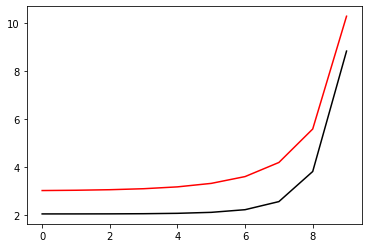

5400 99.00183215818238 8.773526467370159
[2.03855731 2.03903143 2.04112253 2.04728204 2.06329028 2.10422725
 2.21486535 2.55329069 3.81074316 8.84123956]


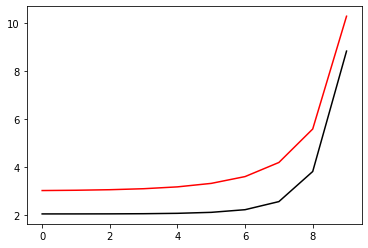

5500 99.001831835367 8.773326195818537
[2.03858334 2.03905785 2.04114985 2.04731098 2.06332193 2.10426283
 2.21490384 2.55330893 3.81053711 8.84075665]


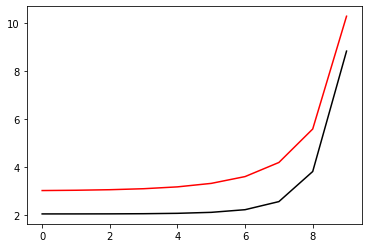

5600 99.00183151265425 8.773126007423963
[2.0386094  2.03908429 2.04117719 2.04733995 2.06335359 2.10429842
 2.21494232 2.55332713 3.81033116 8.84027376]


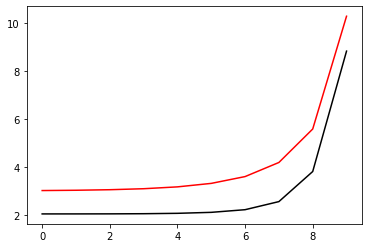

5700 99.00183119004403 8.772925902103486
[2.03863548 2.03911076 2.04120455 2.04736894 2.06338526 2.10433401
 2.21498079 2.55334528 3.81012534 8.8397909 ]


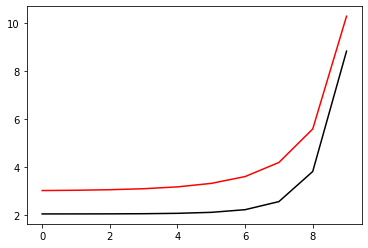

5800 99.00183086753617 8.772725879774306
[2.03866158 2.03913725 2.04123193 2.04739795 2.06341695 2.10436961
 2.21501925 2.55336339 3.80991963 8.83930807]


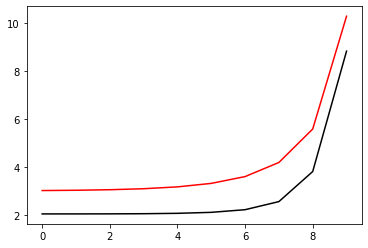

5900 99.00183054513062 8.772525940353718
[2.03868771 2.03916376 2.04125934 2.04742698 2.06344866 2.10440522
 2.21505769 2.55338145 3.80971403 8.83882526]


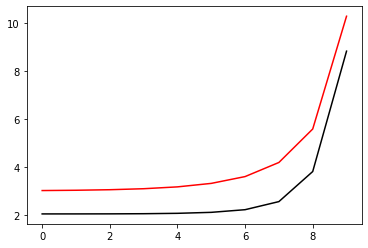

6000 99.00183022282724 8.772326083759173
[2.03871386 2.0391903  2.04128677 2.04745603 2.06348038 2.10444083
 2.21509611 2.55339946 3.80950855 8.83834248]


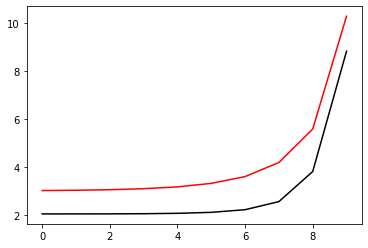

6100 99.00182990062586 8.772126309908218
[2.03874003 2.03921686 2.04131422 2.04748509 2.06351212 2.10447644
 2.21513453 2.55341743 3.80930318 8.83785972]


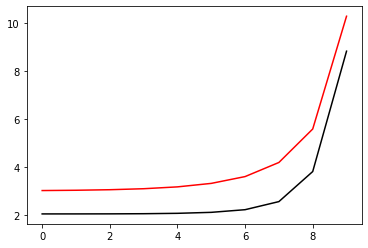

6200 99.00182957852644 8.771926618718537
[2.03876623 2.03924345 2.0413417  2.04751418 2.06354387 2.10451207
 2.21517293 2.55343535 3.80909793 8.83737699]


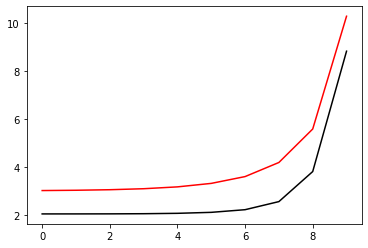

6300 99.00182925652884 8.771727010107947
[2.03879246 2.03927006 2.0413692  2.04754329 2.06357564 2.1045477
 2.21521131 2.55345322 3.80889279 8.83689429]


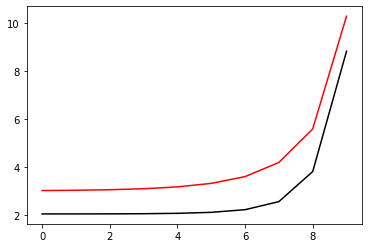

6400 99.00182893463293 8.771527483994376
[2.0388187  2.03929669 2.04139672 2.04757242 2.06360743 2.10458334
 2.21524969 2.55347105 3.80868776 8.83641162]


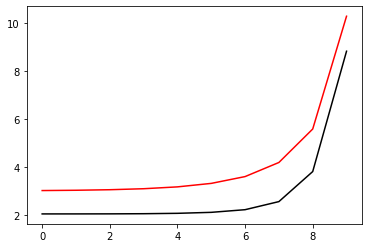

6500 99.00182861283858 8.771328040295904
[2.03884498 2.03932335 2.04142426 2.04760157 2.06363922 2.10461898
 2.21528805 2.55348884 3.80848285 8.83592897]


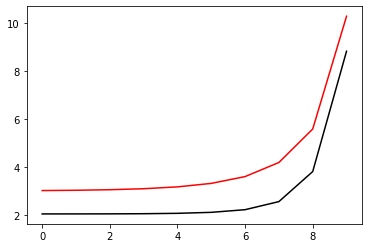

6600 99.00182829114571 8.771128678930696
[2.03887127 2.03935003 2.04145182 2.04763074 2.06367104 2.10465463
 2.21532639 2.55350658 3.80827805 8.83544635]


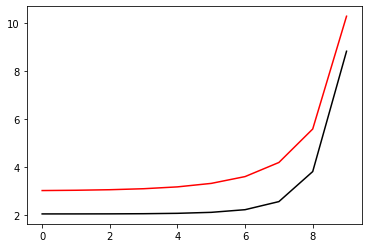

6700 99.0018279695542 8.77092939981707
[2.03889759 2.03937673 2.04147941 2.04765993 2.06370287 2.10469028
 2.21536473 2.55352427 3.80807336 8.83496375]


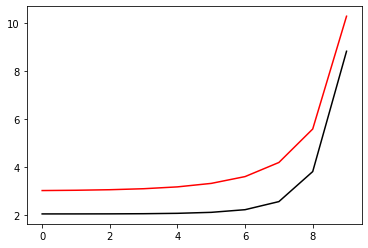

6800 99.0018276480639 8.770730202873457
[2.03892394 2.03940346 2.04150702 2.04768914 2.06373472 2.10472594
 2.21540305 2.55354192 3.80786879 8.83448118]


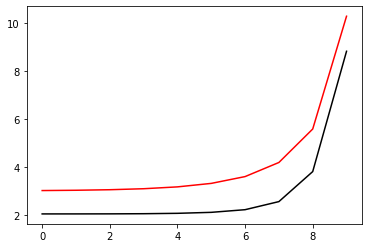

6900 99.00182732667474 8.7705310880184
[2.0389503  2.03943021 2.04153465 2.04771837 2.06376658 2.10476161
 2.21544135 2.55355952 3.80766433 8.83399864]


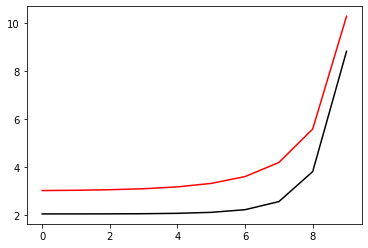

7000 99.00182700538659 8.770332055170575
[2.0389767  2.03945698 2.04156231 2.04774762 2.06379846 2.10479728
 2.21547964 2.55357708 3.80745999 8.83351613]


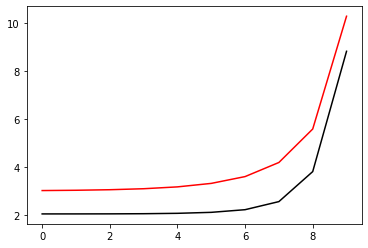

7100 99.0018266841993 8.77013310424878
[2.03900311 2.03948378 2.04158998 2.04777689 2.06383035 2.10483296
 2.21551792 2.55359459 3.80725576 8.83303364]


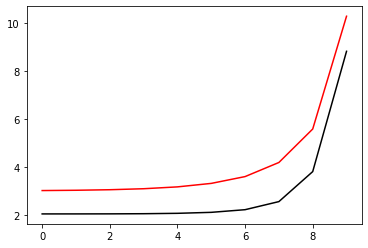

7200 99.00182636311283 8.769934235171934
[2.03902955 2.0395106  2.04161768 2.04780618 2.06386226 2.10486865
 2.21555619 2.55361206 3.80705164 8.83255118]


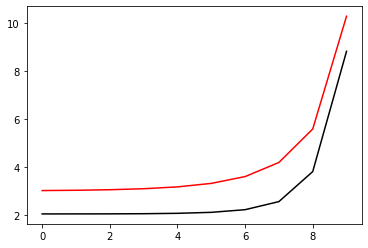

7300 99.00182604212699 8.769735447859103
[2.03905601 2.03953744 2.0416454  2.04783549 2.06389418 2.10490434
 2.21559444 2.55362948 3.80684763 8.83206874]


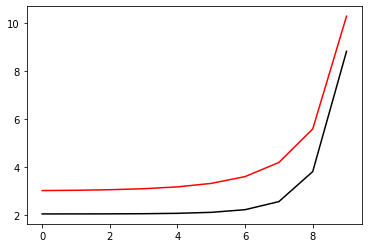

7400 99.00182572124172 8.769536742229437
[2.0390825  2.03956431 2.04167314 2.04786482 2.06392612 2.10494004
 2.21563268 2.55364686 3.80664374 8.83158634]


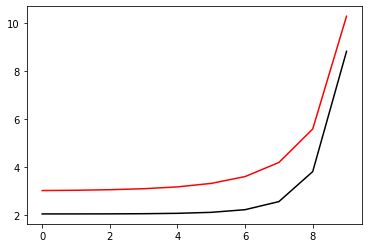

7500 99.00182540045687 8.769338118202219
[2.03910901 2.0395912  2.04170091 2.04789416 2.06395807 2.10497574
 2.2156709  2.5536642  3.80643996 8.83110395]


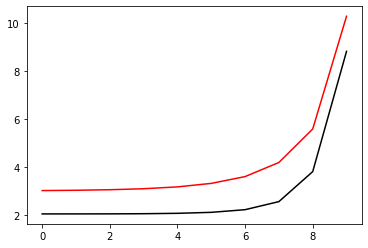

7600 99.00182507977236 8.769139575696865
[2.03913555 2.03961811 2.0417287  2.04792353 2.06399004 2.10501145
 2.21570911 2.55368148 3.80623629 8.8306216 ]


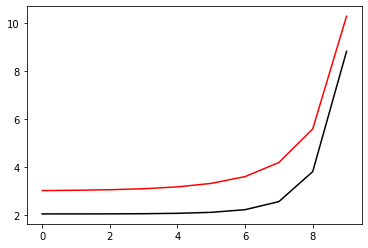

7700 99.00182475918804 8.76894111463289
[2.03916211 2.03964505 2.04175651 2.04795292 2.06402202 2.10504716
 2.21574731 2.55369873 3.80603274 8.83013927]


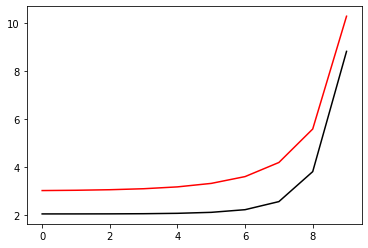

7800 99.00182443870384 8.768742734929969
[2.03918869 2.03967201 2.04178434 2.04798233 2.06405402 2.10508288
 2.21578549 2.55371593 3.80582929 8.82965697]


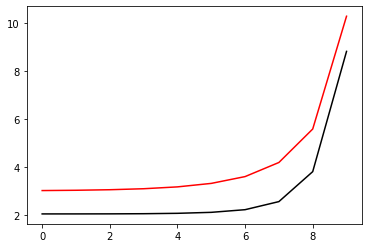

7900 99.0018241183196 8.768544436507861
[2.03921529 2.039699   2.04181219 2.04801176 2.06408603 2.10511861
 2.21582366 2.55373309 3.80562596 8.8291747 ]


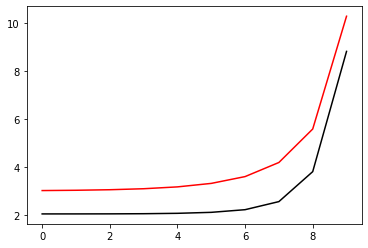

8000 99.00182379803526 8.768346219286464
[2.03924192 2.039726   2.04184006 2.0480412  2.06411806 2.10515434
 2.21586182 2.5537502  3.80542274 8.82869245]


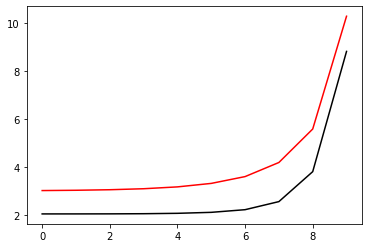

8100 99.00182347785066 8.768148083185773
[2.03926858 2.03975303 2.04186796 2.04807067 2.06415011 2.10519008
 2.21589996 2.55376727 3.80521964 8.82821023]


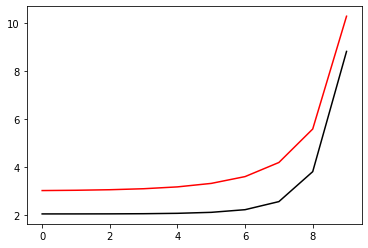

8200 99.00182315776573 8.767950028125933
[2.03929525 2.03978008 2.04189588 2.04810016 2.06418216 2.10522583
 2.21593809 2.55378429 3.80501664 8.82772803]


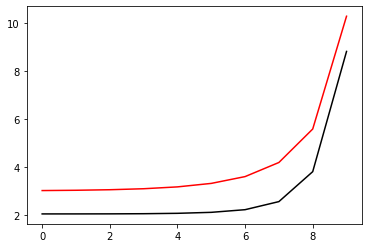

8300 99.00182283778032 8.767752054027204
[2.03932195 2.03980716 2.04192382 2.04812966 2.06421424 2.10526157
 2.2159762  2.55380127 3.80481376 8.82724587]


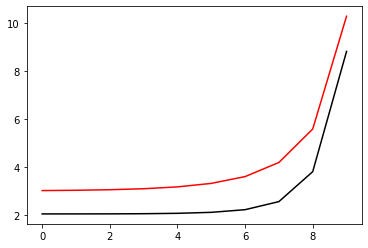

8400 99.00182251789437 8.767554160809944
[2.03934868 2.03983426 2.04195178 2.04815919 2.06424633 2.10529733
 2.21601431 2.55381821 3.80461099 8.82676373]


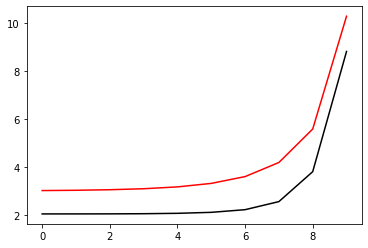

8500 99.00182219810772 8.767356348394639
[2.03937542 2.03986138 2.04197977 2.04818873 2.06427843 2.10533309
 2.2160524  2.5538351  3.80440833 8.82628161]


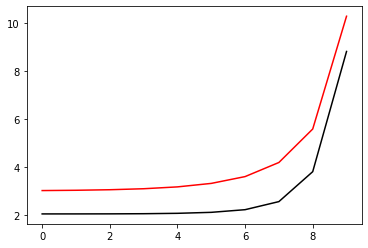

8600 99.00182187842026 8.767158616701888
[2.03940219 2.03988853 2.04200778 2.04821829 2.06431055 2.10536886
 2.21609047 2.55385195 3.80420578 8.82579953]


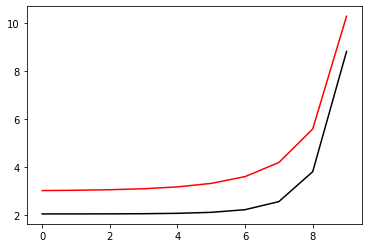

8700 99.0018215588319 8.766960965652453
[2.03942899 2.03991569 2.0420358  2.04824788 2.06434268 2.10540463
 2.21612853 2.55386876 3.80400334 8.82531747]


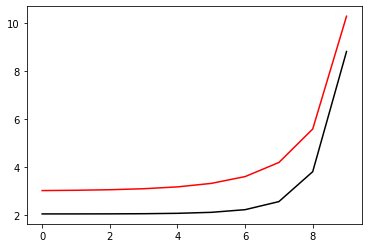

8800 99.00182123934253 8.766763395167153
[2.0394558  2.03994288 2.04206385 2.04827748 2.06437483 2.10544041
 2.21616658 2.55388552 3.80380101 8.82483543]


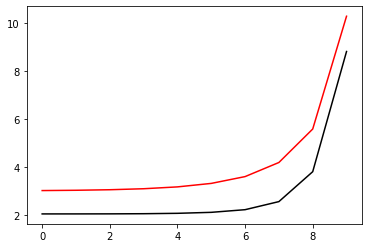

8900 99.00182091995207 8.766565905166962
[2.03948265 2.0399701  2.04209193 2.0483071  2.06440699 2.10547619
 2.21620461 2.55390224 3.8035988  8.82435343]


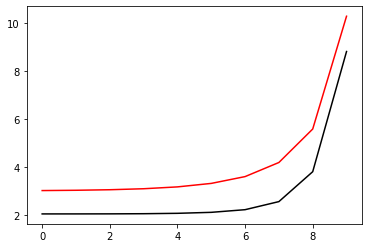

9000 99.00182060066034 8.76636849557296
[2.03950951 2.03999733 2.04212002 2.04833675 2.06443917 2.10551198
 2.21624263 2.55391892 3.80339669 8.82387145]


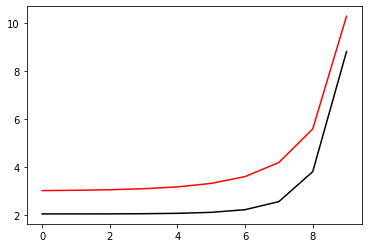

9100 99.00182028146726 8.76617116630634
[2.0395364  2.04002459 2.04214813 2.04836641 2.06447136 2.10554777
 2.21628064 2.55393555 3.8031947  8.8233895 ]


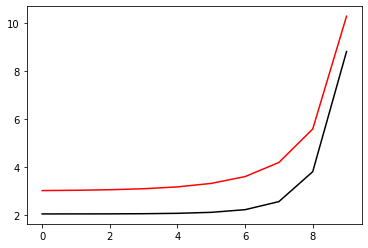

9200 99.00181996237275 8.765973917288427
[2.03956331 2.04005187 2.04217627 2.04839609 2.06450357 2.10558357
 2.21631863 2.55395214 3.80299281 8.82290757]


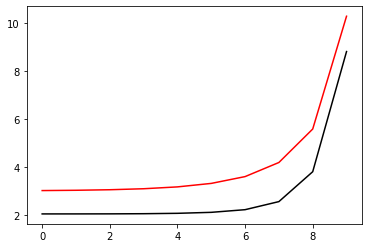

9300 99.00181964337666 8.765776748440652
[2.03959024 2.04007918 2.04220443 2.04842579 2.06453579 2.10561938
 2.21635661 2.55396869 3.80279104 8.82242567]


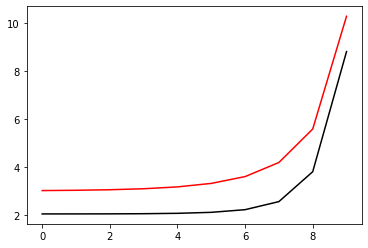

9400 99.00181932447892 8.765579659684562
[2.0396172  2.04010651 2.04223261 2.0484555  2.06456803 2.10565519
 2.21639458 2.55398519 3.80258938 8.8219438 ]


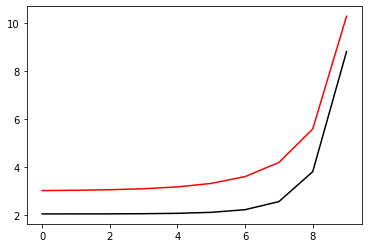

9500 99.0018190056794 8.765382650941833
[2.03964418 2.04013386 2.04226081 2.04848524 2.06460028 2.10569101
 2.21643253 2.55400165 3.80238783 8.82146196]


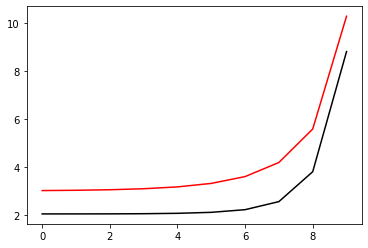

9600 99.00181868697797 8.765185722134248
[2.03967118 2.04016123 2.04228903 2.048515   2.06463254 2.10572683
 2.21647047 2.55401807 3.80218639 8.82098014]


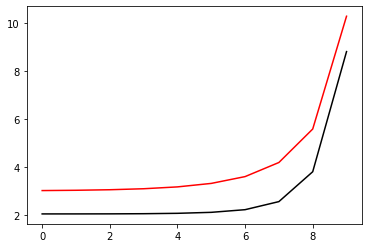

9700 99.00181836837457 8.764988873183716
[2.03969821 2.04018863 2.04231728 2.04854478 2.06466482 2.10576265
 2.2165084  2.55403445 3.80198506 8.82049835]


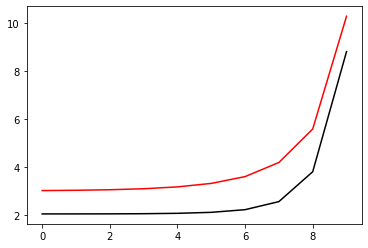

9800 99.00181804986906 8.76479210401225
[2.03972526 2.04021604 2.04234554 2.04857457 2.06469712 2.10579849
 2.21654631 2.55405078 3.80178383 8.82001658]


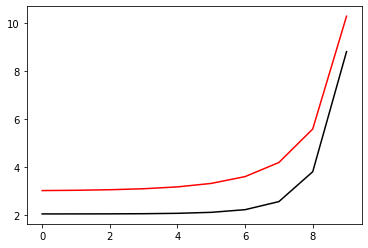

9900 99.00181773146134 8.764595414541976
[2.03975233 2.04024348 2.04237383 2.04860439 2.06472943 2.10583432
 2.21658421 2.55406707 3.80158272 8.81953485]


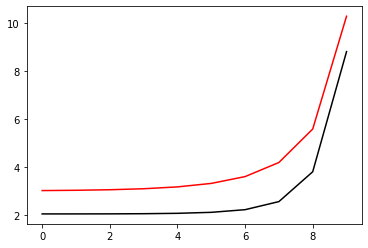

10000 99.0018174131513 8.764398804695137
[2.03977943 2.04027095 2.04240214 2.04863422 2.06476175 2.10587017
 2.21662209 2.55408332 3.80138172 8.81905314]


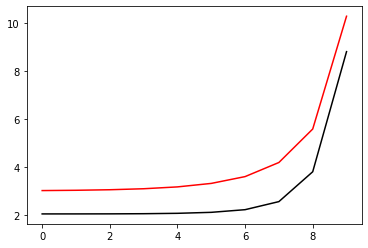

In [77]:
optimizer=tf.optimizers.SGD(learning_rate=0.01)
for i in range (1, 10001):
    run()
    if i%100==0: print(i, Error_func(h, m2_2).numpy(), m2_2.numpy()), print(h.numpy()), plt.plot(h_real, 'r-'), plt.plot(h.numpy(), 'k-'), plt.show()

100 99.00181709493884 8.764202274394108
[2.03980654 2.04029843 2.04243047 2.04866407 2.06479409 2.10590601
 2.21665996 2.55409953 3.80118083 8.81857145]


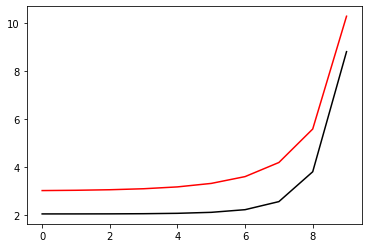

200 99.00181677682386 8.764005823561364
[2.03983369 2.04032594 2.04245882 2.04869394 2.06482644 2.10594187
 2.21669782 2.55411569 3.80098005 8.8180898 ]


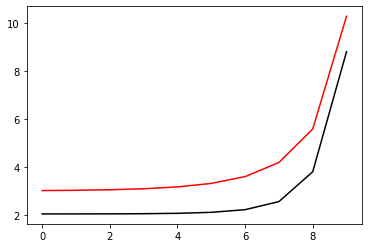

300 99.00181645880623 8.763809452119487
[2.03986085 2.04035347 2.04248719 2.04872383 2.06485881 2.10597773
 2.21673566 2.55413182 3.80077937 8.81760817]


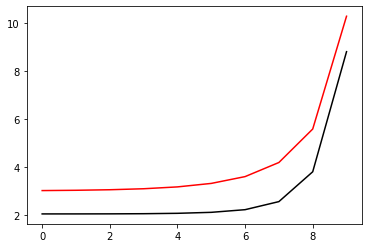

400 99.00181614088585 8.763613159991202
[2.03988804 2.04038103 2.04251559 2.04875374 2.06489119 2.10601359
 2.21677349 2.5541479  3.80057881 8.81712657]


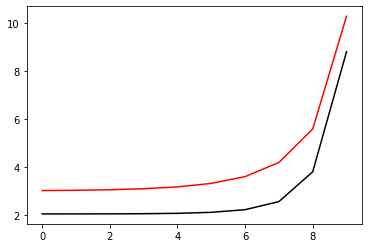

500 99.00181582306263 8.763416947099342
[2.03991525 2.0404086  2.042544   2.04878367 2.06492358 2.10604946
 2.21681131 2.55416393 3.80037836 8.81664499]


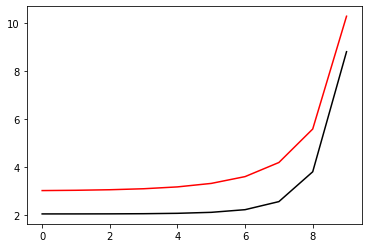

600 99.00181550533645 8.763220813366829
[2.03994248 2.0404362  2.04257244 2.04881362 2.06495599 2.10608533
 2.21684911 2.55417993 3.80017801 8.81616344]


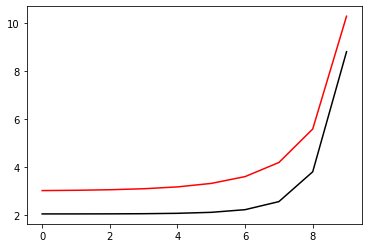

700 99.00181518770721 8.763024758716709
[2.03996974 2.04046382 2.04260089 2.04884358 2.06498842 2.10612121
 2.2168869  2.55419589 3.79997777 8.81568192]


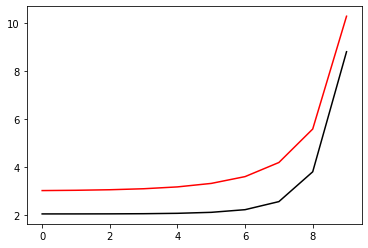

800 99.0018148701748 8.762828783072154
[2.03999702 2.04049146 2.04262937 2.04887357 2.06502086 2.1061571
 2.21692468 2.5542118  3.79977765 8.81520043]


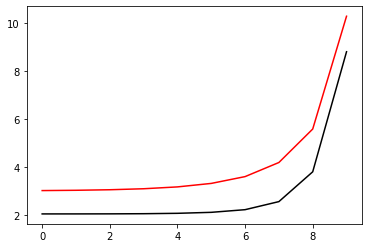

900 99.00181455273912 8.762632886356448
[2.04002432 2.04051913 2.04265787 2.04890357 2.06505331 2.10619299
 2.21696244 2.55422767 3.79957763 8.81471896]


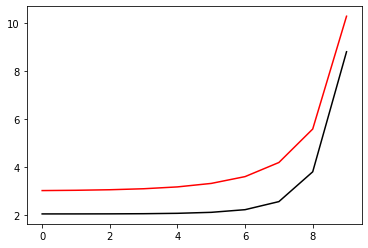

1000 99.00181423540005 8.762437068492972
[2.04005164 2.04054682 2.04268639 2.04893359 2.06508578 2.10622888
 2.21700019 2.5542435  3.79937772 8.81423752]


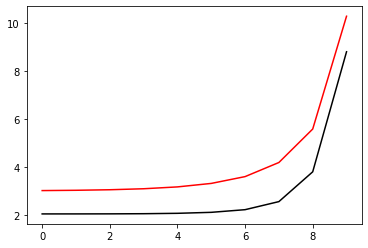

1100 99.00181391815751 8.762241329405239
[2.04007899 2.04057453 2.04271494 2.04896364 2.06511826 2.10626478
 2.21703793 2.55425929 3.79917792 8.81375611]


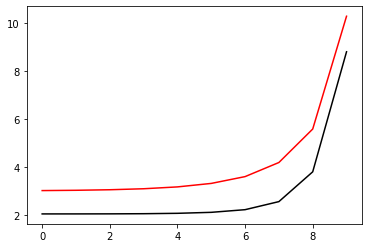

1200 99.00181360101139 8.762045669016857
[2.04010636 2.04060226 2.0427435  2.0489937  2.06515075 2.10630068
 2.21707565 2.55427504 3.79897823 8.81327472]


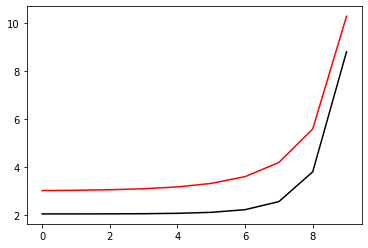

1300 99.00181328396157 8.761850087251561
[2.04013375 2.04063001 2.04277208 2.04902377 2.06518326 2.10633659
 2.21711335 2.55429075 3.79877864 8.81279336]


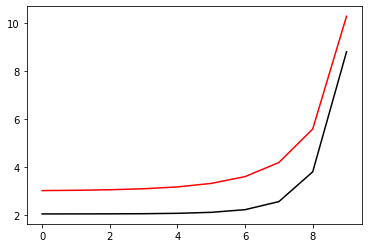

1400 99.00181296700795 8.761654584033192
[2.04016117 2.04065779 2.04280069 2.04905387 2.06521578 2.10637251
 2.21715105 2.55430641 3.79857916 8.81231203]


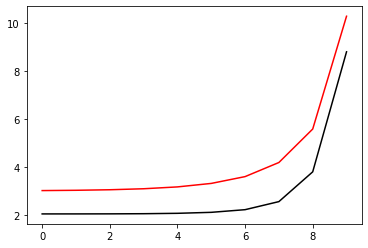

1500 99.00181265015044 8.761459159285701
[2.0401886  2.04068559 2.04282931 2.04908399 2.06524832 2.10640843
 2.21718873 2.55432204 3.7983798  8.81183073]


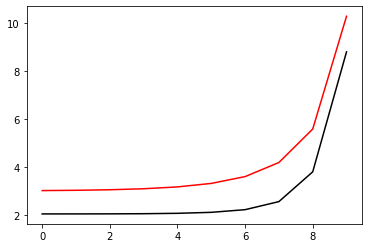

1600 99.00181233338891 8.761263812933153
[2.04021606 2.04071341 2.04285796 2.04911412 2.06528087 2.10644435
 2.2172264  2.55433762 3.79818054 8.81134945]


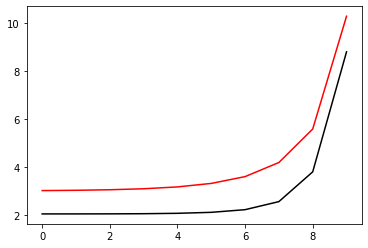

1700 99.00181201672329 8.761068544899732
[2.04024355 2.04074125 2.04288663 2.04914427 2.06531344 2.10648028
 2.21726405 2.55435316 3.79798138 8.8108682 ]


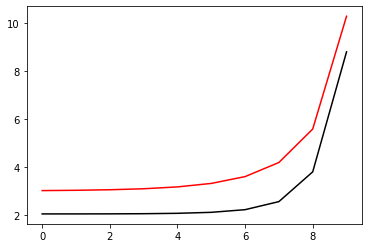

1800 99.00181170015345 8.76087335510973
[2.04027105 2.04076911 2.04291532 2.04917445 2.06534602 2.10651622
 2.21730169 2.55436866 3.79778234 8.81038697]


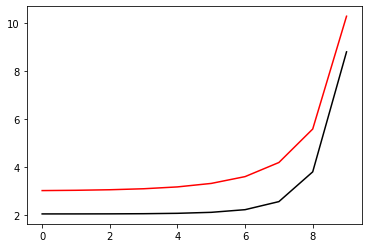

1900 99.0018113836793 8.760678243487545
[2.04029858 2.040797   2.04294403 2.04920464 2.06537861 2.10655215
 2.21733932 2.55438412 3.7975834  8.80990578]


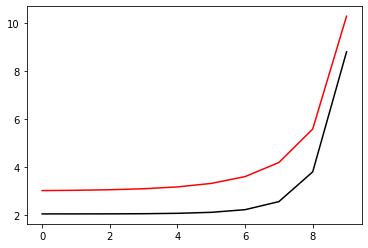

2000 99.00181106730074 8.760483209957664
[2.04032613 2.04082491 2.04297276 2.04923484 2.06541122 2.1065881
 2.21737693 2.55439954 3.79738457 8.80942461]


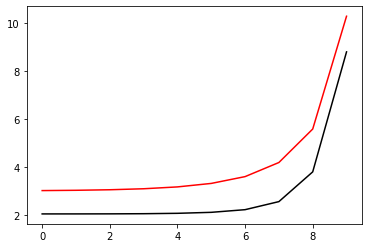

2100 99.00181075101767 8.76028825444475
[2.0403537  2.04085284 2.04300151 2.04926507 2.06544384 2.10662405
 2.21741453 2.55441492 3.79718585 8.80894346]


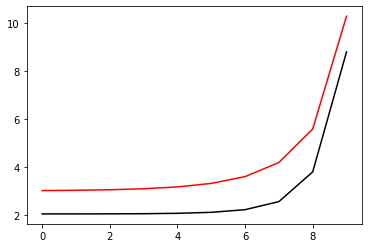

2200 99.00181043482998 8.760093376873522
[2.0403813  2.04088079 2.04303028 2.04929532 2.06547647 2.10666
 2.21745211 2.55443026 3.79698724 8.80846235]


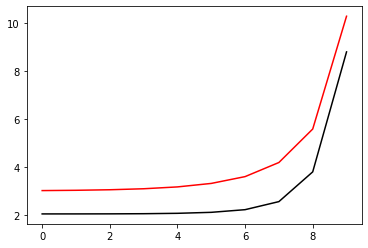

2300 99.00181011873754 8.759898577168812
[2.04040892 2.04090877 2.04305908 2.04932558 2.06550912 2.10669596
 2.21748969 2.55444556 3.79678873 8.80798126]


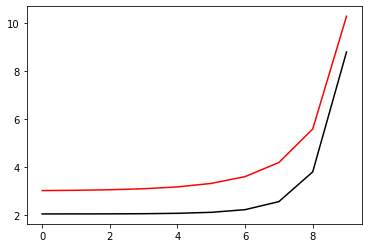

2400 99.00180980274028 8.759703855255585
[2.04043656 2.04093676 2.04308789 2.04935586 2.06554179 2.10673192
 2.21752725 2.55446082 3.79659033 8.8075002 ]


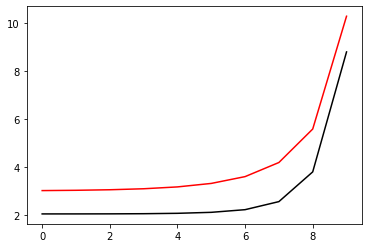

2500 99.00180948683811 8.759509211058887
[2.04046422 2.04096478 2.04311672 2.04938616 2.06557446 2.10676789
 2.21756479 2.55447604 3.79639204 8.80701917]


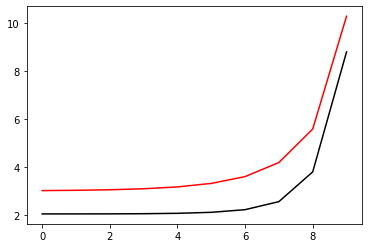

2600 99.00180917103091 8.759314644503915
[2.0404919  2.04099282 2.04314558 2.04941648 2.06560715 2.10680386
 2.21760232 2.55449122 3.79619385 8.80653816]


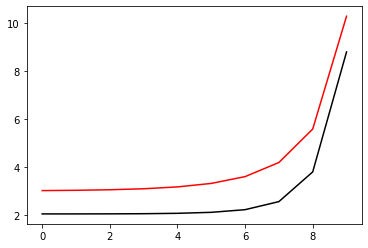

2700 99.00180885531859 8.759120155515943
[2.04051961 2.04102088 2.04317445 2.04944682 2.06563986 2.10683984
 2.21763984 2.55450636 3.79599577 8.80605718]


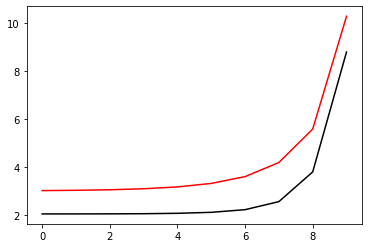

2800 99.00180853970102 8.758925744020354
[2.04054734 2.04104897 2.04320335 2.04947717 2.06567257 2.10687582
 2.21767734 2.55452146 3.7957978  8.80557623]


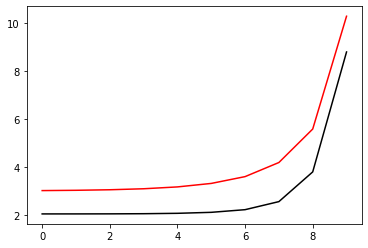

2900 99.00180822417812 8.758731409942662
[2.04057509 2.04107707 2.04323227 2.04950755 2.06570531 2.10691181
 2.21771483 2.55453652 3.79559994 8.8050953 ]


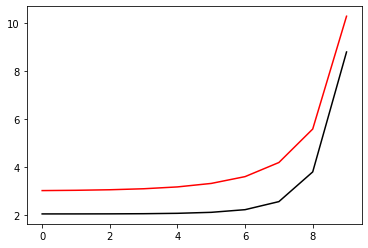

3000 99.0018079087498 8.758537153208463
[2.04060286 2.0411052  2.0432612  2.04953794 2.06573805 2.1069478
 2.21775231 2.55455154 3.79540218 8.8046144 ]


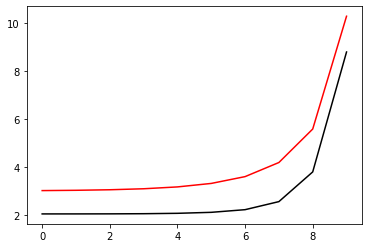

3100 99.00180759341593 8.758342973743483
[2.04063066 2.04113335 2.04329016 2.04956835 2.06577081 2.10698379
 2.21778977 2.55456651 3.79520452 8.80413353]


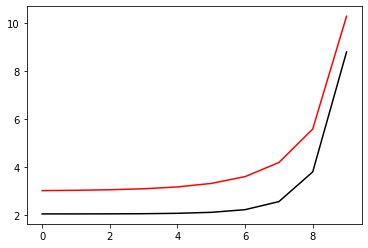

3200 99.00180727817644 8.758148871473548
[2.04065847 2.04116152 2.04331914 2.04959878 2.06580358 2.10701979
 2.21782722 2.55458145 3.79500698 8.80365269]


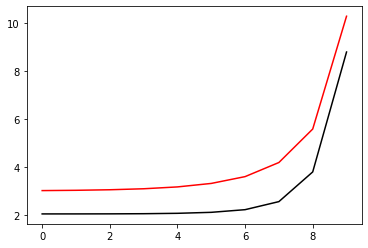

3300 99.00180696303121 8.75795484632458
[2.04068631 2.04118971 2.04334814 2.04962922 2.06583637 2.1070558
 2.21786466 2.55459636 3.79480954 8.80317187]


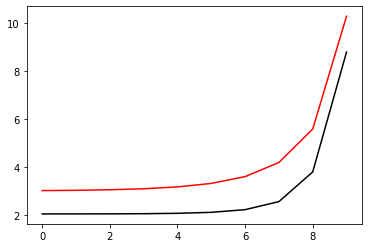

3400 99.00180664798016 8.75776089822264
[2.04071418 2.04121792 2.04337716 2.04965969 2.06586917 2.10709181
 2.21790208 2.55461122 3.7946122  8.80269108]


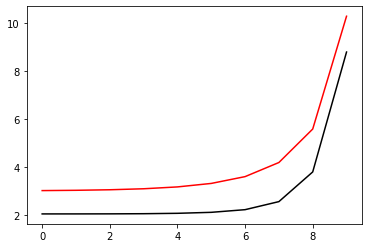

3500 99.00180633302318 8.757567027093868
[2.04074206 2.04124616 2.0434062  2.04969017 2.06590198 2.10712782
 2.21793949 2.55462604 3.79441497 8.80221032]


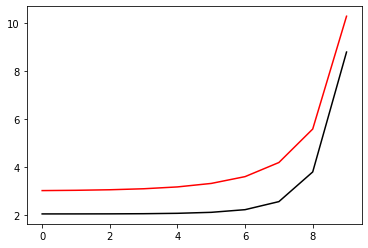

3600 99.00180601816015 8.757373232864525
[2.04076996 2.04127441 2.04343526 2.04972067 2.06593481 2.10716384
 2.21797689 2.55464082 3.79421785 8.80172959]


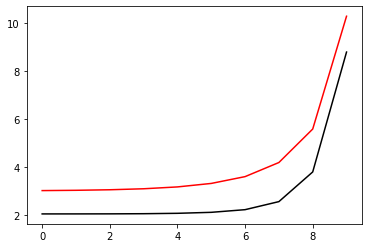

3700 99.001805703391 8.757179515460976
[2.04079789 2.04130269 2.04346434 2.04975119 2.06596765 2.10719986
 2.21801427 2.55465556 3.79402083 8.80124888]


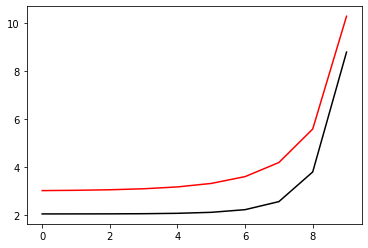

3800 99.00180538871562 8.75698587480969
[2.04082584 2.04133099 2.04349344 2.04978173 2.0660005  2.10723589
 2.21805164 2.55467027 3.79382392 8.8007682 ]


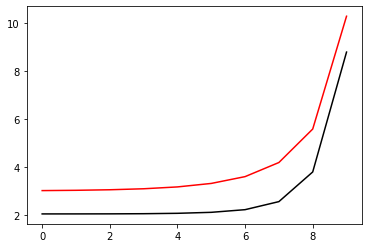

3900 99.00180507413391 8.75679231083725
[2.04085381 2.04135931 2.04352256 2.04981228 2.06603337 2.10727192
 2.21808899 2.55468493 3.79362712 8.80028755]


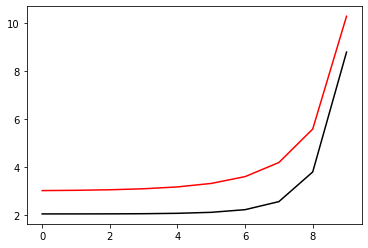

4000 99.0018047596458 8.756598823470343
[2.04088181 2.04138765 2.0435517  2.04984285 2.06606625 2.10730795
 2.21812634 2.55469956 3.79343042 8.79980692]


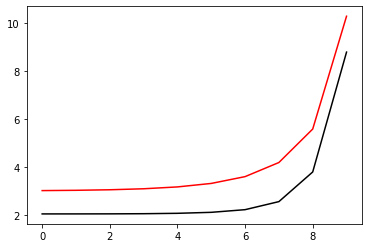

4100 99.00180444525112 8.756405412635765
[2.04090982 2.04141602 2.04358086 2.04987344 2.06609914 2.10734399
 2.21816366 2.55471414 3.79323382 8.79932632]


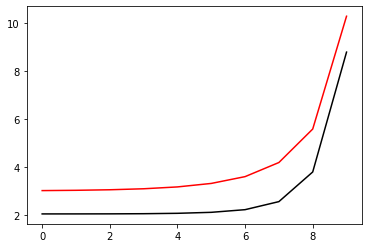

4200 99.00180413094984 8.756212078260406
[2.04093786 2.0414444  2.04361004 2.04990405 2.06613205 2.10738004
 2.21820098 2.55472869 3.79303733 8.79884575]


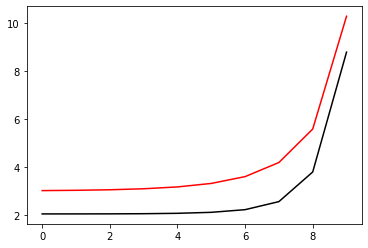

4300 99.00180381674184 8.756018820271267
[2.04096592 2.04147281 2.04363924 2.04993468 2.06616497 2.10741609
 2.21823828 2.5547432  3.79284095 8.79836521]


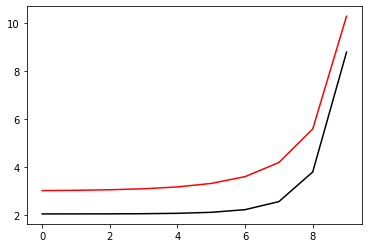

4400 99.00180350262701 8.755825638595466
[2.040994   2.04150124 2.04366847 2.04996532 2.0661979  2.10745214
 2.21827557 2.55475767 3.79264467 8.79788469]


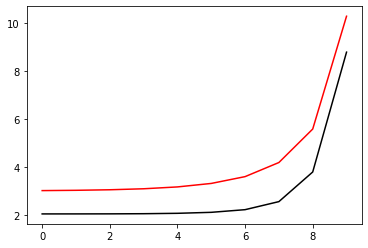

4500 99.00180318860527 8.755632533160215
[2.0410221  2.04152969 2.04369771 2.04999598 2.06623085 2.1074882
 2.21831284 2.55477211 3.79244849 8.7974042 ]


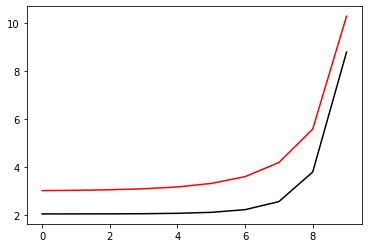

4600 99.00180287467653 8.755439503892843
[2.04105022 2.04155816 2.04372697 2.05002666 2.06626381 2.10752426
 2.2183501  2.5547865  3.79225242 8.79692374]


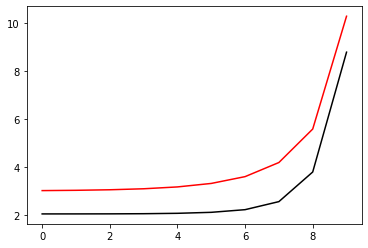

4700 99.00180256084066 8.755246550720761
[2.04107837 2.04158665 2.04375625 2.05005736 2.06629678 2.10756033
 2.21838735 2.55480086 3.79205646 8.7964433 ]


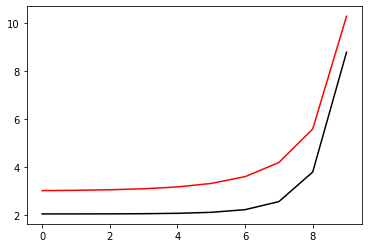

4800 99.00180224709759 8.755053673571506
[2.04110654 2.04161516 2.04378556 2.05008807 2.06632977 2.1075964
 2.21842458 2.55481517 3.7918606  8.79596289]


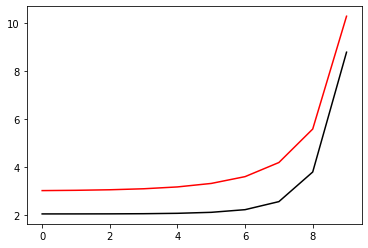

4900 99.00180193344721 8.754860872372726
[2.04113473 2.0416437  2.04381488 2.05011881 2.06636276 2.10763247
 2.2184618  2.55482945 3.79166484 8.79548251]


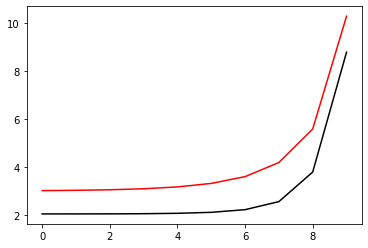

5000 99.00180161988943 8.754668147052143
[2.04116294 2.04167225 2.04384422 2.05014956 2.06639578 2.10766855
 2.21849901 2.55484369 3.79146919 8.79500216]


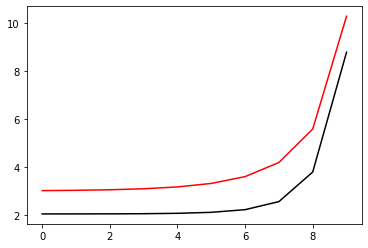

5100 99.00180130642416 8.754475497537626
[2.04119117 2.04170083 2.04387358 2.05018032 2.0664288  2.10770463
 2.2185362  2.5548579  3.79127364 8.79452184]


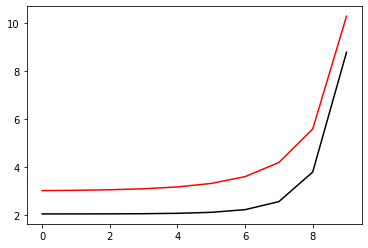

5200 99.00180099305129 8.754282923757108
[2.04121942 2.04172942 2.04390296 2.05021111 2.06646184 2.10774072
 2.21857338 2.55487206 3.7910782  8.79404154]


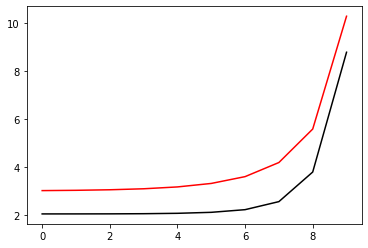

5300 99.00180067977074 8.754090425638653
[2.0412477  2.04175804 2.04393237 2.05024191 2.06649489 2.10777681
 2.21861055 2.55488619 3.79088286 8.79356127]


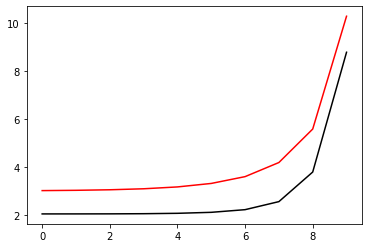

5400 99.00180036658239 8.753898003110399
[2.04127599 2.04178668 2.04396179 2.05027273 2.06652796 2.10781291
 2.2186477  2.55490028 3.79068763 8.79308102]


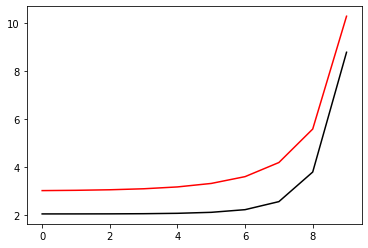

5500 99.00180005348618 8.75370565610062
[2.04130431 2.04181534 2.04399123 2.05030357 2.06656104 2.10784901
 2.21868484 2.55491433 3.79049249 8.79260081]


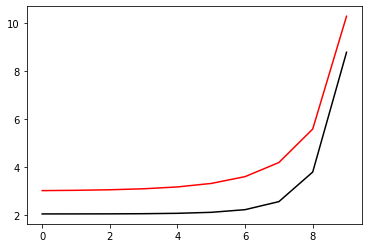

5600 99.00179974048197 8.75351338453768
[2.04133265 2.04184402 2.04402069 2.05033443 2.06659413 2.10788511
 2.21872196 2.55492834 3.79029747 8.79212062]


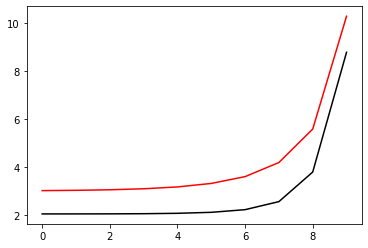

5700 99.00179942756971 8.753321188350048
[2.04136101 2.04187272 2.04405017 2.0503653  2.06662723 2.10792122
 2.21875907 2.55494232 3.79010254 8.79164046]


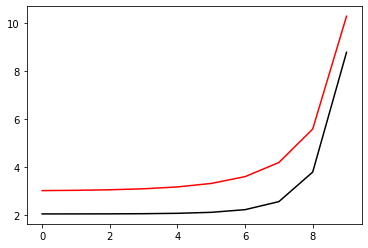

5800 99.00179911474928 8.753129067466295
[2.04138939 2.04190145 2.04407967 2.05039619 2.06666035 2.10795733
 2.21879617 2.55495626 3.78990772 8.79116032]


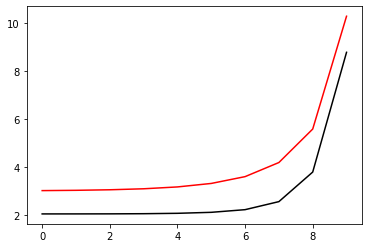

5900 99.00179880202059 8.752937021815086
[2.0414178  2.04193019 2.0441092  2.0504271  2.06669348 2.10799344
 2.21883326 2.55497016 3.789713   8.79068022]


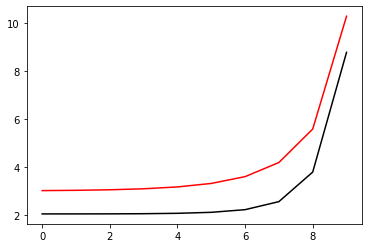

6000 99.00179848938355 8.752745051325197
[2.04144622 2.04195896 2.04413874 2.05045802 2.06672662 2.10802956
 2.21887033 2.55498402 3.78951839 8.79020014]


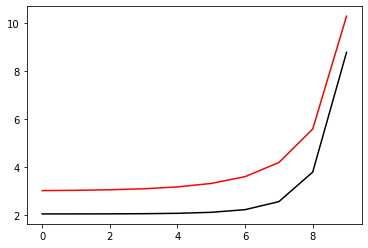

6100 99.00179817683804 8.752553155925497
[2.04147467 2.04198774 2.0441683  2.05048897 2.06675978 2.10806569
 2.21890739 2.55499785 3.78932388 8.78972008]


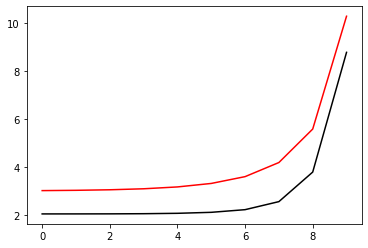

6200 99.001797864384 8.752361335545002
[2.04150314 2.04201655 2.04419788 2.05051993 2.06679294 2.10810182
 2.21894443 2.55501164 3.78912947 8.78924006]


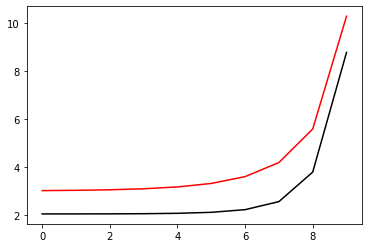

6300 99.00179755202132 8.752169590112754
[2.04153163 2.04204538 2.04422748 2.0505509  2.06682613 2.10813795
 2.21898146 2.55502539 3.78893517 8.78876006]


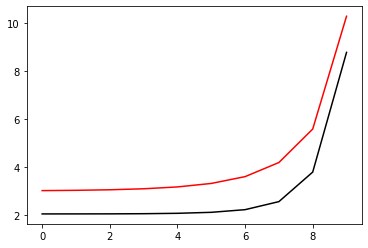

6400 99.00179723974992 8.751977919557959
[2.04156014 2.04207422 2.0442571  2.0505819  2.06685932 2.10817408
 2.21901848 2.55503911 3.78874097 8.78828009]


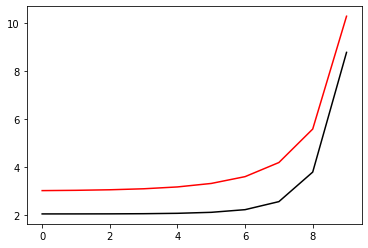

6500 99.00179692756967 8.751786323809892
[2.04158867 2.04210309 2.04428673 2.05061291 2.06689253 2.10821022
 2.21905549 2.55505278 3.78854687 8.78780015]


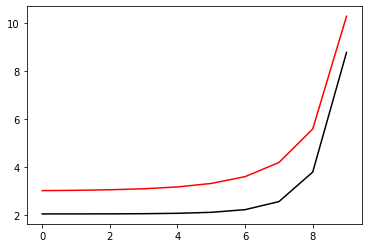

6600 99.00179661548054 8.751594802797934
[2.04161722 2.04213198 2.04431639 2.05064394 2.06692575 2.10824637
 2.21909248 2.55506643 3.78835287 8.78732024]


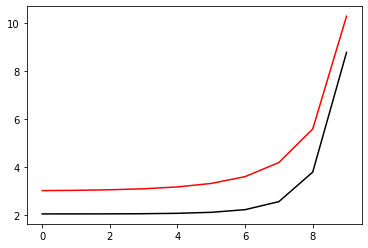

6700 99.00179630348238 8.751403356451597
[2.04164579 2.04216089 2.04434607 2.05067499 2.06695898 2.10828251
 2.21912945 2.55508003 3.78815898 8.78684035]


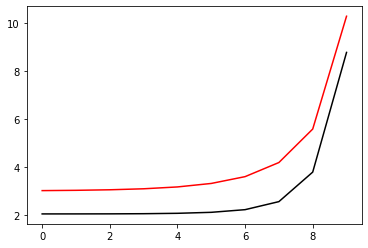

6800 99.00179599157511 8.751211984700445
[2.04167439 2.04218982 2.04437577 2.05070605 2.06699222 2.10831866
 2.21916642 2.5550936  3.78796519 8.78636049]


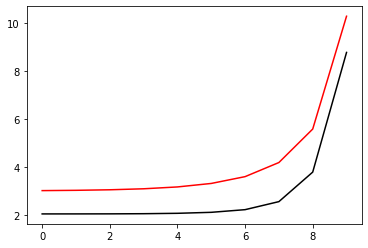

6900 99.00179567975864 8.751020687474181
[2.041703   2.04221877 2.04440548 2.05073713 2.06702548 2.10835482
 2.21920337 2.55510713 3.7877715  8.78588066]


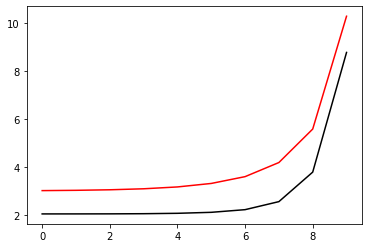

7000 99.0017953680329 8.75082946470258
[2.04173164 2.04224775 2.04443522 2.05076823 2.06705875 2.10839098
 2.2192403  2.55512062 3.78757791 8.78540085]


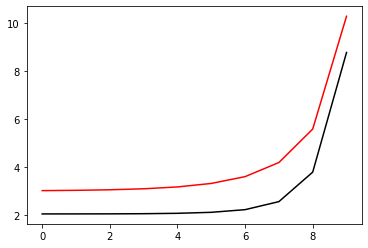

7100 99.00179505639777 8.750638316315536
[2.0417603  2.04227674 2.04446498 2.05079934 2.06709203 2.10842714
 2.21927723 2.55513408 3.78738443 8.78492107]


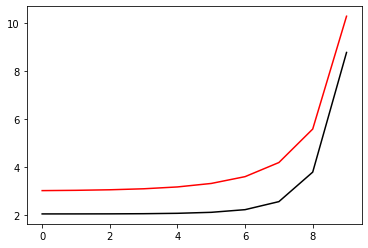

7200 99.00179474485316 8.750447242243059
[2.04178897 2.04230575 2.04449475 2.05083048 2.06712533 2.10846331
 2.21931414 2.5551475  3.78719105 8.78444132]


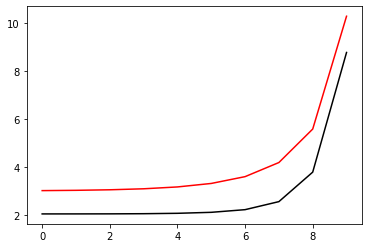

7300 99.001794433399 8.750256242415217
[2.04181767 2.04233479 2.04452455 2.05086162 2.06715864 2.10849948
 2.21935104 2.55516089 3.78699777 8.7839616 ]


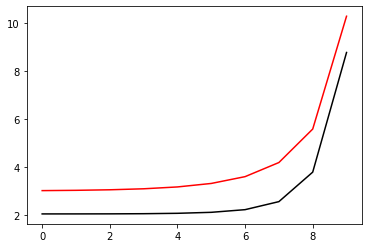

7400 99.00179412203516 8.750065316762207
[2.04184639 2.04236384 2.04455436 2.05089279 2.06719196 2.10853565
 2.21938792 2.55517424 3.78680459 8.78348191]


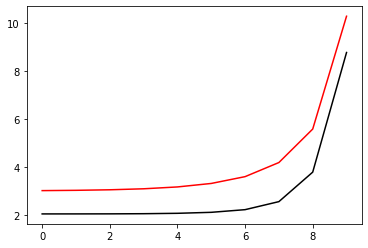

7500 99.0017938107616 8.749874465214331
[2.04187513 2.04239291 2.04458419 2.05092397 2.06722529 2.10857183
 2.21942479 2.55518755 3.78661152 8.78300224]


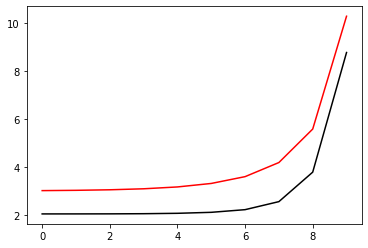

7600 99.00179349957818 8.74968368770195
[2.0419039  2.04242201 2.04461405 2.05095517 2.06725864 2.10860801
 2.21946165 2.55520083 3.78641854 8.7825226 ]


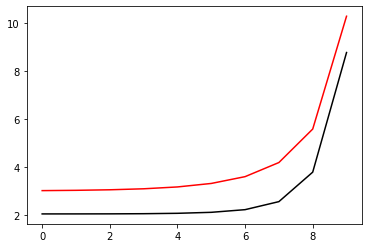

7700 99.00179318848484 8.749492984155584
[2.04193268 2.04245112 2.04464392 2.05098639 2.06729199 2.10864419
 2.21949849 2.55521407 3.78622567 8.78204299]


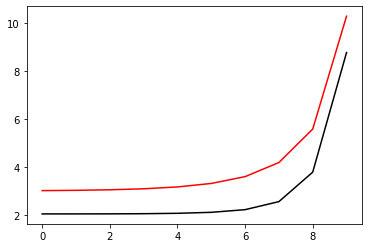

7800 99.00179287748146 8.749302354505796
[2.04196148 2.04248026 2.04467381 2.05101762 2.06732536 2.10868038
 2.21953532 2.55522727 3.7860329  8.7815634 ]


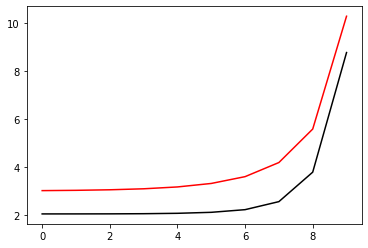

7900 99.001792566568 8.749111798683286
[2.04199031 2.04250941 2.04470372 2.05104888 2.06735875 2.10871657
 2.21957214 2.55524044 3.78584023 8.78108385]


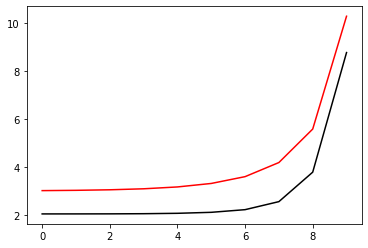

8000 99.00179225574429 8.74892131661884
[2.04201915 2.04253859 2.04473365 2.05108014 2.06739214 2.10875277
 2.21960894 2.55525357 3.78564766 8.78060432]


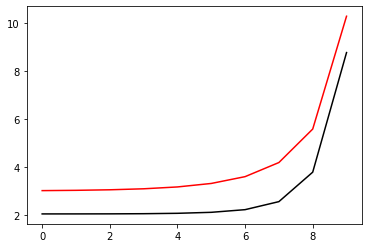

8100 99.00179194501032 8.748730908243328
[2.04204802 2.04256779 2.04476359 2.05111143 2.06742555 2.10878897
 2.21964573 2.55526667 3.78545519 8.78012481]


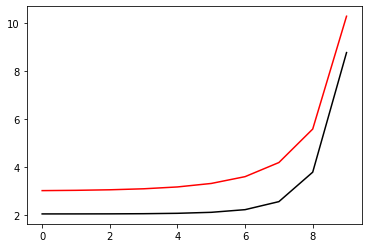

8200 99.00179163436594 8.74854057348773
[2.04207691 2.042597   2.04479356 2.05114273 2.06745897 2.10882517
 2.2196825  2.55527973 3.78526282 8.77964534]


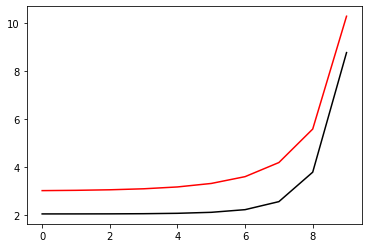

8300 99.00179132381112 8.748350312283144
[2.04210581 2.04262624 2.04482355 2.05117405 2.0674924  2.10886138
 2.21971927 2.55529276 3.78507056 8.77916589]


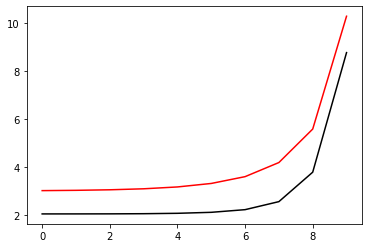

8400 99.00179101334571 8.748160124560744
[2.04213474 2.0426555  2.04485355 2.05120538 2.06752585 2.10889759
 2.21975602 2.55530575 3.7848784  8.77868647]


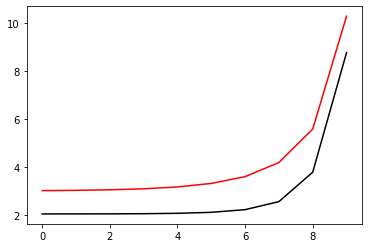

8500 99.00179070296966 8.747970010251798
[2.04216369 2.04268477 2.04488358 2.05123673 2.0675593  2.1089338
 2.21979275 2.5553187  3.78468633 8.77820708]


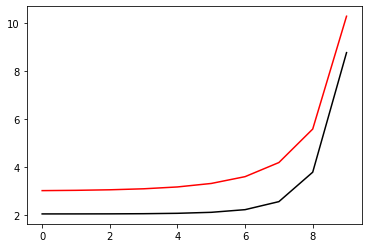

8600 99.00179039268285 8.747779969287672
[2.04219266 2.04271407 2.04491362 2.0512681  2.06759277 2.10897002
 2.21982948 2.55533162 3.78449437 8.77772772]


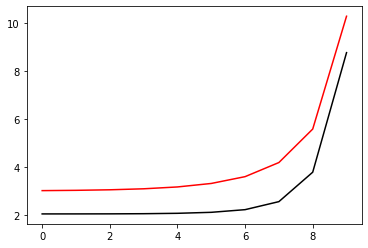

8700 99.00179008248521 8.747590001599846
[2.04222165 2.04274339 2.04494369 2.05129949 2.06762626 2.10900624
 2.21986619 2.55534451 3.78430251 8.77724838]


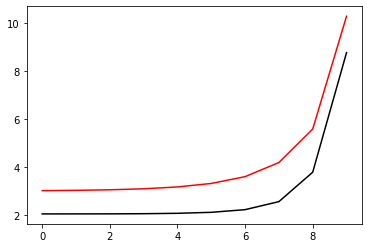

8800 99.00178977237665 8.74740010711989
[2.04225066 2.04277273 2.04497377 2.05133089 2.06765975 2.10904247
 2.21990288 2.55535735 3.78411074 8.77676907]


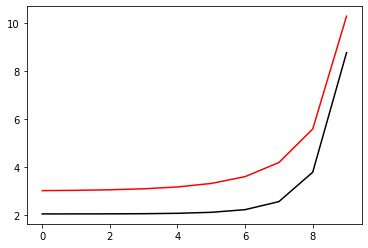

8900 99.0017894623571 8.74721028577945
[2.04227969 2.04280208 2.04500387 2.05136231 2.06769325 2.1090787
 2.21993957 2.55537017 3.78391908 8.77628979]


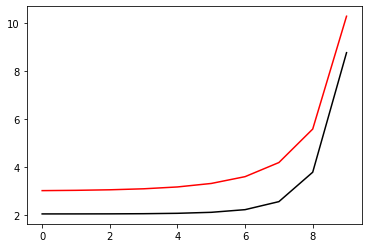

9000 99.00178915242643 8.747020537510316
[2.04230874 2.04283146 2.04503399 2.05139374 2.06772677 2.10911493
 2.21997624 2.55538295 3.78372752 8.77581054]


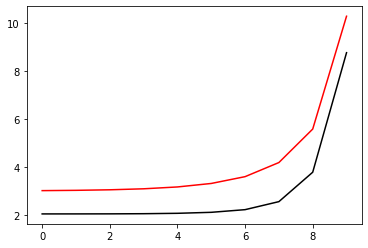

9100 99.00178884258456 8.746830862244321
[2.04233781 2.04286086 2.04506412 2.05142519 2.0677603  2.10915116
 2.22001289 2.55539569 3.78353606 8.77533131]


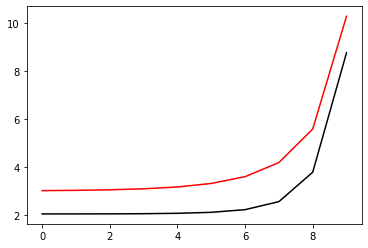

9200 99.00178853283143 8.746641259913423
[2.04236691 2.04289028 2.04509428 2.05145666 2.06779384 2.1091874
 2.22004953 2.5554084  3.7833447  8.77485211]


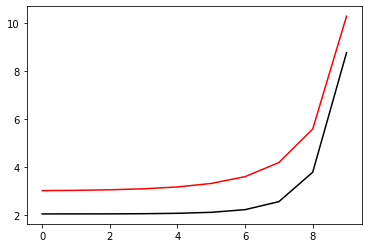

9300 99.00178822316694 8.746451730449674
[2.04239602 2.04291971 2.04512446 2.05148815 2.0678274  2.10922364
 2.22008616 2.55542107 3.78315344 8.77437294]


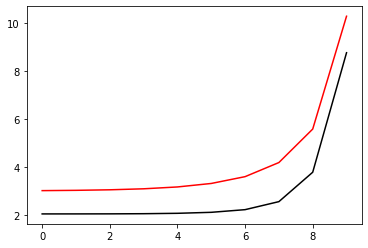

9400 99.00178791359097 8.746262273785224
[2.04242515 2.04294917 2.04515465 2.05151965 2.06786097 2.10925989
 2.22012278 2.55543371 3.78296228 8.7738938 ]


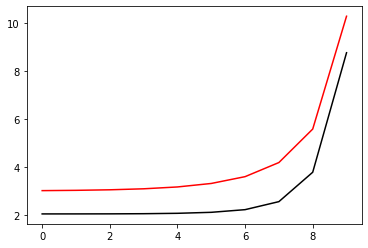

9500 99.00178760410347 8.746072889852305
[2.0424543  2.04297865 2.04518487 2.05155117 2.06789454 2.10929614
 2.22015938 2.55544632 3.78277122 8.77341468]


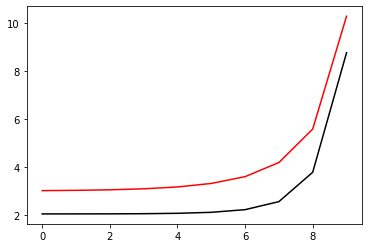

9600 99.00178729470437 8.745883578583259
[2.04248348 2.04300815 2.0452151  2.0515827  2.06792813 2.10933239
 2.22019597 2.55545889 3.78258026 8.77293559]


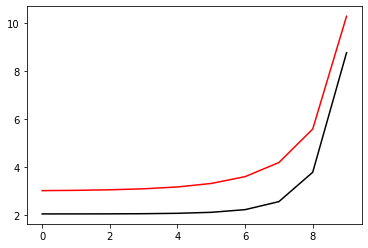

9700 99.00178698539352 8.745694339910512
[2.04251267 2.04303766 2.04524535 2.05161425 2.06796174 2.10936864
 2.22023255 2.55547142 3.78238939 8.77245653]


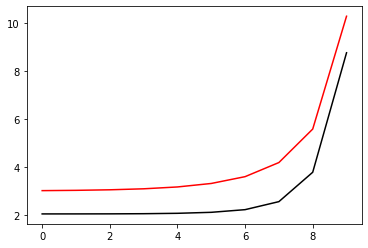

9800 99.00178667617088 8.745505173766599
[2.04254189 2.0430672  2.04527562 2.05164582 2.06799535 2.1094049
 2.22026911 2.55548392 3.78219863 8.7719775 ]


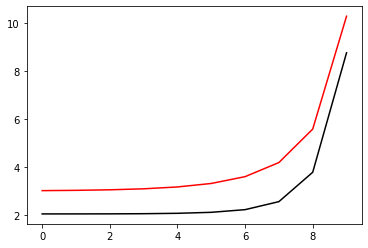

9900 99.00178636703635 8.74531608008415
[2.04257112 2.04309676 2.04530591 2.0516774  2.06802898 2.10944116
 2.22030566 2.55549639 3.78200797 8.77149849]


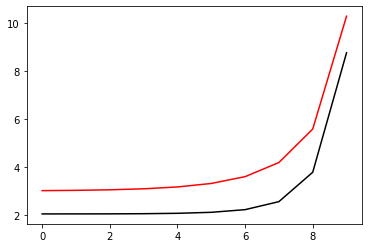

10000 99.00178605798982 8.745127058795877
[2.04260037 2.04312633 2.04533621 2.051709   2.06806262 2.10947743
 2.2203422  2.55550882 3.7818174  8.77101952]


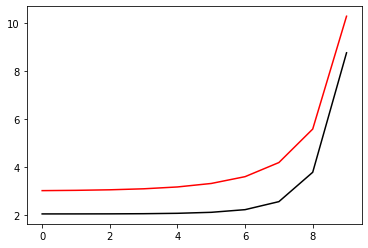

In [78]:
optimizer=tf.optimizers.SGD(learning_rate=0.01)
for i in range (1, 10001):
    run()
    if i%100==0: print(i, Error_func(h, m2_2).numpy(), m2_2.numpy()), print(h.numpy()), plt.plot(h_real, 'r-'), plt.plot(h.numpy(), 'k-'), plt.show()

100 99.00178574903126 8.744938109834589
[2.04262965 2.04315593 2.04536654 2.05174062 2.06809627 2.1095137
 2.22037873 2.55552122 3.78162694 8.77054057]


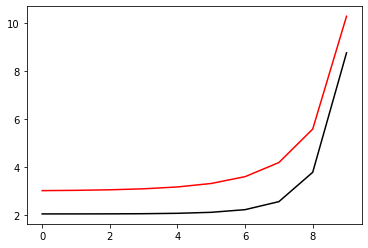

200 99.00178544016053 8.744749233133188
[2.04265894 2.04318555 2.04539688 2.05177225 2.06812993 2.10954997
 2.22041524 2.55553358 3.78143657 8.77006164]


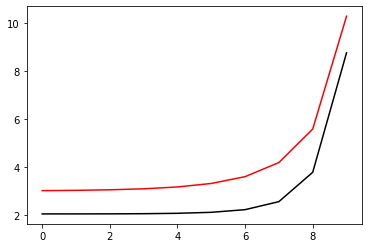

300 99.00178513137756 8.744560428624695
[2.04268826 2.04321518 2.04542725 2.0518039  2.0681636  2.10958624
 2.22045173 2.55554591 3.78124631 8.76958275]


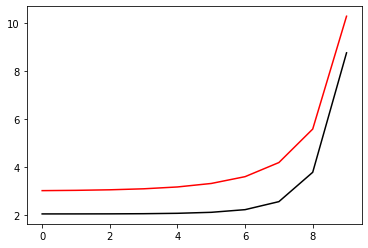

400 99.00178482268227 8.744371696242196
[2.04271759 2.04324484 2.04545763 2.05183556 2.06819729 2.10962252
 2.22048822 2.5555582  3.78105614 8.76910388]


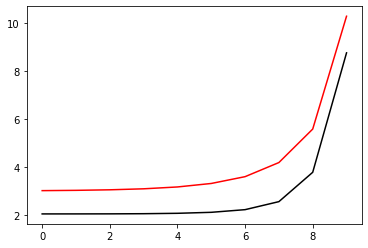

500 99.00178451407456 8.744183035918876
[2.04274695 2.04327451 2.04548803 2.05186724 2.06823099 2.1096588
 2.22052469 2.55557046 3.78086607 8.76862505]


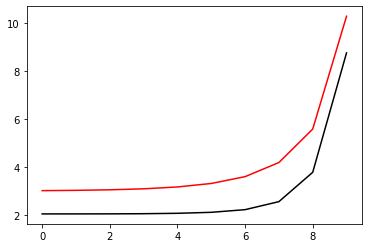

600 99.00178420555436 8.743994447588019
[2.04277632 2.04330421 2.04551844 2.05189894 2.0682647  2.10969509
 2.22056115 2.55558269 3.7806761  8.76814623]


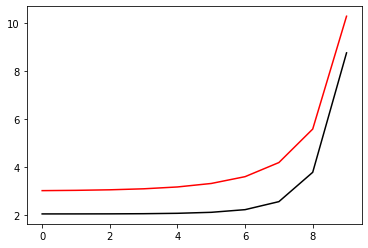

700 99.00178389712158 8.743805931182992
[2.04280572 2.04333392 2.04554888 2.05193065 2.06829842 2.10973138
 2.22059759 2.55559488 3.78048623 8.76766745]


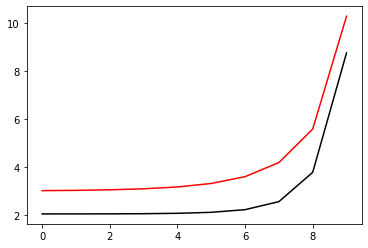

800 99.00178358877615 8.743617486637271
[2.04283513 2.04336365 2.04557934 2.05196238 2.06833215 2.10976767
 2.22063402 2.55560704 3.78029646 8.76718869]


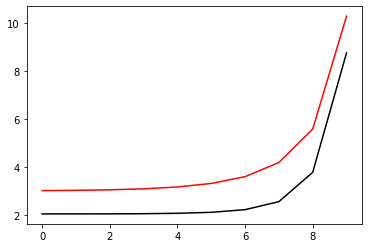

900 99.00178328051794 8.743429113884423
[2.04286457 2.04339341 2.04560981 2.05199413 2.06836589 2.10980396
 2.22067044 2.55561917 3.78010678 8.76670997]


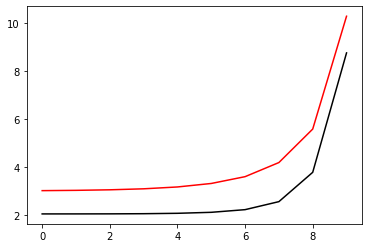

1000 99.00178297234689 8.743240812858126
[2.04289402 2.04342318 2.0456403  2.05202589 2.06839965 2.10984026
 2.22070684 2.55563126 3.77991721 8.76623127]


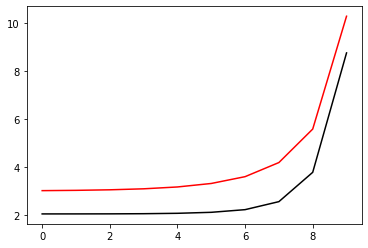

1100 99.00178266426293 8.743052583492108
[2.0429235  2.04345297 2.04567081 2.05205767 2.06843342 2.10987656
 2.22074323 2.55564332 3.77972773 8.76575259]


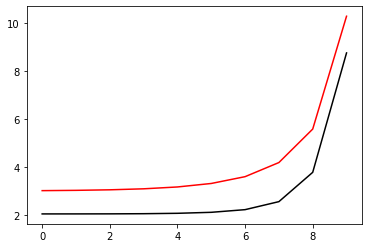

1200 99.00178235626596 8.742864425720214
[2.04295299 2.04348278 2.04570134 2.05208946 2.0684672  2.10991286
 2.22077961 2.55565534 3.77953835 8.76527395]


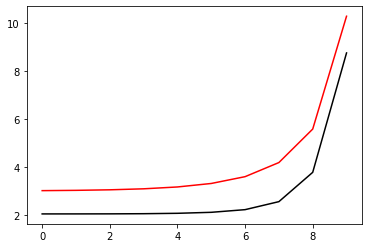

1300 99.0017820483559 8.742676339476366
[2.04298251 2.04351261 2.04573189 2.05212127 2.06850099 2.10994917
 2.22081598 2.55566733 3.77934907 8.76479533]


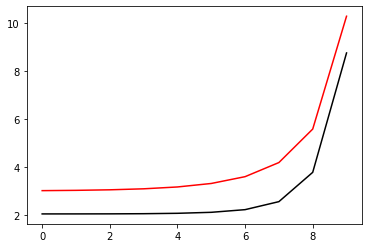

1400 99.00178174053266 8.742488324694621
[2.04301204 2.04354246 2.04576245 2.0521531  2.06853479 2.10998548
 2.22085233 2.55567929 3.77915988 8.76431674]


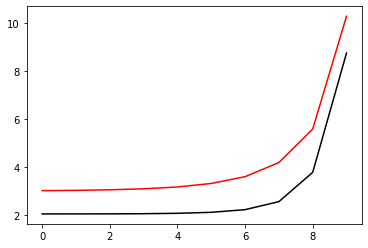

1500 99.00178143279616 8.742300381309079
[2.0430416  2.04357233 2.04579304 2.05218494 2.06856861 2.11002179
 2.22088867 2.55569122 3.7789708  8.76383818]


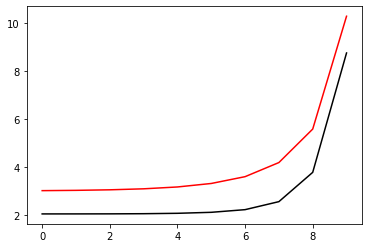

1600 99.00178112514631 8.742112509253957
[2.04307117 2.04360222 2.04582364 2.0522168  2.06860243 2.11005811
 2.22092499 2.55570311 3.77878181 8.76335965]


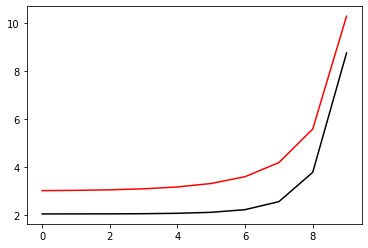

1700 99.00178081758303 8.74192470846355
[2.04310076 2.04363213 2.04585426 2.05224867 2.06863627 2.11009443
 2.22096131 2.55571497 3.77859292 8.76288114]


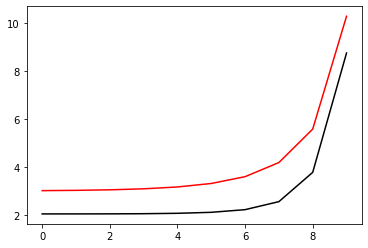

1800 99.00178051010624 8.741736978872265
[2.04313038 2.04366206 2.04588489 2.05228056 2.06867012 2.11013075
 2.22099761 2.55572679 3.77840413 8.76240267]


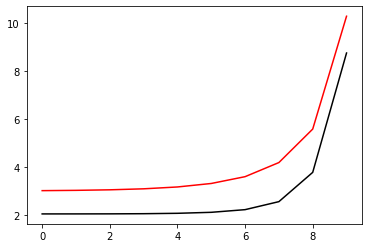

1900 99.00178020271585 8.741549320414585
[2.04316001 2.043692   2.04591555 2.05231247 2.06870398 2.11016707
 2.22103389 2.55573858 3.77821543 8.76192422]


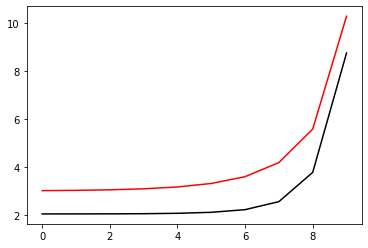

2000 99.00177989541179 8.741361733025093
[2.04318966 2.04372197 2.04594622 2.05234439 2.06873785 2.1102034
 2.22107017 2.55575034 3.77802683 8.76144579]


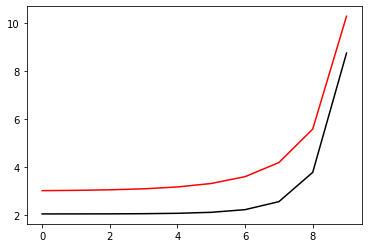

2100 99.00177958819394 8.741174216638441
[2.04321934 2.04375195 2.04597692 2.05237633 2.06877174 2.11023973
 2.22110643 2.55576207 3.77783833 8.7609674 ]


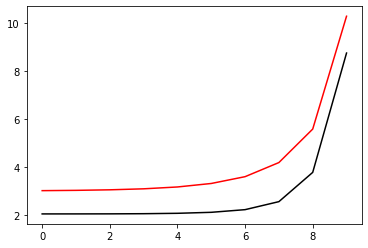

2200 99.00177928106226 8.740986771189407
[2.04324903 2.04378196 2.04600763 2.05240828 2.06880563 2.11027607
 2.22114267 2.55577376 3.77764993 8.76048903]


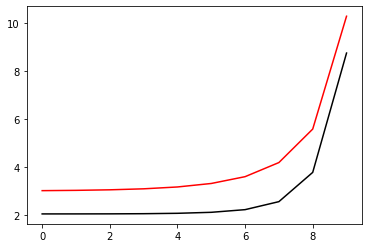

2300 99.00177897401664 8.740799396612843
[2.04327874 2.04381198 2.04603835 2.05244025 2.06883954 2.1103124
 2.22117891 2.55578542 3.77746162 8.76001069]


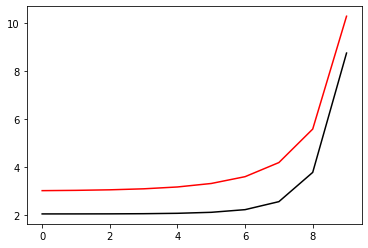

2400 99.00177866705702 8.740612092843692
[2.04330847 2.04384202 2.0460691  2.05247223 2.06887346 2.11034874
 2.22121513 2.55579705 3.77727341 8.75953238]


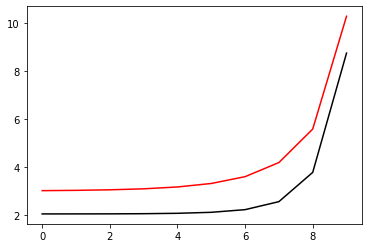

2500 99.00177836018331 8.74042485981698
[2.04333822 2.04387208 2.04609986 2.05250423 2.06890739 2.11038509
 2.22125134 2.55580865 3.7770853  8.7590541 ]


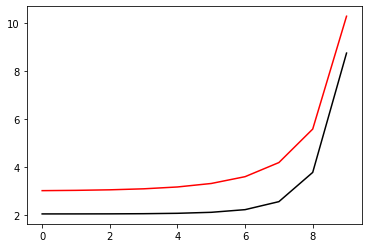

2600 99.00177805339541 8.740237697467816
[2.04336799 2.04390216 2.04613065 2.05253625 2.06894133 2.11042143
 2.22128753 2.55582021 3.77689729 8.75857584]


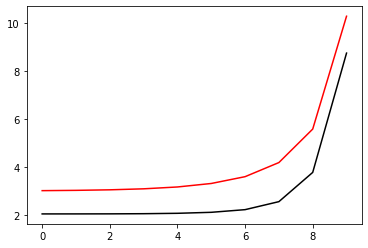

2700 99.00177774669324 8.74005060573142
[2.04339778 2.04393226 2.04616145 2.05256828 2.06897528 2.11045778
 2.22132371 2.55583174 3.77670937 8.75809762]


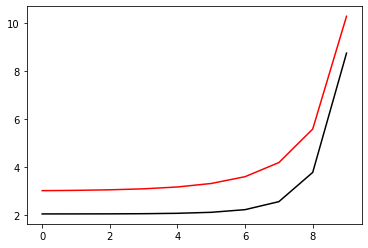

2800 99.00177744007672 8.739863584543123
[2.04342759 2.04396238 2.04619226 2.05260033 2.06900924 2.11049413
 2.22135988 2.55584324 3.77652154 8.75761942]


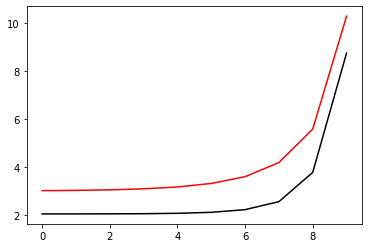

2900 99.0017771335458 8.73967663383828
[2.04345742 2.04399252 2.0462231  2.05263239 2.06904322 2.11053049
 2.22139604 2.5558547  3.77633382 8.75714125]


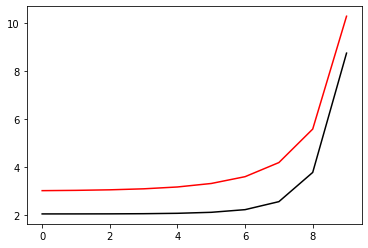

3000 99.00177682710037 8.739489753552403
[2.04348726 2.04402268 2.04625395 2.05266447 2.0690772  2.11056684
 2.22143218 2.55586613 3.77614619 8.7566631 ]


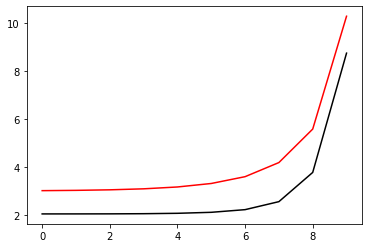

3100 99.00177652074032 8.739302943621032
[2.04351713 2.04405285 2.04628483 2.05269657 2.0691112  2.1106032
 2.22146831 2.55587754 3.77595866 8.75618499]


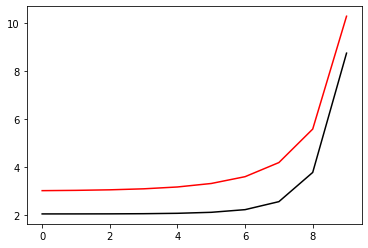

3200 99.00177621446564 8.739116203979856
[2.04354702 2.04408305 2.04631571 2.05272868 2.06914521 2.11063957
 2.22150443 2.5558889  3.77577122 8.7557069 ]


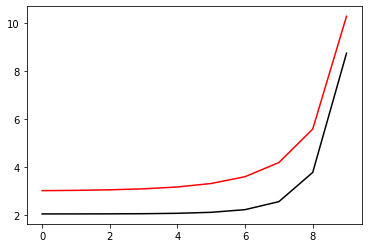

3300 99.0017759082762 8.738929534564624
[2.04357692 2.04411326 2.04634662 2.0527608  2.06917923 2.11067593
 2.22154053 2.55590024 3.77558388 8.75522884]


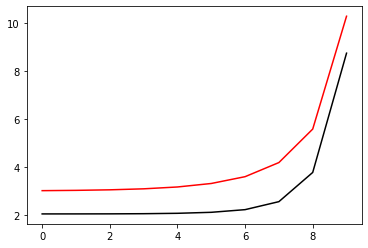

3400 99.0017756021719 8.738742935311151
[2.04360685 2.04414349 2.04637755 2.05279294 2.06921326 2.1107123
 2.22157662 2.55591155 3.77539663 8.75475081]


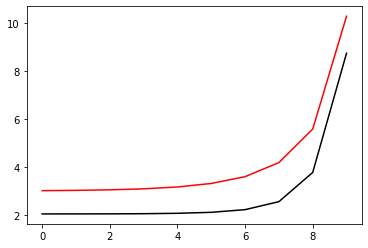

3500 99.00177529615272 8.738556406155386
[2.04363679 2.04417374 2.04640849 2.0528251  2.0692473  2.11074867
 2.2216127  2.55592282 3.77520948 8.7542728 ]


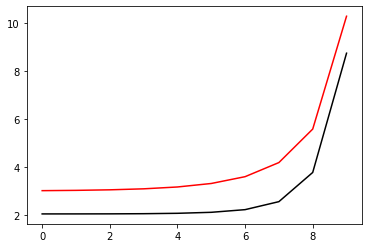

3600 99.00177499021851 8.738369947033343
[2.04366676 2.04420401 2.04643945 2.05285727 2.06928136 2.11078504
 2.22164876 2.55593406 3.77502243 8.75379483]


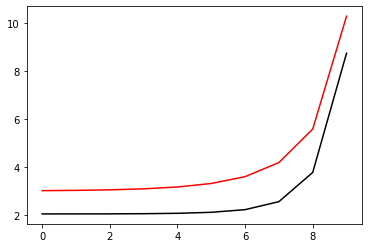

3700 99.00177468436927 8.738183557881124
[2.04369674 2.0442343  2.04647043 2.05288946 2.06931542 2.11082142
 2.22168481 2.55594527 3.77483547 8.75331688]


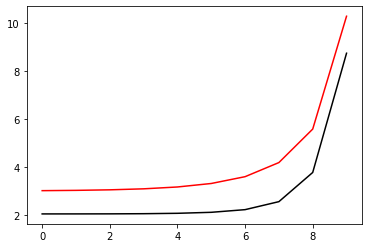

3800 99.00177437860484 8.737997238634915
[2.04372674 2.04426461 2.04650142 2.05292166 2.06934949 2.1108578
 2.22172085 2.55595645 3.77464861 8.75283896]


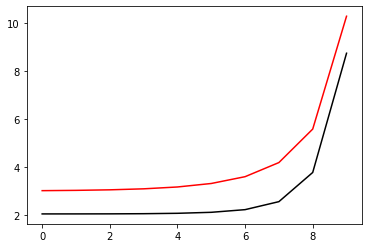

3900 99.00177407292519 8.737810989231003
[2.04375676 2.04429493 2.04653244 2.05295388 2.06938358 2.11089418
 2.22175688 2.55596759 3.77446185 8.75236106]


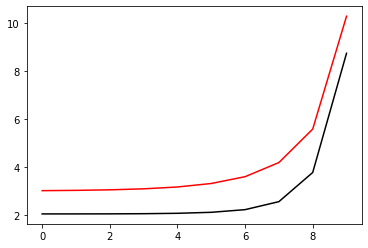

4000 99.00177376733022 8.737624809605771
[2.0437868  2.04432528 2.04656347 2.05298611 2.06941768 2.11093057
 2.22179289 2.55597871 3.77427518 8.7518832 ]


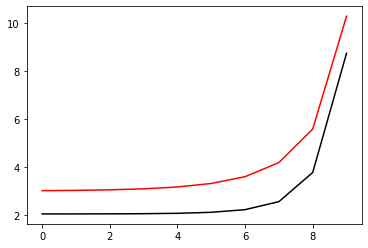

4100 99.00177346181984 8.737438699695671
[2.04381686 2.04435564 2.04659452 2.05301836 2.06945179 2.11096695
 2.22182889 2.55598979 3.7740886  8.75140536]


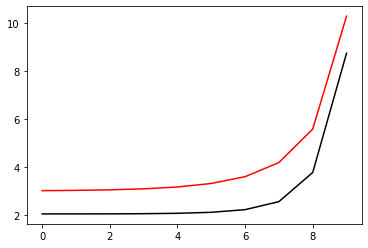

4200 99.00177315639398 8.73725265943724
[2.04384694 2.04438602 2.04662558 2.05305062 2.06948591 2.11100334
 2.22186487 2.55600084 3.77390212 8.75092756]


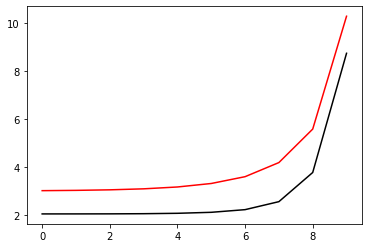

4300 99.00177285105259 8.737066688767106
[2.04387704 2.04441642 2.04665666 2.0530829  2.06952004 2.11103974
 2.22190085 2.55601186 3.77371574 8.75044977]


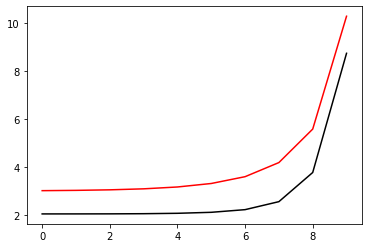

4400 99.00177254579556 8.736880787621997
[2.04390715 2.04444684 2.04668777 2.0531152  2.06955418 2.11107613
 2.22193681 2.55602285 3.77352945 8.74997202]


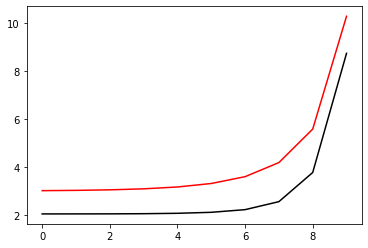

4500 99.0017722406228 8.736694955938727
[2.04393729 2.04447728 2.04671888 2.05314751 2.06958833 2.11111253
 2.22197276 2.5560338  3.77334325 8.7494943 ]


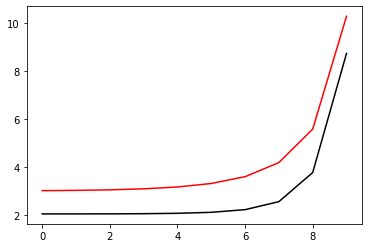

4600 99.00177193553426 8.736509193654182
[2.04396744 2.04450774 2.04675002 2.05317983 2.06962249 2.11114893
 2.22200869 2.55604473 3.77315715 8.7490166 ]


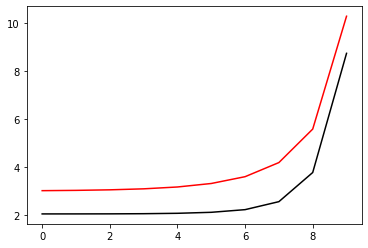

4700 99.00177163052983 8.736323500705335
[2.04399762 2.04453821 2.04678117 2.05321217 2.06965667 2.11118533
 2.22204461 2.55605562 3.77297115 8.74853893]


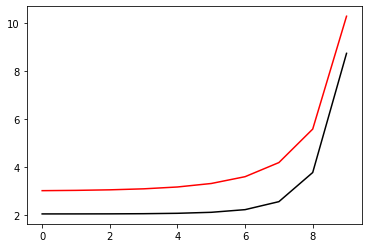

4800 99.00177132560945 8.736137877029268
[2.04402781 2.0445687  2.04681234 2.05324453 2.06969085 2.11122174
 2.22208052 2.55606649 3.77278524 8.74806129]


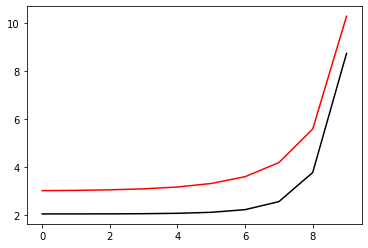

4900 99.00177102077306 8.73595232256312
[2.04405802 2.04459921 2.04684353 2.0532769  2.06972505 2.11125815
 2.22211642 2.55607732 3.77259942 8.74758368]


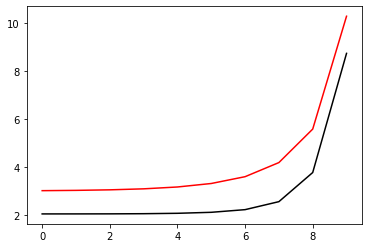

5000 99.00177071602053 8.735766837244157
[2.04408825 2.04462974 2.04687474 2.05330929 2.06975926 2.11129456
 2.2221523  2.55608812 3.7724137  8.74710609]


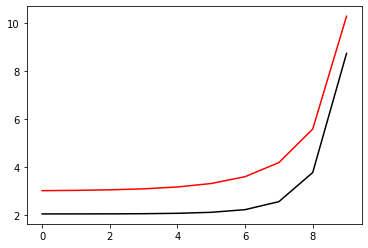

5100 99.00177041135183 8.73558142100968
[2.0441185  2.04466029 2.04690596 2.05334169 2.06979347 2.11133097
 2.22218817 2.55609889 3.77222808 8.74662854]


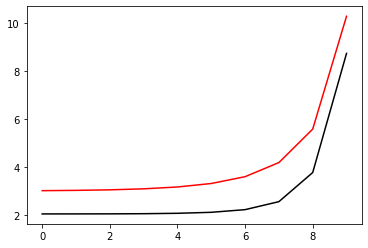

5200 99.00177010676687 8.735396073797112
[2.04414876 2.04469086 2.0469372  2.0533741  2.0698277  2.11136739
 2.22222403 2.55610963 3.77204254 8.74615101]


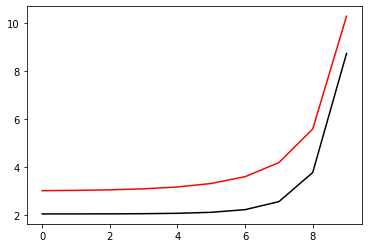

5300 99.00176980226554 8.73521079554395
[2.04417905 2.04472144 2.04696846 2.05340653 2.06986194 2.11140381
 2.22225988 2.55612034 3.77185711 8.74567351]


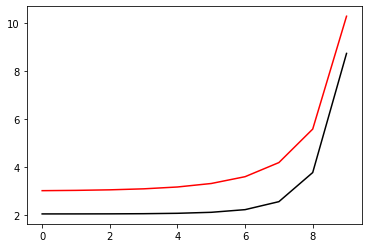

5400 99.00176949784782 8.73502558618777
[2.04420936 2.04475205 2.04699973 2.05343898 2.06989619 2.11144023
 2.22229571 2.55613102 3.77167176 8.74519604]


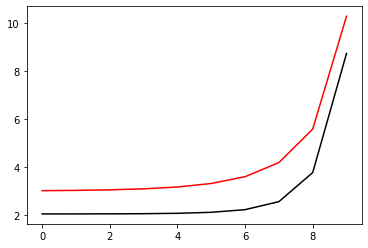

5500 99.0017691935136 8.734840445666261
[2.04423968 2.04478267 2.04703102 2.05347144 2.06993045 2.11147665
 2.22233153 2.55614167 3.77148651 8.74471859]


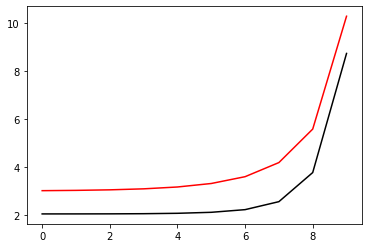

5600 99.00176888926276 8.734655373917162
[2.04427002 2.04481331 2.04706233 2.05350392 2.06996472 2.11151308
 2.22236733 2.55615228 3.77130136 8.74424118]


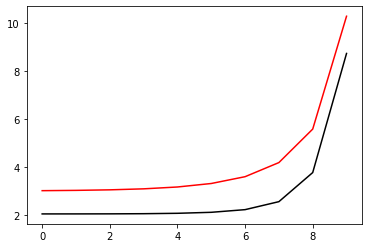

5700 99.0017685850953 8.734470370878315
[2.04430038 2.04484397 2.04709366 2.05353641 2.069999   2.11154951
 2.22240313 2.55616287 3.7711163  8.74376379]


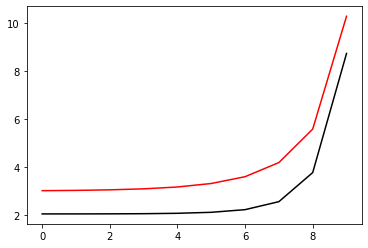

5800 99.00176828101108 8.73428543648764
[2.04433076 2.04487464 2.047125   2.05356891 2.0700333  2.11158594
 2.22243891 2.55617343 3.77093133 8.74328643]


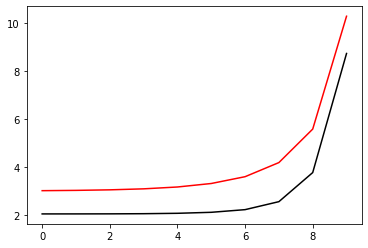

5900 99.00176797701008 8.734100570683161
[2.04436116 2.04490534 2.04715636 2.05360144 2.0700676  2.11162237
 2.22247467 2.55618395 3.77074646 8.74280909]


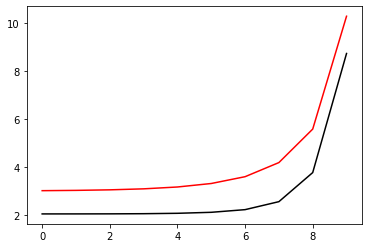

6000 99.00176767309217 8.73391577340297
[2.04439158 2.04493605 2.04718774 2.05363397 2.07010191 2.11165881
 2.22251043 2.55619445 3.77056168 8.74233179]


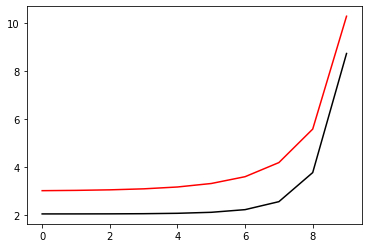

6100 99.00176736925731 8.733731044585246
[2.04442201 2.04496678 2.04721913 2.05366652 2.07013624 2.11169525
 2.22254617 2.55620491 3.77037699 8.74185451]


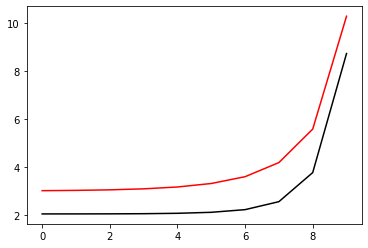

6200 99.0017670655054 8.733546384168251
[2.04445247 2.04499753 2.04725054 2.05369909 2.07017057 2.11173169
 2.2225819  2.55621535 3.7701924  8.74137727]


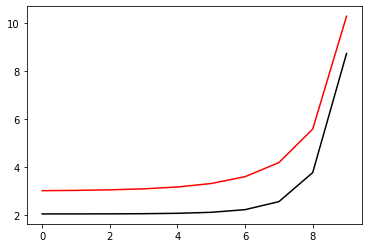

6300 99.00176676183638 8.733361792090335
[2.04448294 2.0450283  2.04728197 2.05373167 2.07020492 2.11176813
 2.22261762 2.55622575 3.7700079  8.74090005]


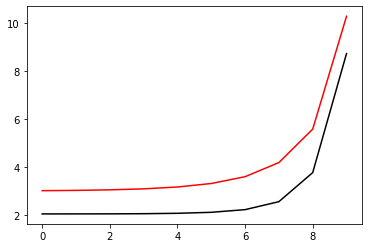

6400 99.00176645825017 8.733177268289921
[2.04451343 2.04505908 2.04731342 2.05376426 2.07023928 2.11180458
 2.22265332 2.55623613 3.76982349 8.74042285]


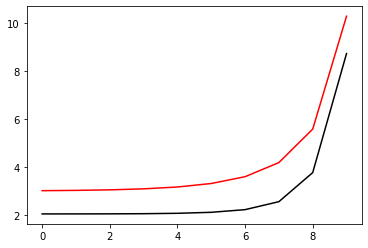

6500 99.00176615474666 8.732992812705534
[2.04454394 2.04508989 2.04734488 2.05379687 2.07027364 2.11184102
 2.22268901 2.55624647 3.76963918 8.73994569]


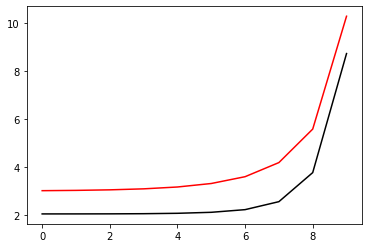

6600 99.00176585132583 8.732808425275786
[2.04457447 2.04512071 2.04737636 2.0538295  2.07030802 2.11187747
 2.22272469 2.55625679 3.76945496 8.73946856]


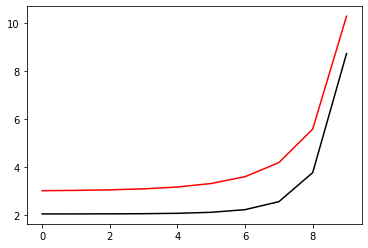

6700 99.00176554798757 8.73262410593934
[2.04460501 2.04515155 2.04740785 2.05386214 2.07034241 2.11191393
 2.22276036 2.55626707 3.76927083 8.73899145]


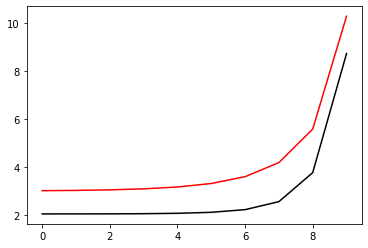

6800 99.00176524473181 8.732439854634972
[2.04463558 2.0451824  2.04743937 2.05389479 2.07037681 2.11195038
 2.22279601 2.55627733 3.7690868  8.73851437]


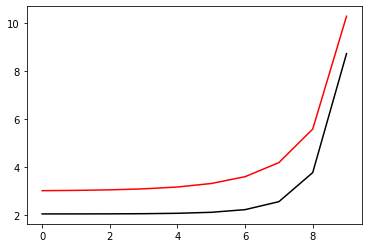

6900 99.00176494155848 8.73225567130154
[2.04466616 2.04521328 2.0474709  2.05392746 2.07041122 2.11198684
 2.22283165 2.55628755 3.76890285 8.73803732]


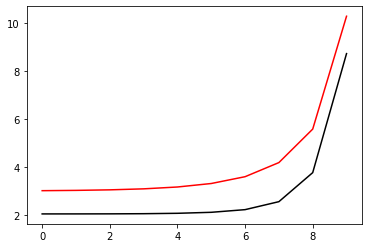

7000 99.0017646384675 8.732071555877965
[2.04469676 2.04524417 2.04750244 2.05396014 2.07044563 2.1120233
 2.22286728 2.55629775 3.76871901 8.7375603 ]


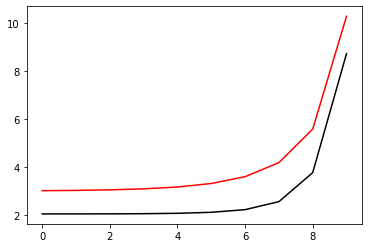

7100 99.0017643354588 8.731887508303277
[2.04472738 2.04527508 2.04753401 2.05399284 2.07048006 2.11205976
 2.22290289 2.55630791 3.76853525 8.7370833 ]


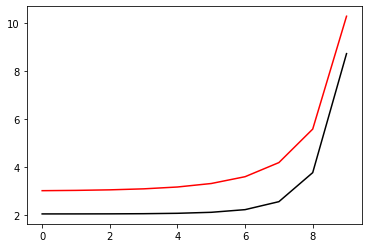

7200 99.0017640325323 8.731703528516562
[2.04475802 2.04530601 2.04756559 2.05402555 2.0705145  2.11209622
 2.22293849 2.55631805 3.76835159 8.73660633]


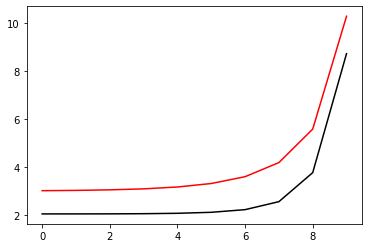

7300 99.00176372968791 8.731519616457021
[2.04478868 2.04533696 2.04759718 2.05405828 2.07054895 2.11213269
 2.22297408 2.55632816 3.76816802 8.7361294 ]


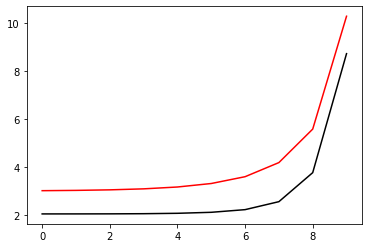

7400 99.00176342692558 8.731335772063902
[2.04481935 2.04536792 2.0476288  2.05409102 2.07058342 2.11216916
 2.22300966 2.55633823 3.76798454 8.73565248]


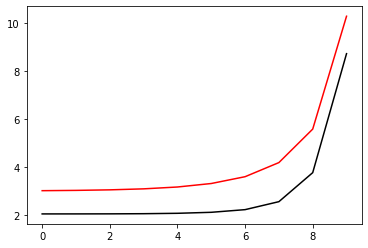

7500 99.00176312424522 8.73115199527657
[2.04485004 2.0453989  2.04766043 2.05412378 2.07061789 2.11220563
 2.22304523 2.55634828 3.76780115 8.7351756 ]


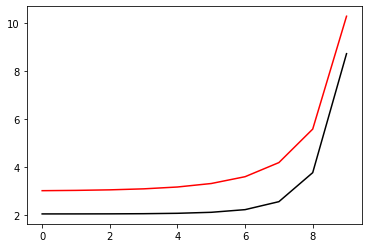

7600 99.00176282164676 8.73096828603444
[2.04488075 2.0454299  2.04769208 2.05415655 2.07065237 2.1122421
 2.22308078 2.5563583  3.76761786 8.73469875]


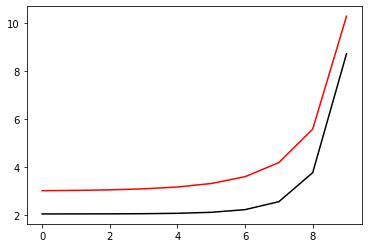

7700 99.00176251913012 8.730784644277032
[2.04491148 2.04546092 2.04772374 2.05418934 2.07068686 2.11227858
 2.22311632 2.55636829 3.76743465 8.73422192]


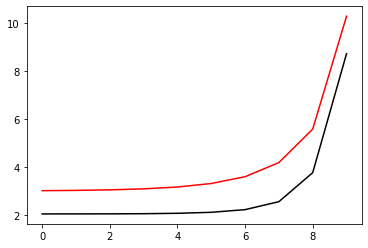

7800 99.00176221669524 8.730601069943928
[2.04494223 2.04549196 2.04775542 2.05422213 2.07072136 2.11231506
 2.22315184 2.55637825 3.76725154 8.73374513]


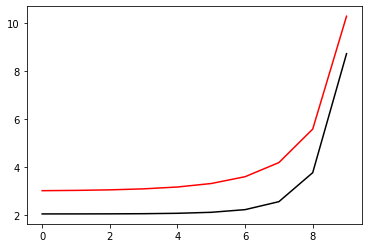

7900 99.00176191434204 8.730417562974818
[2.04497299 2.04552301 2.04778712 2.05425495 2.07075587 2.11235154
 2.22318736 2.55638818 3.76706853 8.73326836]


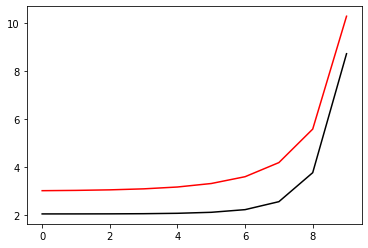

8000 99.00176161207042 8.730234123309462
[2.04500378 2.04555408 2.04781883 2.05428778 2.0707904  2.11238802
 2.22322286 2.55639808 3.7668856  8.73279161]


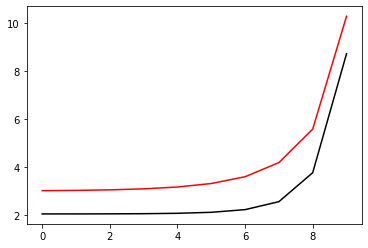

8100 99.00176130988037 8.73005075088769
[2.04503458 2.04558517 2.04785056 2.05432062 2.07082493 2.1124245
 2.22325835 2.55640796 3.76670277 8.7323149 ]


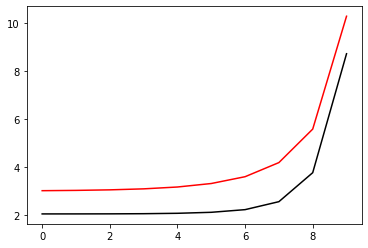

8200 99.00176100777173 8.729867445649422
[2.0450654  2.04561627 2.04788231 2.05435348 2.07085947 2.11246099
 2.22329382 2.5564178  3.76652002 8.73183822]


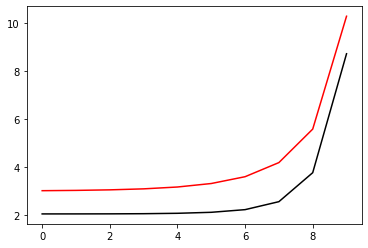

8300 99.0017607057445 8.729684207534667
[2.04509624 2.0456474  2.04791407 2.05438635 2.07089402 2.11249748
 2.22332928 2.55642762 3.76633737 8.73136156]


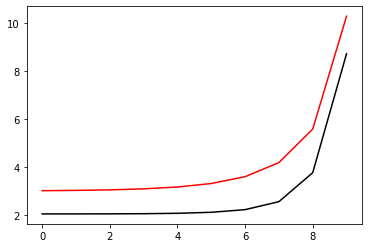

8400 99.00176040379857 8.729501036483512
[2.04512709 2.04567854 2.04794585 2.05441924 2.07092859 2.11253397
 2.22336474 2.5564374  3.76615481 8.73088493]


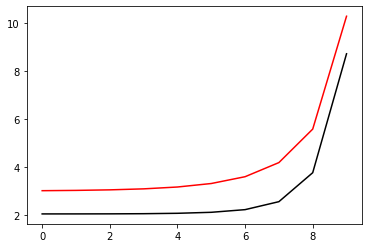

8500 99.00176010193387 8.729317932436112
[2.04515796 2.0457097  2.04797765 2.05445214 2.07096316 2.11257046
 2.22340017 2.55644716 3.76597235 8.73040833]


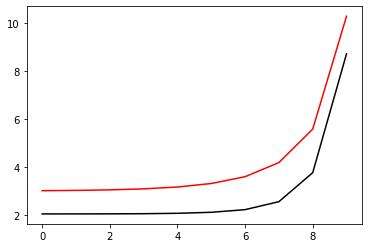

8600 99.00175980015034 8.729134895332715
[2.04518885 2.04574087 2.04800946 2.05448505 2.07099774 2.11260695
 2.2234356  2.55645689 3.76578997 8.72993176]


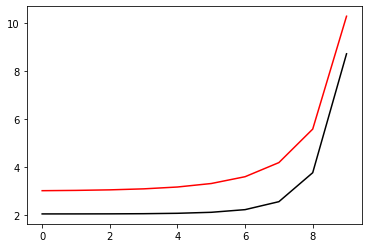

8700 99.00175949844788 8.728951925113645
[2.04521976 2.04577207 2.04804129 2.05451798 2.07103234 2.11264345
 2.22347101 2.55646659 3.76560768 8.72945522]


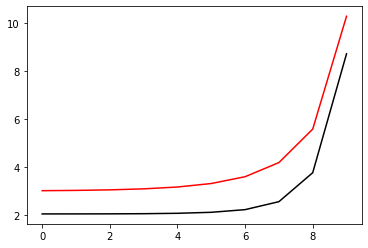

8800 99.00175919682647 8.7287690217193
[2.04525069 2.04580328 2.04807314 2.05455092 2.07106694 2.11267995
 2.22350641 2.55647626 3.76542549 8.7289787 ]


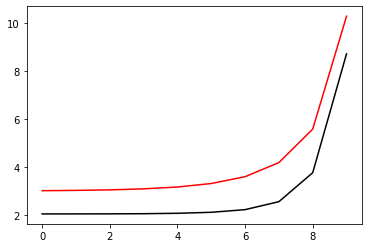

8900 99.00175889528597 8.72858618509018
[2.04528163 2.0458345  2.048105   2.05458388 2.07110156 2.11271645
 2.2235418  2.5564859  3.76524339 8.72850221]


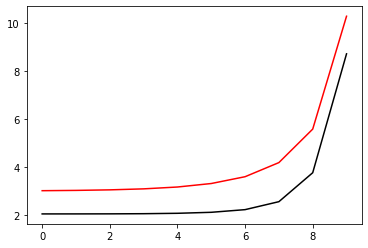

9000 99.00175859382637 8.728403415166841
[2.0453126  2.04586575 2.04813688 2.05461685 2.07113618 2.11275295
 2.22357718 2.55649552 3.76506137 8.72802575]


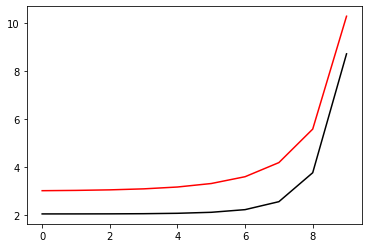

9100 99.00175829244753 8.728220711889941
[2.04534358 2.04589701 2.04816877 2.05464984 2.07117081 2.11278946
 2.22361254 2.5565051  3.76487945 8.72754932]


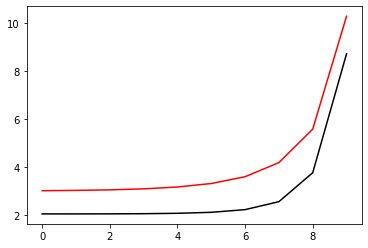

9200 99.00175799114945 8.728038075200212
[2.04537458 2.04592829 2.04820068 2.05468284 2.07120546 2.11282597
 2.22364789 2.55651466 3.76469762 8.72707292]


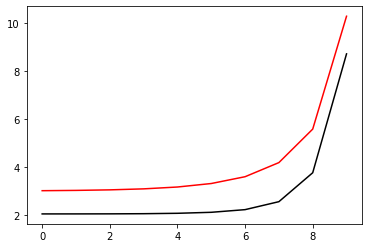

9300 99.00175768993199 8.72785550503844
[2.04540559 2.04595959 2.04823261 2.05471585 2.07124011 2.11286248
 2.22368323 2.55652419 3.76451588 8.72659655]


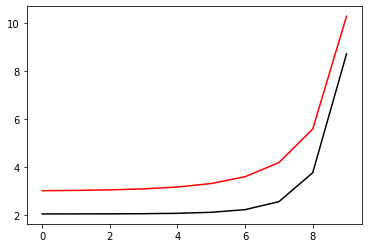

9400 99.00175738879514 8.72767300134553
[2.04543662 2.04599091 2.04826455 2.05474888 2.07127477 2.11289899
 2.22371855 2.55653369 3.76433423 8.7261202 ]


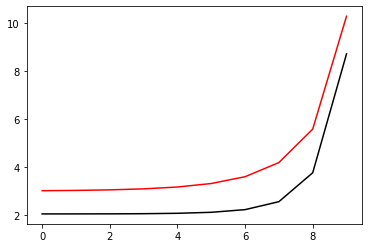

9500 99.00175708773878 8.727490564062423
[2.04546768 2.04602224 2.04829651 2.05478192 2.07130945 2.1129355
 2.22375387 2.55654317 3.76415267 8.72564388]


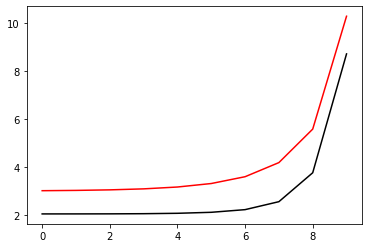

9600 99.00175678676285 8.727308193130195
[2.04549874 2.04605359 2.04832849 2.05481498 2.07134413 2.11297202
 2.22378917 2.55655261 3.76397121 8.7251676 ]


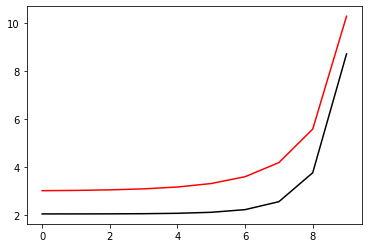

9700 99.00175648586732 8.72712588848994
[2.04552983 2.04608495 2.04836048 2.05484805 2.07137882 2.11300853
 2.22382445 2.55656203 3.76378983 8.72469133]


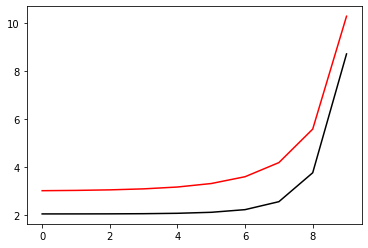

9800 99.00175618505206 8.726943650082893
[2.04556093 2.04611634 2.04839249 2.05488114 2.07141353 2.11304505
 2.22385973 2.55657142 3.76360854 8.7242151 ]


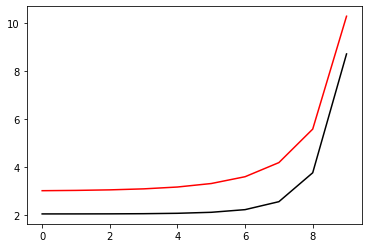

9900 99.00175588431702 8.726761477850317
[2.04559206 2.04614774 2.04842451 2.05491423 2.07144824 2.11308157
 2.22389499 2.55658078 3.76342734 8.7237389 ]


10000 99.00175558366213 8.72657937173356
[2.04562319 2.04617916 2.04845655 2.05494735 2.07148296 2.1131181
 2.22393024 2.55659011 3.76324624 8.72326272]


In [79]:
optimizer=tf.optimizers.SGD(learning_rate=0.01)
for i in range (1, 10001):
    run()
    if i%100==0: print(i, Error_func(h, m2_2).numpy(), m2_2.numpy()), print(h.numpy()), plt.plot(h_real, 'r-'), plt.plot(h.numpy(), 'k-'), plt.show()

In [80]:
optimizer=tf.optimizers.SGD(learning_rate=0.01)
for i in range (1, 10001):
    run()
    if i%100==0: print(i, Error_func(h, m2_2).numpy(), m2_2.numpy()), print(h.numpy()), plt.plot(h_real, 'r-'), plt.plot(h.numpy(), 'k-'), plt.show()

100 99.00175528308733 8.726397331674072
[2.04565435 2.04621059 2.04848861 2.05498047 2.0715177  2.11315462
 2.22396548 2.55659942 3.76306522 8.72278657]


200 99.00175498259254 8.726215357613391
[2.04568553 2.04624205 2.04852068 2.05501361 2.07155244 2.11319115
 2.22400071 2.55660869 3.76288429 8.72231046]


300 99.00175468217769 8.726033449493093
[2.04571672 2.04627352 2.04855277 2.05504677 2.07158719 2.11322768
 2.22403592 2.55661794 3.76270345 8.72183436]


400 99.0017543818427 8.725851607254851
[2.04574793 2.046305   2.04858487 2.05507993 2.07162195 2.11326421
 2.22407112 2.55662717 3.76252271 8.7213583 ]


500 99.0017540815875 8.725669830840419
[2.04577915 2.04633651 2.04861699 2.05511312 2.07165673 2.11330074
 2.22410631 2.55663636 3.76234205 8.72088227]


600 99.00175378141203 8.725488120191626
[2.0458104  2.04636803 2.04864913 2.05514631 2.07169151 2.11333728
 2.22414149 2.55664553 3.76216148 8.72040626]


700 99.00175348131624 8.72530647525039
[2.04584166 2.04639956 2.04868128 2.05517952 2.0717263  2.11337381
 2.22417665 2.55665467 3.761981   8.71993028]


800 99.00175318130002 8.725124895958693
[2.04587294 2.04643112 2.04871345 2.05521275 2.0717611  2.11341035
 2.2242118  2.55666378 3.76180061 8.71945434]


900 99.0017528813633 8.7249433822586
[2.04590423 2.04646269 2.04874564 2.05524598 2.07179591 2.11344689
 2.22424694 2.55667287 3.76162031 8.71897841]


1000 99.00175258150605 8.72476193409224
[2.04593555 2.04649428 2.04877784 2.05527923 2.07183073 2.11348344
 2.22428207 2.55668192 3.7614401  8.71850252]


1100 99.00175228172816 8.724580551401855
[2.04596688 2.04652588 2.04881005 2.0553125  2.07186556 2.11351998
 2.22431719 2.55669095 3.76125998 8.71802666]


1200 99.00175198202957 8.724399234129727
[2.04599822 2.04655751 2.04884228 2.05534578 2.0719004  2.11355653
 2.22435229 2.55669996 3.76107995 8.71755082]


1300 99.00175168241024 8.724217982218223
[2.04602959 2.04658914 2.04887453 2.05537907 2.07193525 2.11359307
 2.22438738 2.55670893 3.7609     8.71707502]


1400 99.00175138287008 8.724036795609784
[2.04606097 2.0466208  2.04890679 2.05541237 2.07197011 2.11362962
 2.22442246 2.55671788 3.76072015 8.71659924]


1500 99.00175108340902 8.723855674246952
[2.04609237 2.04665247 2.04893907 2.05544569 2.07200498 2.11366617
 2.22445752 2.5567268  3.76054038 8.71612349]


1600 99.00175078402698 8.723674618072323
[2.04612379 2.04668416 2.04897137 2.05547903 2.07203986 2.11370273
 2.22449258 2.5567357  3.76036071 8.71564777]


1700 99.00175048472389 8.723493627028569
[2.04615522 2.04671587 2.04900368 2.05551237 2.07207474 2.11373928
 2.22452762 2.55674457 3.76018112 8.71517207]


1800 99.0017501854997 8.723312701058449
[2.04618667 2.04674759 2.04903601 2.05554573 2.07210964 2.11377584
 2.22456265 2.55675341 3.76000162 8.71469641]


1900 99.00174988635435 8.723131840104802
[2.04621814 2.04677933 2.04906835 2.05557911 2.07214455 2.1138124
 2.22459766 2.55676222 3.75982221 8.71422077]


2000 99.00174958728773 8.722951044110532
[2.04624962 2.04681109 2.0491007  2.05561249 2.07217946 2.11384896
 2.22463267 2.55677101 3.75964288 8.71374516]


2100 99.0017492882998 8.72277031301861
[2.04628113 2.04684286 2.04913308 2.0556459  2.07221439 2.11388552
 2.22466766 2.55677977 3.75946365 8.71326958]


2200 99.0017489893905 8.722589646772107
[2.04631265 2.04687465 2.04916547 2.05567931 2.07224932 2.11392208
 2.22470264 2.55678851 3.7592845  8.71279403]


2300 99.00174869055975 8.722409045314151
[2.04634418 2.04690645 2.04919787 2.05571274 2.07228427 2.11395865
 2.22473761 2.55679721 3.75910544 8.71231851]


2400 99.00174839180748 8.722228508587953
[2.04637573 2.04693828 2.04923029 2.05574618 2.07231922 2.11399521
 2.22477256 2.5568059  3.75892647 8.71184301]


2500 99.00174809313361 8.72204803653679
[2.0464073  2.04697011 2.04926273 2.05577963 2.07235418 2.11403178
 2.22480751 2.55681455 3.75874759 8.71136755]


2600 99.00174779453812 8.721867629104038
[2.04643889 2.04700197 2.04929518 2.0558131  2.07238916 2.11406835
 2.22484244 2.55682318 3.7585688  8.71089211]


2700 99.00174749602088 8.721687286233115
[2.04647049 2.04703384 2.04932764 2.05584658 2.07242414 2.11410493
 2.22487736 2.55683178 3.75839009 8.7104167 ]


2800 99.00174719758188 8.721507007867535
[2.04650212 2.04706573 2.04936012 2.05588008 2.07245913 2.1141415
 2.22491227 2.55684036 3.75821147 8.70994132]


2900 99.00174689922099 8.721326793950887
[2.04653375 2.04709764 2.04939262 2.05591358 2.07249413 2.11417807
 2.22494716 2.55684891 3.75803294 8.70946597]


3000 99.00174660093819 8.721146644426817
[2.04656541 2.04712956 2.04942513 2.05594711 2.07252914 2.11421465
 2.22498204 2.55685743 3.7578545  8.70899065]


3100 99.00174630273341 8.720966559239073
[2.04659708 2.04716149 2.04945766 2.05598064 2.07256416 2.11425123
 2.22501692 2.55686593 3.75767614 8.70851535]


3200 99.00174600460656 8.720786538331465
[2.04662877 2.04719345 2.0494902  2.05601419 2.07259919 2.11428781
 2.22505177 2.5568744  3.75749787 8.70804008]


3300 99.00174570655759 8.720606581647871
[2.04666047 2.04722542 2.04952276 2.05604775 2.07263423 2.11432439
 2.22508662 2.55688285 3.75731969 8.70756485]


3400 99.00174540858643 8.72042668913224
[2.04669219 2.0472574  2.04955534 2.05608132 2.07266927 2.11436098
 2.22512146 2.55689126 3.7571416  8.70708964]


3500 99.00174511069302 8.720246860728613
[2.04672393 2.04728941 2.04958793 2.05611491 2.07270433 2.11439756
 2.22515628 2.55689966 3.75696359 8.70661446]


3600 99.00174481287728 8.720067096381081
[2.04675568 2.04732143 2.04962053 2.05614851 2.07273939 2.11443415
 2.22519109 2.55690803 3.75678567 8.7061393 ]


3700 99.00174451513915 8.71988739603384
[2.04678745 2.04735346 2.04965315 2.05618213 2.07277447 2.11447074
 2.22522589 2.55691637 3.75660784 8.70566418]


3800 99.00174421747856 8.719707759631126
[2.04681924 2.04738551 2.04968578 2.05621575 2.07280955 2.11450733
 2.22526067 2.55692468 3.75643009 8.70518908]


3900 99.00174391989545 8.719528187117263
[2.04685105 2.04741758 2.04971843 2.05624939 2.07284464 2.11454392
 2.22529545 2.55693297 3.75625244 8.70471402]


4000 99.00174362238975 8.71934867843665
[2.04688287 2.04744967 2.0497511  2.05628305 2.07287975 2.11458051
 2.22533021 2.55694124 3.75607486 8.70423898]


4100 99.00174332496141 8.71916923353377
[2.0469147  2.04748177 2.04978378 2.05631671 2.07291486 2.1146171
 2.22536496 2.55694948 3.75589738 8.70376397]


4200 99.00174302761035 8.71898985235315
[2.04694656 2.04751388 2.04981647 2.05635039 2.07294998 2.1146537
 2.2253997  2.55695769 3.75571998 8.70328899]


4300 99.00174273033647 8.718810534839422
[2.04697843 2.04754601 2.04984919 2.05638408 2.07298511 2.1146903
 2.22543443 2.55696588 3.75554267 8.70281404]


4400 99.00174243313977 8.718631280937263
[2.04701032 2.04757816 2.04988191 2.05641779 2.07302024 2.1147269
 2.22546914 2.55697404 3.75536544 8.70233911]


4500 99.00174213602016 8.71845209059145
[2.04704222 2.04761033 2.04991465 2.05645151 2.07305539 2.1147635
 2.22550384 2.55698218 3.7551883  8.70186422]


4600 99.00174183897755 8.718272963746815
[2.04707414 2.04764251 2.04994741 2.05648524 2.07309055 2.1148001
 2.22553853 2.55699029 3.75501125 8.70138935]


4700 99.00174154201189 8.71809390034825
[2.04710607 2.0476747  2.04998018 2.05651898 2.07312571 2.1148367
 2.22557321 2.55699838 3.75483428 8.70091451]


4800 99.00174124512313 8.717914900340764
[2.04713803 2.04770692 2.05001296 2.05655274 2.07316089 2.11487331
 2.22560788 2.55700644 3.7546574  8.7004397 ]


4900 99.00174094831121 8.717735963669385
[2.04717    2.04773914 2.05004576 2.05658651 2.07319607 2.11490991
 2.22564253 2.55701448 3.7544806  8.69996492]


5000 99.00174065157603 8.717557090279245
[2.04720198 2.04777139 2.05007858 2.0566203  2.07323126 2.11494652
 2.22567718 2.55702249 3.7543039  8.69949017]


5100 99.00174035491753 8.717378280115536
[2.04723398 2.04780365 2.05011141 2.05665409 2.07326646 2.11498313
 2.22571181 2.55703048 3.75412727 8.69901545]


5200 99.00174005833568 8.717199533123527
[2.047266   2.04783593 2.05014425 2.0566879  2.07330167 2.11501974
 2.22574643 2.55703844 3.75395074 8.69854075]


5300 99.0017397618304 8.717020849248565
[2.04729803 2.04786822 2.05017711 2.05672172 2.07333689 2.11505635
 2.22578103 2.55704638 3.75377428 8.69806608]


5400 99.0017394654016 8.716842228436043
[2.04733008 2.04790053 2.05020999 2.05675556 2.07337212 2.11509297
 2.22581563 2.55705429 3.75359792 8.69759145]


5500 99.00173916904926 8.716663670631464
[2.04736215 2.04793285 2.05024288 2.0567894  2.07340735 2.11512958
 2.22585021 2.55706218 3.75342164 8.69711684]


5600 99.00173887277329 8.71648517578037
[2.04739423 2.04796519 2.05027578 2.05682326 2.0734426  2.1151662
 2.22588479 2.55707004 3.75324544 8.69664226]


5700 99.00173857657363 8.71630674382839
[2.04742633 2.04799754 2.0503087  2.05685714 2.07347785 2.11520282
 2.22591935 2.55707788 3.75306933 8.6961677 ]


5800 99.0017382804502 8.716128374721222
[2.04745845 2.04802991 2.05034164 2.05689102 2.07351312 2.11523943
 2.22595389 2.55708569 3.75289331 8.69569318]


5900 99.00173798440295 8.715950068404627
[2.04749058 2.0480623  2.05037459 2.05692492 2.07354839 2.11527605
 2.22598843 2.55709348 3.75271737 8.69521869]


6000 99.00173768843186 8.715771824824444
[2.04752273 2.0480947  2.05040755 2.05695883 2.07358367 2.11531268
 2.22602296 2.55710124 3.75254151 8.69474422]


6100 99.00173739253677 8.715593643926582
[2.04755489 2.04812712 2.05044053 2.05699275 2.07361896 2.1153493
 2.22605747 2.55710898 3.75236575 8.69426978]


6200 99.00173709671772 8.715415525657017
[2.04758707 2.04815955 2.05047352 2.05702669 2.07365425 2.11538592
 2.22609197 2.5571167  3.75219006 8.69379538]


6300 99.00173680097457 8.715237469961798
[2.04761926 2.048192   2.05050653 2.05706064 2.07368956 2.11542255
 2.22612646 2.55712439 3.75201446 8.693321  ]


6400 99.00173650530729 8.715059476787049
[2.04765147 2.04822447 2.05053955 2.0570946  2.07372488 2.11545918
 2.22616094 2.55713205 3.75183895 8.69284664]


6500 99.00173620971583 8.71488154607895
[2.0476837  2.04825695 2.05057259 2.05712857 2.0737602  2.11549581
 2.2261954  2.55713969 3.75166352 8.69237232]


6600 99.0017359142001 8.714703677783778
[2.04771594 2.04828945 2.05060564 2.05716256 2.07379553 2.11553244
 2.22622986 2.55714731 3.75148817 8.69189803]


6700 99.00173561876004 8.714525871847838
[2.0477482  2.04832196 2.0506387  2.05719656 2.07383087 2.11556907
 2.2262643  2.55715491 3.75131291 8.69142376]


6800 99.0017353233956 8.714348128217551
[2.04778048 2.04835448 2.05067178 2.05723057 2.07386622 2.1156057
 2.22629873 2.55716247 3.75113774 8.69094953]


6900 99.00173502810672 8.714170446839375
[2.04781277 2.04838703 2.05070488 2.0572646  2.07390158 2.11564233
 2.22633315 2.55717002 3.75096265 8.69047532]


7000 99.00173473289331 8.71399282765985
[2.04784508 2.04841958 2.05073799 2.05729863 2.07393695 2.11567897
 2.22636756 2.55717754 3.75078764 8.69000114]


7100 99.00173443775536 8.71381527062558
[2.0478774  2.04845216 2.05077111 2.05733268 2.07397233 2.1157156
 2.22640195 2.55718504 3.75061272 8.68952699]


7200 99.00173414269275 8.713637775683246
[2.04790974 2.04848475 2.05080425 2.05736674 2.07400771 2.11575224
 2.22643634 2.55719251 3.75043788 8.68905287]


7300 99.00173384770545 8.713460342779602
[2.04794209 2.04851735 2.0508374  2.05740082 2.0740431  2.11578888
 2.22647071 2.55719996 3.75026312 8.68857878]


7400 99.0017335527934 8.71328297186145
[2.04797446 2.04854997 2.05087057 2.0574349  2.0740785  2.11582552
 2.22650507 2.55720739 3.75008845 8.68810471]


7500 99.00173325795653 8.713105662875682
[2.04800684 2.04858261 2.05090375 2.057469   2.07411391 2.11586216
 2.22653942 2.55721479 3.74991387 8.68763068]


7600 99.00173296319477 8.712928415769245
[2.04803925 2.04861526 2.05093695 2.05750311 2.07414933 2.1158988
 2.22657376 2.55722217 3.74973936 8.68715667]


7700 99.00173266850807 8.712751230489165
[2.04807166 2.04864792 2.05097016 2.05753724 2.07418476 2.11593545
 2.22660808 2.55722952 3.74956495 8.68668269]


7800 99.00173237389637 8.712574106982524
[2.0481041  2.0486806  2.05100338 2.05757137 2.0742202  2.11597209
 2.2266424  2.55723685 3.74939061 8.68620874]


7900 99.00173207935961 8.712397045196504
[2.04813654 2.0487133  2.05103662 2.05760552 2.07425564 2.11600874
 2.2266767  2.55724416 3.74921636 8.68573482]


8000 99.00173178489771 8.712220045078299
[2.04816901 2.04874601 2.05106987 2.05763968 2.07429109 2.11604539
 2.22671099 2.55725144 3.74904219 8.68526093]


8100 99.00173149051065 8.712043106575235
[2.04820149 2.04877874 2.05110314 2.05767385 2.07432655 2.11608203
 2.22674527 2.5572587  3.74886811 8.68478707]


8200 99.0017311961983 8.711866229634657
[2.04823398 2.04881148 2.05113642 2.05770804 2.07436202 2.11611868
 2.22677954 2.55726594 3.74869411 8.68431323]


8300 99.00173090196067 8.711689414204004
[2.04826649 2.04884423 2.05116972 2.05774223 2.0743975  2.11615533
 2.22681379 2.55727315 3.74852019 8.68383943]


8400 99.00173060779767 8.711512660230769
[2.04829902 2.04887701 2.05120303 2.05777644 2.07443298 2.11619199
 2.22684804 2.55728034 3.74834635 8.68336565]


8500 99.00173031370923 8.711335967662519
[2.04833156 2.04890979 2.05123635 2.05781066 2.07446848 2.11622864
 2.22688227 2.55728751 3.7481726  8.6828919 ]


8600 99.00173001969532 8.71115933644689
[2.04836412 2.0489426  2.05126969 2.0578449  2.07450398 2.11626529
 2.22691649 2.55729465 3.74799893 8.68241819]


8700 99.00172972575584 8.710982766531595
[2.04839669 2.04897541 2.05130304 2.05787914 2.07453949 2.11630195
 2.2269507  2.55730177 3.74782535 8.6819445 ]


8800 99.00172943189074 8.710806257864387
[2.04842928 2.04900825 2.05133641 2.0579134  2.07457501 2.11633861
 2.2269849  2.55730887 3.74765185 8.68147083]


8900 99.00172913809999 8.710629810393119
[2.04846188 2.04904109 2.05136979 2.05794767 2.07461054 2.11637526
 2.22701909 2.55731594 3.74747843 8.6809972 ]


9000 99.00172884438349 8.710453424065685
[2.0484945  2.04907395 2.05140318 2.05798195 2.07464607 2.11641192
 2.22705327 2.55732299 3.74730509 8.6805236 ]


9100 99.0017285507412 8.710277098830057
[2.04852713 2.04910683 2.05143659 2.05801624 2.07468162 2.11644858
 2.22708743 2.55733002 3.74713184 8.68005002]


9200 99.00172825717307 8.710100834634261
[2.04855978 2.04913972 2.05147001 2.05805055 2.07471717 2.11648524
 2.22712159 2.55733703 3.74695867 8.67957648]


9300 99.00172796367902 8.709924631426421
[2.04859244 2.04917263 2.05150345 2.05808487 2.07475273 2.11652191
 2.22715573 2.55734401 3.74678558 8.67910296]


9400 99.00172767025902 8.709748489154704
[2.04862512 2.04920555 2.0515369  2.0581192  2.0747883  2.11655857
 2.22718986 2.55735097 3.74661257 8.67862947]


9500 99.00172737691297 8.709572407767347
[2.04865782 2.04923849 2.05157036 2.05815354 2.07482388 2.11659523
 2.22722398 2.55735791 3.74643965 8.67815601]


9600 99.00172708364083 8.709396387212648
[2.04869053 2.04927144 2.05160384 2.05818789 2.07485946 2.1166319
 2.22725808 2.55736482 3.74626681 8.67768258]


9700 99.00172679044255 8.70922042743898
[2.04872326 2.04930441 2.05163733 2.05822226 2.07489506 2.11666856
 2.22729218 2.55737171 3.74609405 8.67720918]


9800 99.00172649731806 8.70904452839478
[2.048756   2.04933739 2.05167084 2.05825664 2.07493066 2.11670523
 2.22732627 2.55737858 3.74592137 8.67673581]


9900 99.00172620426729 8.70886869002855
[2.04878875 2.04937039 2.05170436 2.05829103 2.07496627 2.1167419
 2.22736034 2.55738543 3.74574878 8.67626246]


10000 99.00172591129021 8.708692912288864
[2.04882152 2.0494034  2.05173789 2.05832543 2.07500188 2.11677857
 2.2273944  2.55739225 3.74557626 8.67578915]


In [ ]:
[Positive0, Positive1]=NN_func_01(h, Positive)
[Negative0, Negative1]=NN_func_01(h, Negative)

x_data1=[v[0] for v in Positive0]
y_data1=[v[1] for v in Positive0]
x_data2=[v[0] for v in Positive1]
y_data2=[v[1] for v in Positive1]
x_data3=[v[0] for v in Negative0]
y_data3=[v[1] for v in Negative0]
x_data4=[v[0] for v in Negative1]
y_data4=[v[1] for v in Negative1]
plt.plot(x_data4, y_data4, 'g.')
plt.plot(x_data2, y_data2, 'co', label='Positive')
plt.plot(x_data1, y_data1, 'ro', label='NN(p)=0')
plt.plot(x_data3, y_data3, 'mo', label='NN(n)=0')
plt.xlim(0.0, 1.5)
plt.ylim(-0.2, 0.2)
plt.legend(bbox_to_anchor=(1, 0.5))
plt.show()